## Reading in packages

In [380]:
import pandas as pd
import random
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import NMF
from numpy import asarray
from numpy import savetxt
import matplotlib.colors as mcolors
import matplotlib.cm
import matplotlib.patches as mpatches
import umap
import matplotlib as mpl
import scanpy as sc
import scipy
import kmapper as km
from kmapper import jupyter
from kmapper.plotlyviz import plotlyviz
from kmapper.plotlyviz import *
import plotly.graph_objs as go
import sys
import sklearn
from sklearn import ensemble
from tqdm import tqdm
from ripser import Rips
from ripser import ripser
from persim import plot_diagrams
from sklearn.metrics.pairwise import euclidean_distances

import kmapper as km
from kmapper import jupyter
from kmapper.plotlyviz import plotlyviz
from kmapper.plotlyviz import *
import plotly.graph_objs as go
import sys
from sklearn import ensemble
import math

random.seed(10)
P_hold_null = []
R_hold_null = []

## Read in data

Select either the whole sc transformed dataset or just the variable genes

In [381]:
ILC_var = sc.read("sct_variable.h5ad")
ILC = sc.read("sct.h5ad")

c:\users\hmkri\desktop\riesenfeld pearson\lib\site-packages\anndata\compat\__init__.py:158: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(
c:\users\hmkri\desktop\riesenfeld pearson\lib\site-packages\anndata\compat\__init__.py:158: FutureWarning: Moving element from .uns['neighbors']['connectivities'] to .obsp['connectivities'].

This is where adjacency matrices should go now.
  warn(


In [382]:
PCA_coord = ILC_var.obsm["X_pca"]
Diff_coord = ILC_var.obsm["X_diffmap"]

In [383]:
norm_reads_sparse = ILC_var.layers["norm_data"]
#norm_reads_sparse = ILC.layers["norm_data"]
norm_reads = pd.DataFrame(norm_reads_sparse.toarray())
print("Norm reads: "+repr(norm_reads.shape))

UMAP = ILC_var.obsm["umap_cell_embeddings"]
Diff = ILC_var.obsm['X_draw_graph_fa']

Norm reads: (26877, 3000)


## Selecting all ILC2 and ILC3 cells

### Run if writing csv files

In [384]:
Variable = ILC_var.var

Obs = ILC_var.obs
O = Obs["ilc2_ilc3"].to_frame()

Variable["Selected"].to_csv('Gene_list_ILC.csv', sep=',')
O.to_csv('Cell_list_ILC.csv', sep=',')

### Run if reading csv files

In [385]:
Gene_list = pd.read_csv("Gene_list_ILC.csv", sep=",", header = 0)
Gene_list = np.array(Gene_list)
Gene_list = Gene_list[:,0]
Cell_list = pd.read_csv("Cell_list_ILC.csv", sep=",", header = 0)
Cell_list = np.array(Cell_list)
Cell_list = Cell_list[:,0]

## Collecting cells of interest

In this model of psoriasis, tissue resident ILC2s are reprogramed to ILC3s. 

For analysis we are selecting for cells likely to be ILC2s or ILC3s on the basis of previously characterized populations.

In [386]:
#Full matrix of all counts
matrix = ILC_var.layers["norm_data"]
matrix = np.array(matrix.toarray())

ILC_total_reads = pd.DataFrame(matrix, index = Cell_list, columns = Gene_list)
print(ILC_total_reads.shape)

(26877, 3000)


In [387]:
UMAP_pd = pd.DataFrame(UMAP, index = ILC_total_reads.index)
Diff_pd = pd.DataFrame(Diff, index = ILC_total_reads.index)

In [388]:
#We have four labeled groups of cells that we want to collect together
ILC2_ILC3 = ILC_var.obs["ilc2_ilc3"]
ILC3_Q = ILC_var.obs["quiescent_ilc3"]
ILC2_Q = ILC_var.obs["ilc2_quiescent"]
cloud_ILC3 = ILC_var.obs["cloud_ilc3"]

df = pd.DataFrame(dict(ILC2_ILC3 = ILC2_ILC3, ILC3_Q = ILC3_Q, ILC2_Q = ILC2_Q, cloud_ILC3 = cloud_ILC3))
cells = df.shape[0]

In [389]:
#binary yes or no for if the cell is in our group
in_transition = np.zeros((cells, 1))

#Value of group - 0 if NA - over all cells
allcell_ILC2_ILC3 = np.zeros((cells, 1))
allcell_ILC3_Q = np.zeros((cells, 1))
allcell_ILC2_Q = np.zeros((cells, 1))
allcell_cloud_ILC3 = np.zeros((cells, 1))

#Cell labels - 0 if NA in all groups - over all cells
index_cells = np.zeros((cells, 1))
index_cells = index_cells.astype(str)

#Value of group - only cells in at least one group
val_ILC2_ILC3 = np.zeros((3807, 1))
val_ILC3_Q = np.zeros((3807, 1))
val_ILC2_Q = np.zeros((3807, 1))
val_cloud_ILC3 = np.zeros((3807, 1))

#Names of cells included in the value variables
index_val = np.array([])

#Variable for initially counting the number of cells in the groups of interest
number = 0


#Loops through the different groups so that we collect all cells with a value in at least one of the groups
for i in range(0,cells):
    if np.isnan(df["ILC2_ILC3"][i]):

        if np.isnan(df["ILC3_Q"][i]):

            if np.isnan(df["ILC2_Q"][i]):

                if np.isnan(df["cloud_ILC3"][i]):

                    in_transition[i,0] = 0
                    
                    allcell_ILC2_ILC3[i,0] = 0
                    allcell_ILC3_Q[i,0] = 0
                    allcell_ILC2_Q[i,0] = 0
                    allcell_cloud_ILC3[i,0] = 0
                    
                    index_cells[i,0] = "0"
                    
                else:
                    in_transition[i,0] = 1
                    
                    allcell_ILC2_ILC3[i,0] = df["ILC2_ILC3"][i]
                    allcell_ILC3_Q[i,0] = df["ILC3_Q"][i]
                    allcell_ILC2_Q[i,0] = df["ILC2_Q"][i]
                    allcell_cloud_ILC3[i,0] = df["cloud_ILC3"][i]
                    
                    index_cells[i,0] = Cell_list[i]
                    
                    val_ILC2_ILC3[number] = df["ILC2_ILC3"][i]
                    val_ILC3_Q[number] = df["ILC3_Q"][i]
                    val_ILC2_Q[number] = df["ILC2_Q"][i]
                    val_cloud_ILC3[number] = df["cloud_ILC3"][i]
                    
                    index_val = np.append(index_val , df["ILC2_ILC3"].index[i])
                    
                    number += 1
            else:
                in_transition[i,0] = 1
                
                allcell_ILC2_ILC3[i,0] = df["ILC2_ILC3"][i]
                allcell_ILC3_Q[i,0] = df["ILC3_Q"][i]
                allcell_ILC2_Q[i,0] = df["ILC2_Q"][i]
                allcell_cloud_ILC3[i,0] = df["cloud_ILC3"][i]
                
                index_cells[i,0] = Cell_list[i]
                
                val_ILC2_ILC3[number] = df["ILC2_ILC3"][i]
                val_ILC3_Q[number] = df["ILC3_Q"][i]
                val_ILC2_Q[number] = df["ILC2_Q"][i]
                val_cloud_ILC3[number] = df["cloud_ILC3"][i]
                
                index_val = np.append(index_val , df["ILC2_ILC3"].index[i])
                
                number += 1             

        else:
            in_transition[i,0] = 1
            
            allcell_ILC2_ILC3[i,0] = df["ILC2_ILC3"][i]
            allcell_ILC3_Q[i,0] = df["ILC3_Q"][i]
            allcell_ILC2_Q[i,0] = df["ILC2_Q"][i]
            allcell_cloud_ILC3[i,0] = df["cloud_ILC3"][i]
            
            index_cells[i,0] = Cell_list[i]
            
            val_ILC2_ILC3[number] = df["ILC2_ILC3"][i]
            val_ILC3_Q[number] = df["ILC3_Q"][i]
            val_ILC2_Q[number] = df["ILC2_Q"][i]
            val_cloud_ILC3[number] = df["cloud_ILC3"][i]
            
            index_val = np.append(index_val , df["ILC2_ILC3"].index[i])
            
            number += 1
    
    else:
        in_transition[i,0] = 1
        
        allcell_ILC2_ILC3[i,0] = df["ILC2_ILC3"][i]
        allcell_ILC3_Q[i,0] = df["ILC3_Q"][i]
        allcell_ILC2_Q[i,0] = df["ILC2_Q"][i]
        allcell_cloud_ILC3[i,0] = df["cloud_ILC3"][i]
        
        index_cells[i,0] = Cell_list[i]
        
        val_ILC2_ILC3[number] = df["ILC2_ILC3"][i]
        val_ILC3_Q[number] = df["ILC3_Q"][i]
        val_ILC2_Q[number] = df["ILC2_Q"][i]
        val_cloud_ILC3[number] = df["cloud_ILC3"][i]
        
        index_val = np.append(index_val , df["ILC2_ILC3"].index[i])
        
        number += 1
      

print(number)

3807


### Creating normalized read matrix for only the cells of interest

In [390]:
#Numpy array with normalized reads for all cells
norm_reads = np.array(norm_reads)
print(norm_reads.shape)
PCA_coord = np.array(PCA_coord)
print(PCA_coord.shape)
Diff_coord = np.array(Diff_coord)
print(Diff_coord.shape)

#Number of genes to initialize new matrix
genes = Gene_list.shape[0]
reads = np.zeros((1,3000 ))

PCA_reads = np.zeros((1,50))
Diff_reads = np.zeros((1,15))

#Going through all of the cells, if the  associated index in index_cell is nonzero then 
#it was included in our group and we should pull the associated gene expression data
for i in range(0,cells):
    j = index_cells[i]
    if j != "0":
        next_cell = norm_reads[i,:]
        next_cell = np.reshape(next_cell, (1,3000 ))
        reads = np.append(reads, next_cell, axis = 0)
        
        next_PCA = PCA_coord[i,:]
        next_PCA = np.reshape(next_PCA, (1,50))
        PCA_reads = np.append(PCA_reads, next_PCA, axis = 0)
        
        next_Diff = Diff_coord[i,:]
        next_Diff = np.reshape(next_Diff, (1,15))
        Diff_reads = np.append(Diff_reads, next_Diff, axis = 0)

#To get the indices to work out I have a row of zeros at the top that I need to omit
reads = reads[1:, :]    
PCA_reads = PCA_reads[1:, :]
Diff_reads = Diff_reads[1:, :]

(26877, 3000)
(26877, 50)
(26877, 15)


In [391]:
# ---------------------------------FDL-----------------------------------------
# Diff = FDL map
Diff_ILC2_ILC3 = np.zeros((1,2))
Diff_ILC3_Q = np.zeros((1,2))
Diff_ILC2_Q = np.zeros((1,2))
Diff_cloud_ILC3 = np.zeros((1,2))

for i in tqdm(range(cells)):
    if np.isnan(df["ILC2_ILC3"][i]) == False:
        Diff_ILC2_ILC3 = np.append(Diff_ILC2_ILC3, np.reshape(Diff[i,:], (1,2)), axis = 0)

for i in tqdm(range(cells)):
    if np.isnan(df["ILC3_Q"][i]) == False:
        Diff_ILC3_Q = np.append(Diff_ILC3_Q, np.reshape(Diff[i,:], (1,2)), axis = 0)
        
for i in tqdm(range(cells)):
    if np.isnan(df["ILC2_Q"][i]) == False:
        Diff_ILC2_Q = np.append(Diff_ILC2_Q, np.reshape(Diff[i,:], (1,2)), axis = 0)

for i in tqdm(range(cells)):
    if np.isnan(df["cloud_ILC3"][i]) == False:
        Diff_cloud_ILC3 = np.append(Diff_cloud_ILC3, np.reshape(Diff[i,:], (1,2)), axis = 0)
        
Diff_ILC2_ILC3 = Diff_ILC2_ILC3[1:,:]
Diff_ILC3_Q = Diff_ILC3_Q[1:,:]
Diff_ILC2_Q = Diff_ILC2_Q[1:,:]
Diff_cloud_ILC3 = Diff_cloud_ILC3[1:,:]

# ---------------------------------UMAP-----------------------------------------
UMAP_ILC2_ILC3 = np.zeros((1,2))
UMAP_ILC3_Q = np.zeros((1,2))
UMAP_ILC2_Q = np.zeros((1,2))
UMAP_cloud_ILC3 = np.zeros((1,2))

for i in tqdm(range(cells)):
    if np.isnan(df["ILC2_ILC3"][i]) == False:
        UMAP_ILC2_ILC3 = np.append(UMAP_ILC2_ILC3, np.reshape(UMAP[i,:], (1,2)), axis = 0)

for i in tqdm(range(cells)):
    if np.isnan(df["ILC3_Q"][i]) == False:
        UMAP_ILC3_Q = np.append(UMAP_ILC3_Q, np.reshape(UMAP[i,:], (1,2)), axis = 0)
        
for i in tqdm(range(cells)):
    if np.isnan(df["ILC2_Q"][i]) == False:
        UMAP_ILC2_Q = np.append(UMAP_ILC2_Q, np.reshape(UMAP[i,:], (1,2)), axis = 0)

for i in tqdm(range(cells)):
    if np.isnan(df["cloud_ILC3"][i]) == False:
        UMAP_cloud_ILC3 = np.append(UMAP_cloud_ILC3, np.reshape(UMAP[i,:], (1,2)), axis = 0)
        
UMAP_ILC2_ILC3 = UMAP_ILC2_ILC3[1:,:]
UMAP_ILC3_Q = UMAP_ILC3_Q[1:,:]
UMAP_ILC2_Q = UMAP_ILC2_Q[1:,:]
UMAP_cloud_ILC3 = UMAP_cloud_ILC3[1:,:]

100%|█████████████████████████████████████████████████████████████████████████| 26877/26877 [00:00<00:00, 67856.03it/s]


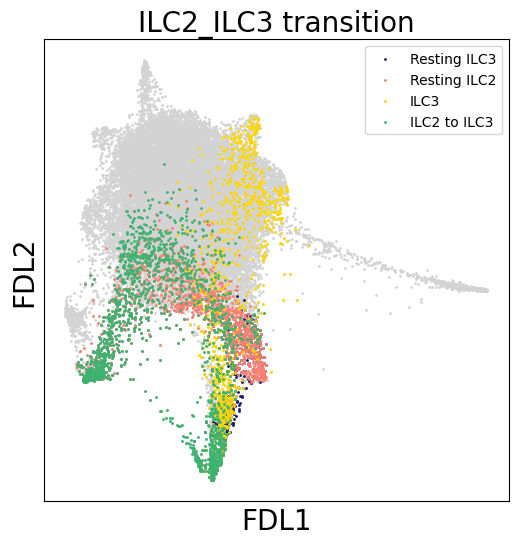

In [392]:
plt.figure(figsize=(6, 6))
frame1 = plt.scatter(Diff[:,0], Diff[:,1], s= 1, c = "lightgrey")
plt.scatter(Diff_ILC3_Q[:,0], Diff_ILC3_Q[:,1], s= 1, c = "midnightblue", label = "Resting ILC3")
plt.scatter(Diff_ILC2_Q[:,0], Diff_ILC2_Q[:,1], s= 1, c = "salmon", label = "Resting ILC2")
plt.scatter(Diff_cloud_ILC3[:,0], Diff_cloud_ILC3[:,1], s= 1, c = "gold", label = "ILC3")
plt.scatter(Diff_ILC2_ILC3[:,0], Diff_ILC2_ILC3[:,1], s= 1, c = "mediumseagreen", label = "ILC2 to ILC3")
plt.title('ILC2_ILC3 transition', fontsize = 20)
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('FDL2', fontsize = 20)
plt.xlabel('FDL1', fontsize = 20)
plt.legend(loc='best')
plt.show()

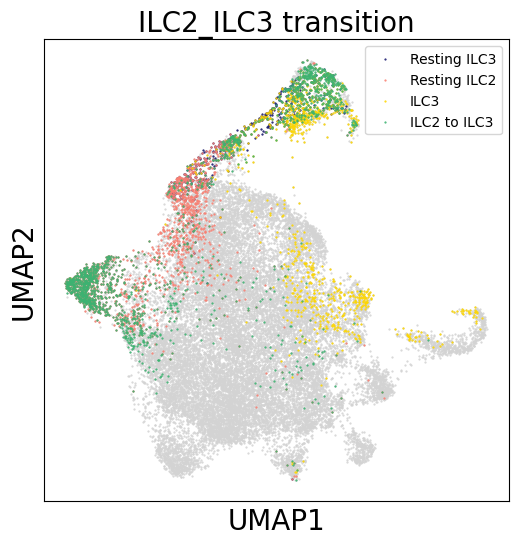

In [393]:
plt.figure(figsize=(6, 6))
frame1 = plt.scatter(UMAP[:,0], UMAP[:,1], s= .3, c = "lightgrey")
plt.scatter(UMAP_ILC3_Q[:,0], UMAP_ILC3_Q[:,1], s= .3, c = "midnightblue", label = "Resting ILC3")
plt.scatter(UMAP_ILC2_Q[:,0], UMAP_ILC2_Q[:,1], s= .3, c = "salmon", label = "Resting ILC2")
plt.scatter(UMAP_cloud_ILC3[:,0], UMAP_cloud_ILC3[:,1], s= .3, c = "gold", label = "ILC3")
plt.scatter(UMAP_ILC2_ILC3[:,0], UMAP_ILC2_ILC3[:,1], s= .3, c = "mediumseagreen", label = "ILC2 to ILC3")
plt.title('ILC2_ILC3 transition', fontsize = 20)
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2', fontsize = 20)
plt.xlabel('UMAP1', fontsize = 20)
plt.legend(loc='best')
plt.show()

# Save or read in matrix with cells of interest

In [394]:
#np.savetxt("ILCs_reads.csv", reads, delimiter=',')
#np.savetxt("ILCs_index.csv", index_val, delimiter=',', fmt="%s")
#np.savetxt("index_cells.csv", index_cells, delimiter=',', fmt="%s")

In [395]:
#ILCs_reads = pd.read_csv("ILCs_reads.csv", sep=",", header = None) #Normalized gene expression of cells of interest
#ILCs_reads_values = np.array(ILCs_reads)

#ILCs_index = pd.read_csv("ILCs_index.csv", sep=",", header = None)

## Distance Matrix

In [396]:
from manifold_utils.mSVD import eigen_plot, eigen_calc_from_dist_mat, eps_projection

In [397]:
np_data = np.array(ILC_total_reads)
N, d = np_data.shape
dist_mat = euclidean_distances(np_data, np_data)

In [398]:
print(dist_mat.shape)

(26877, 26877)


## Witness complex

In [399]:
from time import time
import numpy as np
from tda_utils.density_filtration import sort_distances_per_point, indices_for_density_filtration
from tda_utils.witness_complex import *

dist_per_pt = sort_distances_per_point(dist_mat)

# Load in ILC data
sct_sparse = np_data
dist_mat = dist_mat
n, d = sct_sparse.shape
print("n = "+str(n))
print("d = "+str(d))
print("shape of dist_mat: "+str(dist_mat.shape))

# Load in distances per point
distances_per_point = dist_per_pt

# time computation of density filtrations
print("Timing computation of density filtrations...")
density_indices = dict()
density_filtrations = dict()
ks = [10, 100, 1000]
#      10000]
ps = [0.01, 0.05, 0.1, 0.2]
for k in ks:
    for p in ps:
        print("\tk = "+str(k)+", p = "+str(p)+":")
        start = time()
        indices = indices_for_density_filtration(distances_per_point, k, p)
        density_indices[(k, p)] = indices
        mask = np.zeros(n, dtype=bool)
        mask[indices] = True
        sqr_mask = np.outer(mask, mask)
        density_filtrations[(k, p)] = np.reshape(dist_mat[sqr_mask], (len(indices), len(indices)))
        print("\t"+str(time()-start)+" seconds\n")

print("Timing computation of landmarks...")
landmark_indices = dict()
landmark_mats = dict()
pps = [0.05, 0.1, 0.2]
for k in ks:
    for p in ps:
        for pp in pps:
            print("\tk = "+str(k)+", p = "+str(p)+", pp = "+str(pp)+":")
            start = time()
            landmark_indices[(k, p, pp)], landmark_mats[(k, p, pp)] = choose_landmarks(density_filtrations[(k, p)], pp)
            print("\t"+str(time()-start)+" seconds\n")

print("Printing numbers of landmarks...")
for k in ks:
    for p in ps:
        for pp in pps:
            toople = (k, p, pp)
            print(str(toople)+": "+str(len(landmark_indices[toople])))
            if toople == (1000, 0.2, 0.2):
                print("saving")
                landmark_inds = landmark_indices[toople]
                dense_inds = density_indices[(k, p)]
                true_inds = [dense_inds[ind] for ind in landmark_inds]
                print(true_inds)
                to_save = np.vstack([sct_sparse[ind, :] for ind in true_inds])
                np.save("ILC_landmarks.npy", to_save)
                np.save("ILC_landmark_indices.npy", true_inds)

n = 26877
d = 3000
shape of dist_mat: (26877, 26877)
Timing computation of density filtrations...
	k = 10, p = 0.01:
	0.7121593952178955 seconds

	k = 10, p = 0.05:
	0.932208776473999 seconds

	k = 10, p = 0.1:
	1.0992462635040283 seconds

	k = 10, p = 0.2:
	1.6693832874298096 seconds

	k = 100, p = 0.01:
	0.7031583786010742 seconds

	k = 100, p = 0.05:
	1.1802642345428467 seconds

	k = 100, p = 0.1:
	1.0992460250854492 seconds

	k = 100, p = 0.2:
	1.602349042892456 seconds

	k = 1000, p = 0.01:
	0.6981565952301025 seconds

	k = 1000, p = 0.05:
	0.9662163257598877 seconds

	k = 1000, p = 0.1:
	1.1772634983062744 seconds

	k = 1000, p = 0.2:
	1.674384593963623 seconds

Timing computation of landmarks...
	k = 10, p = 0.01, pp = 0.05:
	0.0 seconds

	k = 10, p = 0.01, pp = 0.1:
	0.0010006427764892578 seconds

	k = 10, p = 0.01, pp = 0.2:
	0.0 seconds

	k = 10, p = 0.05, pp = 0.05:
	0.002000093460083008 seconds

	k = 10, p = 0.05, pp = 0.1:
	0.002000093460083008 seconds

	k = 10, p = 0.05, 

## Visualize Landmarks

In [400]:
landmarks = np.load("ILC_landmarks.npy")

landmarks = true_inds

In [401]:
N, d = np_data.shape

UMAP = np.array(UMAP)
print(UMAP.shape)

Diff_landmark = np.zeros((1,2))
UMAP_landmark = np.zeros((1,2))
data_landmark = np.zeros((1,d))

#Going through all of the cells, if index in landmarks we should pull the associated gene expression data
for i in landmarks:
    next_cell = np_data[i,:]
    next_cell = np.reshape(next_cell, (1, d))
    data_landmark = np.append(data_landmark, next_cell, axis = 0)
        
    next_embedding = UMAP[i,:]
    next_embedding = np.reshape(next_embedding, (1,2))
    next_embedding_D = Diff[i,:]
    next_embedding_D = np.reshape(next_embedding_D, (1,2))
    UMAP_landmark = np.append(UMAP_landmark, next_embedding, axis = 0)
    Diff_landmark = np.append(Diff_landmark, next_embedding_D, axis = 0)

#To get the indices to work out I have a row of zeros at the top that I need to omit
data_landmark = data_landmark[1:, :]    
UMAP_landmark = UMAP_landmark[1:, :]
Diff_landmark = Diff_landmark[1:, :]

print(data_landmark.shape)
print(UMAP_landmark.shape)
print(Diff_landmark.shape)

(26877, 2)
(1075, 3000)
(1075, 2)
(1075, 2)


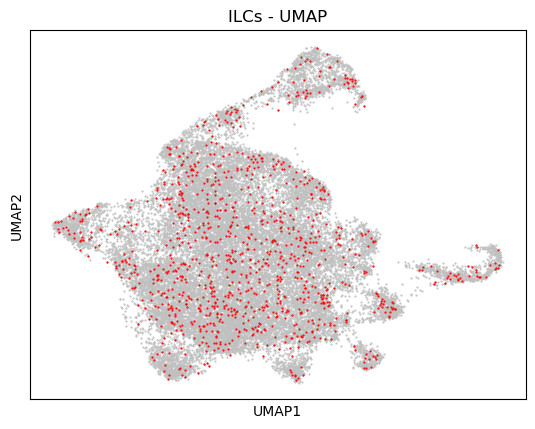

In [402]:
frame1 = plt.scatter(UMAP[:,0], UMAP[:,1], s=0.3, c = "silver")
frame1 = plt.scatter(UMAP_landmark[:,0], UMAP_landmark[:,1], s=0.3, c = "red")
plt.title('ILCs - UMAP')
#plt.xlim(-30000,25000)
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')
plt.show()

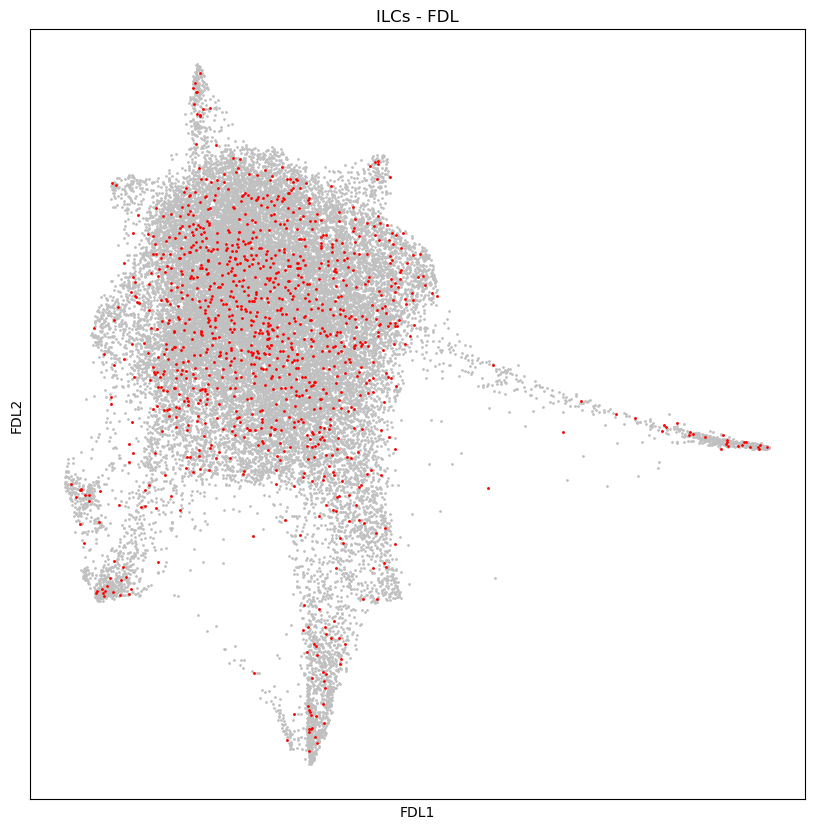

In [403]:
plt.figure(figsize=(10, 10))
frame1 = plt.scatter(Diff[:,0], Diff[:,1], s=1, c = "silver")
frame1 = plt.scatter(Diff_landmark[:,0], Diff_landmark[:,1], s=1, c = "red")
plt.title('ILCs - FDL')
#plt.xlim(-30000,25000)
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('FDL2')
plt.xlabel('FDL1')
plt.show()

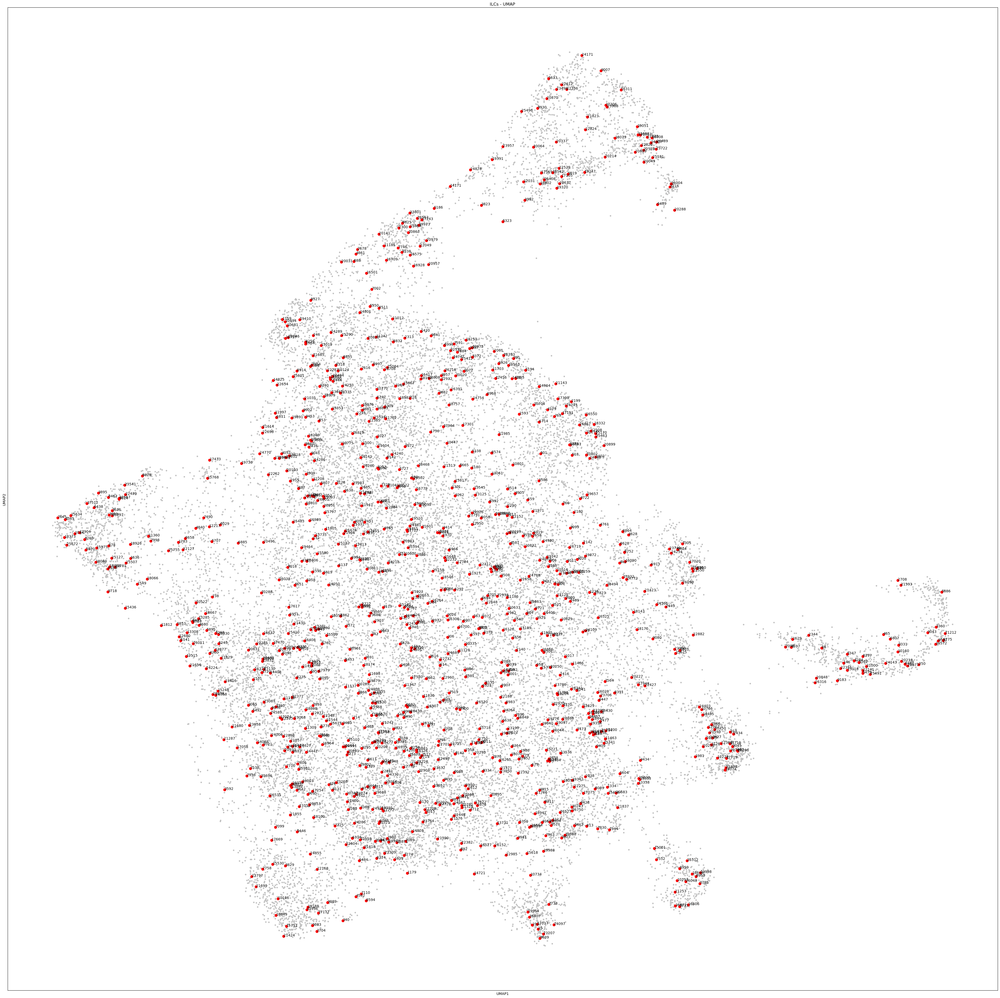

In [404]:
plt.figure(figsize=(50, 50))
frame1 = plt.scatter(UMAP[:,0], UMAP[:,1], s=10, c = "silver")
frame1 = plt.scatter(UMAP_landmark[:,0], UMAP_landmark[:,1], s=50, c = "red")
plt.title('ILCs - UMAP')
#plt.xlim(-30000,25000)
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')

for count, value in enumerate(landmarks):
    plt.annotate(value, (UMAP_landmark[count,0], UMAP_landmark[count,1]))
    
plt.show()

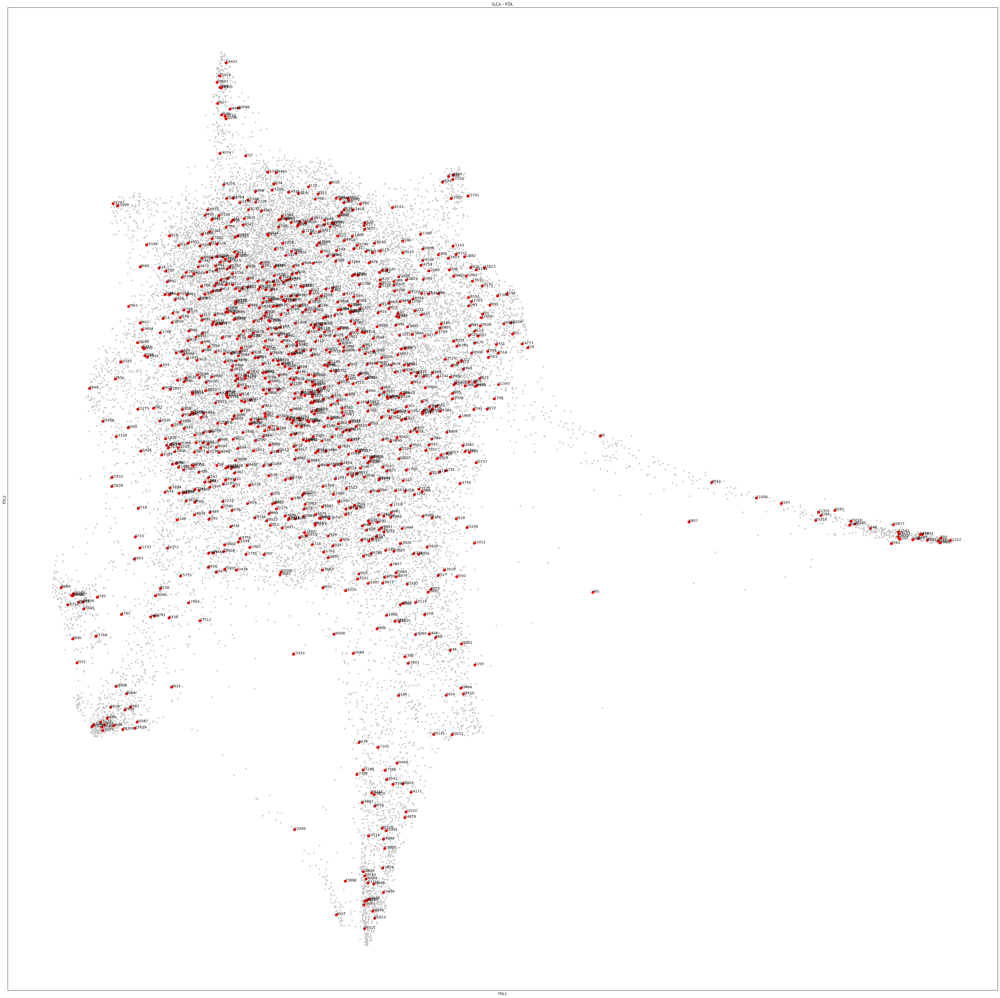

In [405]:
plt.figure(figsize=(50, 50))
frame1 = plt.scatter(Diff[:,0], Diff[:,1], s=10, c = "silver")
frame1 = plt.scatter(Diff_landmark[:,0], Diff_landmark[:,1], s=50, c = "red")
plt.title('ILCs - FDL')
#plt.xlim(-30000,25000)
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('FDL2')
plt.xlabel('FDL1')

for count, value in enumerate(landmarks):
    plt.annotate(value, (Diff_landmark[count,0], Diff_landmark[count,1]))
    
plt.show()

## Persistence Diagrams

c:\users\hmkri\desktop\riesenfeld pearson\lib\site-packages\ripser\ripser.py:257: UserWarning: The input point cloud has more columns than rows; did you mean to transpose?
  warnings.warn(


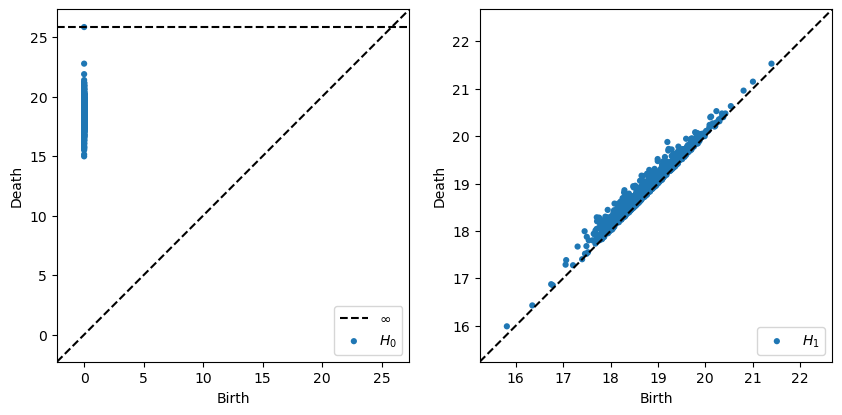

In [103]:
dgms = ripser(data_landmark, maxdim=1)['dgms']

plt.figure(figsize=(10, 5))
plot_diagrams(dgms, plot_only=[0], ax=plt.subplot(121))
plot_diagrams(dgms, plot_only=[1], ax=plt.subplot(122))

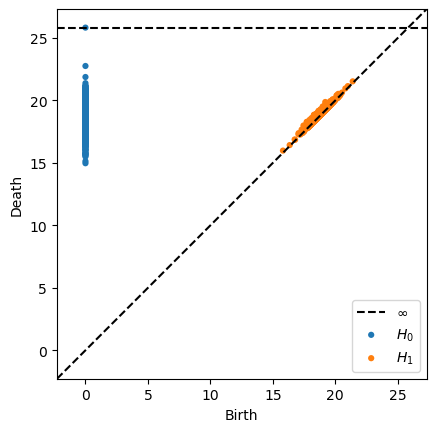

In [104]:
plot_diagrams(dgms, show=True)

## Eigen plots

In [28]:
from manifold_utils.mSVD import eigen_plot, eigen_calc_from_dist_mat, eps_projection, eigen_plot_numPoints, eigen_calc_from_dist_mat_withNumPoints
from manifold_utils.iga import chakraborty_express, iga

  0%|                                                                                         | 0/1075 [00:00<?, ?it/s]

5879


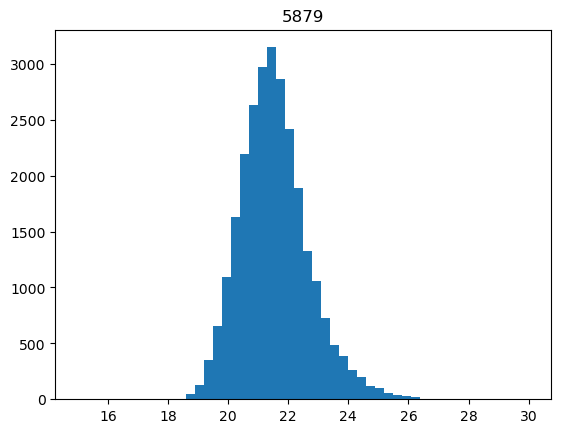

  0%|                                                                                 | 1/1075 [00:00<02:13,  8.06it/s]

19683


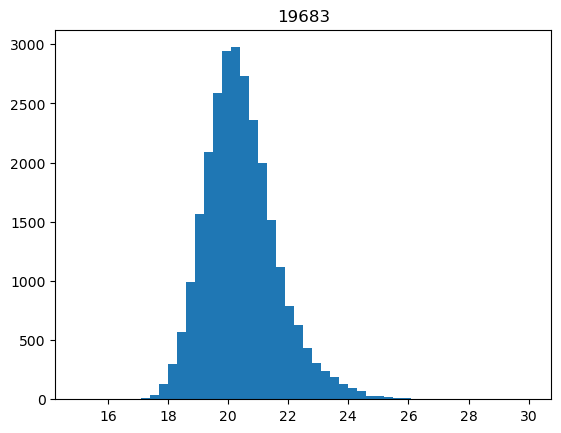

  0%|▏                                                                                | 2/1075 [00:00<02:13,  8.06it/s]

26501


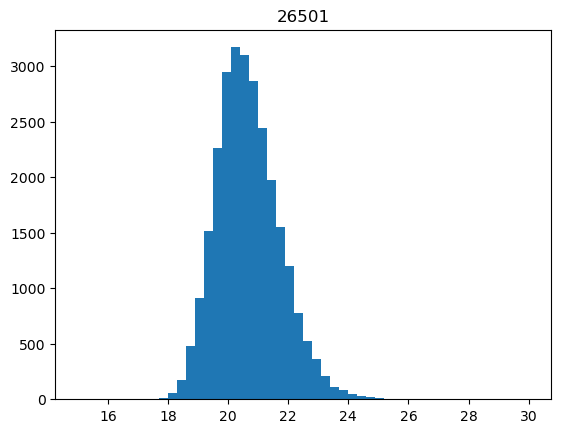

  0%|▏                                                                                | 3/1075 [00:00<02:12,  8.06it/s]

10621


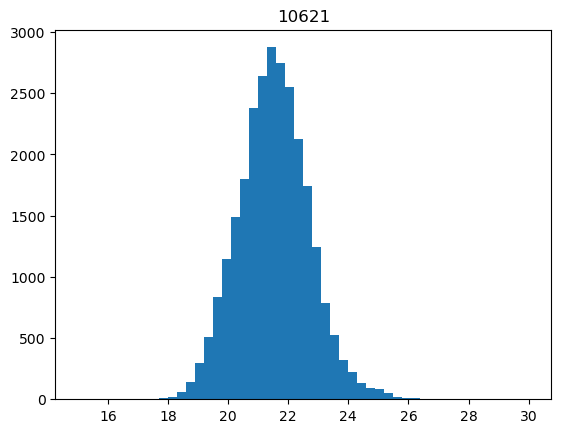

  0%|▎                                                                                | 4/1075 [00:00<02:12,  8.06it/s]

14172


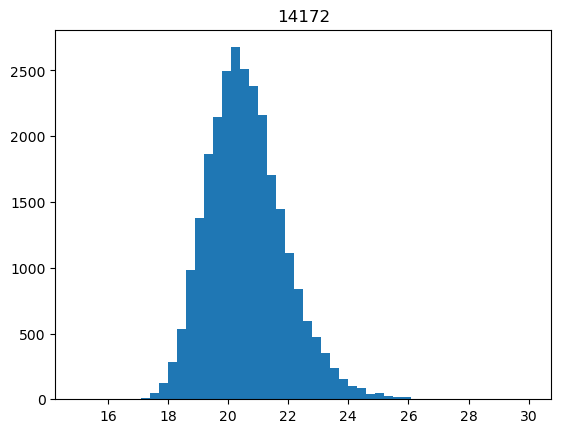

  0%|▍                                                                                | 5/1075 [00:00<02:12,  8.06it/s]

14752


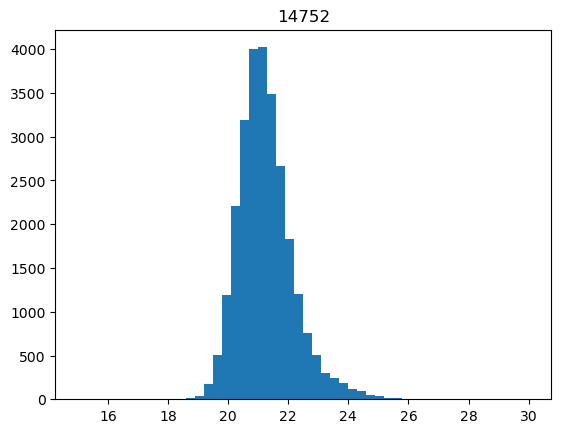

  1%|▍                                                                                | 6/1075 [00:00<02:40,  6.67it/s]

6793


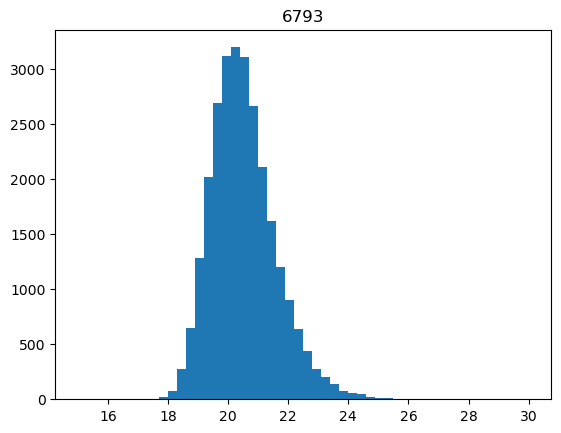

  1%|▌                                                                                | 7/1075 [00:00<02:31,  7.04it/s]

10140


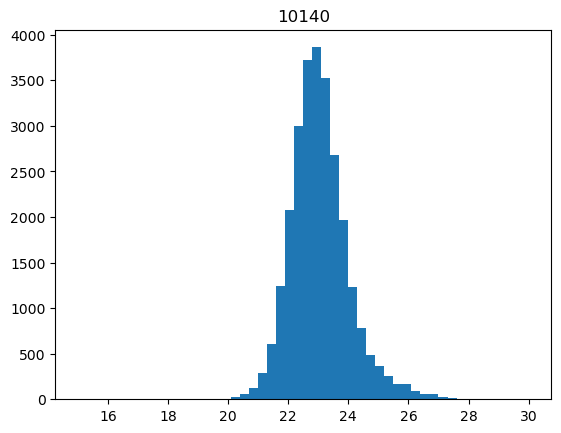

  1%|▌                                                                                | 8/1075 [00:01<02:26,  7.27it/s]

7647


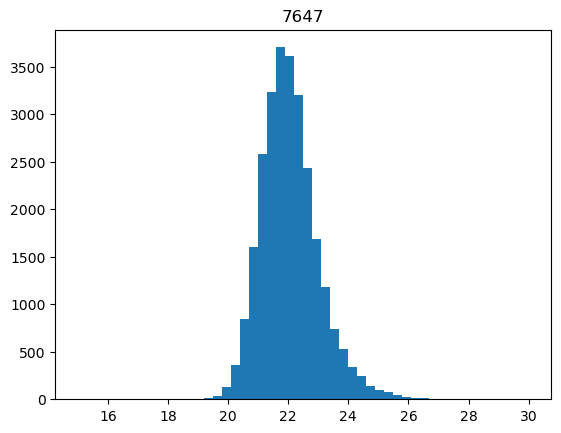

  1%|▋                                                                                | 9/1075 [00:01<02:23,  7.44it/s]

1632


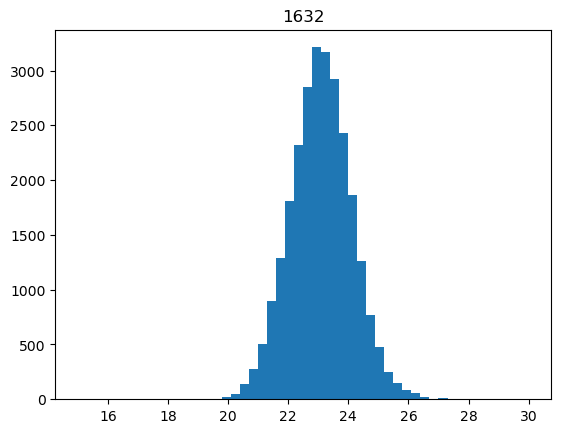

  1%|▋                                                                               | 10/1075 [00:01<02:19,  7.63it/s]

4884


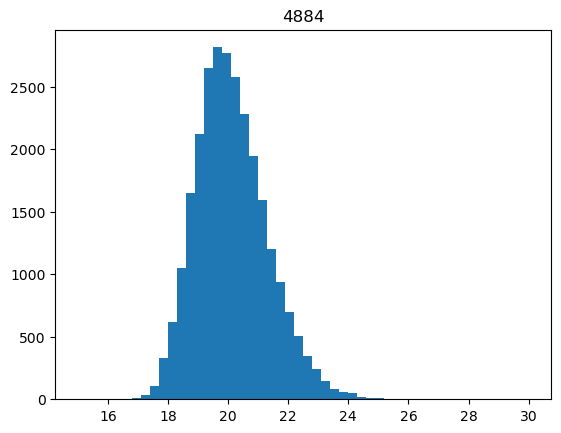

  1%|▊                                                                               | 11/1075 [00:01<02:16,  7.79it/s]

3226


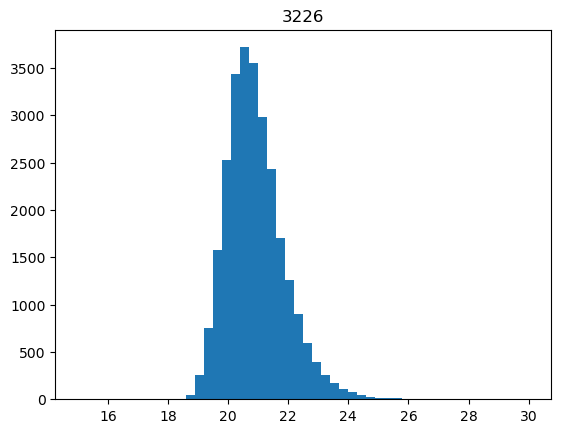

  1%|▉                                                                               | 12/1075 [00:01<02:16,  7.78it/s]

6249


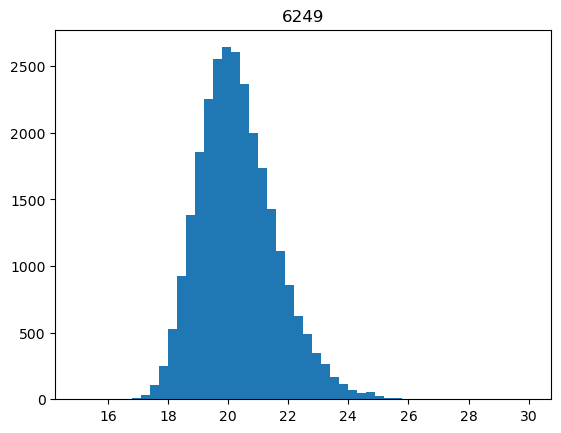

  1%|▉                                                                               | 13/1075 [00:01<02:15,  7.86it/s]

210


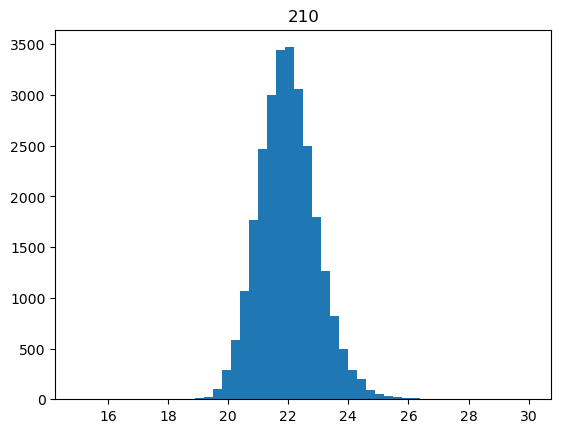

  1%|█                                                                               | 14/1075 [00:01<02:14,  7.87it/s]

1398


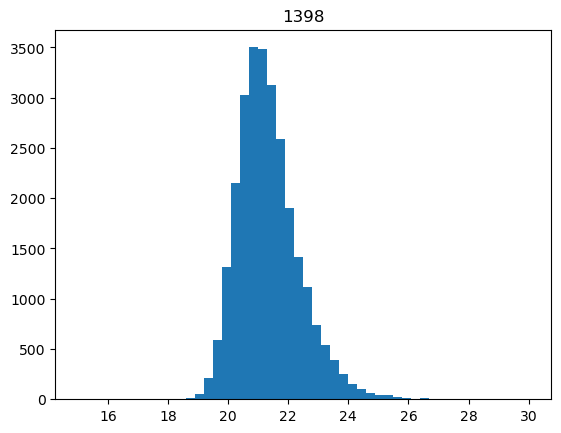

  1%|█                                                                               | 15/1075 [00:01<02:14,  7.91it/s]

25559


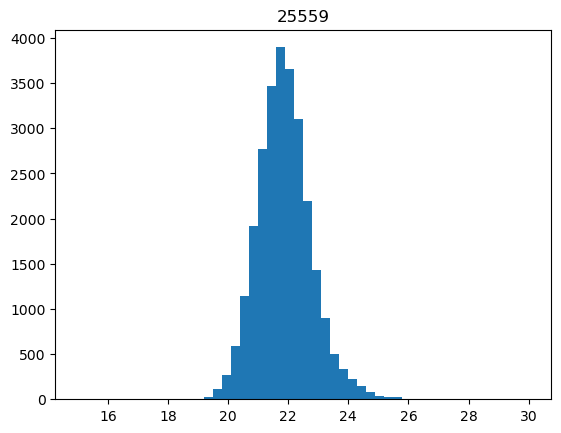

  1%|█▏                                                                              | 16/1075 [00:02<02:14,  7.86it/s]

9018


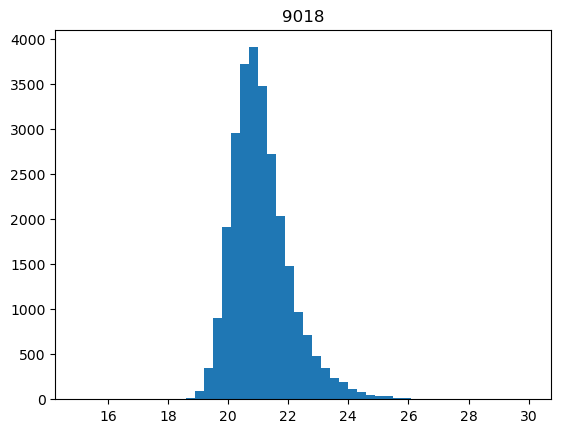

  2%|█▎                                                                              | 17/1075 [00:02<02:40,  6.57it/s]

6605


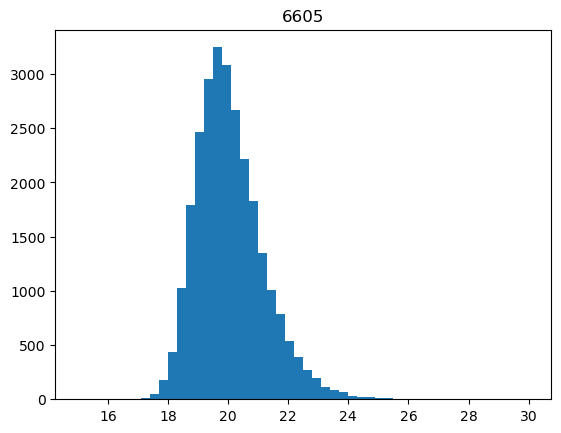

  2%|█▎                                                                              | 18/1075 [00:02<02:31,  6.96it/s]

9321


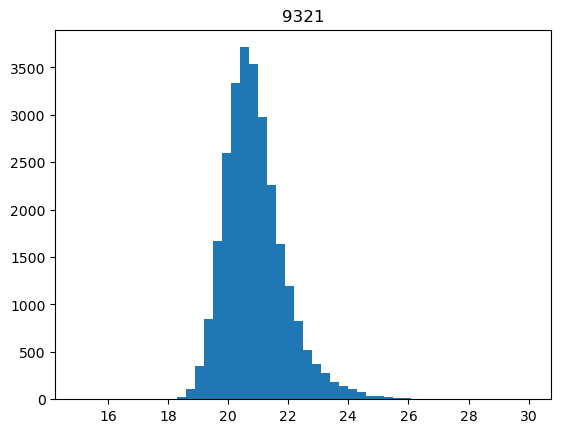

  2%|█▍                                                                              | 19/1075 [00:02<02:27,  7.16it/s]

21948


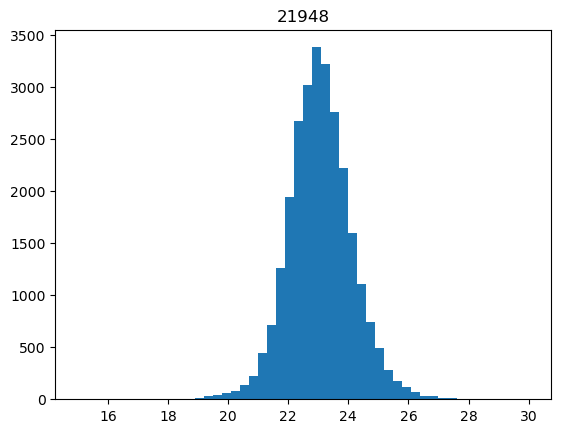

  2%|█▍                                                                              | 20/1075 [00:02<02:24,  7.28it/s]

6332


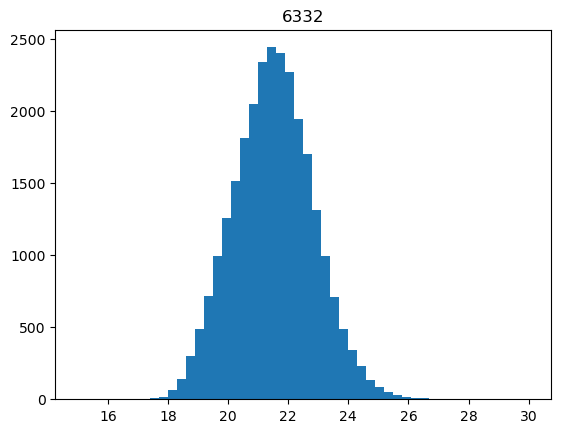

  2%|█▌                                                                              | 21/1075 [00:02<02:22,  7.40it/s]

7703


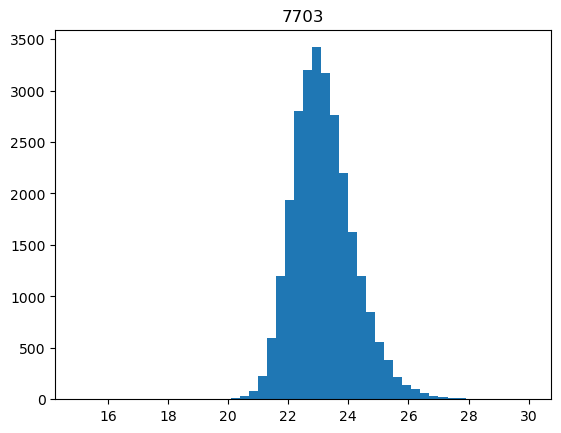

  2%|█▋                                                                              | 22/1075 [00:02<02:20,  7.50it/s]

4692


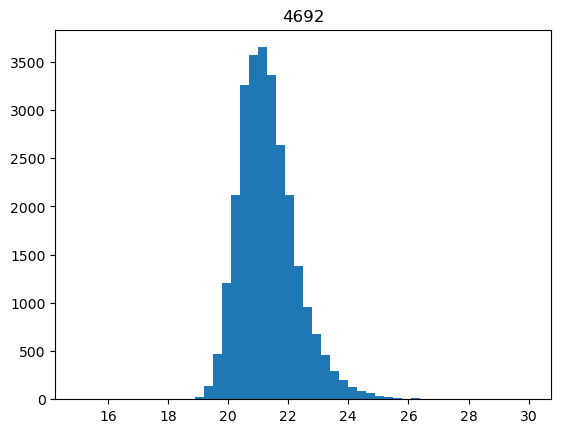

  2%|█▋                                                                              | 23/1075 [00:03<02:17,  7.63it/s]

10324


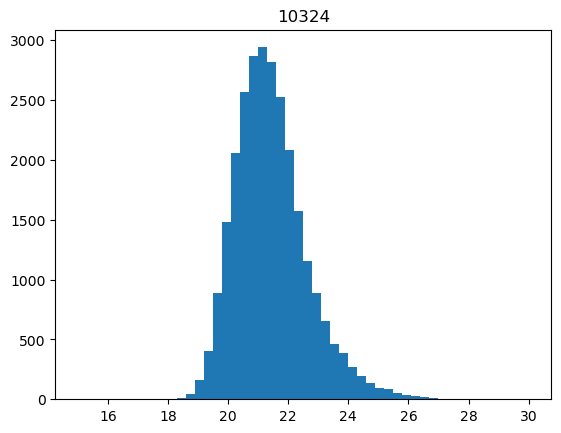

  2%|█▊                                                                              | 24/1075 [00:03<02:16,  7.68it/s]

7698


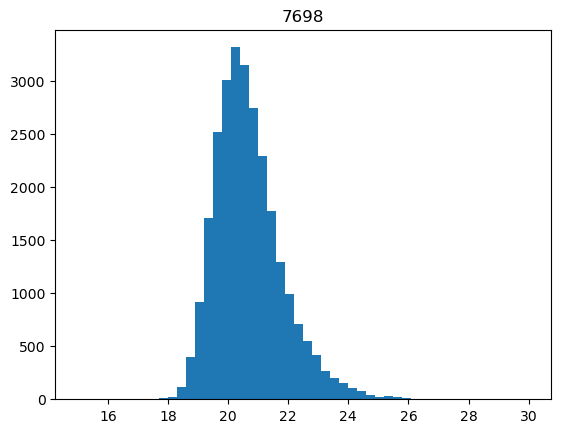

  2%|█▊                                                                              | 25/1075 [00:03<02:15,  7.74it/s]

21520


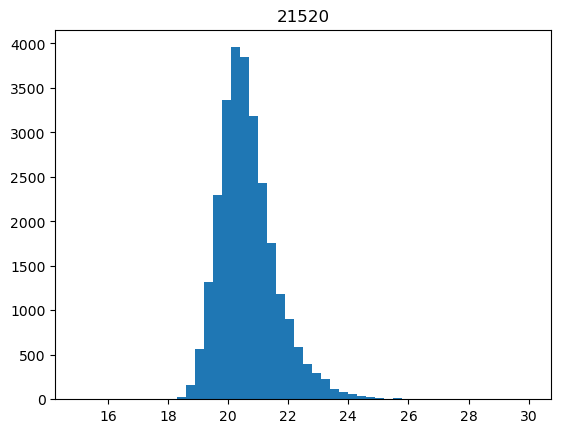

  2%|█▉                                                                              | 26/1075 [00:03<02:16,  7.67it/s]

2725


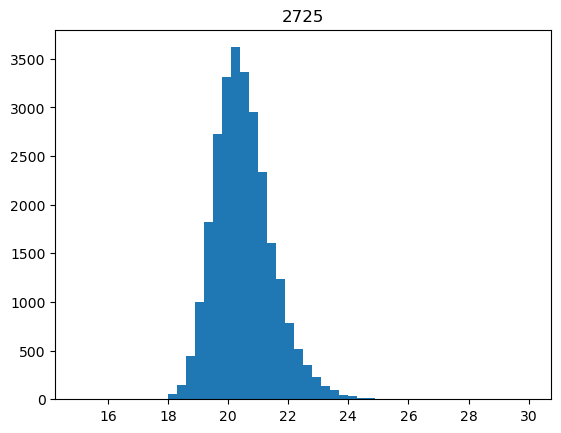

  3%|██                                                                              | 27/1075 [00:03<02:16,  7.69it/s]

6098


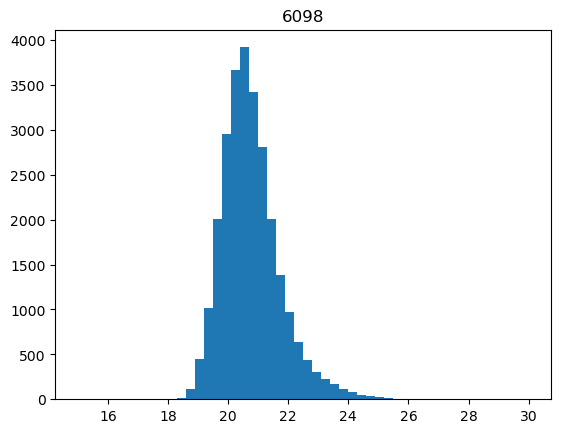

  3%|██                                                                              | 28/1075 [00:03<02:41,  6.48it/s]

16774


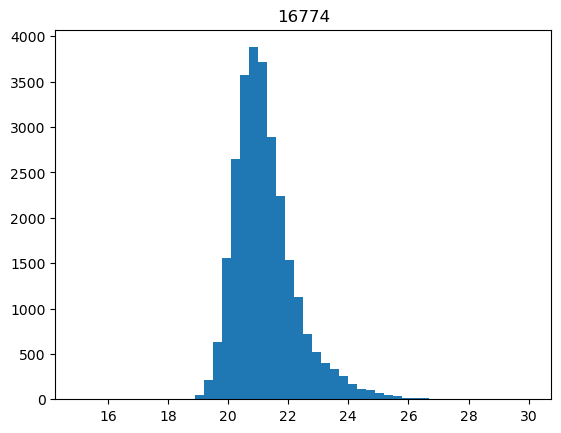

  3%|██▏                                                                             | 29/1075 [00:03<02:33,  6.82it/s]

17413


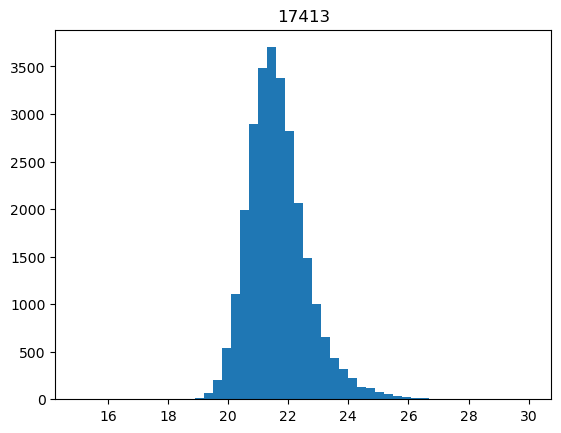

  3%|██▏                                                                             | 30/1075 [00:04<02:26,  7.13it/s]

5598


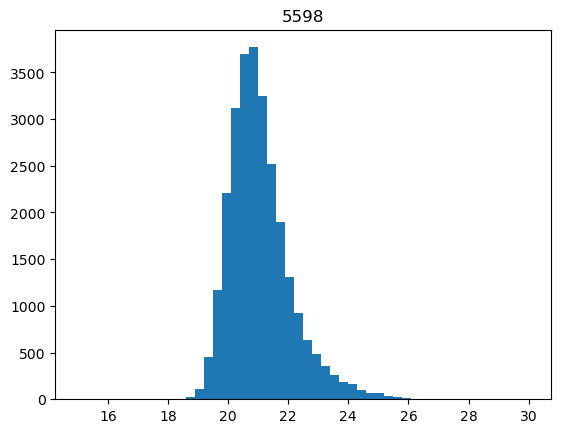

  3%|██▎                                                                             | 31/1075 [00:04<02:22,  7.31it/s]

4432


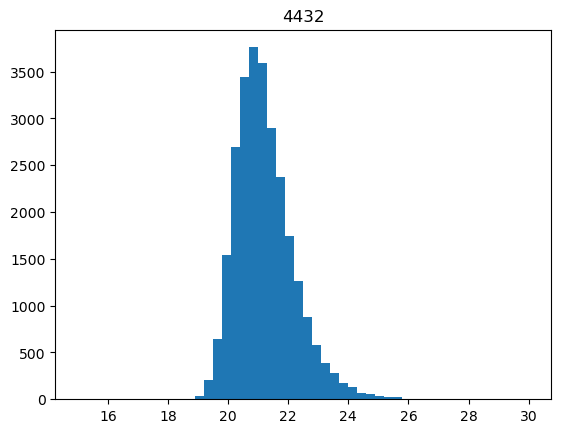

  3%|██▍                                                                             | 32/1075 [00:04<02:19,  7.47it/s]

4753


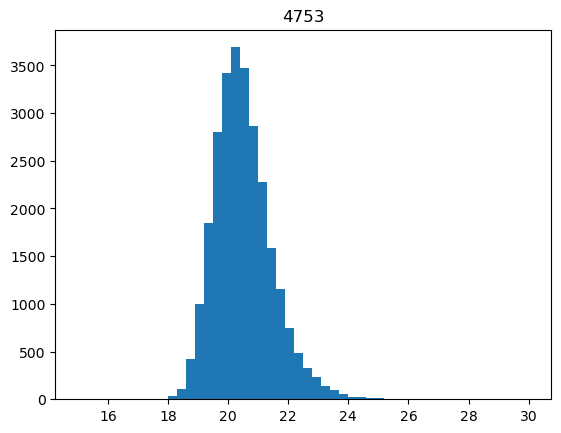

  3%|██▍                                                                             | 33/1075 [00:04<02:16,  7.62it/s]

4230


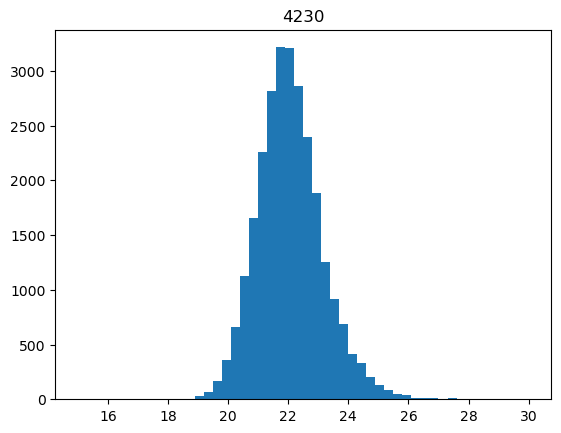

  3%|██▌                                                                             | 34/1075 [00:04<02:15,  7.68it/s]

5092


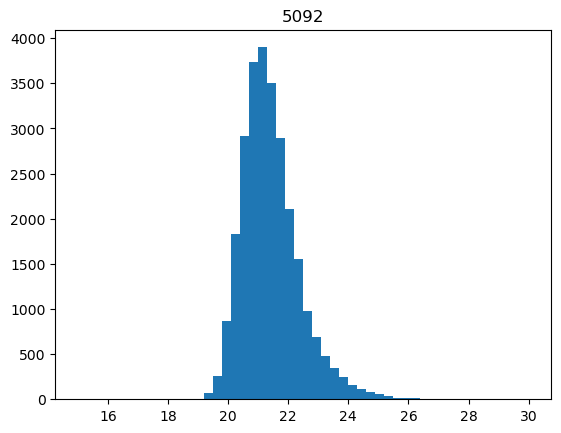

  3%|██▌                                                                             | 35/1075 [00:04<02:16,  7.65it/s]

9791


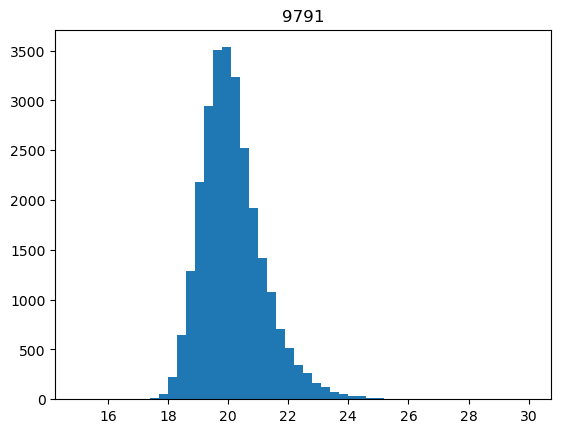

  3%|██▋                                                                             | 36/1075 [00:04<02:15,  7.68it/s]

5170


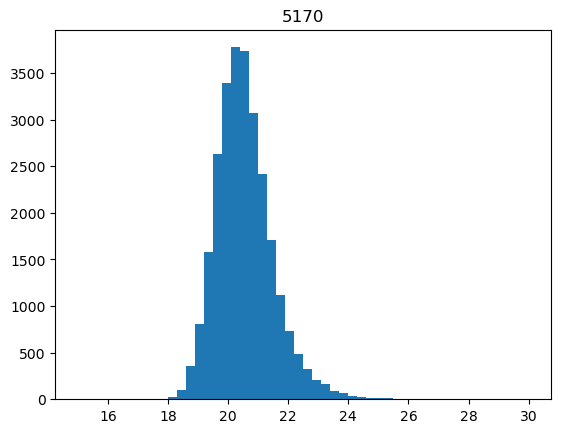

  3%|██▊                                                                             | 37/1075 [00:04<02:14,  7.70it/s]

20458


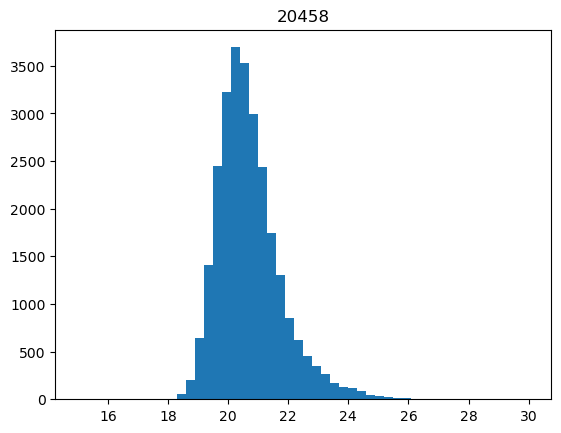

  4%|██▊                                                                             | 38/1075 [00:05<02:15,  7.63it/s]

15006


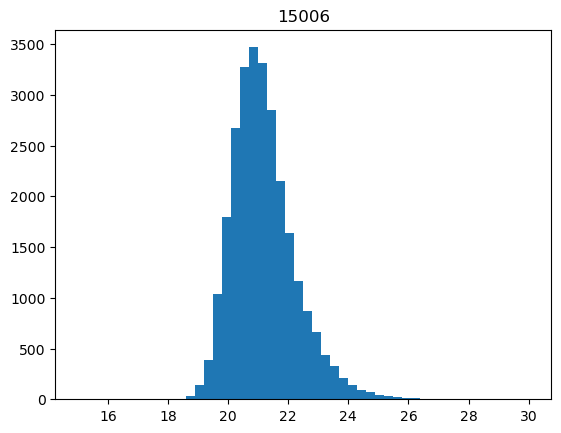

  4%|██▉                                                                             | 39/1075 [00:05<02:43,  6.35it/s]

9959


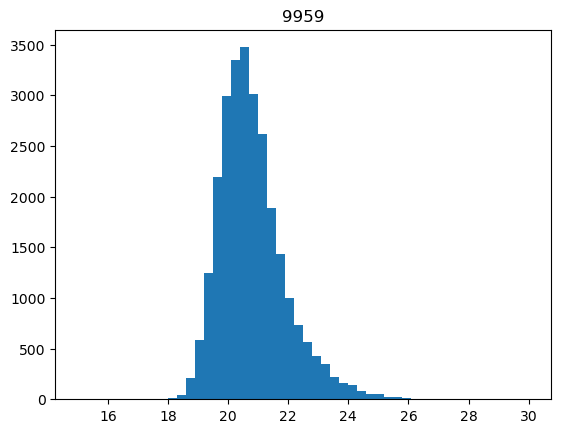

  4%|██▉                                                                             | 40/1075 [00:05<02:34,  6.70it/s]

3709


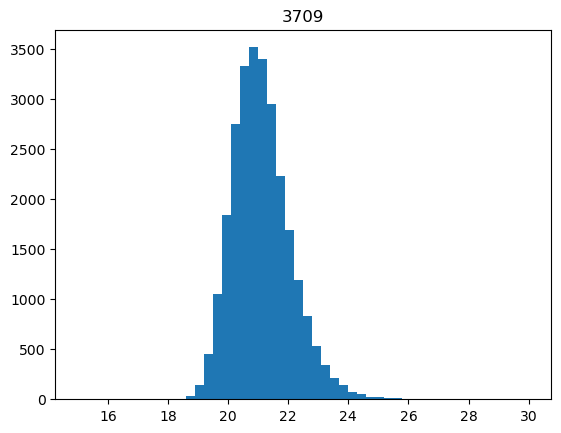

  4%|███                                                                             | 41/1075 [00:05<02:28,  6.97it/s]

14926


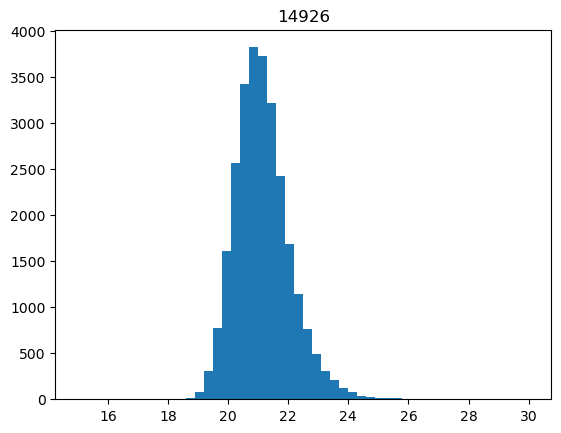

  4%|███▏                                                                            | 42/1075 [00:05<02:24,  7.17it/s]

5895


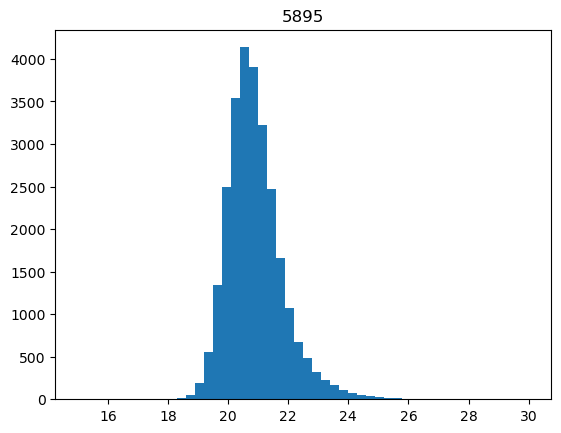

  4%|███▏                                                                            | 43/1075 [00:05<02:21,  7.30it/s]

16163


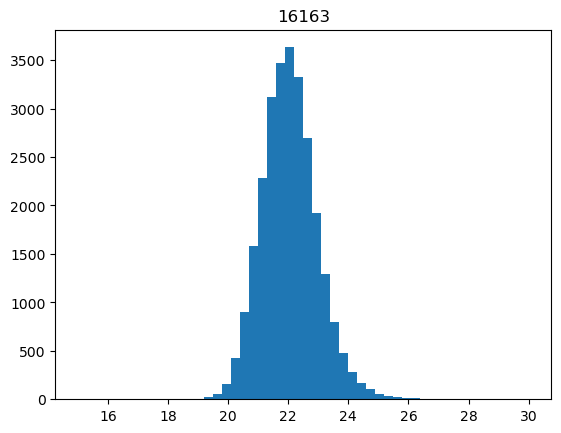

  4%|███▎                                                                            | 44/1075 [00:05<02:19,  7.42it/s]

332


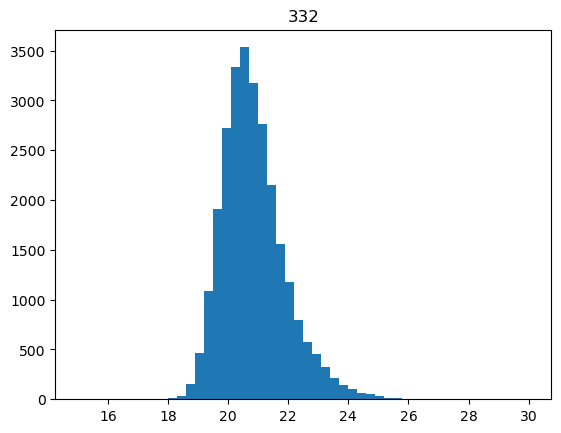

  4%|███▎                                                                            | 45/1075 [00:06<02:16,  7.56it/s]

5671


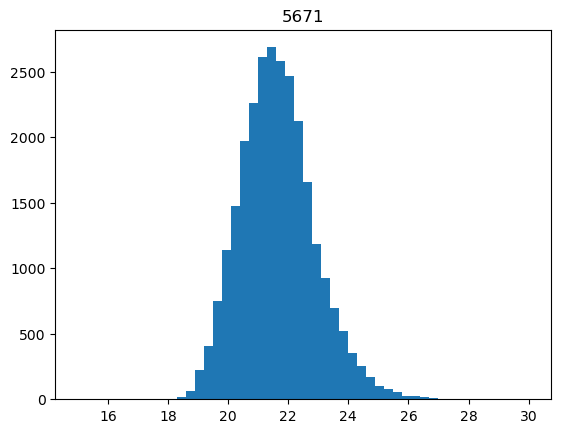

  4%|███▍                                                                            | 46/1075 [00:06<02:13,  7.72it/s]

353


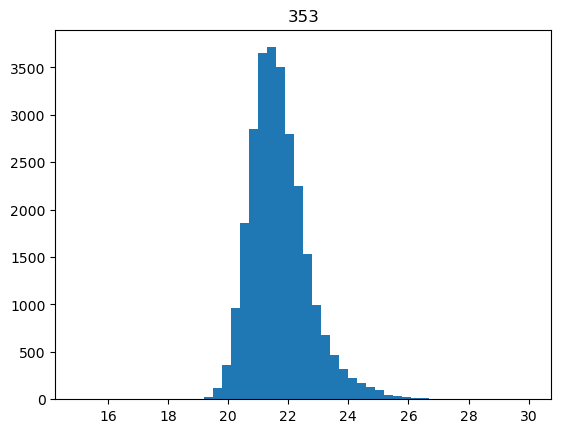

  4%|███▍                                                                            | 47/1075 [00:06<02:11,  7.82it/s]

6421


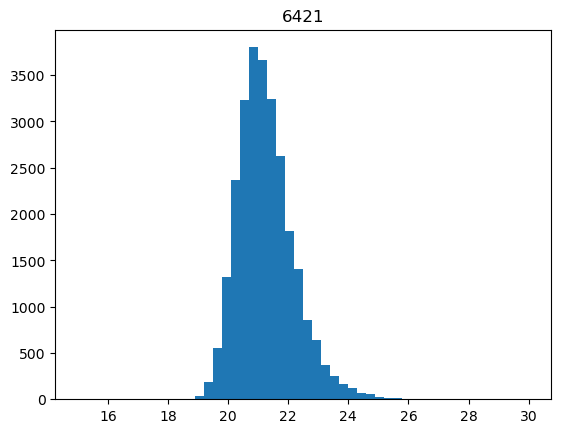

  4%|███▌                                                                            | 48/1075 [00:06<02:09,  7.91it/s]

2603


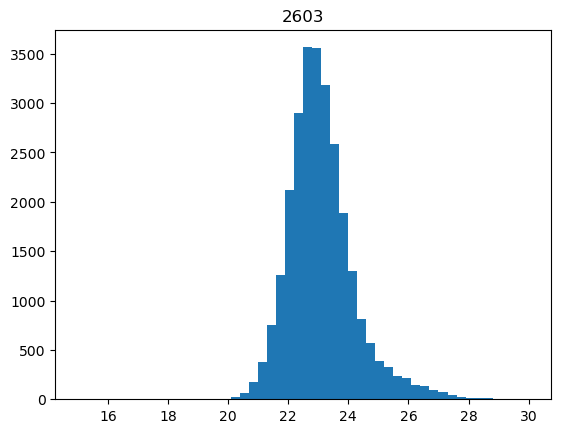

  5%|███▋                                                                            | 49/1075 [00:06<02:09,  7.94it/s]

21971


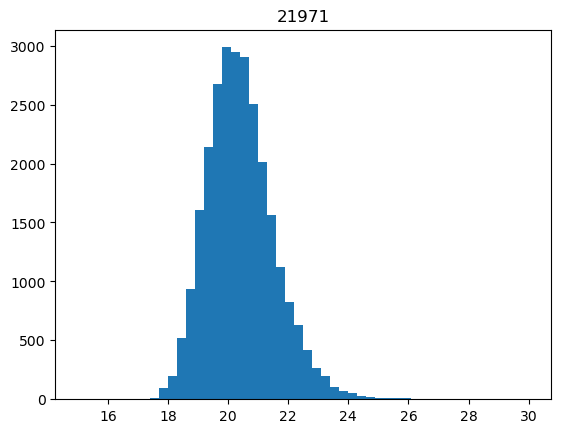

  5%|███▋                                                                            | 50/1075 [00:06<02:34,  6.65it/s]

8855


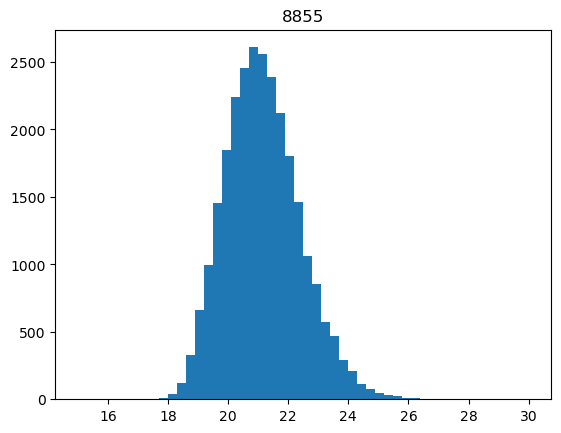

  5%|███▊                                                                            | 51/1075 [00:06<02:24,  7.07it/s]

5962


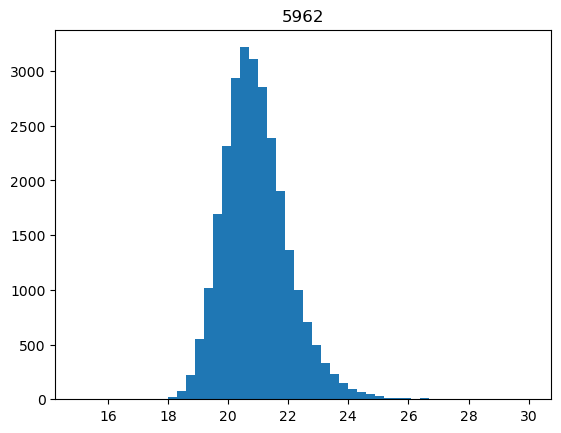

  5%|███▊                                                                            | 52/1075 [00:07<02:19,  7.35it/s]

10698


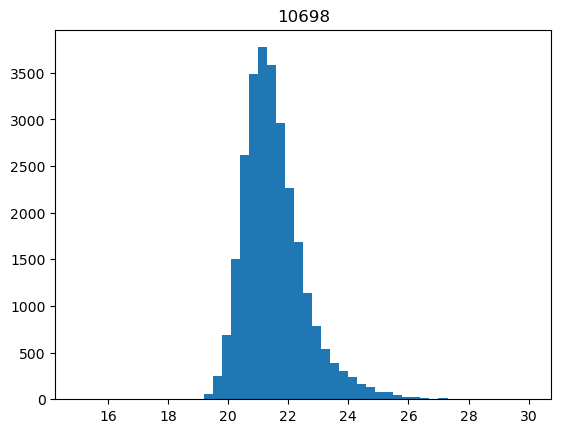

  5%|███▉                                                                            | 53/1075 [00:07<02:15,  7.54it/s]

23253


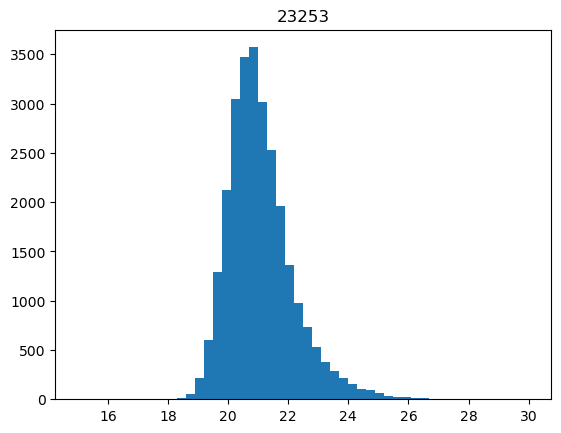

  5%|████                                                                            | 54/1075 [00:07<02:13,  7.65it/s]

8212


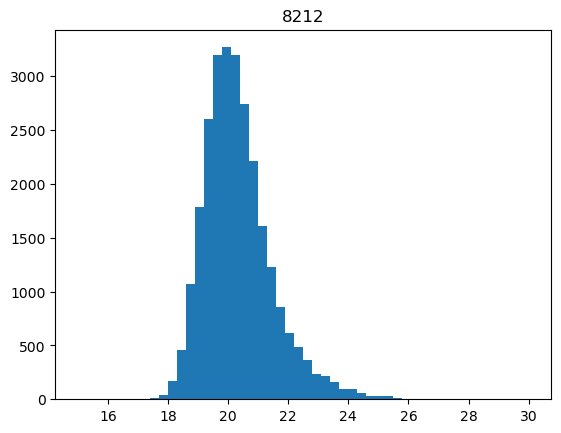

  5%|████                                                                            | 55/1075 [00:07<02:10,  7.81it/s]

8706


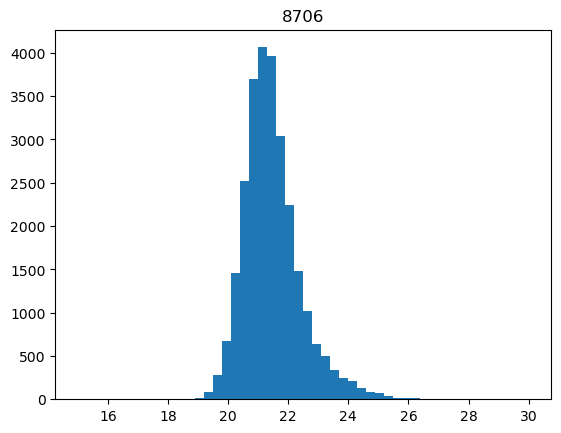

  5%|████▏                                                                           | 56/1075 [00:07<02:09,  7.84it/s]

19796


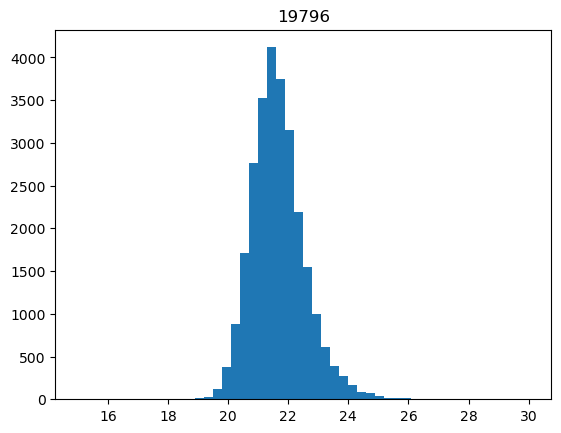

  5%|████▏                                                                           | 57/1075 [00:07<02:09,  7.85it/s]

3204


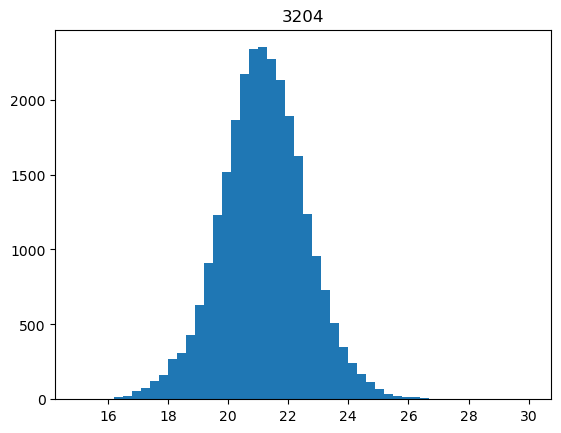

  5%|████▎                                                                           | 58/1075 [00:07<02:06,  8.01it/s]

10911


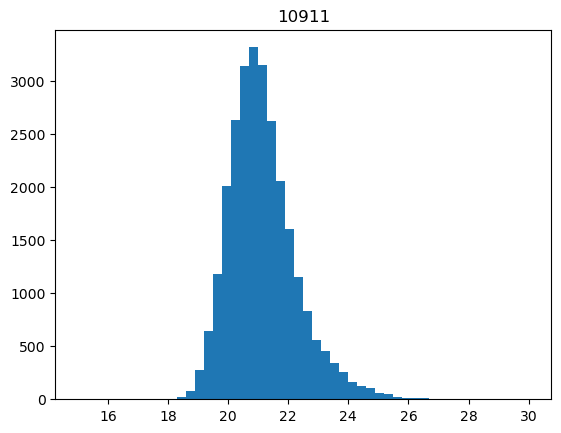

  5%|████▍                                                                           | 59/1075 [00:07<02:06,  8.03it/s]

6913


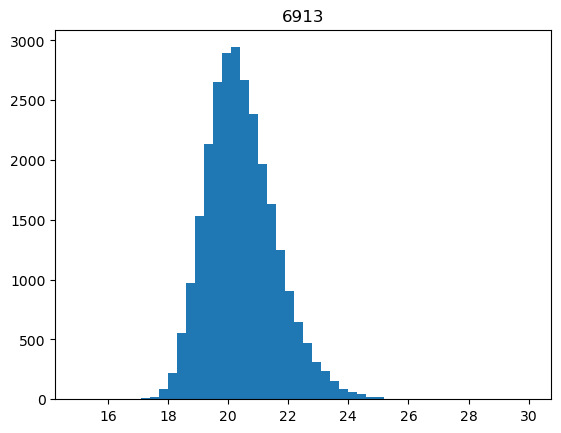

  6%|████▍                                                                           | 60/1075 [00:08<02:07,  7.98it/s]

8465


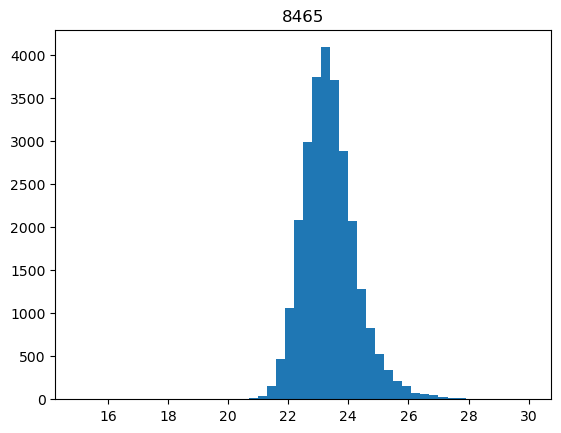

  6%|████▌                                                                           | 61/1075 [00:08<02:32,  6.63it/s]

8260


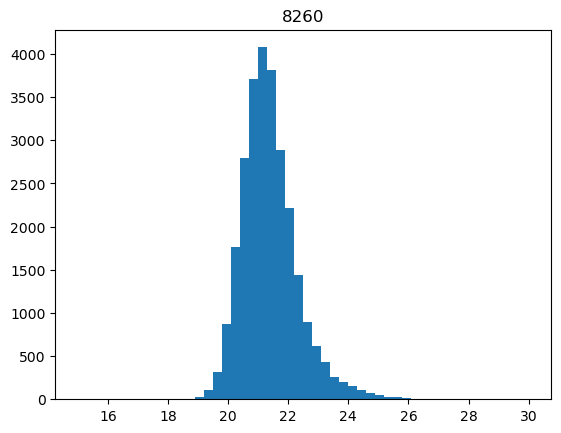

  6%|████▌                                                                           | 62/1075 [00:08<02:25,  6.98it/s]

8330


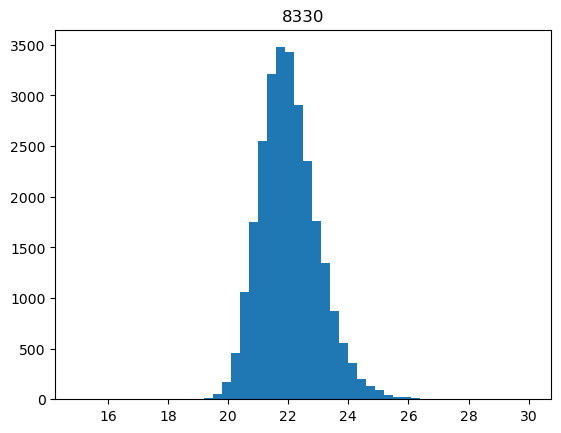

  6%|████▋                                                                           | 63/1075 [00:08<02:20,  7.21it/s]

8885


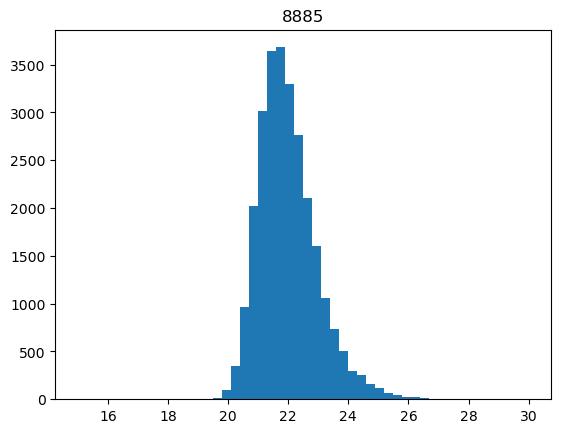

  6%|████▊                                                                           | 64/1075 [00:08<02:16,  7.40it/s]

11305


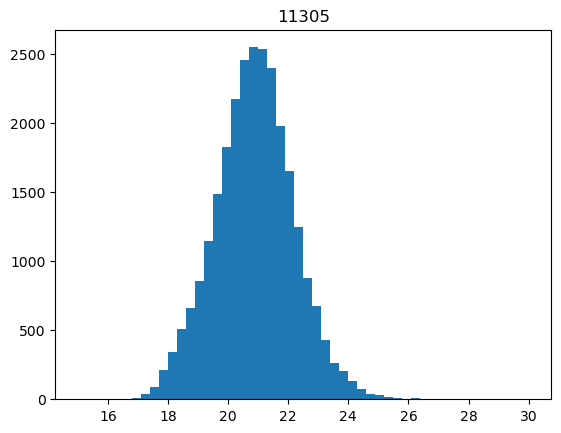

  6%|████▊                                                                           | 65/1075 [00:08<02:13,  7.57it/s]

16159


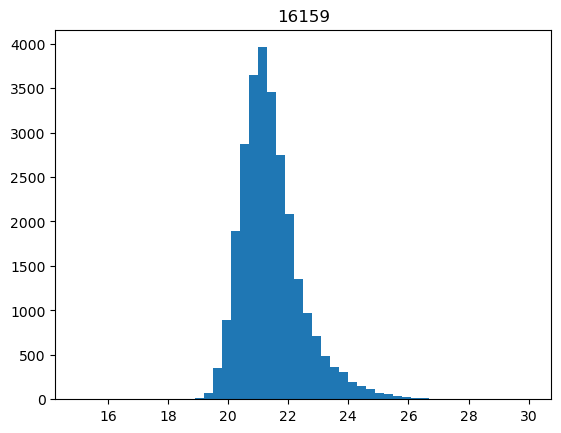

  6%|████▉                                                                           | 66/1075 [00:08<02:12,  7.60it/s]

14465


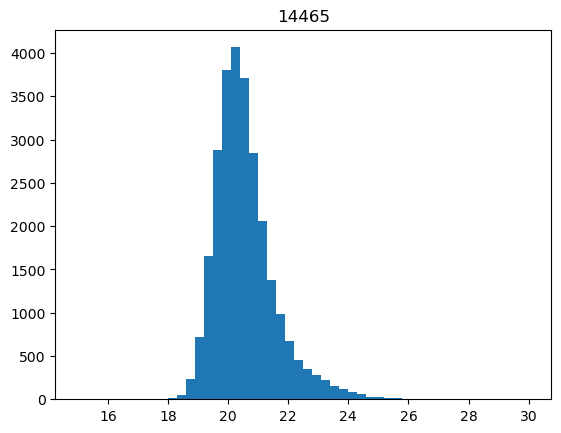

  6%|████▉                                                                           | 67/1075 [00:08<02:12,  7.63it/s]

11104


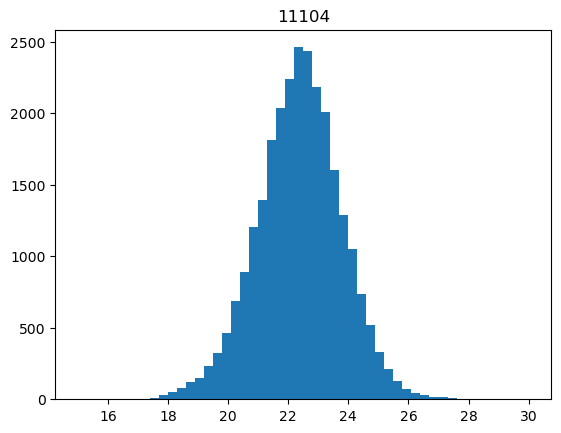

  6%|█████                                                                           | 68/1075 [00:09<02:09,  7.79it/s]

16477


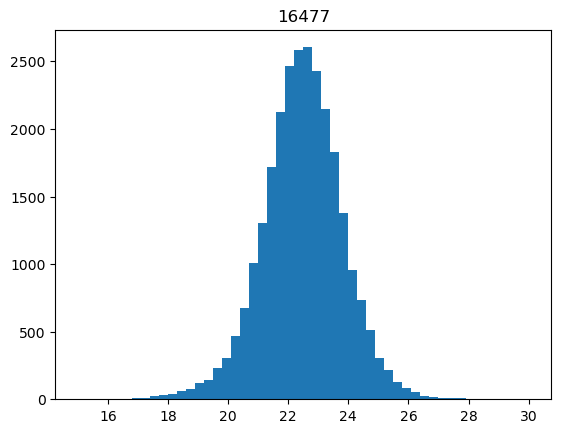

  6%|█████▏                                                                          | 69/1075 [00:09<02:06,  7.93it/s]

25697


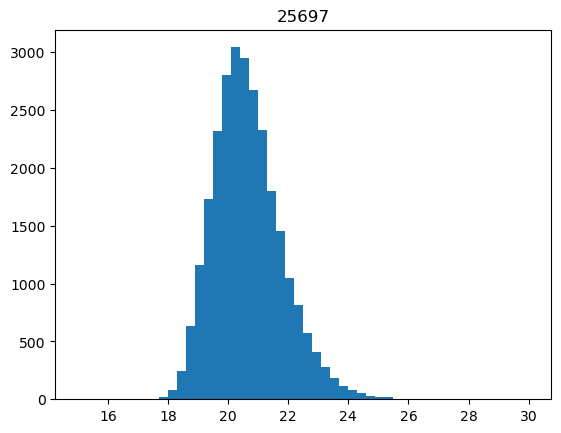

  7%|█████▏                                                                          | 70/1075 [00:09<02:05,  7.99it/s]

6007


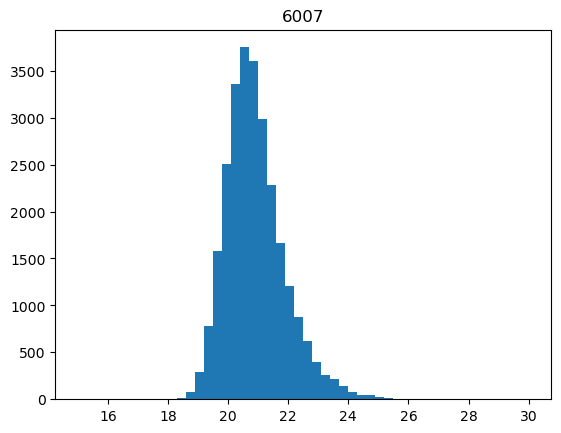

  7%|█████▎                                                                          | 71/1075 [00:09<02:06,  7.95it/s]

4661


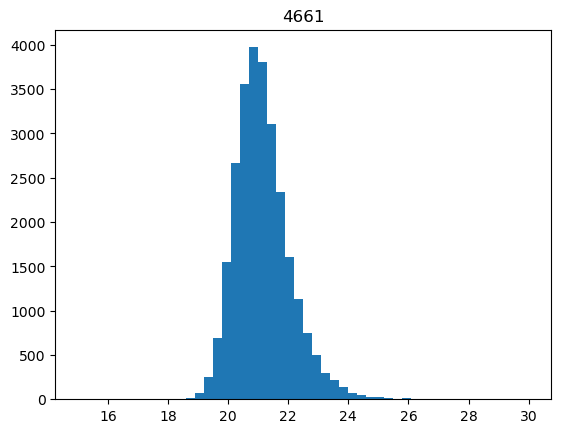

  7%|█████▎                                                                          | 72/1075 [00:09<02:36,  6.43it/s]

15998


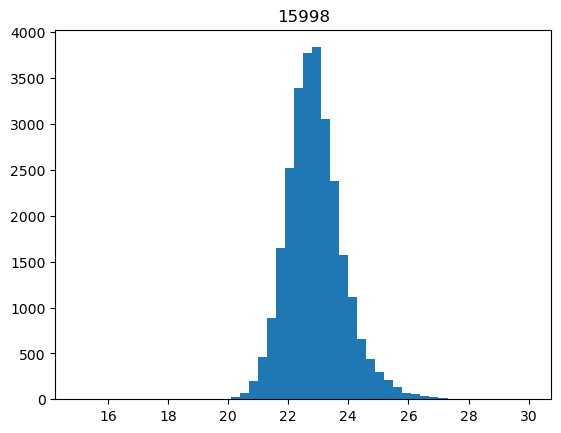

  7%|█████▍                                                                          | 73/1075 [00:09<02:26,  6.84it/s]

5309


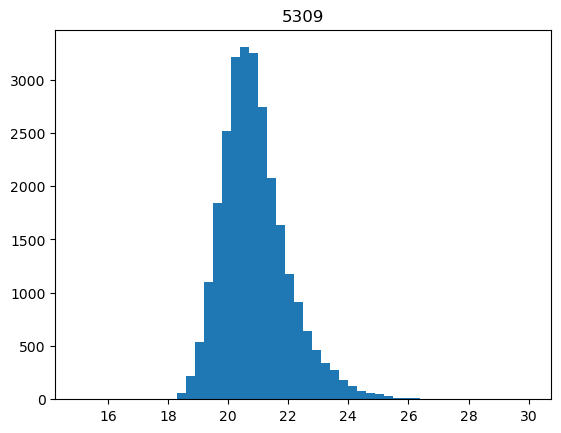

  7%|█████▌                                                                          | 74/1075 [00:09<02:19,  7.17it/s]

11805


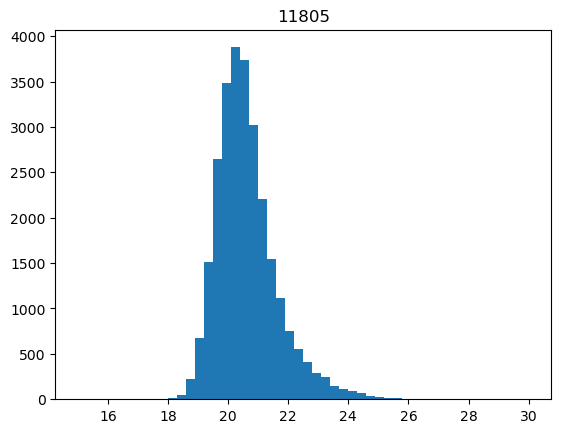

  7%|█████▌                                                                          | 75/1075 [00:10<02:16,  7.32it/s]

603


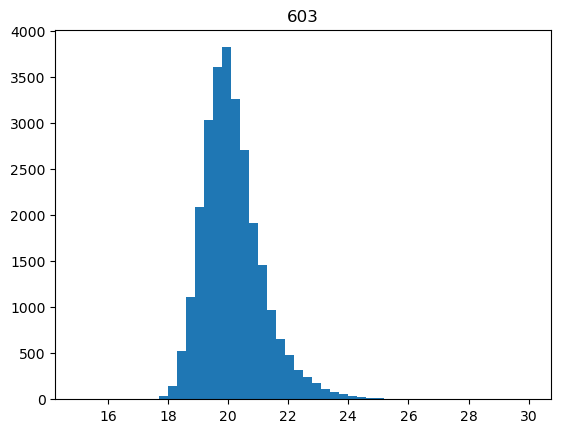

  7%|█████▋                                                                          | 76/1075 [00:10<02:13,  7.48it/s]

9399


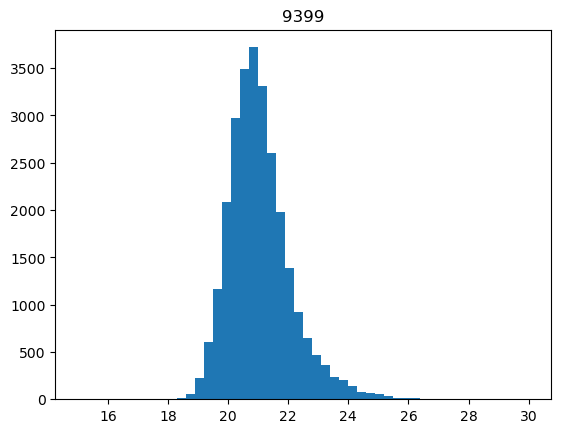

  7%|█████▋                                                                          | 77/1075 [00:10<02:11,  7.57it/s]

21295


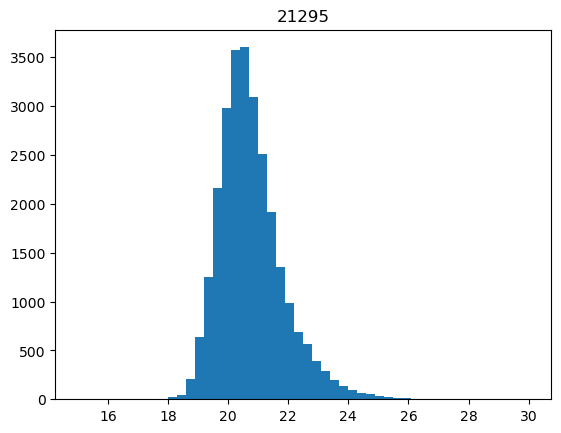

  7%|█████▊                                                                          | 78/1075 [00:10<02:10,  7.66it/s]

3416


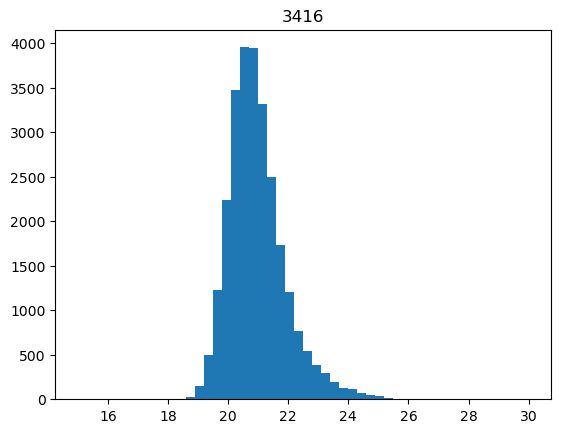

  7%|█████▉                                                                          | 79/1075 [00:10<02:10,  7.62it/s]

17143


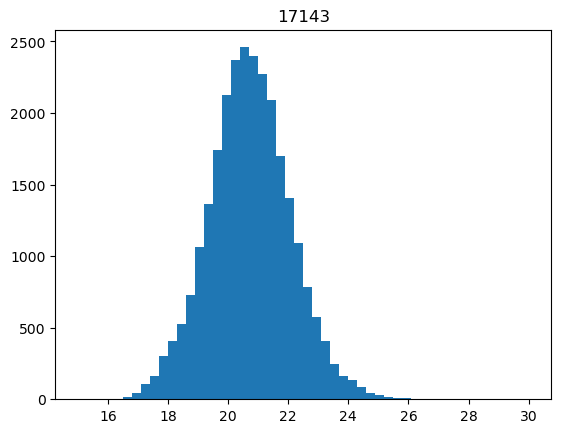

  7%|█████▉                                                                          | 80/1075 [00:10<02:07,  7.78it/s]

26470


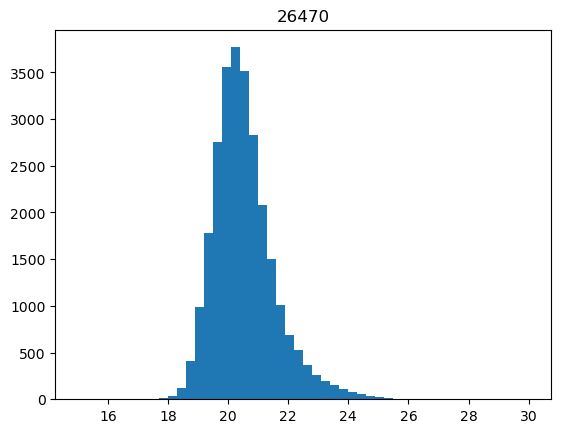

  8%|██████                                                                          | 81/1075 [00:10<02:07,  7.79it/s]

19947


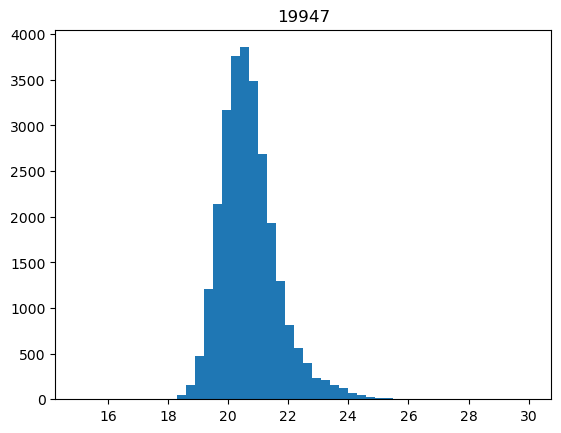

  8%|██████                                                                          | 82/1075 [00:10<02:07,  7.80it/s]

21804


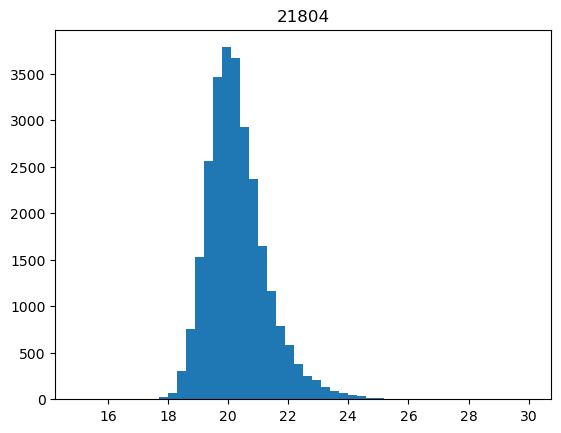

  8%|██████▏                                                                         | 83/1075 [00:11<02:31,  6.56it/s]

22230


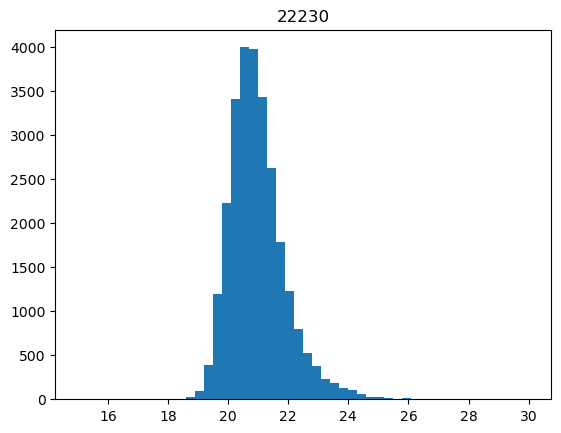

  8%|██████▎                                                                         | 84/1075 [00:11<02:23,  6.92it/s]

25507


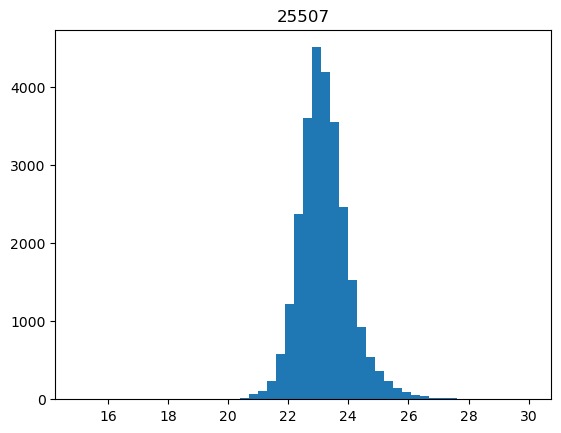

  8%|██████▎                                                                         | 85/1075 [00:11<02:15,  7.29it/s]

14088


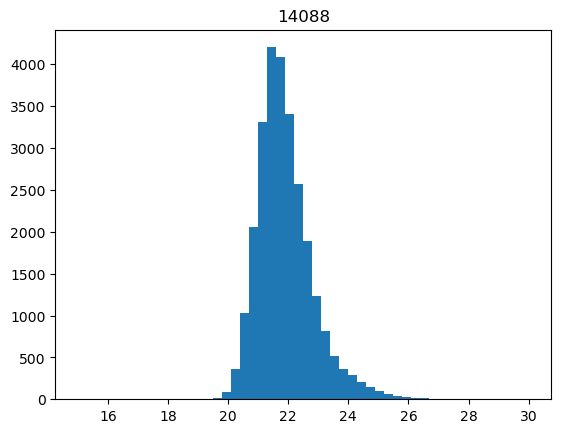

  8%|██████▍                                                                         | 86/1075 [00:11<02:13,  7.42it/s]

8394


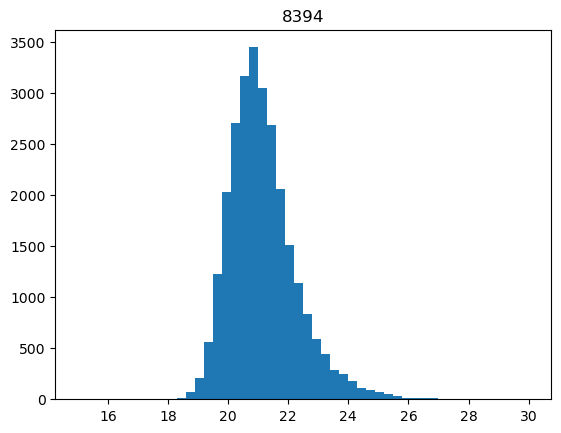

  8%|██████▍                                                                         | 87/1075 [00:11<02:10,  7.57it/s]

10064


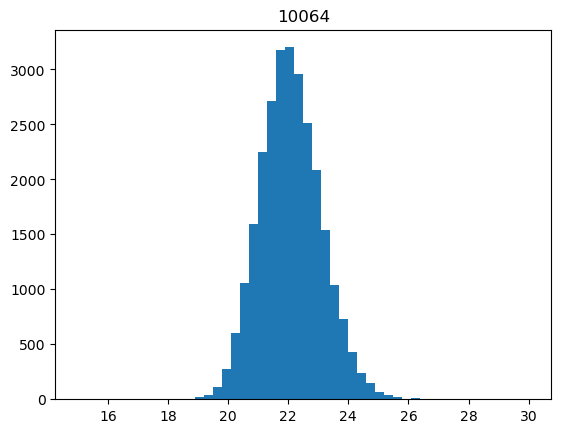

  8%|██████▌                                                                         | 88/1075 [00:11<02:08,  7.71it/s]

17797


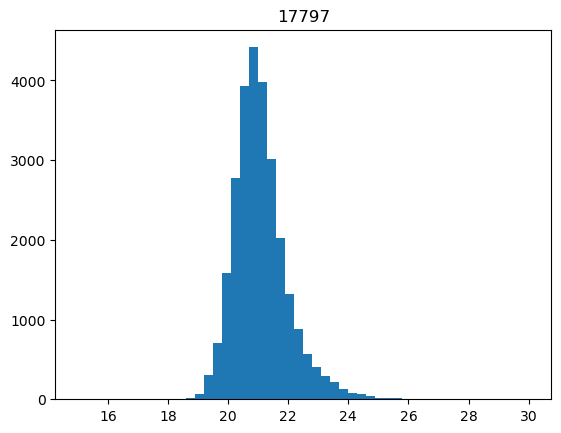

  8%|██████▌                                                                         | 89/1075 [00:11<02:04,  7.92it/s]

17023


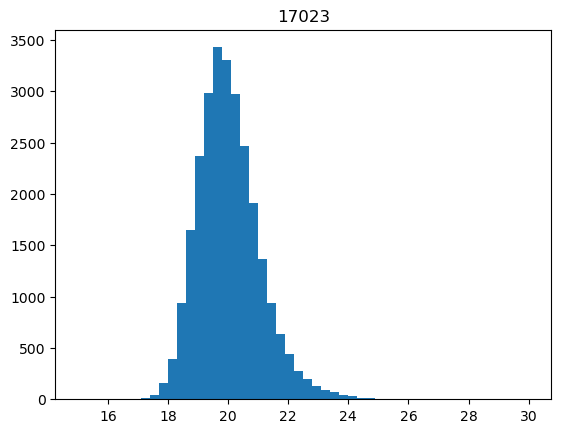

  8%|██████▋                                                                         | 90/1075 [00:12<02:04,  7.93it/s]

8131


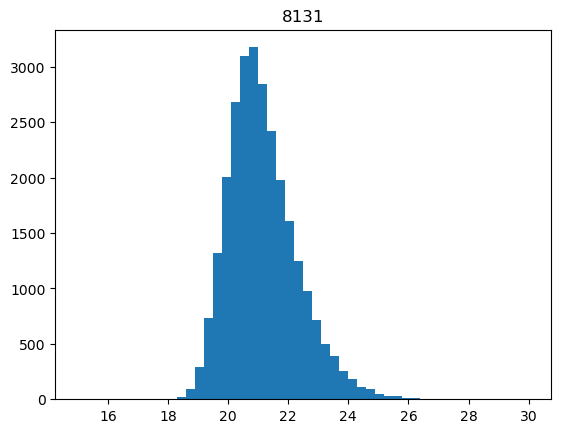

  8%|██████▊                                                                         | 91/1075 [00:12<02:03,  7.99it/s]

15230


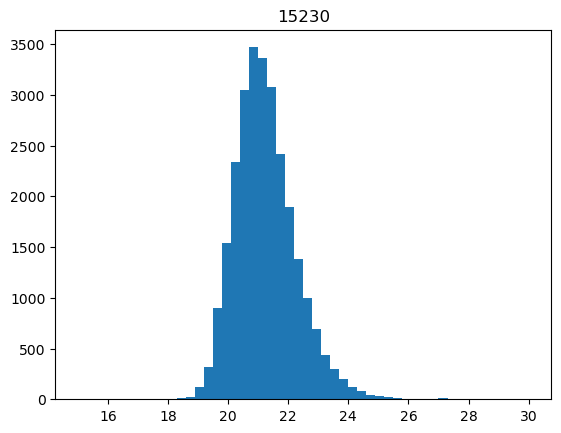

  9%|██████▊                                                                         | 92/1075 [00:12<02:03,  7.95it/s]

1586


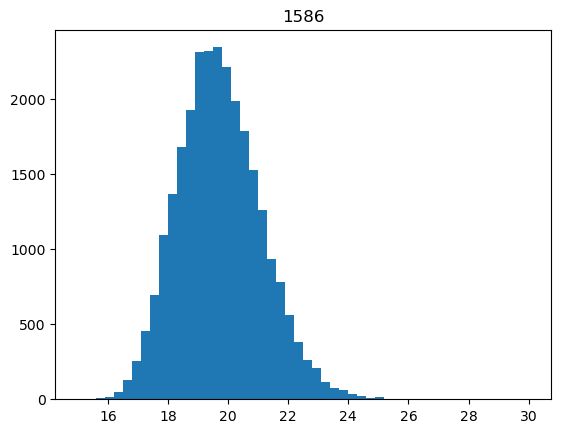

  9%|██████▉                                                                         | 93/1075 [00:12<02:01,  8.06it/s]

10766


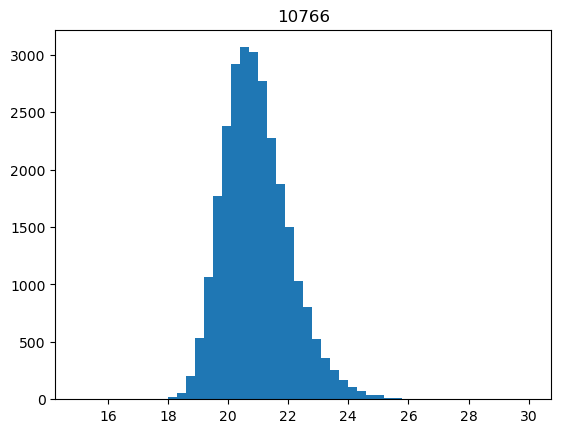

  9%|██████▉                                                                         | 94/1075 [00:12<02:26,  6.69it/s]

826


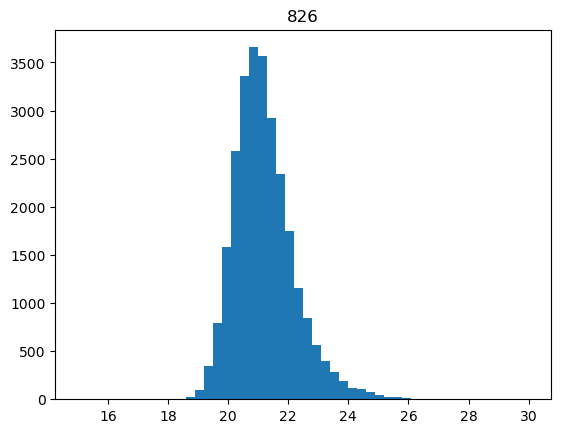

  9%|███████                                                                         | 95/1075 [00:12<02:19,  7.05it/s]

14349


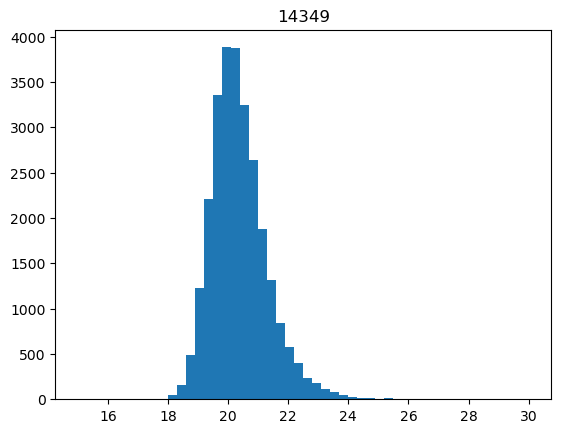

  9%|███████▏                                                                        | 96/1075 [00:12<02:15,  7.24it/s]

22824


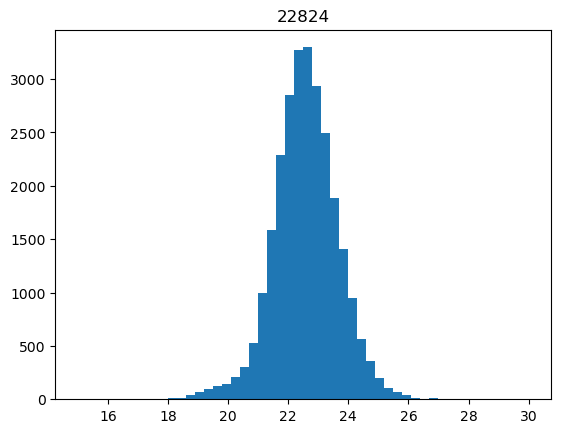

  9%|███████▏                                                                        | 97/1075 [00:13<02:12,  7.36it/s]

184


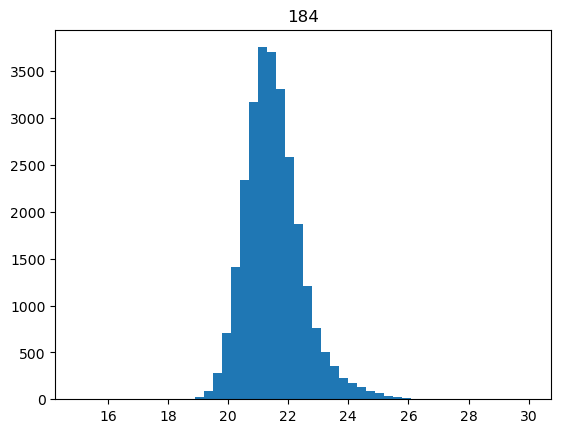

  9%|███████▎                                                                        | 98/1075 [00:13<02:10,  7.50it/s]

8690


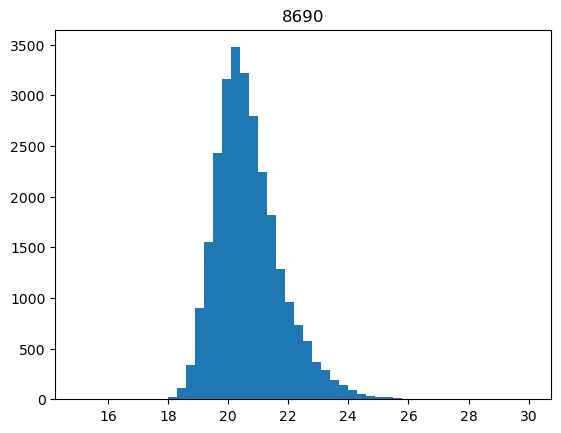

  9%|███████▎                                                                        | 99/1075 [00:13<02:07,  7.66it/s]

3727


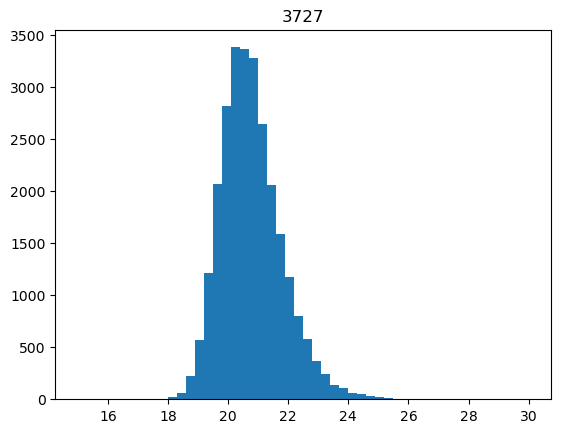

  9%|███████▎                                                                       | 100/1075 [00:13<02:06,  7.72it/s]

10354


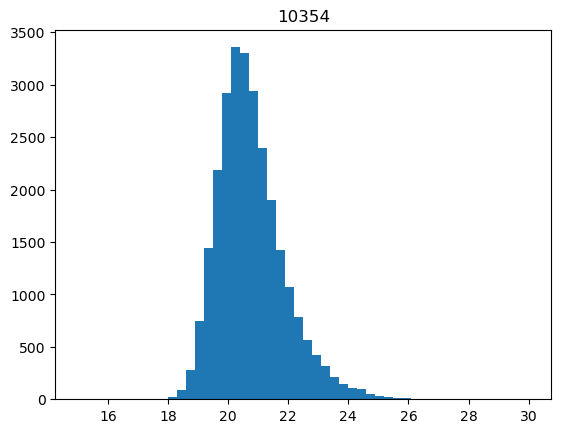

  9%|███████▍                                                                       | 101/1075 [00:13<02:05,  7.79it/s]

25122


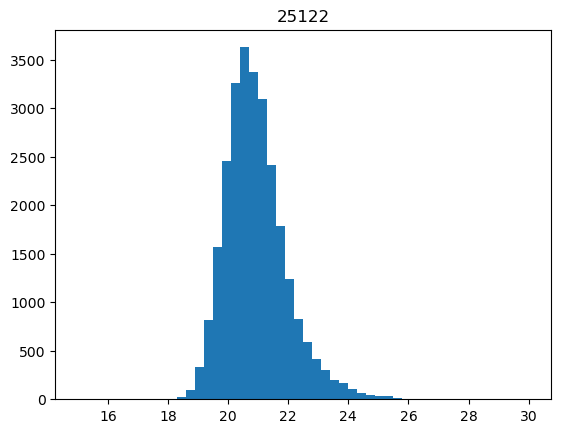

  9%|███████▍                                                                       | 102/1075 [00:13<02:04,  7.83it/s]

9566


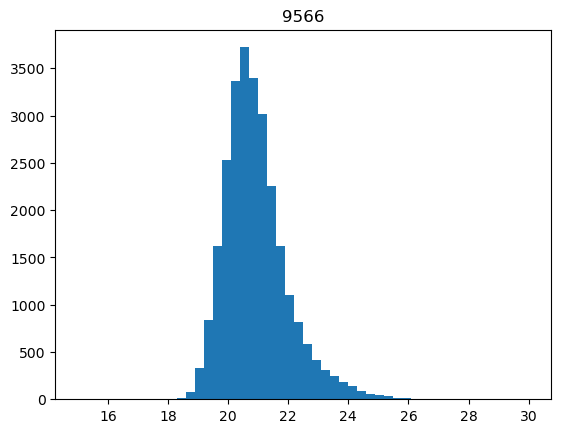

 10%|███████▌                                                                       | 103/1075 [00:13<02:03,  7.84it/s]

424


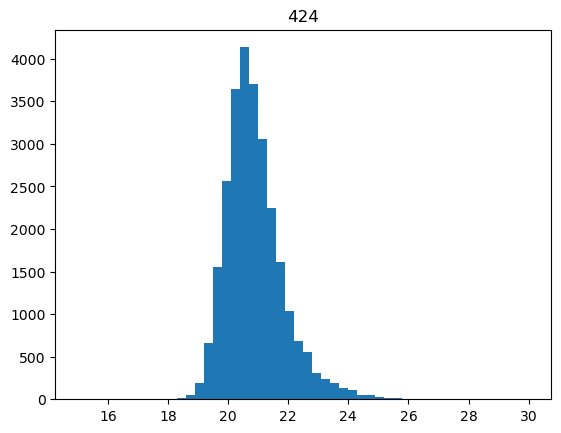

 10%|███████▋                                                                       | 104/1075 [00:13<02:03,  7.87it/s]

6885


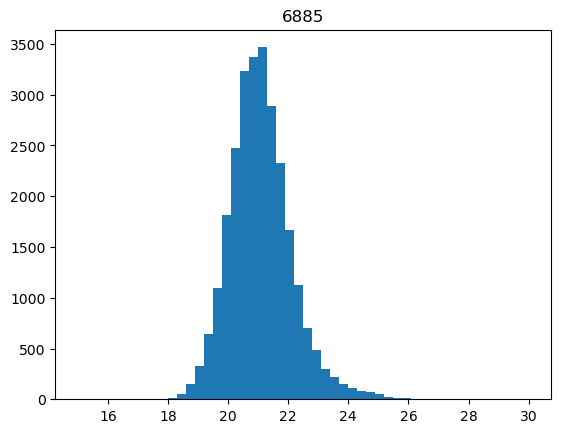

 10%|███████▋                                                                       | 105/1075 [00:14<02:28,  6.54it/s]

21382


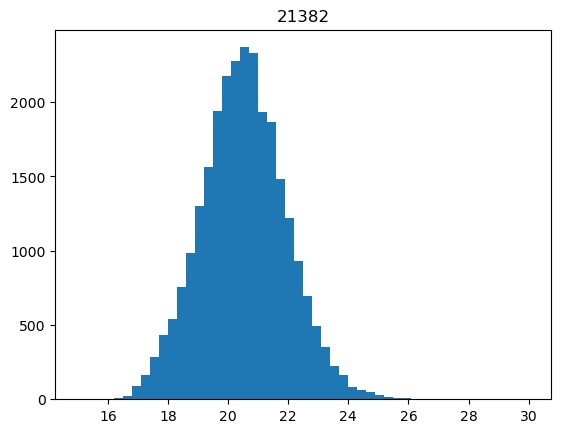

 10%|███████▊                                                                       | 106/1075 [00:14<02:18,  6.98it/s]

15043


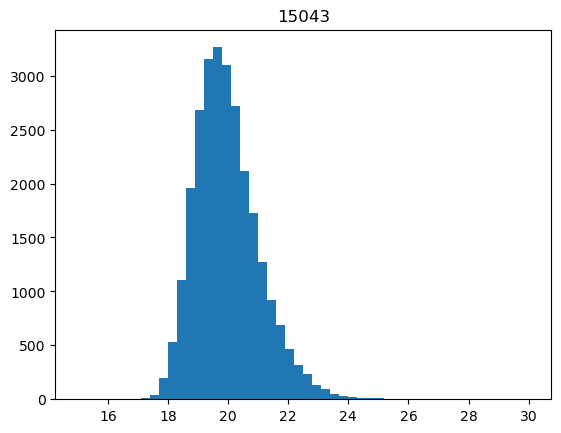

 10%|███████▊                                                                       | 107/1075 [00:14<02:13,  7.26it/s]

19573


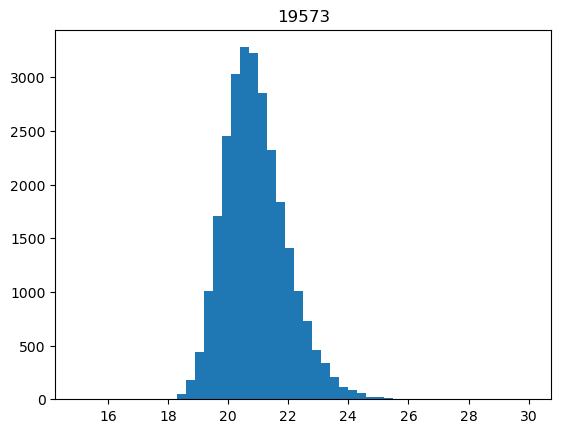

 10%|███████▉                                                                       | 108/1075 [00:14<02:10,  7.43it/s]

16534


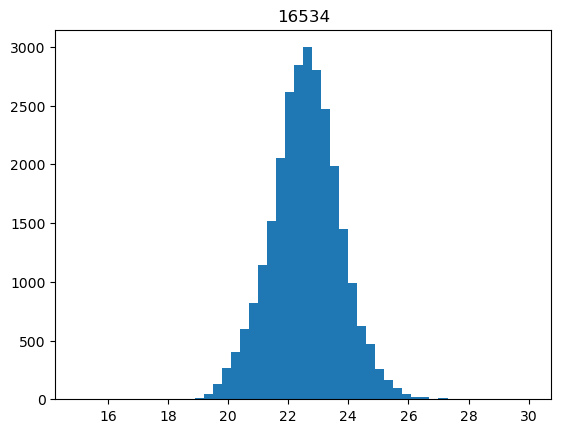

 10%|████████                                                                       | 109/1075 [00:14<02:06,  7.64it/s]

8912


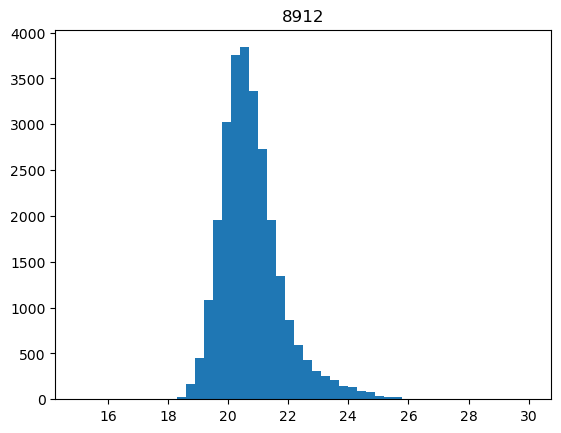

 10%|████████                                                                       | 110/1075 [00:14<02:06,  7.62it/s]

7323


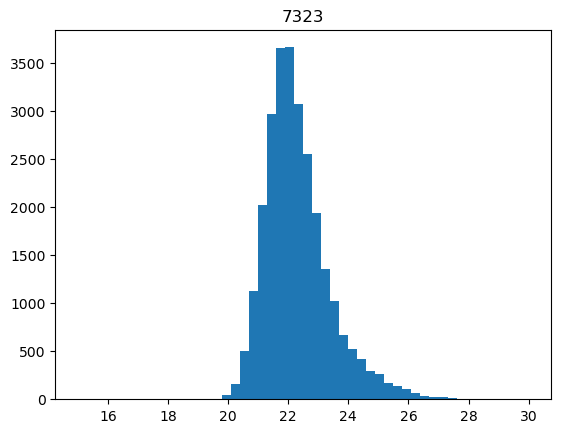

 10%|████████▏                                                                      | 111/1075 [00:14<02:05,  7.66it/s]

4371


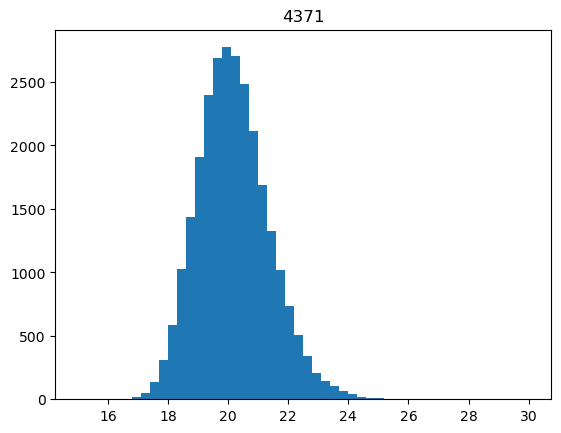

 10%|████████▏                                                                      | 112/1075 [00:15<02:02,  7.83it/s]

11792


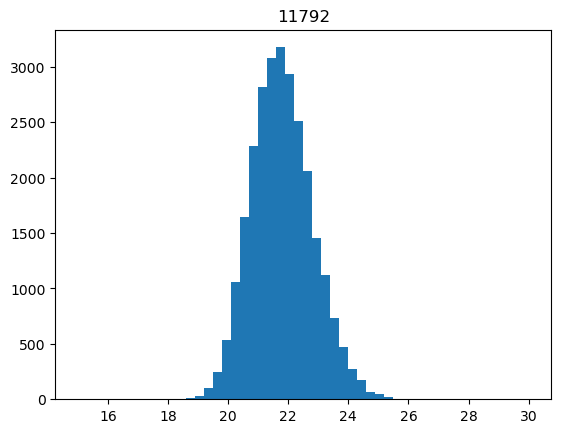

 11%|████████▎                                                                      | 113/1075 [00:15<02:02,  7.86it/s]

26786


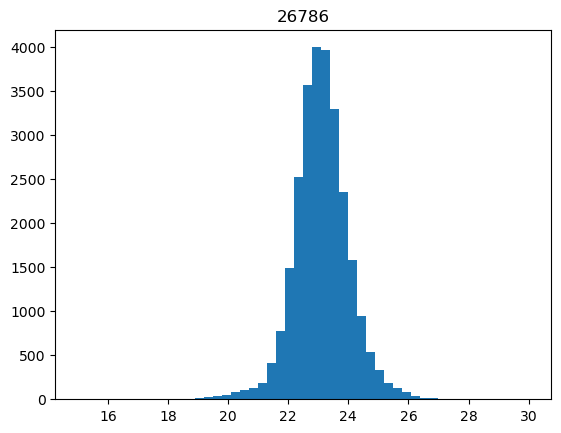

 11%|████████▍                                                                      | 114/1075 [00:15<02:01,  7.90it/s]

7483


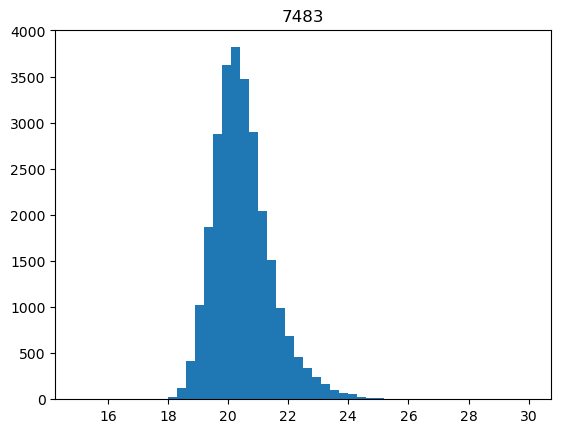

 11%|████████▍                                                                      | 115/1075 [00:15<02:01,  7.89it/s]

9745


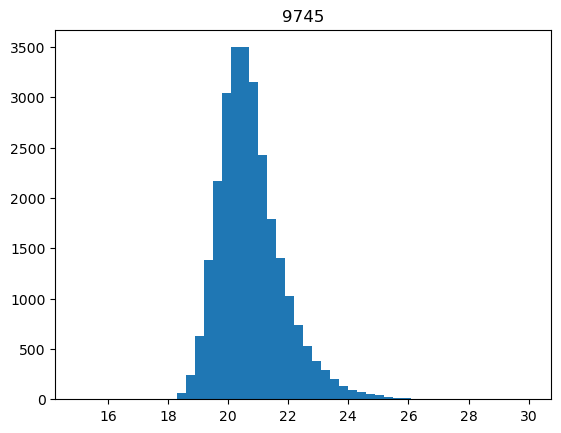

 11%|████████▌                                                                      | 116/1075 [00:15<02:25,  6.59it/s]

7137


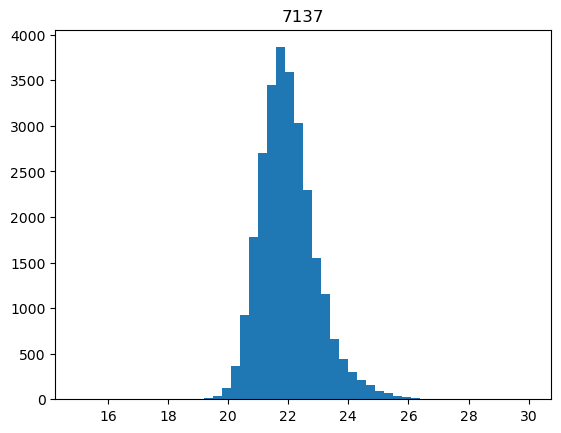

 11%|████████▌                                                                      | 117/1075 [00:15<02:19,  6.89it/s]

15130


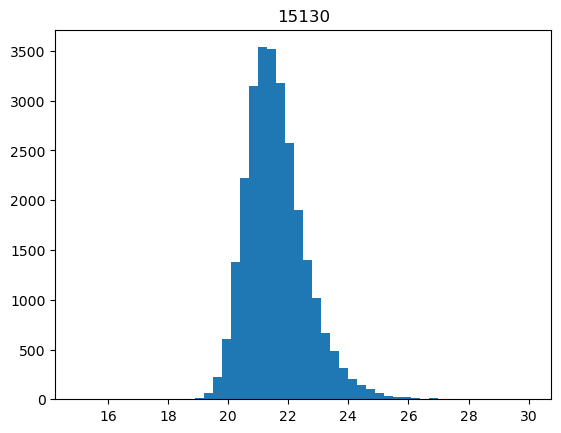

 11%|████████▋                                                                      | 118/1075 [00:15<02:13,  7.16it/s]

8961


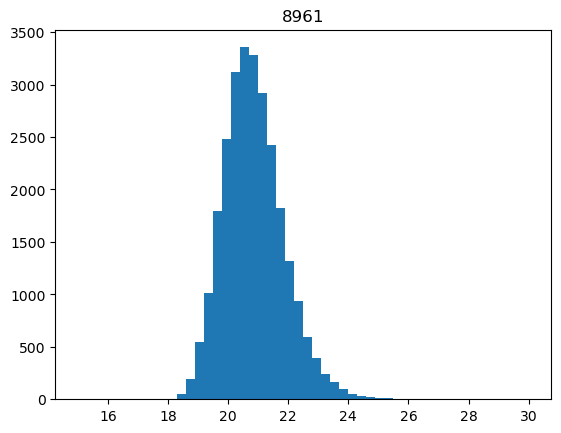

 11%|████████▋                                                                      | 119/1075 [00:15<02:09,  7.37it/s]

4368


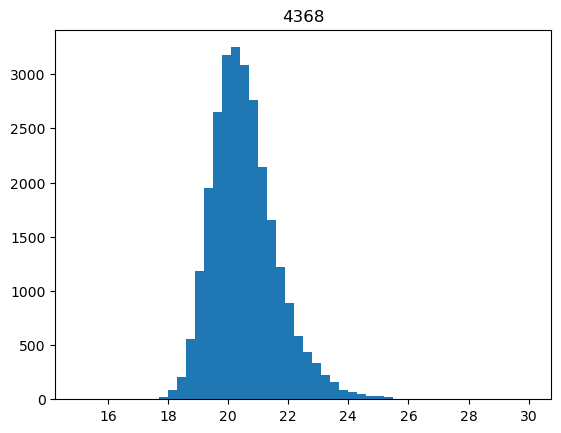

 11%|████████▊                                                                      | 120/1075 [00:16<02:05,  7.58it/s]

4136


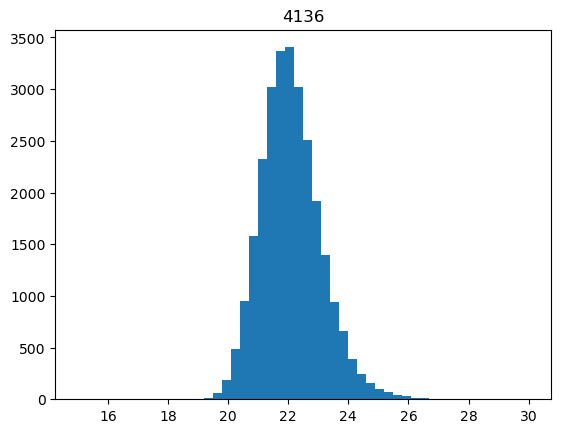

 11%|████████▉                                                                      | 121/1075 [00:16<02:03,  7.70it/s]

7859


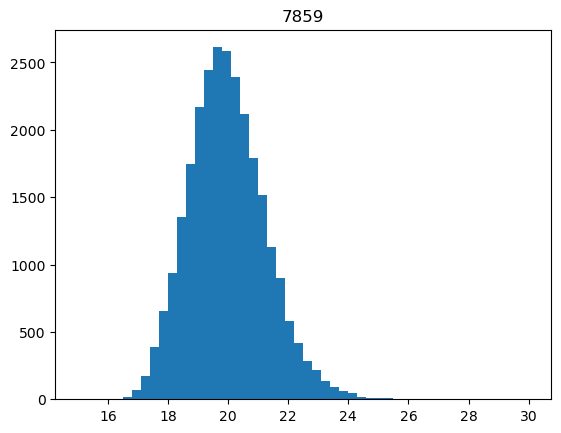

 11%|████████▉                                                                      | 122/1075 [00:16<02:01,  7.83it/s]

2309


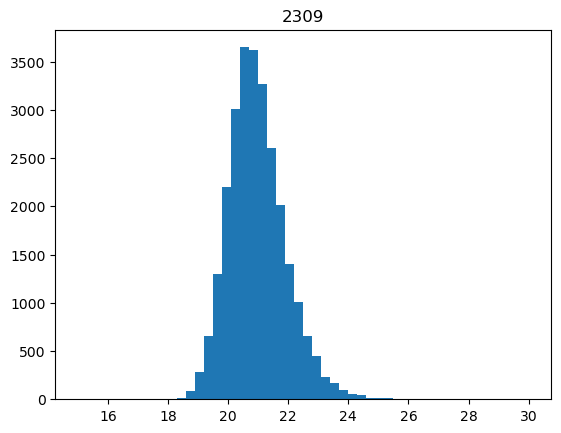

 11%|█████████                                                                      | 123/1075 [00:16<02:01,  7.86it/s]

19098


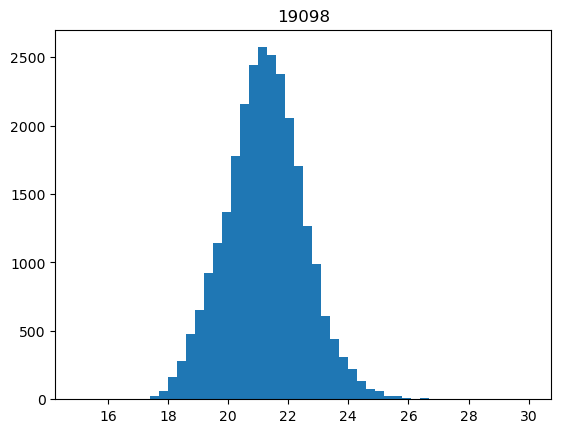

 12%|█████████                                                                      | 124/1075 [00:16<01:59,  7.96it/s]

11256


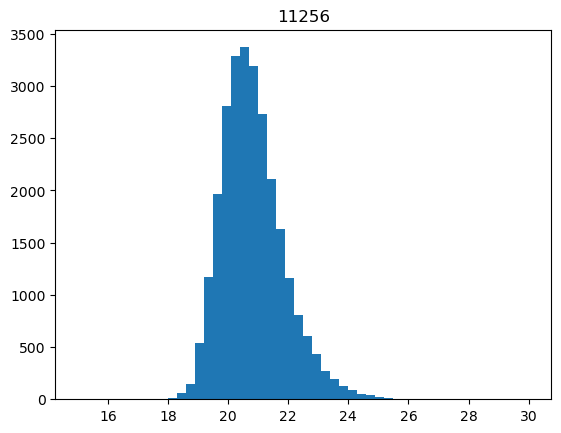

 12%|█████████▏                                                                     | 125/1075 [00:16<02:00,  7.91it/s]

7195


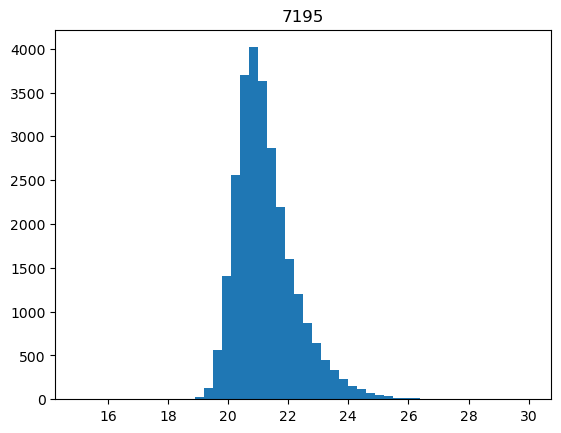

 12%|█████████▎                                                                     | 126/1075 [00:16<02:00,  7.90it/s]

9530


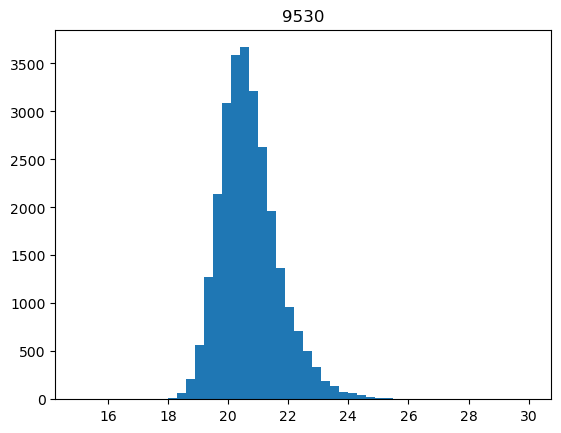

 12%|█████████▎                                                                     | 127/1075 [00:17<02:23,  6.62it/s]

19872


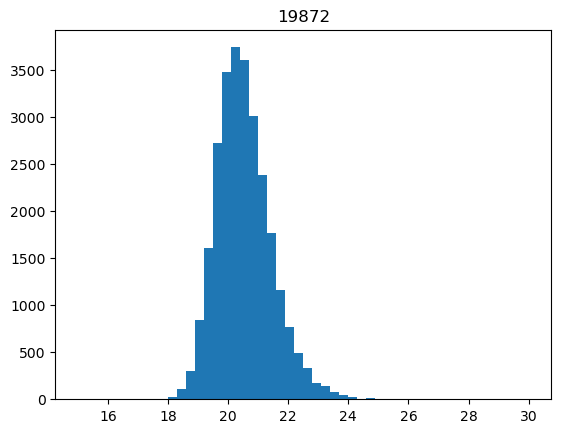

 12%|█████████▍                                                                     | 128/1075 [00:17<02:15,  6.98it/s]

6346


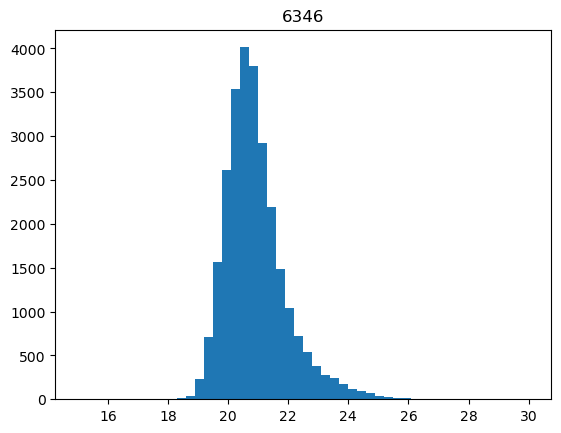

 12%|█████████▍                                                                     | 129/1075 [00:17<02:11,  7.20it/s]

3821


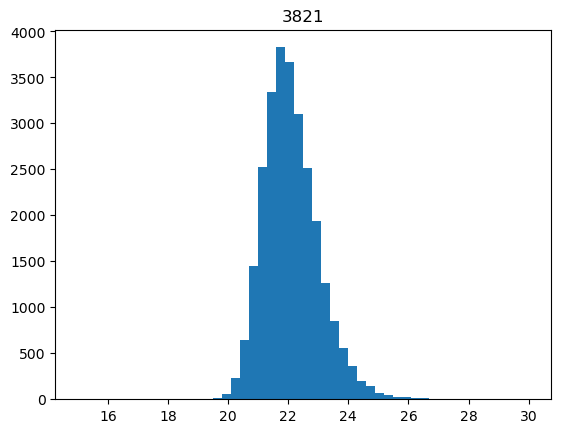

 12%|█████████▌                                                                     | 130/1075 [00:17<02:07,  7.39it/s]

24337


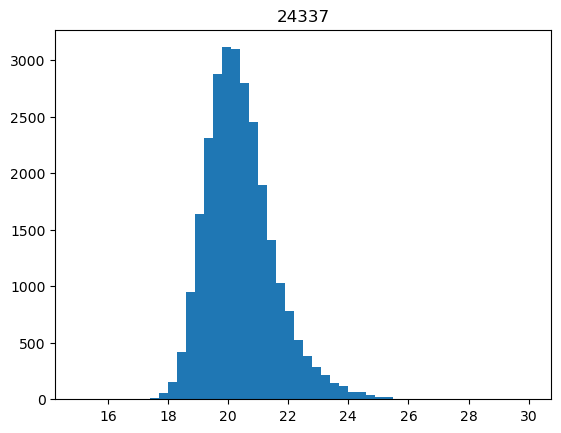

 12%|█████████▋                                                                     | 131/1075 [00:17<02:04,  7.58it/s]

20709


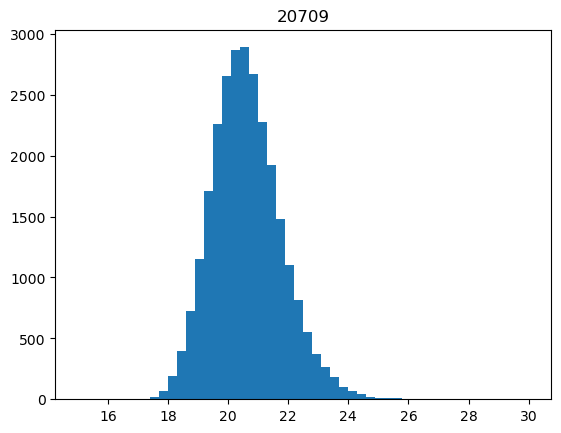

 12%|█████████▋                                                                     | 132/1075 [00:17<02:01,  7.73it/s]

18582


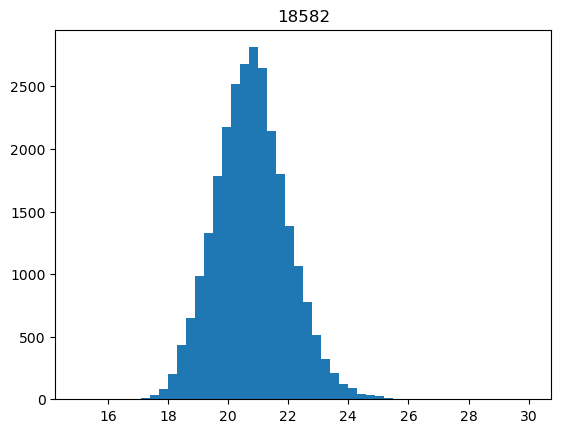

 12%|█████████▊                                                                     | 133/1075 [00:17<01:59,  7.87it/s]

20514


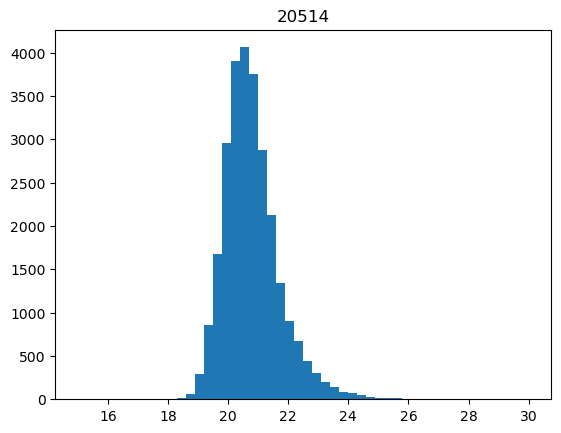

 12%|█████████▊                                                                     | 134/1075 [00:17<01:59,  7.85it/s]

2021


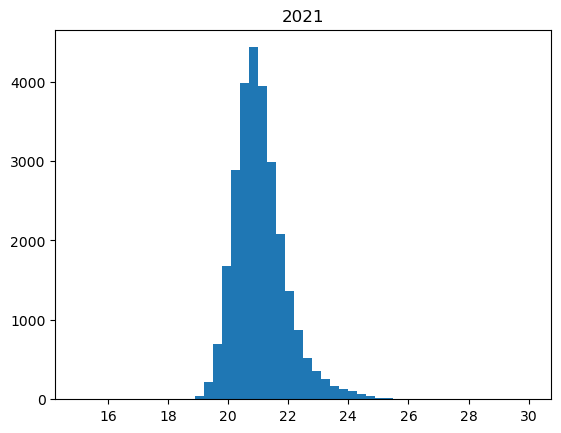

 13%|█████████▉                                                                     | 135/1075 [00:18<01:57,  7.99it/s]

9487


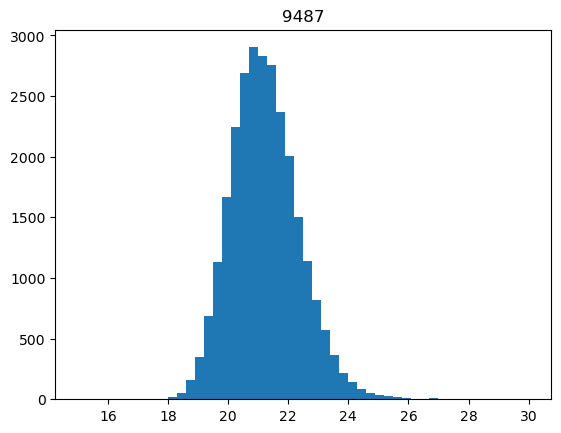

 13%|█████████▉                                                                     | 136/1075 [00:18<01:57,  8.01it/s]

19030


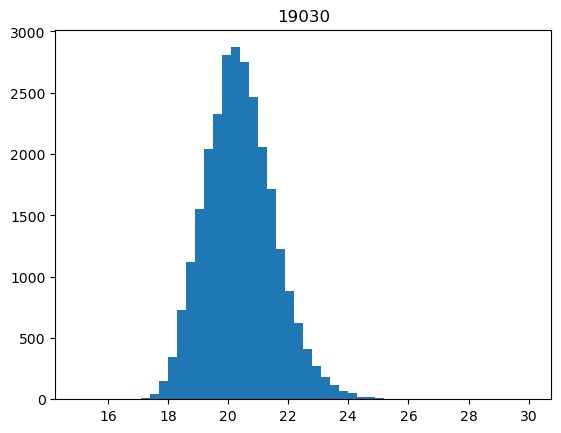

 13%|██████████                                                                     | 137/1075 [00:18<01:56,  8.05it/s]

21467


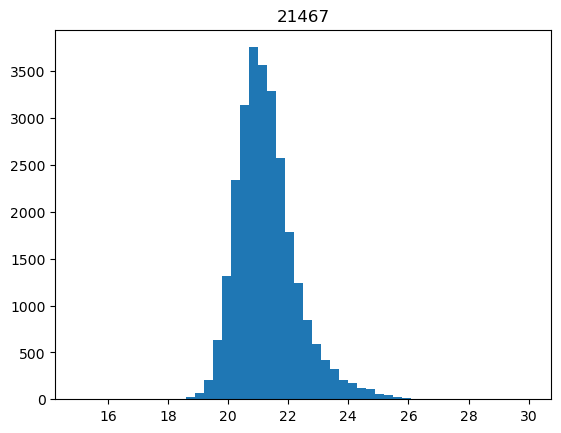

 13%|██████████▏                                                                    | 138/1075 [00:18<02:22,  6.59it/s]

8214


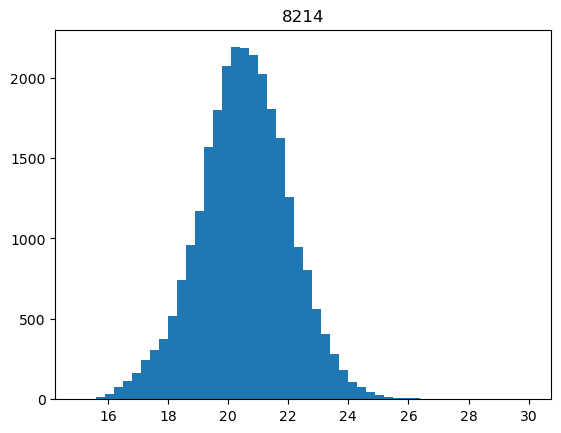

 13%|██████████▏                                                                    | 139/1075 [00:18<02:12,  7.04it/s]

22784


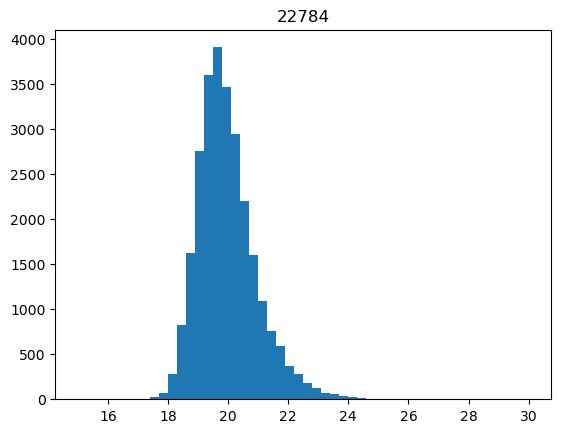

 13%|██████████▎                                                                    | 140/1075 [00:18<02:09,  7.23it/s]

23327


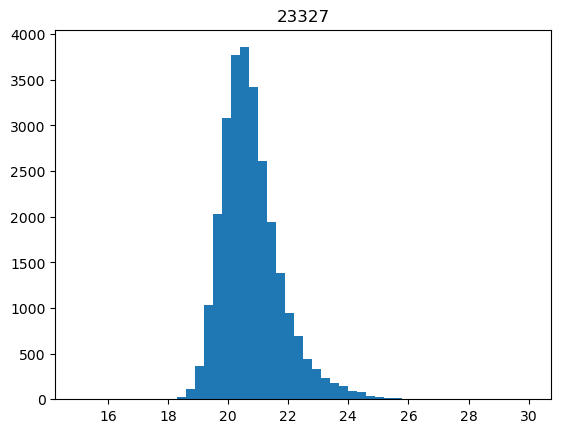

 13%|██████████▎                                                                    | 141/1075 [00:18<02:06,  7.39it/s]

22604


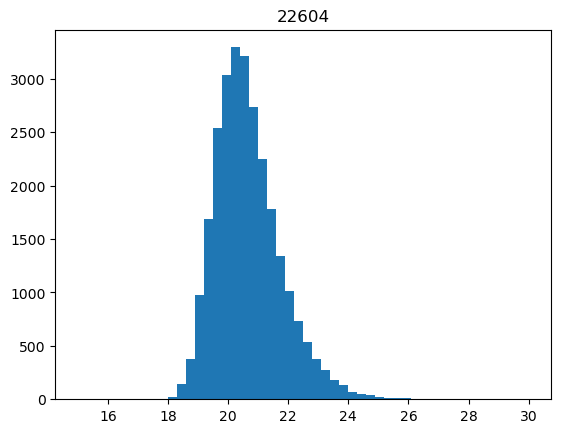

 13%|██████████▍                                                                    | 142/1075 [00:19<02:03,  7.56it/s]

26393


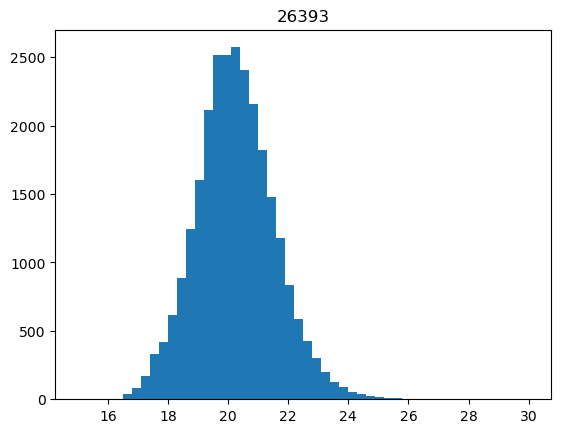

 13%|██████████▌                                                                    | 143/1075 [00:19<02:00,  7.74it/s]

20737


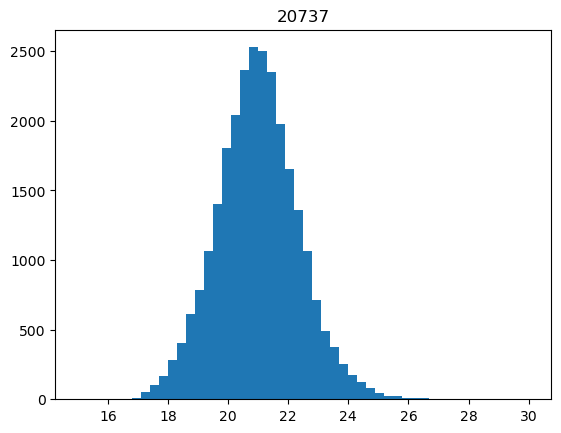

 13%|██████████▌                                                                    | 144/1075 [00:19<01:59,  7.82it/s]

5827


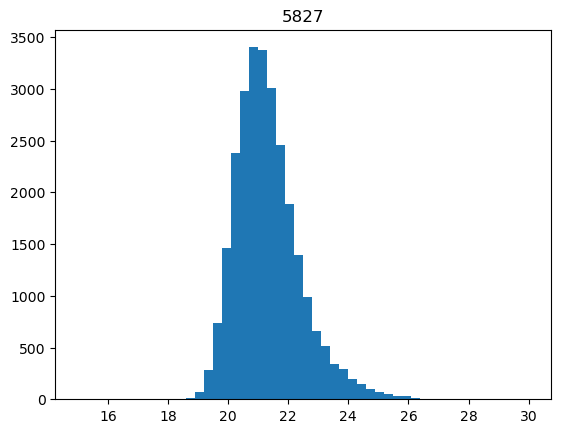

 13%|██████████▋                                                                    | 145/1075 [00:19<01:58,  7.87it/s]

16700


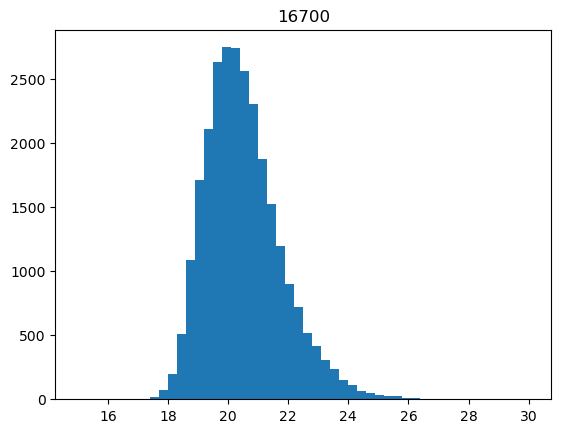

 14%|██████████▋                                                                    | 146/1075 [00:19<01:56,  7.95it/s]

8853


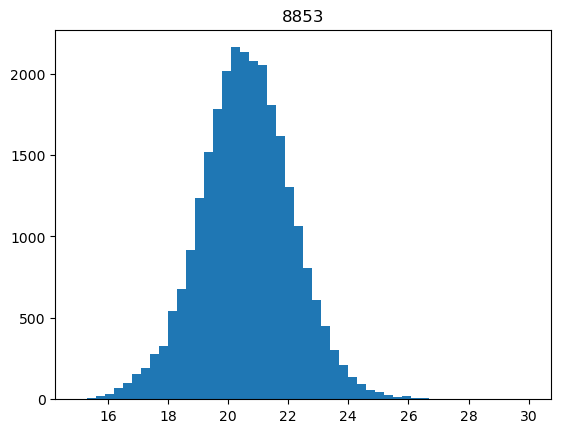

 14%|██████████▊                                                                    | 147/1075 [00:19<01:55,  8.04it/s]

5273


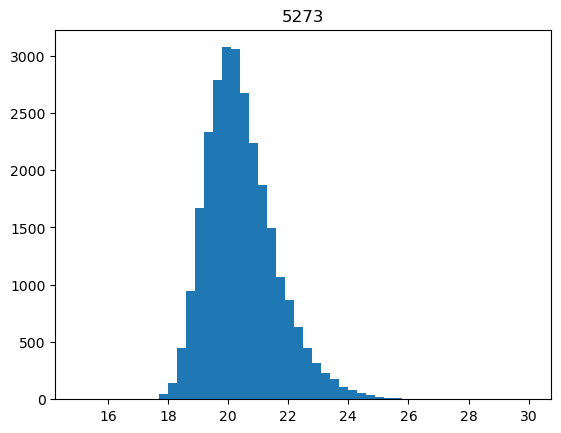

 14%|██████████▉                                                                    | 148/1075 [00:19<01:55,  8.05it/s]

860


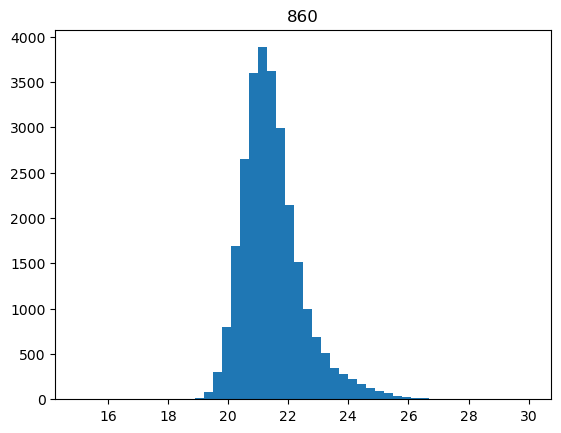

 14%|██████████▉                                                                    | 149/1075 [00:19<02:21,  6.56it/s]

18824


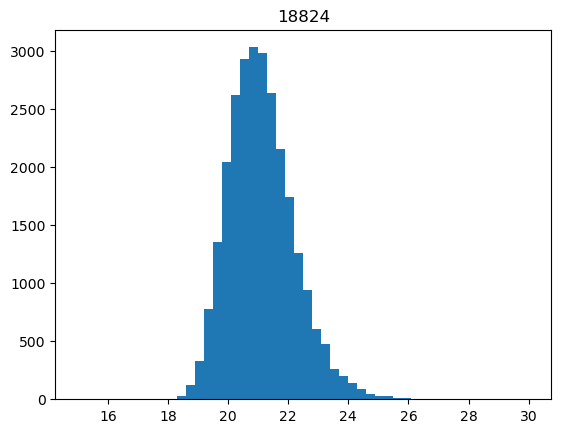

 14%|███████████                                                                    | 150/1075 [00:20<02:12,  6.96it/s]

17306


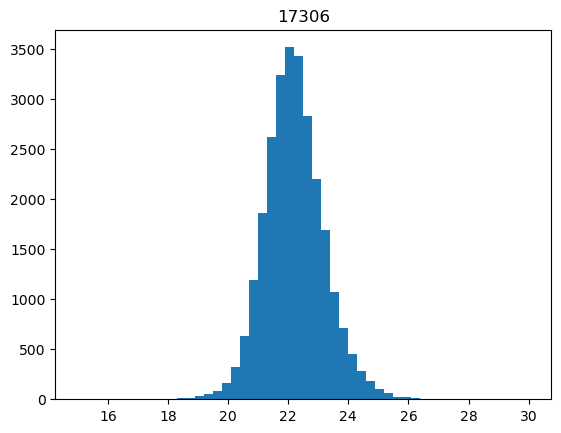

 14%|███████████                                                                    | 151/1075 [00:20<02:07,  7.23it/s]

25270


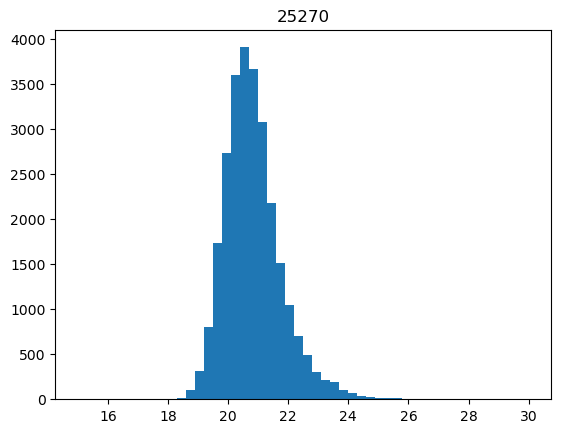

 14%|███████████▏                                                                   | 152/1075 [00:20<02:05,  7.35it/s]

10681


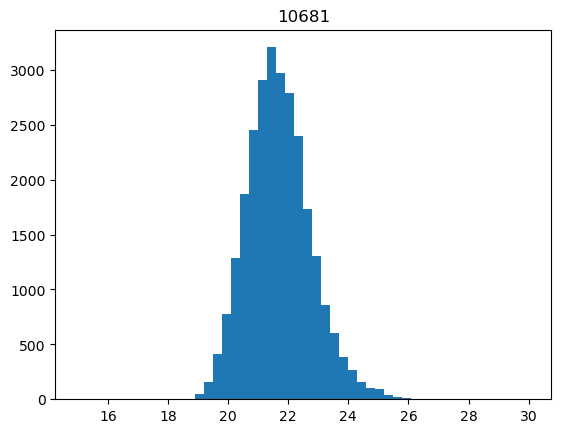

 14%|███████████▏                                                                   | 153/1075 [00:20<02:02,  7.51it/s]

22663


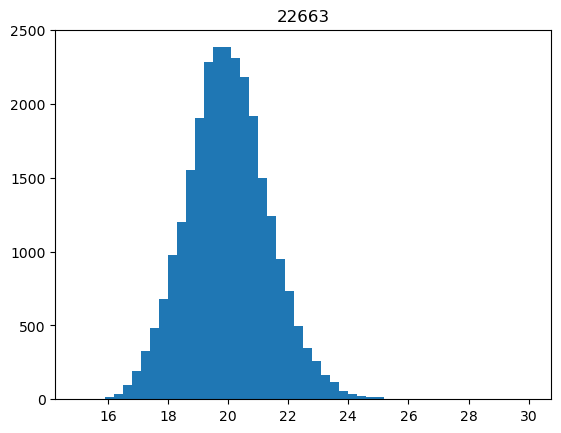

 14%|███████████▎                                                                   | 154/1075 [00:20<02:02,  7.51it/s]

22336


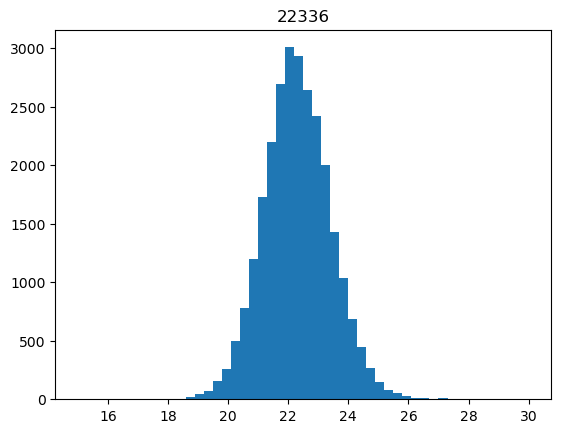

 14%|███████████▍                                                                   | 155/1075 [00:20<02:02,  7.53it/s]

6157


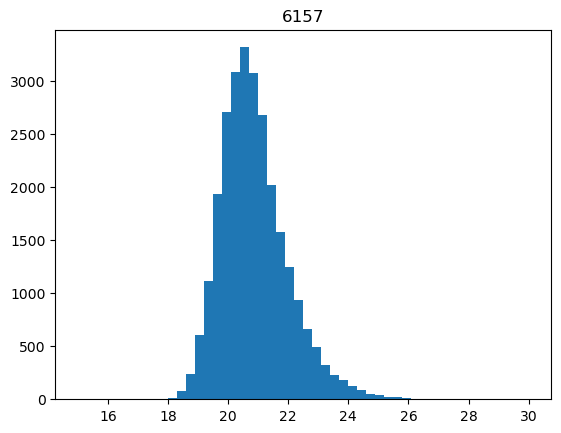

 15%|███████████▍                                                                   | 156/1075 [00:20<02:00,  7.61it/s]

5728


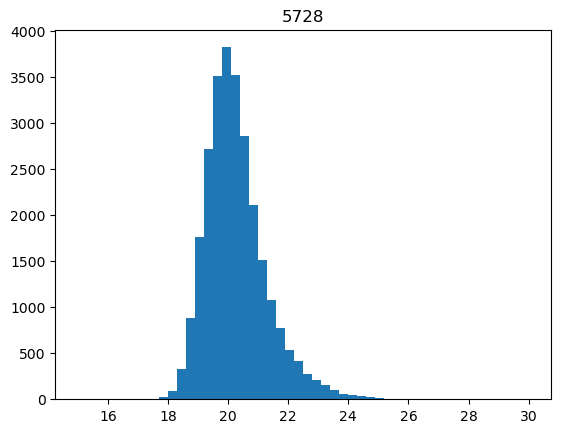

 15%|███████████▌                                                                   | 157/1075 [00:21<01:59,  7.65it/s]

2762


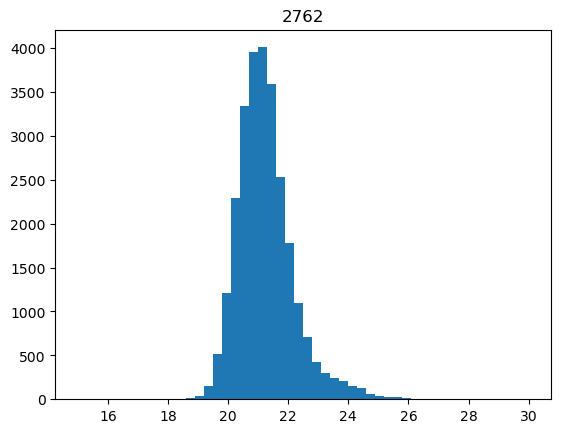

 15%|███████████▌                                                                   | 158/1075 [00:21<01:59,  7.65it/s]

18443


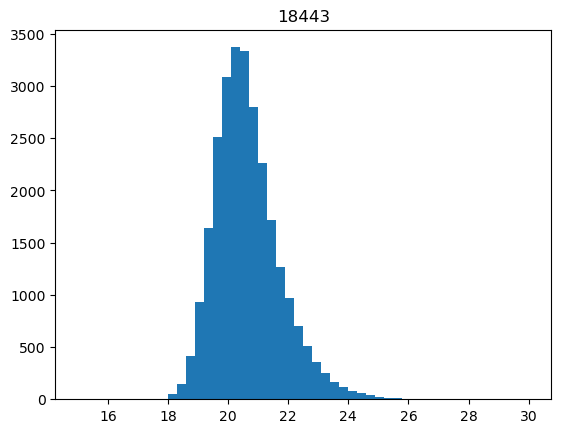

 15%|███████████▋                                                                   | 159/1075 [00:21<01:58,  7.73it/s]

17127


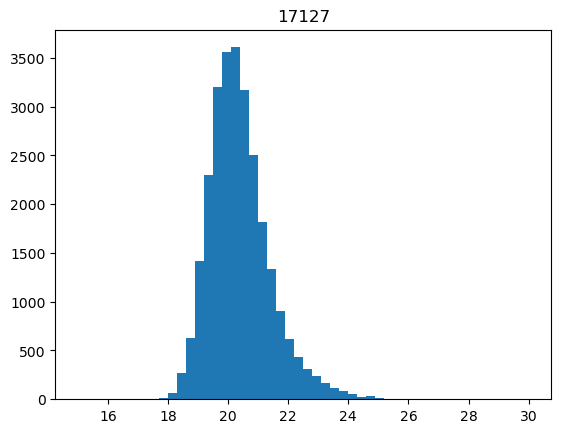

 15%|███████████▊                                                                   | 160/1075 [00:21<02:21,  6.46it/s]

8453


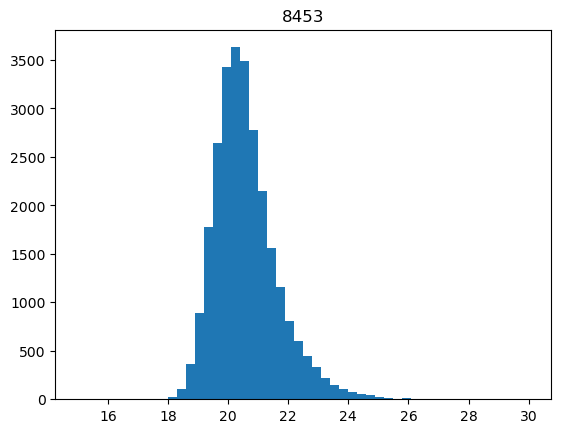

 15%|███████████▊                                                                   | 161/1075 [00:21<02:16,  6.72it/s]

16866


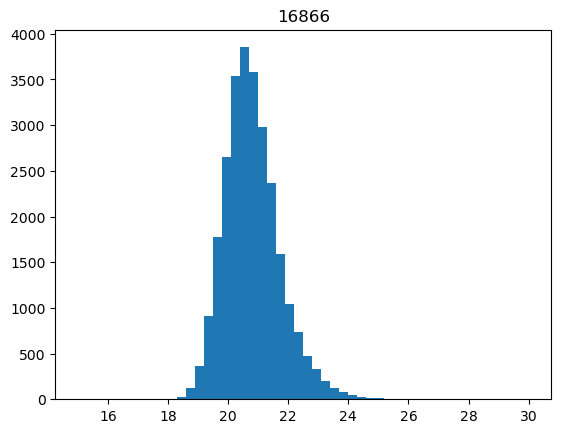

 15%|███████████▉                                                                   | 162/1075 [00:21<02:10,  7.00it/s]

22820


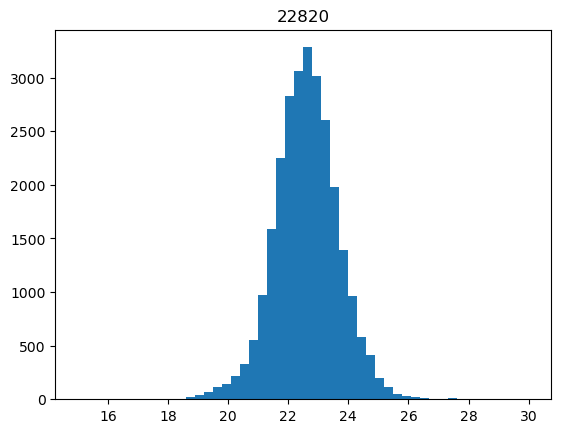

 15%|███████████▉                                                                   | 163/1075 [00:21<02:05,  7.27it/s]

8416


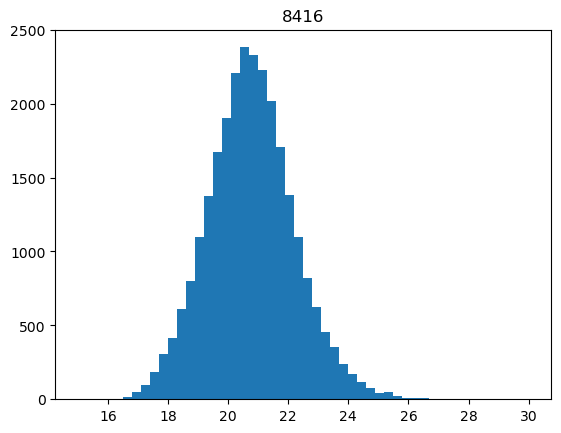

 15%|████████████                                                                   | 164/1075 [00:21<02:01,  7.49it/s]

21142


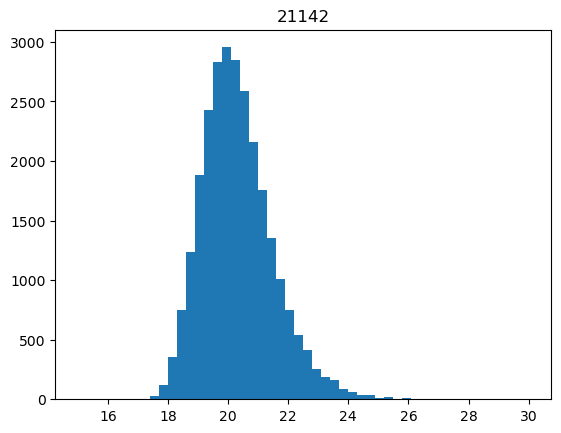

 15%|████████████▏                                                                  | 165/1075 [00:22<02:00,  7.55it/s]

2070


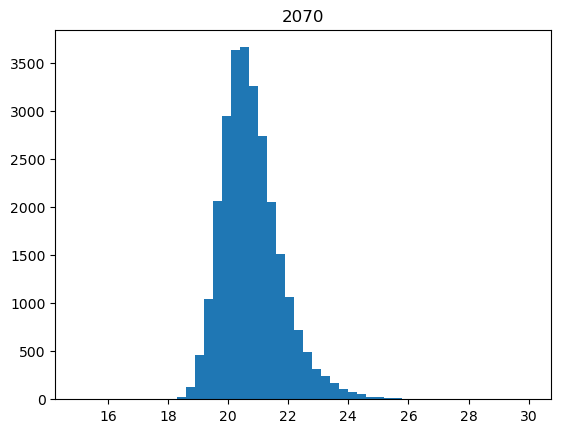

 15%|████████████▏                                                                  | 166/1075 [00:22<01:58,  7.64it/s]

10600


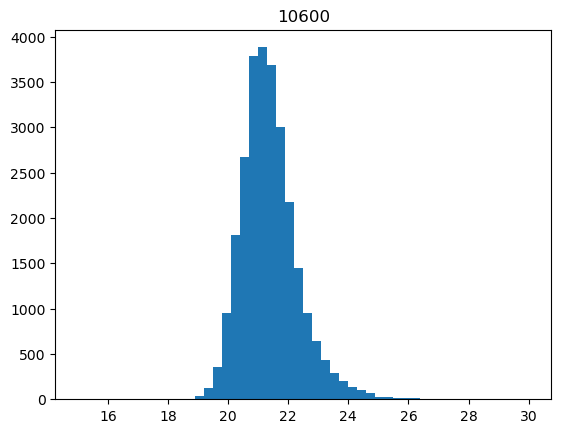

 16%|████████████▎                                                                  | 167/1075 [00:22<01:58,  7.69it/s]

18461


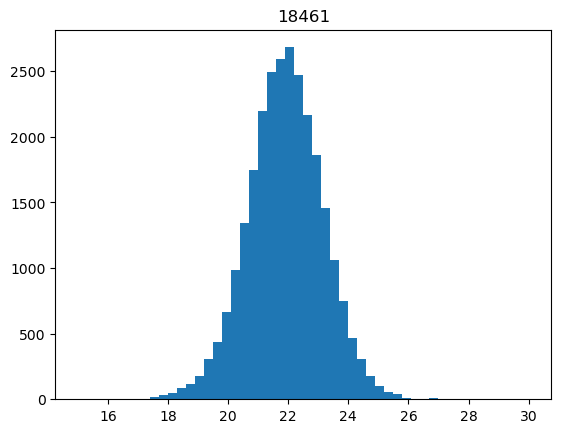

 16%|████████████▎                                                                  | 168/1075 [00:22<01:56,  7.78it/s]

17626


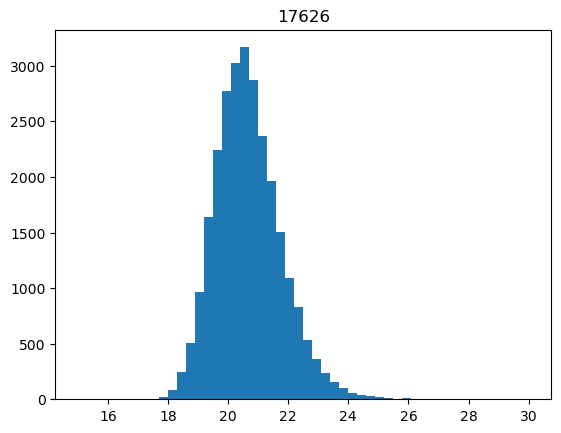

 16%|████████████▍                                                                  | 169/1075 [00:22<01:55,  7.85it/s]

1113


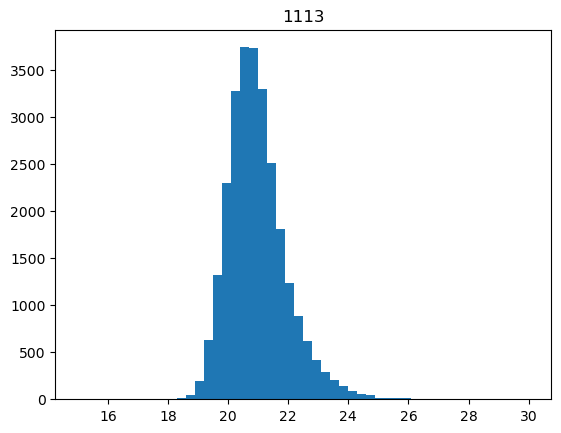

 16%|████████████▍                                                                  | 170/1075 [00:22<01:56,  7.80it/s]

24180


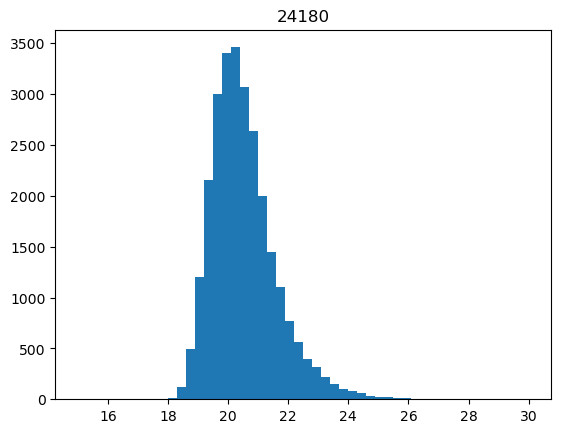

 16%|████████████▌                                                                  | 171/1075 [00:22<02:21,  6.39it/s]

19973


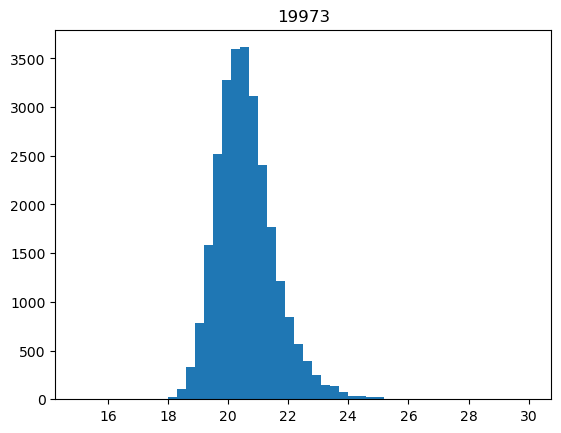

 16%|████████████▋                                                                  | 172/1075 [00:23<02:14,  6.74it/s]

8107


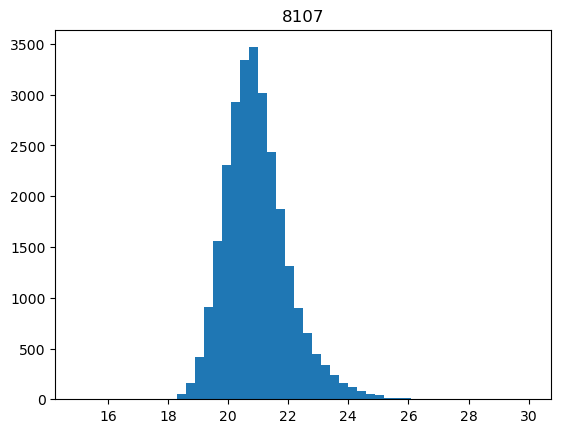

 16%|████████████▋                                                                  | 173/1075 [00:23<02:09,  6.98it/s]

2189


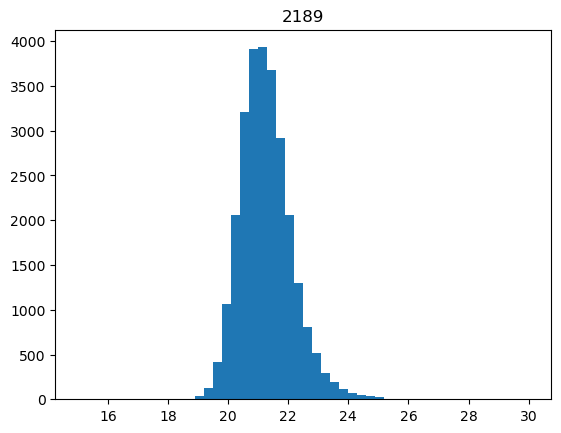

 16%|████████████▊                                                                  | 174/1075 [00:23<02:05,  7.20it/s]

8266


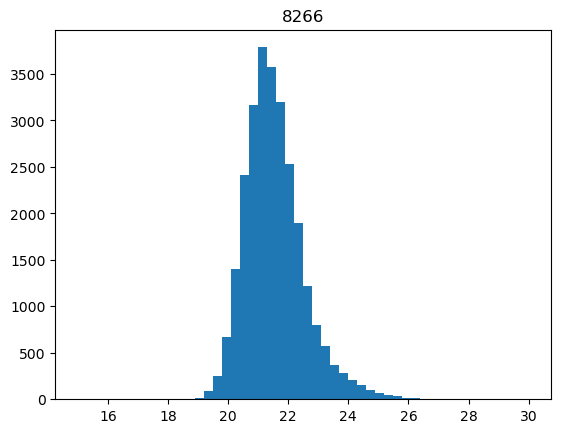

 16%|████████████▊                                                                  | 175/1075 [00:23<02:01,  7.40it/s]

14721


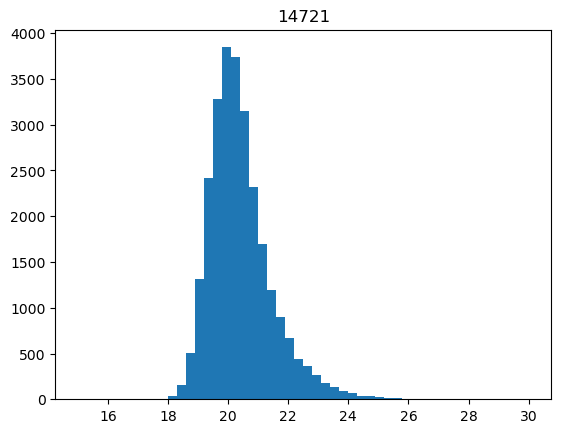

 16%|████████████▉                                                                  | 176/1075 [00:23<01:59,  7.52it/s]

12409


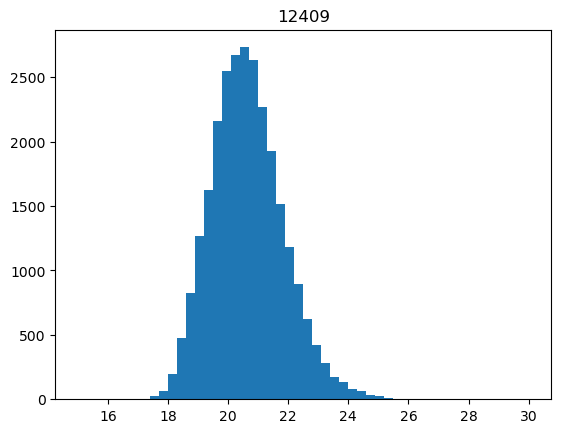

 16%|█████████████                                                                  | 177/1075 [00:23<01:57,  7.66it/s]

25171


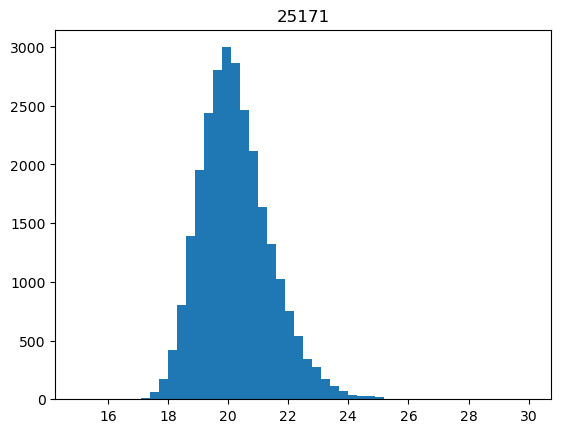

 17%|█████████████                                                                  | 178/1075 [00:23<01:55,  7.76it/s]

25253


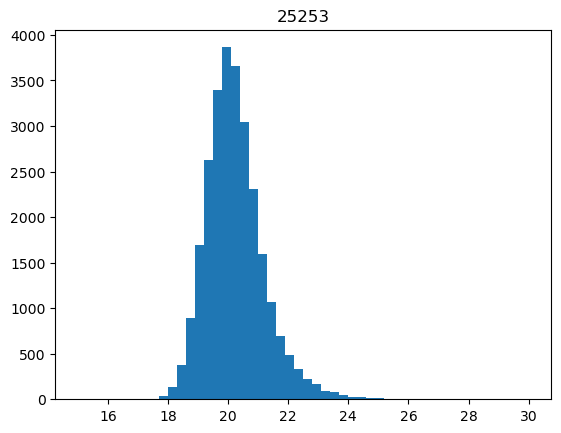

 17%|█████████████▏                                                                 | 179/1075 [00:24<01:55,  7.77it/s]

6143


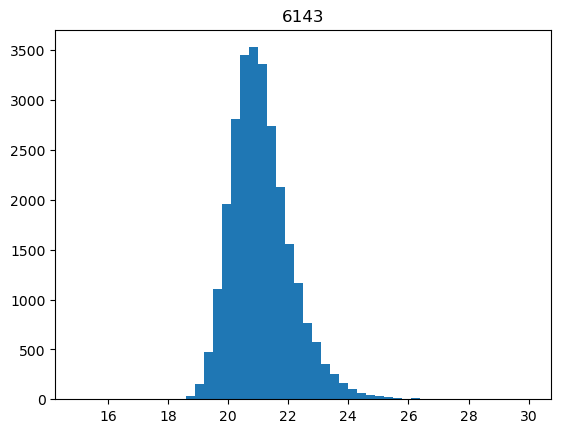

 17%|█████████████▏                                                                 | 180/1075 [00:24<01:54,  7.82it/s]

9996


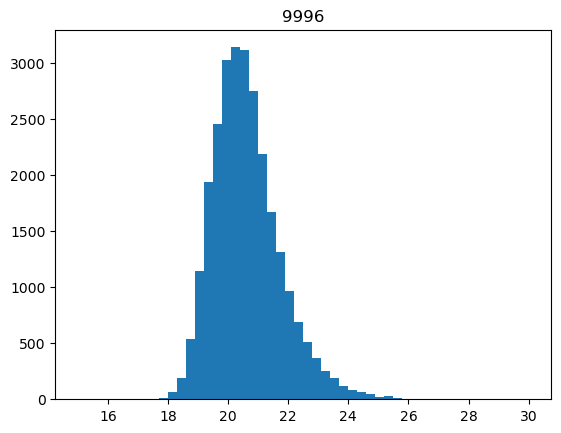

 17%|█████████████▎                                                                 | 181/1075 [00:24<01:53,  7.85it/s]

10524


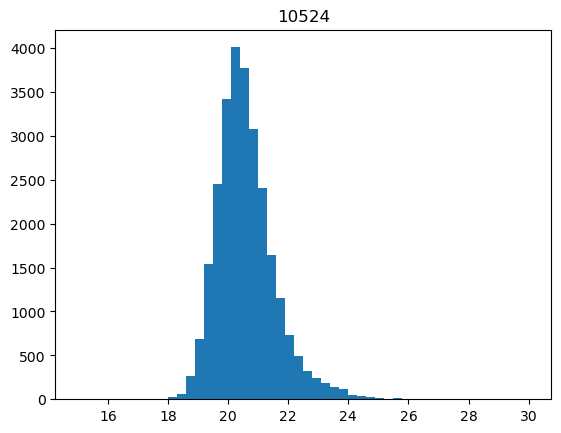

 17%|█████████████▎                                                                 | 182/1075 [00:24<02:17,  6.47it/s]

19852


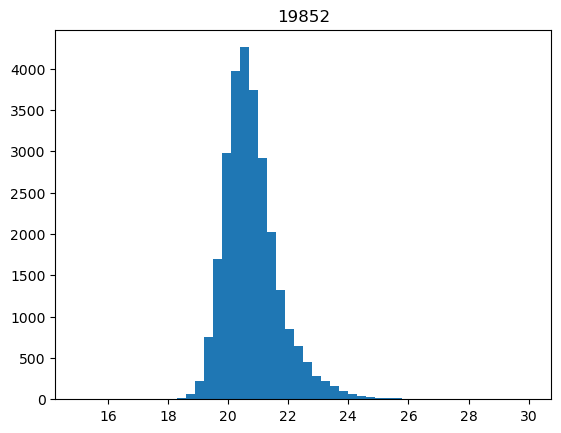

 17%|█████████████▍                                                                 | 183/1075 [00:24<02:11,  6.77it/s]

673


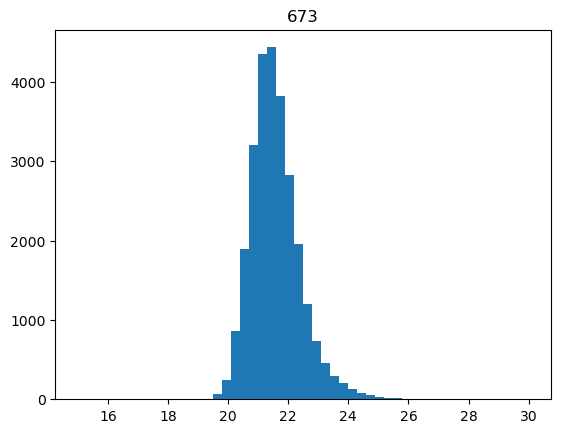

 17%|█████████████▌                                                                 | 184/1075 [00:24<02:05,  7.11it/s]

20857


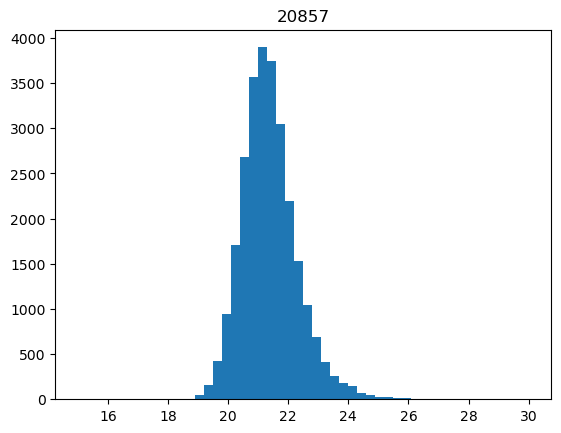

 17%|█████████████▌                                                                 | 185/1075 [00:24<02:02,  7.29it/s]

23072


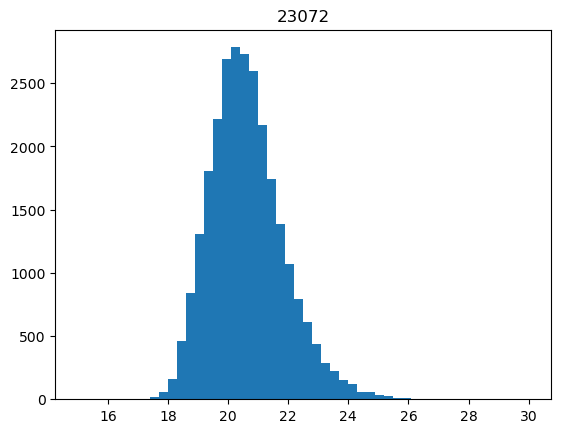

 17%|█████████████▋                                                                 | 186/1075 [00:24<01:58,  7.52it/s]

9560


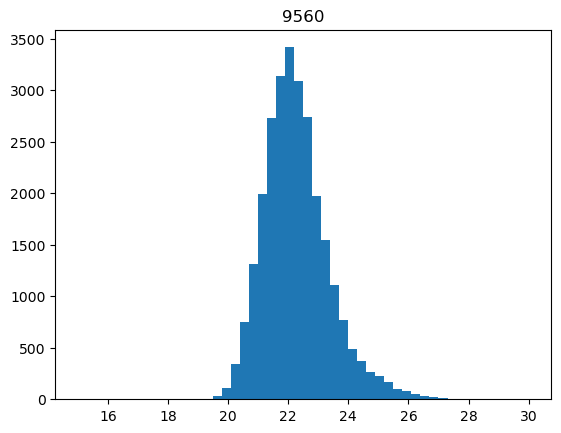

 17%|█████████████▋                                                                 | 187/1075 [00:25<01:56,  7.59it/s]

19540


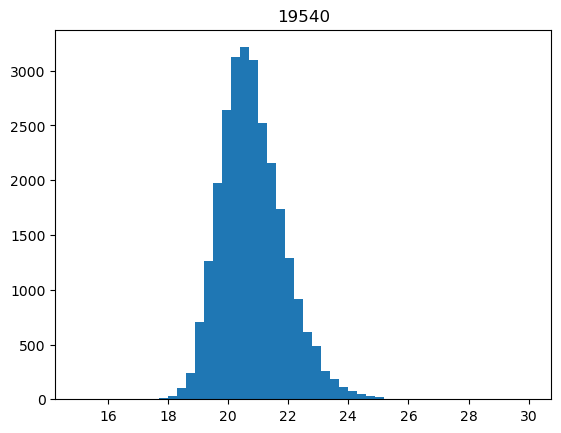

 17%|█████████████▊                                                                 | 188/1075 [00:25<01:54,  7.73it/s]

3895


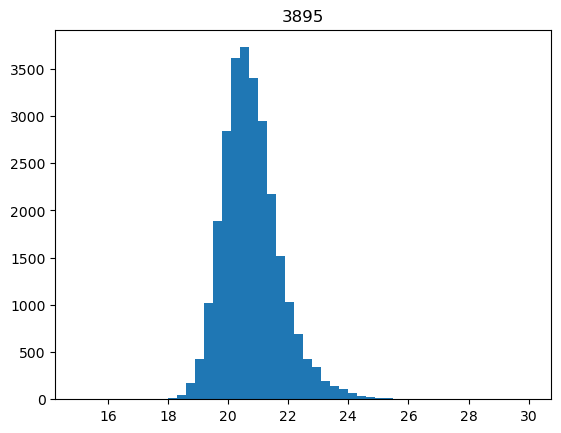

 18%|█████████████▉                                                                 | 189/1075 [00:25<01:53,  7.79it/s]

19839


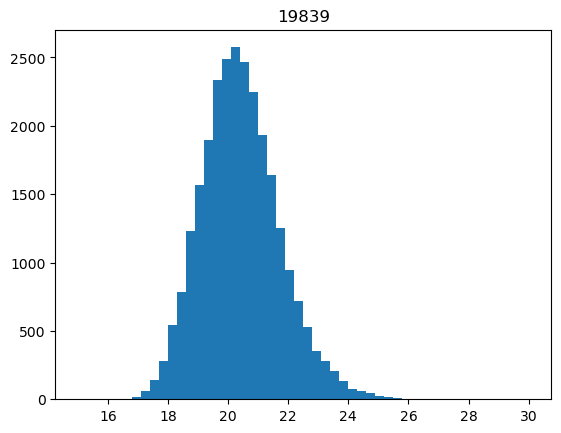

 18%|█████████████▉                                                                 | 190/1075 [00:25<01:52,  7.89it/s]

3348


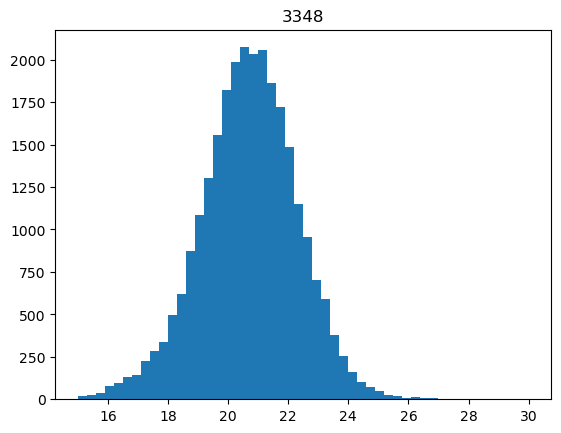

 18%|██████████████                                                                 | 191/1075 [00:25<01:52,  7.85it/s]

9572


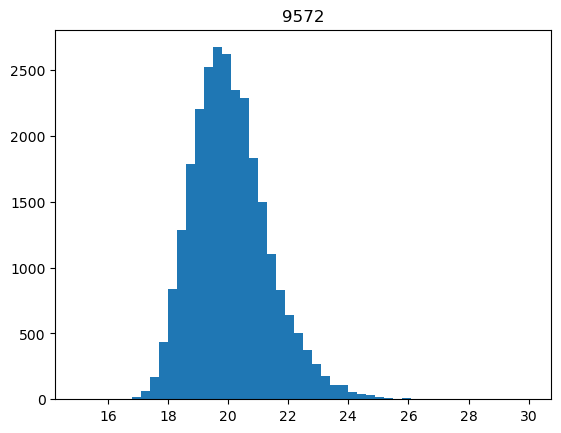

 18%|██████████████                                                                 | 192/1075 [00:25<01:50,  7.97it/s]

1597


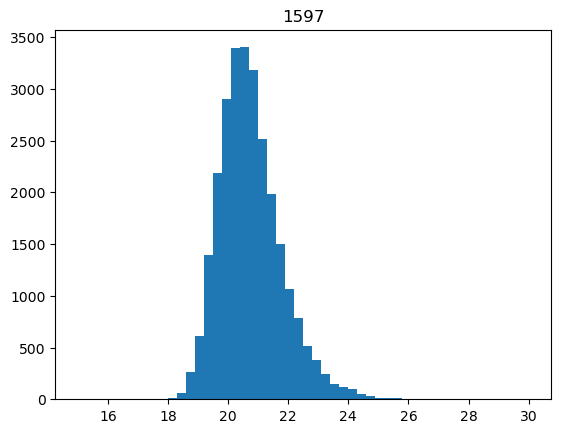

 18%|██████████████▏                                                                | 193/1075 [00:25<02:15,  6.52it/s]

7131


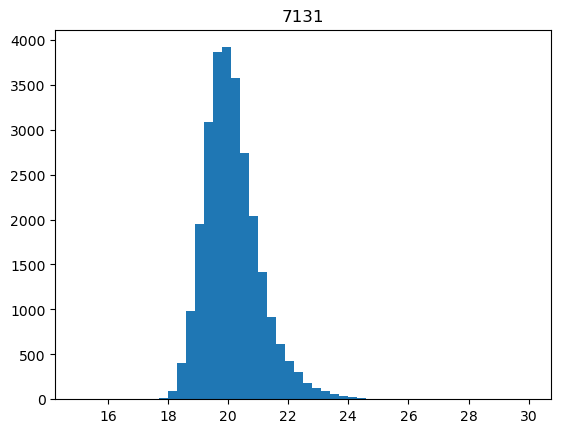

 18%|██████████████▎                                                                | 194/1075 [00:26<02:09,  6.82it/s]

11204


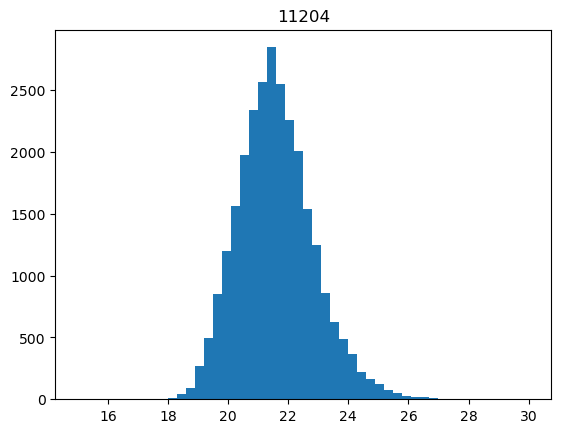

 18%|██████████████▎                                                                | 195/1075 [00:26<02:03,  7.14it/s]

15647


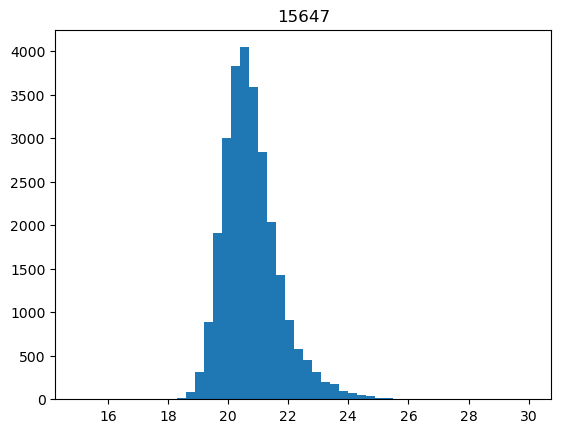

 18%|██████████████▍                                                                | 196/1075 [00:26<02:01,  7.26it/s]

10708


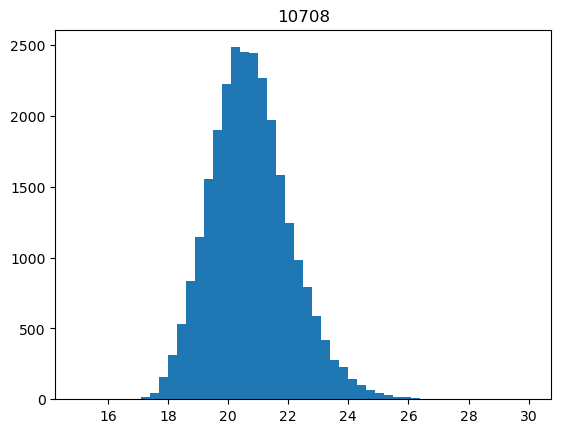

 18%|██████████████▍                                                                | 197/1075 [00:26<01:57,  7.47it/s]

17380


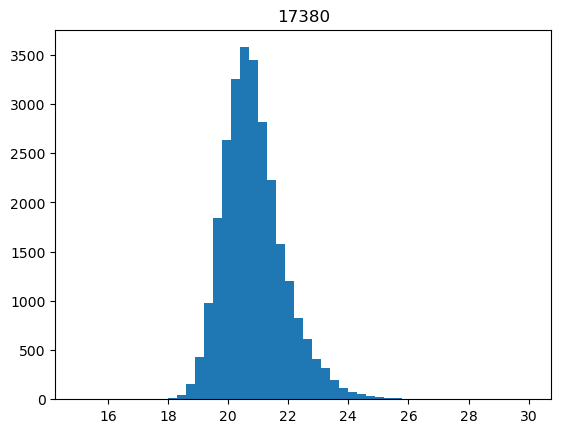

 18%|██████████████▌                                                                | 198/1075 [00:26<01:55,  7.60it/s]

7490


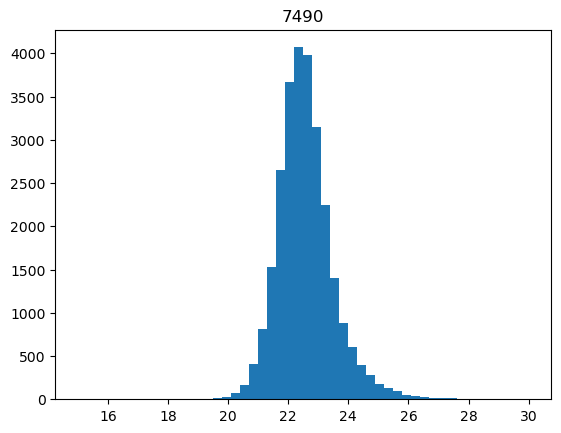

 19%|██████████████▌                                                                | 199/1075 [00:26<01:54,  7.66it/s]

736


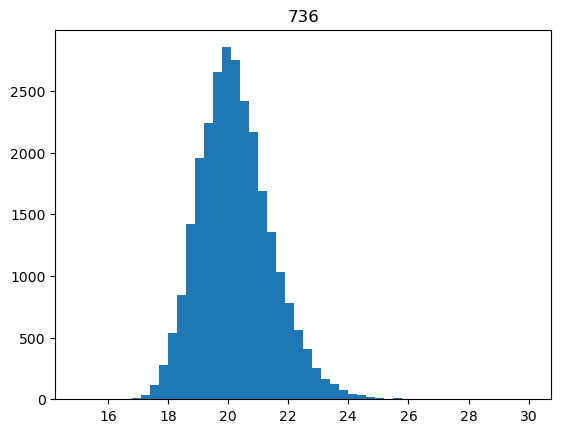

 19%|██████████████▋                                                                | 200/1075 [00:26<01:52,  7.76it/s]

7685


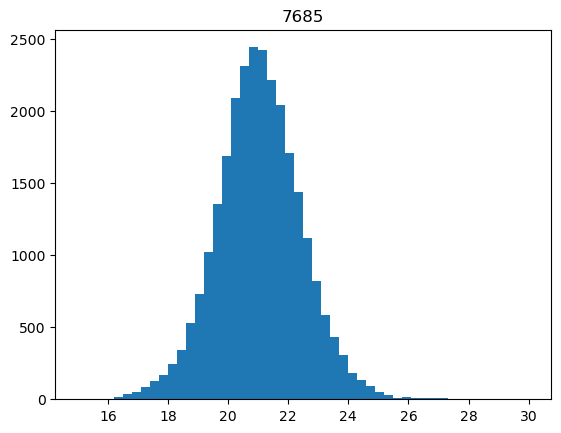

 19%|██████████████▊                                                                | 201/1075 [00:26<01:50,  7.92it/s]

6937


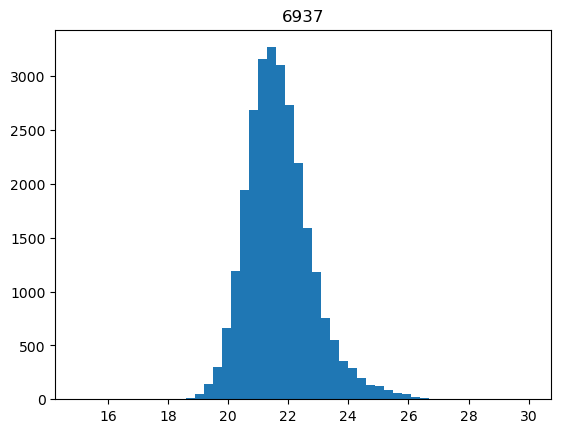

 19%|██████████████▊                                                                | 202/1075 [00:27<01:50,  7.89it/s]

139


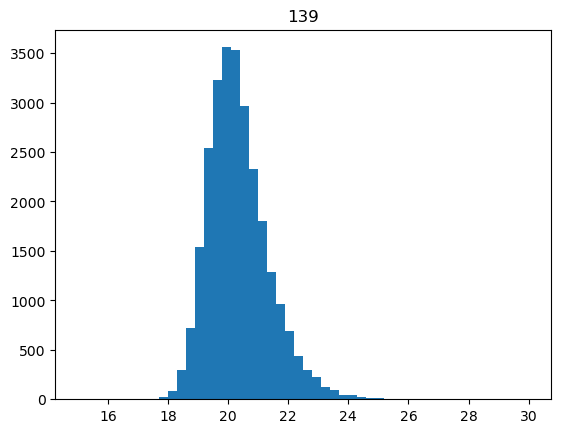

 19%|██████████████▉                                                                | 203/1075 [00:27<01:51,  7.83it/s]

6980


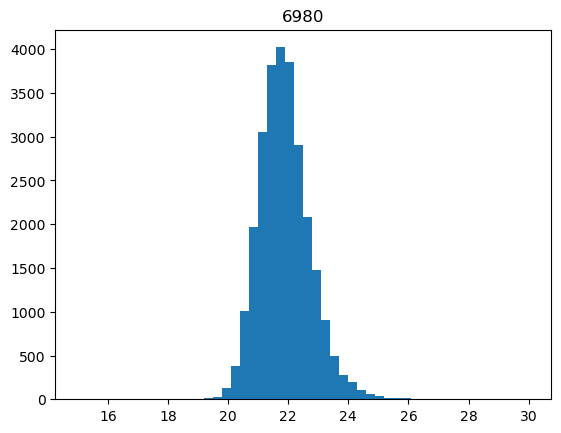

 19%|██████████████▉                                                                | 204/1075 [00:27<02:12,  6.56it/s]

26408


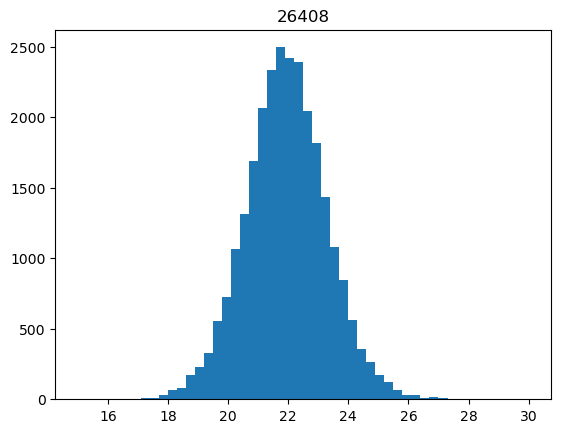

 19%|███████████████                                                                | 205/1075 [00:27<02:05,  6.93it/s]

8702


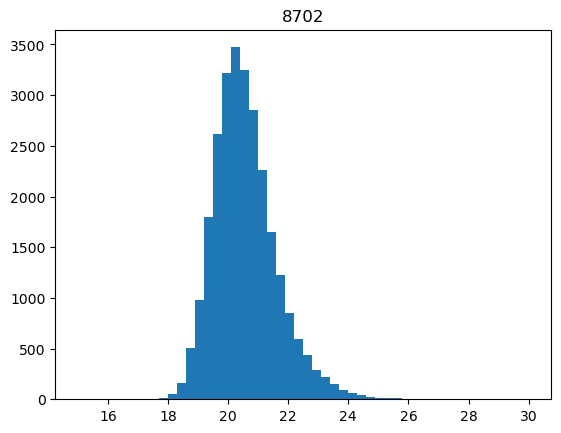

 19%|███████████████▏                                                               | 206/1075 [00:27<02:01,  7.15it/s]

15580


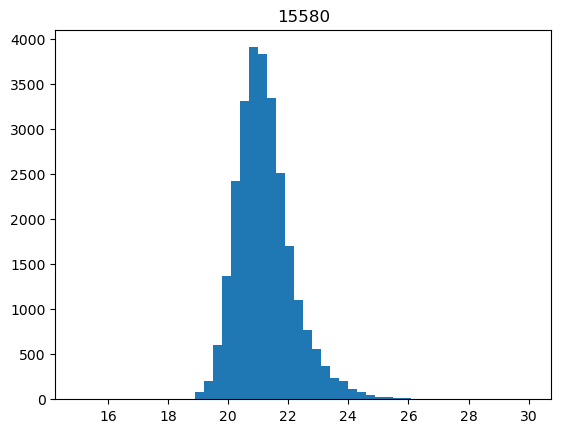

 19%|███████████████▏                                                               | 207/1075 [00:27<01:57,  7.37it/s]

8098


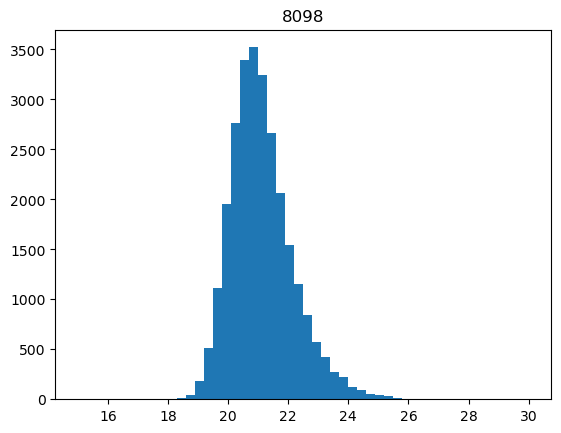

 19%|███████████████▎                                                               | 208/1075 [00:27<01:55,  7.49it/s]

4464


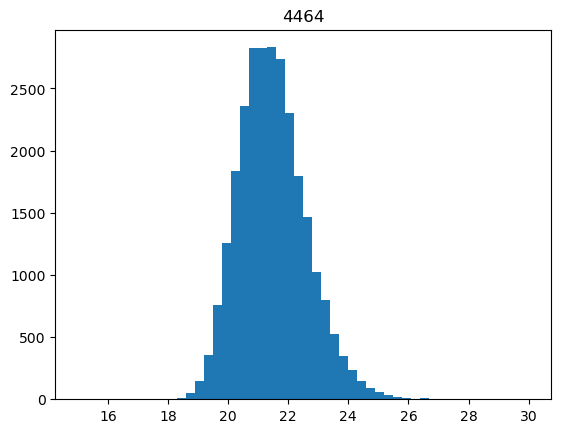

 19%|███████████████▎                                                               | 209/1075 [00:28<01:53,  7.66it/s]

24171


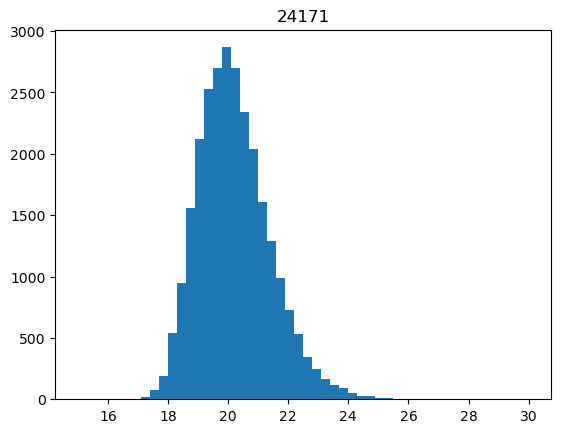

 20%|███████████████▍                                                               | 210/1075 [00:28<01:51,  7.74it/s]

21286


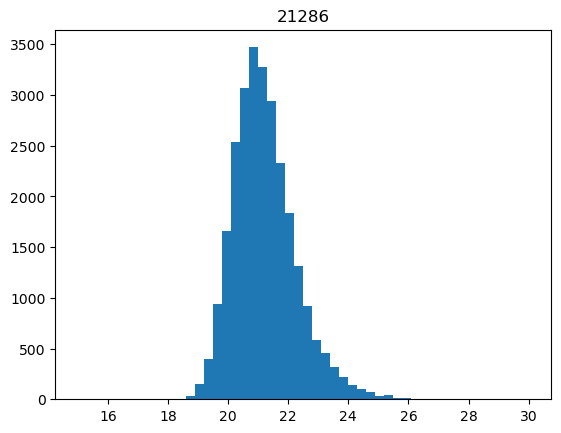

 20%|███████████████▌                                                               | 211/1075 [00:28<01:50,  7.83it/s]

17589


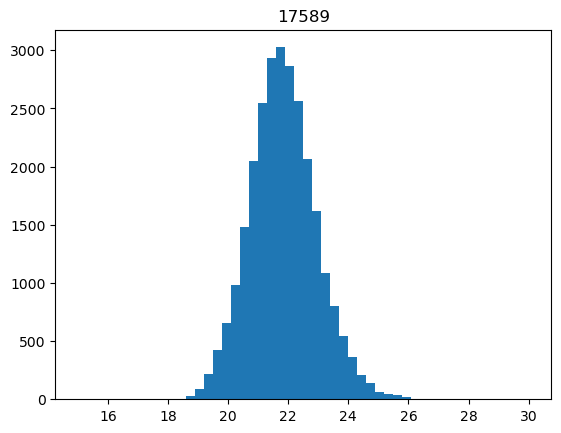

 20%|███████████████▌                                                               | 212/1075 [00:28<01:48,  7.96it/s]

10512


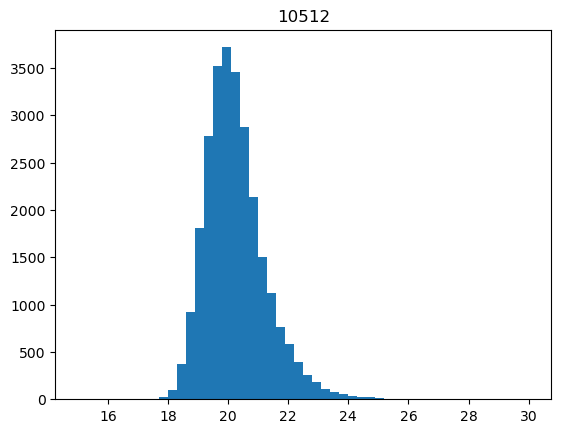

 20%|███████████████▋                                                               | 213/1075 [00:28<01:48,  7.95it/s]

18243


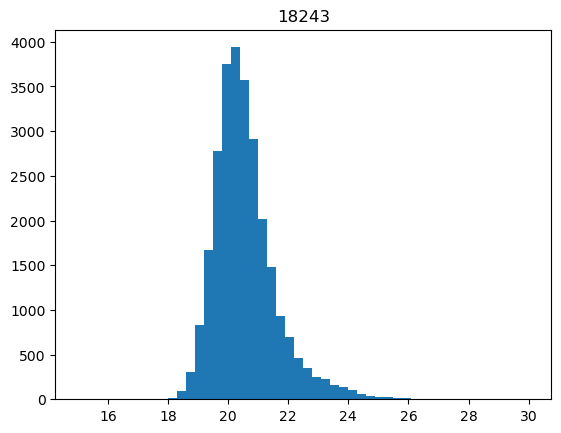

 20%|███████████████▋                                                               | 214/1075 [00:28<01:49,  7.85it/s]

11914


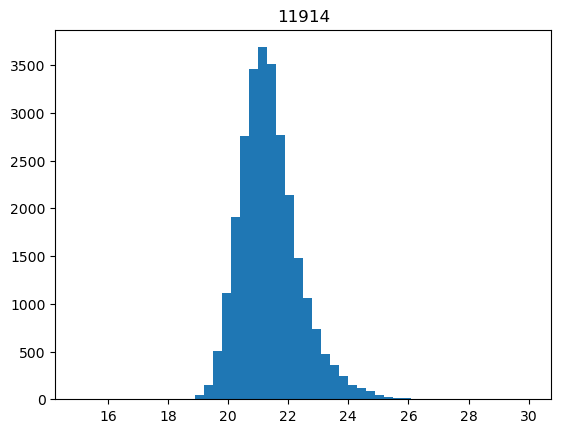

 20%|███████████████▊                                                               | 215/1075 [00:28<02:11,  6.56it/s]

8574


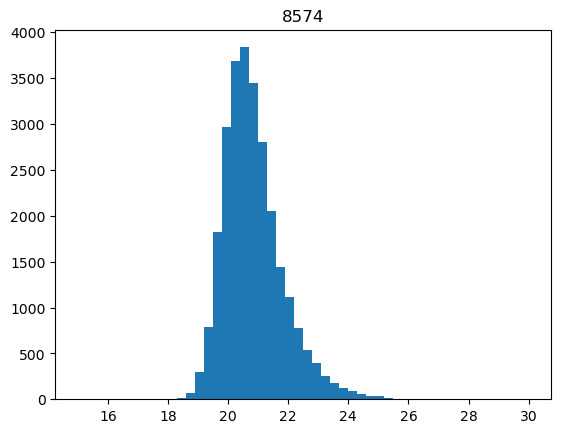

 20%|███████████████▊                                                               | 216/1075 [00:29<02:04,  6.89it/s]

23720


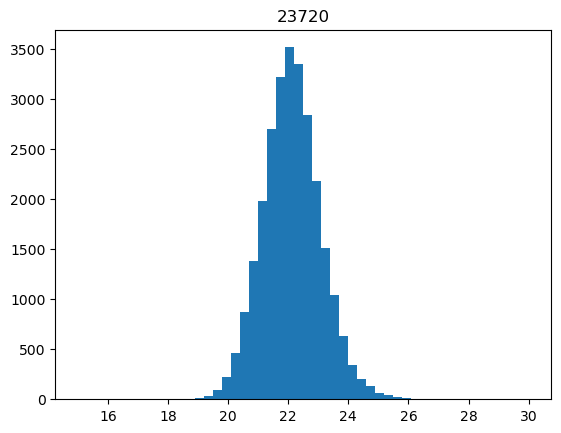

 20%|███████████████▉                                                               | 217/1075 [00:29<01:59,  7.17it/s]

23541


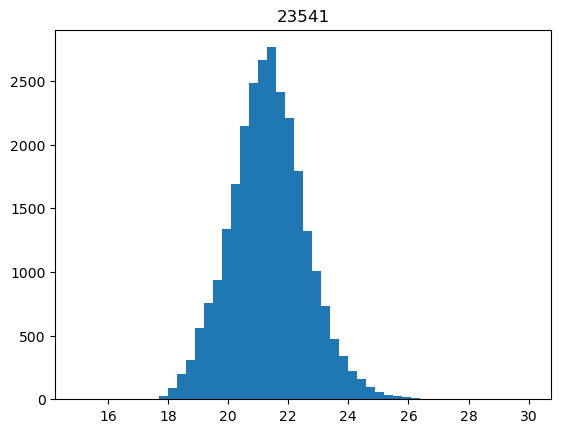

 20%|████████████████                                                               | 218/1075 [00:29<01:55,  7.40it/s]

6610


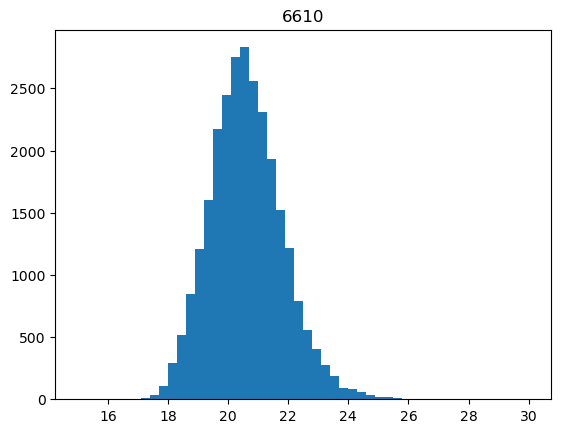

 20%|████████████████                                                               | 219/1075 [00:29<01:53,  7.54it/s]

14115


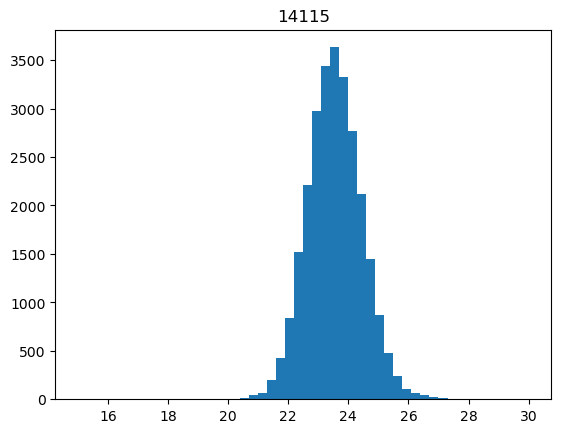

 20%|████████████████▏                                                              | 220/1075 [00:29<01:52,  7.62it/s]

20653


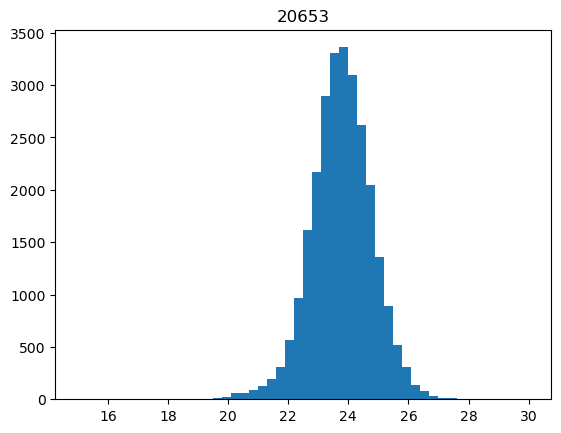

 21%|████████████████▏                                                              | 221/1075 [00:29<01:50,  7.73it/s]

15908


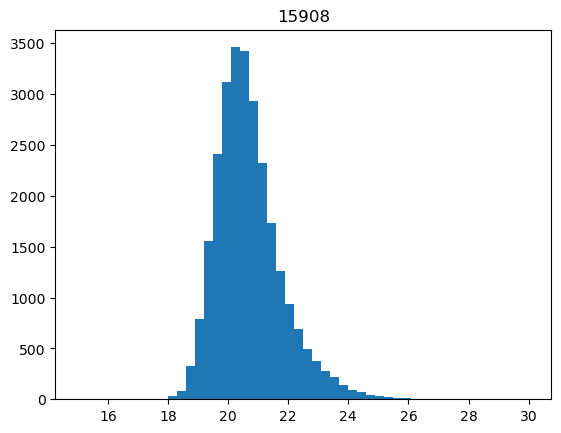

 21%|████████████████▎                                                              | 222/1075 [00:29<01:49,  7.79it/s]

6612


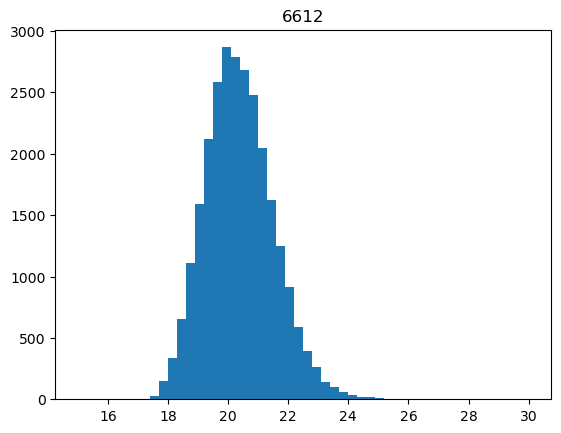

 21%|████████████████▍                                                              | 223/1075 [00:29<01:49,  7.81it/s]

4415


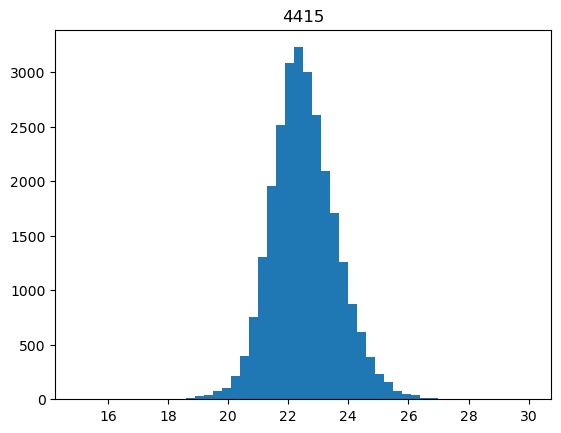

 21%|████████████████▍                                                              | 224/1075 [00:30<01:48,  7.87it/s]

4991


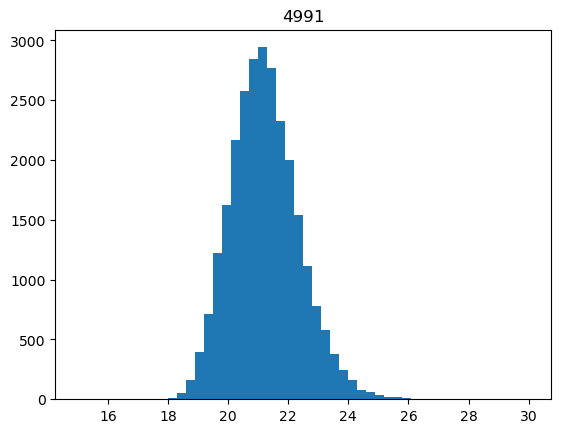

 21%|████████████████▌                                                              | 225/1075 [00:30<01:47,  7.91it/s]

11703


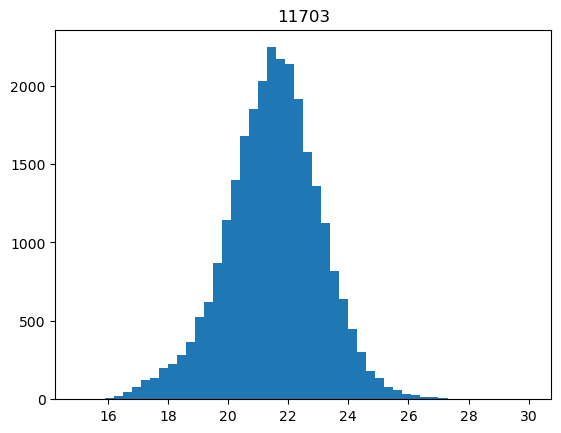

 21%|████████████████▌                                                              | 226/1075 [00:30<02:07,  6.66it/s]

14660


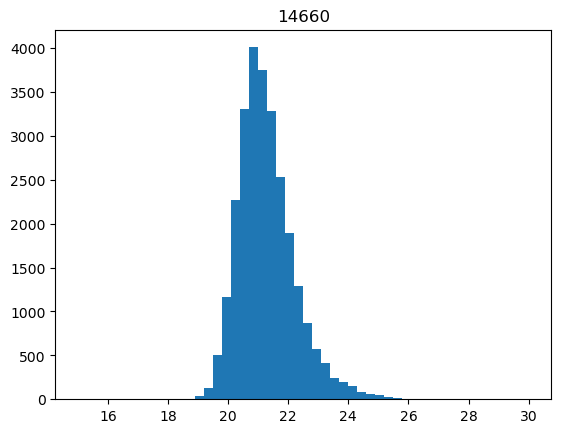

 21%|████████████████▋                                                              | 227/1075 [00:30<02:00,  7.02it/s]

2389


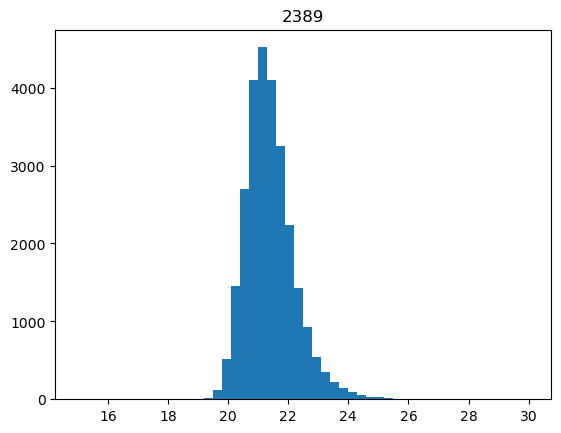

 21%|████████████████▊                                                              | 228/1075 [00:30<01:54,  7.38it/s]

5472


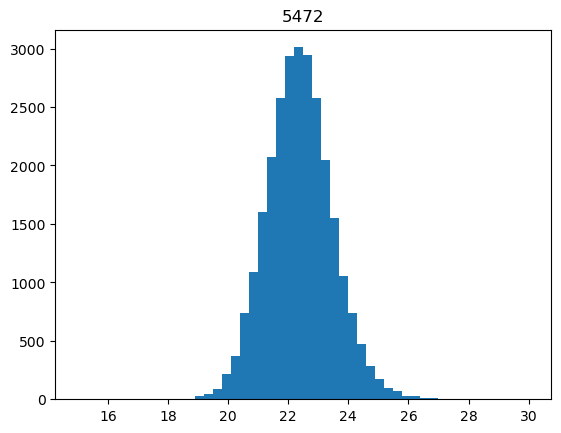

 21%|████████████████▊                                                              | 229/1075 [00:30<01:52,  7.52it/s]

25627


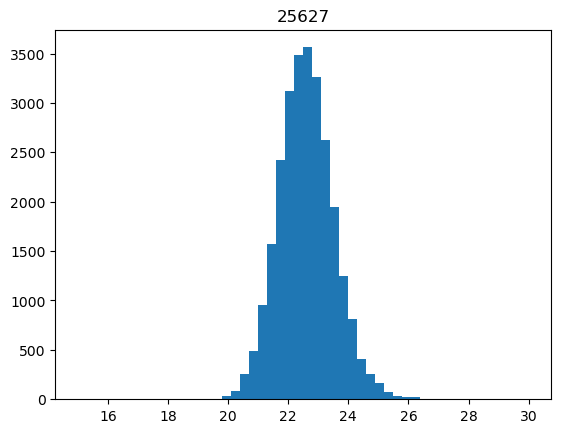

 21%|████████████████▉                                                              | 230/1075 [00:30<01:50,  7.62it/s]

10818


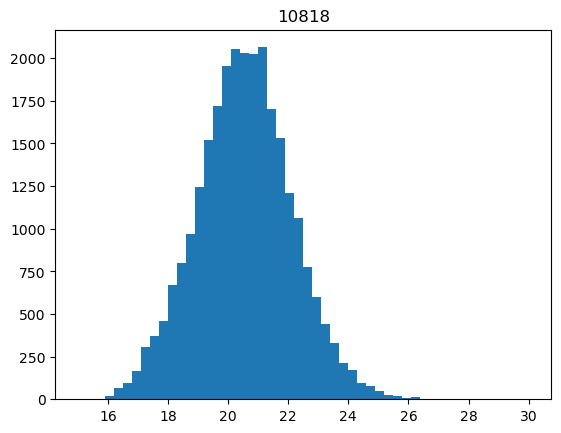

 21%|████████████████▉                                                              | 231/1075 [00:30<01:49,  7.70it/s]

8824


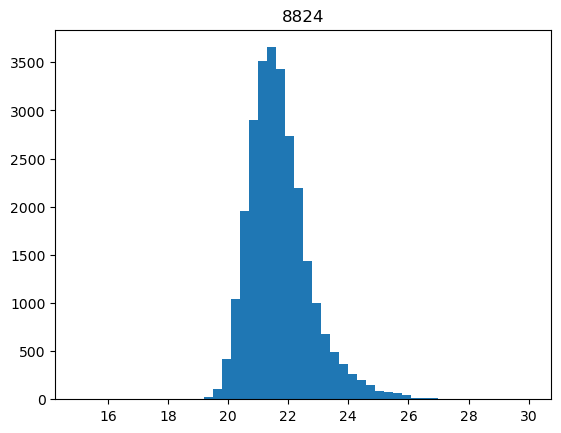

 22%|█████████████████                                                              | 232/1075 [00:31<01:50,  7.61it/s]

7433


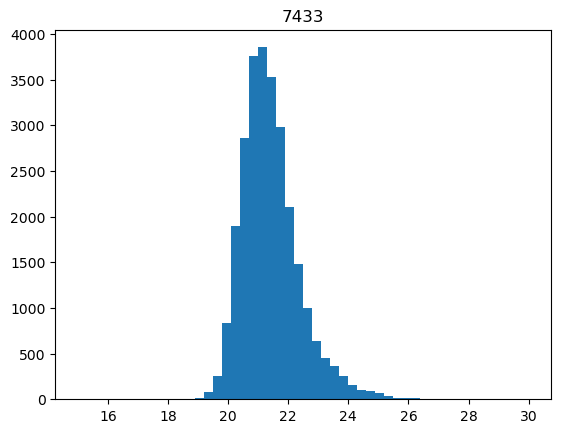

 22%|█████████████████                                                              | 233/1075 [00:31<01:51,  7.58it/s]

7099


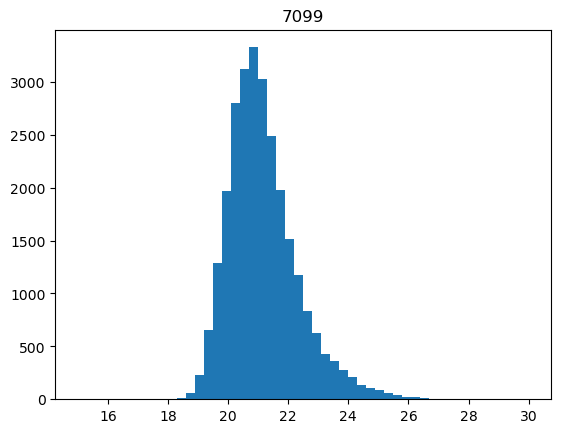

 22%|█████████████████▏                                                             | 234/1075 [00:31<01:49,  7.67it/s]

2405


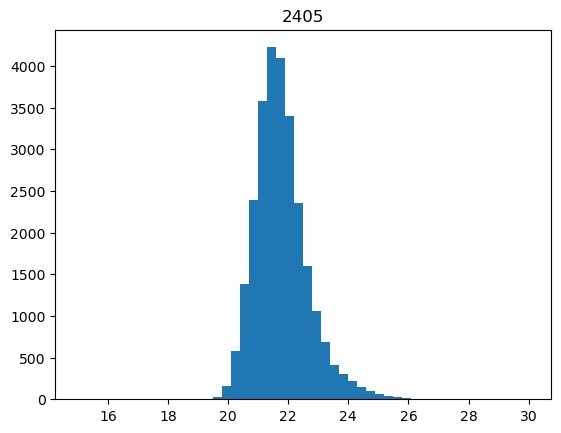

 22%|█████████████████▎                                                             | 235/1075 [00:31<01:48,  7.76it/s]

4840


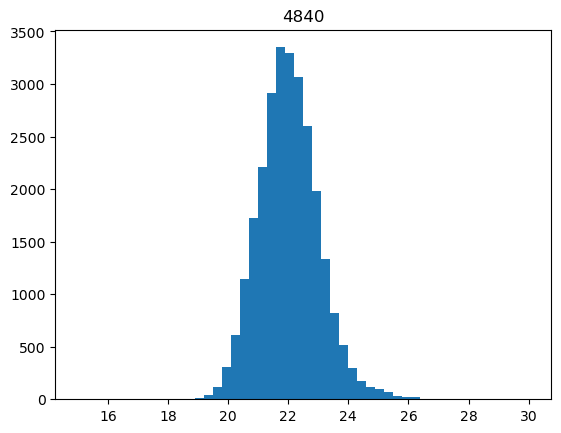

 22%|█████████████████▎                                                             | 236/1075 [00:31<01:46,  7.85it/s]

12137


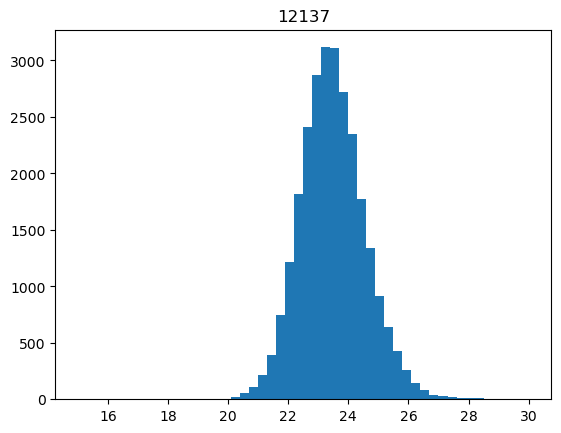

 22%|█████████████████▍                                                             | 237/1075 [00:31<02:13,  6.29it/s]

21477


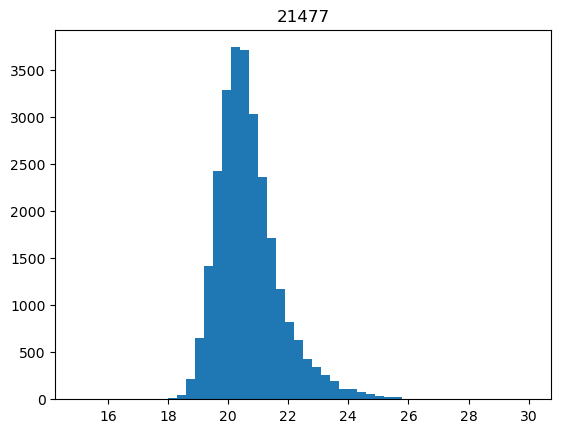

 22%|█████████████████▍                                                             | 238/1075 [00:32<02:05,  6.65it/s]

15132


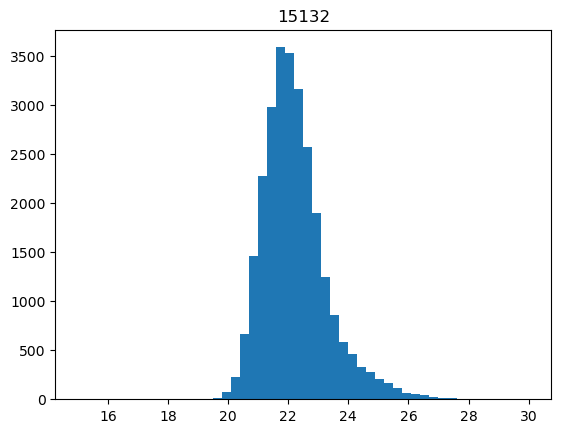

 22%|█████████████████▌                                                             | 239/1075 [00:32<01:59,  6.98it/s]

23873


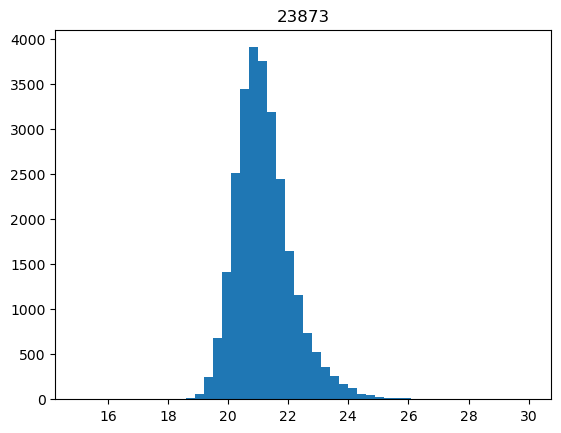

 22%|█████████████████▋                                                             | 240/1075 [00:32<01:56,  7.19it/s]

16955


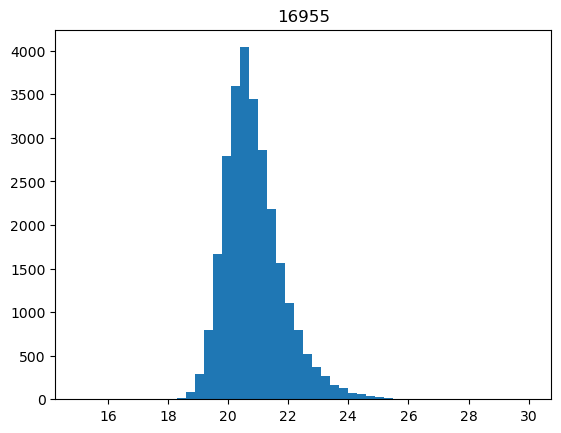

 22%|█████████████████▋                                                             | 241/1075 [00:32<01:54,  7.30it/s]

20016


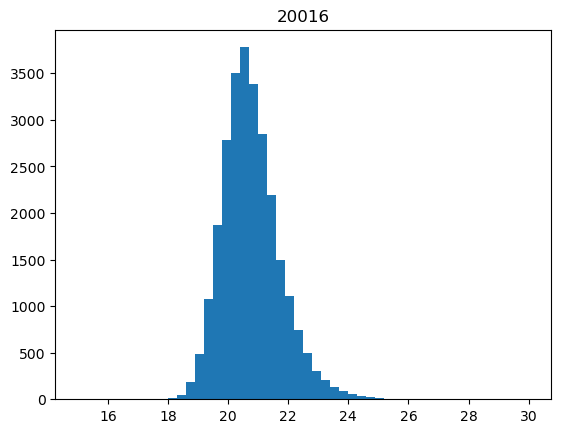

 23%|█████████████████▊                                                             | 242/1075 [00:32<01:51,  7.50it/s]

20250


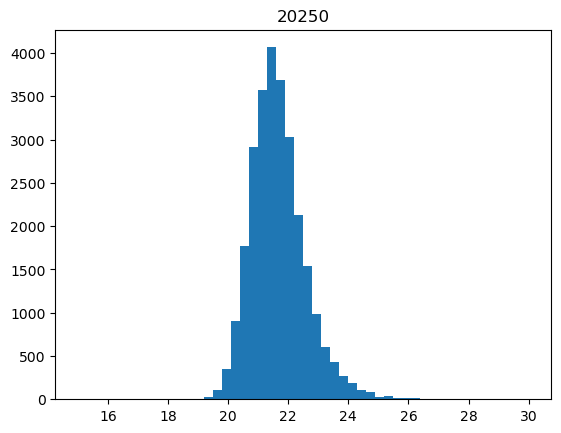

 23%|█████████████████▊                                                             | 243/1075 [00:32<01:49,  7.62it/s]

4831


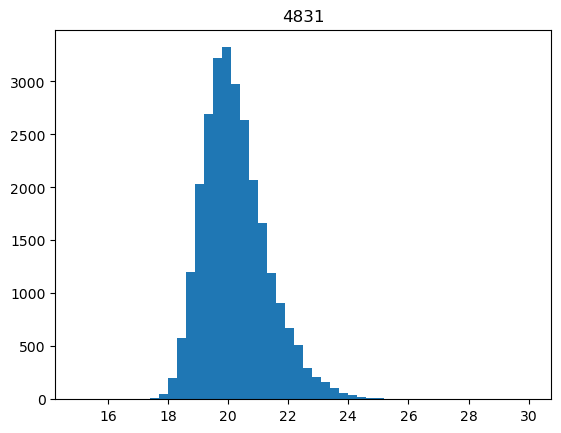

 23%|█████████████████▉                                                             | 244/1075 [00:32<01:46,  7.77it/s]

6022


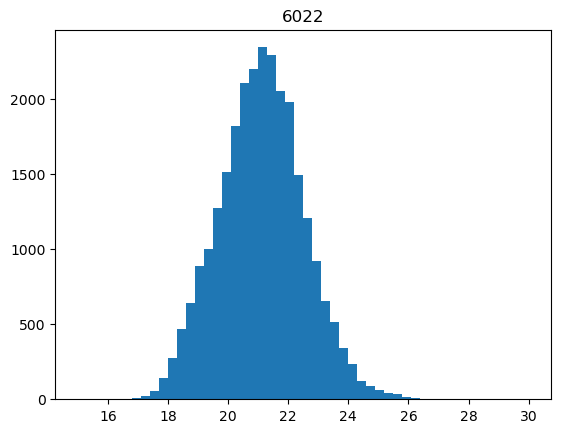

 23%|██████████████████                                                             | 245/1075 [00:32<01:44,  7.91it/s]

22141


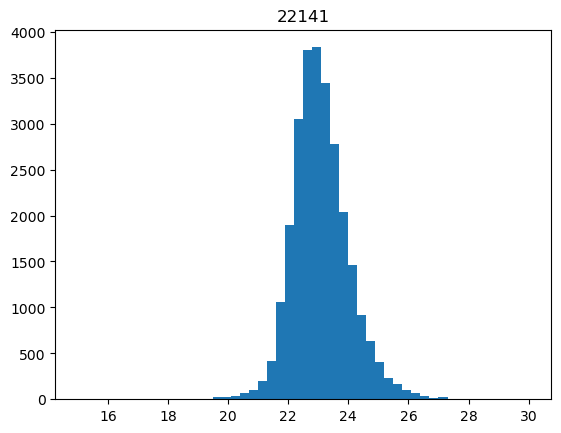

 23%|██████████████████                                                             | 246/1075 [00:33<01:44,  7.90it/s]

26039


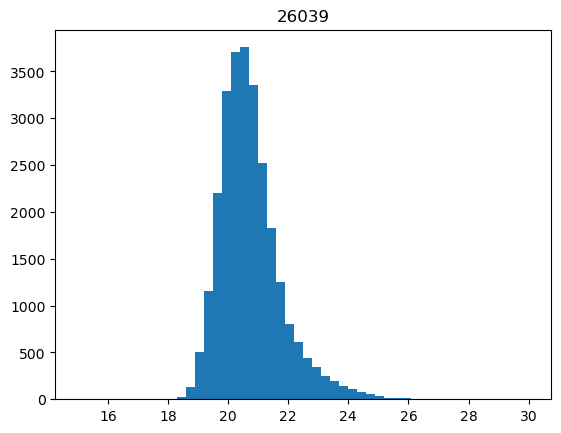

 23%|██████████████████▏                                                            | 247/1075 [00:33<01:44,  7.93it/s]

4257


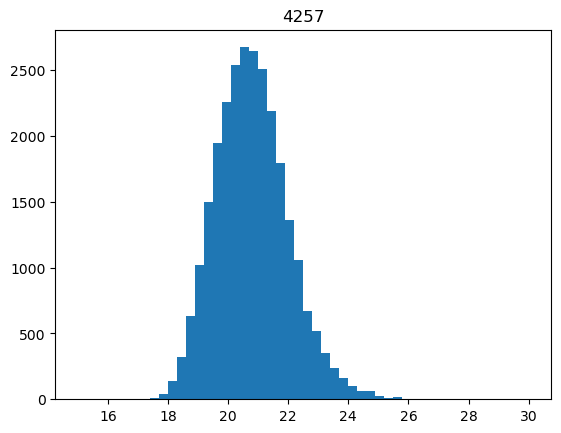

 23%|██████████████████▏                                                            | 248/1075 [00:33<02:04,  6.65it/s]

3403


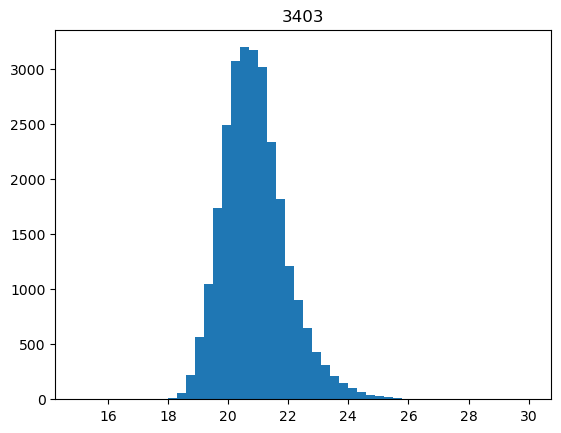

 23%|██████████████████▎                                                            | 249/1075 [00:33<01:56,  7.06it/s]

5446


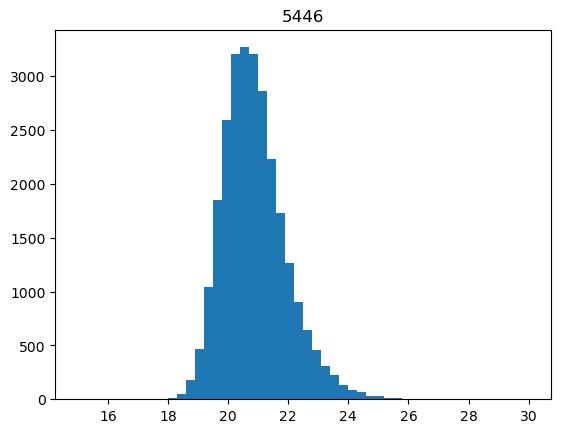

 23%|██████████████████▎                                                            | 250/1075 [00:33<01:51,  7.38it/s]

22523


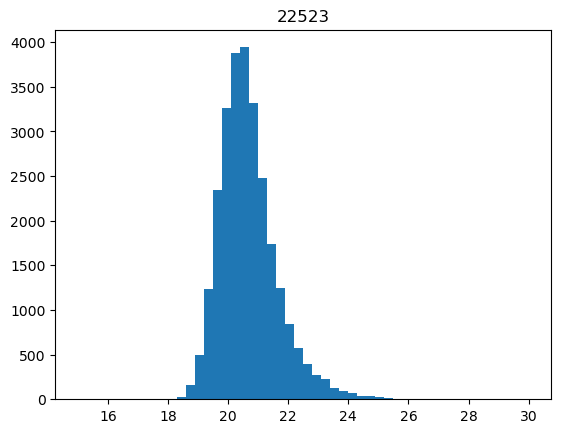

 23%|██████████████████▍                                                            | 251/1075 [00:33<01:50,  7.46it/s]

23889


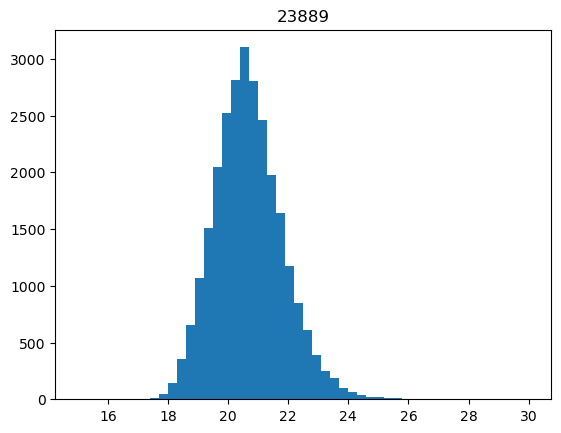

 23%|██████████████████▌                                                            | 252/1075 [00:33<01:47,  7.65it/s]

14269


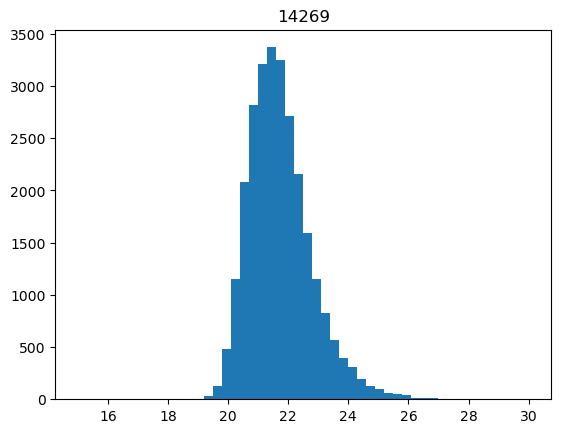

 24%|██████████████████▌                                                            | 253/1075 [00:33<01:45,  7.77it/s]

23453


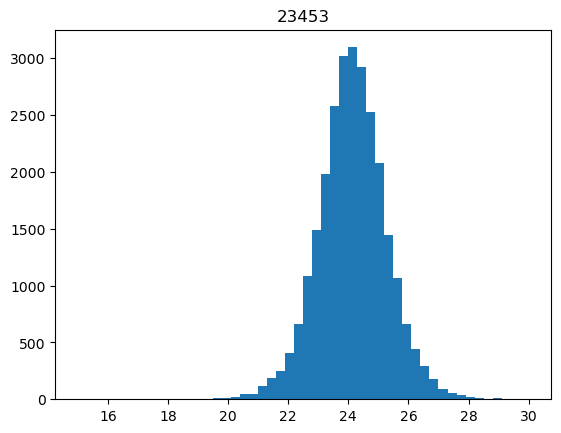

 24%|██████████████████▋                                                            | 254/1075 [00:34<01:44,  7.85it/s]

86


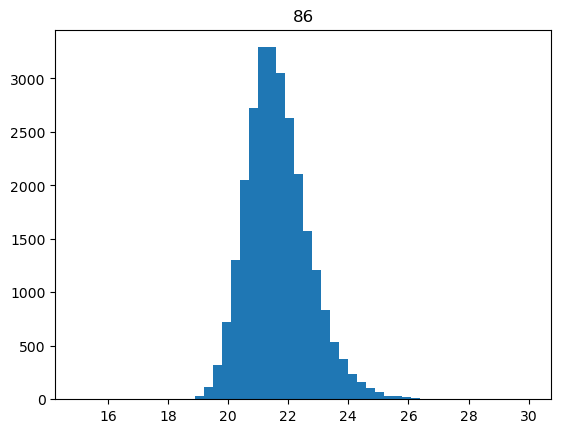

 24%|██████████████████▋                                                            | 255/1075 [00:34<01:42,  7.99it/s]

3264


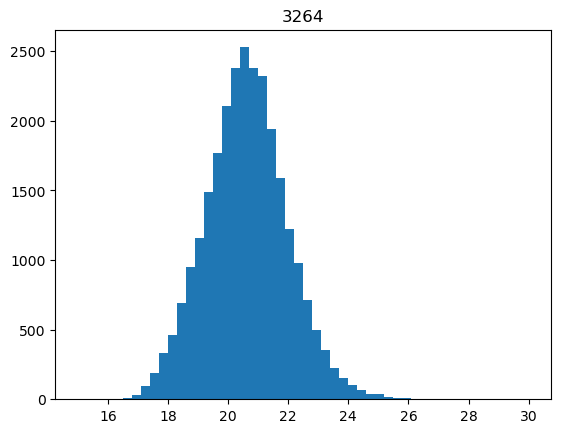

 24%|██████████████████▊                                                            | 256/1075 [00:34<01:41,  8.09it/s]

16318


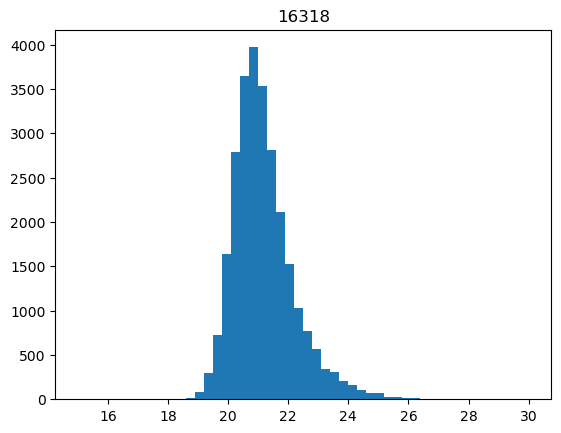

 24%|██████████████████▉                                                            | 257/1075 [00:34<01:41,  8.02it/s]

9052


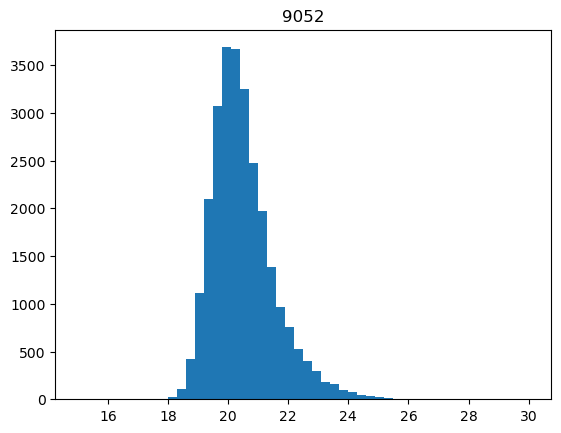

 24%|██████████████████▉                                                            | 258/1075 [00:34<01:42,  7.96it/s]

12732


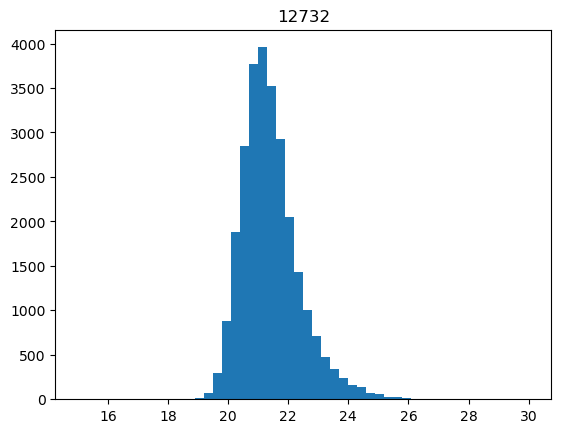

 24%|███████████████████                                                            | 259/1075 [00:34<02:03,  6.58it/s]

1058


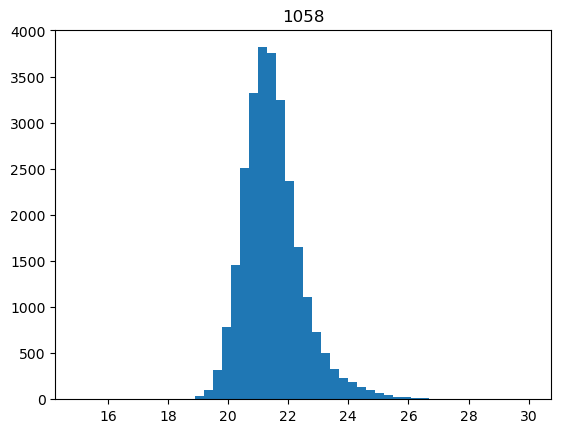

 24%|███████████████████                                                            | 260/1075 [00:34<01:57,  6.94it/s]

8373


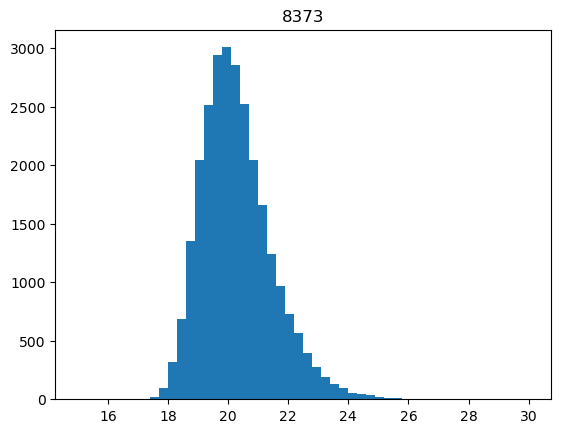

 24%|███████████████████▏                                                           | 261/1075 [00:35<01:52,  7.24it/s]

14053


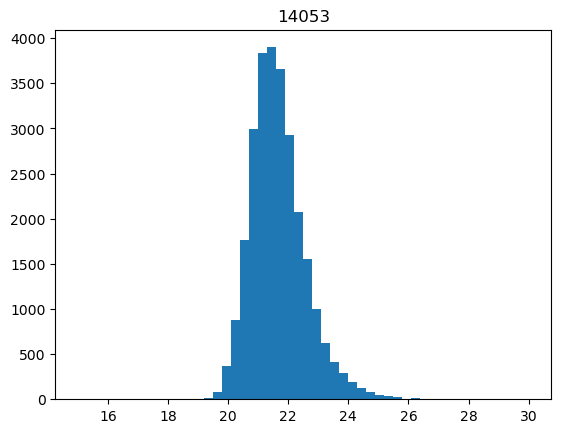

 24%|███████████████████▎                                                           | 262/1075 [00:35<01:49,  7.44it/s]

3032


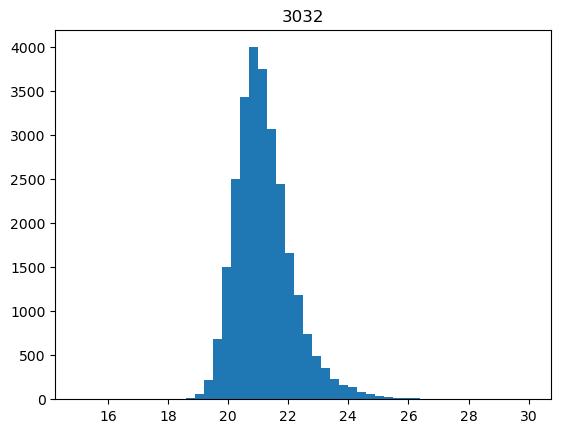

 24%|███████████████████▎                                                           | 263/1075 [00:35<01:47,  7.56it/s]

14081


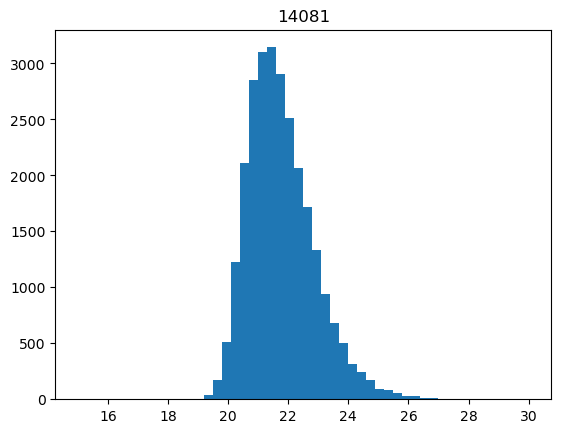

 25%|███████████████████▍                                                           | 264/1075 [00:35<01:45,  7.71it/s]

26574


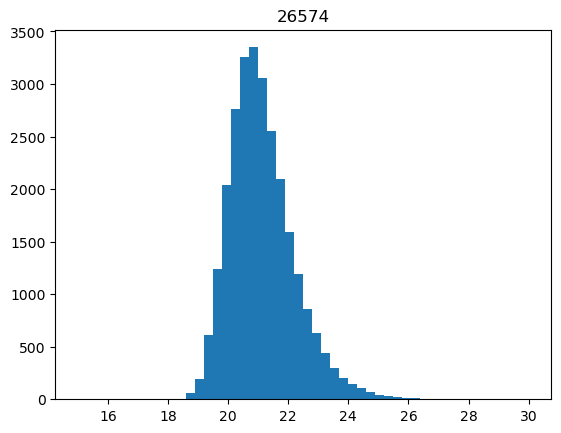

 25%|███████████████████▍                                                           | 265/1075 [00:35<01:43,  7.79it/s]

101


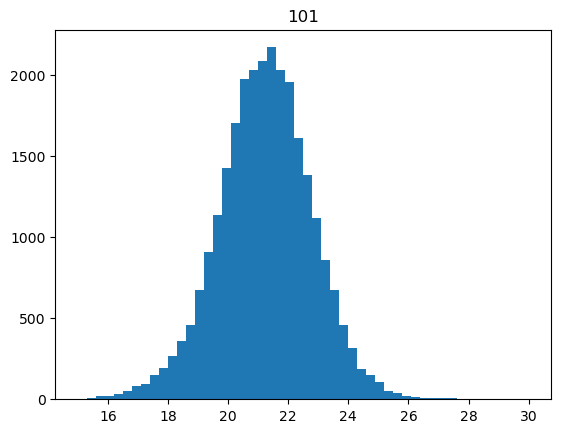

 25%|███████████████████▌                                                           | 266/1075 [00:35<01:42,  7.93it/s]

23842


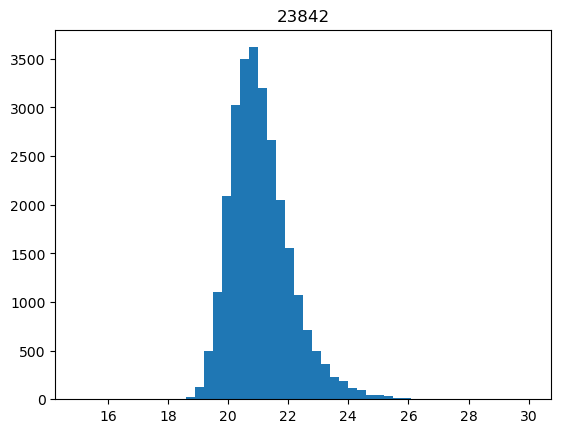

 25%|███████████████████▌                                                           | 267/1075 [00:35<01:41,  7.97it/s]

17500


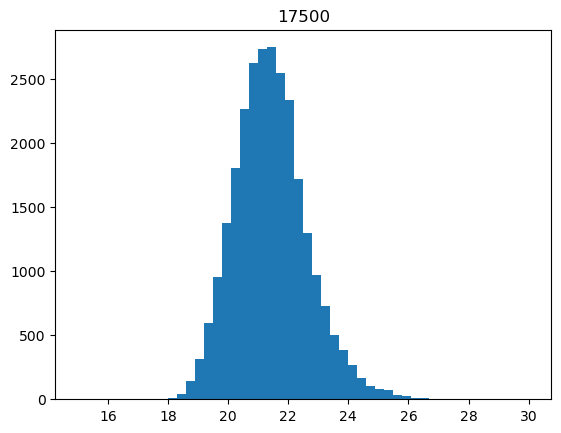

 25%|███████████████████▋                                                           | 268/1075 [00:35<01:40,  8.01it/s]

22073


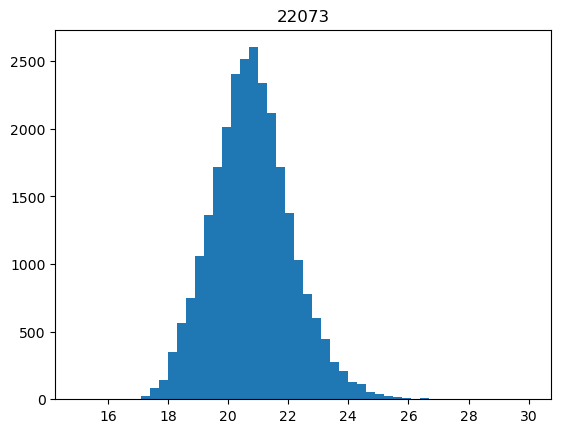

 25%|███████████████████▊                                                           | 269/1075 [00:36<01:39,  8.09it/s]

25568


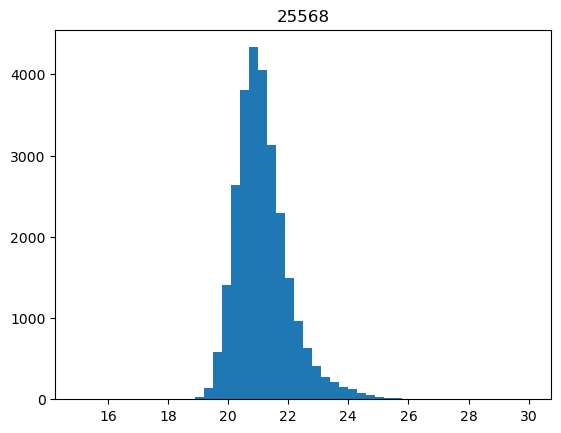

 25%|███████████████████▊                                                           | 270/1075 [00:36<01:58,  6.78it/s]

1585


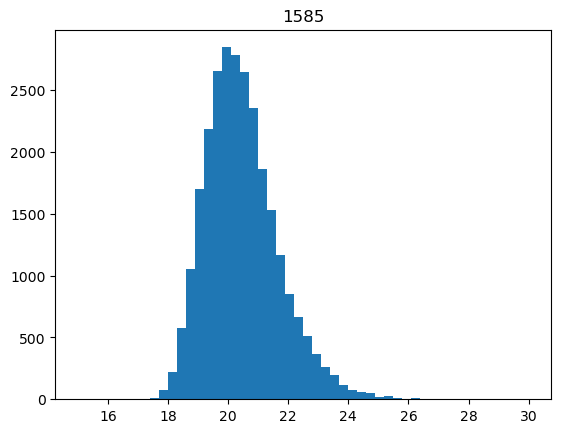

 25%|███████████████████▉                                                           | 271/1075 [00:36<01:52,  7.15it/s]

25698


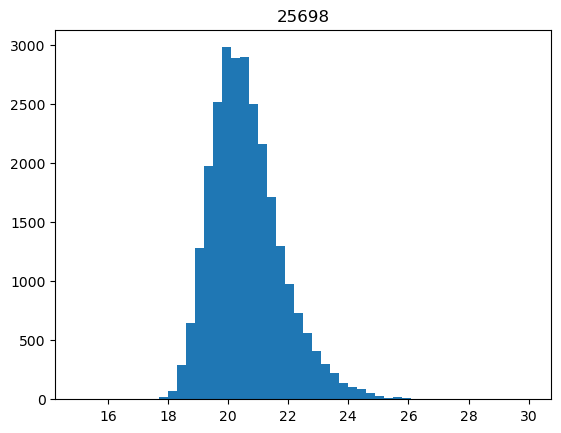

 25%|███████████████████▉                                                           | 272/1075 [00:36<01:48,  7.37it/s]

1017


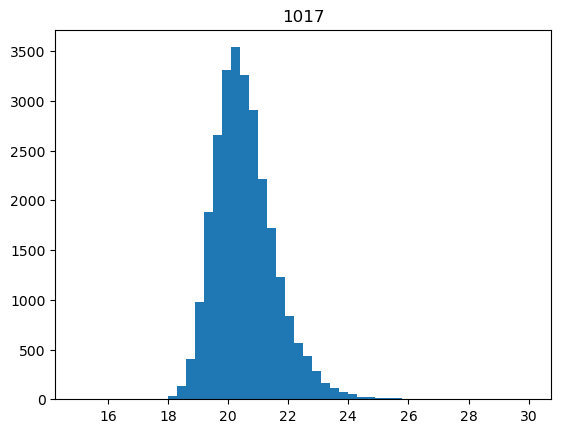

 25%|████████████████████                                                           | 273/1075 [00:36<01:46,  7.56it/s]

16928


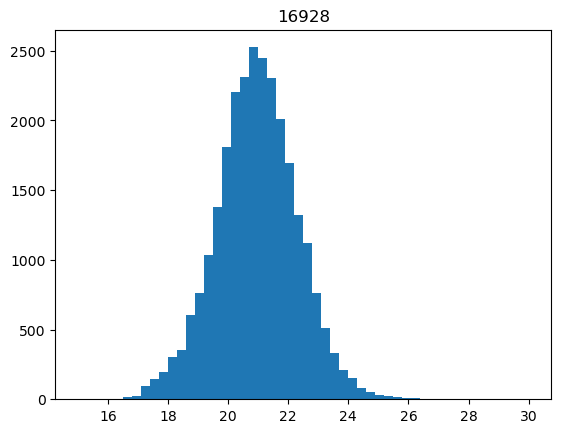

 25%|████████████████████▏                                                          | 274/1075 [00:36<01:43,  7.76it/s]

12584


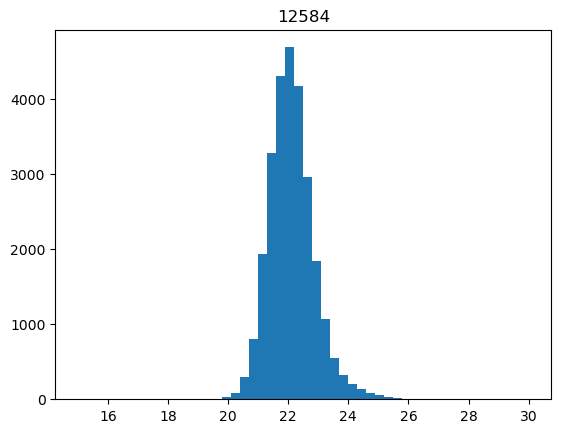

 26%|████████████████████▏                                                          | 275/1075 [00:36<01:41,  7.91it/s]

14500


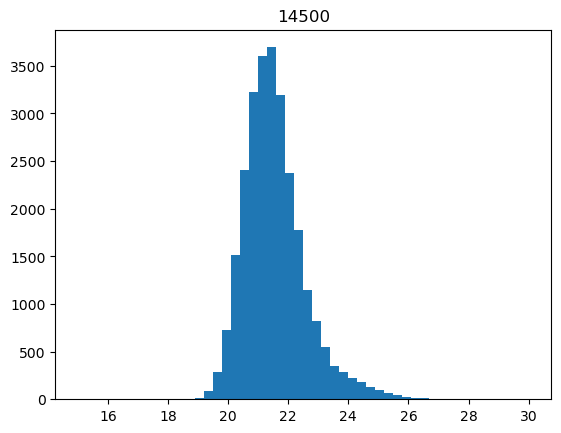

 26%|████████████████████▎                                                          | 276/1075 [00:36<01:40,  7.93it/s]

25373


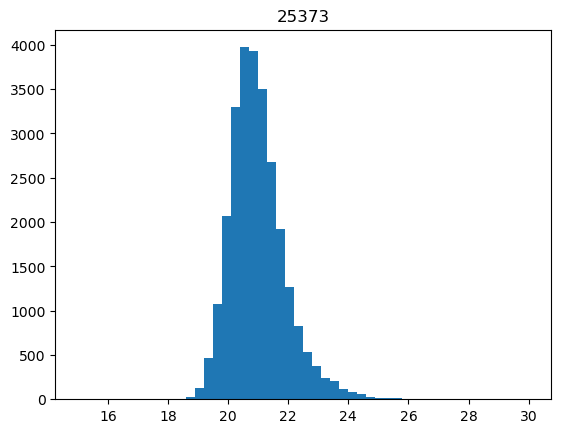

 26%|████████████████████▎                                                          | 277/1075 [00:37<01:41,  7.88it/s]

17301


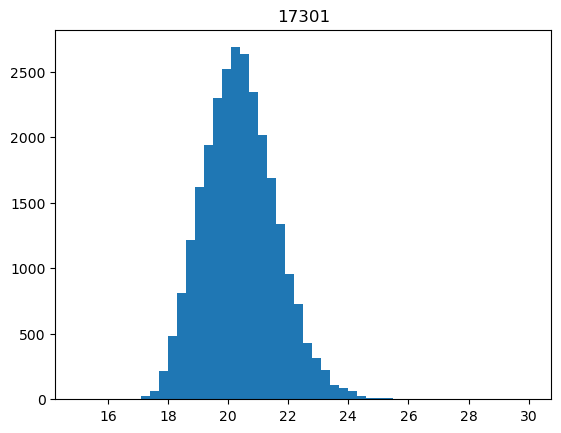

 26%|████████████████████▍                                                          | 278/1075 [00:37<01:40,  7.95it/s]

8186


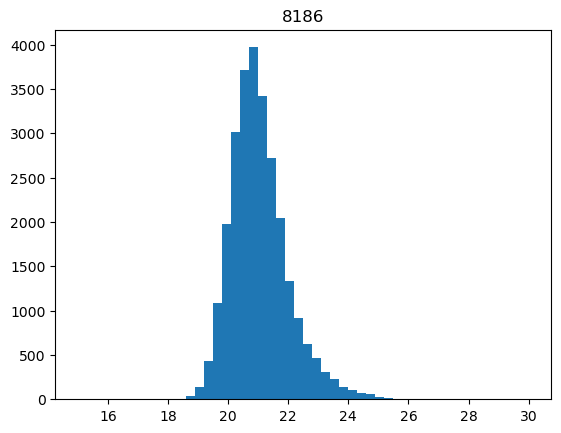

 26%|████████████████████▌                                                          | 279/1075 [00:37<01:40,  7.91it/s]

18655


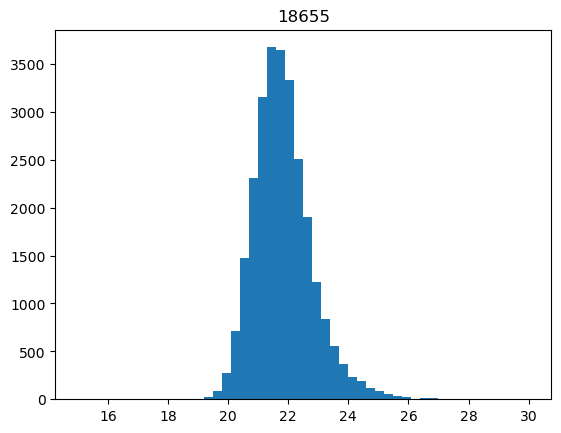

 26%|████████████████████▌                                                          | 280/1075 [00:37<01:39,  7.97it/s]

17913


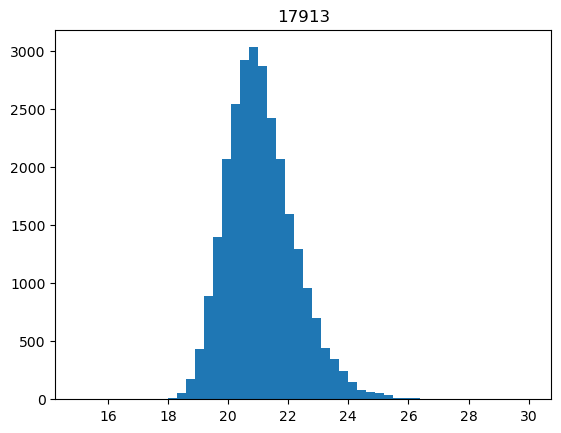

 26%|████████████████████▋                                                          | 281/1075 [00:37<01:59,  6.66it/s]

13701


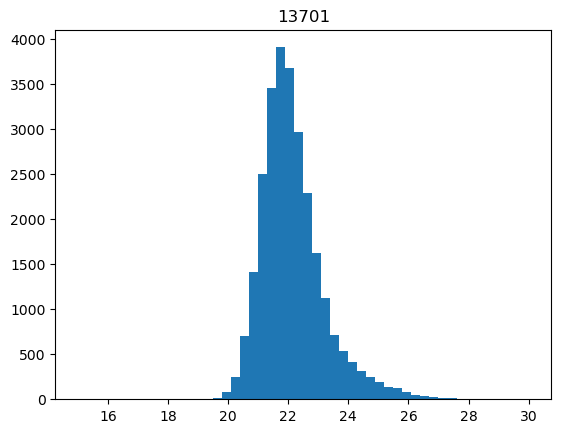

 26%|████████████████████▋                                                          | 282/1075 [00:37<01:53,  6.98it/s]

2813


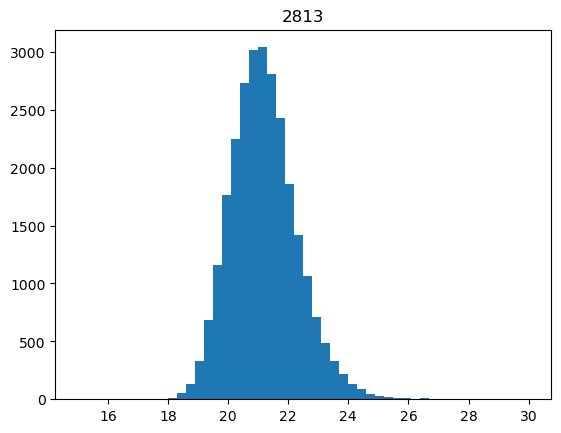

 26%|████████████████████▊                                                          | 283/1075 [00:37<01:49,  7.23it/s]

9305


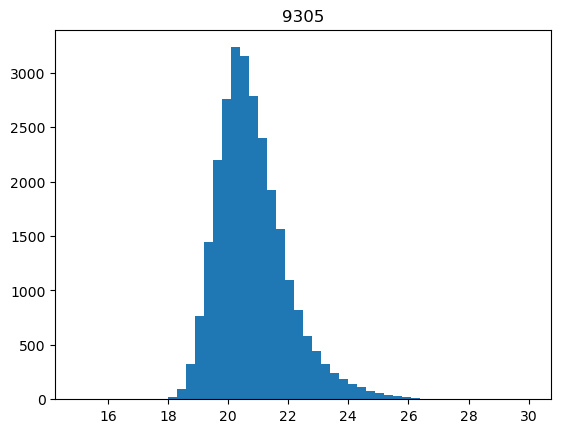

 26%|████████████████████▊                                                          | 284/1075 [00:38<01:46,  7.44it/s]

7368


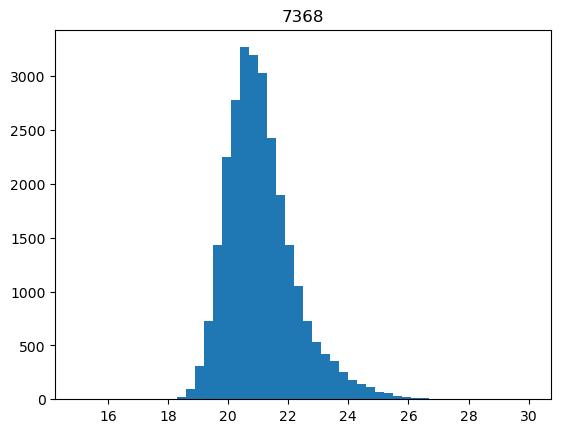

 27%|████████████████████▉                                                          | 285/1075 [00:38<01:43,  7.64it/s]

4968


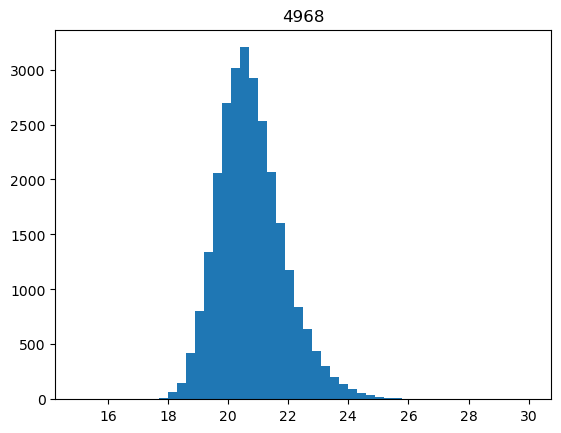

 27%|█████████████████████                                                          | 286/1075 [00:38<01:41,  7.74it/s]

19274


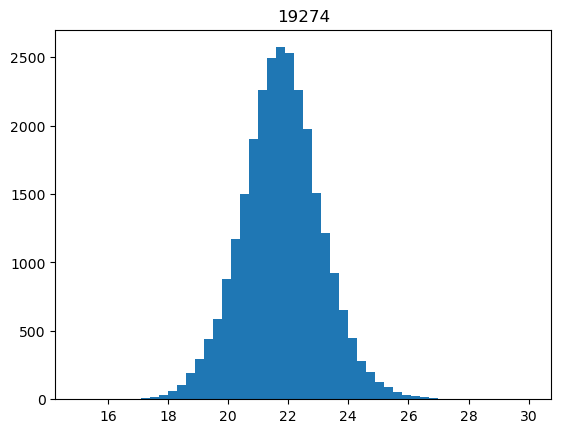

 27%|█████████████████████                                                          | 287/1075 [00:38<01:40,  7.87it/s]

22722


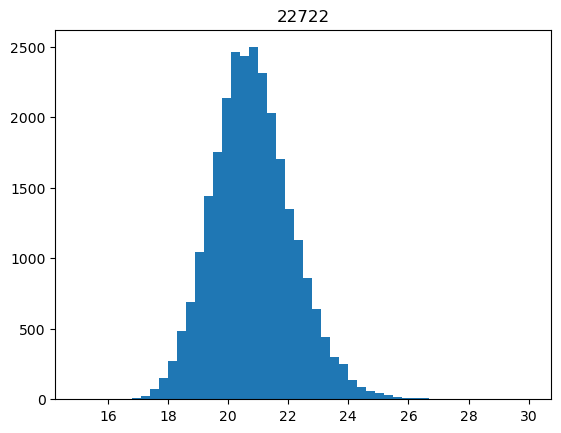

 27%|█████████████████████▏                                                         | 288/1075 [00:38<01:39,  7.95it/s]

26852


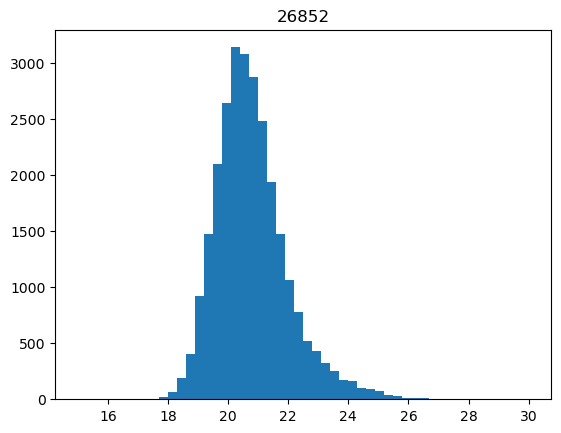

 27%|█████████████████████▏                                                         | 289/1075 [00:38<01:38,  7.98it/s]

20442


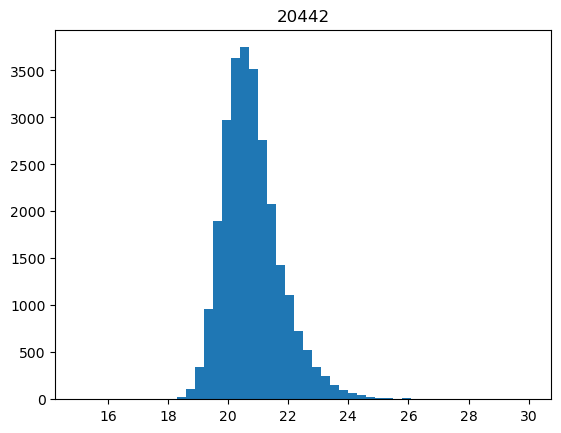

 27%|█████████████████████▎                                                         | 290/1075 [00:38<01:37,  8.04it/s]

20991


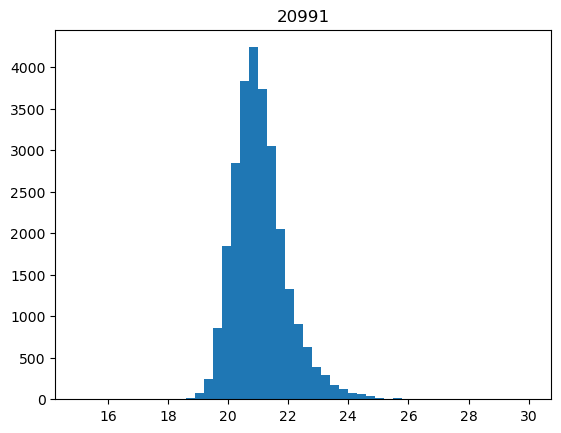

 27%|█████████████████████▍                                                         | 291/1075 [00:38<01:38,  7.97it/s]

20283


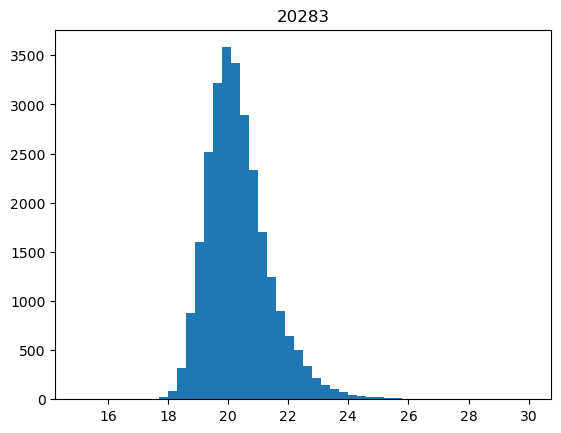

 27%|█████████████████████▍                                                         | 292/1075 [00:39<01:57,  6.67it/s]

8239


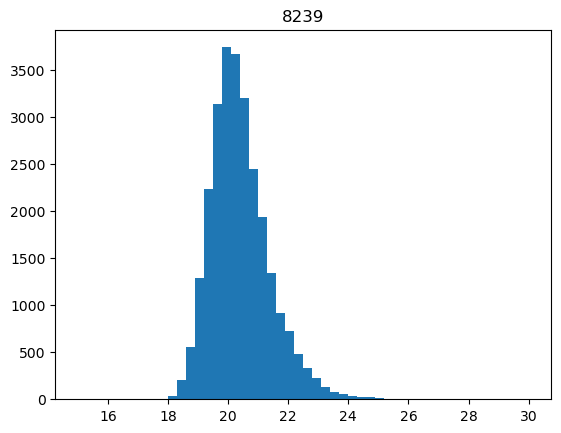

 27%|█████████████████████▌                                                         | 293/1075 [00:39<01:51,  7.03it/s]

3360


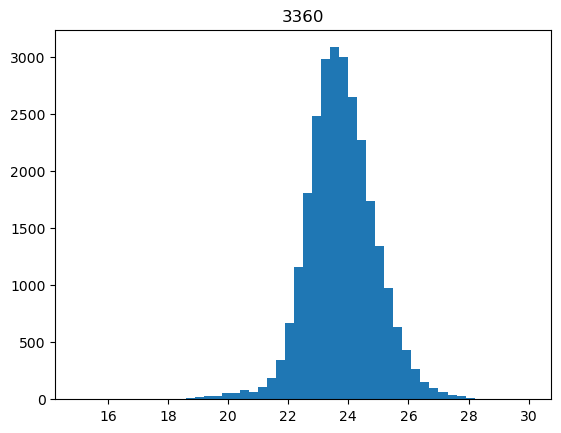

 27%|█████████████████████▌                                                         | 294/1075 [00:39<01:46,  7.31it/s]

18781


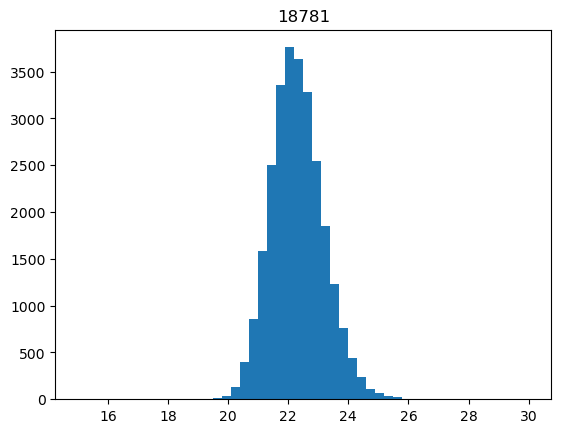

 27%|█████████████████████▋                                                         | 295/1075 [00:39<01:44,  7.46it/s]

18343


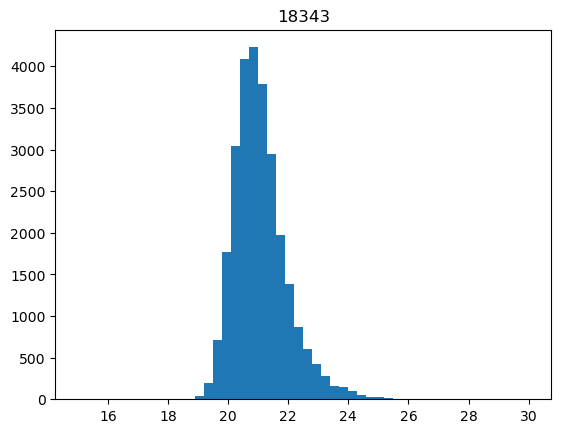

 28%|█████████████████████▊                                                         | 296/1075 [00:39<01:43,  7.56it/s]

24878


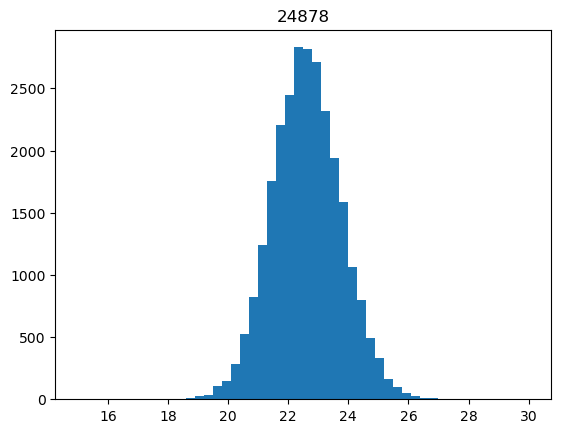

 28%|█████████████████████▊                                                         | 297/1075 [00:39<01:41,  7.69it/s]

10806


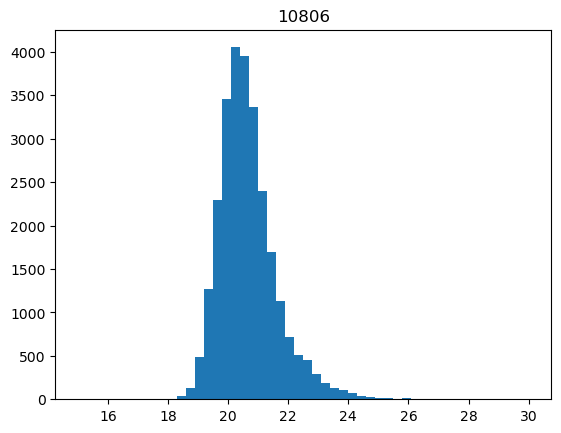

 28%|█████████████████████▉                                                         | 298/1075 [00:39<01:41,  7.69it/s]

11883


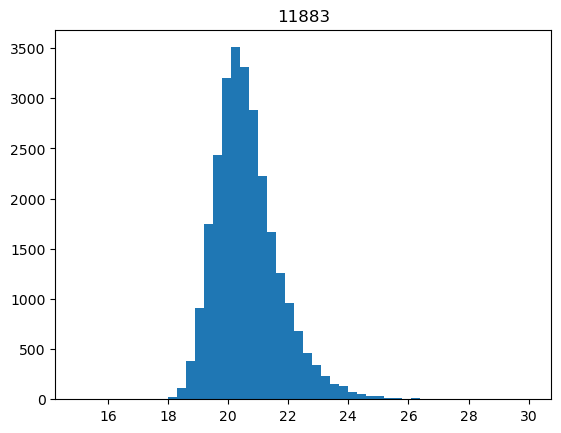

 28%|█████████████████████▉                                                         | 299/1075 [00:40<01:40,  7.71it/s]

4447


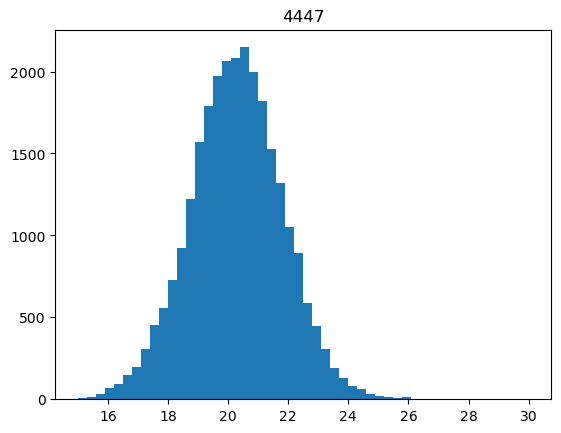

 28%|██████████████████████                                                         | 300/1075 [00:40<01:38,  7.85it/s]

3554


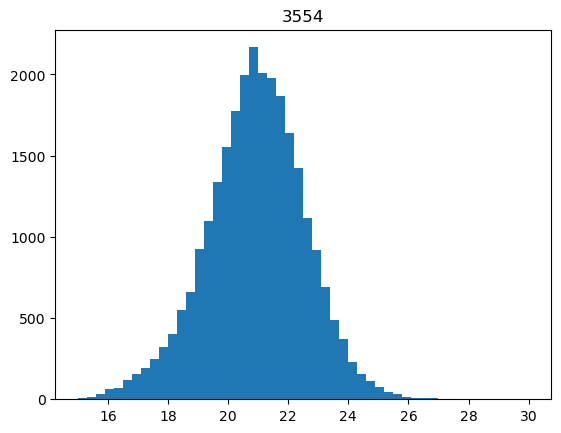

 28%|██████████████████████                                                         | 301/1075 [00:40<01:36,  7.99it/s]

3247


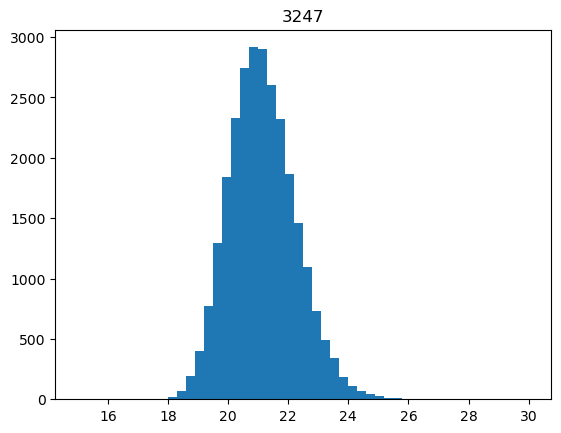

 28%|██████████████████████▏                                                        | 302/1075 [00:40<01:36,  8.01it/s]

25149


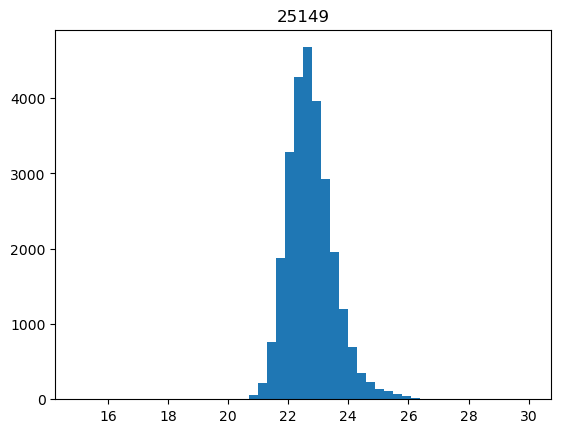

 28%|██████████████████████▎                                                        | 303/1075 [00:40<01:54,  6.74it/s]

24529


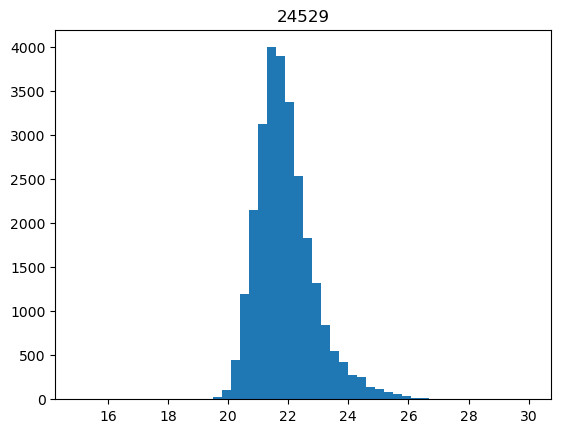

 28%|██████████████████████▎                                                        | 304/1075 [00:40<01:50,  7.00it/s]

5316


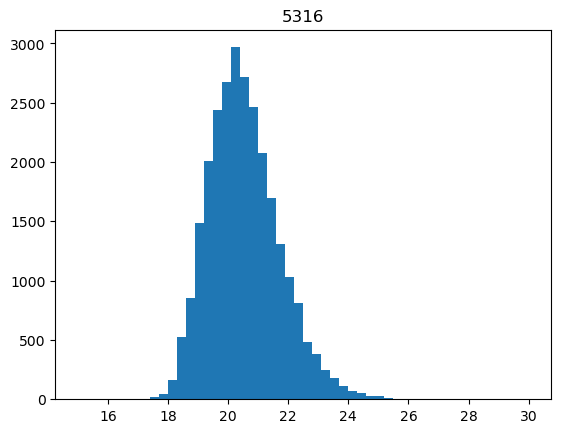

 28%|██████████████████████▍                                                        | 305/1075 [00:40<01:45,  7.29it/s]

19818


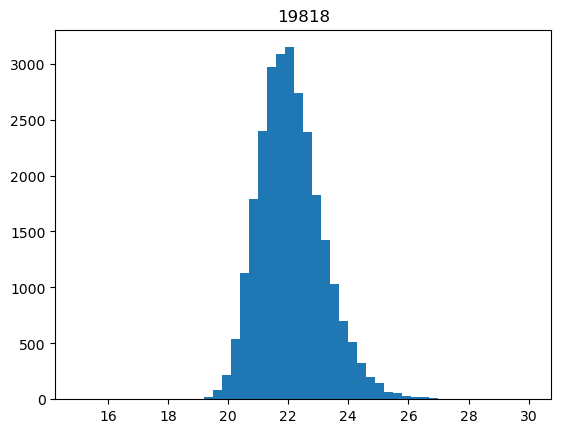

 28%|██████████████████████▍                                                        | 306/1075 [00:40<01:42,  7.52it/s]

1290


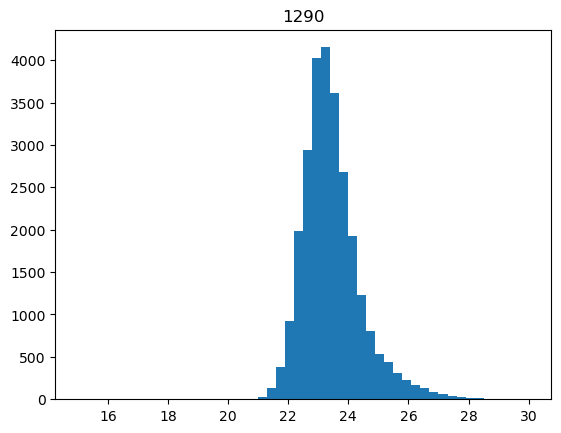

 29%|██████████████████████▌                                                        | 307/1075 [00:41<01:41,  7.59it/s]

25362


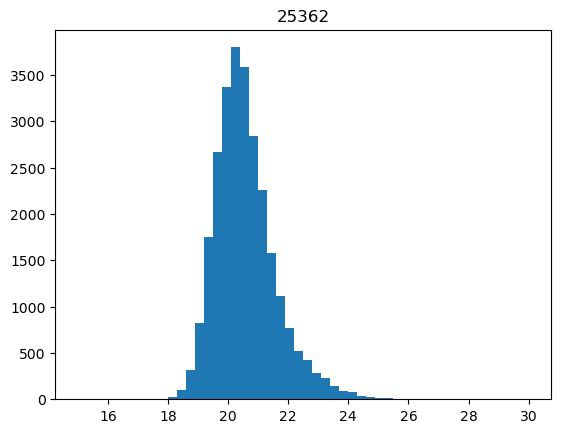

 29%|██████████████████████▋                                                        | 308/1075 [00:41<01:39,  7.69it/s]

15370


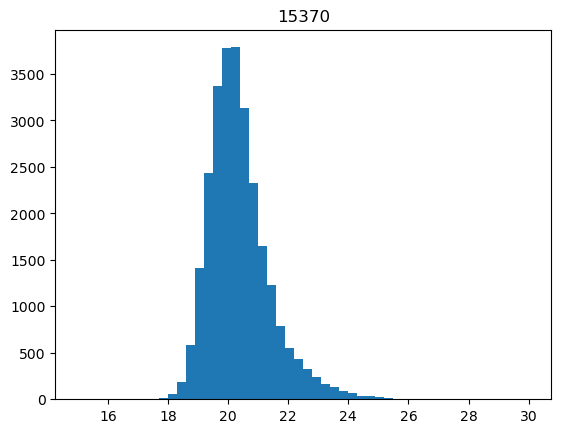

 29%|██████████████████████▋                                                        | 309/1075 [00:41<01:39,  7.73it/s]

15599


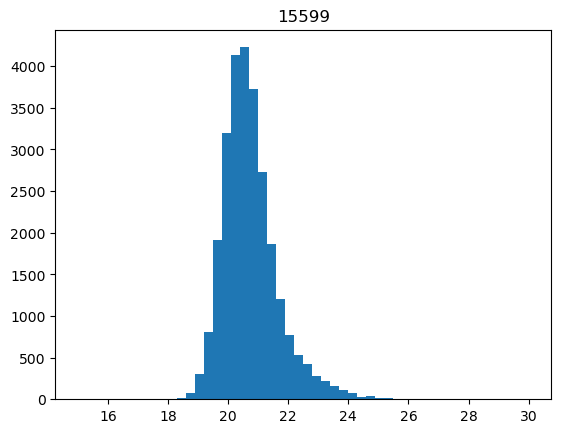

 29%|██████████████████████▊                                                        | 310/1075 [00:41<01:39,  7.70it/s]

13770


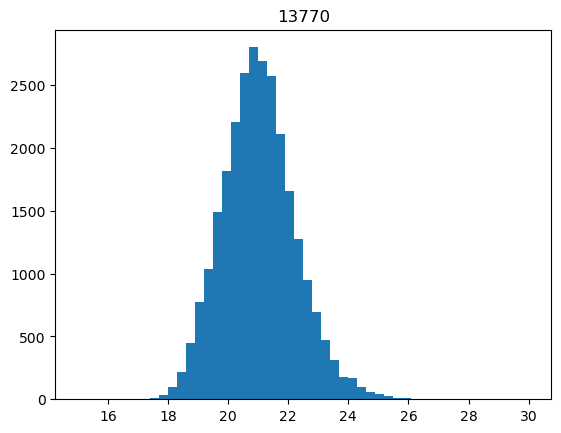

 29%|██████████████████████▊                                                        | 311/1075 [00:41<01:37,  7.86it/s]

18844


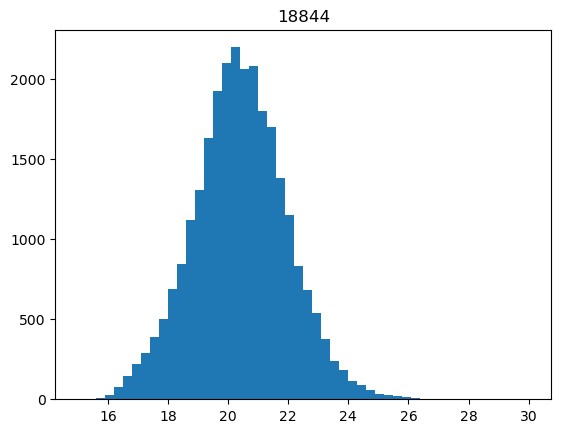

 29%|██████████████████████▉                                                        | 312/1075 [00:41<01:36,  7.92it/s]

23968


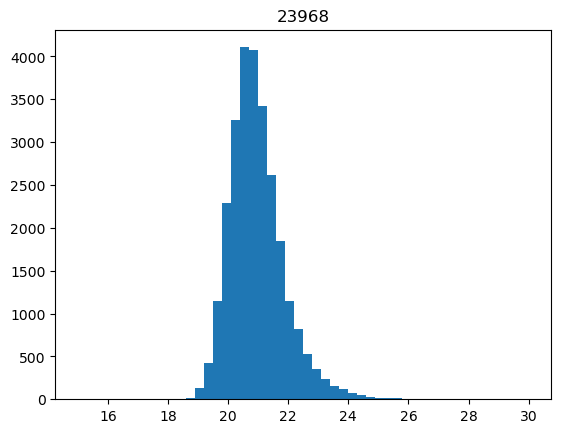

 29%|███████████████████████                                                        | 313/1075 [00:41<01:37,  7.85it/s]

16815


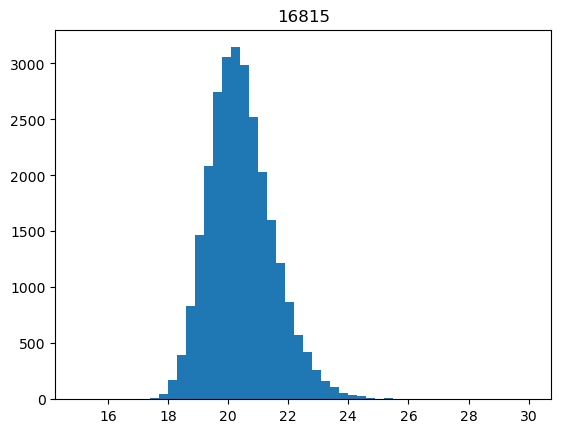

 29%|███████████████████████                                                        | 314/1075 [00:42<01:55,  6.60it/s]

22694


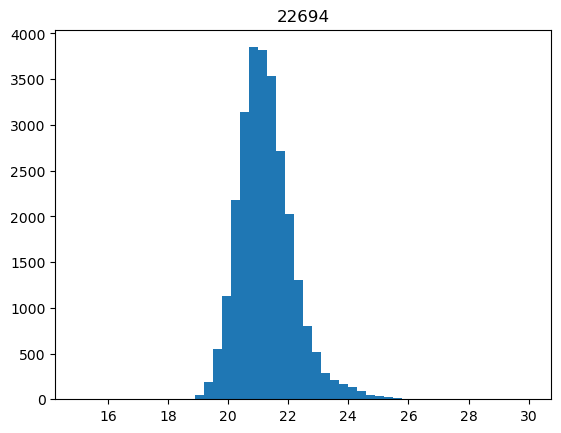

 29%|███████████████████████▏                                                       | 315/1075 [00:42<01:49,  6.96it/s]

7547


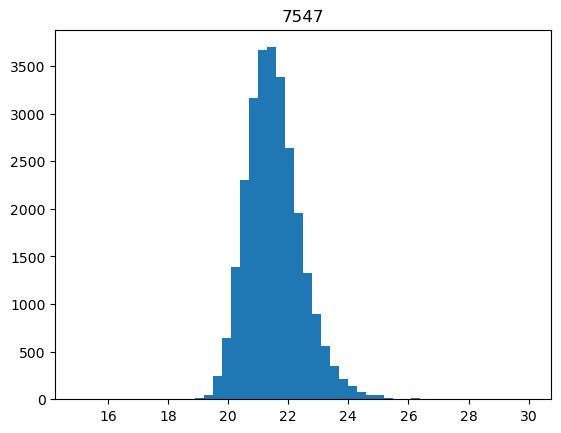

 29%|███████████████████████▏                                                       | 316/1075 [00:42<01:45,  7.23it/s]

12141


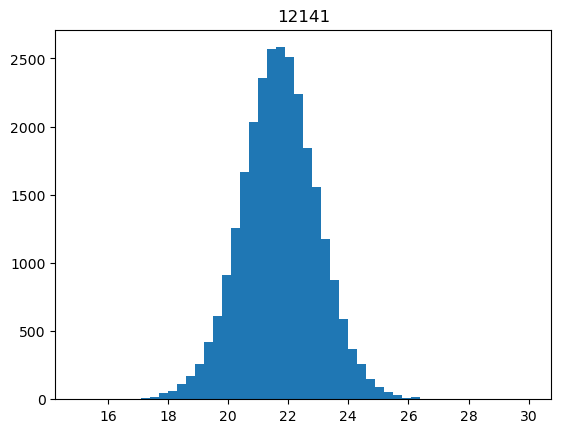

 29%|███████████████████████▎                                                       | 317/1075 [00:42<01:40,  7.51it/s]

18390


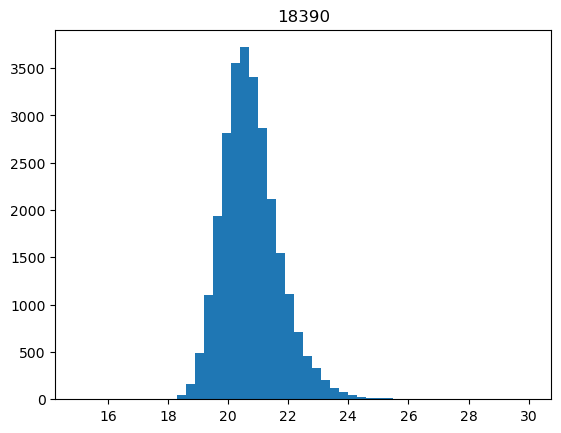

 30%|███████████████████████▎                                                       | 318/1075 [00:42<01:39,  7.63it/s]

12672


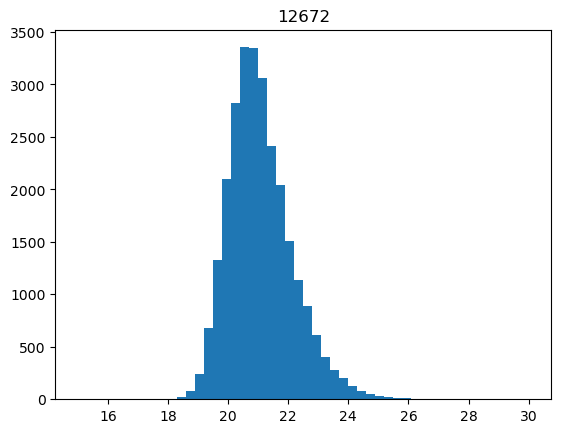

 30%|███████████████████████▍                                                       | 319/1075 [00:42<01:37,  7.72it/s]

22231


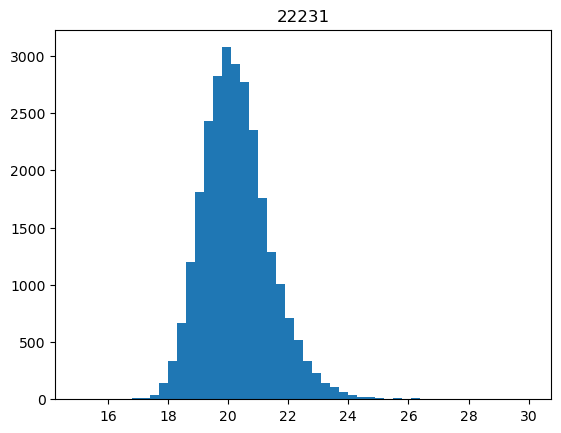

 30%|███████████████████████▌                                                       | 320/1075 [00:42<01:36,  7.82it/s]

3512


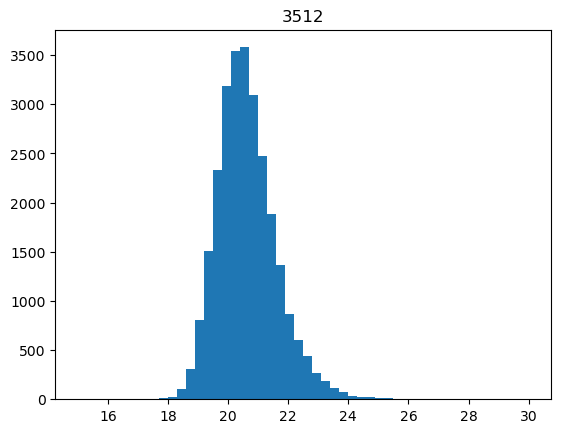

 30%|███████████████████████▌                                                       | 321/1075 [00:42<01:36,  7.80it/s]

13763


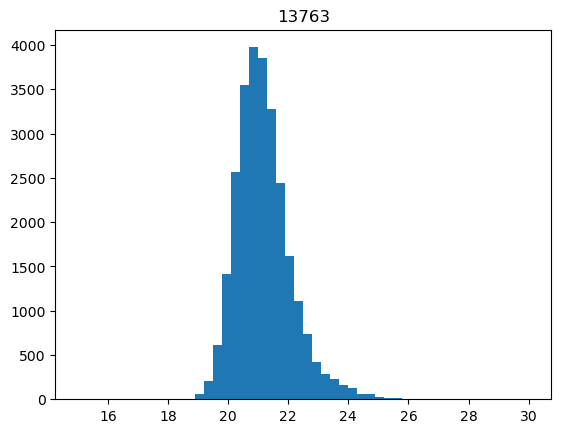

 30%|███████████████████████▋                                                       | 322/1075 [00:43<01:36,  7.80it/s]

11364


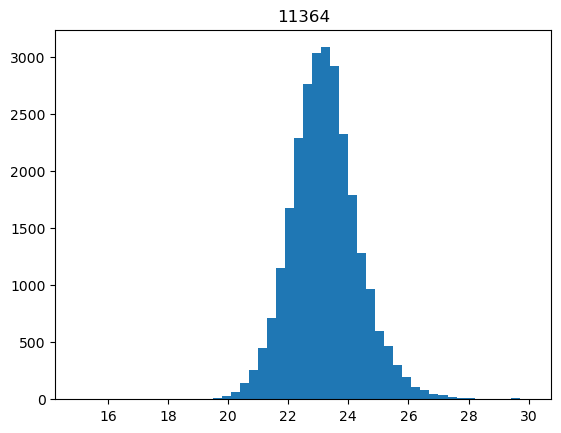

 30%|███████████████████████▋                                                       | 323/1075 [00:43<01:36,  7.82it/s]

5635


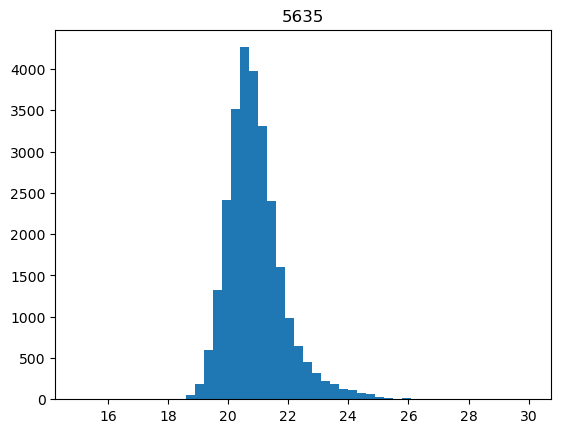

 30%|███████████████████████▊                                                       | 324/1075 [00:43<01:36,  7.78it/s]

17054


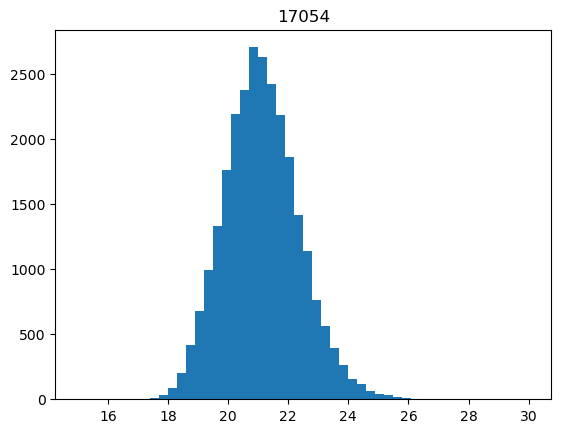

 30%|███████████████████████▉                                                       | 325/1075 [00:43<01:54,  6.56it/s]

13228


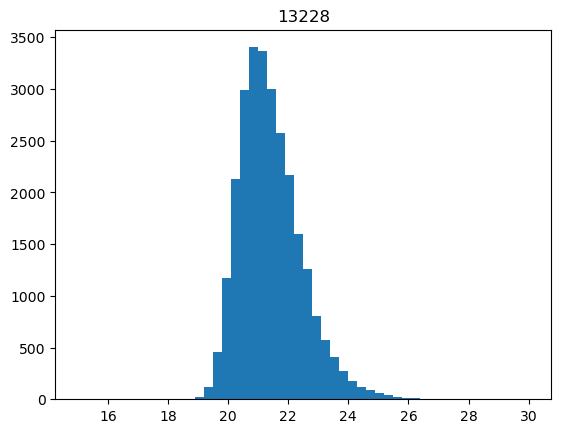

 30%|███████████████████████▉                                                       | 326/1075 [00:43<01:47,  6.94it/s]

17880


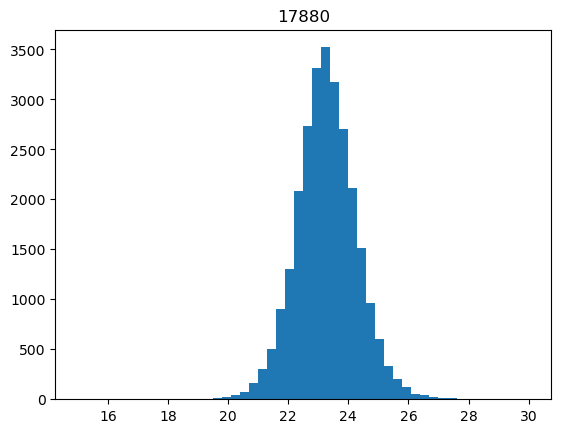

 30%|████████████████████████                                                       | 327/1075 [00:43<01:43,  7.19it/s]

4590


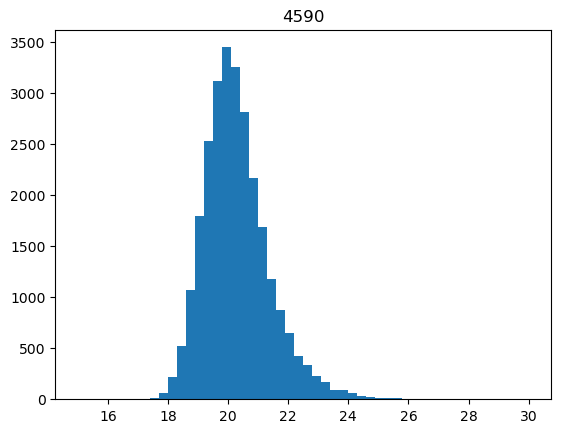

 31%|████████████████████████                                                       | 328/1075 [00:43<01:41,  7.37it/s]

19068


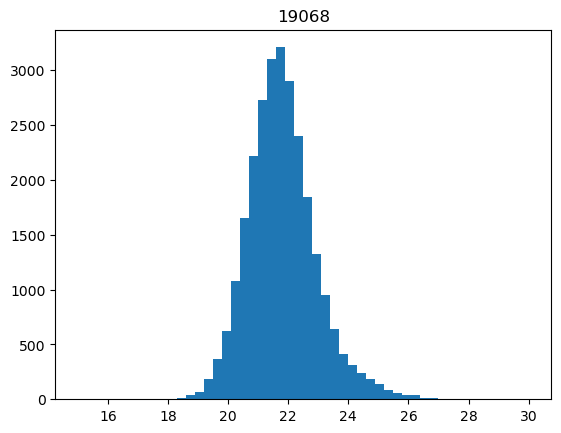

 31%|████████████████████████▏                                                      | 329/1075 [00:44<01:39,  7.51it/s]

1644


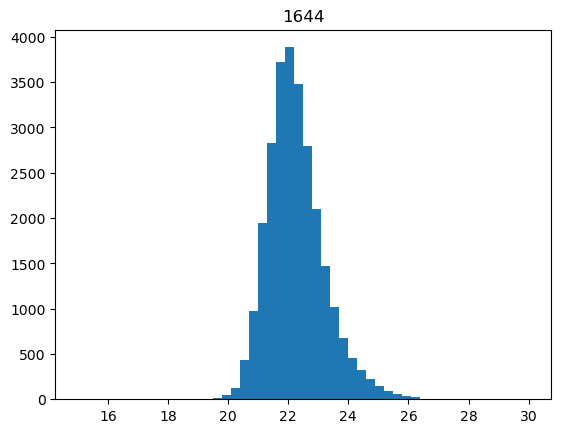

 31%|████████████████████████▎                                                      | 330/1075 [00:44<01:38,  7.56it/s]

25902


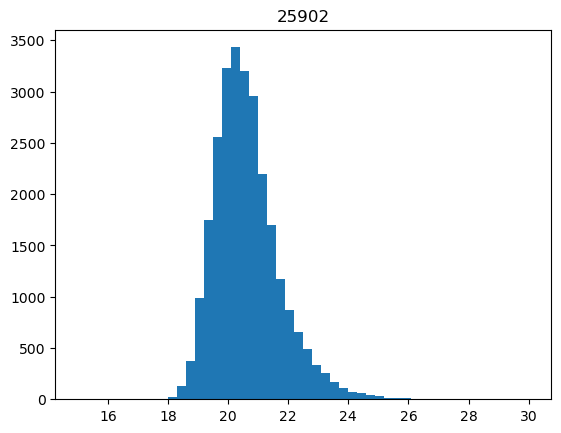

 31%|████████████████████████▎                                                      | 331/1075 [00:44<01:36,  7.69it/s]

148


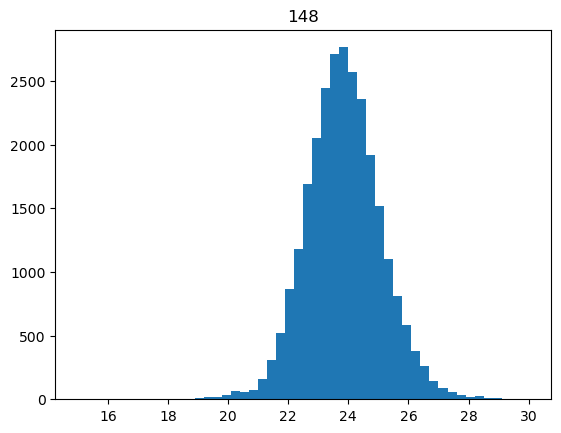

 31%|████████████████████████▍                                                      | 332/1075 [00:44<01:35,  7.78it/s]

21965


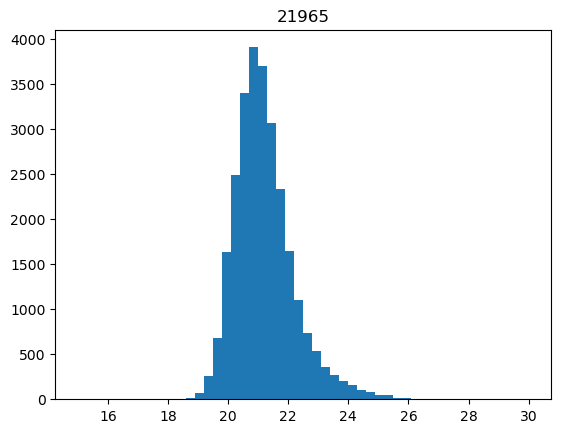

 31%|████████████████████████▍                                                      | 333/1075 [00:44<01:36,  7.70it/s]

8522


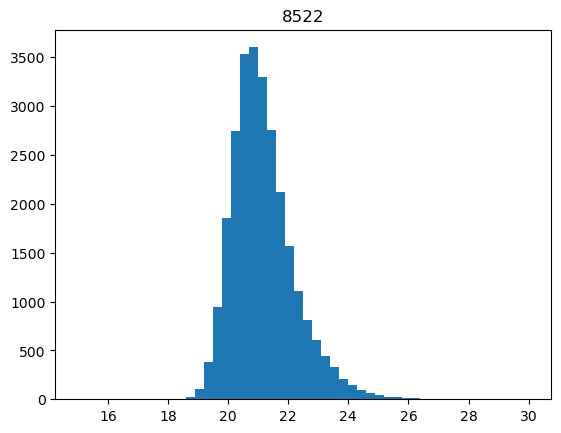

 31%|████████████████████████▌                                                      | 334/1075 [00:44<01:35,  7.73it/s]

24936


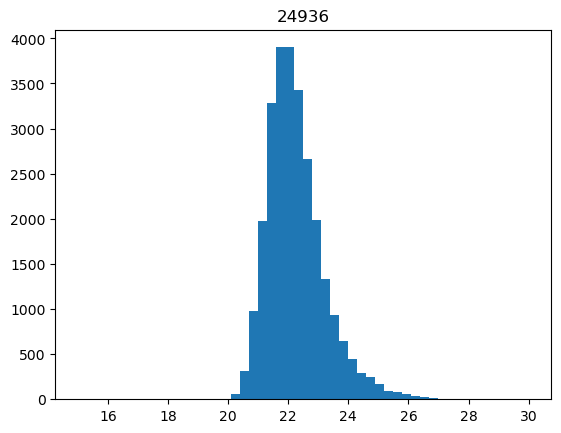

 31%|████████████████████████▌                                                      | 335/1075 [00:44<01:35,  7.74it/s]

7784


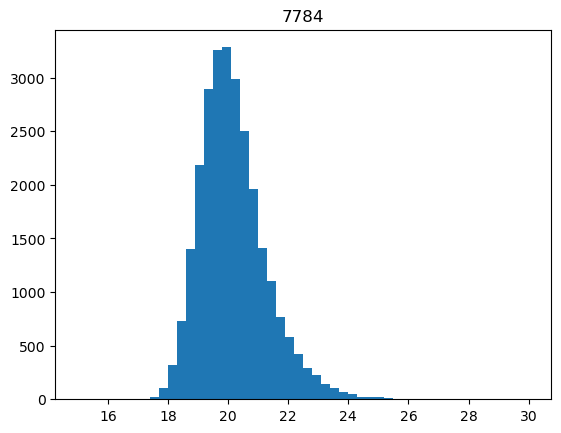

 31%|████████████████████████▋                                                      | 336/1075 [00:45<01:52,  6.57it/s]

4079


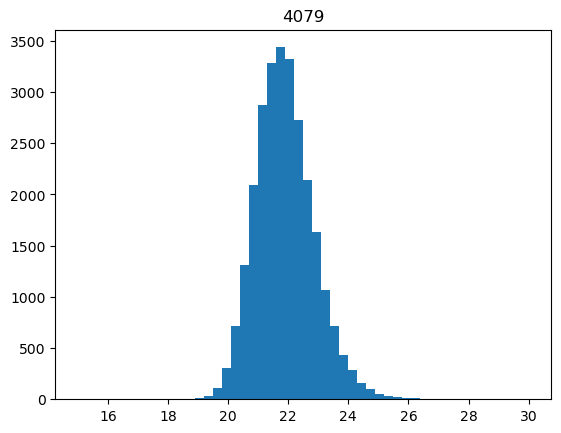

 31%|████████████████████████▊                                                      | 337/1075 [00:45<01:46,  6.91it/s]

15775


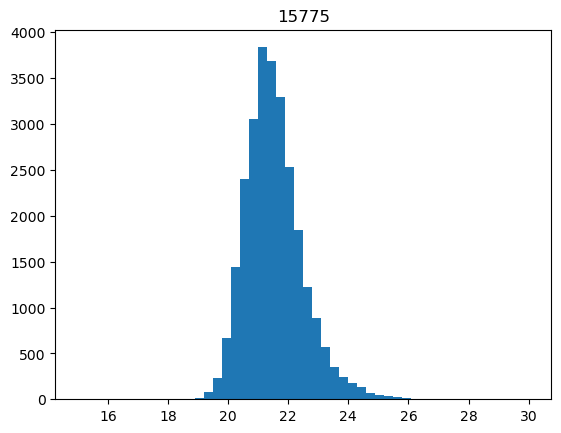

 31%|████████████████████████▊                                                      | 338/1075 [00:45<01:43,  7.13it/s]

9894


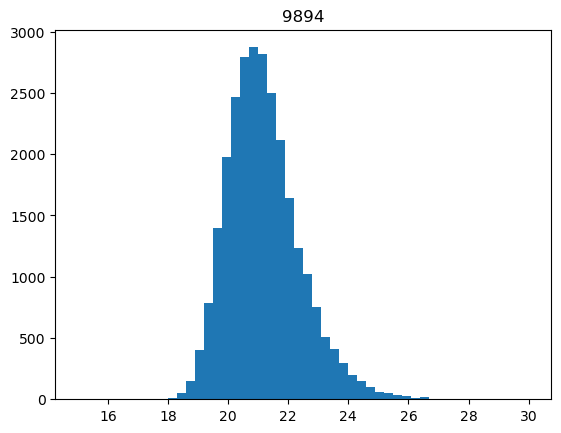

 32%|████████████████████████▉                                                      | 339/1075 [00:45<01:39,  7.37it/s]

26331


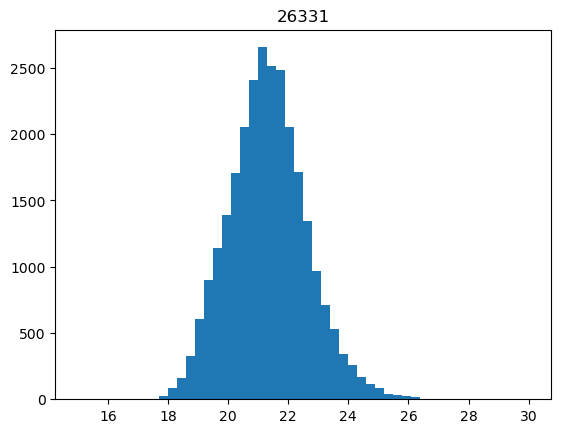

 32%|████████████████████████▉                                                      | 340/1075 [00:45<01:37,  7.56it/s]

4722


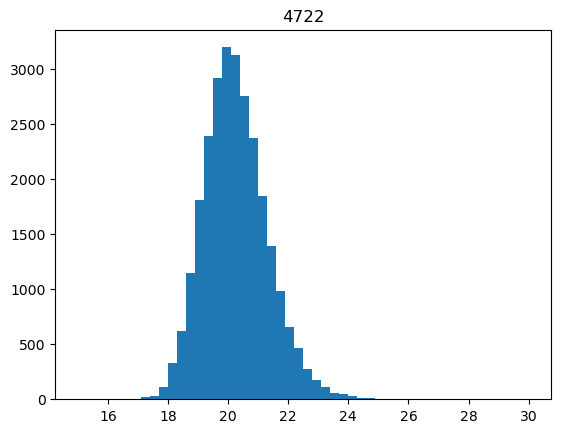

 32%|█████████████████████████                                                      | 341/1075 [00:45<01:35,  7.71it/s]

10018


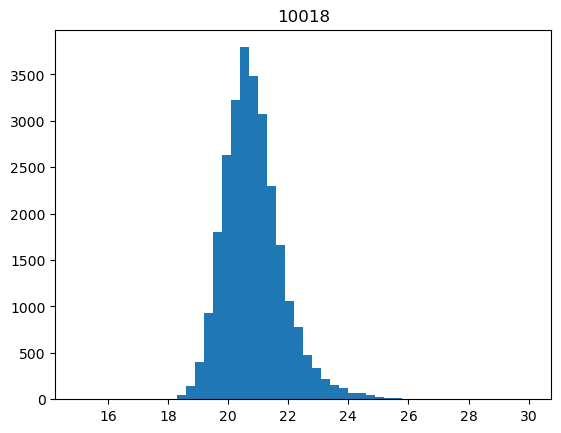

 32%|█████████████████████████▏                                                     | 342/1075 [00:45<01:34,  7.77it/s]

26708


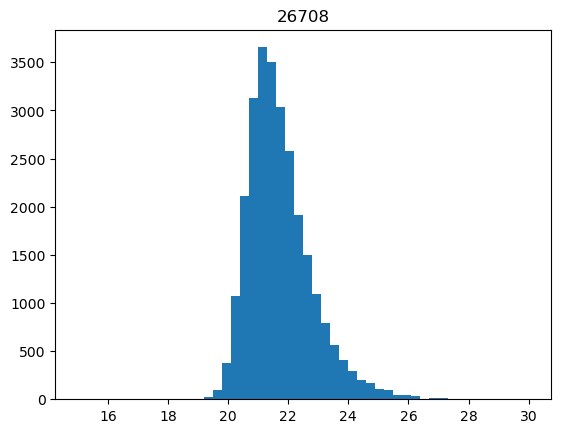

 32%|█████████████████████████▏                                                     | 343/1075 [00:45<01:33,  7.80it/s]

8622


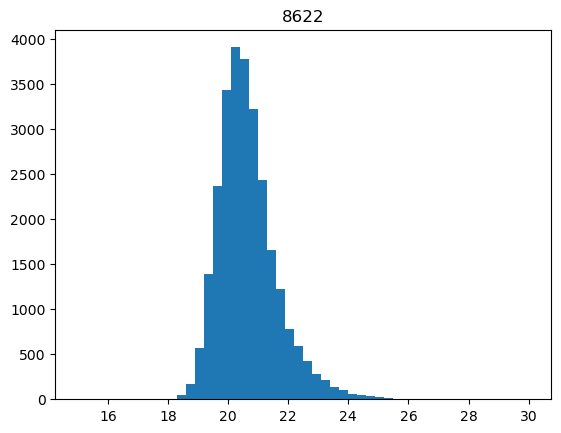

 32%|█████████████████████████▎                                                     | 344/1075 [00:46<01:33,  7.79it/s]

21327


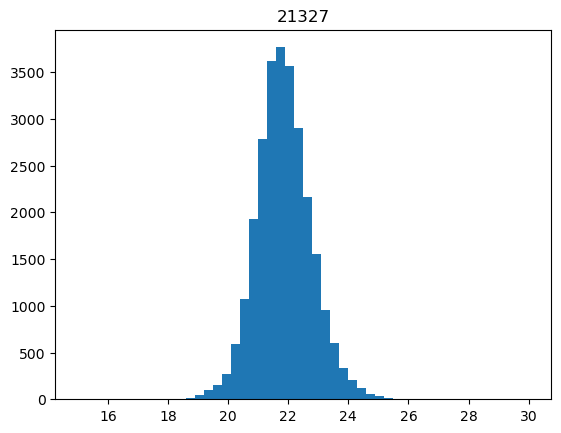

 32%|█████████████████████████▎                                                     | 345/1075 [00:46<01:33,  7.79it/s]

23488


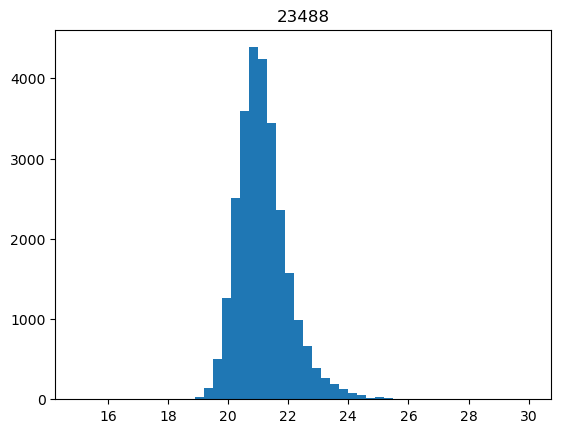

 32%|█████████████████████████▍                                                     | 346/1075 [00:46<01:31,  7.97it/s]

19395


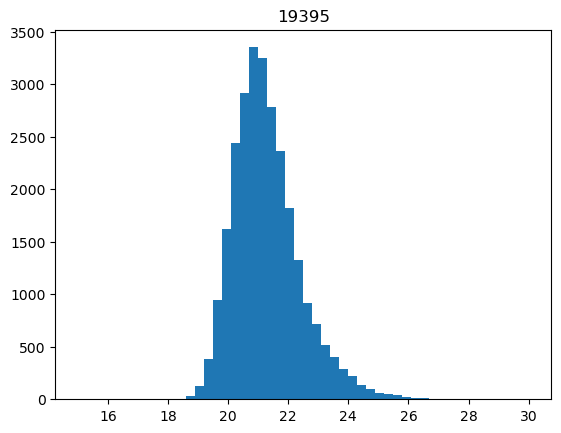

 32%|█████████████████████████▌                                                     | 347/1075 [00:46<01:49,  6.65it/s]

21464


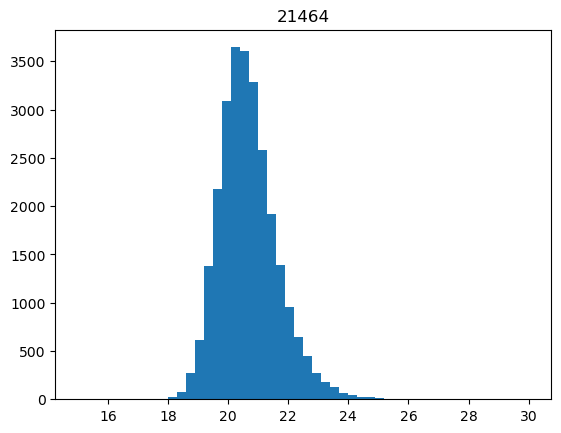

 32%|█████████████████████████▌                                                     | 348/1075 [00:46<01:43,  6.99it/s]

3197


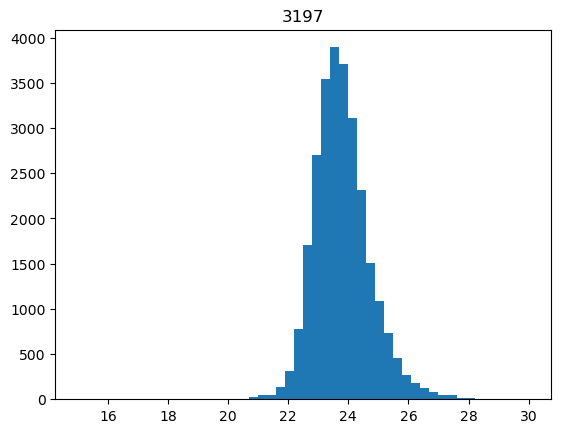

 32%|█████████████████████████▋                                                     | 349/1075 [00:46<01:40,  7.22it/s]

16445


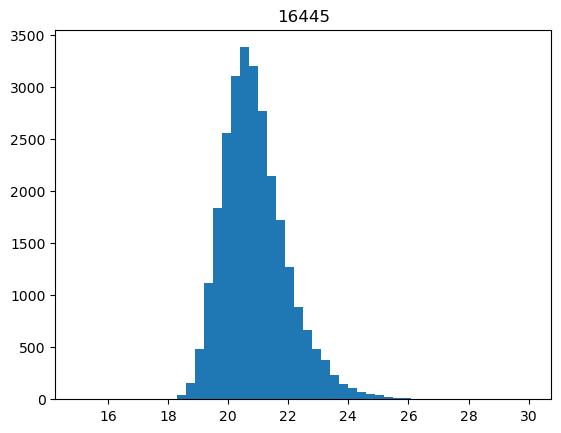

 33%|█████████████████████████▋                                                     | 350/1075 [00:46<01:37,  7.40it/s]

6688


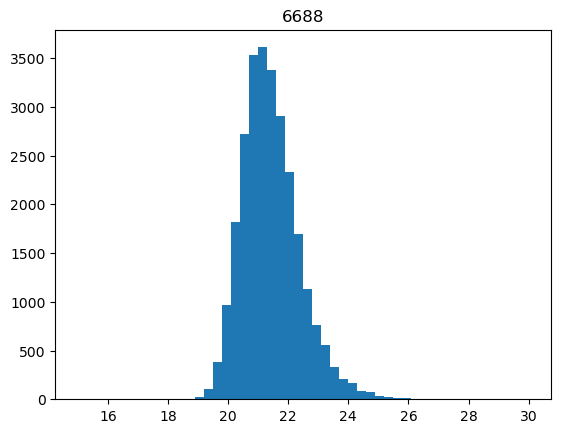

 33%|█████████████████████████▊                                                     | 351/1075 [00:47<01:36,  7.52it/s]

21490


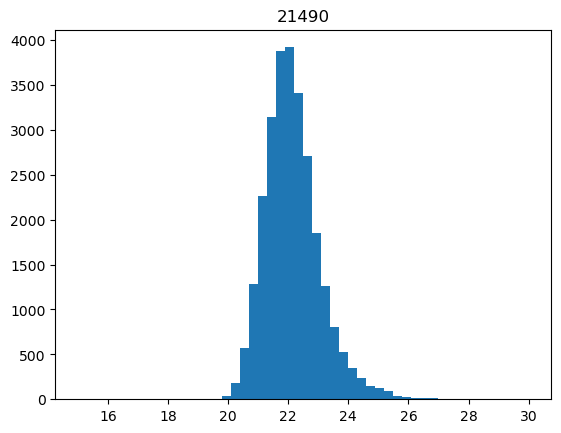

 33%|█████████████████████████▊                                                     | 352/1075 [00:47<01:35,  7.57it/s]

19822


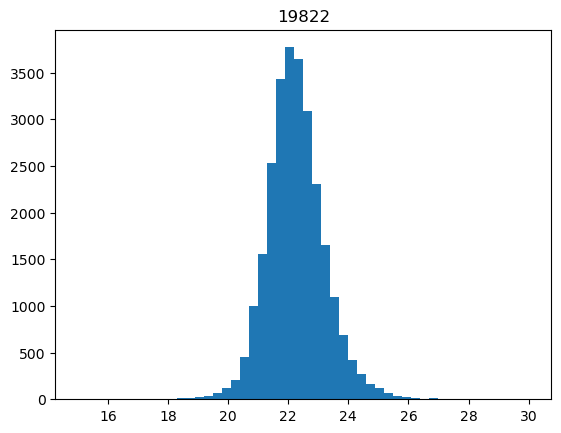

 33%|█████████████████████████▉                                                     | 353/1075 [00:47<01:34,  7.66it/s]

4628


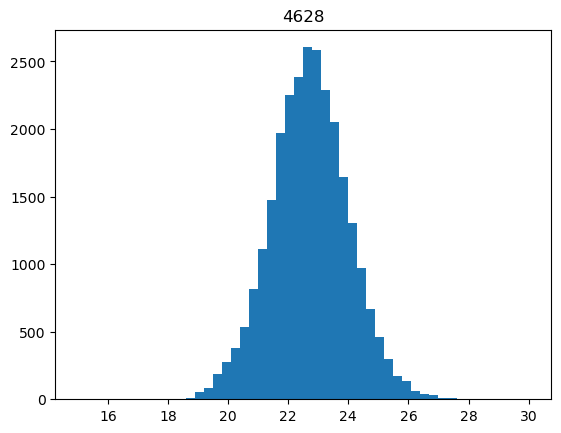

 33%|██████████████████████████                                                     | 354/1075 [00:47<01:32,  7.78it/s]

18306


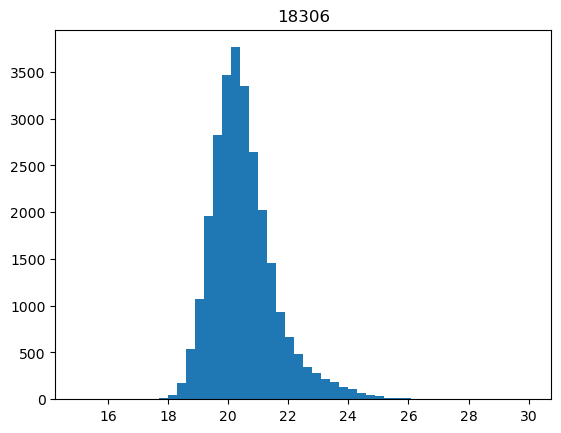

 33%|██████████████████████████                                                     | 355/1075 [00:47<01:31,  7.84it/s]

26870


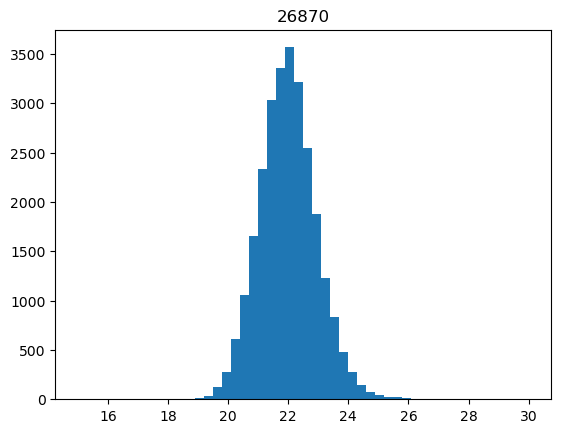

 33%|██████████████████████████▏                                                    | 356/1075 [00:47<01:31,  7.87it/s]

23128


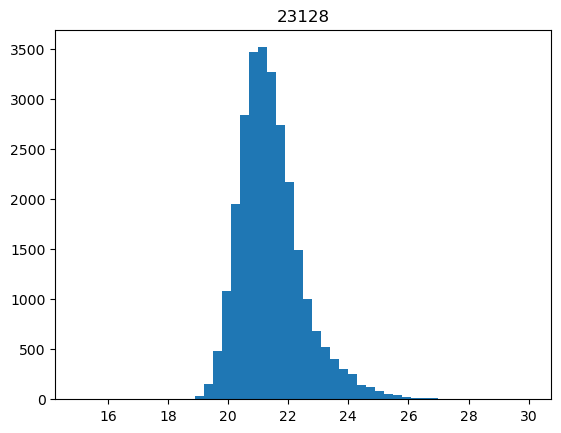

 33%|██████████████████████████▏                                                    | 357/1075 [00:47<01:30,  7.91it/s]

1179


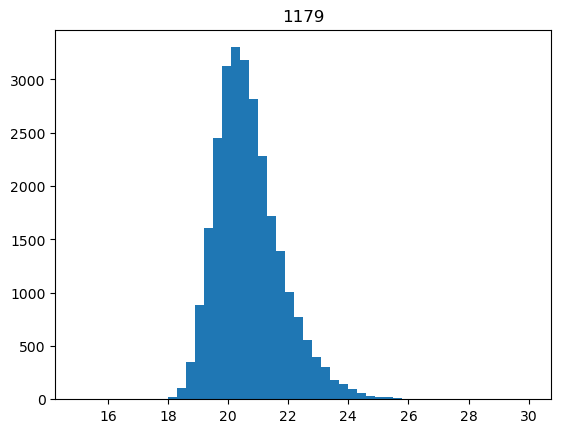

 33%|██████████████████████████▎                                                    | 358/1075 [00:47<01:48,  6.64it/s]

22155


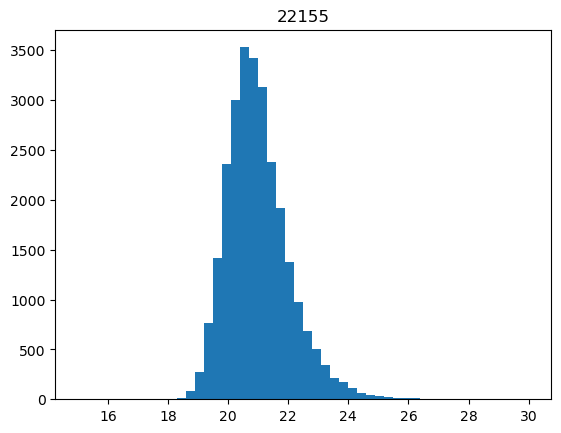

 33%|██████████████████████████▍                                                    | 359/1075 [00:48<01:42,  7.01it/s]

26186


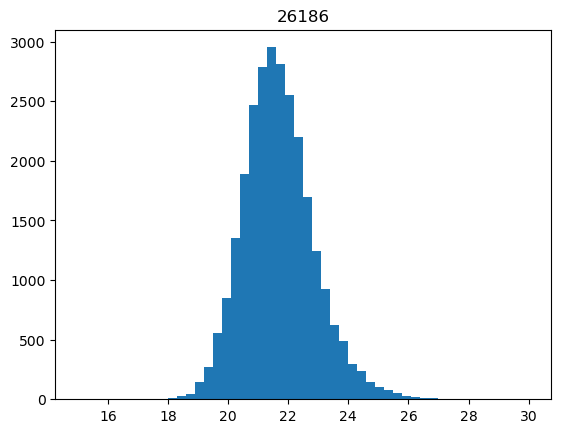

 33%|██████████████████████████▍                                                    | 360/1075 [00:48<01:38,  7.28it/s]

16592


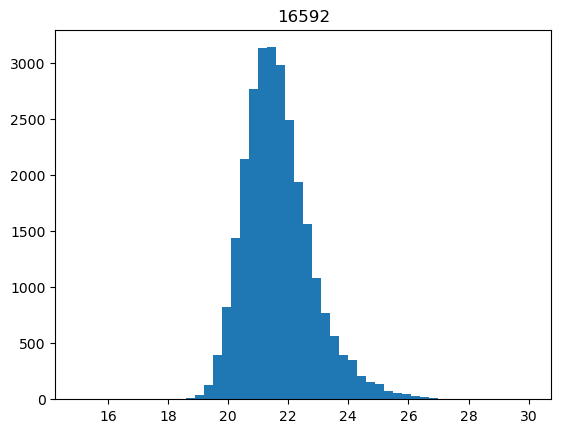

 34%|██████████████████████████▌                                                    | 361/1075 [00:48<01:35,  7.48it/s]

1219


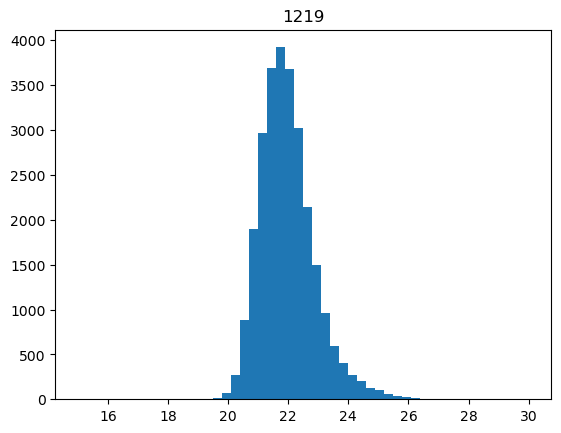

 34%|██████████████████████████▌                                                    | 362/1075 [00:48<01:33,  7.59it/s]

23880


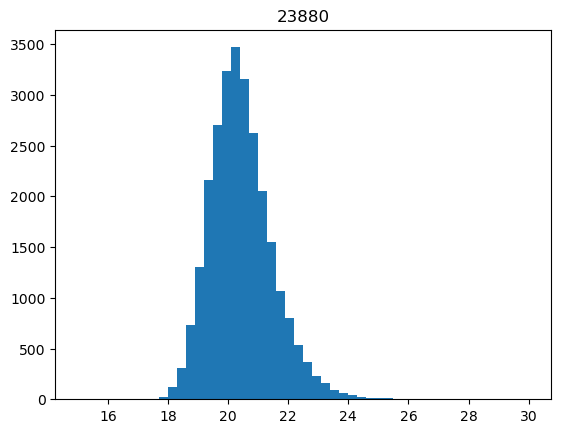

 34%|██████████████████████████▋                                                    | 363/1075 [00:48<01:32,  7.69it/s]

26545


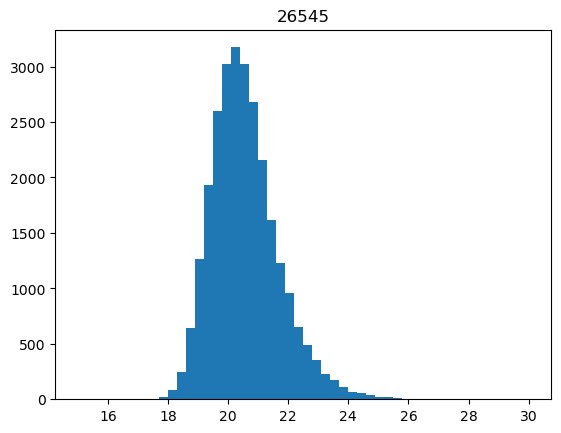

 34%|██████████████████████████▋                                                    | 364/1075 [00:48<01:31,  7.76it/s]

12232


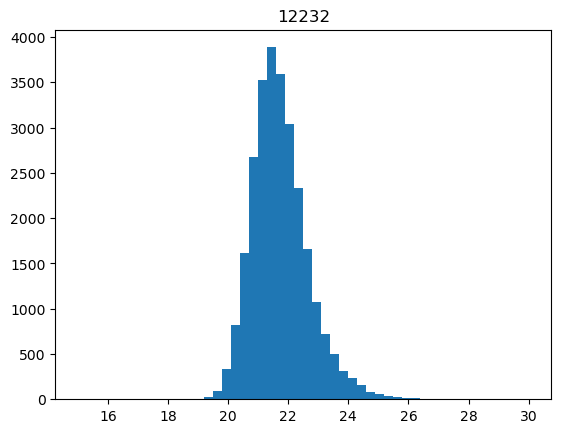

 34%|██████████████████████████▊                                                    | 365/1075 [00:48<01:31,  7.80it/s]

17801


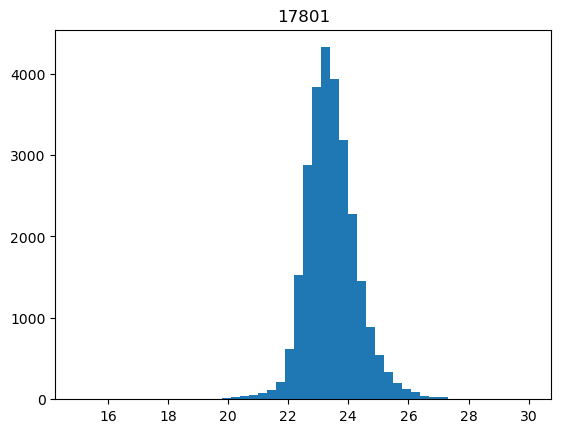

 34%|██████████████████████████▉                                                    | 366/1075 [00:48<01:29,  7.93it/s]

17151


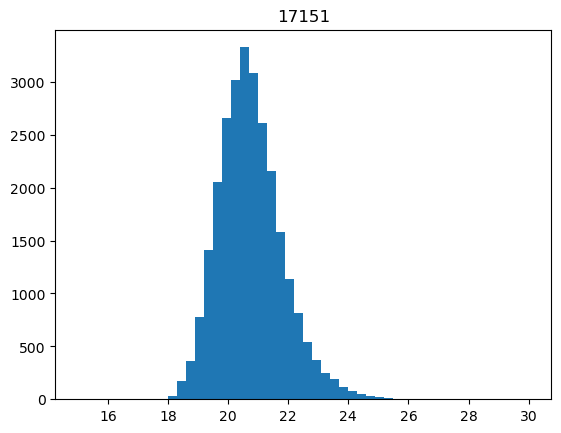

 34%|██████████████████████████▉                                                    | 367/1075 [00:49<01:28,  7.97it/s]

11616


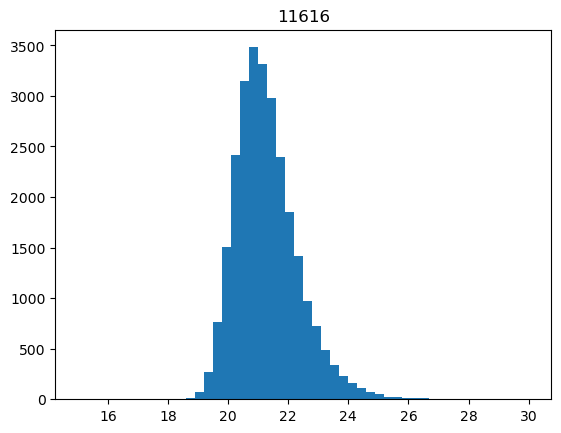

 34%|███████████████████████████                                                    | 368/1075 [00:49<01:28,  7.98it/s]

3009


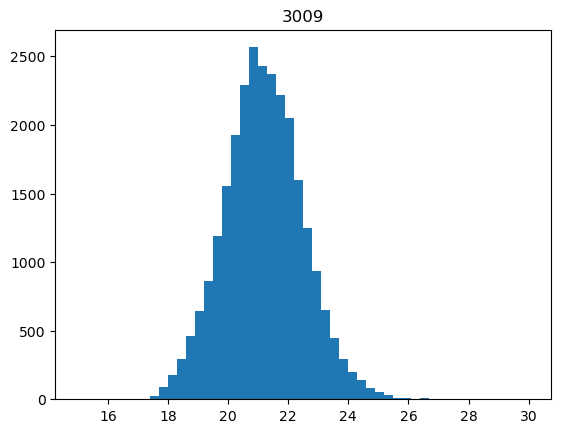

 34%|███████████████████████████                                                    | 369/1075 [00:49<01:47,  6.58it/s]

17142


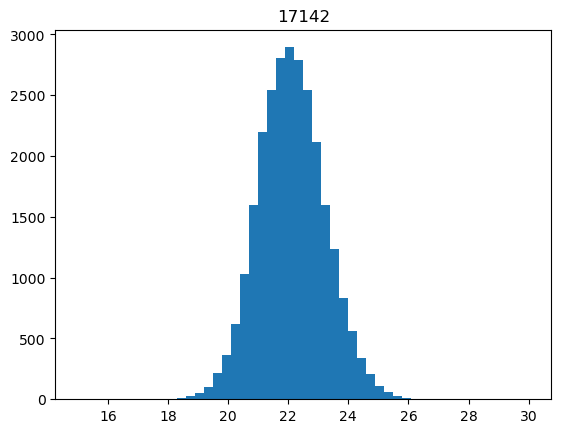

 34%|███████████████████████████▏                                                   | 370/1075 [00:49<01:40,  7.01it/s]

25483


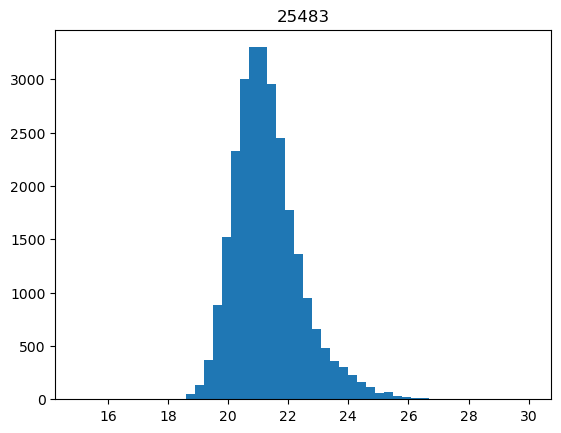

 35%|███████████████████████████▎                                                   | 371/1075 [00:49<01:37,  7.25it/s]

26520


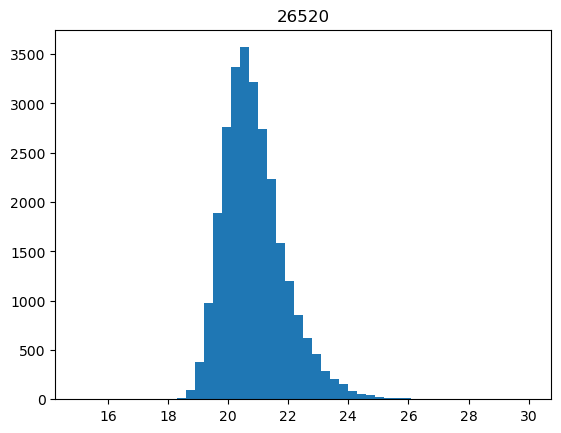

 35%|███████████████████████████▎                                                   | 372/1075 [00:49<01:34,  7.44it/s]

22737


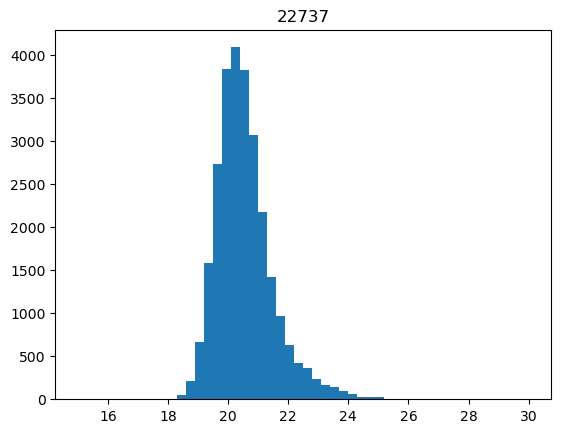

 35%|███████████████████████████▍                                                   | 373/1075 [00:49<01:32,  7.57it/s]

25584


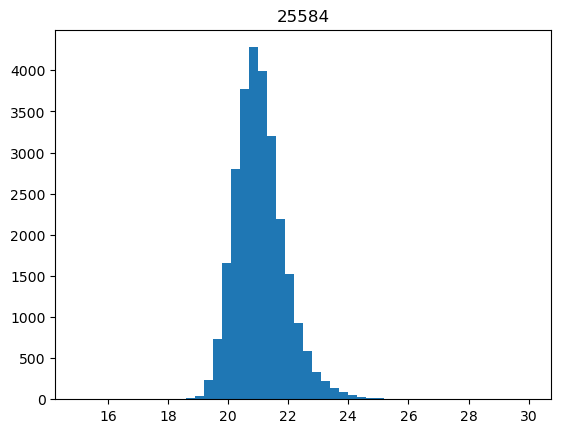

 35%|███████████████████████████▍                                                   | 374/1075 [00:50<01:32,  7.60it/s]

22139


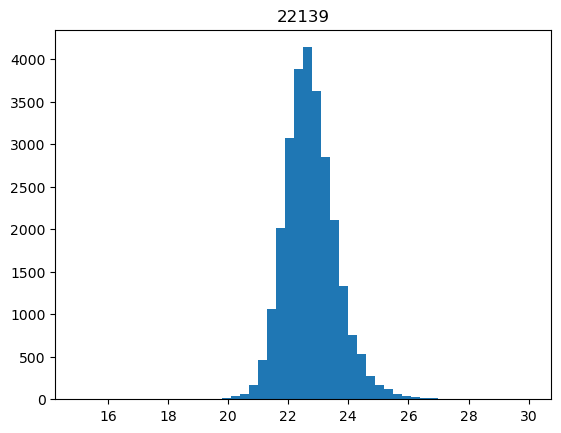

 35%|███████████████████████████▌                                                   | 375/1075 [00:50<01:31,  7.65it/s]

1771


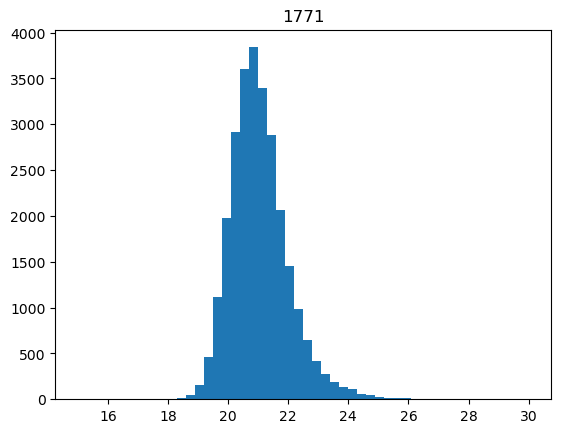

 35%|███████████████████████████▋                                                   | 376/1075 [00:50<01:31,  7.66it/s]

13725


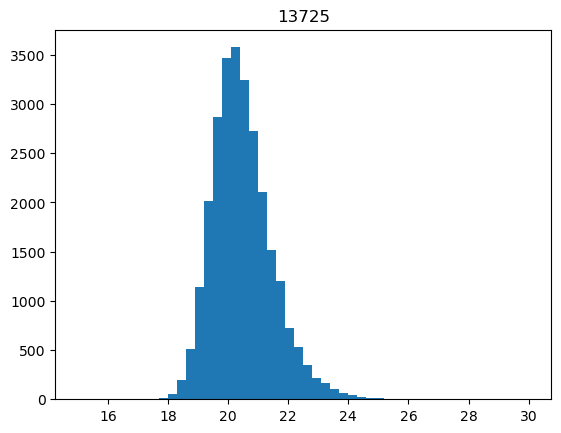

 35%|███████████████████████████▋                                                   | 377/1075 [00:50<01:30,  7.74it/s]

20977


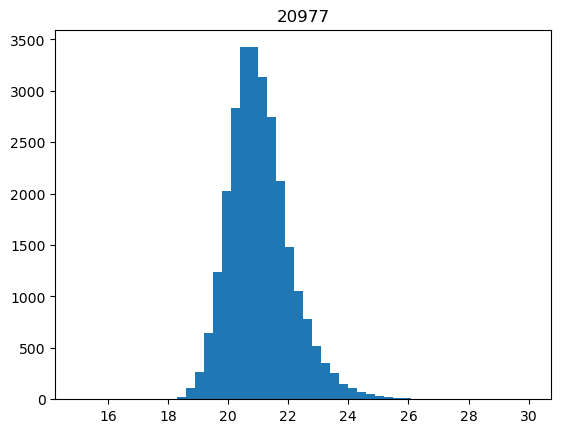

 35%|███████████████████████████▊                                                   | 378/1075 [00:50<01:29,  7.80it/s]

23888


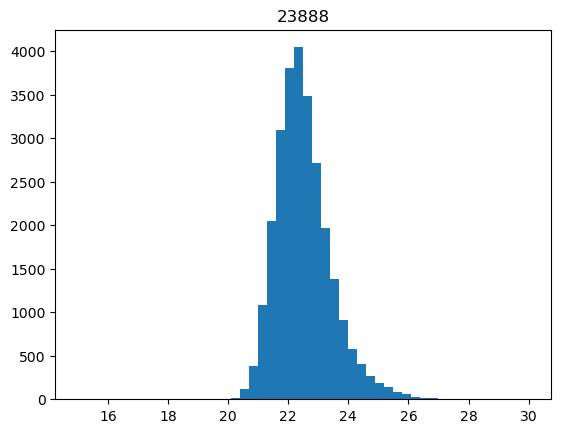

 35%|███████████████████████████▊                                                   | 379/1075 [00:50<01:29,  7.77it/s]

3814


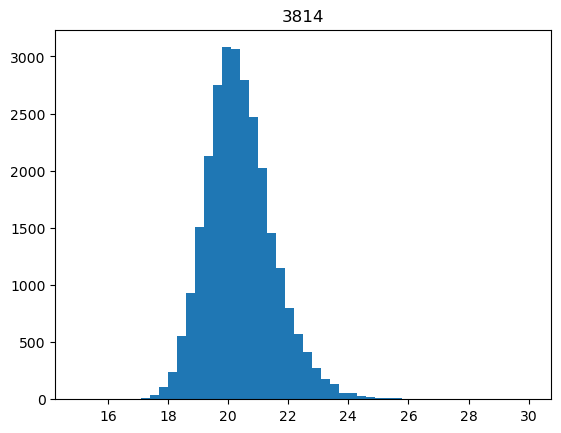

 35%|███████████████████████████▉                                                   | 380/1075 [00:50<01:47,  6.48it/s]

329


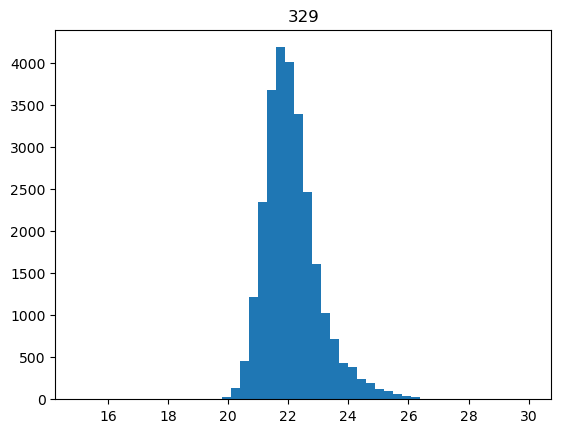

 35%|███████████████████████████▉                                                   | 381/1075 [00:51<01:41,  6.83it/s]

25290


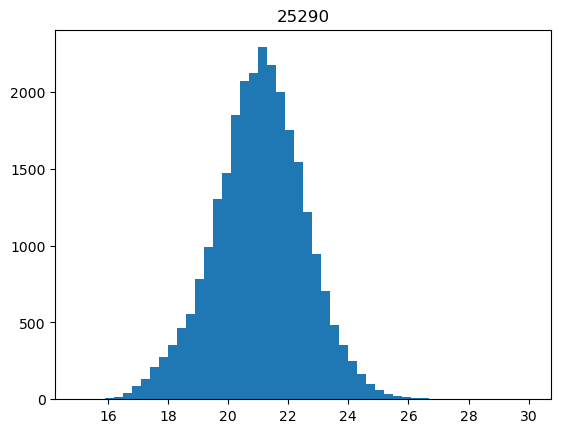

 36%|████████████████████████████                                                   | 382/1075 [00:51<01:36,  7.19it/s]

22228


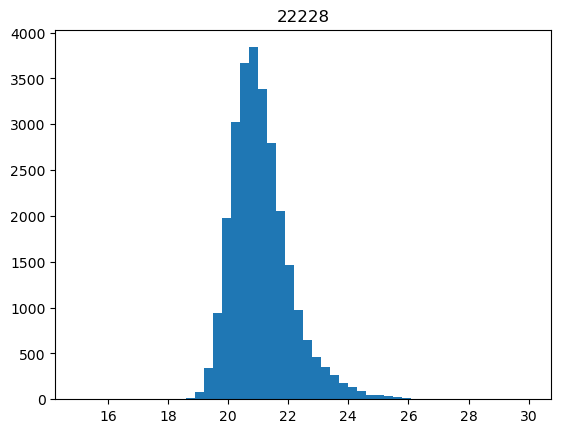

 36%|████████████████████████████▏                                                  | 383/1075 [00:51<01:33,  7.40it/s]

10855


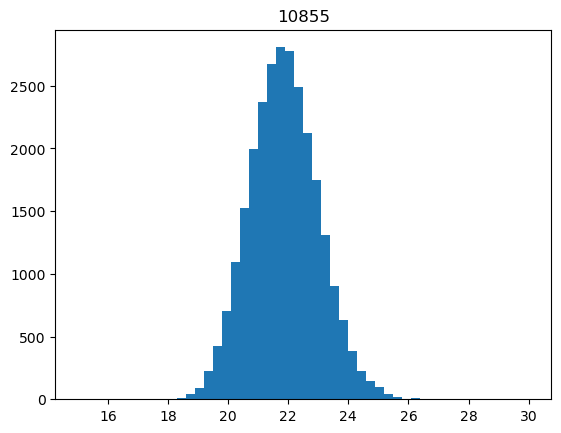

 36%|████████████████████████████▏                                                  | 384/1075 [00:51<01:30,  7.65it/s]

15201


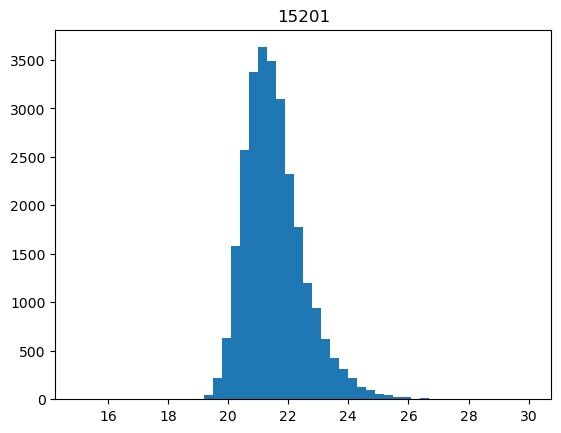

 36%|████████████████████████████▎                                                  | 385/1075 [00:51<01:28,  7.77it/s]

12131


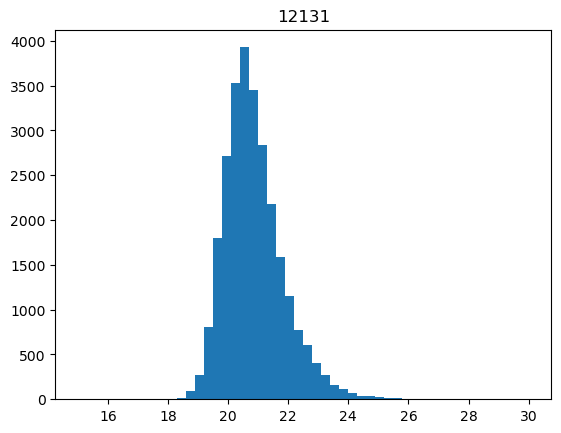

 36%|████████████████████████████▎                                                  | 386/1075 [00:51<01:28,  7.80it/s]

4139


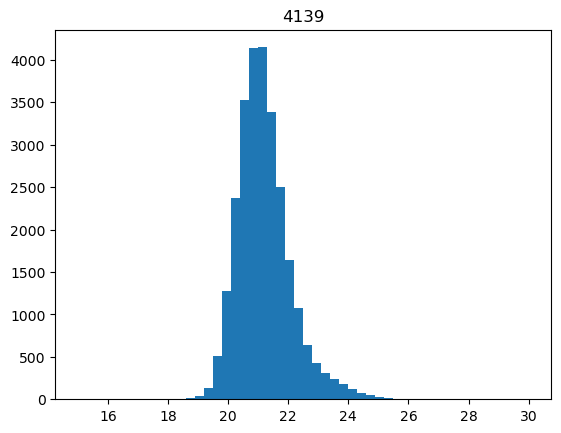

 36%|████████████████████████████▍                                                  | 387/1075 [00:51<01:28,  7.79it/s]

26673


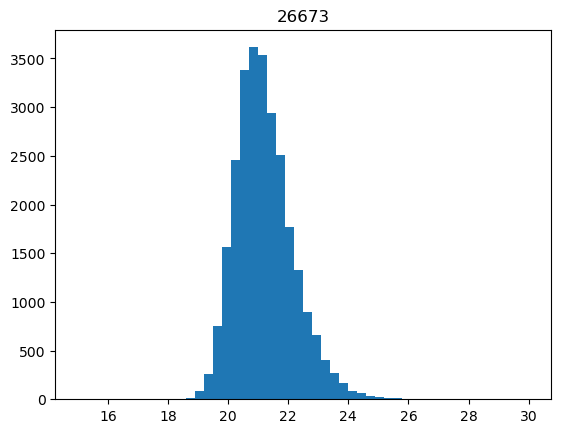

 36%|████████████████████████████▌                                                  | 388/1075 [00:51<01:27,  7.85it/s]

8400


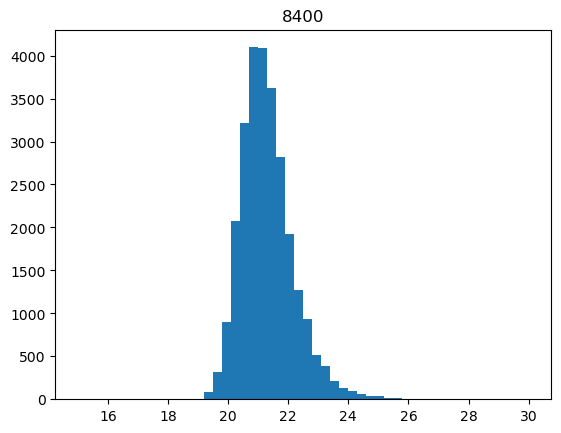

 36%|████████████████████████████▌                                                  | 389/1075 [00:52<01:26,  7.91it/s]

24200


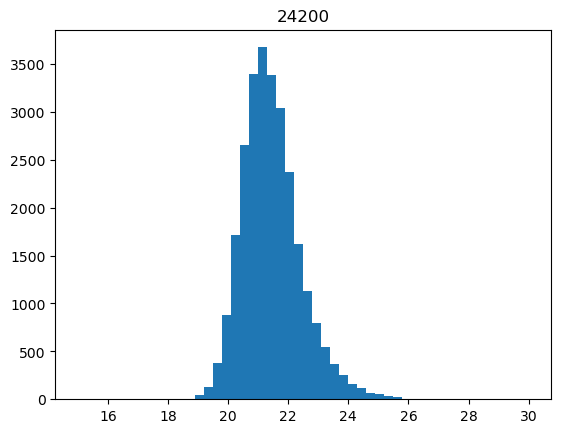

 36%|████████████████████████████▋                                                  | 390/1075 [00:52<01:26,  7.92it/s]

10514


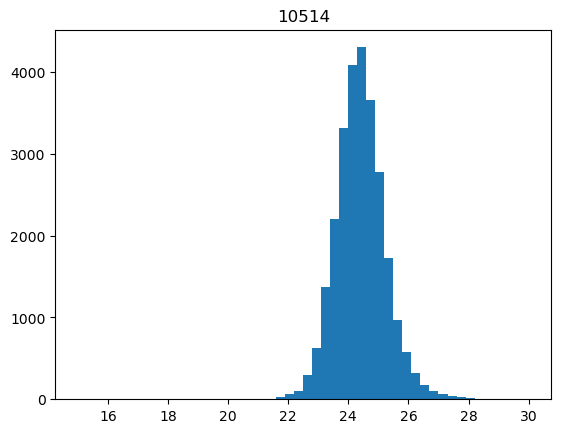

 36%|████████████████████████████▋                                                  | 391/1075 [00:52<01:42,  6.68it/s]

11272


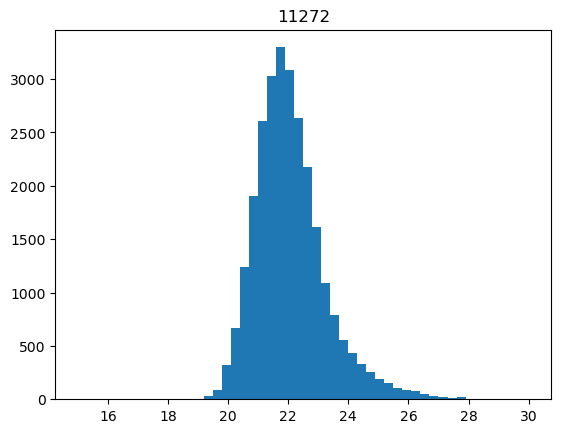

 36%|████████████████████████████▊                                                  | 392/1075 [00:52<01:36,  7.06it/s]

10483


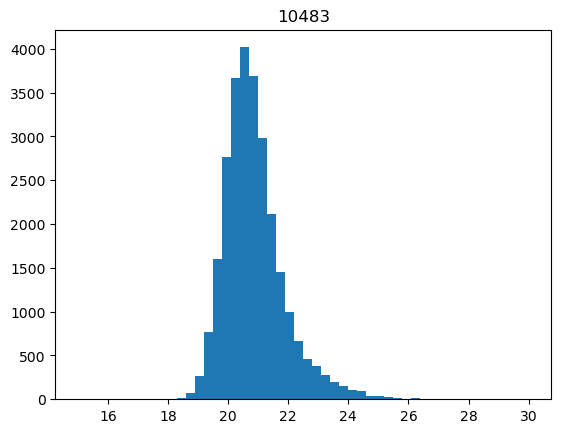

 37%|████████████████████████████▉                                                  | 393/1075 [00:52<01:33,  7.29it/s]

14044


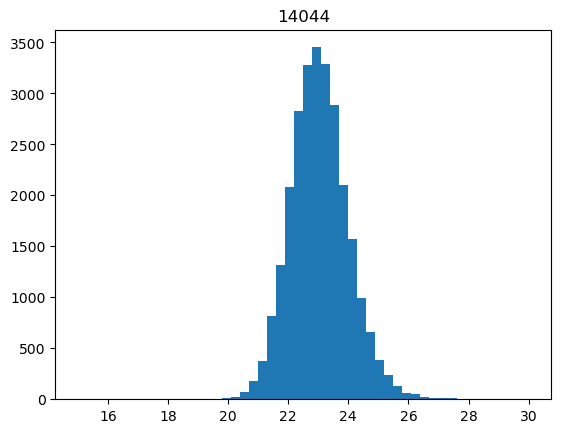

 37%|████████████████████████████▉                                                  | 394/1075 [00:52<01:31,  7.47it/s]

17804


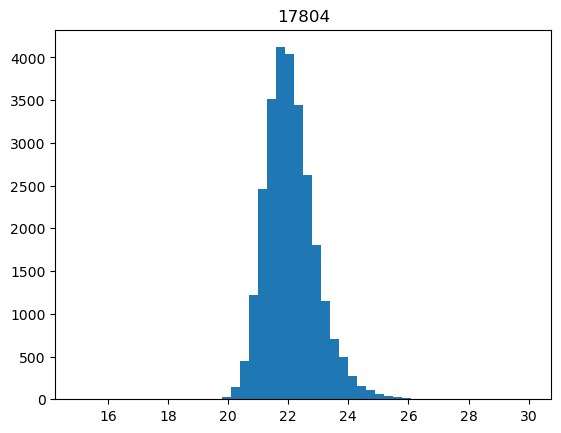

 37%|█████████████████████████████                                                  | 395/1075 [00:52<01:30,  7.53it/s]

25814


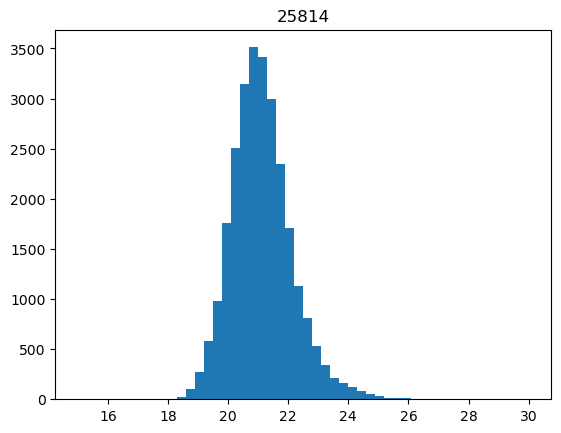

 37%|█████████████████████████████                                                  | 396/1075 [00:53<01:29,  7.58it/s]

4161


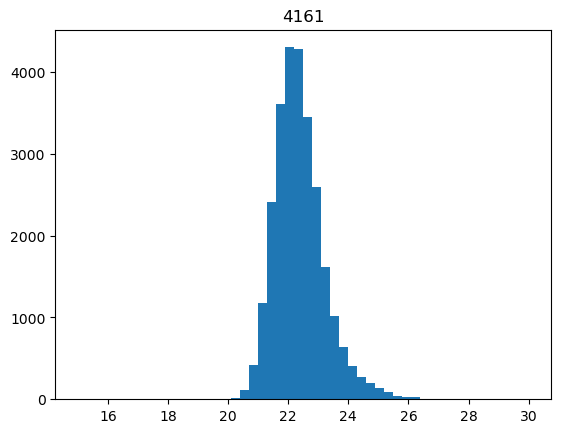

 37%|█████████████████████████████▏                                                 | 397/1075 [00:53<01:27,  7.75it/s]

10862


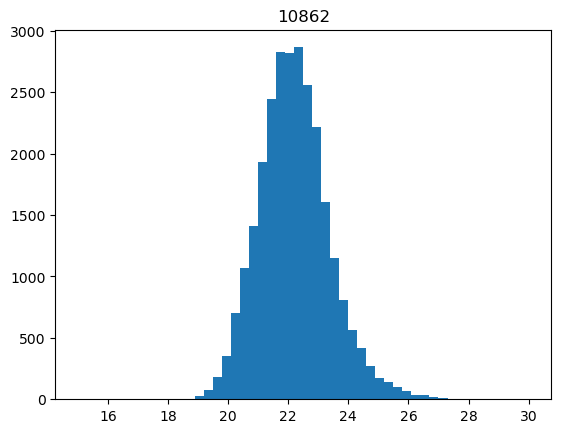

 37%|█████████████████████████████▏                                                 | 398/1075 [00:53<01:25,  7.90it/s]

7676


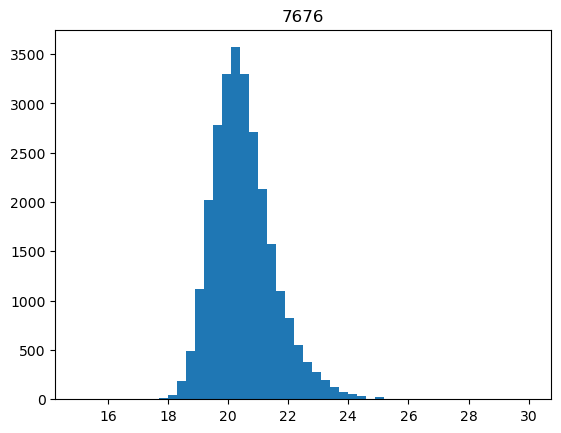

 37%|█████████████████████████████▎                                                 | 399/1075 [00:53<01:24,  7.97it/s]

25842


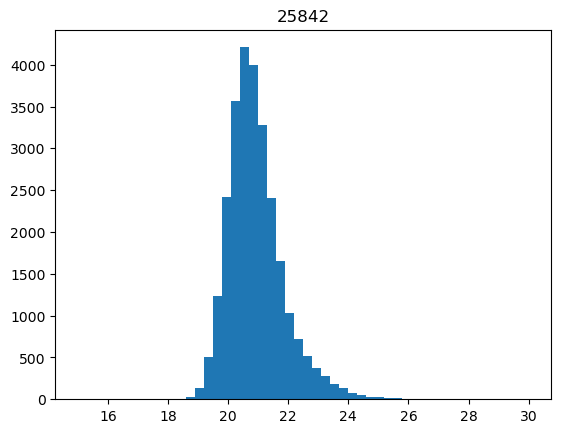

 37%|█████████████████████████████▍                                                 | 400/1075 [00:53<01:25,  7.92it/s]

18179


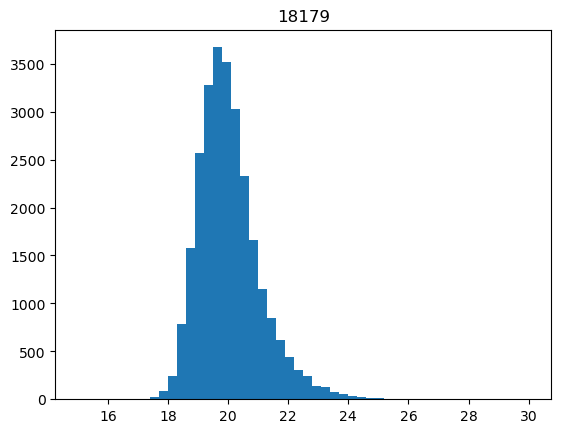

 37%|█████████████████████████████▍                                                 | 401/1075 [00:53<01:25,  7.91it/s]

832


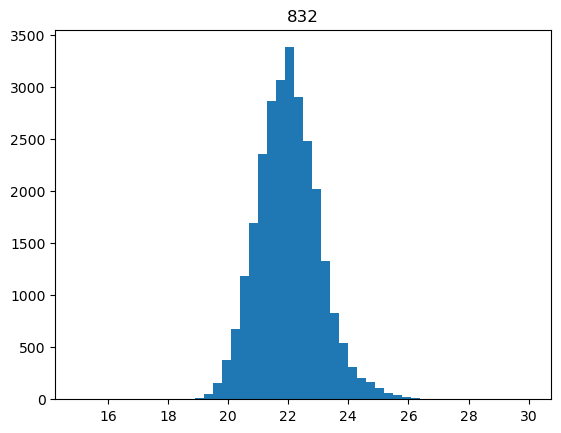

 37%|█████████████████████████████▌                                                 | 402/1075 [00:53<01:42,  6.59it/s]

22815


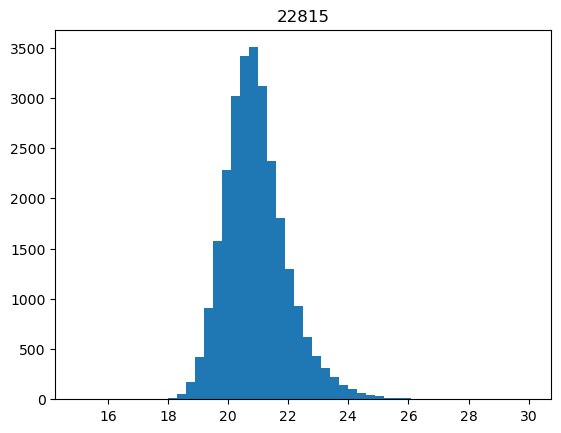

 37%|█████████████████████████████▌                                                 | 403/1075 [00:53<01:36,  6.95it/s]

178


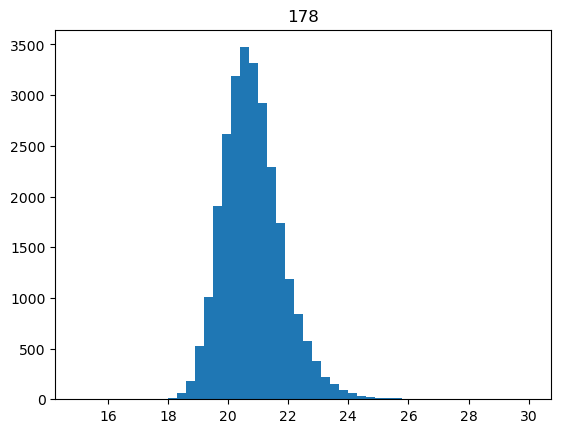

 38%|█████████████████████████████▋                                                 | 404/1075 [00:54<01:33,  7.21it/s]

26246


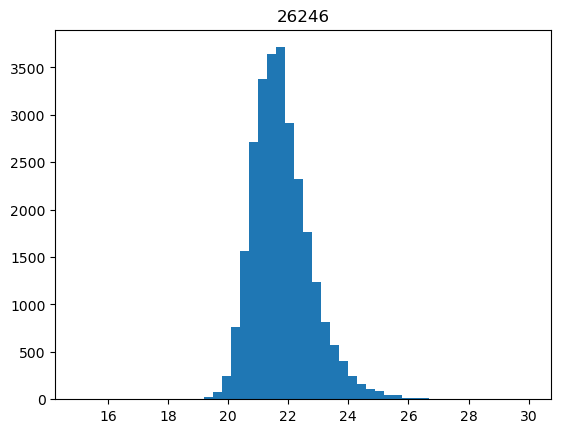

 38%|█████████████████████████████▊                                                 | 405/1075 [00:54<01:32,  7.28it/s]

8427


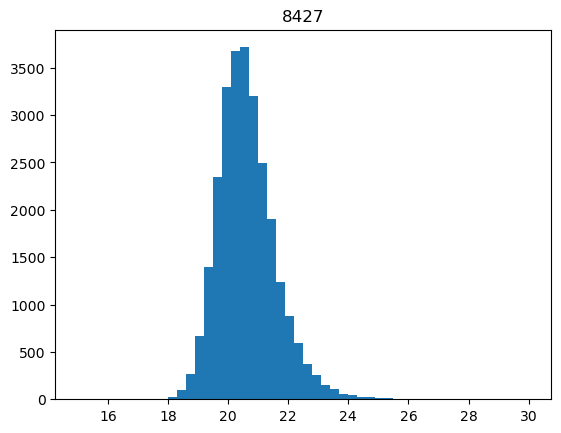

 38%|█████████████████████████████▊                                                 | 406/1075 [00:54<01:30,  7.40it/s]

2371


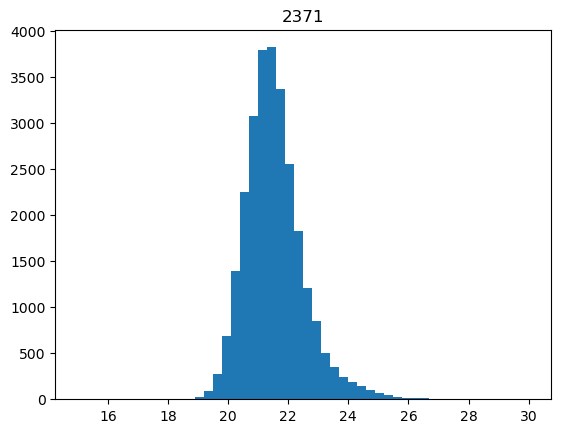

 38%|█████████████████████████████▉                                                 | 407/1075 [00:54<01:29,  7.48it/s]

12282


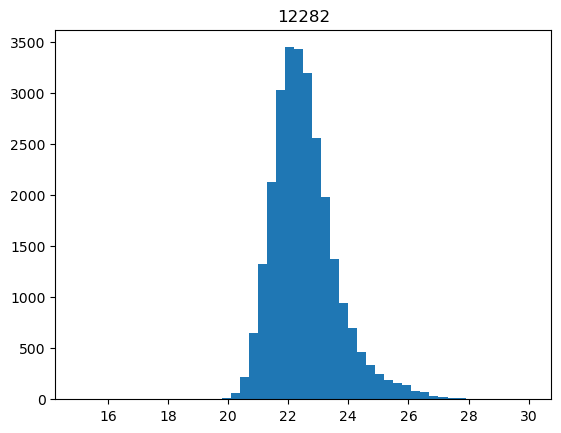

 38%|█████████████████████████████▉                                                 | 408/1075 [00:54<01:27,  7.63it/s]

7767


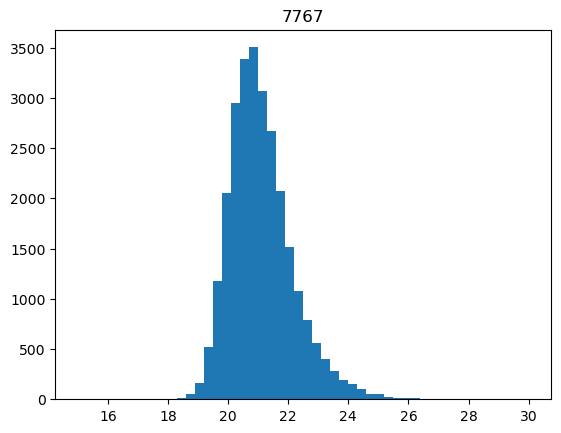

 38%|██████████████████████████████                                                 | 409/1075 [00:54<01:26,  7.68it/s]

5697


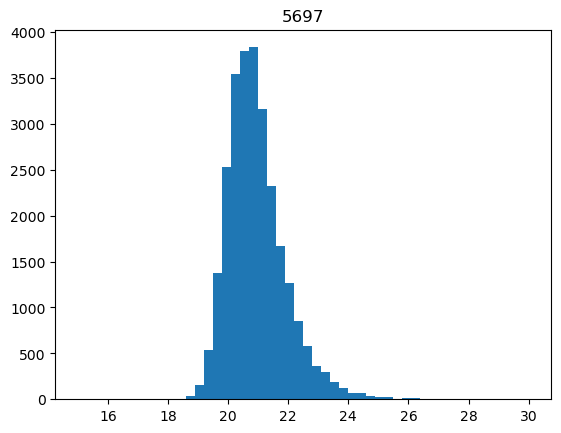

 38%|██████████████████████████████▏                                                | 410/1075 [00:54<01:25,  7.74it/s]

15616


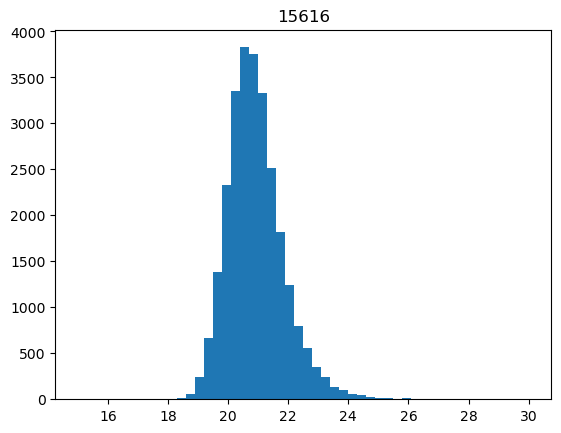

 38%|██████████████████████████████▏                                                | 411/1075 [00:54<01:25,  7.80it/s]

6739


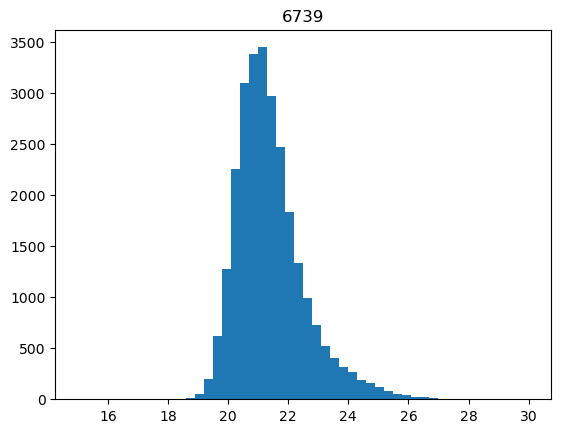

 38%|██████████████████████████████▎                                                | 412/1075 [00:55<01:24,  7.87it/s]

794


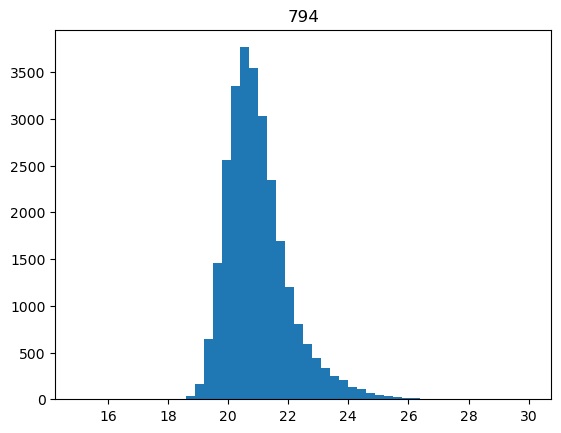

 38%|██████████████████████████████▎                                                | 413/1075 [00:55<01:41,  6.53it/s]

9815


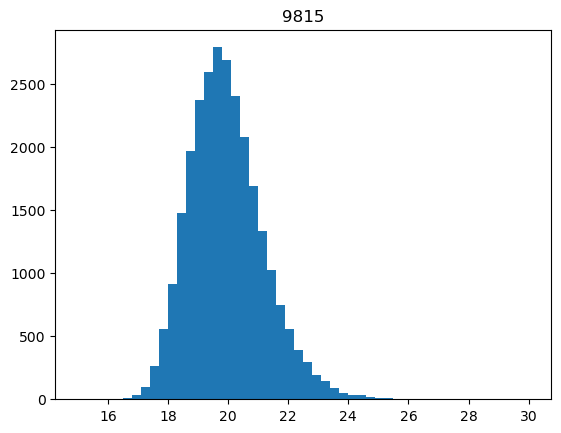

 39%|██████████████████████████████▍                                                | 414/1075 [00:55<01:35,  6.90it/s]

26324


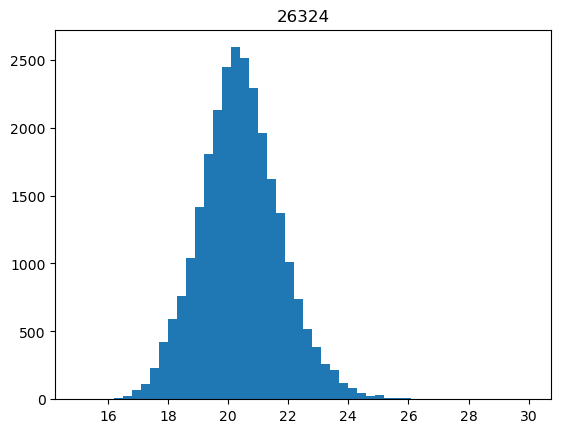

 39%|██████████████████████████████▍                                                | 415/1075 [00:55<01:31,  7.19it/s]

13647


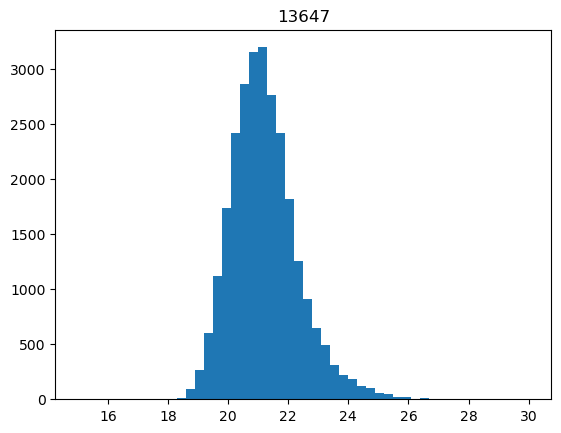

 39%|██████████████████████████████▌                                                | 416/1075 [00:55<01:29,  7.39it/s]

15577


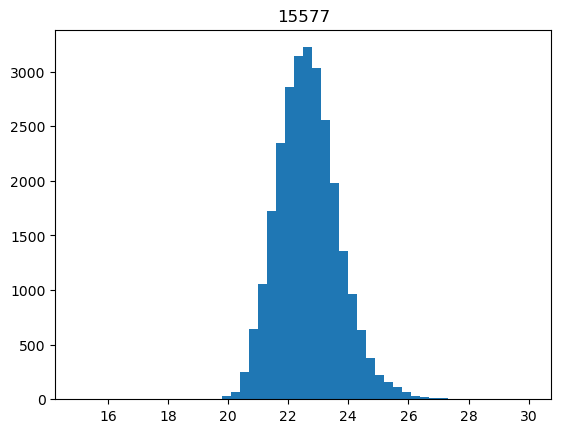

 39%|██████████████████████████████▋                                                | 417/1075 [00:55<01:27,  7.56it/s]

8428


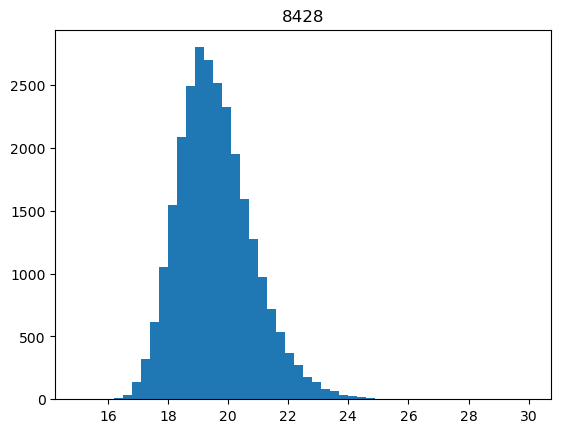

 39%|██████████████████████████████▋                                                | 418/1075 [00:55<01:25,  7.72it/s]

24480


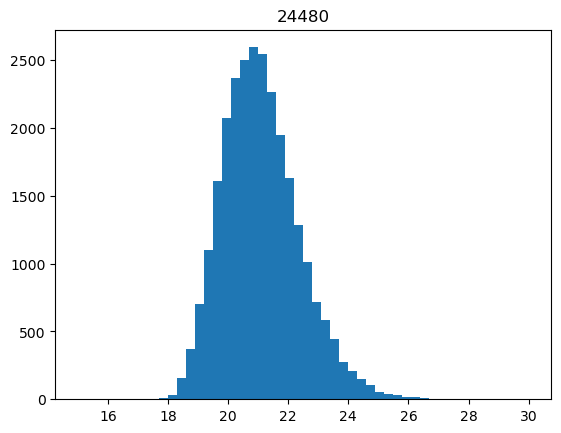

 39%|██████████████████████████████▊                                                | 419/1075 [00:56<01:23,  7.88it/s]

10376


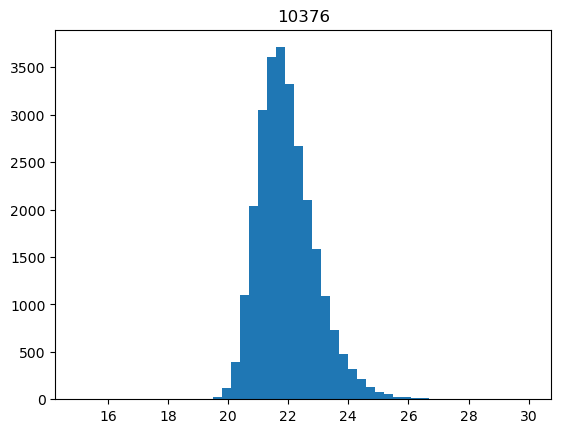

 39%|██████████████████████████████▊                                                | 420/1075 [00:56<01:23,  7.86it/s]

5219


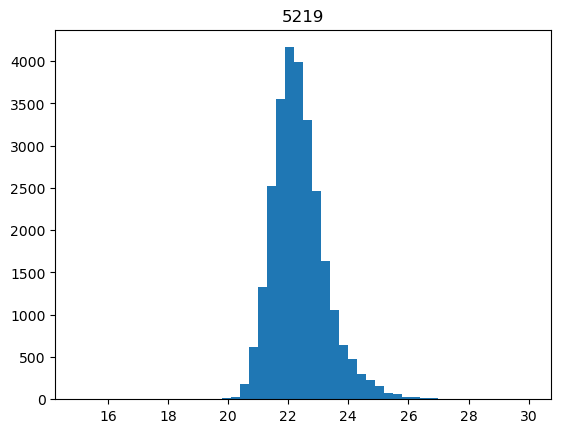

 39%|██████████████████████████████▉                                                | 421/1075 [00:56<01:23,  7.84it/s]

4053


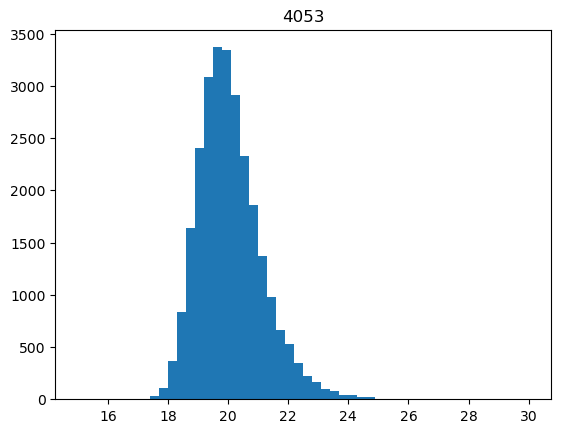

 39%|███████████████████████████████                                                | 422/1075 [00:56<01:23,  7.85it/s]

24617


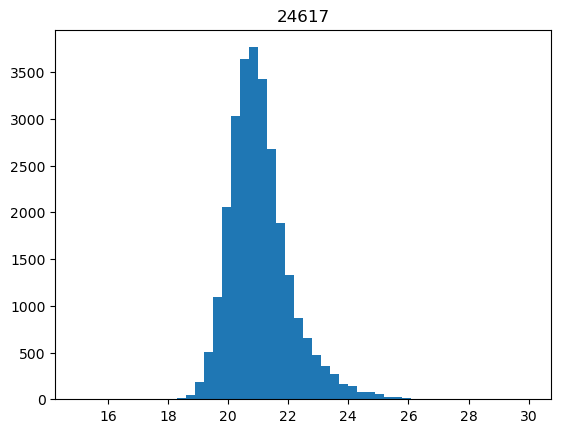

 39%|███████████████████████████████                                                | 423/1075 [00:56<01:22,  7.89it/s]

22970


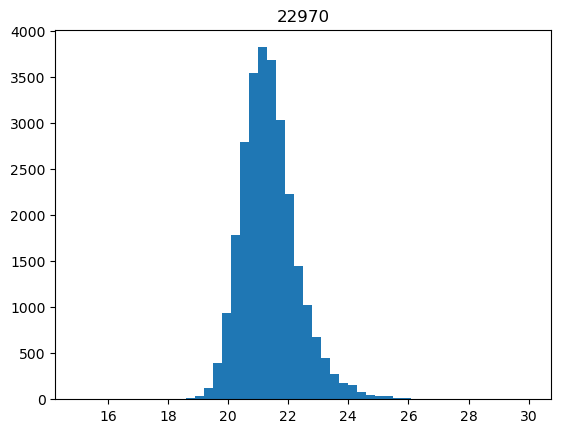

 39%|███████████████████████████████▏                                               | 424/1075 [00:56<01:38,  6.59it/s]

779


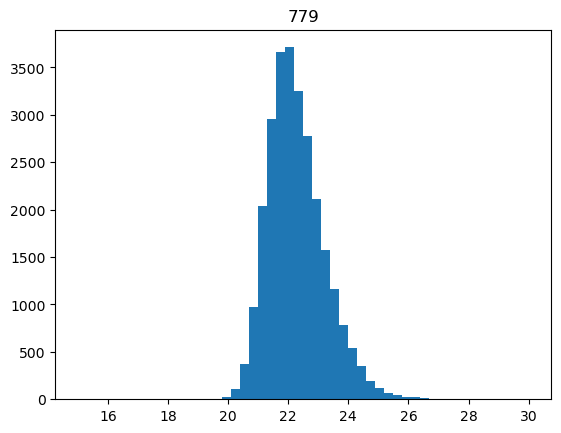

 40%|███████████████████████████████▏                                               | 425/1075 [00:56<01:33,  6.95it/s]

6153


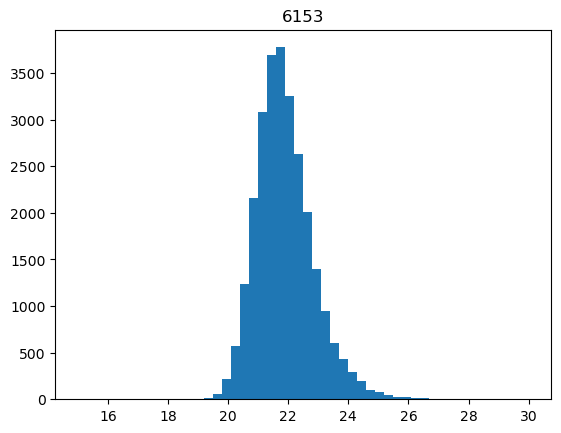

 40%|███████████████████████████████▎                                               | 426/1075 [00:57<01:30,  7.18it/s]

24647


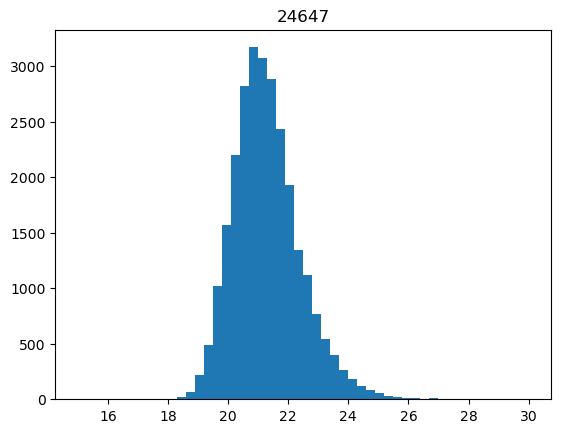

 40%|███████████████████████████████▍                                               | 427/1075 [00:57<01:27,  7.43it/s]

7650


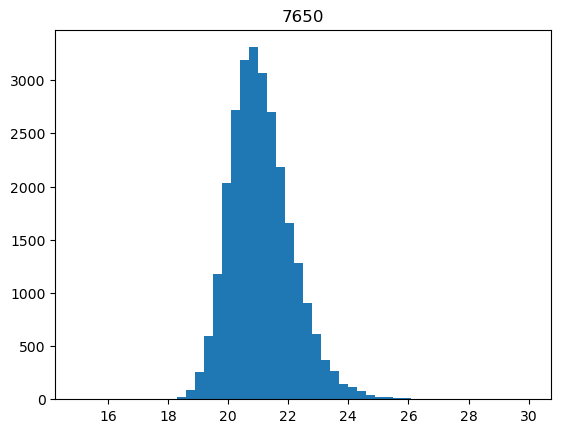

 40%|███████████████████████████████▍                                               | 428/1075 [00:57<01:25,  7.57it/s]

11671


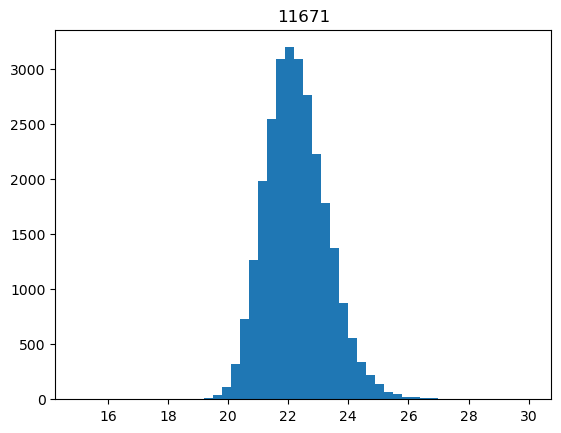

 40%|███████████████████████████████▌                                               | 429/1075 [00:57<01:24,  7.68it/s]

22849


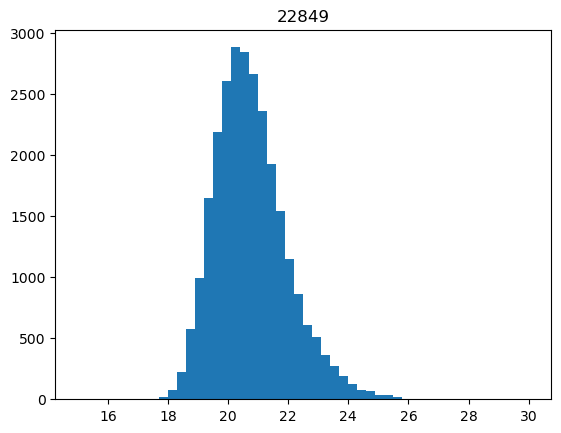

 40%|███████████████████████████████▌                                               | 430/1075 [00:57<01:23,  7.77it/s]

22966


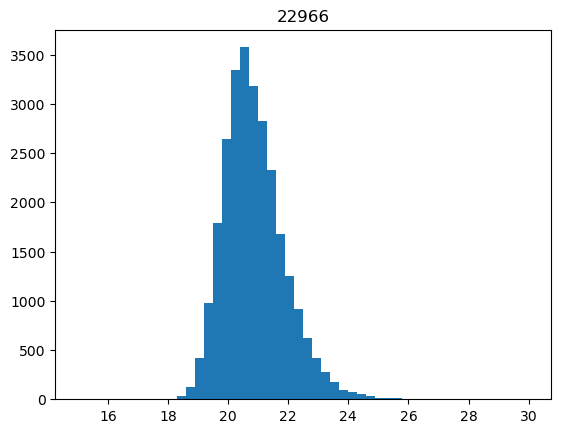

 40%|███████████████████████████████▋                                               | 431/1075 [00:57<01:22,  7.80it/s]

1092


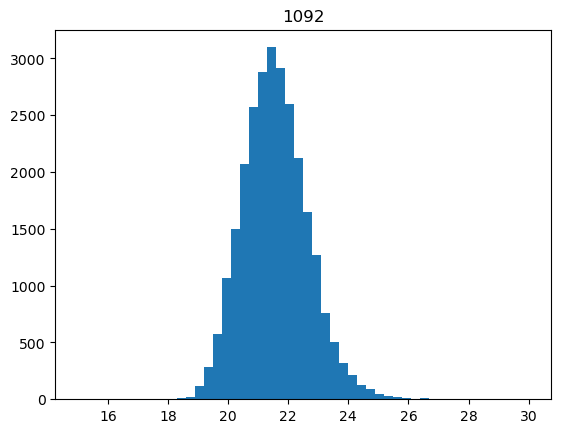

 40%|███████████████████████████████▋                                               | 432/1075 [00:57<01:21,  7.90it/s]

5323


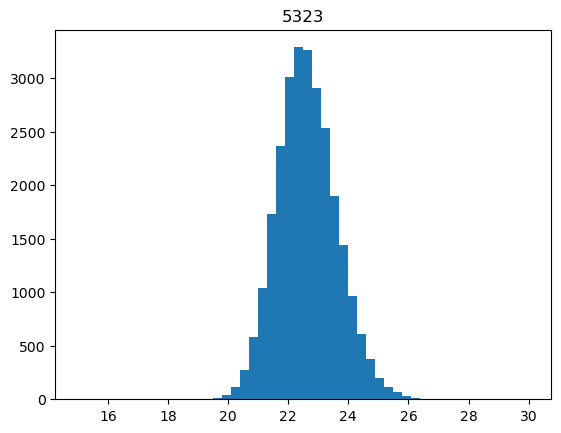

 40%|███████████████████████████████▊                                               | 433/1075 [00:57<01:20,  7.95it/s]

53


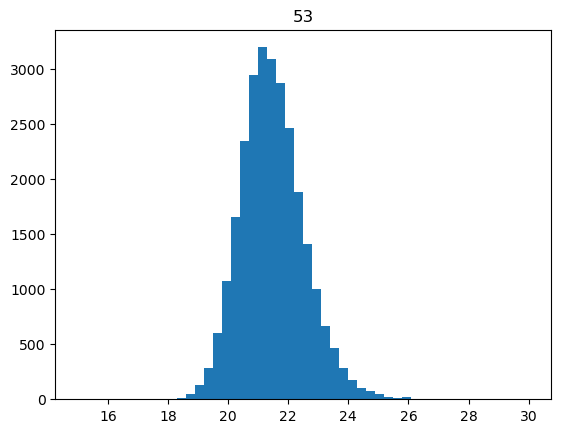

 40%|███████████████████████████████▉                                               | 434/1075 [00:58<01:20,  8.00it/s]

9277


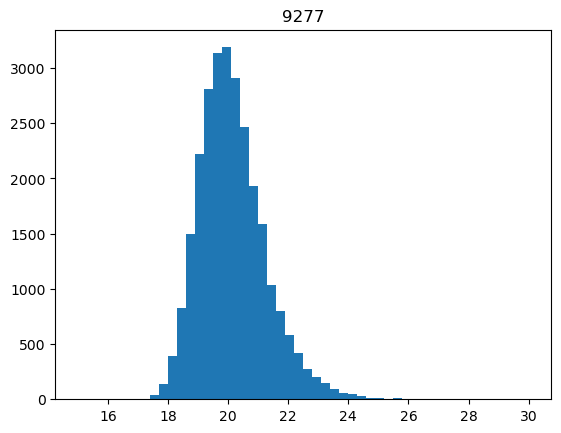

 40%|███████████████████████████████▉                                               | 435/1075 [00:58<01:35,  6.70it/s]

7606


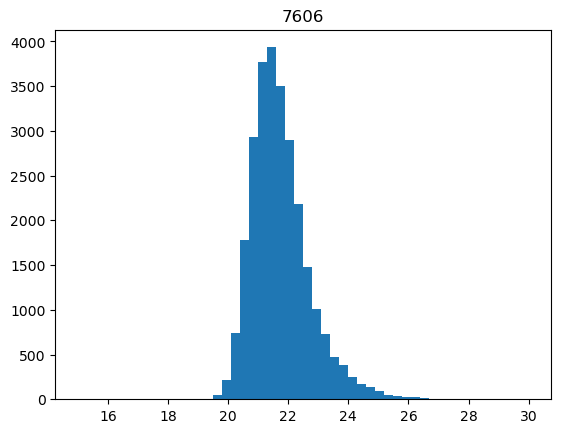

 41%|████████████████████████████████                                               | 436/1075 [00:58<01:30,  7.04it/s]

10715


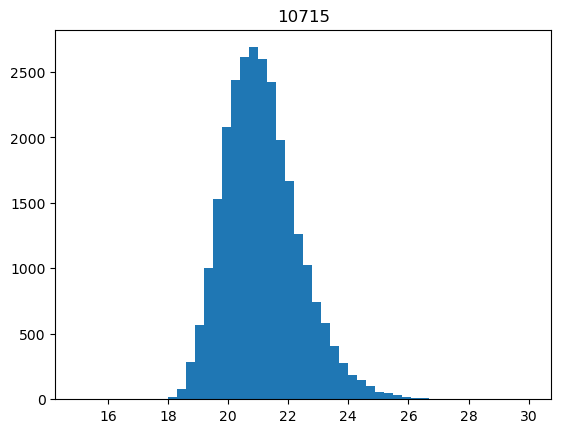

 41%|████████████████████████████████                                               | 437/1075 [00:58<01:26,  7.38it/s]

24484


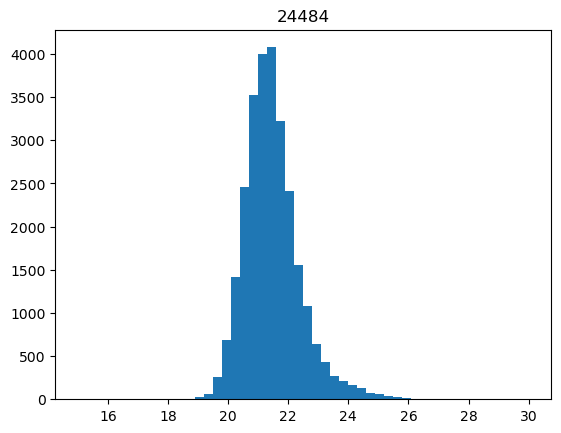

 41%|████████████████████████████████▏                                              | 438/1075 [00:58<01:24,  7.54it/s]

15436


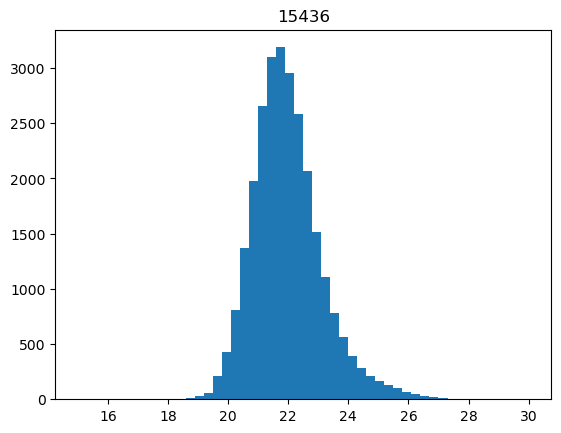

 41%|████████████████████████████████▎                                              | 439/1075 [00:58<01:22,  7.67it/s]

21312


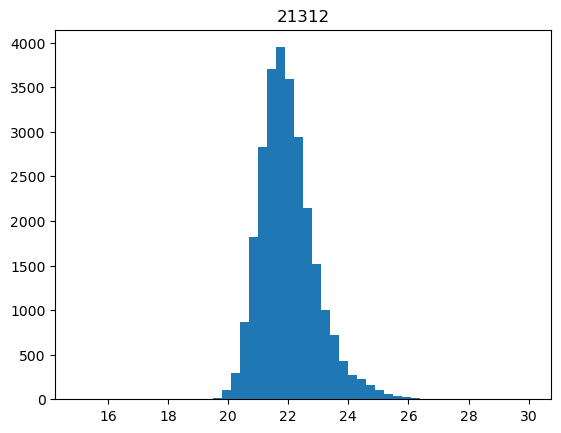

 41%|████████████████████████████████▎                                              | 440/1075 [00:58<01:22,  7.70it/s]

13018


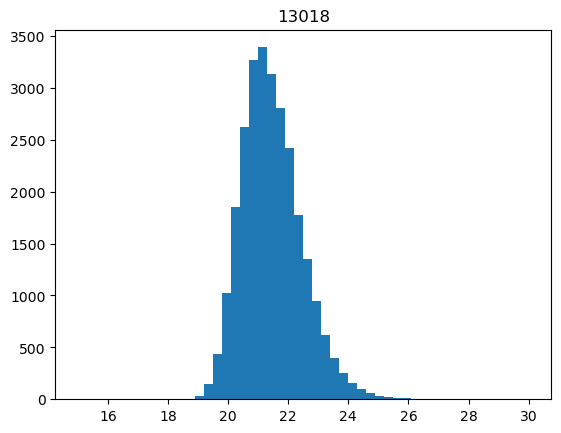

 41%|████████████████████████████████▍                                              | 441/1075 [00:59<01:22,  7.69it/s]

5573


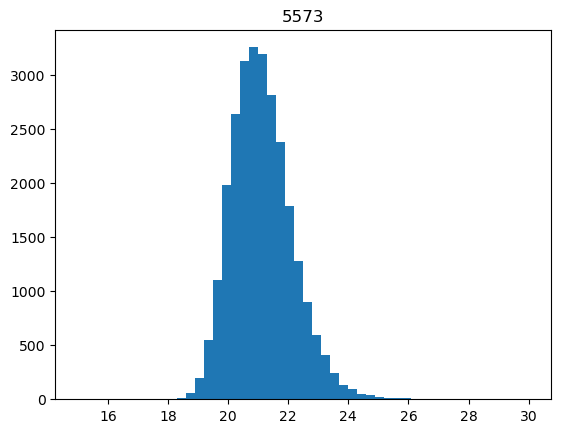

 41%|████████████████████████████████▍                                              | 442/1075 [00:59<01:20,  7.82it/s]

21925


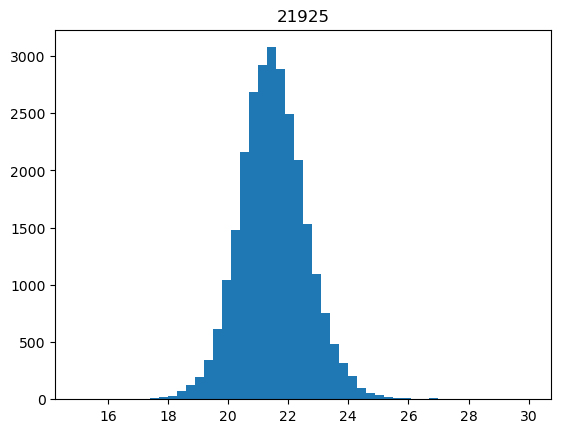

 41%|████████████████████████████████▌                                              | 443/1075 [00:59<01:19,  7.91it/s]

15570


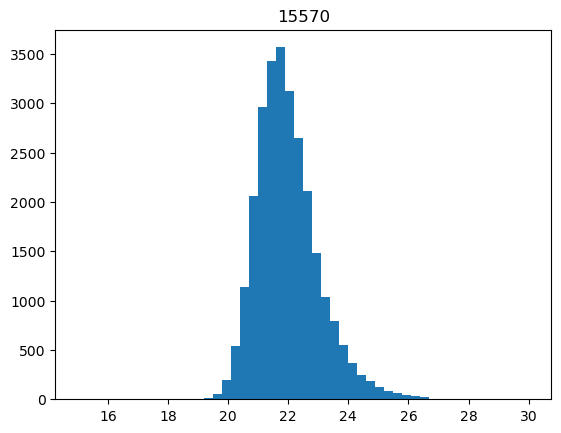

 41%|████████████████████████████████▋                                              | 444/1075 [00:59<01:20,  7.88it/s]

6792


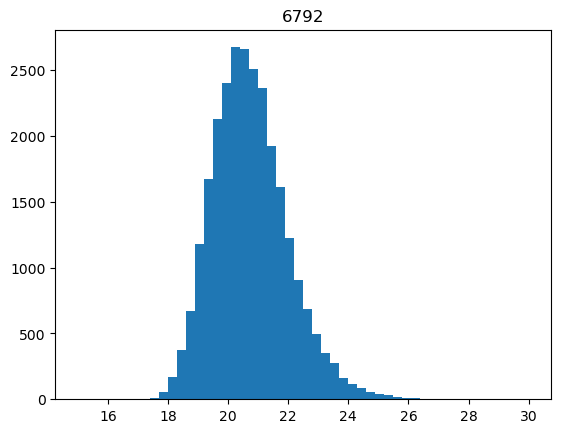

 41%|████████████████████████████████▋                                              | 445/1075 [00:59<01:18,  7.99it/s]

18681


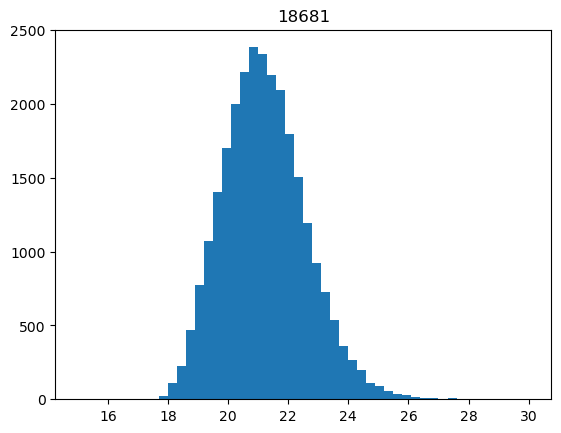

 41%|████████████████████████████████▊                                              | 446/1075 [00:59<01:33,  6.72it/s]

2681


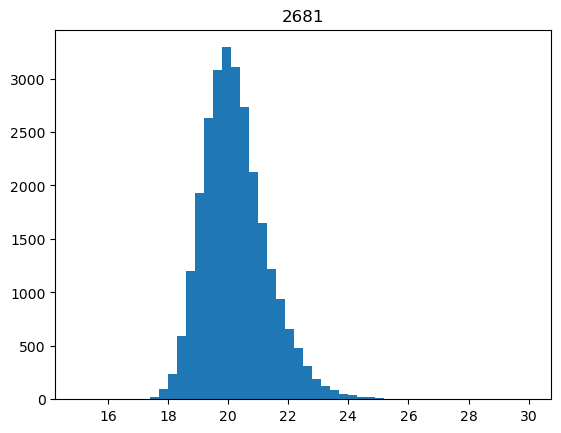

 42%|████████████████████████████████▊                                              | 447/1075 [00:59<01:28,  7.07it/s]

1381


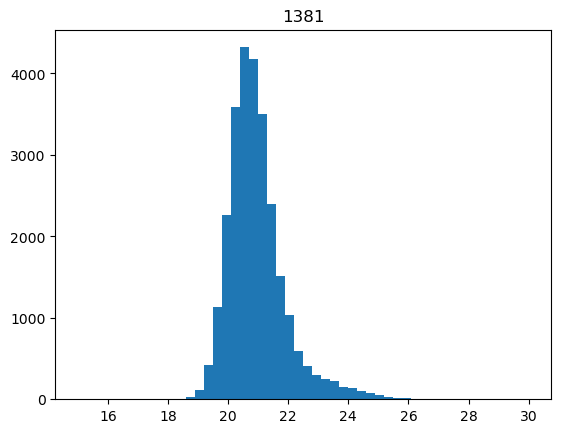

 42%|████████████████████████████████▉                                              | 448/1075 [00:59<01:24,  7.41it/s]

8919


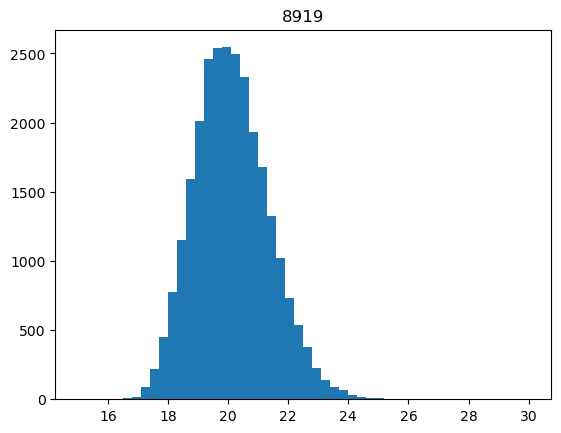

 42%|████████████████████████████████▉                                              | 449/1075 [01:00<01:22,  7.59it/s]

10933


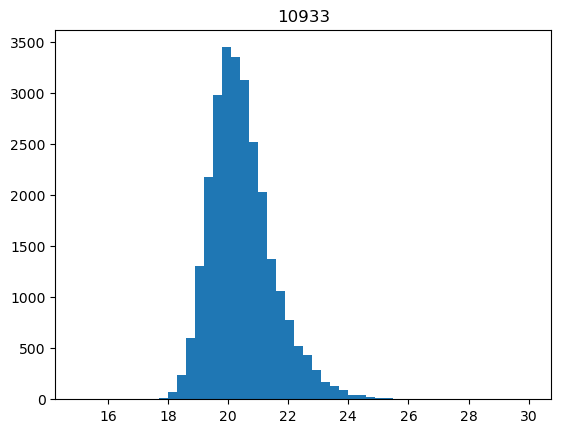

 42%|█████████████████████████████████                                              | 450/1075 [01:00<01:22,  7.61it/s]

7996


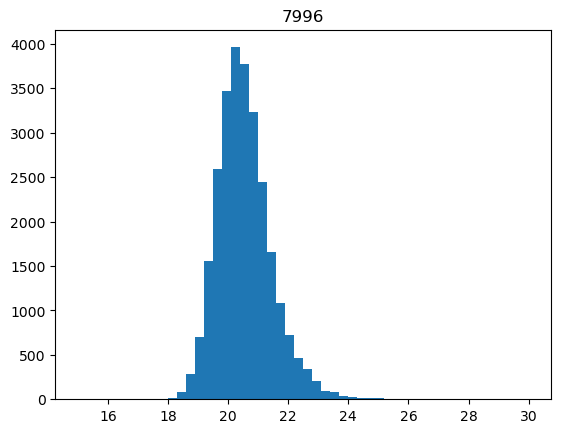

 42%|█████████████████████████████████▏                                             | 451/1075 [01:00<01:21,  7.63it/s]

12482


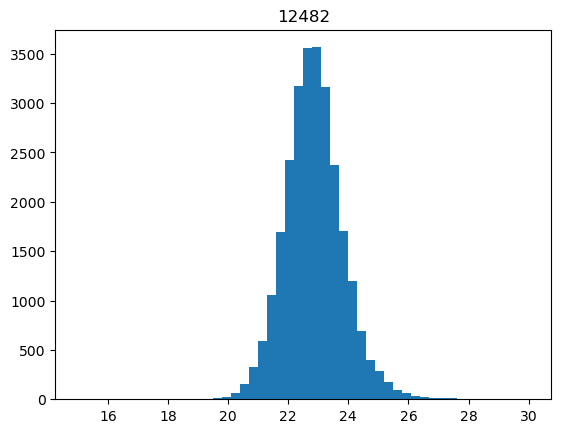

 42%|█████████████████████████████████▏                                             | 452/1075 [01:00<01:20,  7.76it/s]

8256


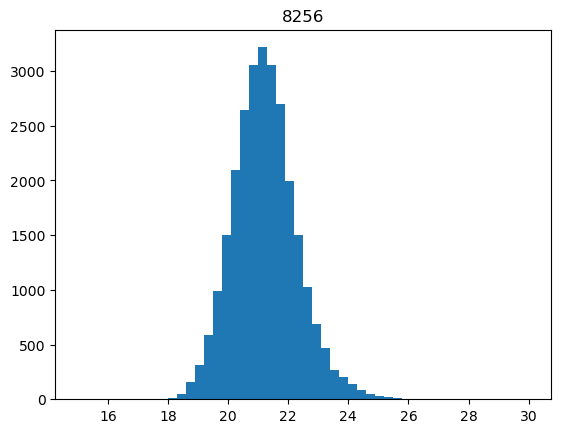

 42%|█████████████████████████████████▎                                             | 453/1075 [01:00<01:19,  7.84it/s]

16890


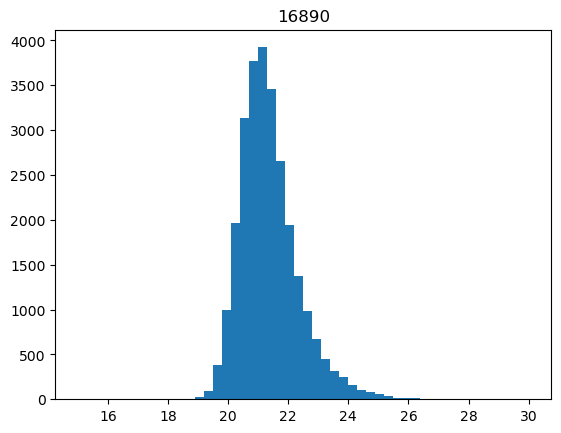

 42%|█████████████████████████████████▎                                             | 454/1075 [01:00<01:19,  7.78it/s]

11480


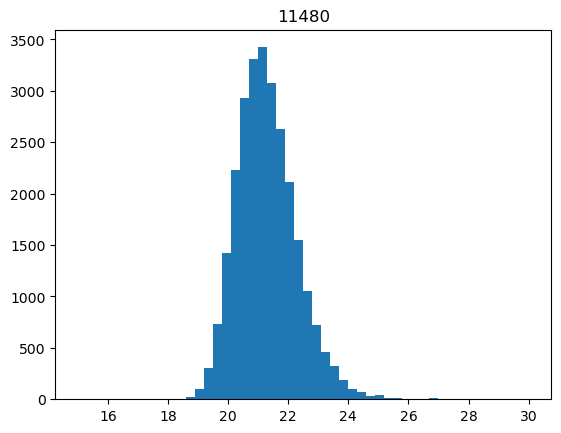

 42%|█████████████████████████████████▍                                             | 455/1075 [01:00<01:19,  7.83it/s]

17476


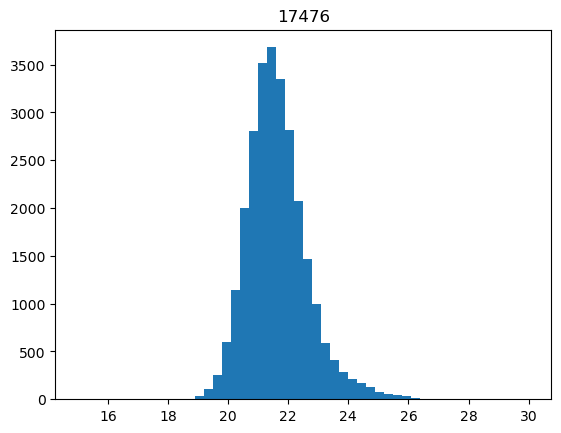

 42%|█████████████████████████████████▌                                             | 456/1075 [01:00<01:19,  7.80it/s]

7756


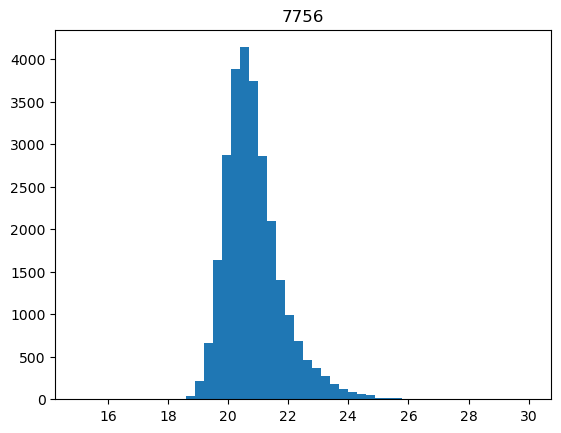

 43%|█████████████████████████████████▌                                             | 457/1075 [01:01<01:34,  6.52it/s]

19510


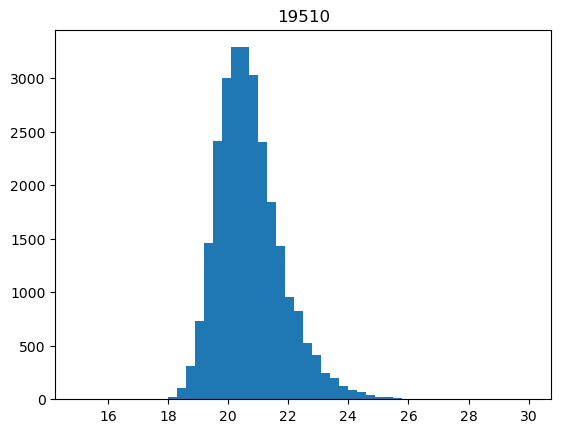

 43%|█████████████████████████████████▋                                             | 458/1075 [01:01<01:28,  6.93it/s]

92


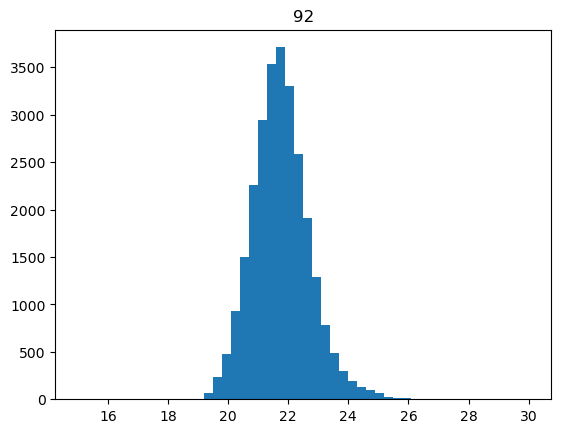

 43%|█████████████████████████████████▋                                             | 459/1075 [01:01<01:25,  7.22it/s]

8715


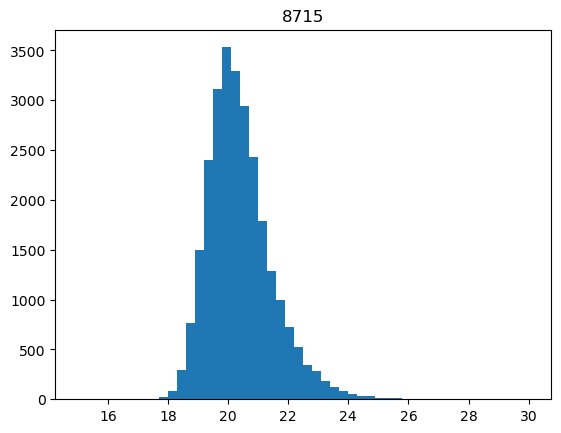

 43%|█████████████████████████████████▊                                             | 460/1075 [01:01<01:23,  7.41it/s]

20006


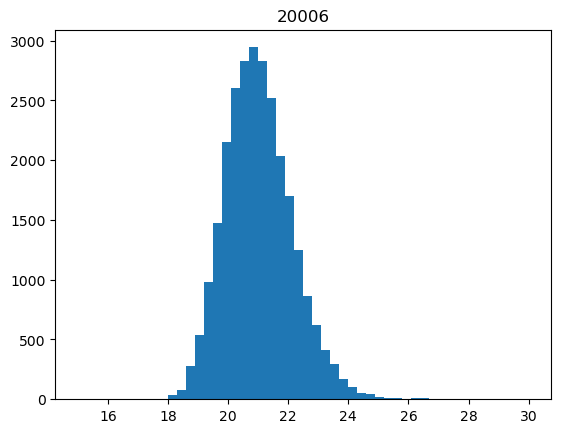

 43%|█████████████████████████████████▉                                             | 461/1075 [01:01<01:21,  7.54it/s]

6641


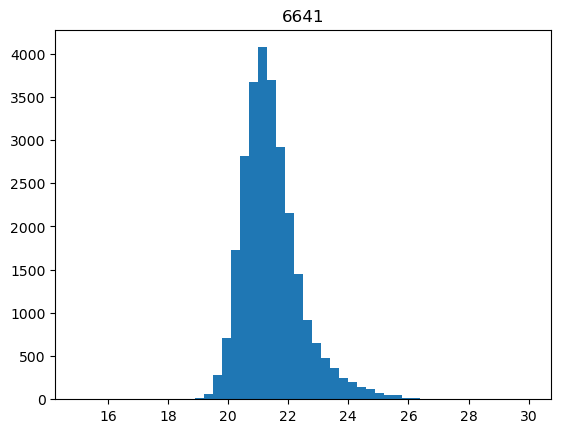

 43%|█████████████████████████████████▉                                             | 462/1075 [01:01<01:20,  7.58it/s]

5347


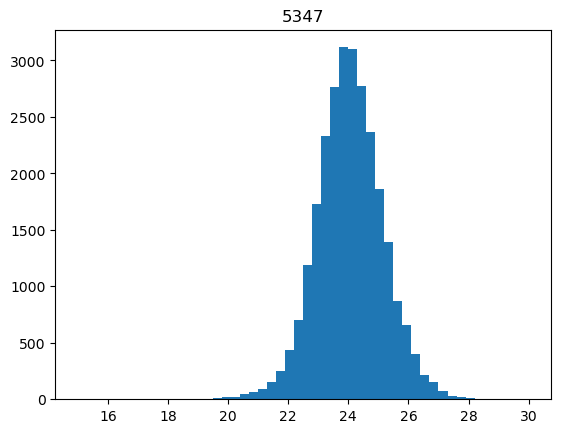

 43%|██████████████████████████████████                                             | 463/1075 [01:01<01:20,  7.63it/s]

22564


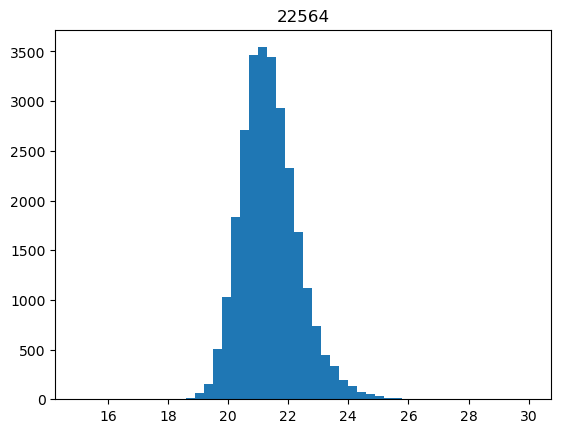

 43%|██████████████████████████████████                                             | 464/1075 [01:02<01:19,  7.67it/s]

21918


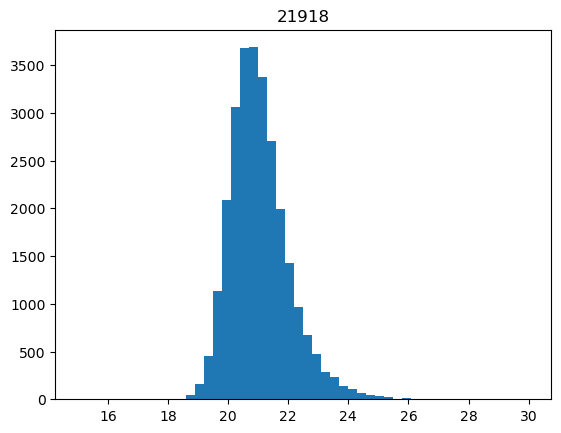

 43%|██████████████████████████████████▏                                            | 465/1075 [01:02<01:19,  7.66it/s]

17646


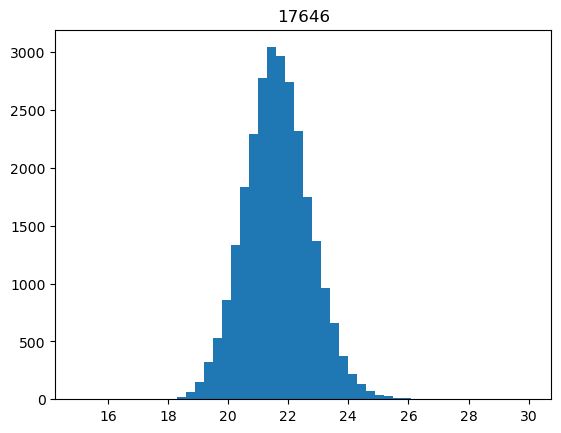

 43%|██████████████████████████████████▏                                            | 466/1075 [01:02<01:18,  7.72it/s]

25422


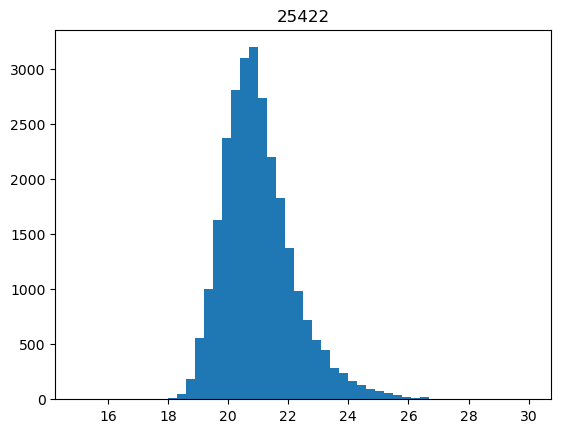

 43%|██████████████████████████████████▎                                            | 467/1075 [01:02<01:18,  7.77it/s]

7834


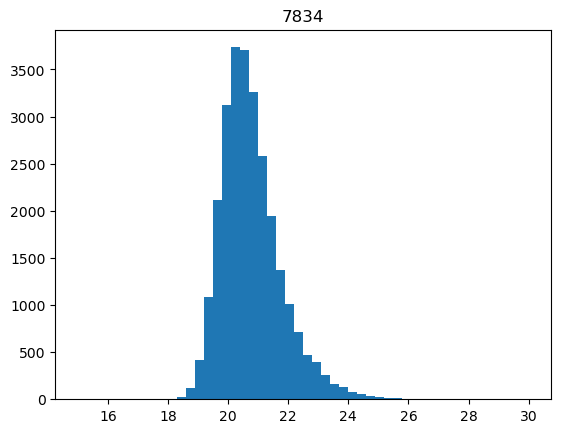

 44%|██████████████████████████████████▍                                            | 468/1075 [01:02<01:34,  6.45it/s]

6970


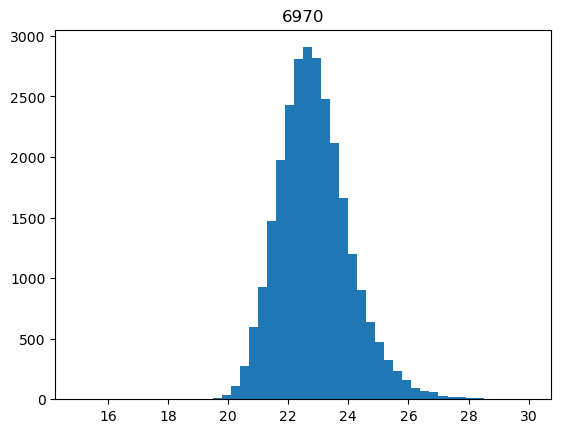

 44%|██████████████████████████████████▍                                            | 469/1075 [01:02<01:28,  6.86it/s]

132


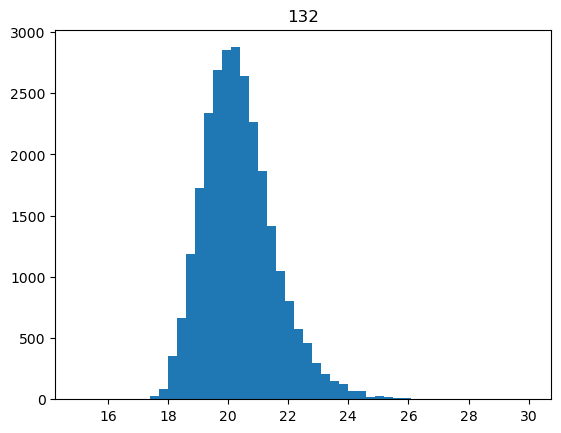

 44%|██████████████████████████████████▌                                            | 470/1075 [01:02<01:24,  7.18it/s]

15318


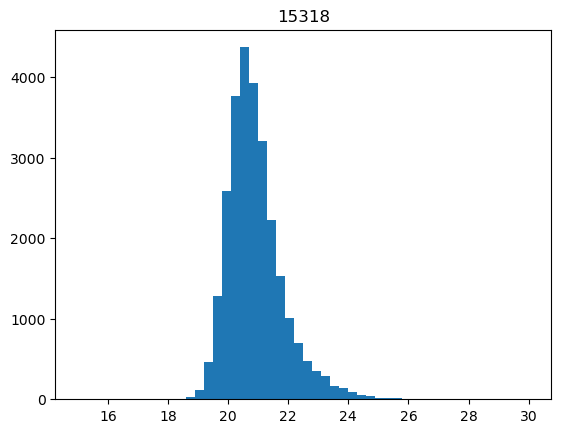

 44%|██████████████████████████████████▌                                            | 471/1075 [01:03<01:21,  7.39it/s]

25913


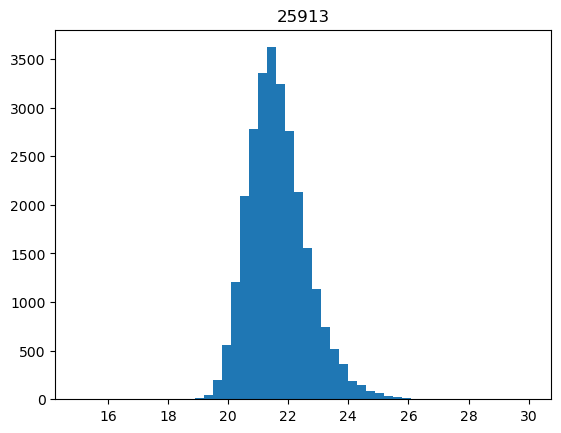

 44%|██████████████████████████████████▋                                            | 472/1075 [01:03<01:19,  7.55it/s]

17261


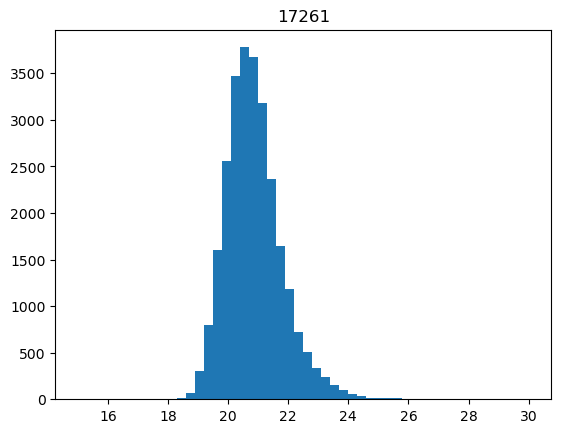

 44%|██████████████████████████████████▊                                            | 473/1075 [01:03<01:18,  7.66it/s]

5372


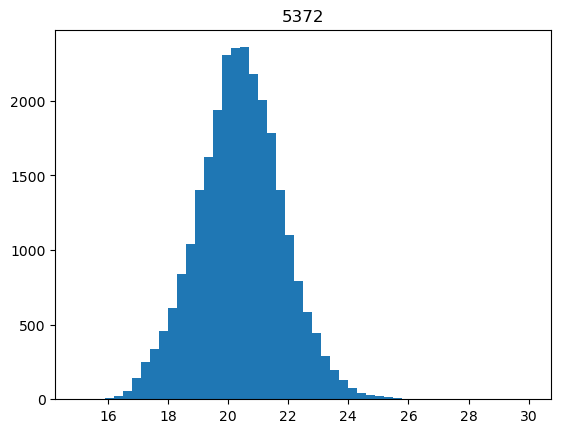

 44%|██████████████████████████████████▊                                            | 474/1075 [01:03<01:16,  7.81it/s]

9388


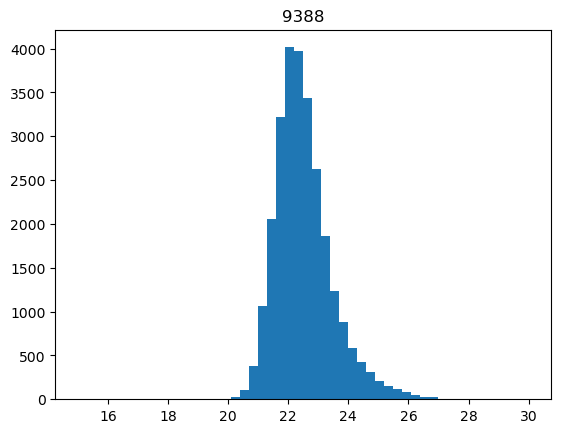

 44%|██████████████████████████████████▉                                            | 475/1075 [01:03<01:16,  7.81it/s]

2292


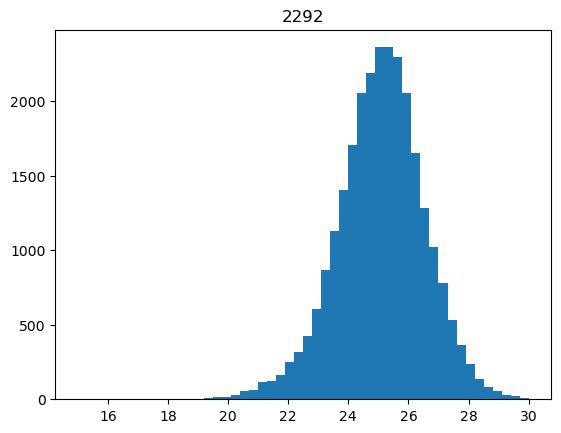

 44%|██████████████████████████████████▉                                            | 476/1075 [01:03<01:16,  7.87it/s]

10891


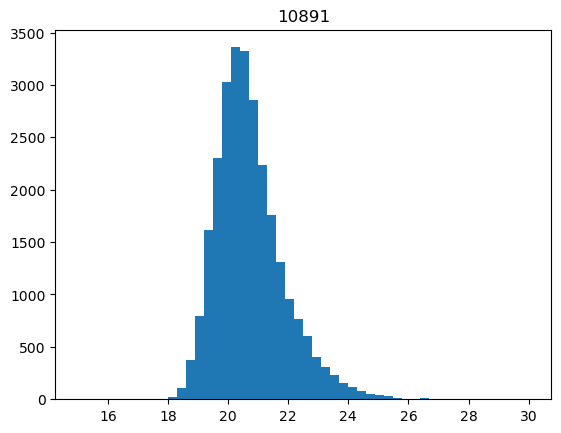

 44%|███████████████████████████████████                                            | 477/1075 [01:03<01:15,  7.87it/s]

18643


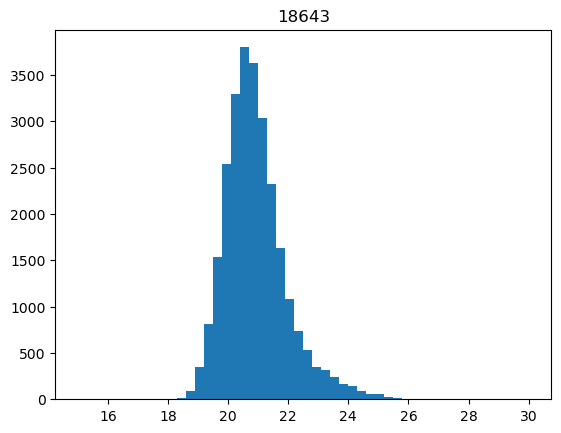

 44%|███████████████████████████████████▏                                           | 478/1075 [01:03<01:16,  7.85it/s]

2310


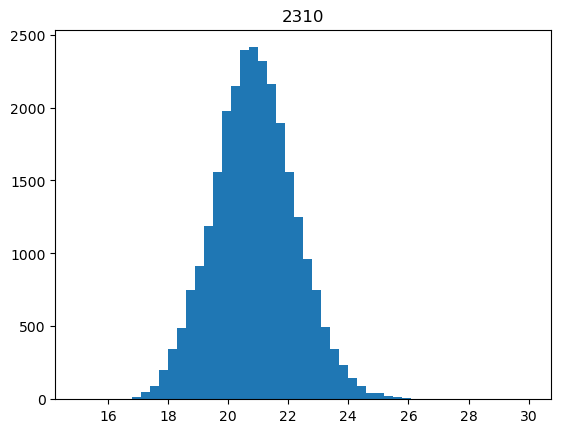

 45%|███████████████████████████████████▏                                           | 479/1075 [01:04<01:30,  6.56it/s]

5566


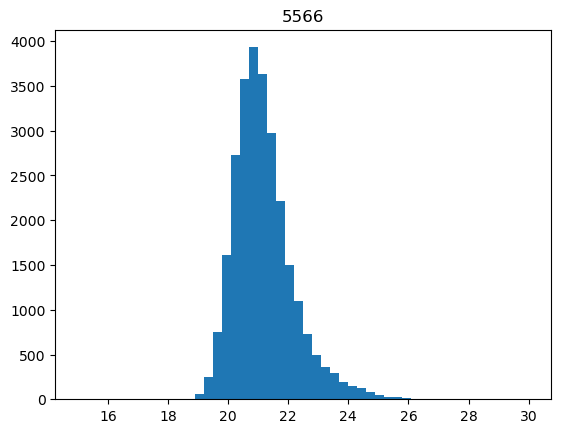

 45%|███████████████████████████████████▎                                           | 480/1075 [01:04<01:26,  6.92it/s]

10273


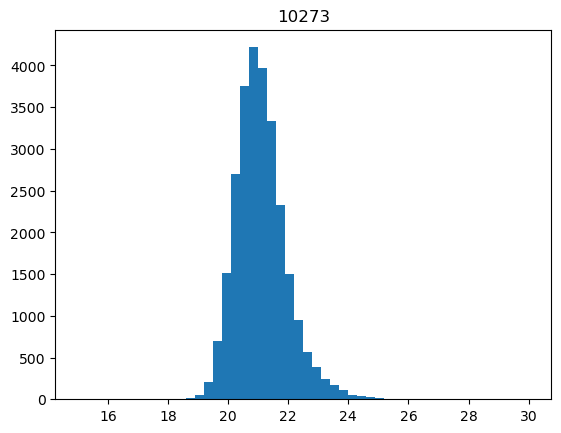

 45%|███████████████████████████████████▎                                           | 481/1075 [01:04<01:23,  7.09it/s]

25674


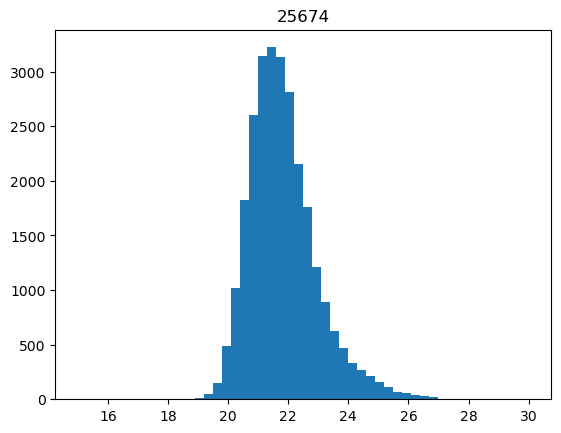

 45%|███████████████████████████████████▍                                           | 482/1075 [01:04<01:21,  7.26it/s]

5477


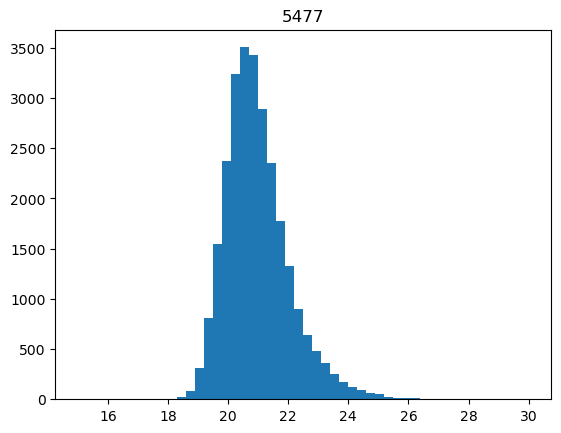

 45%|███████████████████████████████████▍                                           | 483/1075 [01:04<01:20,  7.40it/s]

26700


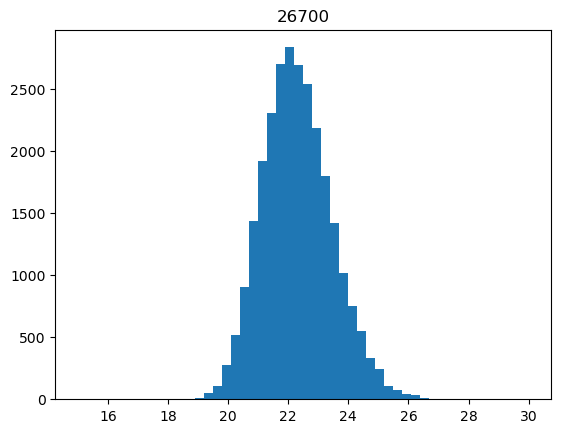

 45%|███████████████████████████████████▌                                           | 484/1075 [01:04<01:17,  7.59it/s]

26236


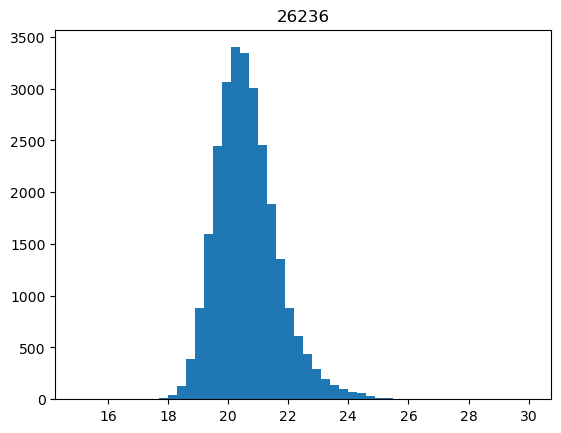

 45%|███████████████████████████████████▋                                           | 485/1075 [01:04<01:16,  7.71it/s]

1955


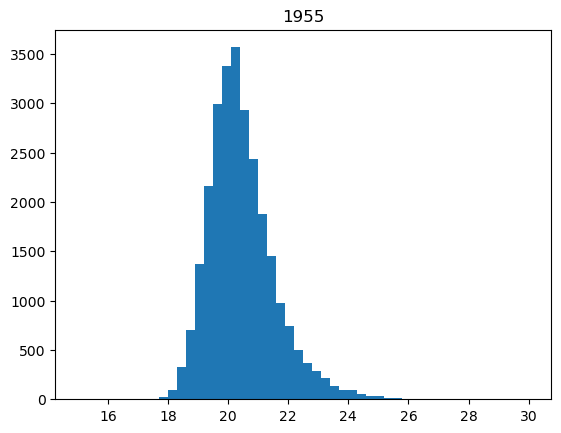

 45%|███████████████████████████████████▋                                           | 486/1075 [01:05<01:16,  7.68it/s]

10572


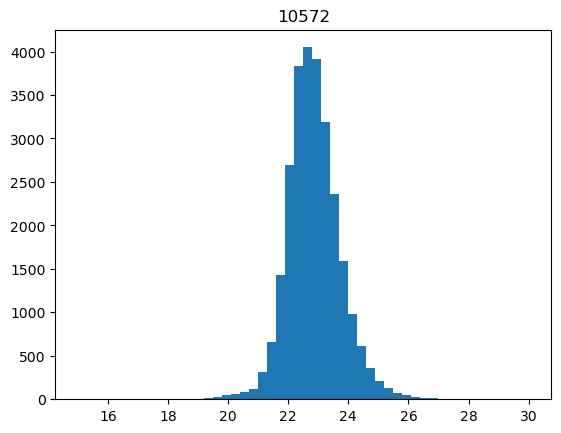

 45%|███████████████████████████████████▊                                           | 487/1075 [01:05<01:16,  7.69it/s]

6248


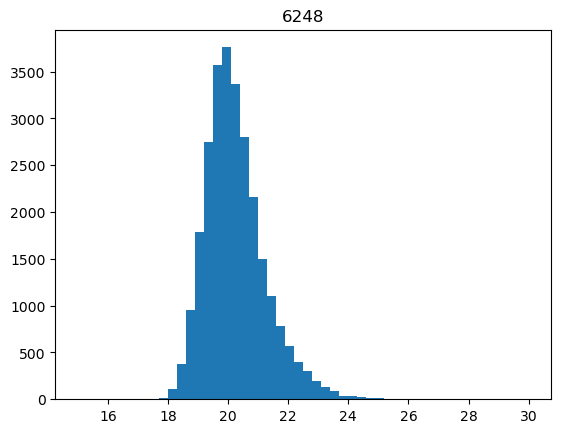

 45%|███████████████████████████████████▊                                           | 488/1075 [01:05<01:16,  7.72it/s]

23632


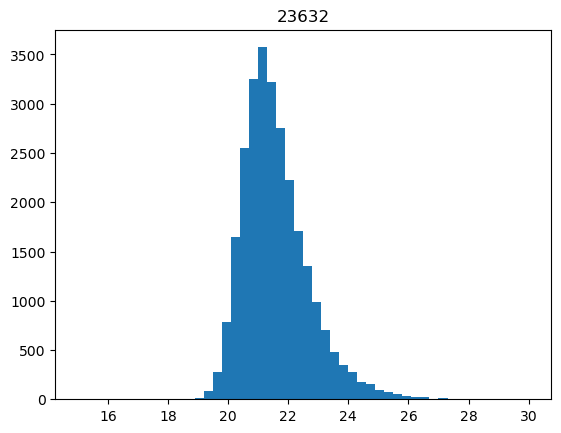

 45%|███████████████████████████████████▉                                           | 489/1075 [01:05<01:15,  7.73it/s]

9993


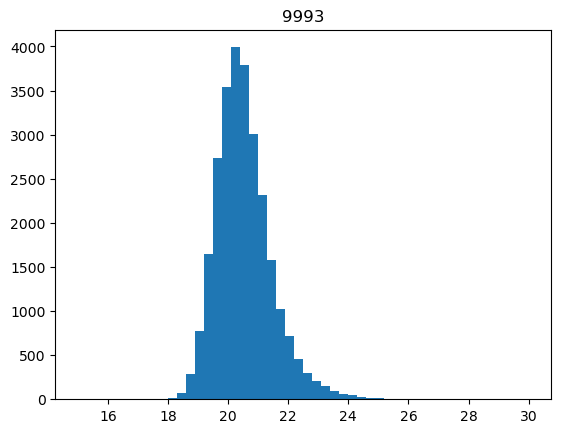

 46%|████████████████████████████████████                                           | 490/1075 [01:05<01:30,  6.45it/s]

14304


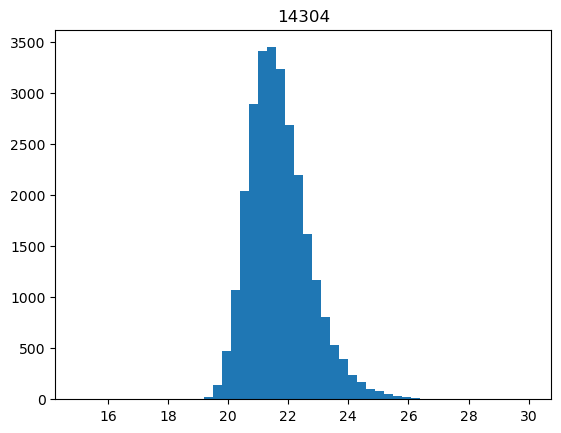

 46%|████████████████████████████████████                                           | 491/1075 [01:05<01:25,  6.85it/s]

22901


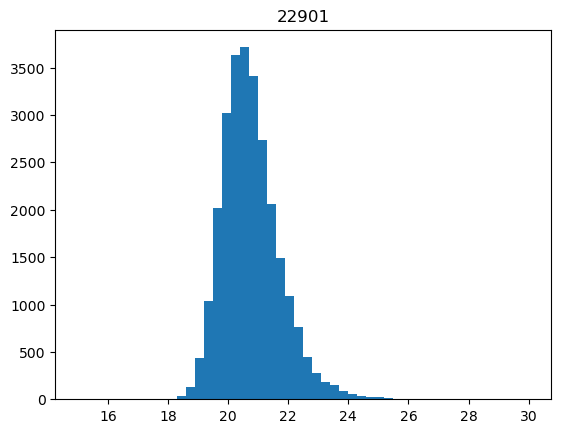

 46%|████████████████████████████████████▏                                          | 492/1075 [01:05<01:21,  7.17it/s]

23522


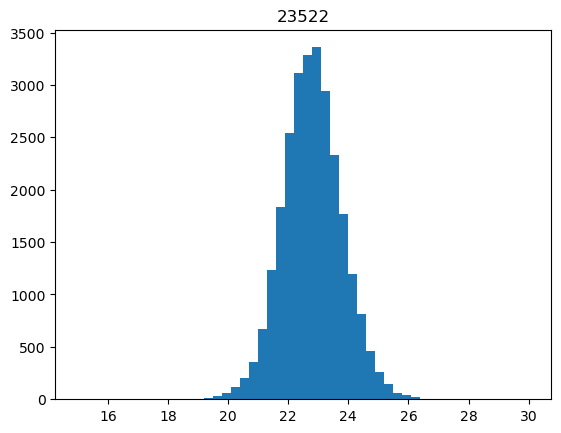

 46%|████████████████████████████████████▏                                          | 493/1075 [01:06<01:19,  7.35it/s]

13882


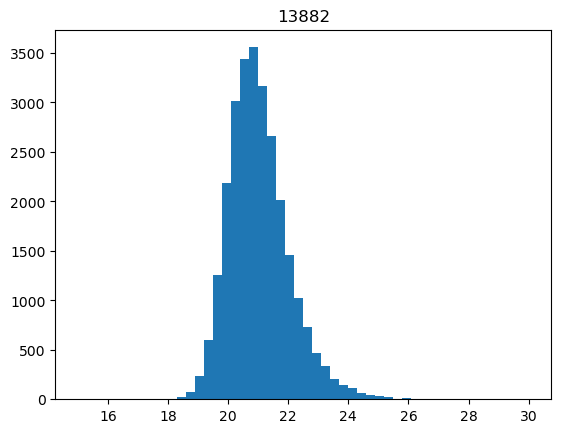

 46%|████████████████████████████████████▎                                          | 494/1075 [01:06<01:17,  7.52it/s]

4841


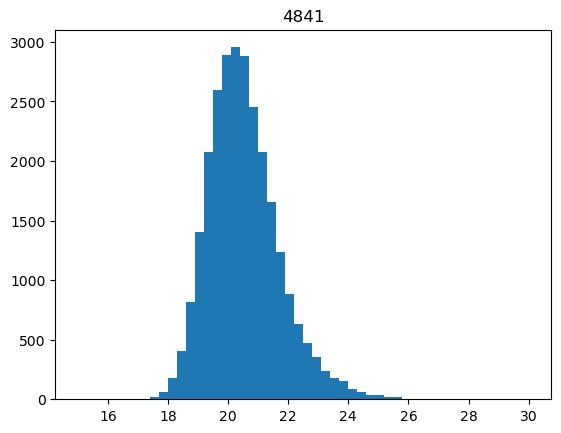

 46%|████████████████████████████████████▍                                          | 495/1075 [01:06<01:16,  7.62it/s]

1322


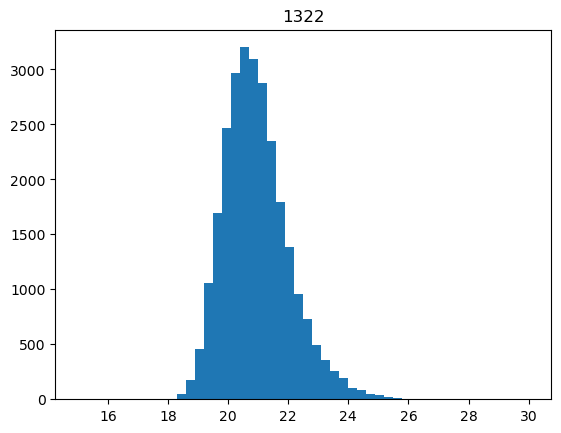

 46%|████████████████████████████████████▍                                          | 496/1075 [01:06<01:14,  7.77it/s]

13744


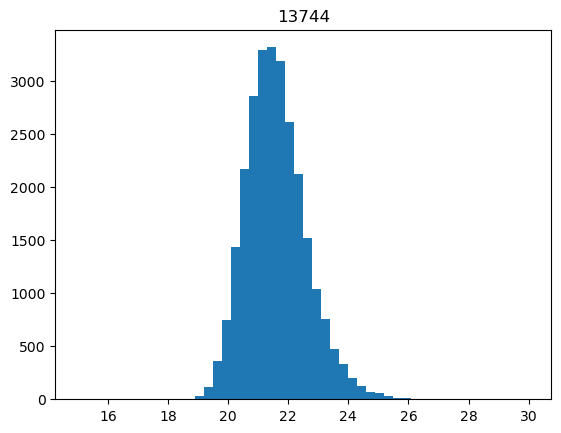

 46%|████████████████████████████████████▌                                          | 497/1075 [01:06<01:13,  7.87it/s]

1520


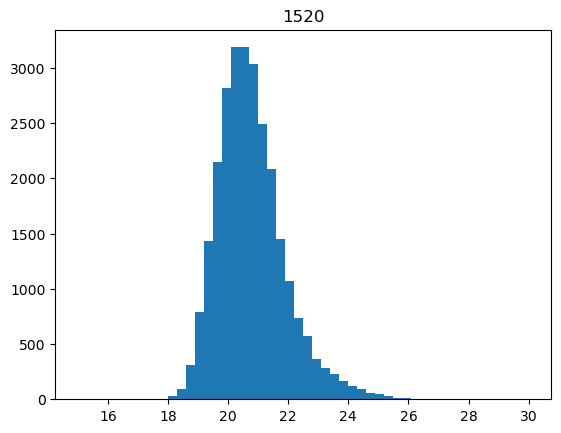

 46%|████████████████████████████████████▌                                          | 498/1075 [01:06<01:12,  7.91it/s]

6804


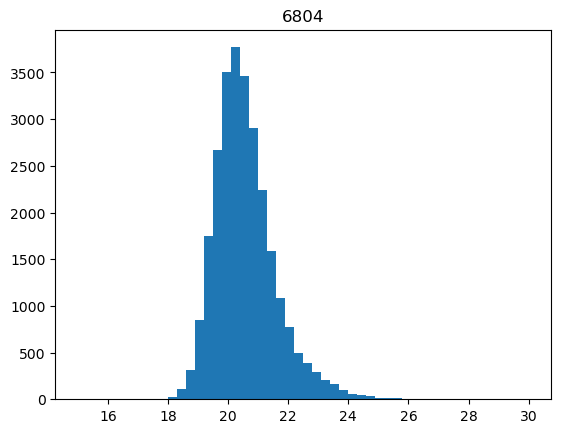

 46%|████████████████████████████████████▋                                          | 499/1075 [01:06<01:12,  7.92it/s]

26017


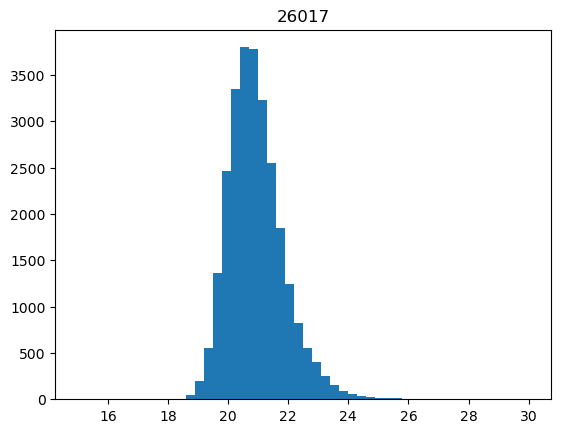

 47%|████████████████████████████████████▋                                          | 500/1075 [01:06<01:12,  7.94it/s]

22275


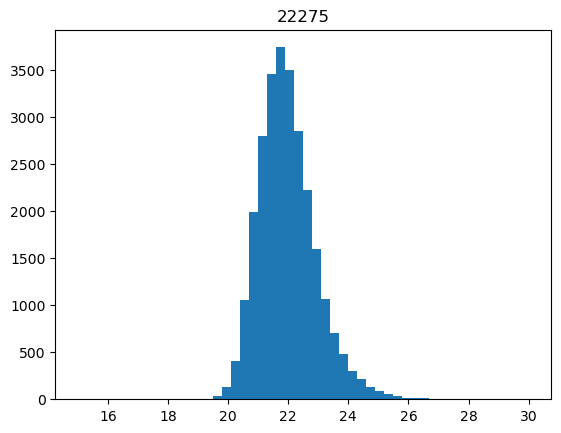

 47%|████████████████████████████████████▊                                          | 501/1075 [01:07<01:26,  6.60it/s]

16572


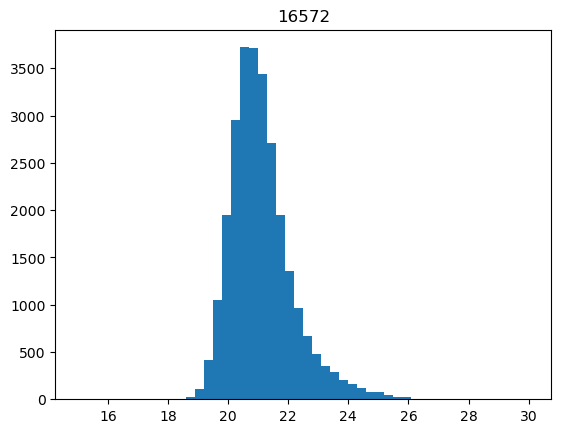

 47%|████████████████████████████████████▉                                          | 502/1075 [01:07<01:21,  7.01it/s]

16824


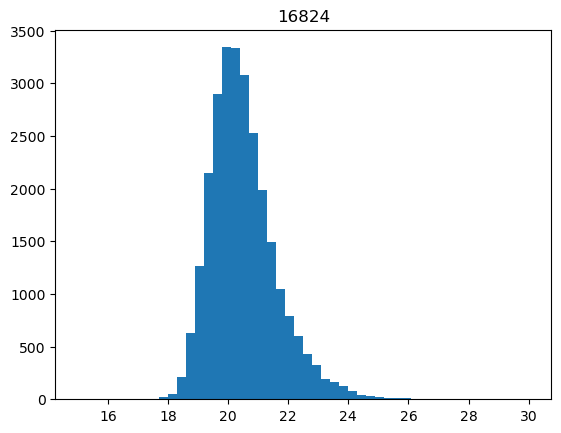

 47%|████████████████████████████████████▉                                          | 503/1075 [01:07<01:18,  7.26it/s]

26635


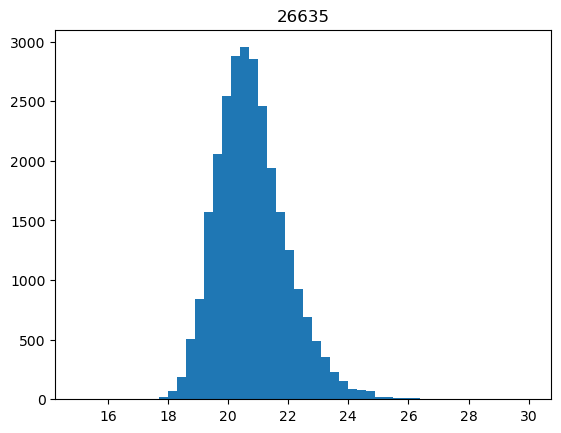

 47%|█████████████████████████████████████                                          | 504/1075 [01:07<01:16,  7.47it/s]

8290


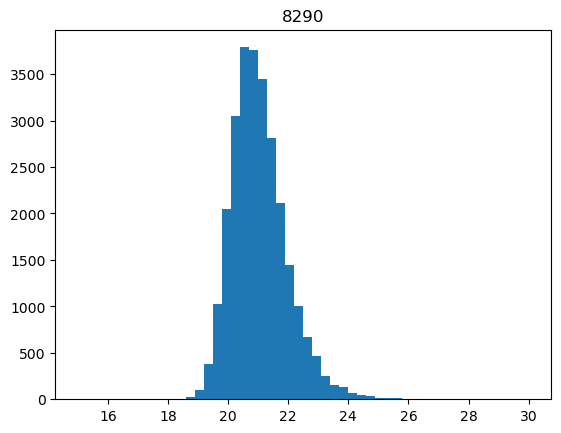

 47%|█████████████████████████████████████                                          | 505/1075 [01:07<01:14,  7.62it/s]

5161


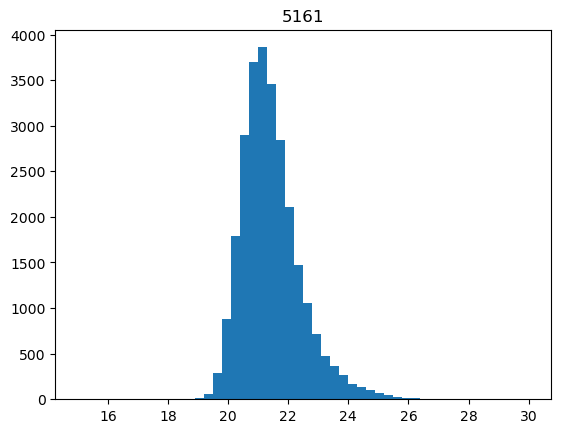

 47%|█████████████████████████████████████▏                                         | 506/1075 [01:07<01:14,  7.66it/s]

9391


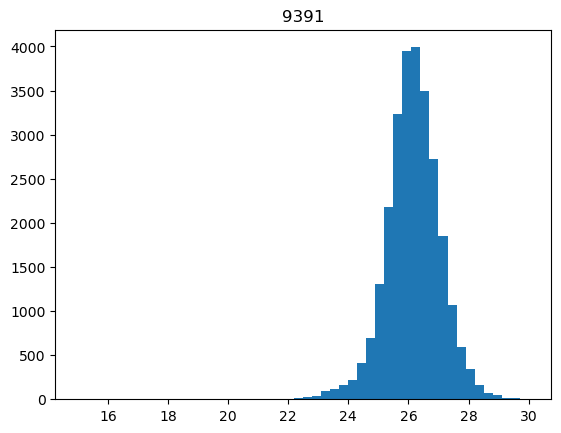

 47%|█████████████████████████████████████▎                                         | 507/1075 [01:07<01:13,  7.74it/s]

24450


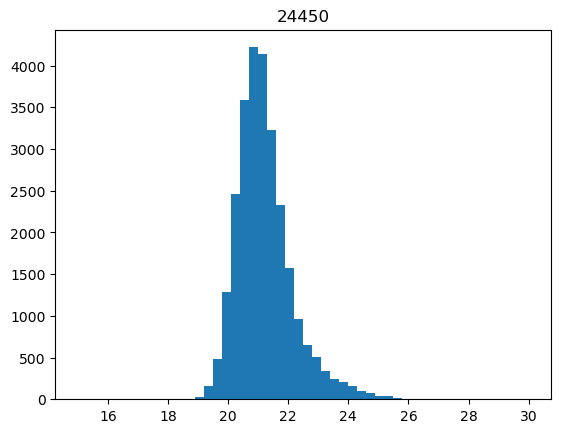

 47%|█████████████████████████████████████▎                                         | 508/1075 [01:07<01:13,  7.69it/s]

11360


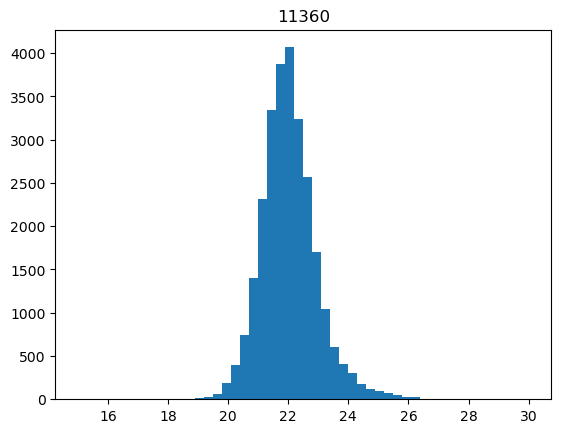

 47%|█████████████████████████████████████▍                                         | 509/1075 [01:08<01:13,  7.73it/s]

14333


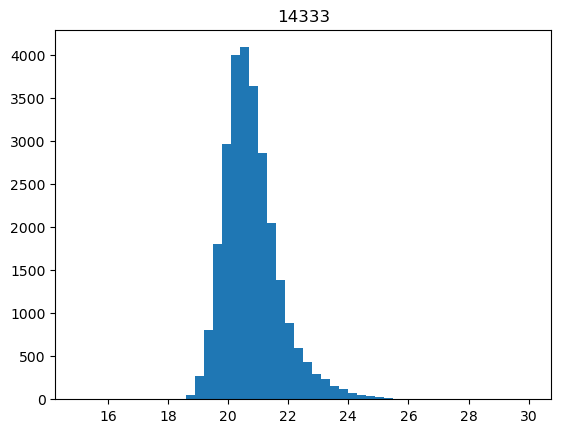

 47%|█████████████████████████████████████▍                                         | 510/1075 [01:08<01:13,  7.73it/s]

2087


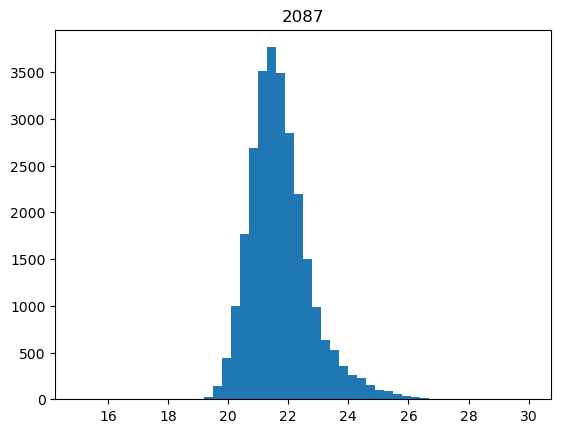

 48%|█████████████████████████████████████▌                                         | 511/1075 [01:08<01:12,  7.81it/s]

7501


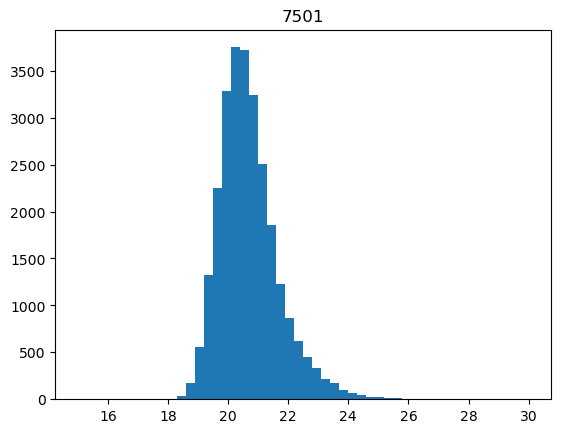

 48%|█████████████████████████████████████▋                                         | 512/1075 [01:08<01:26,  6.51it/s]

10005


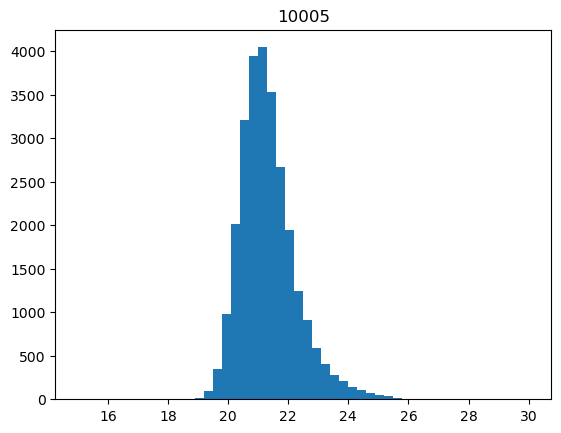

 48%|█████████████████████████████████████▋                                         | 513/1075 [01:08<01:21,  6.85it/s]

17345


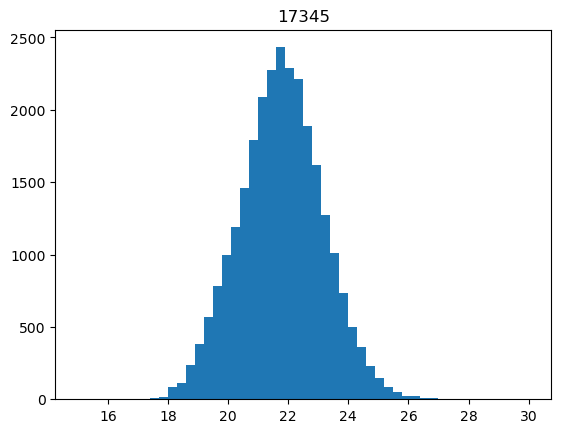

 48%|█████████████████████████████████████▊                                         | 514/1075 [01:08<01:17,  7.22it/s]

3616


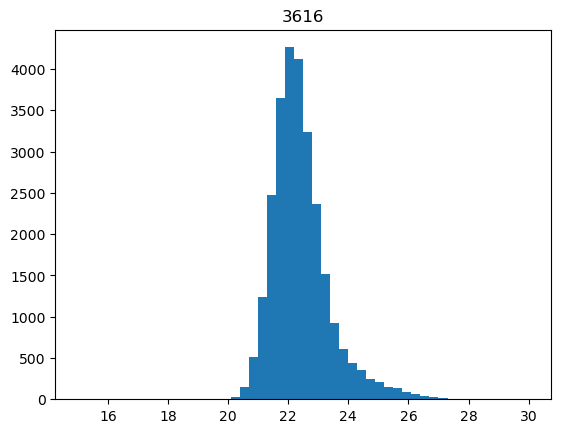

 48%|█████████████████████████████████████▊                                         | 515/1075 [01:08<01:15,  7.39it/s]

7586


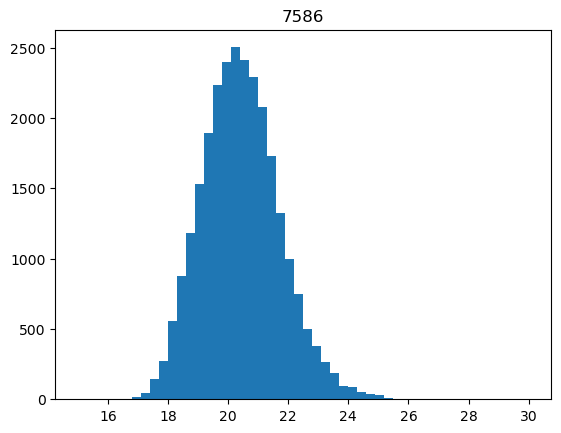

 48%|█████████████████████████████████████▉                                         | 516/1075 [01:09<01:13,  7.61it/s]

6866


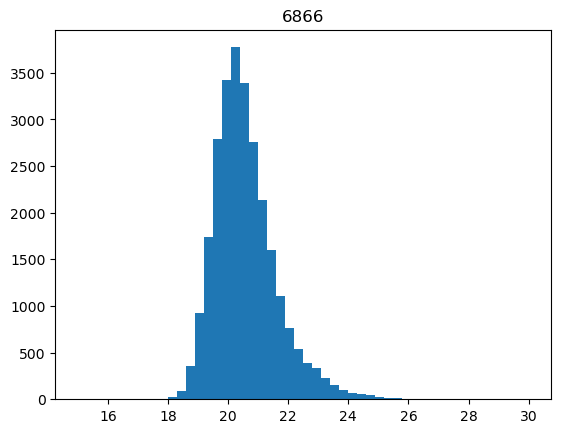

 48%|█████████████████████████████████████▉                                         | 517/1075 [01:09<01:12,  7.74it/s]

14715


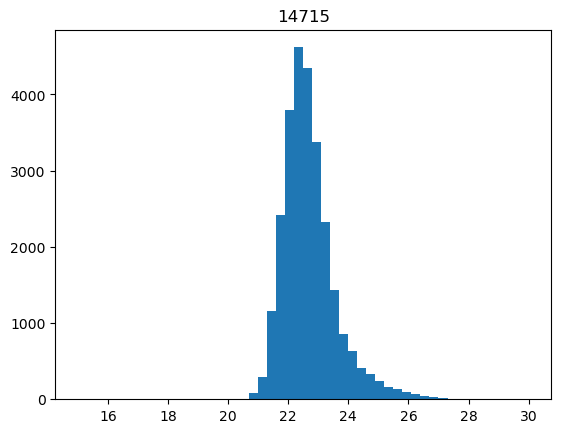

 48%|██████████████████████████████████████                                         | 518/1075 [01:09<01:10,  7.95it/s]

8558


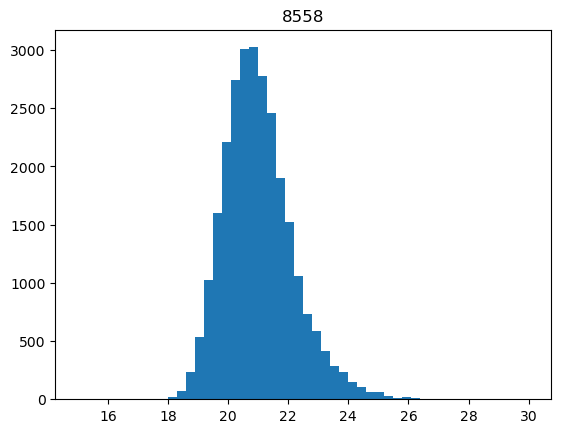

 48%|██████████████████████████████████████▏                                        | 519/1075 [01:09<01:09,  7.98it/s]

2024


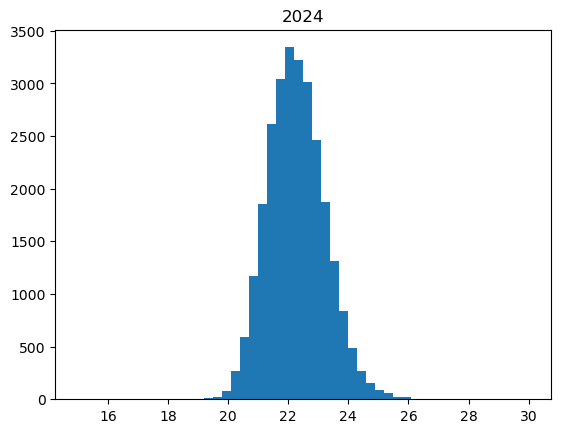

 48%|██████████████████████████████████████▏                                        | 520/1075 [01:09<01:10,  7.91it/s]

24815


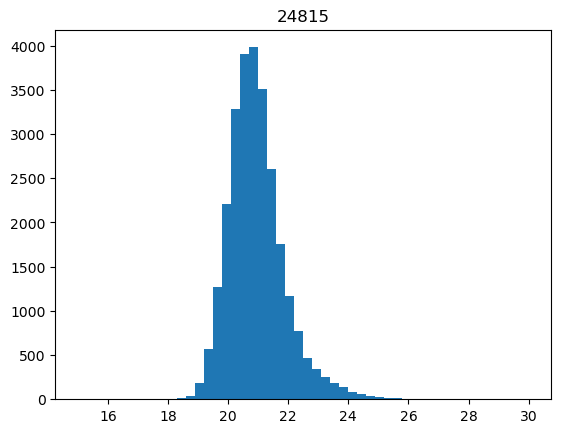

 48%|██████████████████████████████████████▎                                        | 521/1075 [01:09<01:11,  7.75it/s]

16547


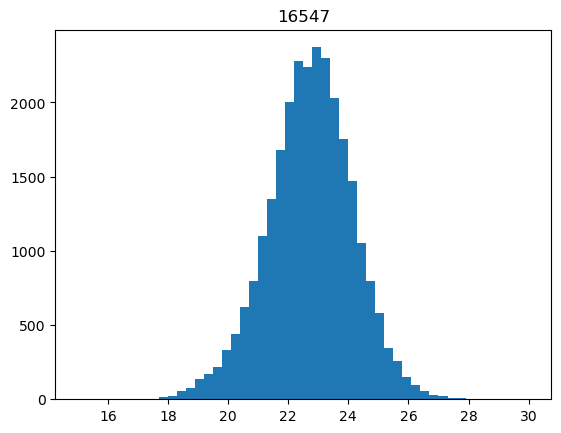

 49%|██████████████████████████████████████▎                                        | 522/1075 [01:09<01:11,  7.77it/s]

4842


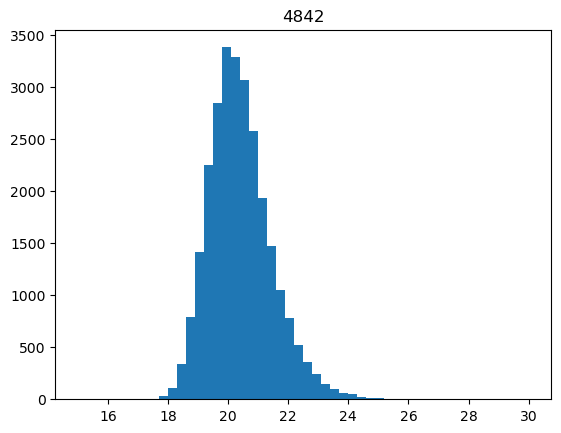

 49%|██████████████████████████████████████▍                                        | 523/1075 [01:10<01:24,  6.51it/s]

22905


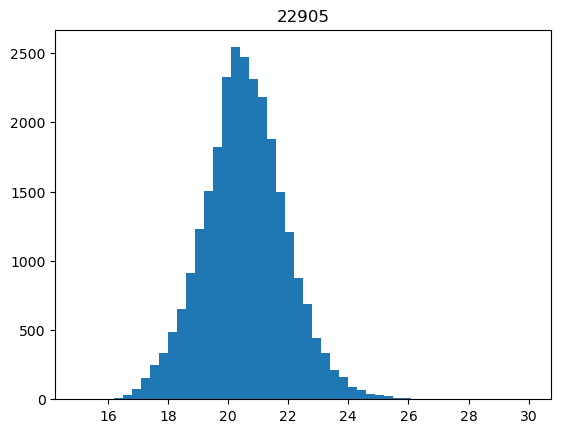

 49%|██████████████████████████████████████▌                                        | 524/1075 [01:10<01:19,  6.93it/s]

11325


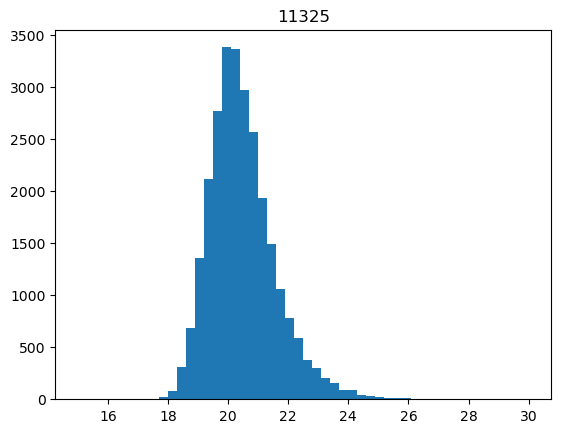

 49%|██████████████████████████████████████▌                                        | 525/1075 [01:10<01:16,  7.22it/s]

21567


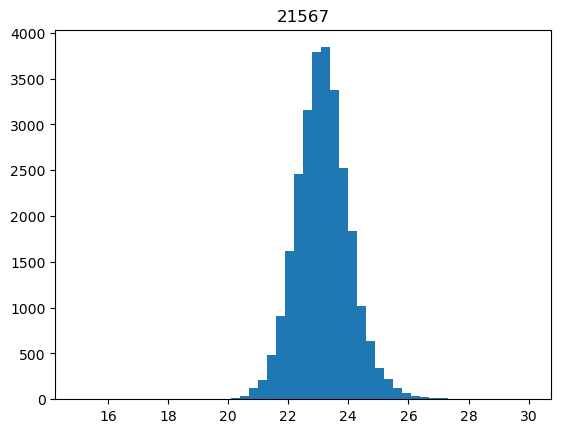

 49%|██████████████████████████████████████▋                                        | 526/1075 [01:10<01:13,  7.42it/s]

24756


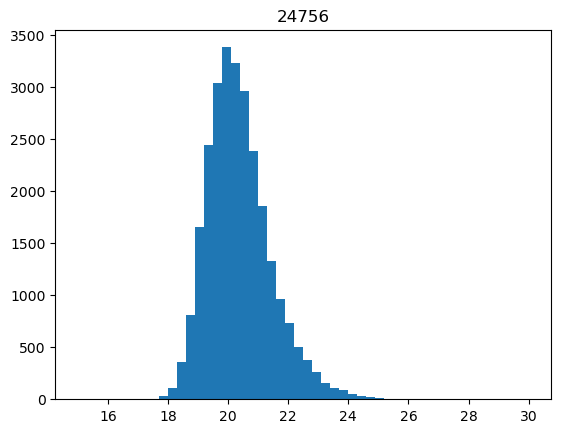

 49%|██████████████████████████████████████▋                                        | 527/1075 [01:10<01:12,  7.60it/s]

26765


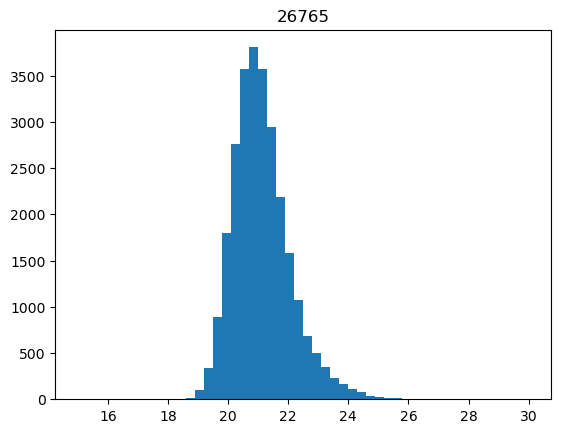

 49%|██████████████████████████████████████▊                                        | 528/1075 [01:10<01:11,  7.66it/s]

5123


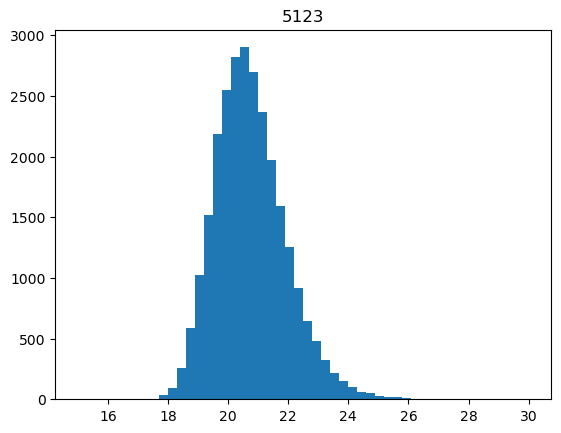

 49%|██████████████████████████████████████▉                                        | 529/1075 [01:10<01:10,  7.80it/s]

16490


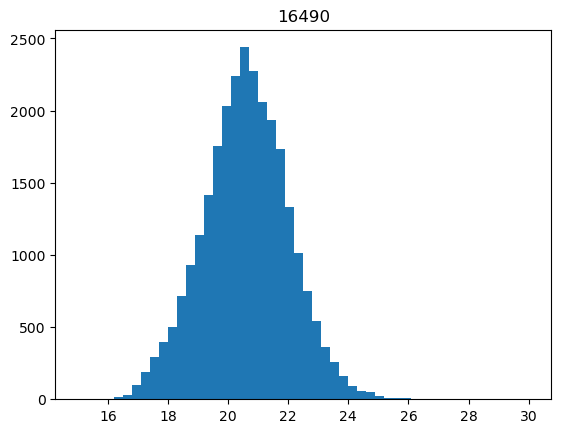

 49%|██████████████████████████████████████▉                                        | 530/1075 [01:10<01:08,  7.93it/s]

4103


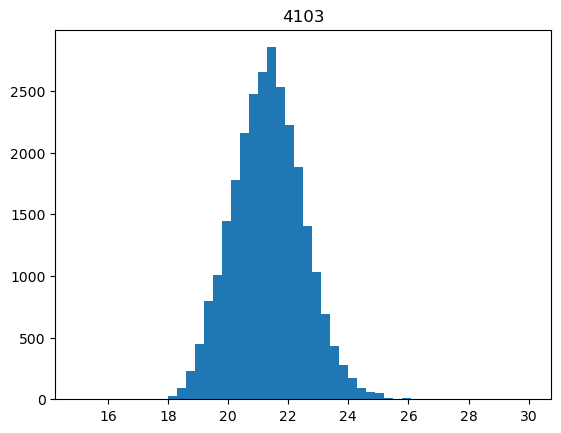

 49%|███████████████████████████████████████                                        | 531/1075 [01:11<01:08,  7.95it/s]

833


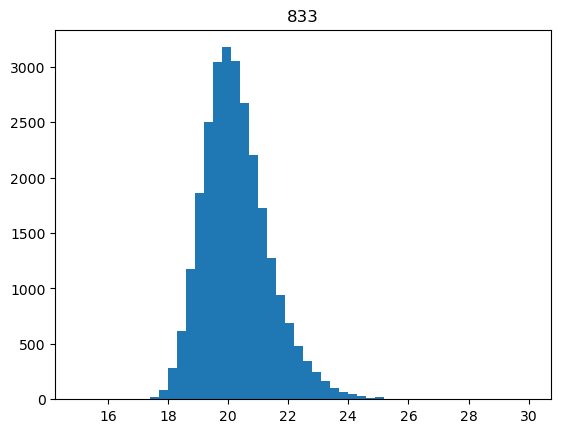

 49%|███████████████████████████████████████                                        | 532/1075 [01:11<01:08,  7.95it/s]

8481


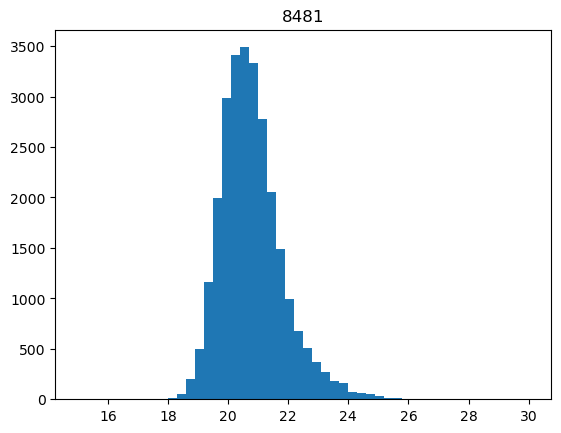

 50%|███████████████████████████████████████▏                                       | 533/1075 [01:11<01:08,  7.89it/s]

7218


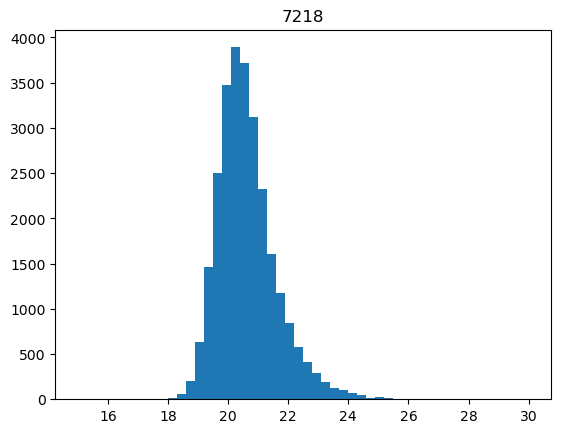

 50%|███████████████████████████████████████▏                                       | 534/1075 [01:11<01:23,  6.47it/s]

480


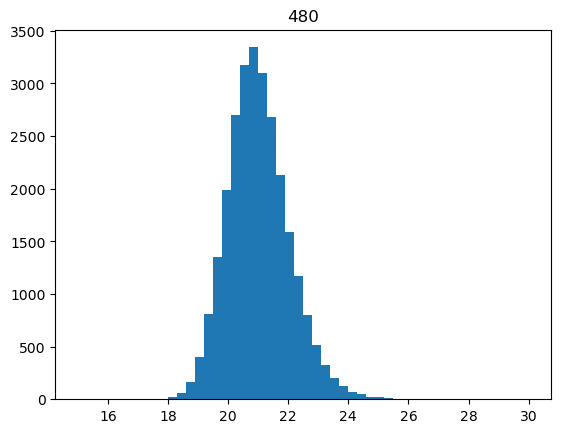

 50%|███████████████████████████████████████▎                                       | 535/1075 [01:11<01:18,  6.84it/s]

11507


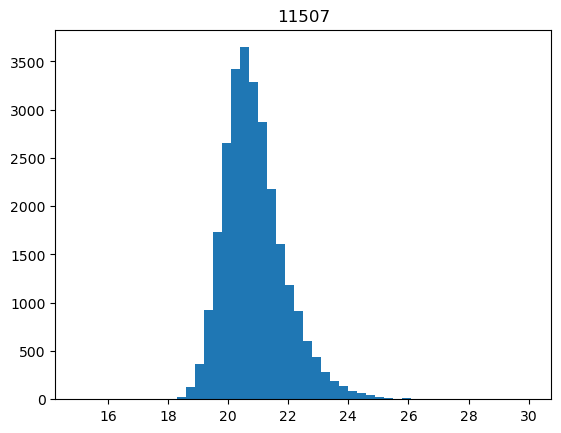

 50%|███████████████████████████████████████▍                                       | 536/1075 [01:11<01:15,  7.15it/s]

20604


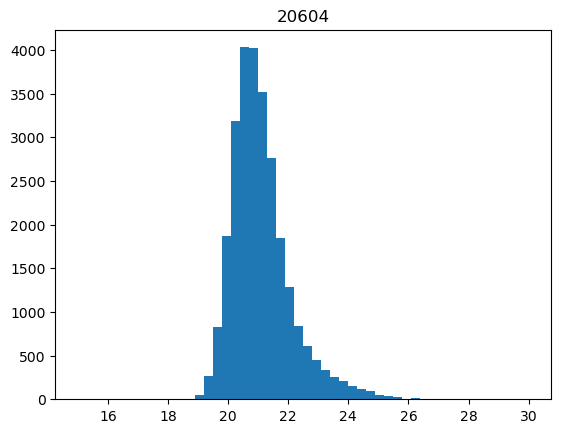

 50%|███████████████████████████████████████▍                                       | 537/1075 [01:11<01:13,  7.35it/s]

12204


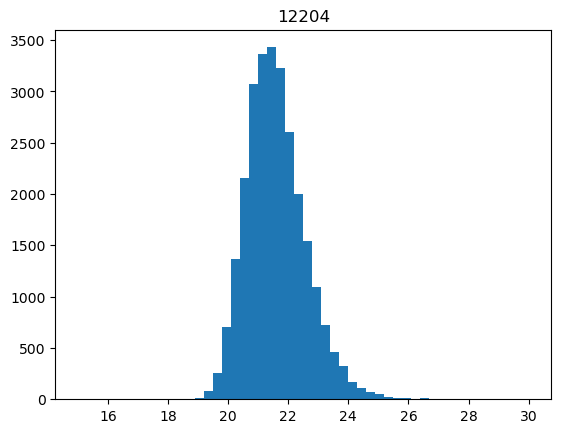

 50%|███████████████████████████████████████▌                                       | 538/1075 [01:12<01:11,  7.50it/s]

2570


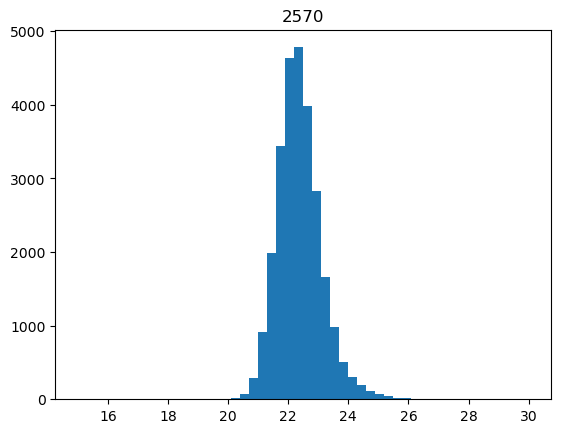

 50%|███████████████████████████████████████▌                                       | 539/1075 [01:12<01:09,  7.70it/s]

705


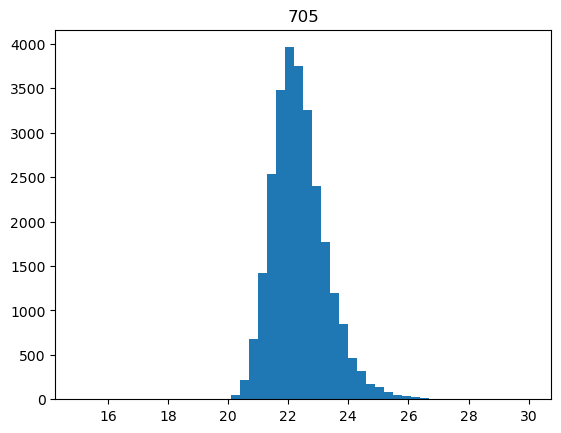

 50%|███████████████████████████████████████▋                                       | 540/1075 [01:12<01:09,  7.66it/s]

5307


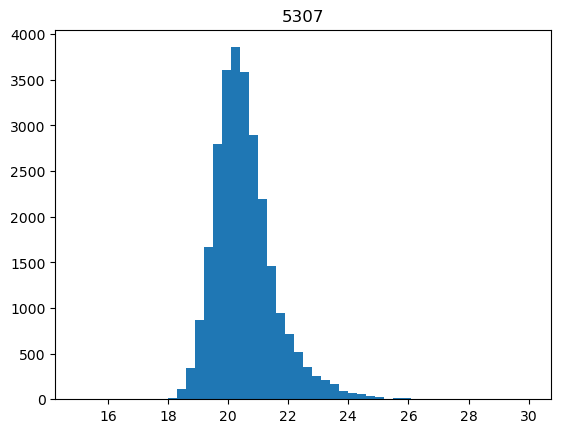

 50%|███████████████████████████████████████▊                                       | 541/1075 [01:12<01:09,  7.69it/s]

4832


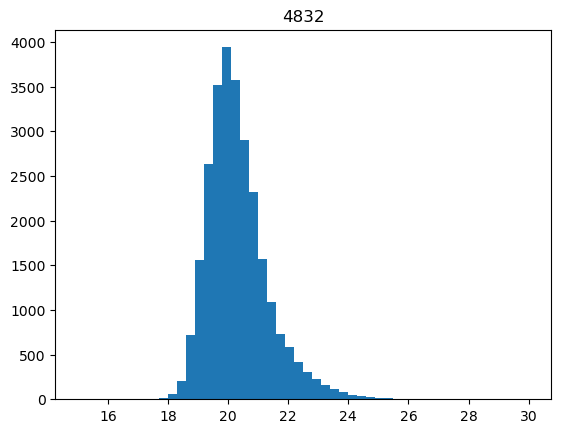

 50%|███████████████████████████████████████▊                                       | 542/1075 [01:12<01:08,  7.76it/s]

22524


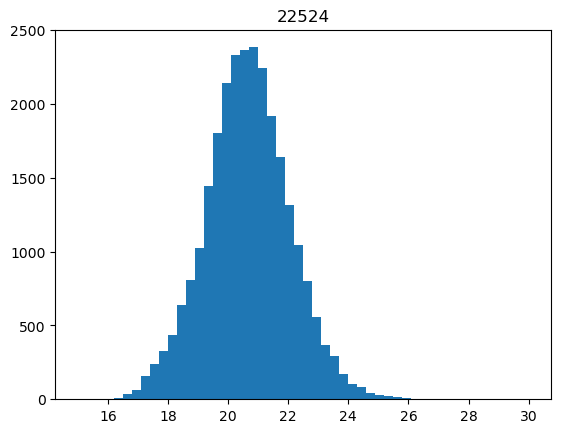

 51%|███████████████████████████████████████▉                                       | 543/1075 [01:12<01:07,  7.88it/s]

25363


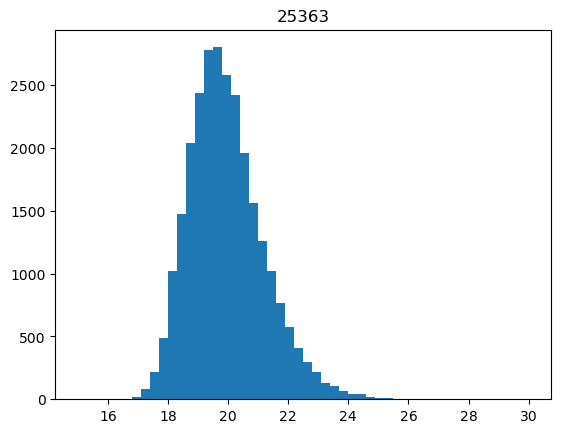

 51%|███████████████████████████████████████▉                                       | 544/1075 [01:12<01:06,  7.94it/s]

20206


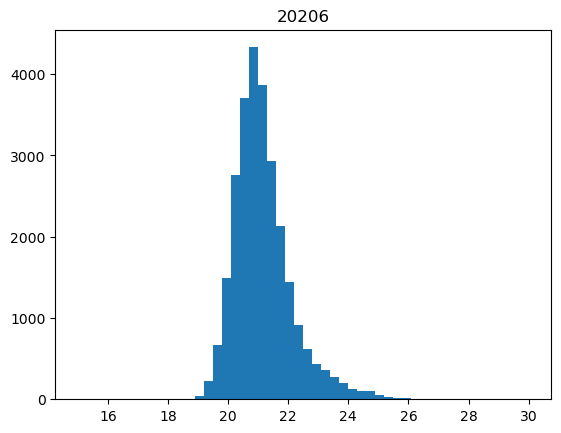

 51%|████████████████████████████████████████                                       | 545/1075 [01:12<01:19,  6.68it/s]

11557


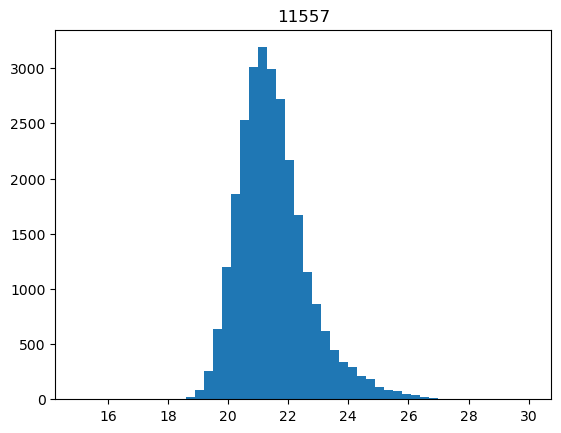

 51%|████████████████████████████████████████                                       | 546/1075 [01:13<01:14,  7.09it/s]

6344


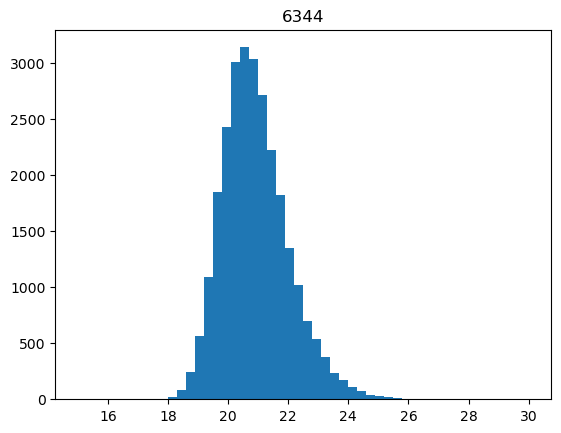

 51%|████████████████████████████████████████▏                                      | 547/1075 [01:13<01:11,  7.34it/s]

22926


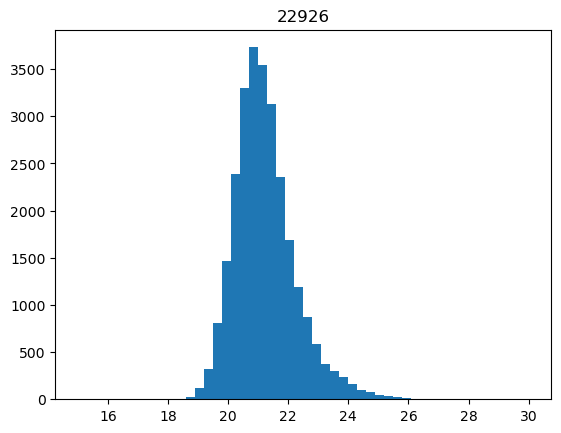

 51%|████████████████████████████████████████▎                                      | 548/1075 [01:13<01:10,  7.44it/s]

5021


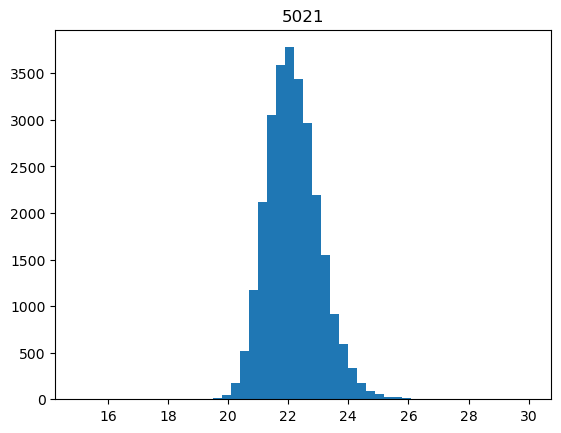

 51%|████████████████████████████████████████▎                                      | 549/1075 [01:13<01:09,  7.58it/s]

6141


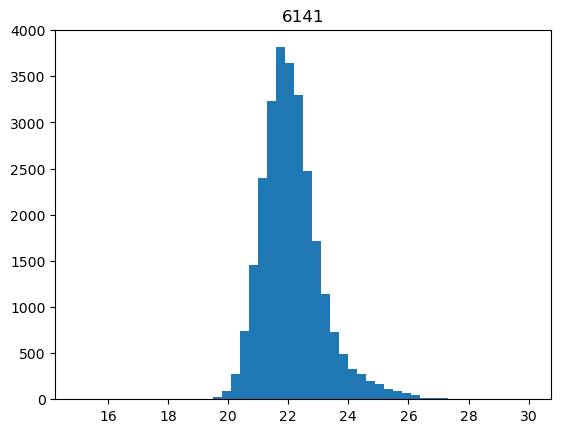

 51%|████████████████████████████████████████▍                                      | 550/1075 [01:13<01:08,  7.67it/s]

17561


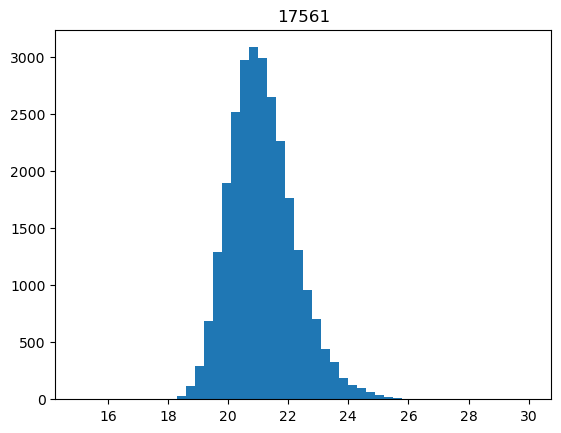

 51%|████████████████████████████████████████▍                                      | 551/1075 [01:13<01:07,  7.76it/s]

13214


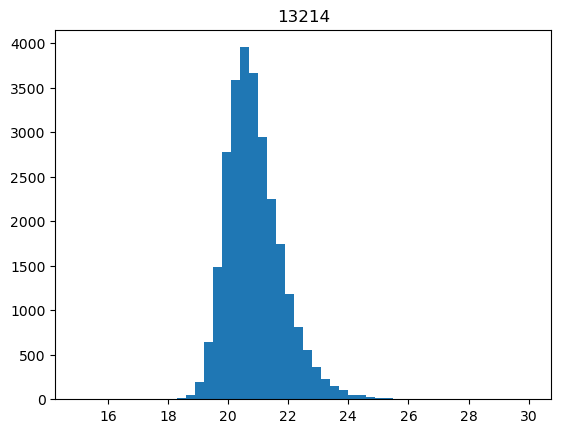

 51%|████████████████████████████████████████▌                                      | 552/1075 [01:13<01:07,  7.78it/s]

3449


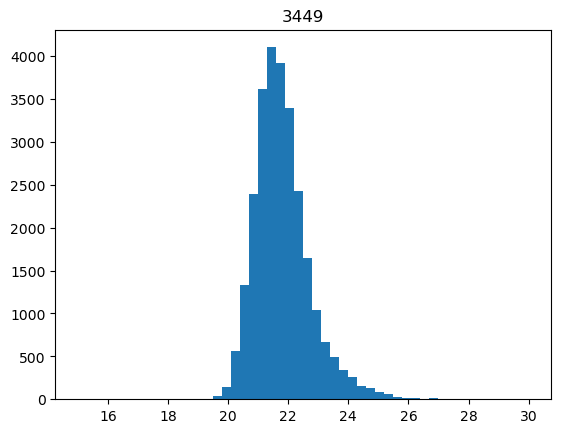

 51%|████████████████████████████████████████▋                                      | 553/1075 [01:14<01:07,  7.79it/s]

15914


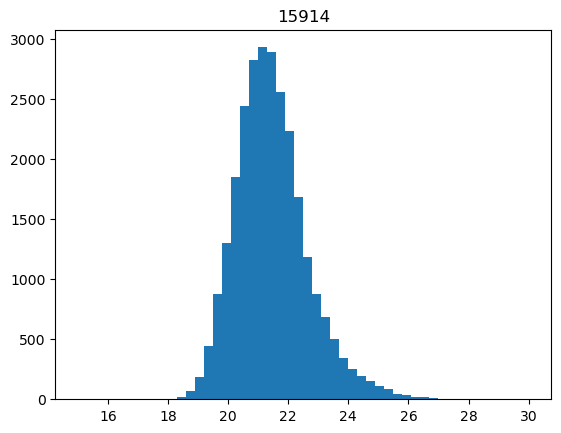

 52%|████████████████████████████████████████▋                                      | 554/1075 [01:14<01:06,  7.89it/s]

20891


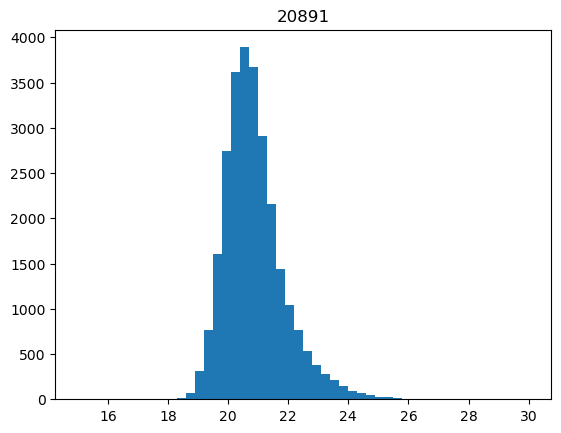

 52%|████████████████████████████████████████▊                                      | 555/1075 [01:14<01:06,  7.86it/s]

2810


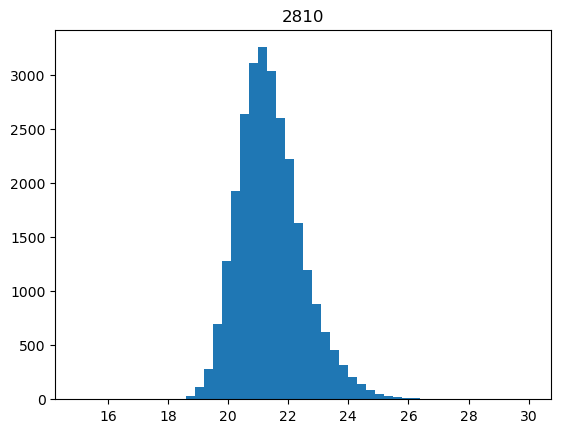

 52%|████████████████████████████████████████▊                                      | 556/1075 [01:14<01:18,  6.63it/s]

15767


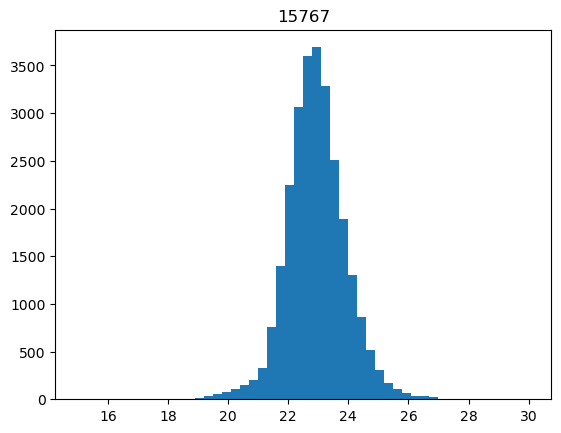

 52%|████████████████████████████████████████▉                                      | 557/1075 [01:14<01:13,  7.02it/s]

21668


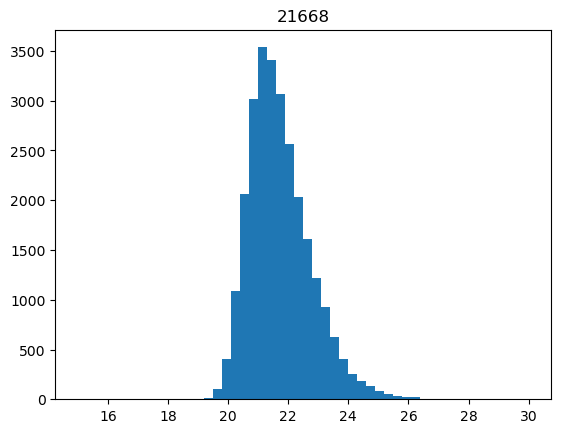

 52%|█████████████████████████████████████████                                      | 558/1075 [01:14<01:10,  7.29it/s]

22873


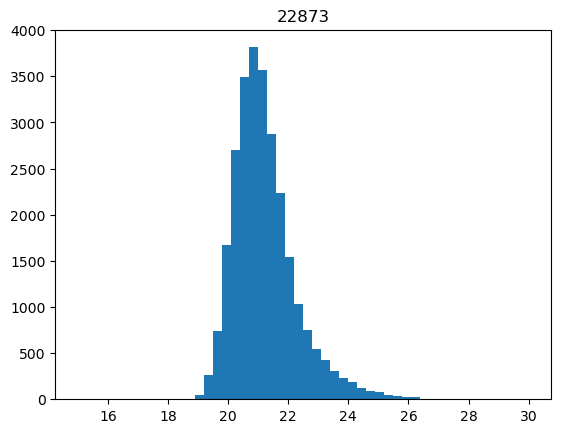

 52%|█████████████████████████████████████████                                      | 559/1075 [01:14<01:09,  7.44it/s]

18001


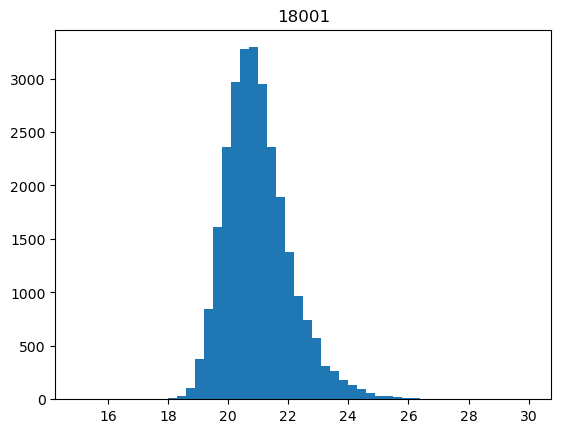

 52%|█████████████████████████████████████████▏                                     | 560/1075 [01:14<01:07,  7.58it/s]

16782


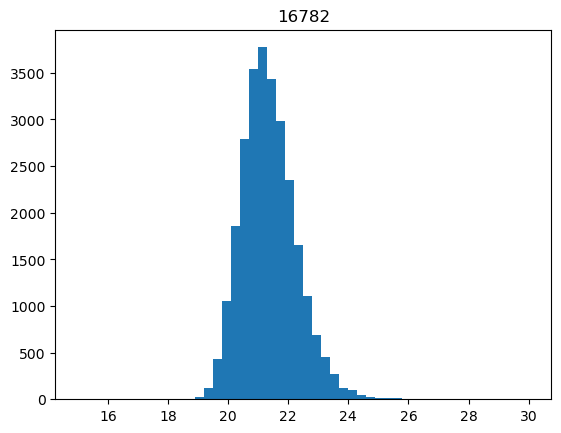

 52%|█████████████████████████████████████████▏                                     | 561/1075 [01:15<01:06,  7.70it/s]

24755


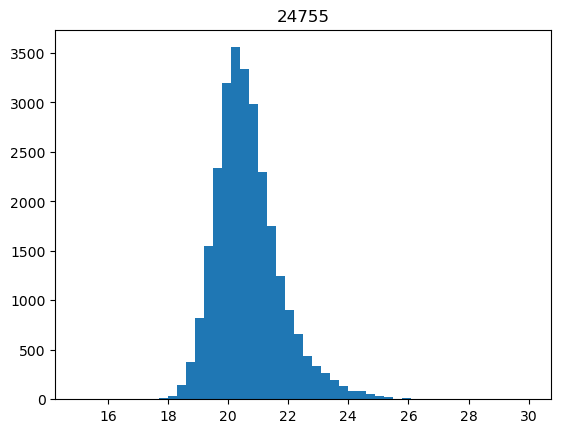

 52%|█████████████████████████████████████████▎                                     | 562/1075 [01:15<01:06,  7.77it/s]

6168


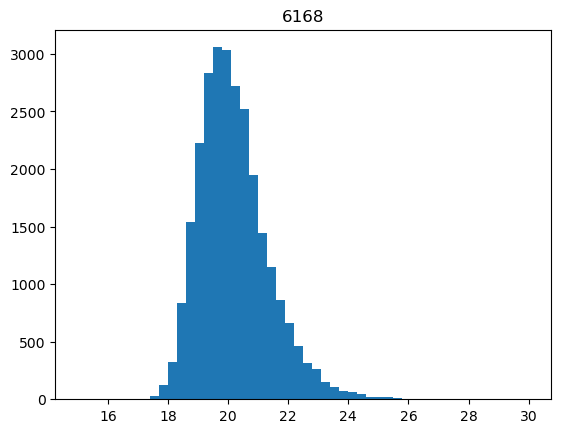

 52%|█████████████████████████████████████████▎                                     | 563/1075 [01:15<01:05,  7.87it/s]

25628


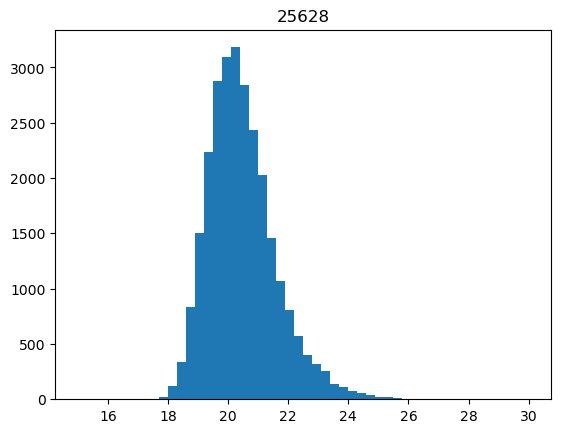

 52%|█████████████████████████████████████████▍                                     | 564/1075 [01:15<01:04,  7.93it/s]

658


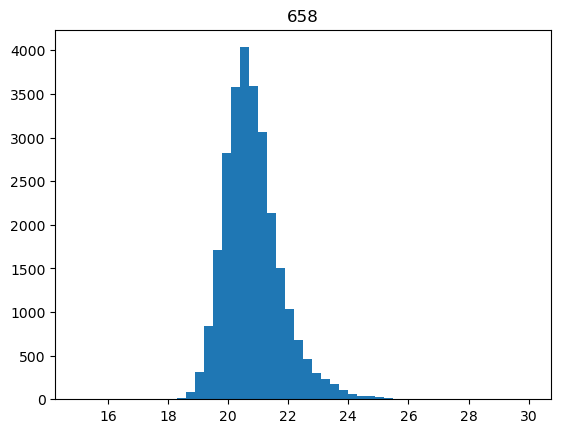

 53%|█████████████████████████████████████████▌                                     | 565/1075 [01:15<01:04,  7.93it/s]

19924


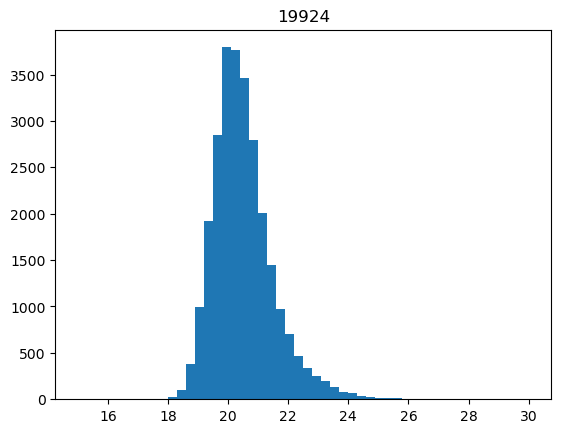

 53%|█████████████████████████████████████████▌                                     | 566/1075 [01:15<01:04,  7.93it/s]

10516


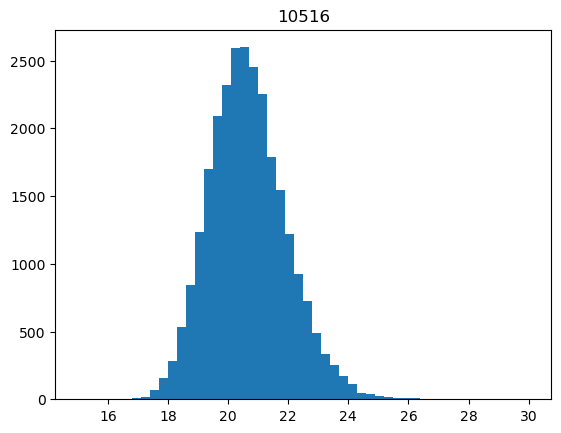

 53%|█████████████████████████████████████████▋                                     | 567/1075 [01:15<01:16,  6.64it/s]

20936


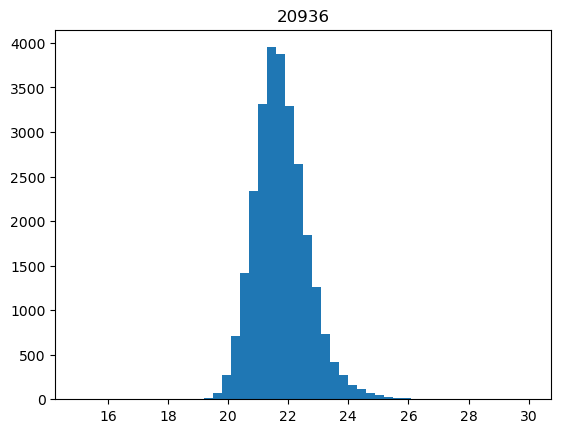

 53%|█████████████████████████████████████████▋                                     | 568/1075 [01:16<01:12,  7.01it/s]

22891


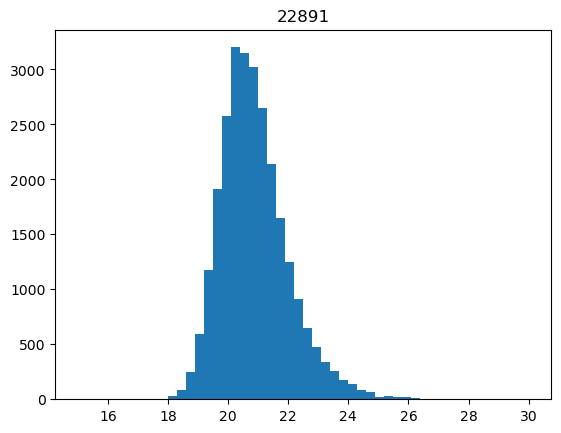

 53%|█████████████████████████████████████████▊                                     | 569/1075 [01:16<01:09,  7.30it/s]

19320


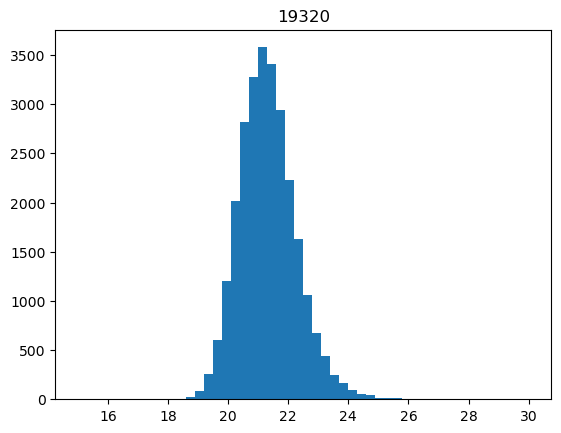

 53%|█████████████████████████████████████████▉                                     | 570/1075 [01:16<01:07,  7.49it/s]

1575


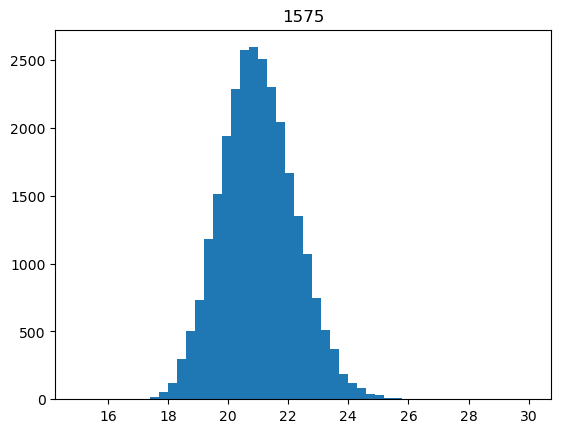

 53%|█████████████████████████████████████████▉                                     | 571/1075 [01:16<01:05,  7.69it/s]

21361


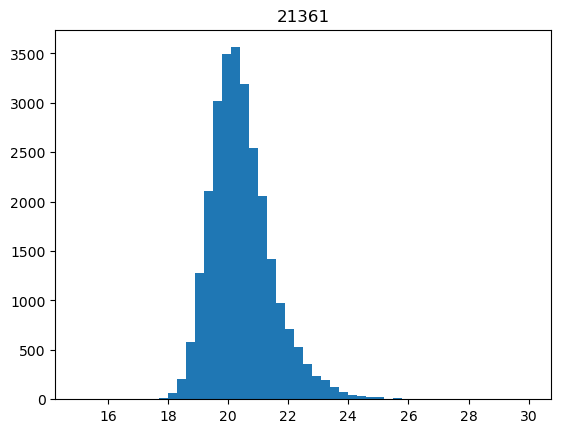

 53%|██████████████████████████████████████████                                     | 572/1075 [01:16<01:04,  7.76it/s]

2811


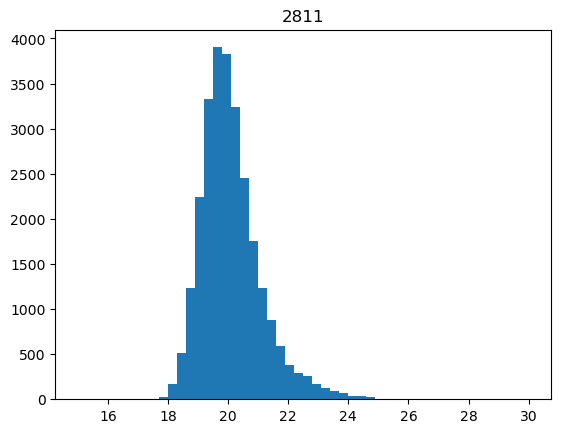

 53%|██████████████████████████████████████████                                     | 573/1075 [01:16<01:04,  7.81it/s]

5486


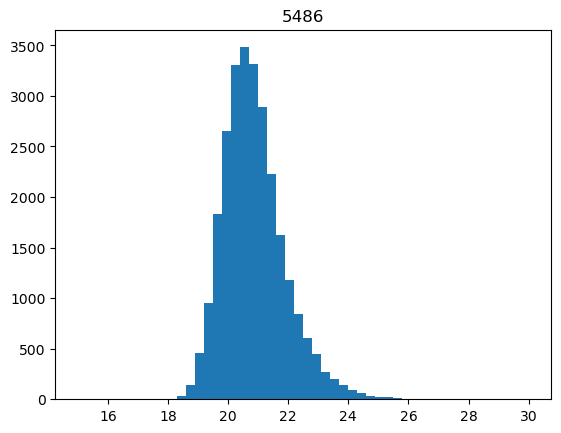

 53%|██████████████████████████████████████████▏                                    | 574/1075 [01:16<01:03,  7.85it/s]

15167


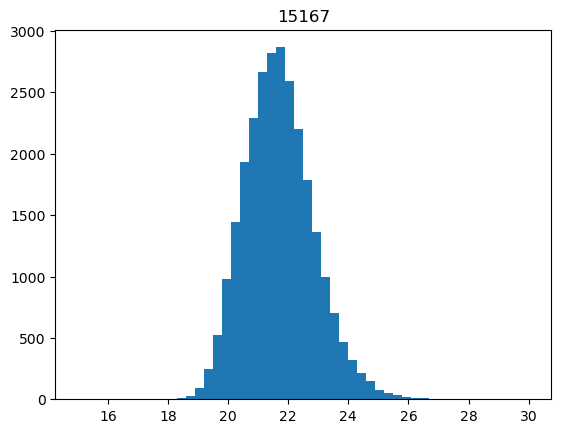

 53%|██████████████████████████████████████████▎                                    | 575/1075 [01:16<01:03,  7.91it/s]

17105


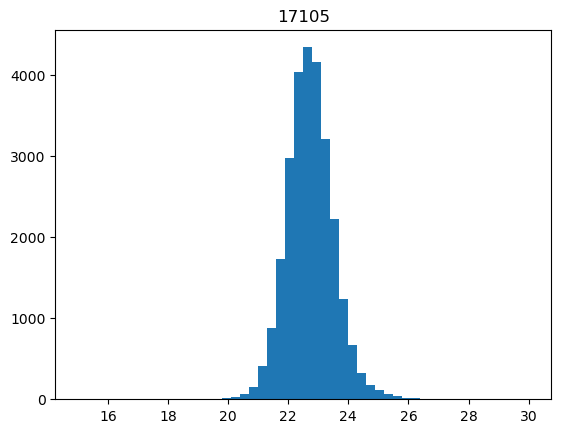

 54%|██████████████████████████████████████████▎                                    | 576/1075 [01:17<01:02,  8.01it/s]

1898


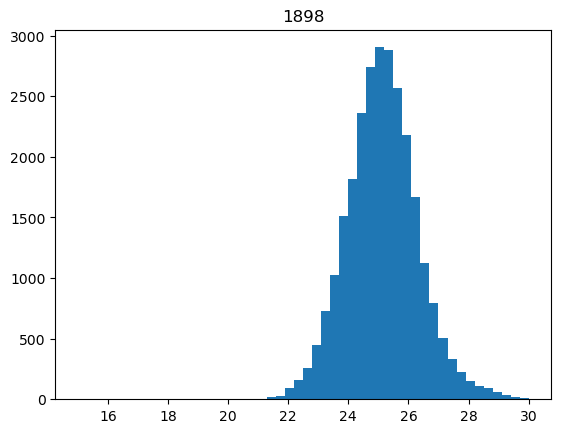

 54%|██████████████████████████████████████████▍                                    | 577/1075 [01:17<01:01,  8.07it/s]

23612


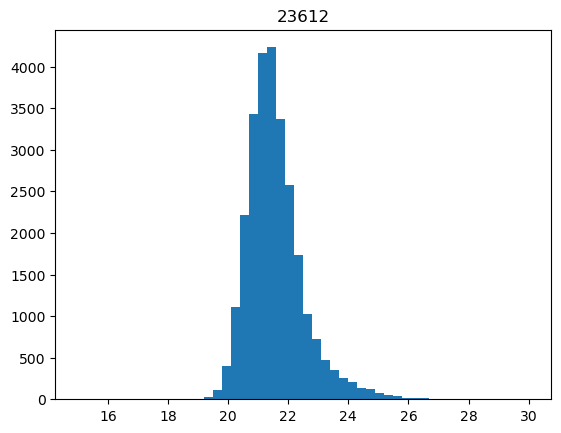

 54%|██████████████████████████████████████████▍                                    | 578/1075 [01:17<01:14,  6.70it/s]

9886


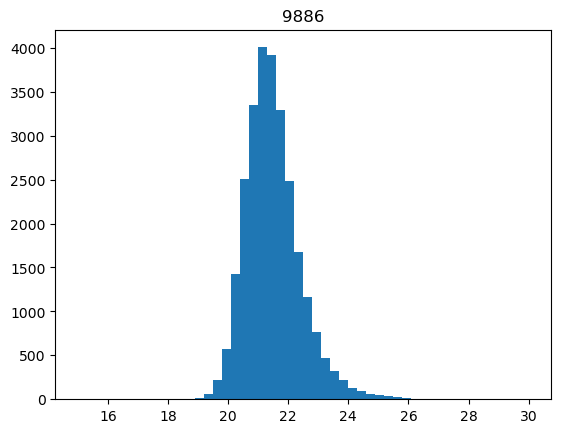

 54%|██████████████████████████████████████████▌                                    | 579/1075 [01:17<01:10,  7.03it/s]

23700


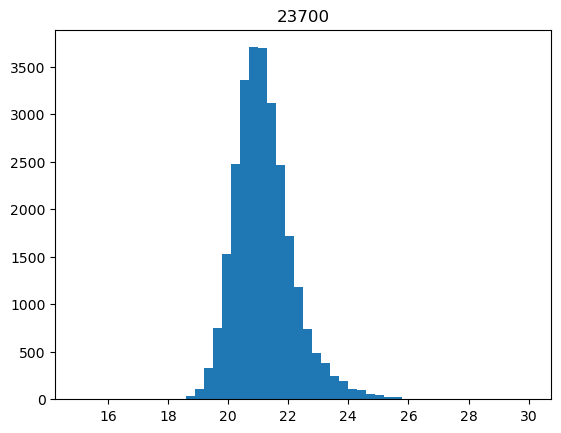

 54%|██████████████████████████████████████████▌                                    | 580/1075 [01:17<01:08,  7.23it/s]

18917


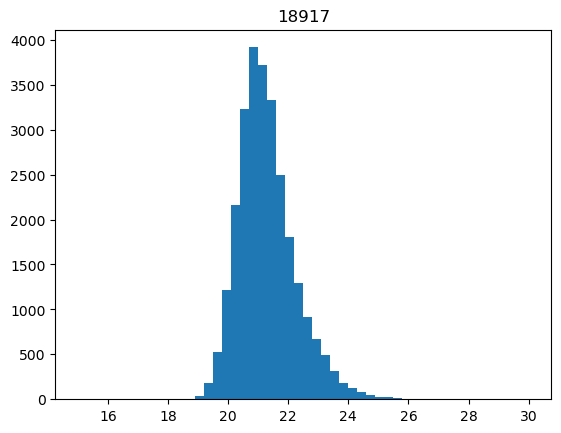

 54%|██████████████████████████████████████████▋                                    | 581/1075 [01:17<01:06,  7.38it/s]

10802


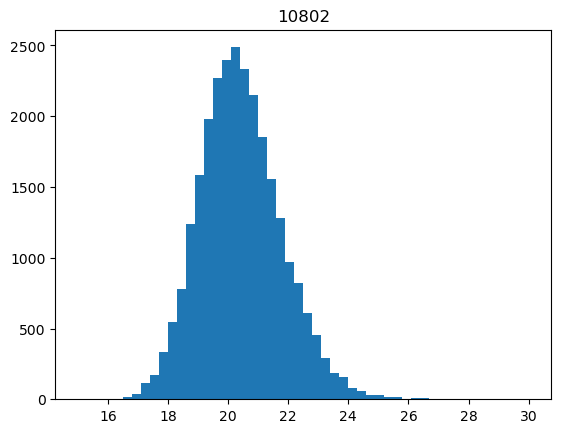

 54%|██████████████████████████████████████████▊                                    | 582/1075 [01:17<01:04,  7.59it/s]

2419


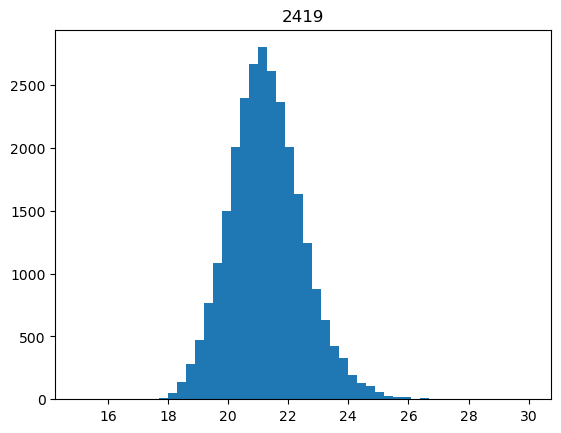

 54%|██████████████████████████████████████████▊                                    | 583/1075 [01:18<01:03,  7.73it/s]

5531


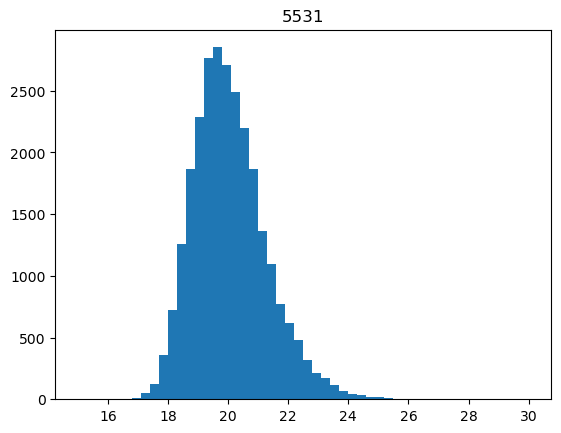

 54%|██████████████████████████████████████████▉                                    | 584/1075 [01:18<01:02,  7.84it/s]

6184


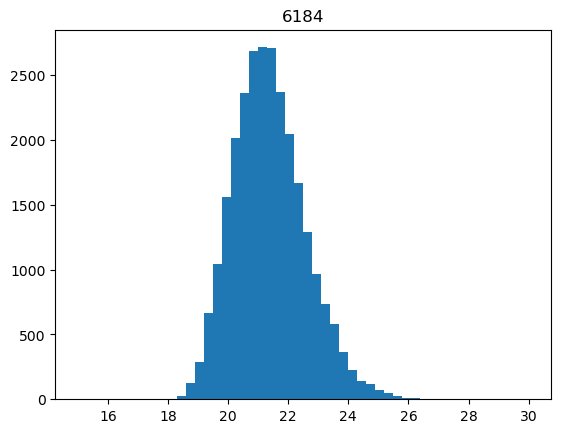

 54%|██████████████████████████████████████████▉                                    | 585/1075 [01:18<01:01,  7.98it/s]

981


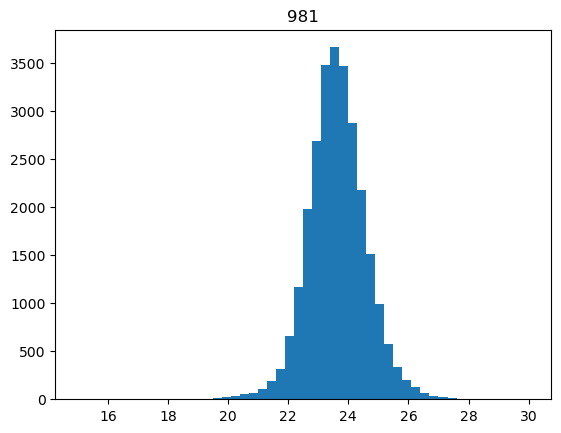

 55%|███████████████████████████████████████████                                    | 586/1075 [01:18<01:01,  7.99it/s]

24007


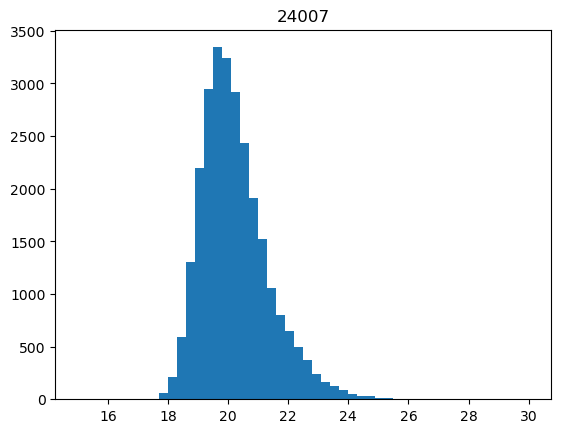

 55%|███████████████████████████████████████████▏                                   | 587/1075 [01:18<01:00,  8.01it/s]

10009


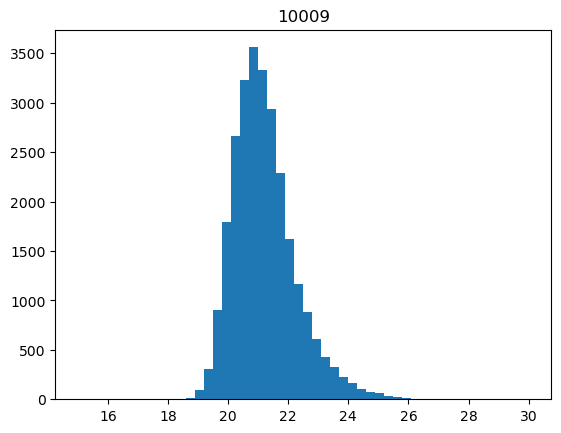

 55%|███████████████████████████████████████████▏                                   | 588/1075 [01:18<01:00,  8.01it/s]

9252


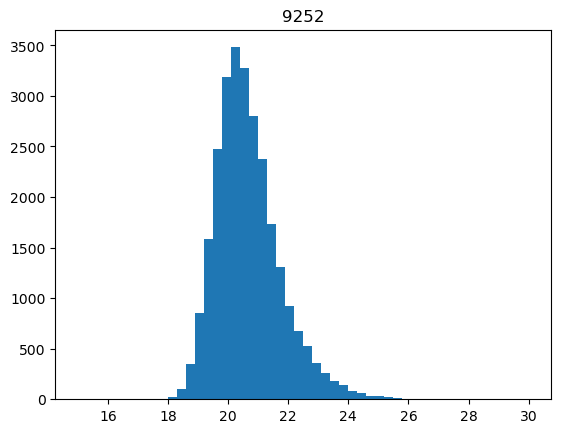

 55%|███████████████████████████████████████████▎                                   | 589/1075 [01:18<01:12,  6.70it/s]

24289


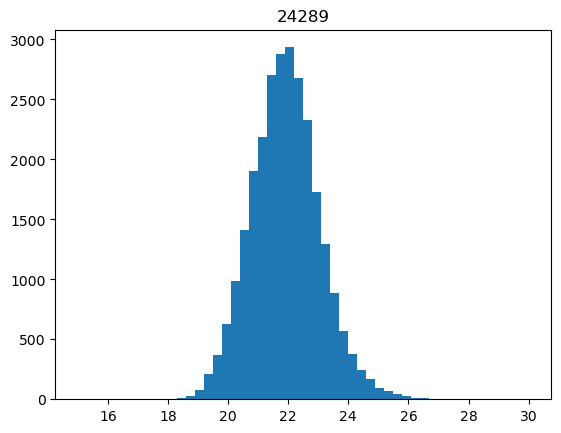

 55%|███████████████████████████████████████████▎                                   | 590/1075 [01:18<01:08,  7.06it/s]

8656


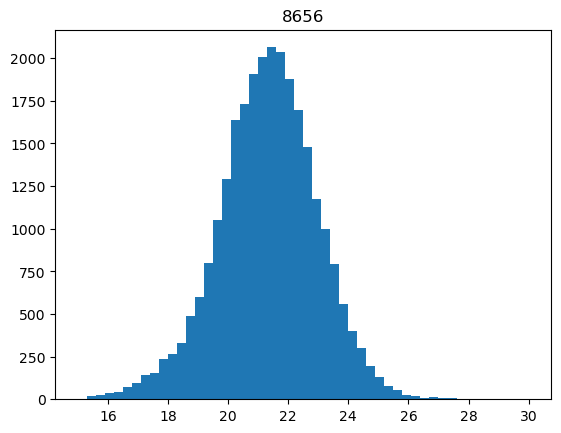

 55%|███████████████████████████████████████████▍                                   | 591/1075 [01:19<01:06,  7.24it/s]

5785


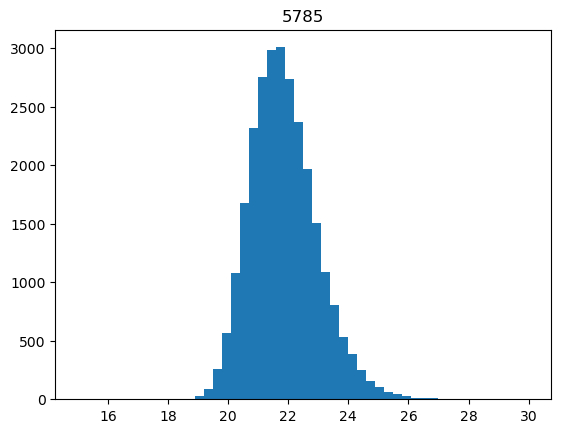

 55%|███████████████████████████████████████████▌                                   | 592/1075 [01:19<01:04,  7.45it/s]

4211


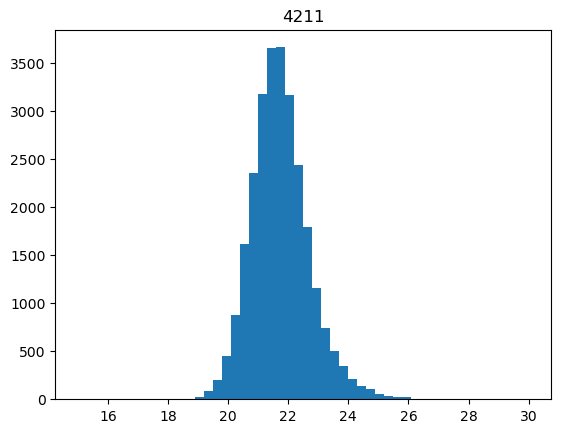

 55%|███████████████████████████████████████████▌                                   | 593/1075 [01:19<01:03,  7.61it/s]

2730


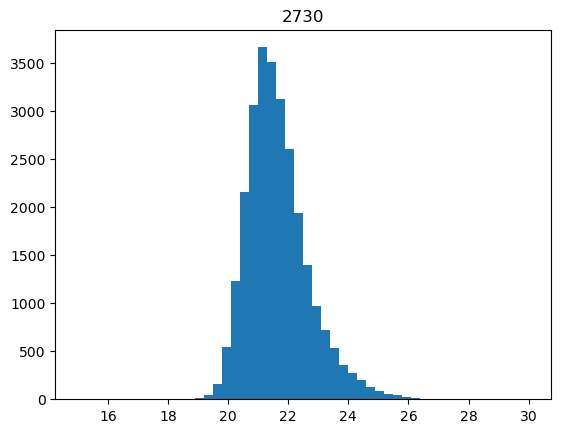

 55%|███████████████████████████████████████████▋                                   | 594/1075 [01:19<01:02,  7.67it/s]

14875


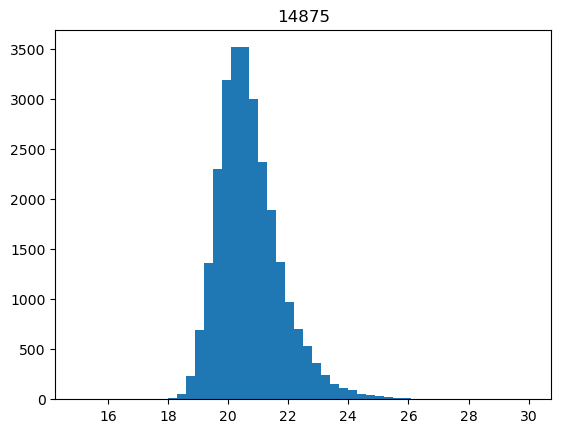

 55%|███████████████████████████████████████████▋                                   | 595/1075 [01:19<01:01,  7.74it/s]

8199


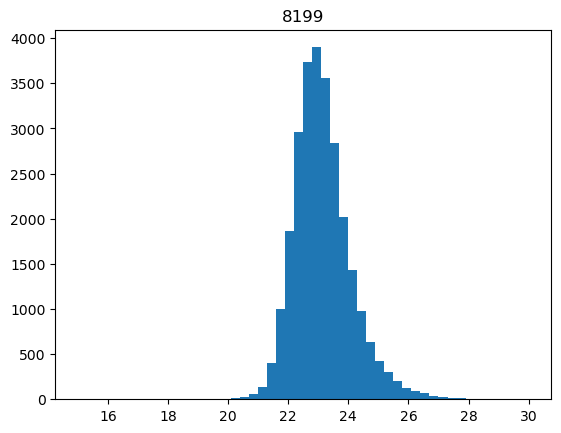

 55%|███████████████████████████████████████████▊                                   | 596/1075 [01:19<01:01,  7.75it/s]

19934


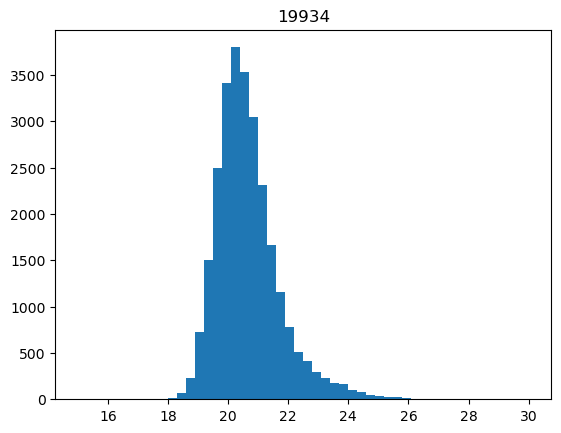

 56%|███████████████████████████████████████████▊                                   | 597/1075 [01:19<01:01,  7.80it/s]

7391


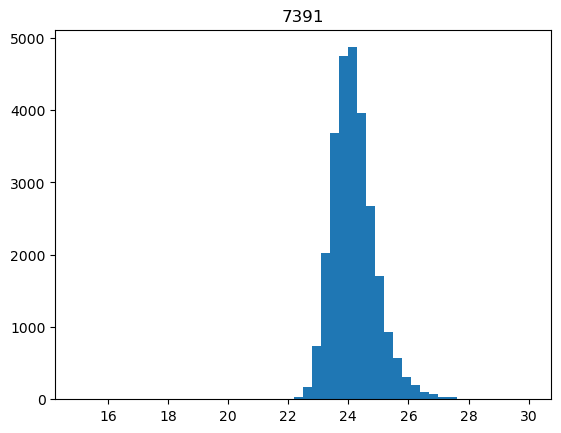

 56%|███████████████████████████████████████████▉                                   | 598/1075 [01:19<01:00,  7.92it/s]

926


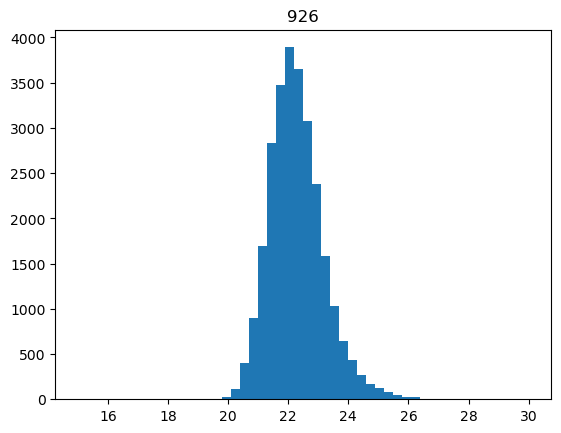

 56%|████████████████████████████████████████████                                   | 599/1075 [01:20<01:00,  7.88it/s]

2199


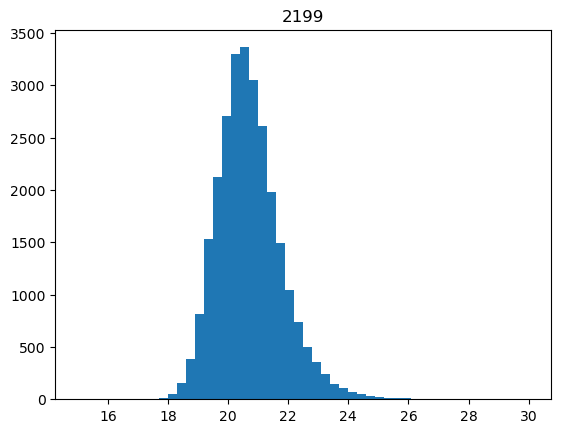

 56%|████████████████████████████████████████████                                   | 600/1075 [01:20<01:11,  6.60it/s]

7048


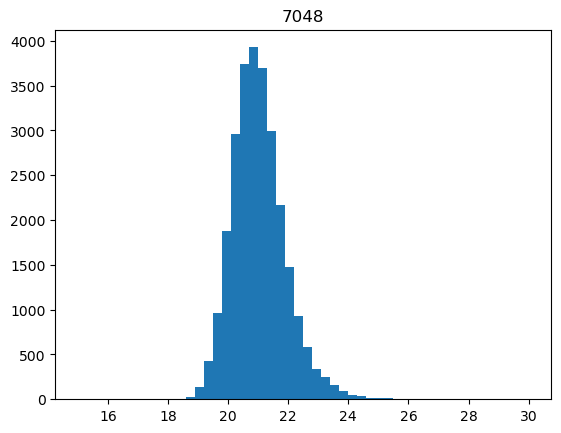

 56%|████████████████████████████████████████████▏                                  | 601/1075 [01:20<01:08,  6.92it/s]

10993


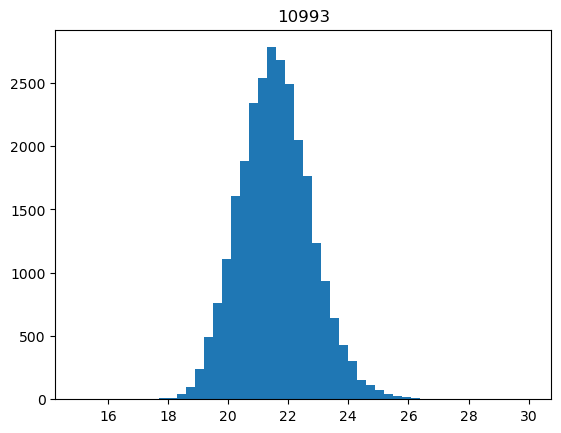

 56%|████████████████████████████████████████████▏                                  | 602/1075 [01:20<01:05,  7.24it/s]

24456


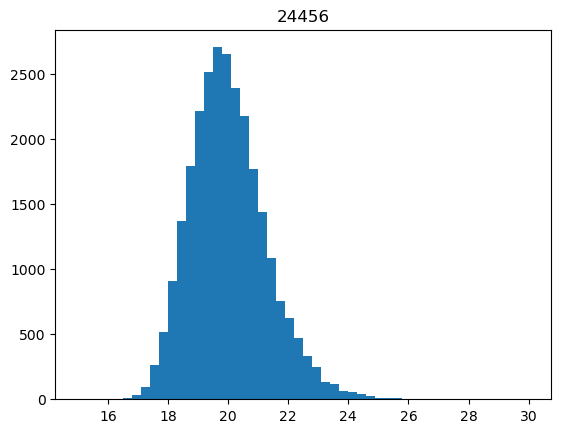

 56%|████████████████████████████████████████████▎                                  | 603/1075 [01:20<01:04,  7.37it/s]

19503


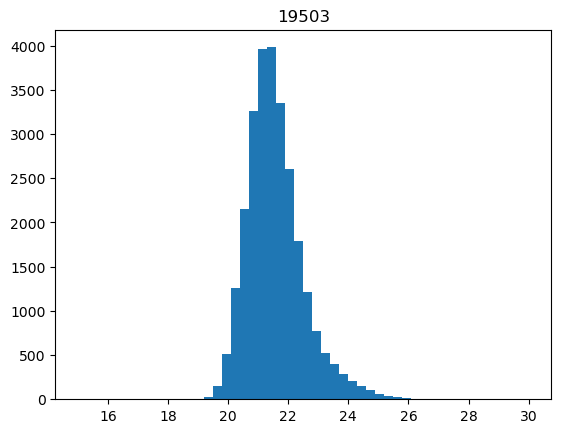

 56%|████████████████████████████████████████████▍                                  | 604/1075 [01:20<01:03,  7.43it/s]

11486


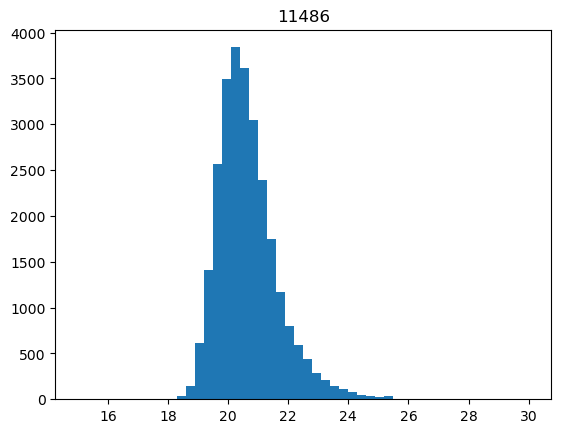

 56%|████████████████████████████████████████████▍                                  | 605/1075 [01:20<01:02,  7.58it/s]

24930


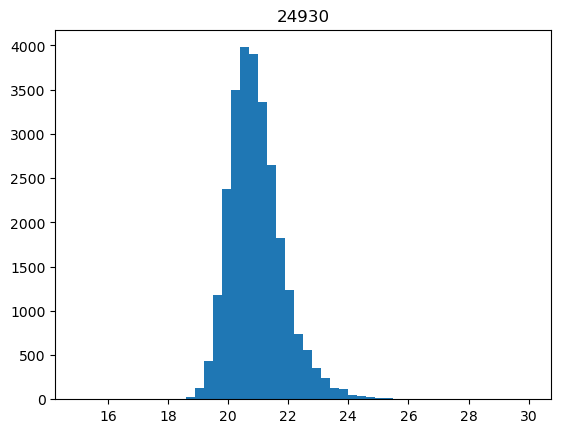

 56%|████████████████████████████████████████████▌                                  | 606/1075 [01:21<01:02,  7.56it/s]

4545


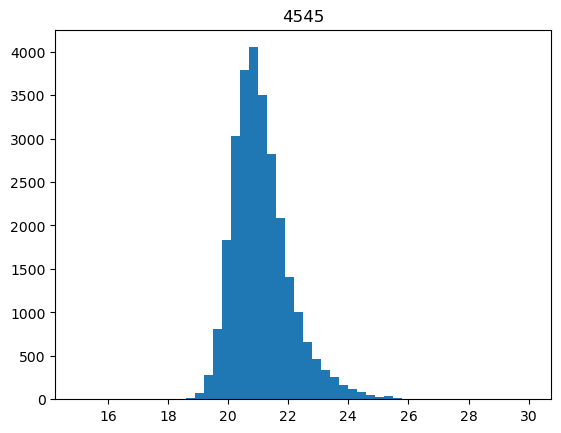

 56%|████████████████████████████████████████████▌                                  | 607/1075 [01:21<01:01,  7.65it/s]

3753


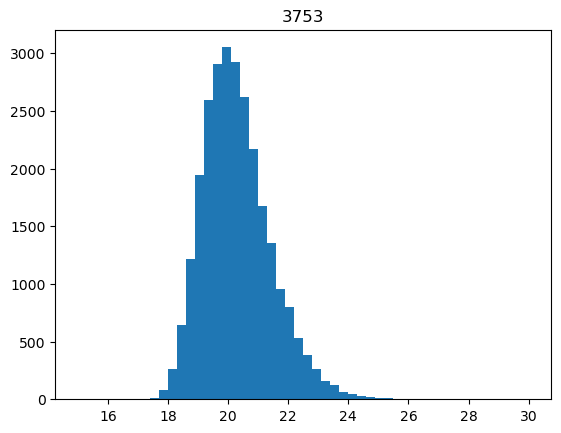

 57%|████████████████████████████████████████████▋                                  | 608/1075 [01:21<01:00,  7.75it/s]

9124


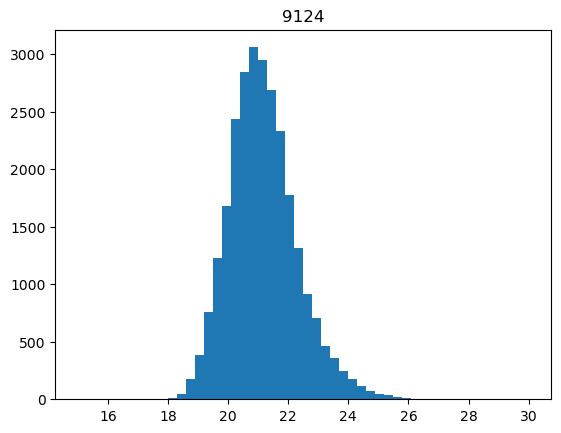

 57%|████████████████████████████████████████████▊                                  | 609/1075 [01:21<00:59,  7.82it/s]

19194


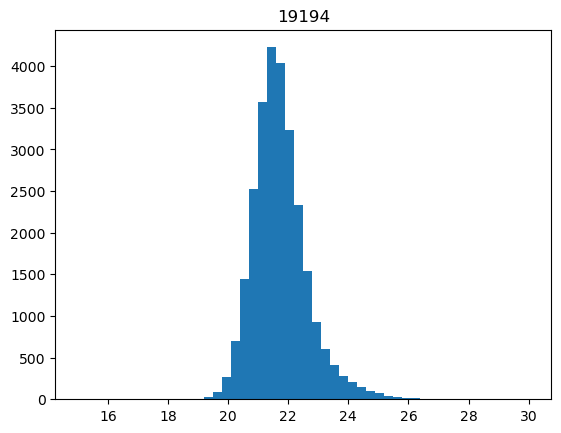

 57%|████████████████████████████████████████████▊                                  | 610/1075 [01:21<00:59,  7.84it/s]

23683


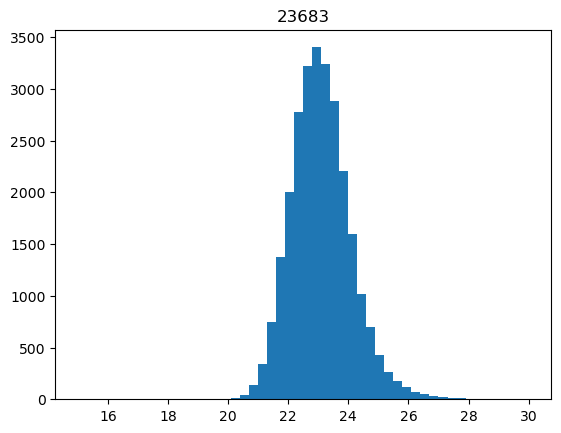

 57%|████████████████████████████████████████████▉                                  | 611/1075 [01:21<01:10,  6.54it/s]

23342


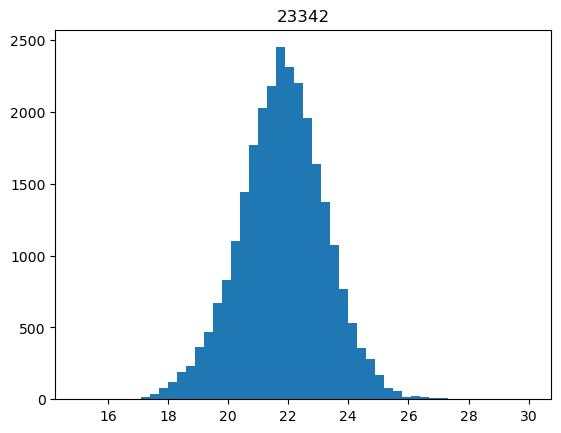

 57%|████████████████████████████████████████████▉                                  | 612/1075 [01:21<01:06,  6.96it/s]

8542


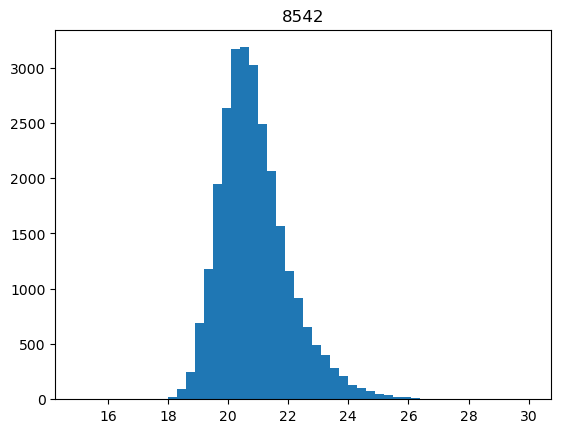

 57%|█████████████████████████████████████████████                                  | 613/1075 [01:22<01:04,  7.21it/s]

13409


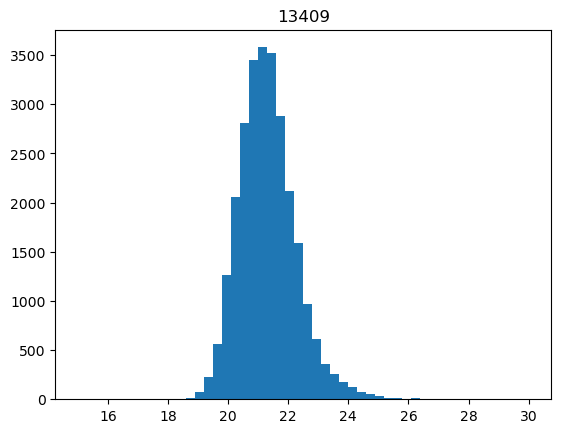

 57%|█████████████████████████████████████████████                                  | 614/1075 [01:22<01:02,  7.38it/s]

18195


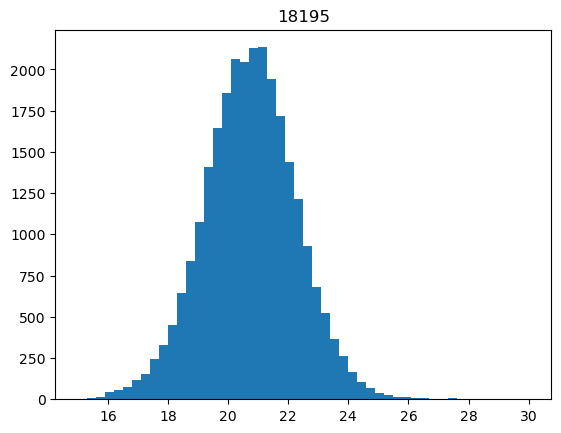

 57%|█████████████████████████████████████████████▏                                 | 615/1075 [01:22<01:01,  7.51it/s]

16185


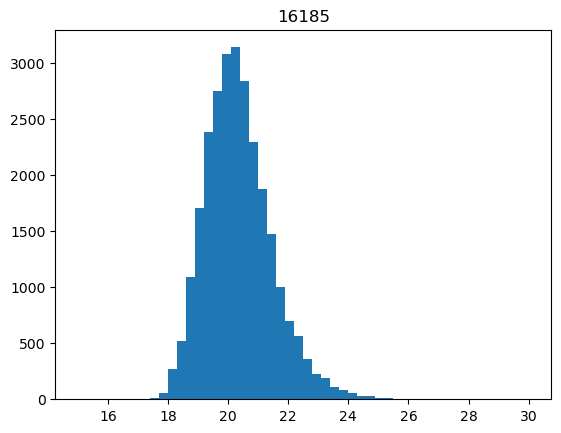

 57%|█████████████████████████████████████████████▎                                 | 616/1075 [01:22<01:00,  7.59it/s]

23823


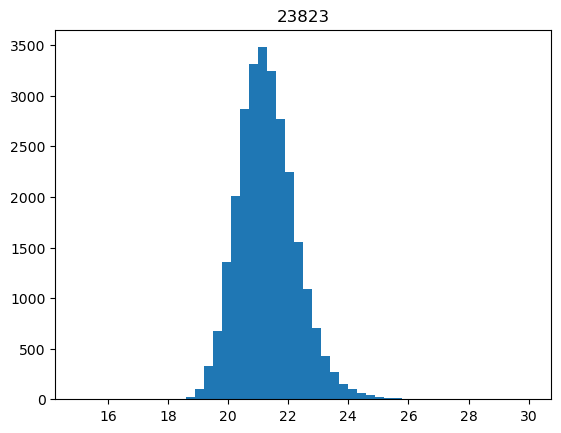

 57%|█████████████████████████████████████████████▎                                 | 617/1075 [01:22<00:59,  7.68it/s]

4562


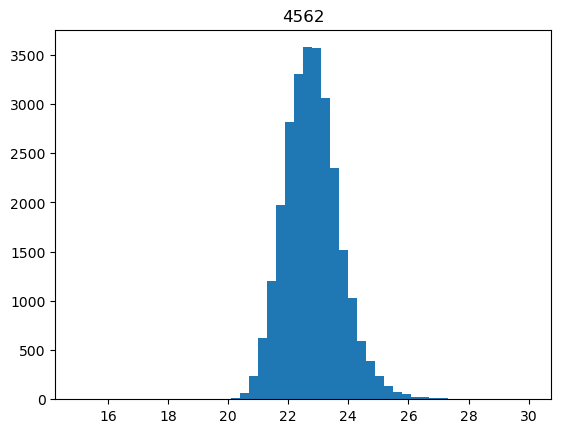

 57%|█████████████████████████████████████████████▍                                 | 618/1075 [01:22<00:58,  7.77it/s]

18843


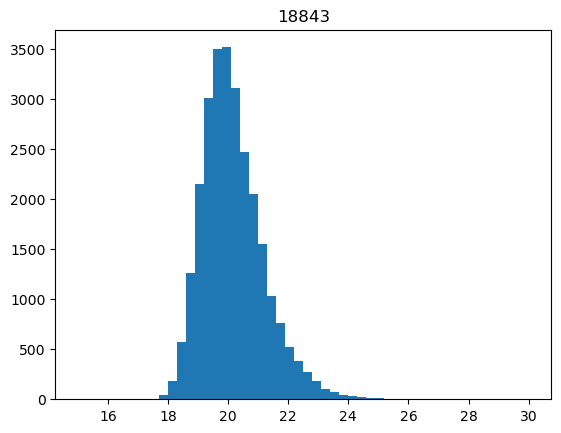

 58%|█████████████████████████████████████████████▍                                 | 619/1075 [01:22<00:58,  7.80it/s]

19110


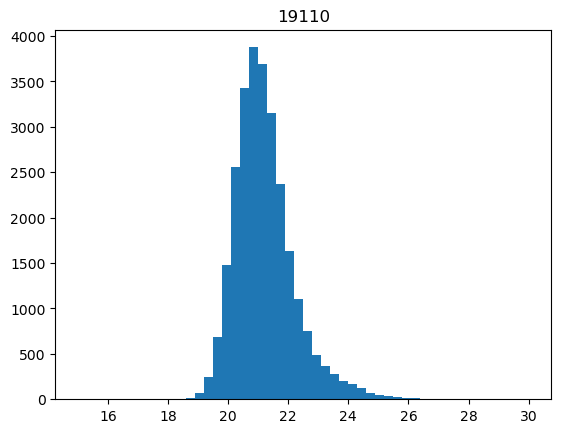

 58%|█████████████████████████████████████████████▌                                 | 620/1075 [01:22<00:58,  7.80it/s]

1326


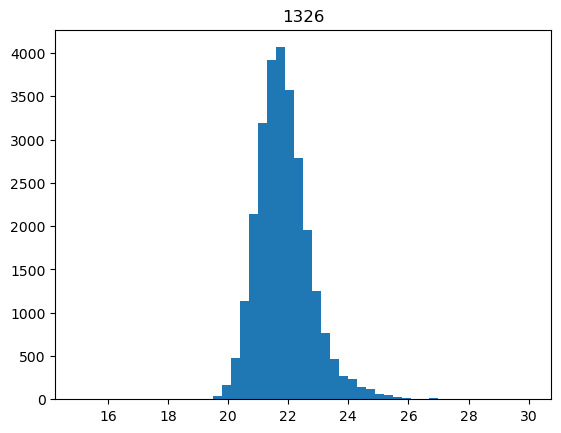

 58%|█████████████████████████████████████████████▋                                 | 621/1075 [01:23<00:58,  7.75it/s]

4674


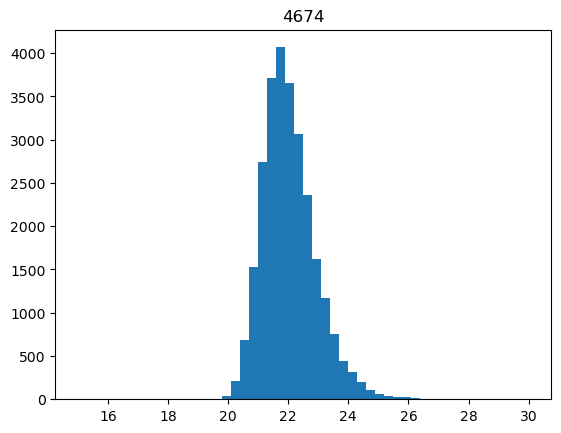

 58%|█████████████████████████████████████████████▋                                 | 622/1075 [01:23<01:09,  6.53it/s]

25161


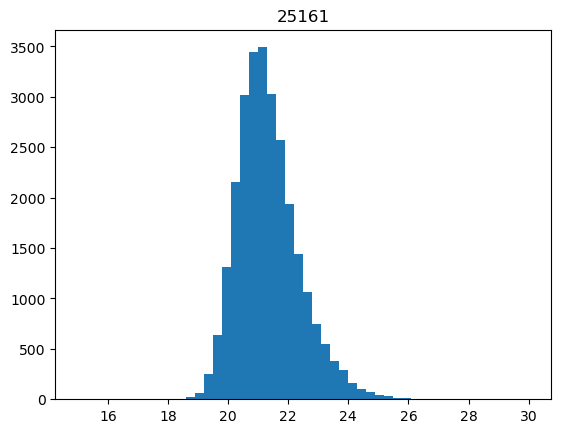

 58%|█████████████████████████████████████████████▊                                 | 623/1075 [01:23<01:05,  6.89it/s]

24072


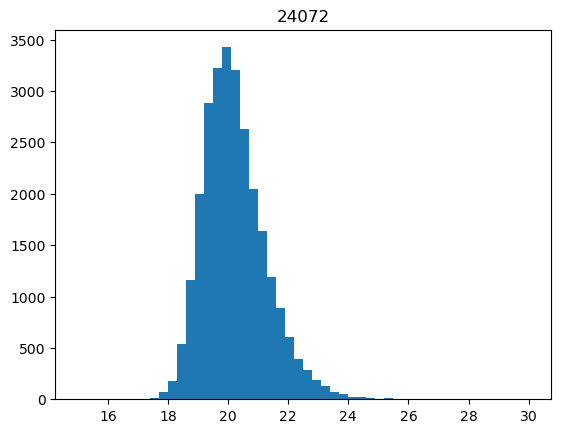

 58%|█████████████████████████████████████████████▊                                 | 624/1075 [01:23<01:03,  7.14it/s]

22739


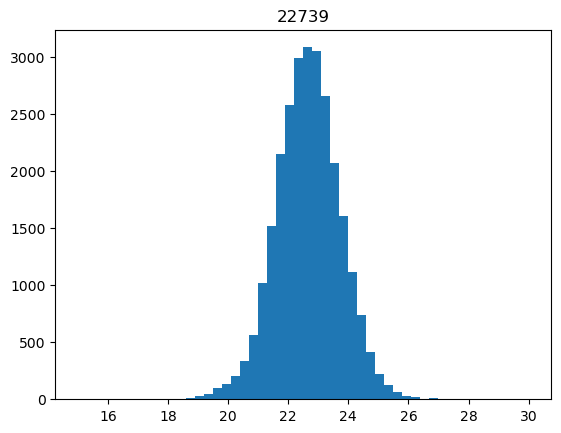

 58%|█████████████████████████████████████████████▉                                 | 625/1075 [01:23<01:00,  7.38it/s]

70


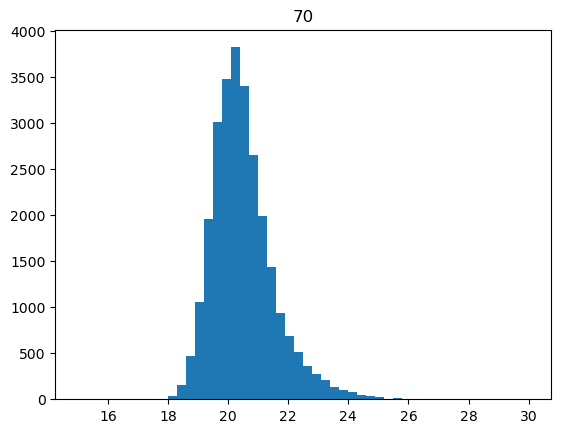

 58%|██████████████████████████████████████████████                                 | 626/1075 [01:23<01:00,  7.47it/s]

20947


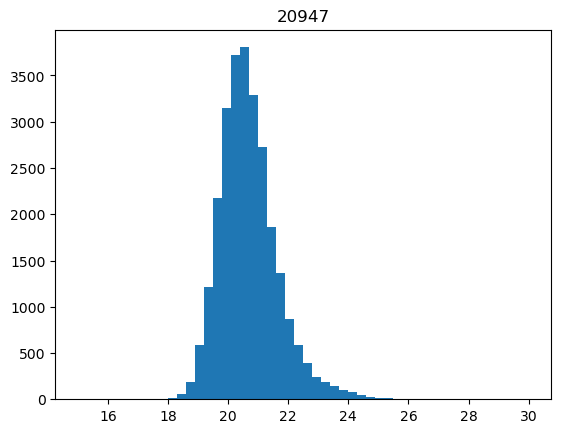

 58%|██████████████████████████████████████████████                                 | 627/1075 [01:23<00:58,  7.62it/s]

25128


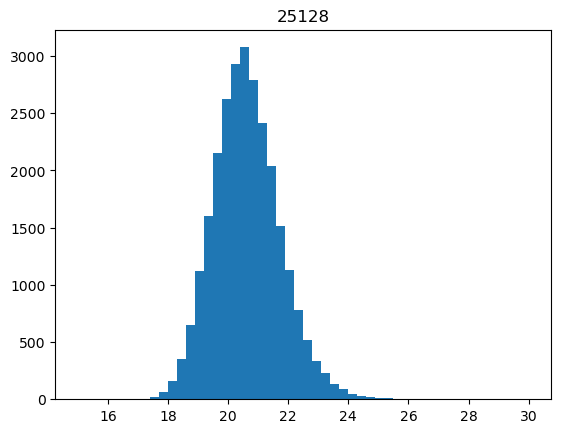

 58%|██████████████████████████████████████████████▏                                | 628/1075 [01:24<00:57,  7.75it/s]

10390


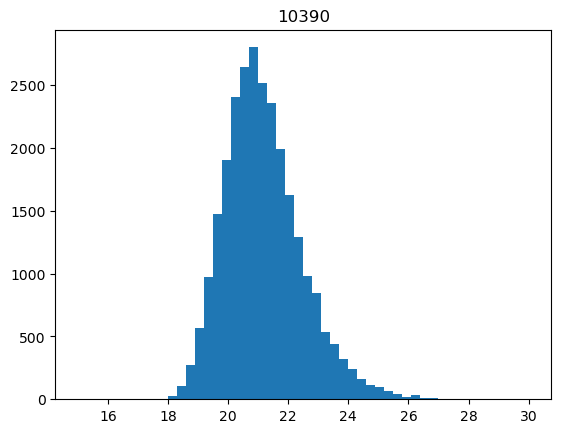

 59%|██████████████████████████████████████████████▏                                | 629/1075 [01:24<00:56,  7.86it/s]

11756


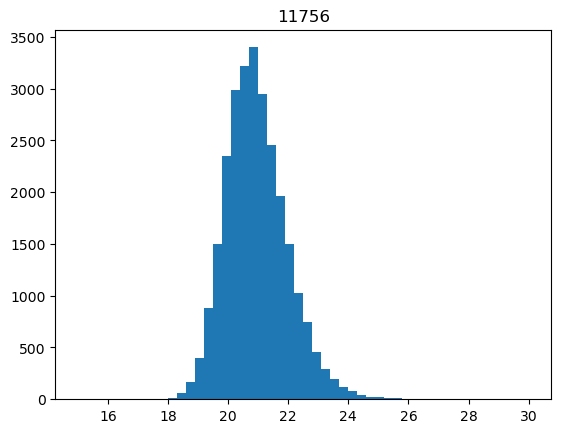

 59%|██████████████████████████████████████████████▎                                | 630/1075 [01:24<00:56,  7.90it/s]

22050


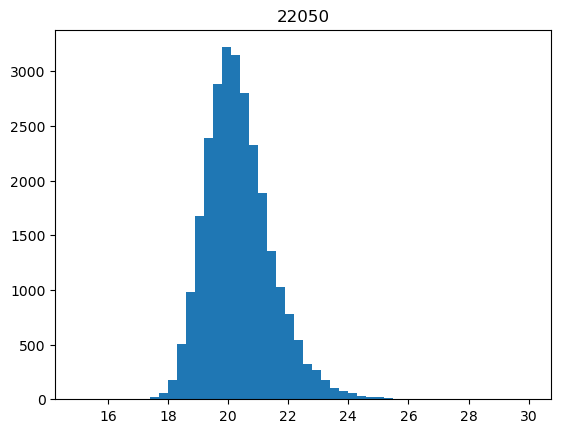

 59%|██████████████████████████████████████████████▎                                | 631/1075 [01:24<00:56,  7.87it/s]

21099


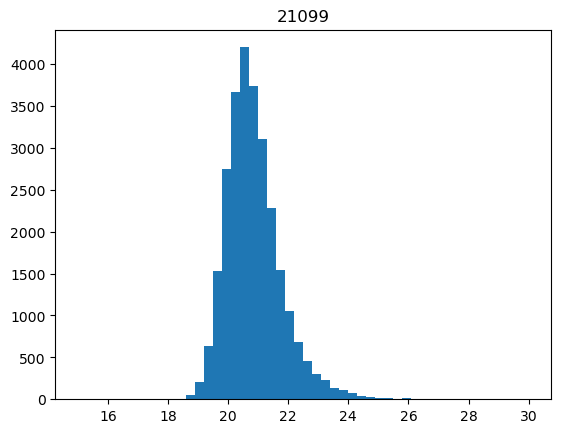

 59%|██████████████████████████████████████████████▍                                | 632/1075 [01:24<00:56,  7.84it/s]

3019


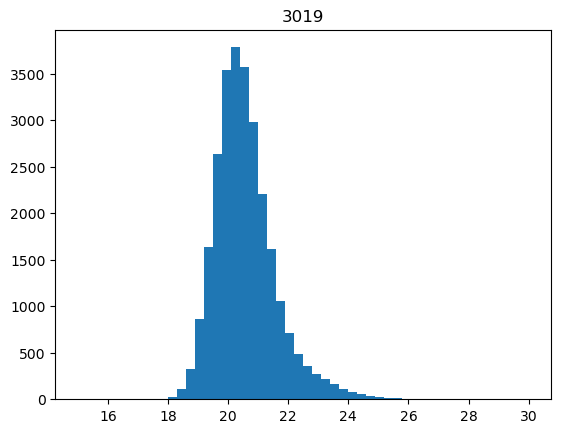

 59%|██████████████████████████████████████████████▌                                | 633/1075 [01:24<01:06,  6.60it/s]

1607


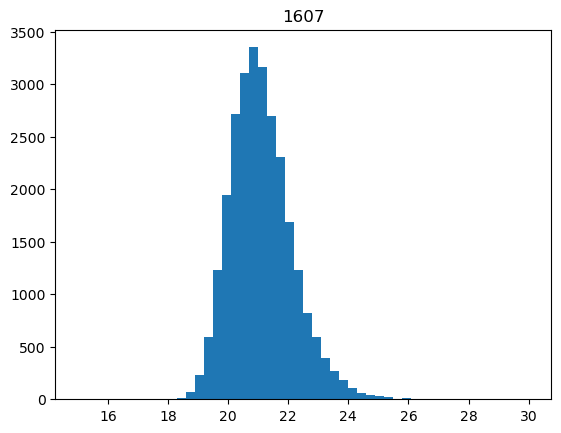

 59%|██████████████████████████████████████████████▌                                | 634/1075 [01:24<01:03,  6.97it/s]

2536


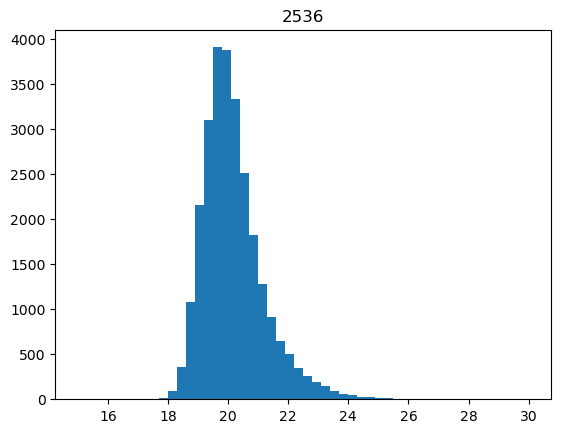

 59%|██████████████████████████████████████████████▋                                | 635/1075 [01:24<01:01,  7.20it/s]

25004


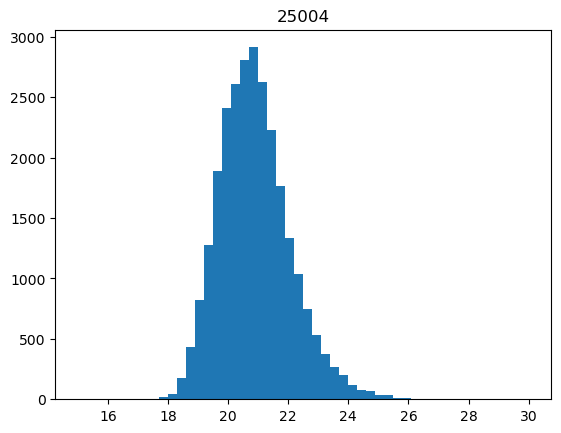

 59%|██████████████████████████████████████████████▋                                | 636/1075 [01:25<00:59,  7.39it/s]

1444


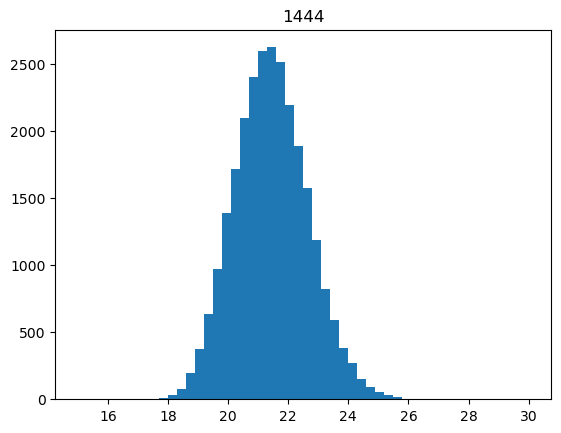

 59%|██████████████████████████████████████████████▊                                | 637/1075 [01:25<00:57,  7.60it/s]

14801


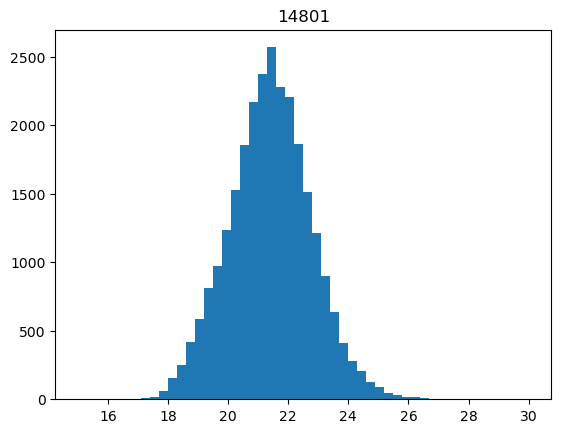

 59%|██████████████████████████████████████████████▉                                | 638/1075 [01:25<00:56,  7.75it/s]

24315


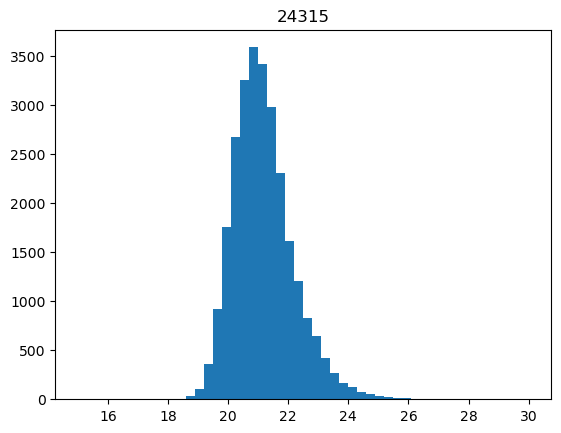

 59%|██████████████████████████████████████████████▉                                | 639/1075 [01:25<00:56,  7.77it/s]

16323


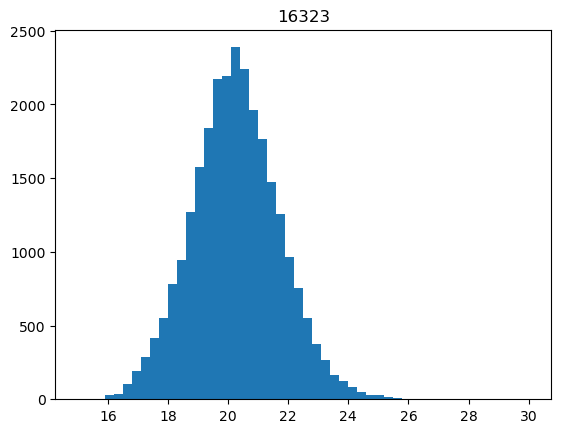

 60%|███████████████████████████████████████████████                                | 640/1075 [01:25<00:55,  7.84it/s]

3992


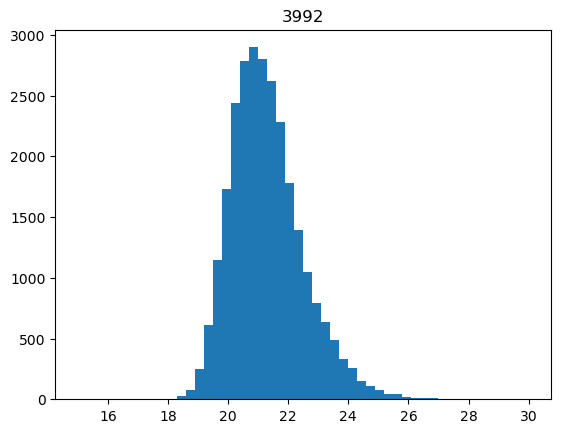

 60%|███████████████████████████████████████████████                                | 641/1075 [01:25<00:55,  7.81it/s]

16935


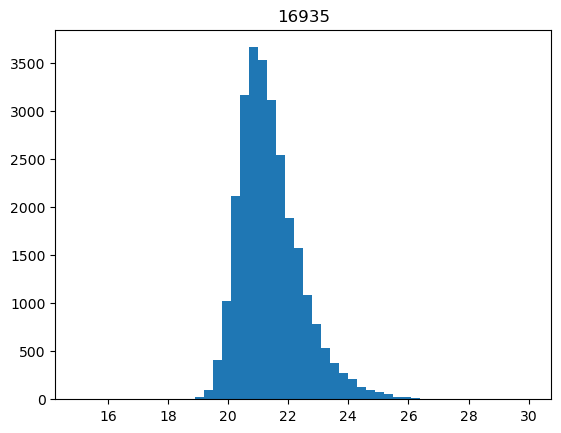

 60%|███████████████████████████████████████████████▏                               | 642/1075 [01:25<00:55,  7.76it/s]

26049


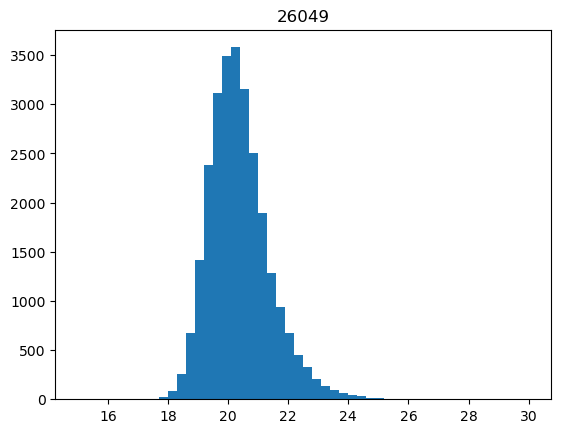

 60%|███████████████████████████████████████████████▎                               | 643/1075 [01:26<00:55,  7.75it/s]

16092


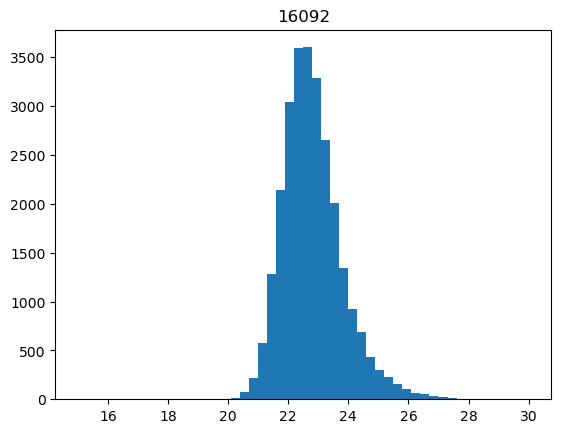

 60%|███████████████████████████████████████████████▎                               | 644/1075 [01:26<01:07,  6.36it/s]

14733


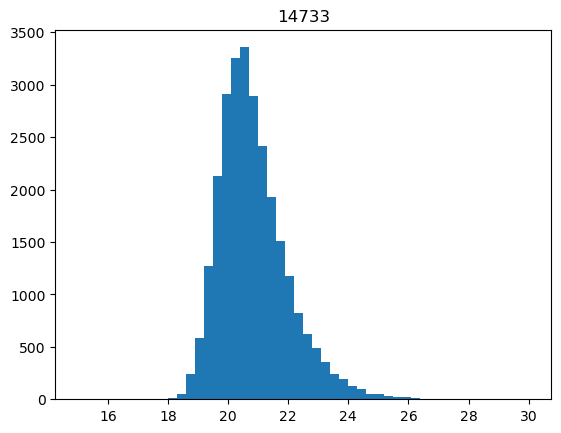

 60%|███████████████████████████████████████████████▍                               | 645/1075 [01:26<01:03,  6.72it/s]

9313


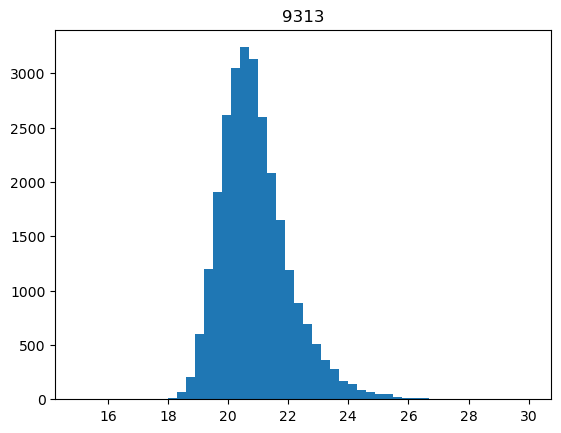

 60%|███████████████████████████████████████████████▍                               | 646/1075 [01:26<01:01,  7.03it/s]

21067


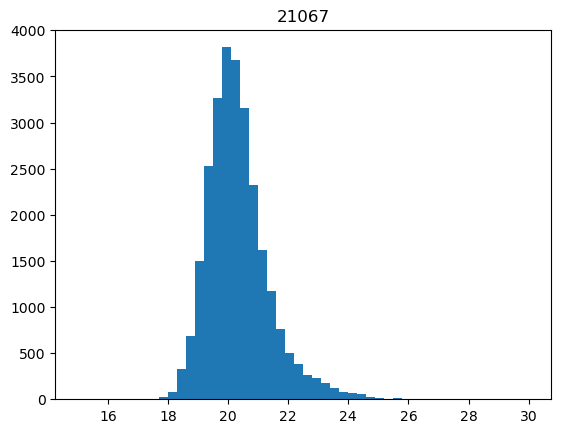

 60%|███████████████████████████████████████████████▌                               | 647/1075 [01:26<00:58,  7.26it/s]

25407


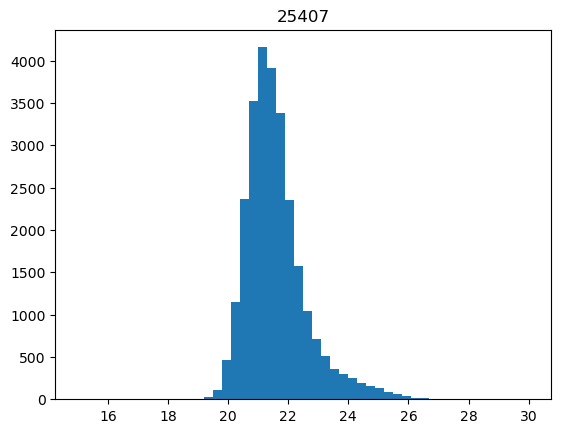

 60%|███████████████████████████████████████████████▌                               | 648/1075 [01:26<00:57,  7.40it/s]

8736


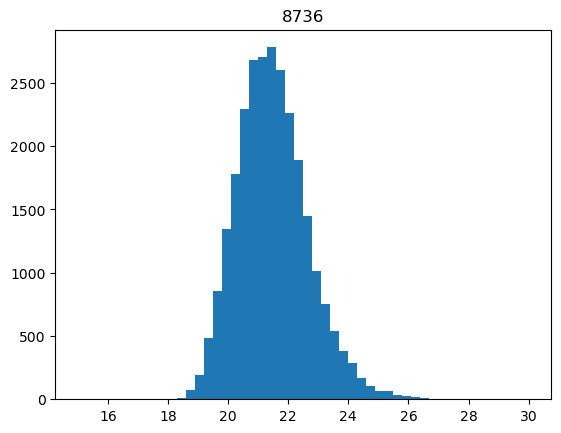

 60%|███████████████████████████████████████████████▋                               | 649/1075 [01:26<00:56,  7.57it/s]

3103


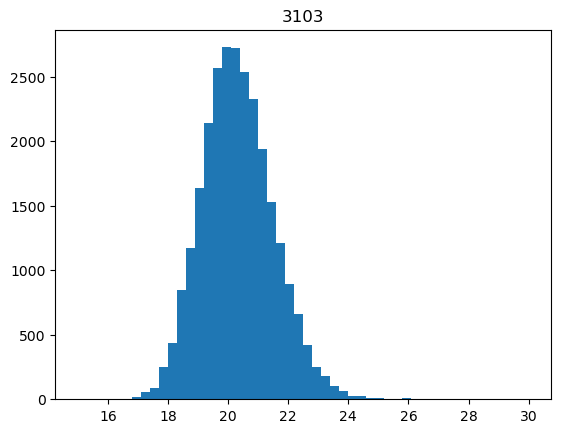

 60%|███████████████████████████████████████████████▊                               | 650/1075 [01:26<00:55,  7.68it/s]

14453


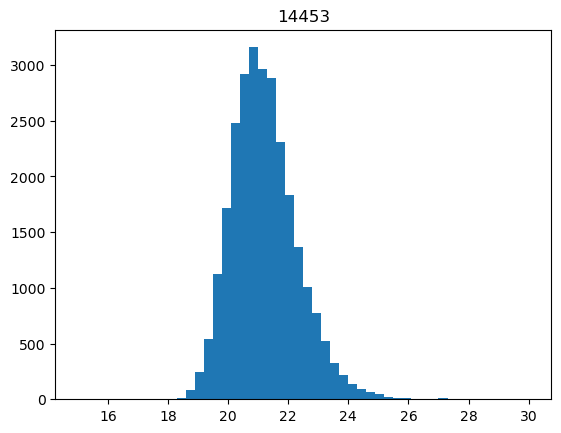

 61%|███████████████████████████████████████████████▊                               | 651/1075 [01:27<00:54,  7.75it/s]

18041


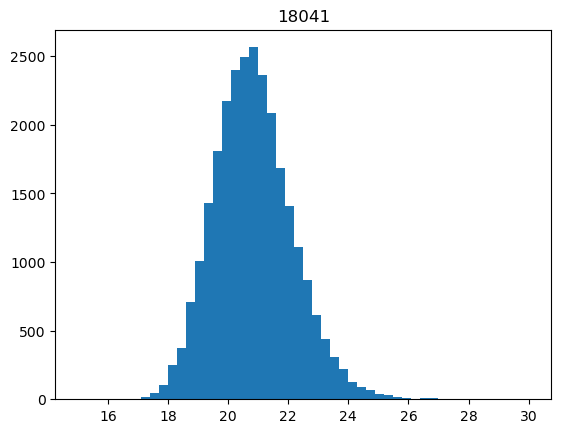

 61%|███████████████████████████████████████████████▉                               | 652/1075 [01:27<00:54,  7.79it/s]

25505


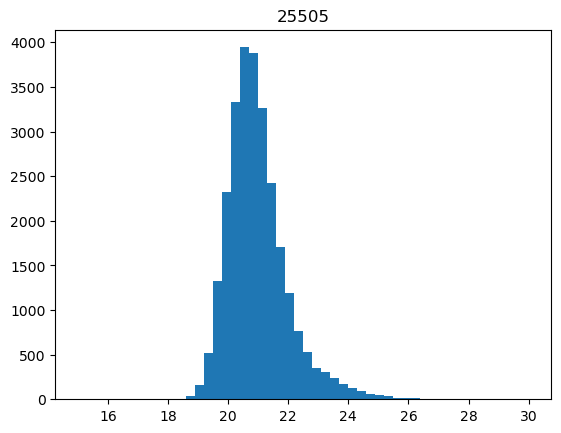

 61%|███████████████████████████████████████████████▉                               | 653/1075 [01:27<00:54,  7.78it/s]

9881


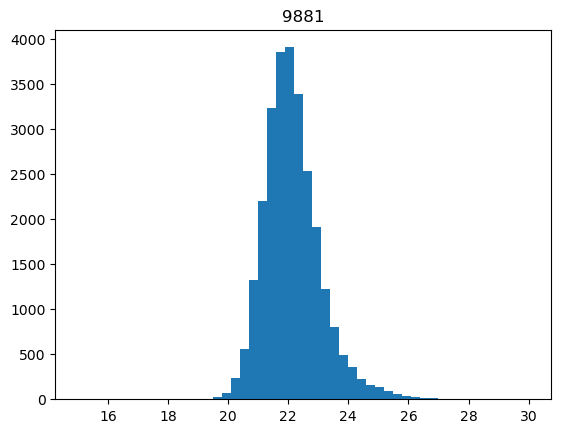

 61%|████████████████████████████████████████████████                               | 654/1075 [01:27<00:53,  7.82it/s]

3328


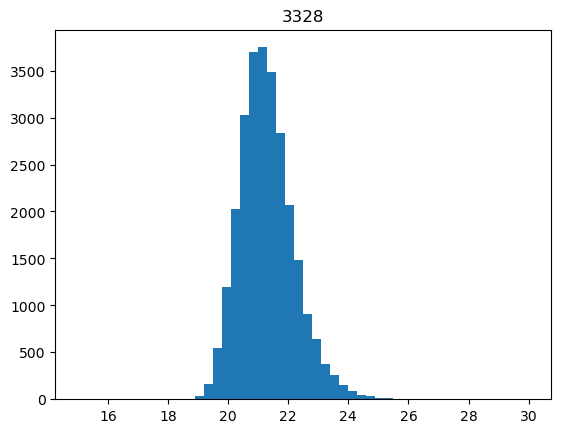

 61%|████████████████████████████████████████████████▏                              | 655/1075 [01:27<01:03,  6.60it/s]

14167


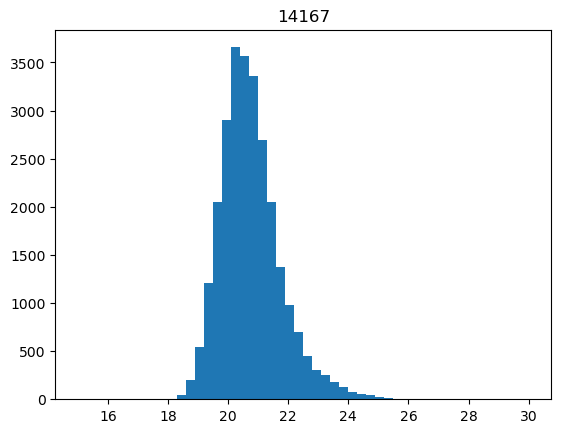

 61%|████████████████████████████████████████████████▏                              | 656/1075 [01:27<01:00,  6.93it/s]

24770


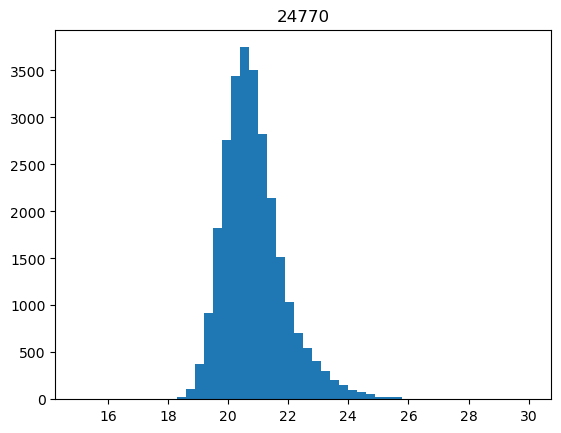

 61%|████████████████████████████████████████████████▎                              | 657/1075 [01:27<00:58,  7.19it/s]

20722


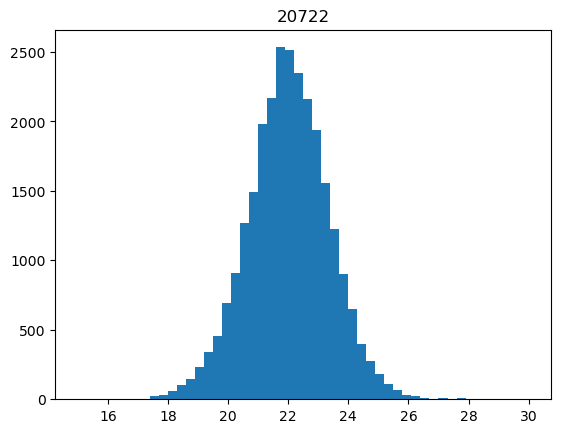

 61%|████████████████████████████████████████████████▎                              | 658/1075 [01:28<00:56,  7.42it/s]

8056


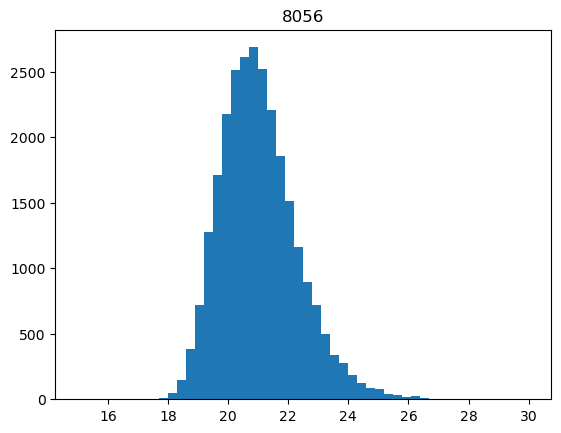

 61%|████████████████████████████████████████████████▍                              | 659/1075 [01:28<00:54,  7.58it/s]

3808


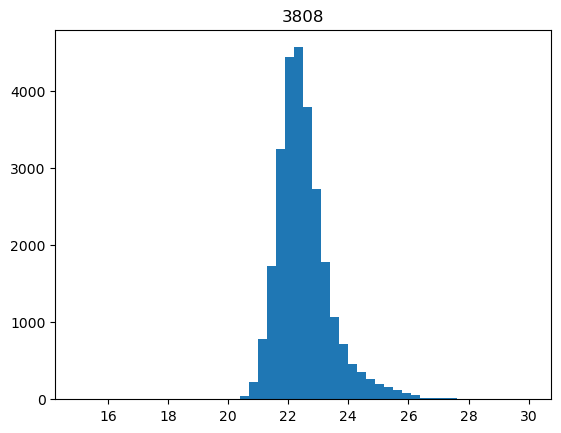

 61%|████████████████████████████████████████████████▌                              | 660/1075 [01:28<00:53,  7.77it/s]

14482


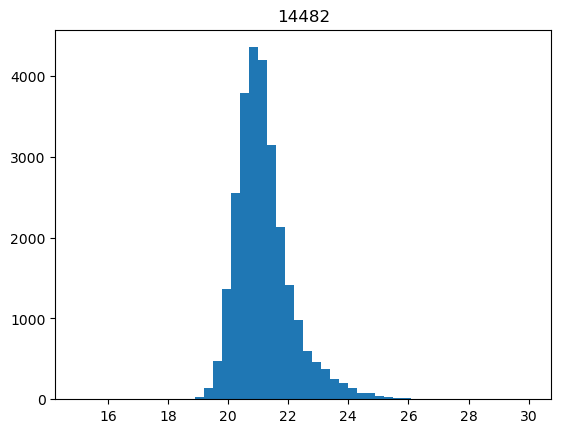

 61%|████████████████████████████████████████████████▌                              | 661/1075 [01:28<00:51,  7.97it/s]

1167


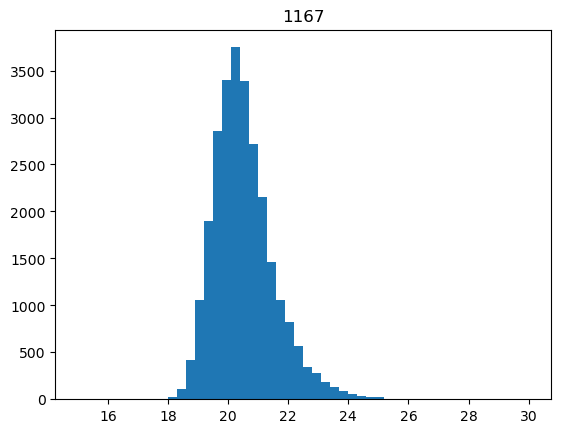

 62%|████████████████████████████████████████████████▋                              | 662/1075 [01:28<00:51,  7.96it/s]

6894


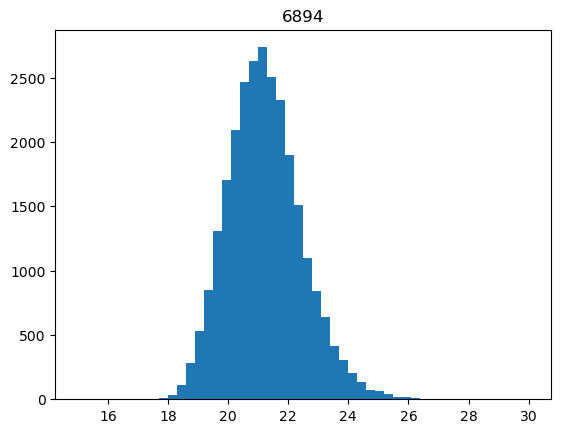

 62%|████████████████████████████████████████████████▋                              | 663/1075 [01:28<00:51,  7.95it/s]

504


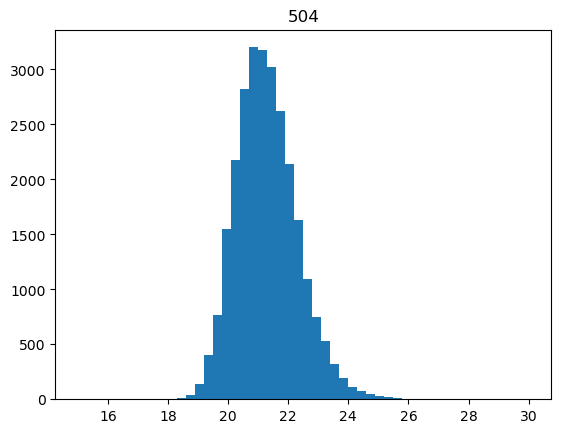

 62%|████████████████████████████████████████████████▊                              | 664/1075 [01:28<00:51,  7.99it/s]

15825


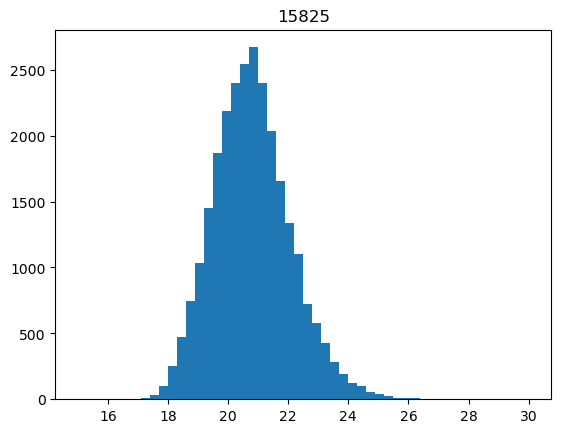

 62%|████████████████████████████████████████████████▊                              | 665/1075 [01:28<00:51,  8.03it/s]

5547


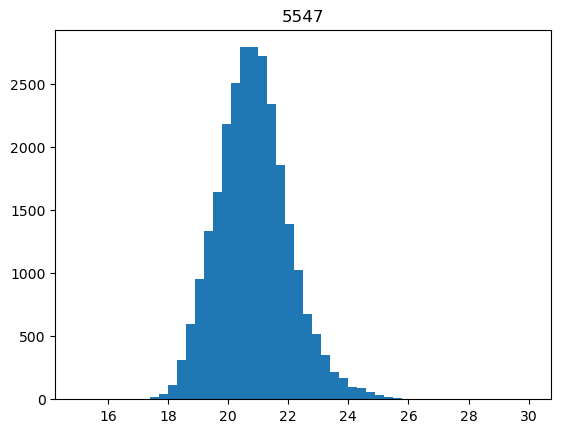

 62%|████████████████████████████████████████████████▉                              | 666/1075 [01:29<01:01,  6.68it/s]

19238


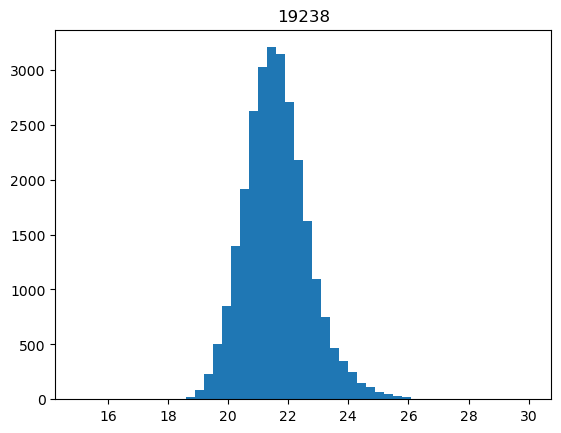

 62%|█████████████████████████████████████████████████                              | 667/1075 [01:29<00:58,  7.00it/s]

22729


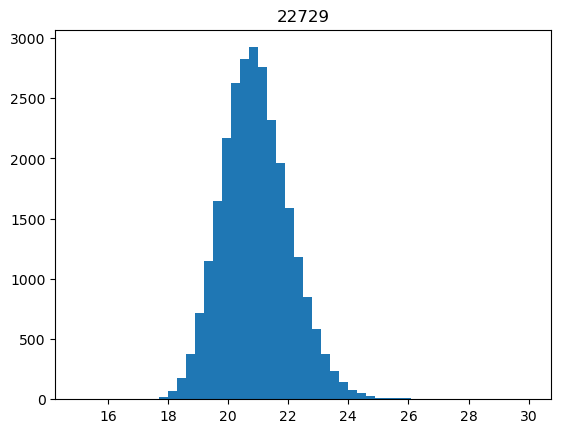

 62%|█████████████████████████████████████████████████                              | 668/1075 [01:29<00:56,  7.26it/s]

10703


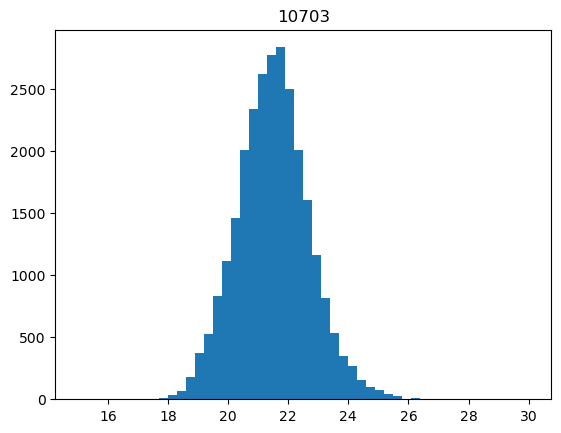

 62%|█████████████████████████████████████████████████▏                             | 669/1075 [01:29<00:54,  7.48it/s]

8121


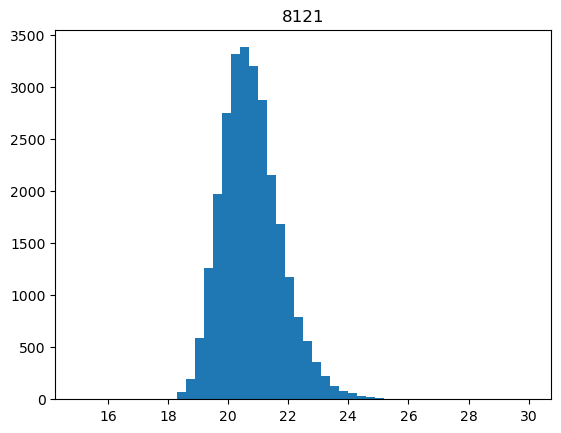

 62%|█████████████████████████████████████████████████▏                             | 670/1075 [01:29<00:53,  7.59it/s]

13283


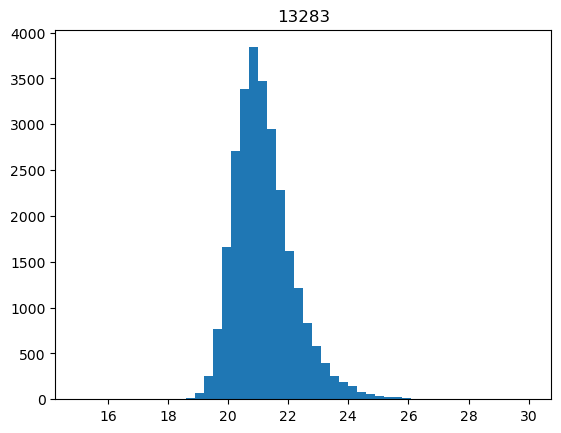

 62%|█████████████████████████████████████████████████▎                             | 671/1075 [01:29<00:52,  7.64it/s]

571


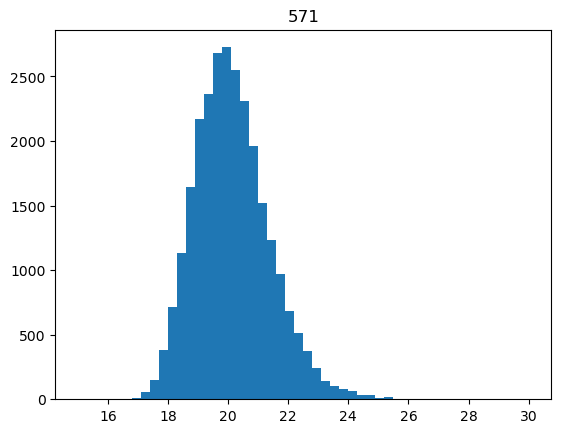

 63%|█████████████████████████████████████████████████▍                             | 672/1075 [01:29<00:51,  7.76it/s]

4867


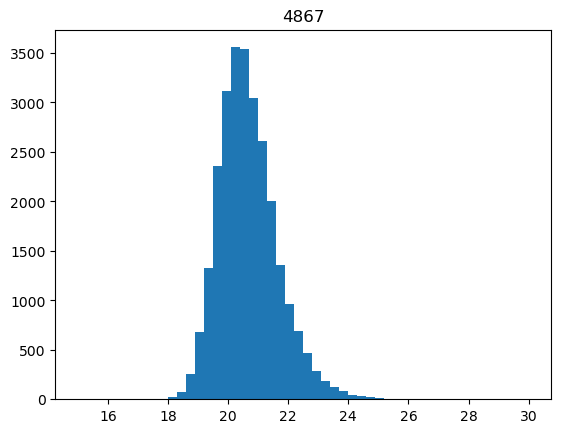

 63%|█████████████████████████████████████████████████▍                             | 673/1075 [01:30<00:51,  7.81it/s]

14267


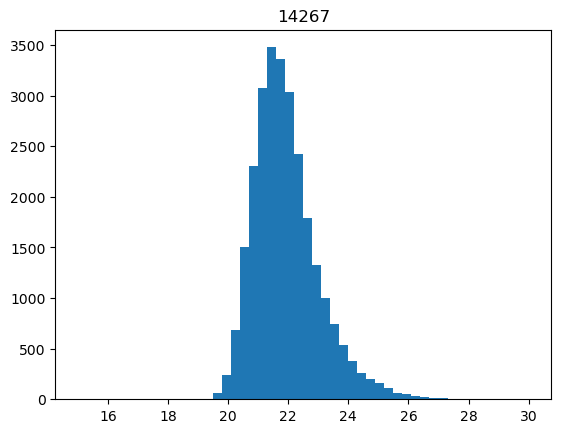

 63%|█████████████████████████████████████████████████▌                             | 674/1075 [01:30<00:50,  7.92it/s]

10066


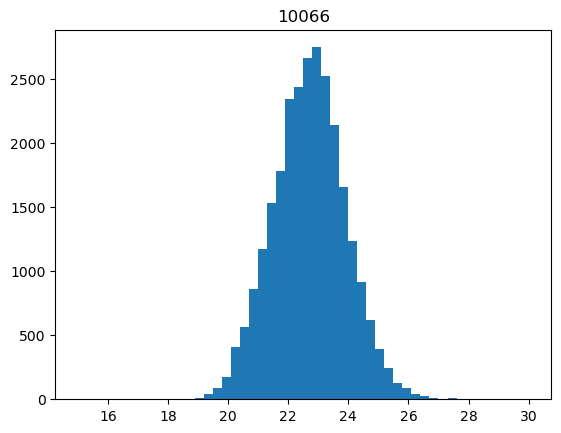

 63%|█████████████████████████████████████████████████▌                             | 675/1075 [01:30<00:49,  8.02it/s]

4796


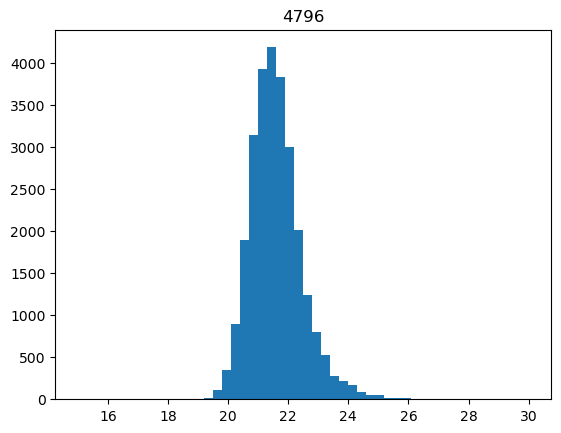

 63%|█████████████████████████████████████████████████▋                             | 676/1075 [01:30<00:50,  7.96it/s]

1283


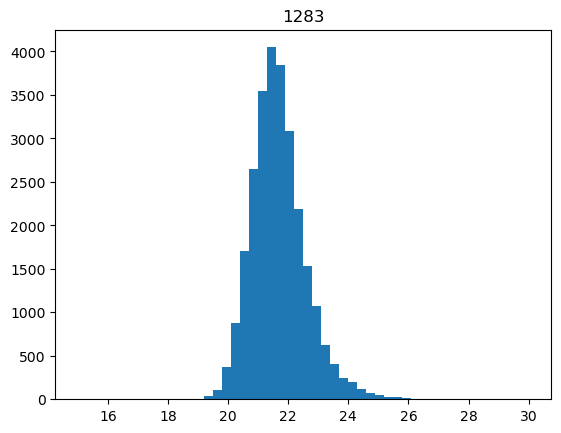

 63%|█████████████████████████████████████████████████▊                             | 677/1075 [01:30<01:00,  6.56it/s]

22392


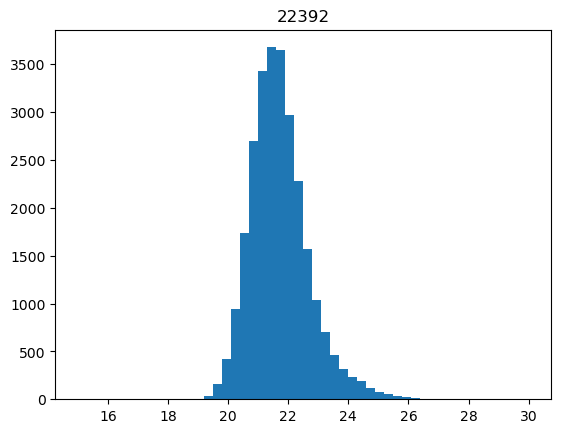

 63%|█████████████████████████████████████████████████▊                             | 678/1075 [01:30<00:57,  6.86it/s]

22373


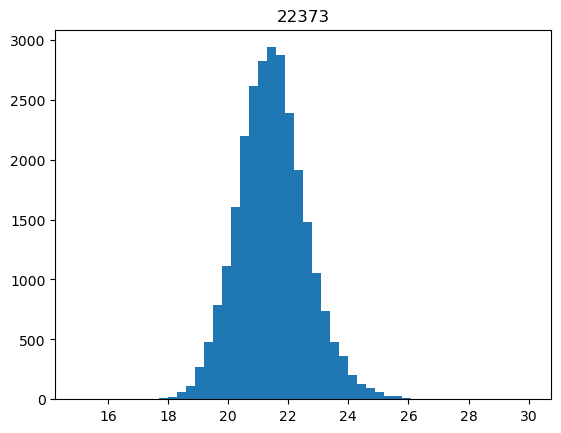

 63%|█████████████████████████████████████████████████▉                             | 679/1075 [01:30<00:55,  7.17it/s]

13672


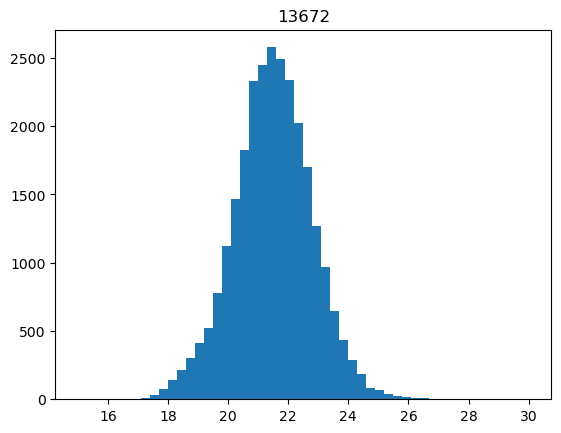

 63%|█████████████████████████████████████████████████▉                             | 680/1075 [01:31<00:53,  7.38it/s]

6173


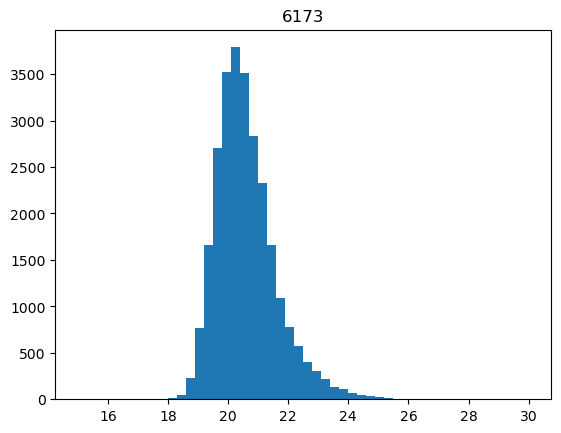

 63%|██████████████████████████████████████████████████                             | 681/1075 [01:31<00:52,  7.49it/s]

583


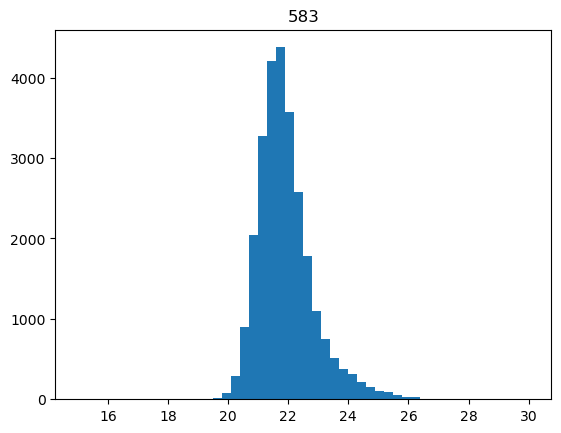

 63%|██████████████████████████████████████████████████                             | 682/1075 [01:31<00:51,  7.69it/s]

1777


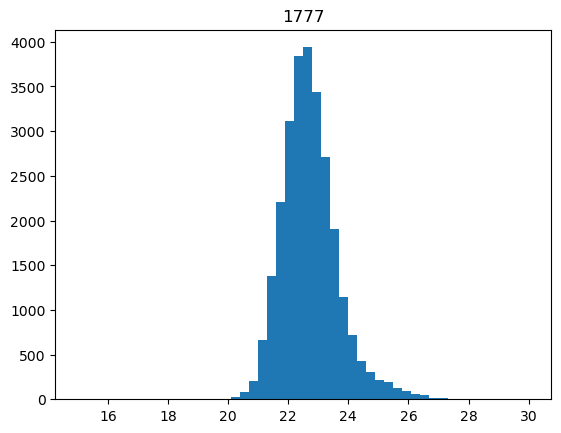

 64%|██████████████████████████████████████████████████▏                            | 683/1075 [01:31<00:50,  7.72it/s]

19937


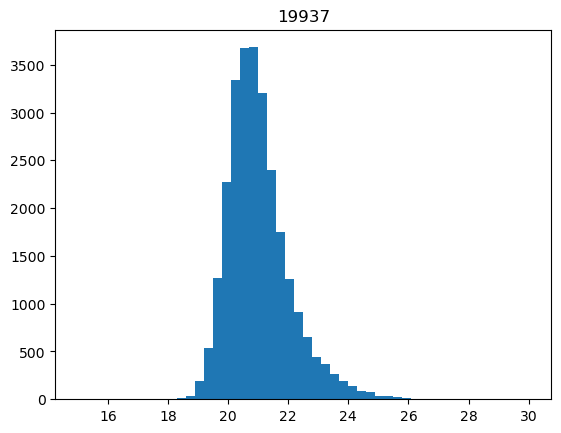

 64%|██████████████████████████████████████████████████▎                            | 684/1075 [01:31<00:50,  7.77it/s]

9231


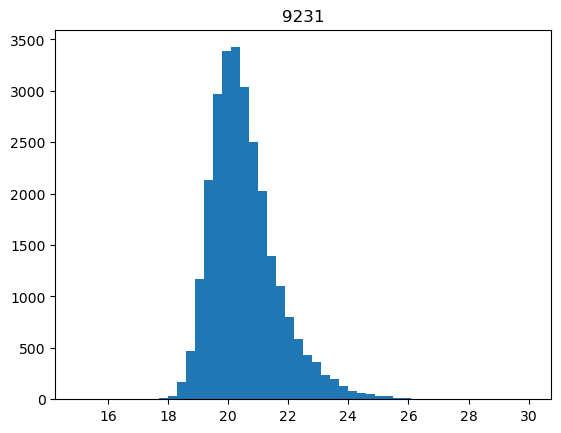

 64%|██████████████████████████████████████████████████▎                            | 685/1075 [01:31<00:49,  7.82it/s]

21806


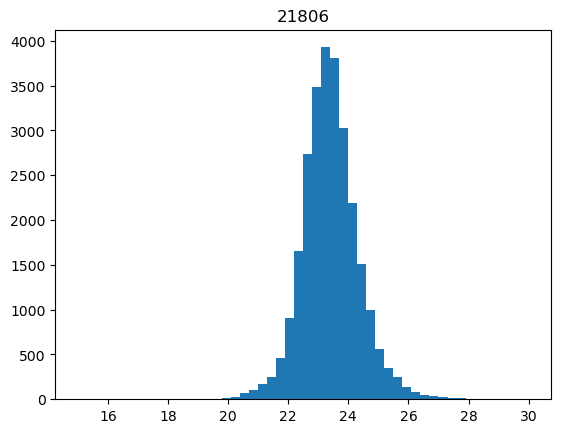

 64%|██████████████████████████████████████████████████▍                            | 686/1075 [01:31<00:50,  7.69it/s]

18450


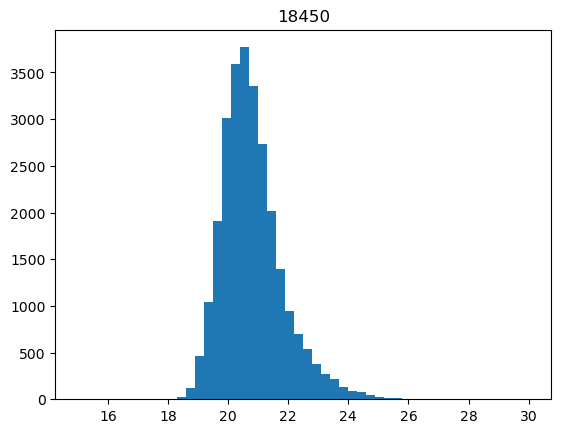

 64%|██████████████████████████████████████████████████▍                            | 687/1075 [01:31<00:49,  7.78it/s]

517


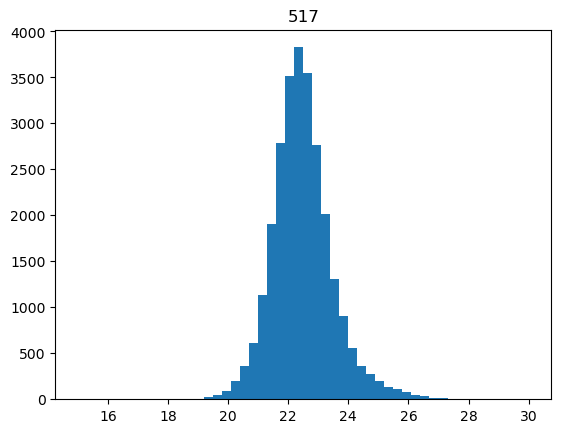

 64%|██████████████████████████████████████████████████▌                            | 688/1075 [01:32<00:59,  6.54it/s]

18979


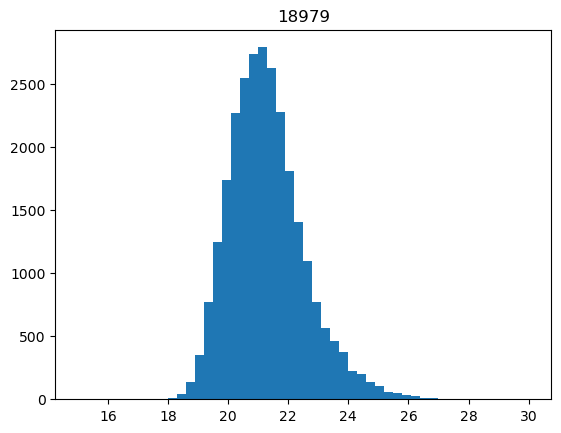

 64%|██████████████████████████████████████████████████▋                            | 689/1075 [01:32<00:55,  6.94it/s]

21267


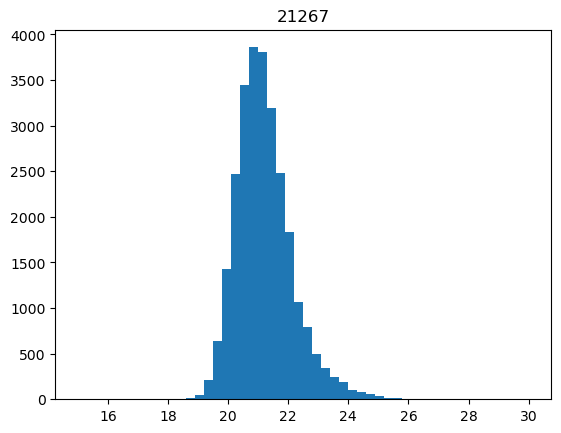

 64%|██████████████████████████████████████████████████▋                            | 690/1075 [01:32<00:53,  7.17it/s]

14408


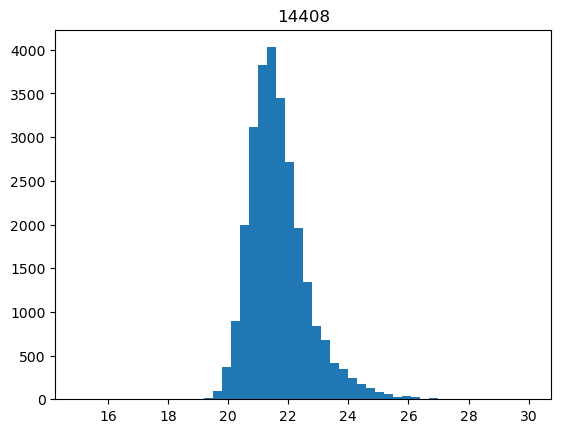

 64%|██████████████████████████████████████████████████▊                            | 691/1075 [01:32<00:52,  7.33it/s]

2288


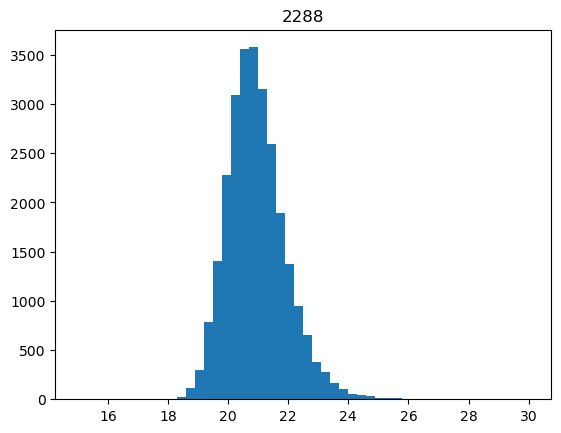

 64%|██████████████████████████████████████████████████▊                            | 692/1075 [01:32<00:51,  7.45it/s]

5869


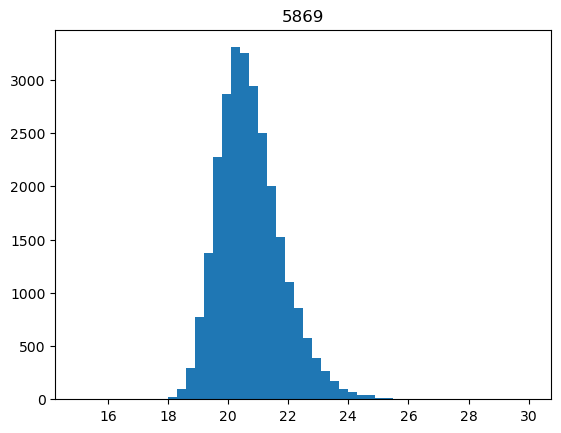

 64%|██████████████████████████████████████████████████▉                            | 693/1075 [01:32<00:50,  7.61it/s]

697


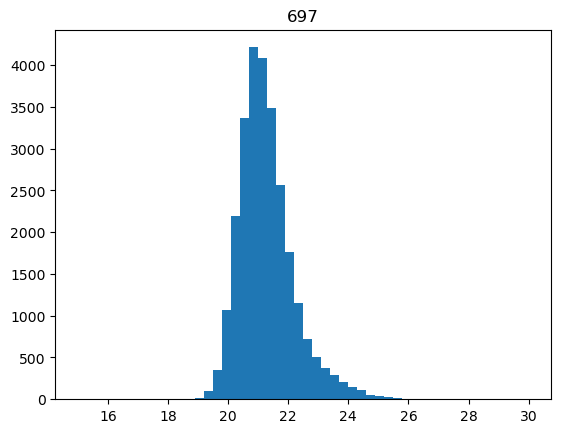

 65%|███████████████████████████████████████████████████                            | 694/1075 [01:32<00:49,  7.72it/s]

5447


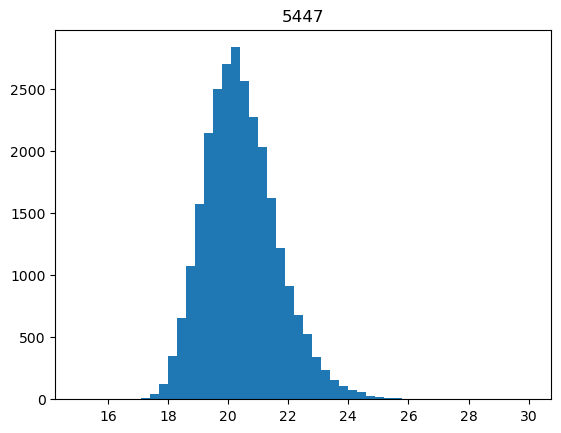

 65%|███████████████████████████████████████████████████                            | 695/1075 [01:32<00:48,  7.86it/s]

3447


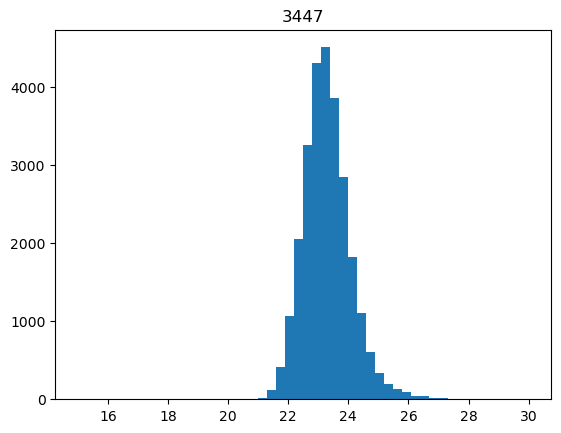

 65%|███████████████████████████████████████████████████▏                           | 696/1075 [01:33<00:47,  7.94it/s]

12916


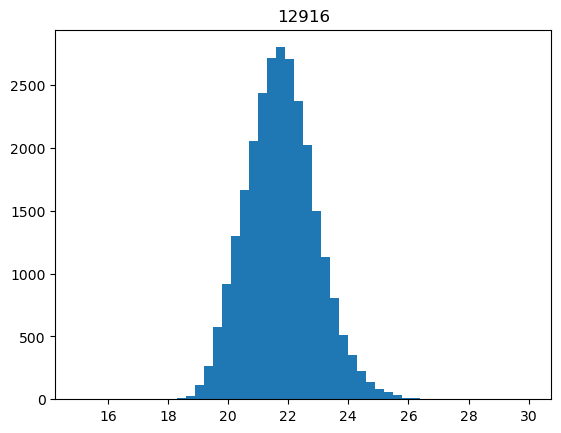

 65%|███████████████████████████████████████████████████▏                           | 697/1075 [01:33<00:47,  7.96it/s]

6382


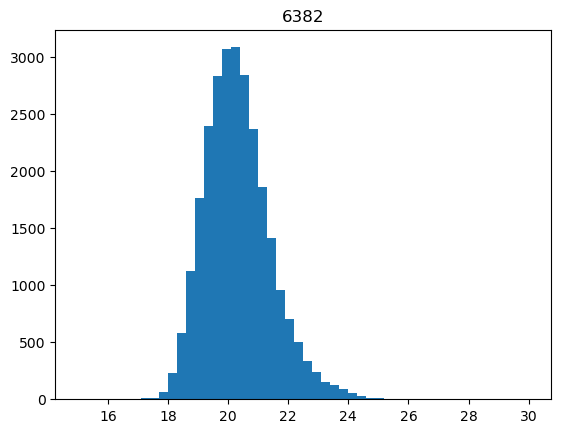

 65%|███████████████████████████████████████████████████▎                           | 698/1075 [01:33<00:47,  8.01it/s]

26386


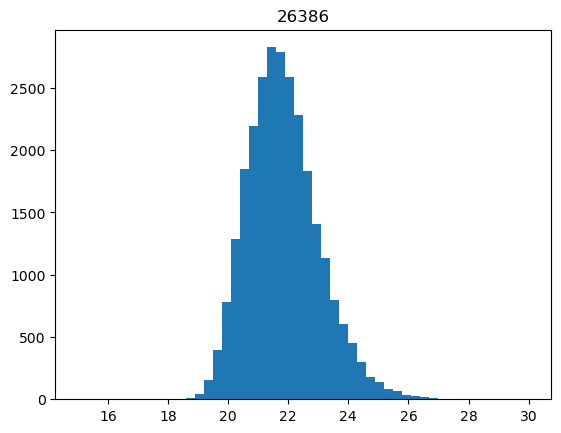

 65%|███████████████████████████████████████████████████▎                           | 699/1075 [01:33<00:56,  6.69it/s]

10447


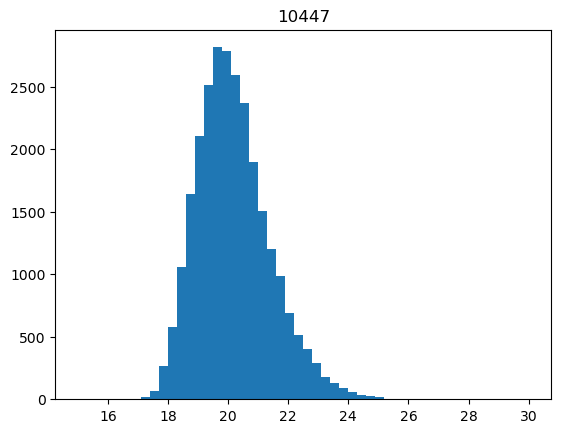

 65%|███████████████████████████████████████████████████▍                           | 700/1075 [01:33<00:53,  7.00it/s]

7932


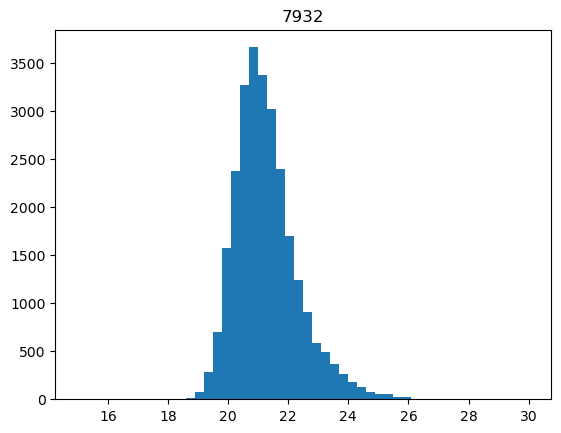

 65%|███████████████████████████████████████████████████▌                           | 701/1075 [01:33<00:51,  7.26it/s]

14327


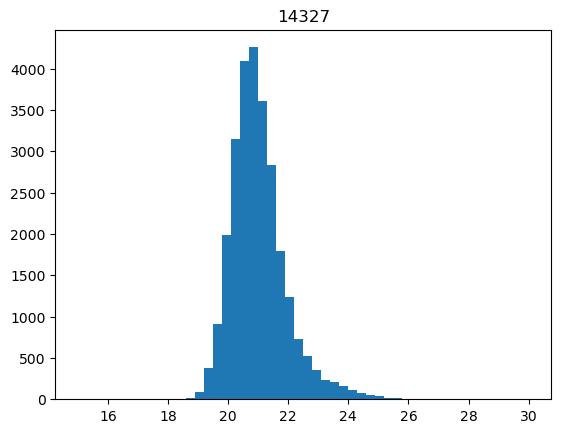

 65%|███████████████████████████████████████████████████▌                           | 702/1075 [01:33<00:50,  7.42it/s]

9631


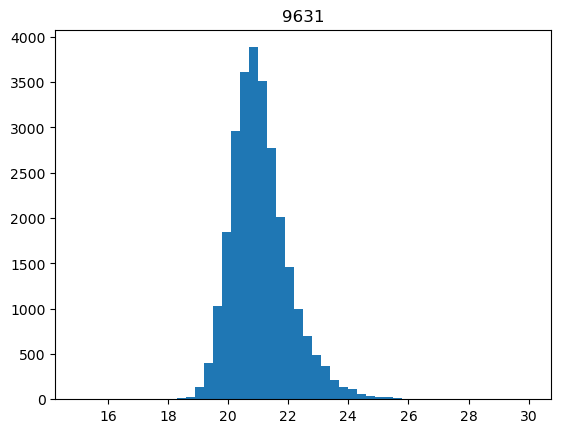

 65%|███████████████████████████████████████████████████▋                           | 703/1075 [01:34<00:49,  7.53it/s]

9335


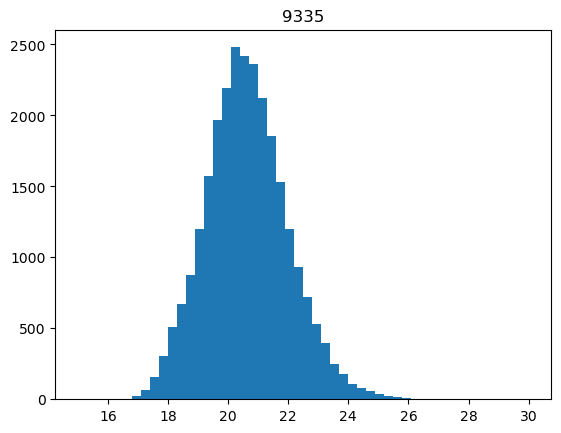

 65%|███████████████████████████████████████████████████▋                           | 704/1075 [01:34<00:48,  7.66it/s]

10015


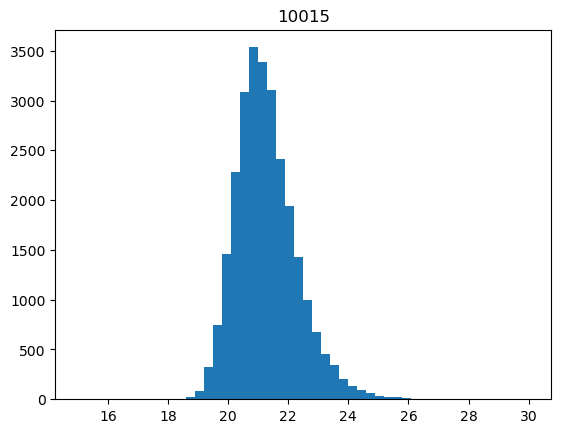

 66%|███████████████████████████████████████████████████▊                           | 705/1075 [01:34<00:48,  7.71it/s]

10106


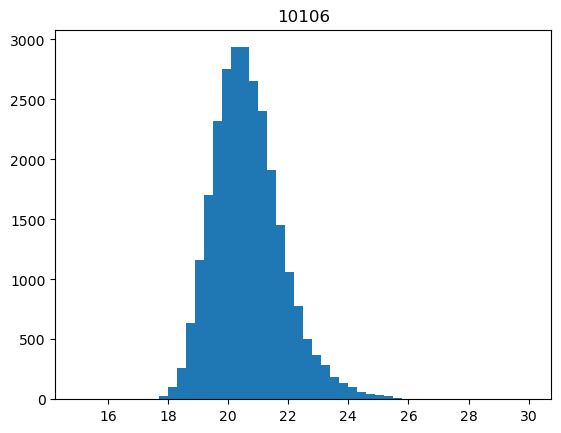

 66%|███████████████████████████████████████████████████▉                           | 706/1075 [01:34<00:47,  7.81it/s]

19077


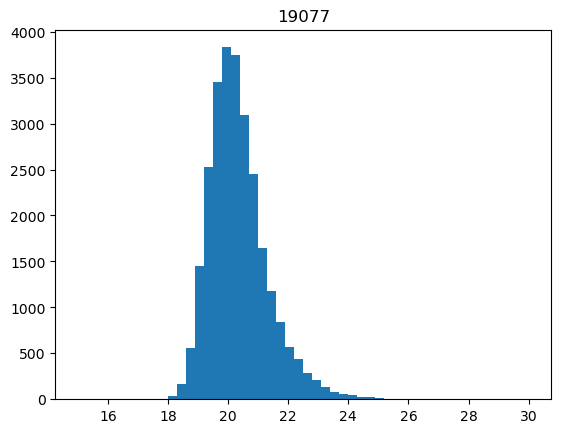

 66%|███████████████████████████████████████████████████▉                           | 707/1075 [01:34<00:47,  7.79it/s]

15611


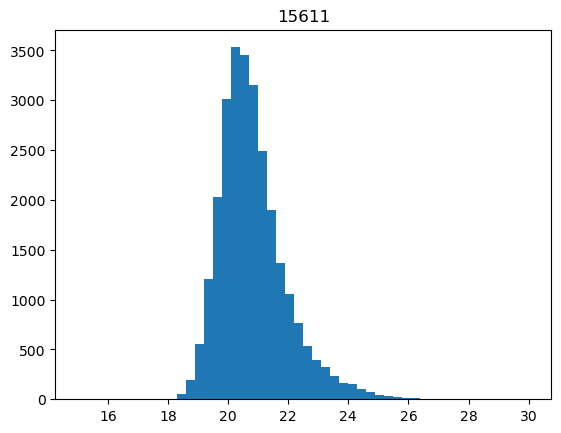

 66%|████████████████████████████████████████████████████                           | 708/1075 [01:34<00:46,  7.83it/s]

19927


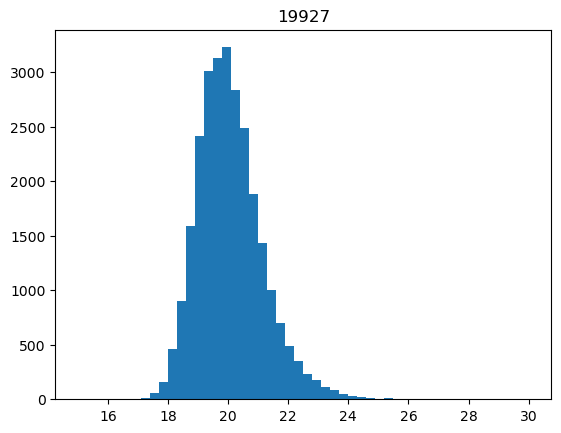

 66%|████████████████████████████████████████████████████                           | 709/1075 [01:34<00:46,  7.88it/s]

1140


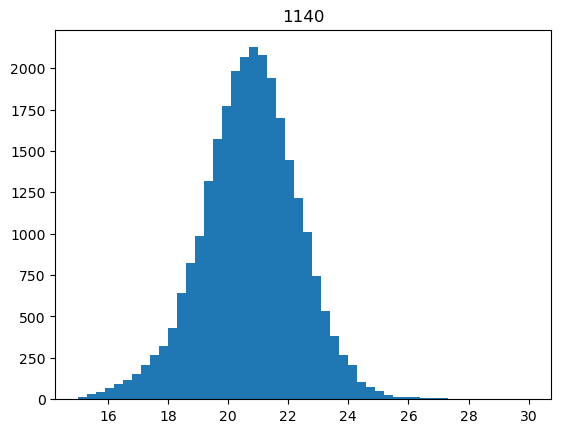

 66%|████████████████████████████████████████████████████▏                          | 710/1075 [01:35<00:55,  6.57it/s]

20631


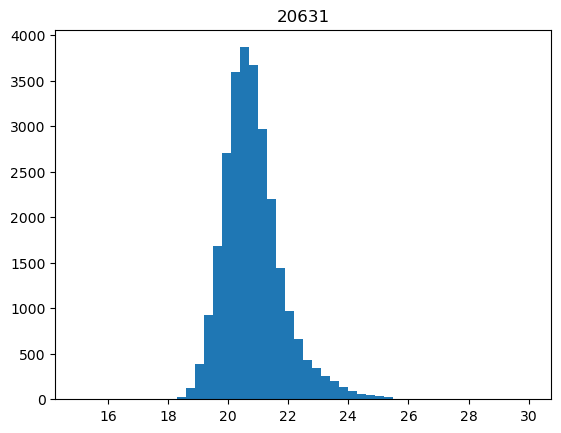

 66%|████████████████████████████████████████████████████▎                          | 711/1075 [01:35<00:52,  6.87it/s]

15036


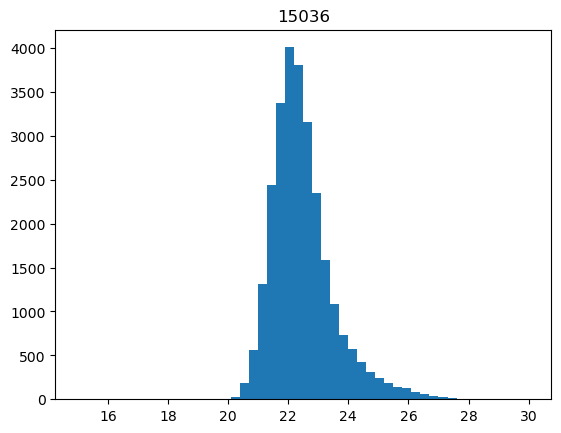

 66%|████████████████████████████████████████████████████▎                          | 712/1075 [01:35<00:50,  7.15it/s]

8325


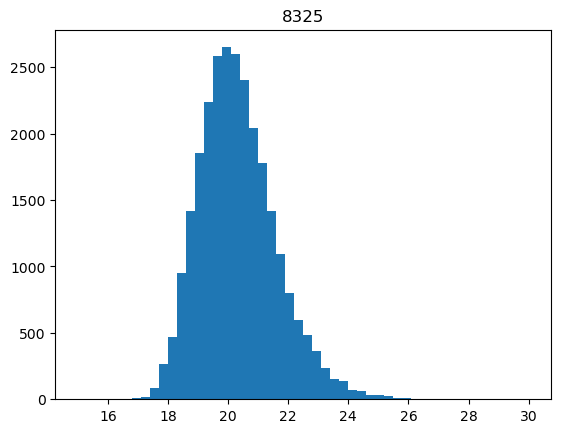

 66%|████████████████████████████████████████████████████▍                          | 713/1075 [01:35<00:48,  7.40it/s]

8620


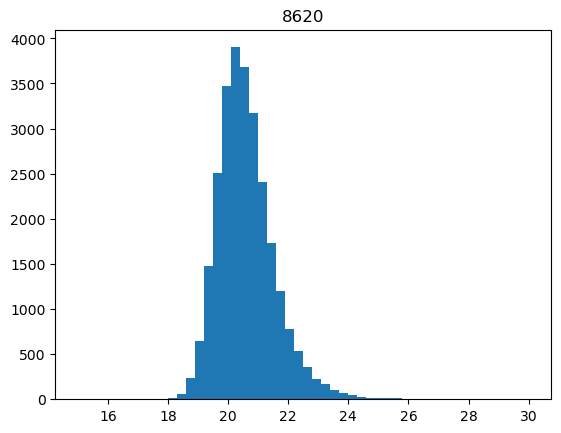

 66%|████████████████████████████████████████████████████▍                          | 714/1075 [01:35<00:48,  7.50it/s]

11258


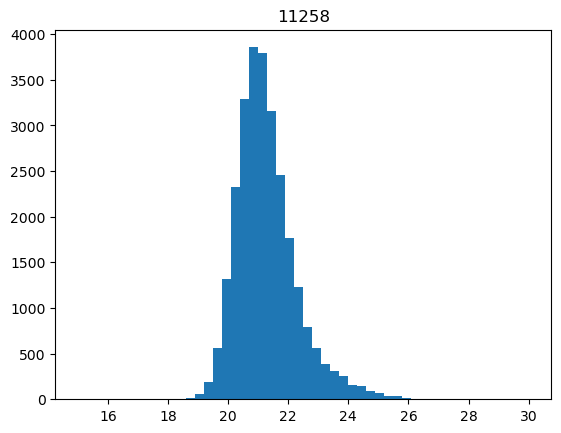

 67%|████████████████████████████████████████████████████▌                          | 715/1075 [01:35<00:47,  7.56it/s]

6031


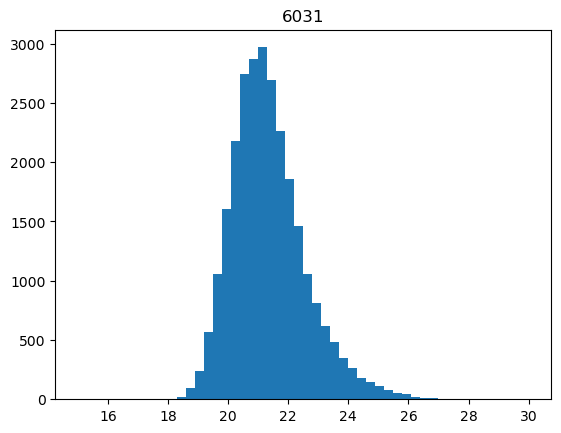

 67%|████████████████████████████████████████████████████▌                          | 716/1075 [01:35<00:46,  7.74it/s]

10923


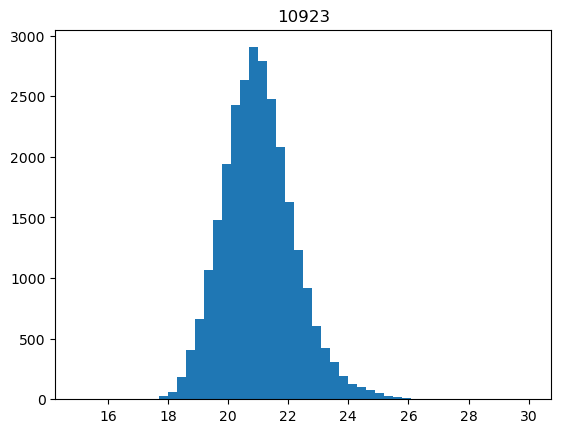

 67%|████████████████████████████████████████████████████▋                          | 717/1075 [01:35<00:45,  7.81it/s]

5267


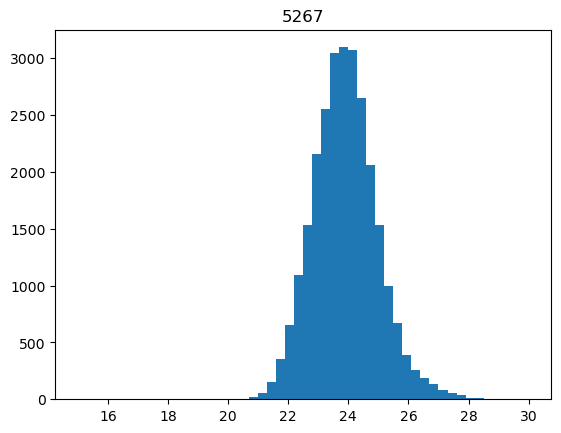

 67%|████████████████████████████████████████████████████▊                          | 718/1075 [01:36<00:45,  7.92it/s]

8084


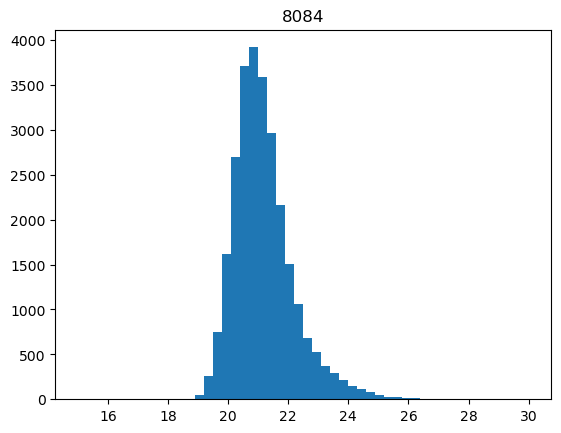

 67%|████████████████████████████████████████████████████▊                          | 719/1075 [01:36<00:45,  7.89it/s]

4656


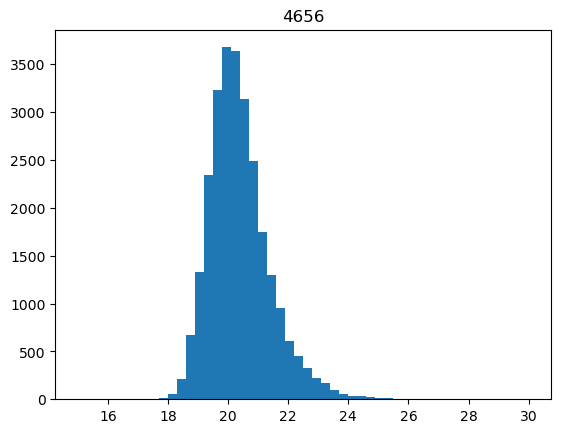

 67%|████████████████████████████████████████████████████▉                          | 720/1075 [01:36<00:44,  7.90it/s]

5407


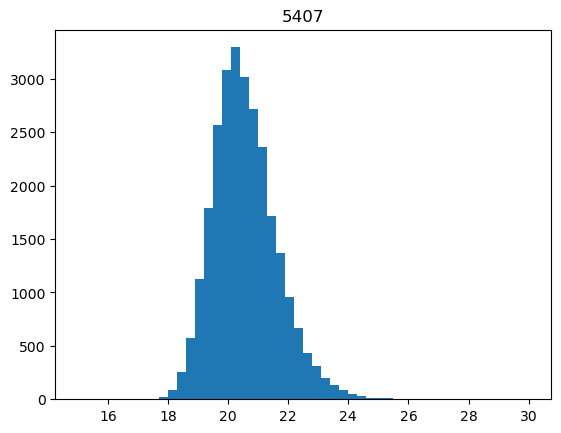

 67%|████████████████████████████████████████████████████▉                          | 721/1075 [01:36<00:53,  6.66it/s]

25592


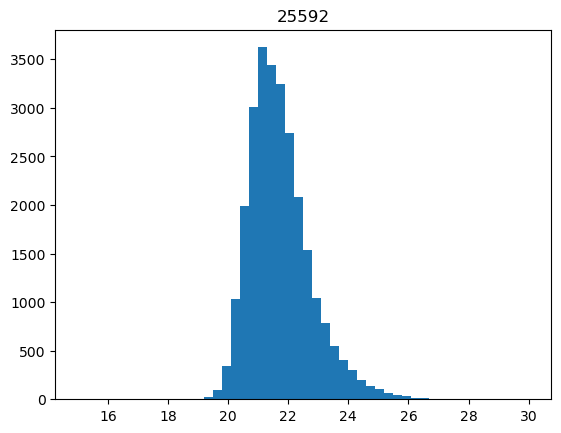

 67%|█████████████████████████████████████████████████████                          | 722/1075 [01:36<00:50,  7.04it/s]

12455


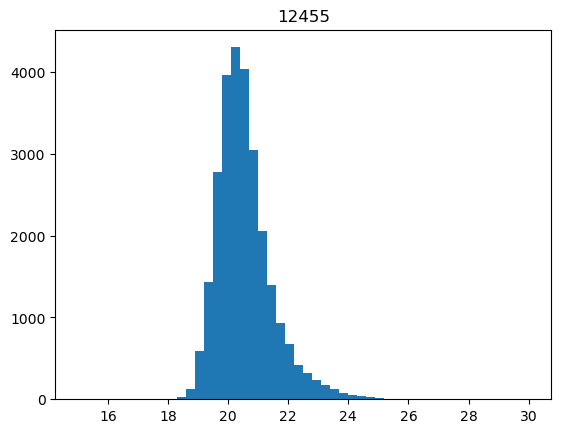

 67%|█████████████████████████████████████████████████████▏                         | 723/1075 [01:36<00:47,  7.37it/s]

1889


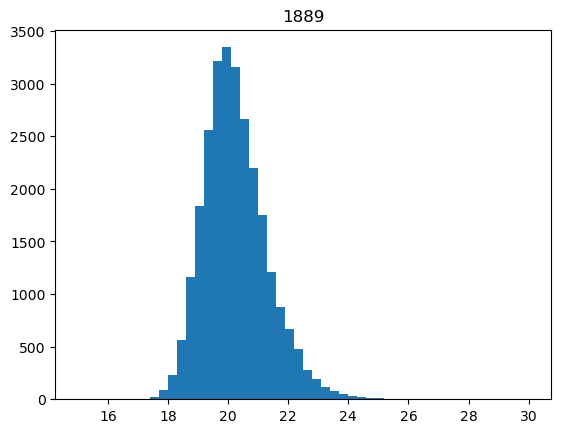

 67%|█████████████████████████████████████████████████████▏                         | 724/1075 [01:36<00:46,  7.55it/s]

3252


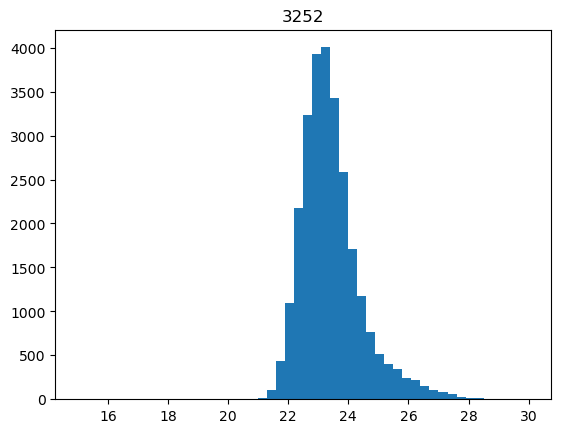

 67%|█████████████████████████████████████████████████████▎                         | 725/1075 [01:37<00:45,  7.64it/s]

18657


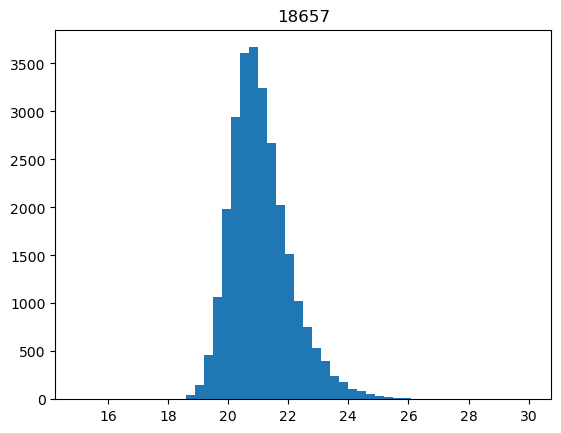

 68%|█████████████████████████████████████████████████████▎                         | 726/1075 [01:37<00:45,  7.73it/s]

23626


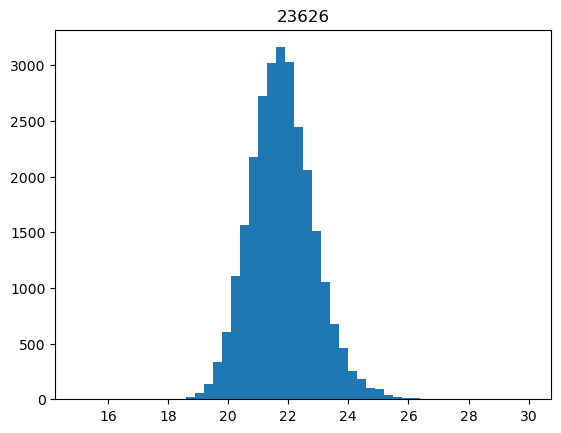

 68%|█████████████████████████████████████████████████████▍                         | 727/1075 [01:37<00:44,  7.81it/s]

2861


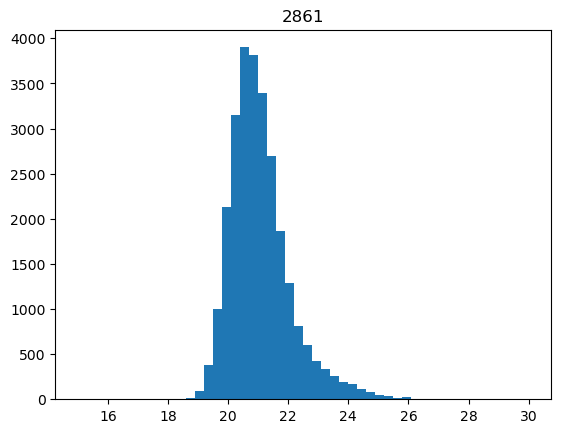

 68%|█████████████████████████████████████████████████████▍                         | 728/1075 [01:37<00:44,  7.81it/s]

8382


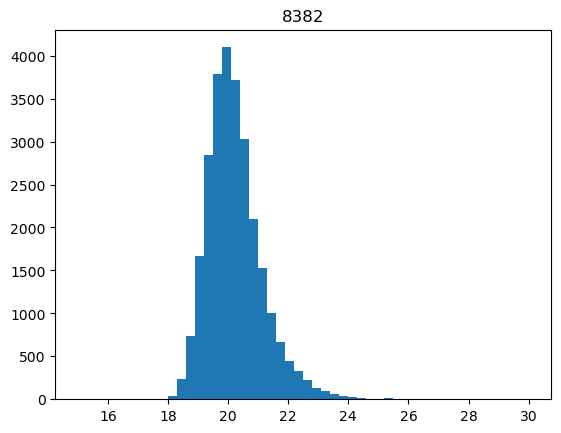

 68%|█████████████████████████████████████████████████████▌                         | 729/1075 [01:37<00:44,  7.83it/s]

17997


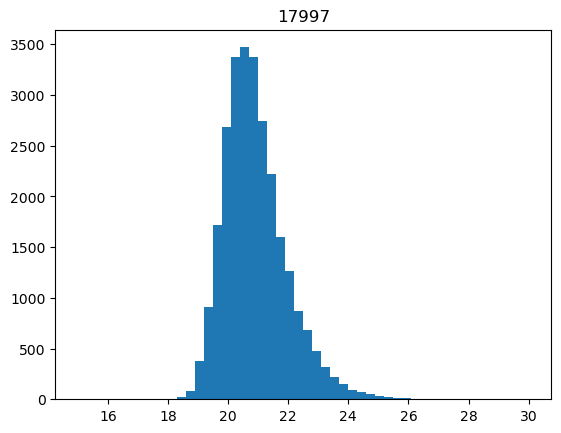

 68%|█████████████████████████████████████████████████████▋                         | 730/1075 [01:37<00:43,  7.86it/s]

4365


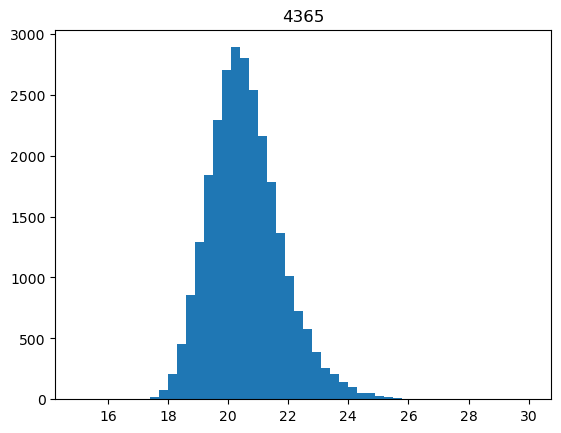

 68%|█████████████████████████████████████████████████████▋                         | 731/1075 [01:37<00:43,  7.94it/s]

6786


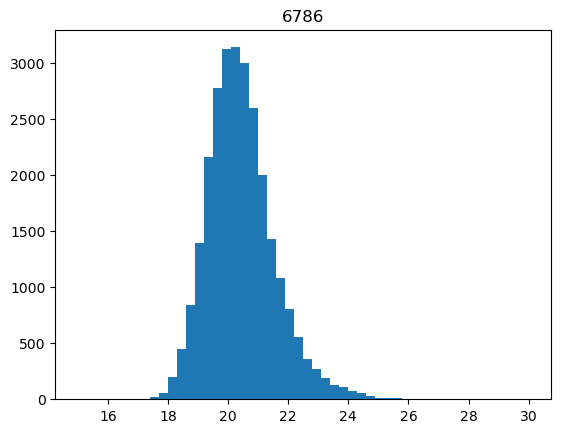

 68%|█████████████████████████████████████████████████████▊                         | 732/1075 [01:37<00:51,  6.69it/s]

22127


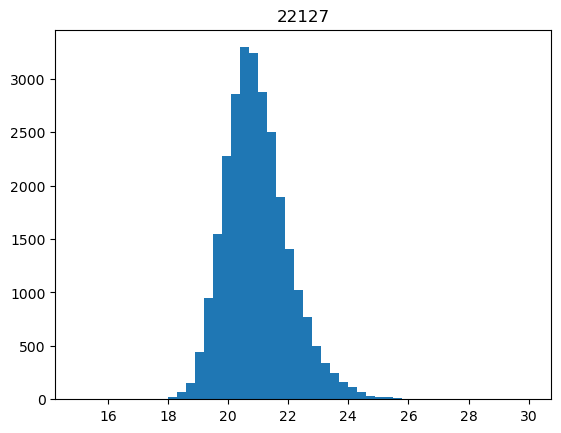

 68%|█████████████████████████████████████████████████████▊                         | 733/1075 [01:38<00:48,  7.05it/s]

18070


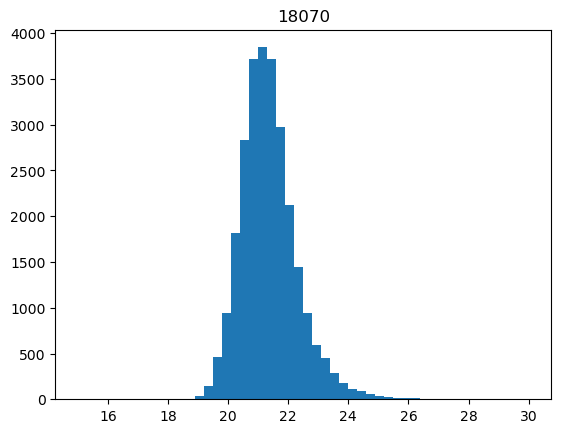

 68%|█████████████████████████████████████████████████████▉                         | 734/1075 [01:38<00:46,  7.26it/s]

26180


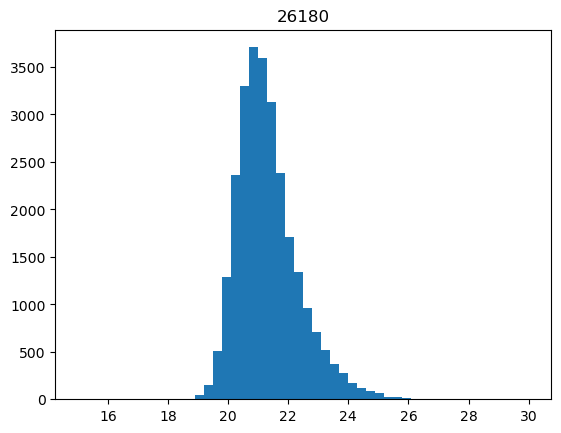

 68%|██████████████████████████████████████████████████████                         | 735/1075 [01:38<00:45,  7.40it/s]

728


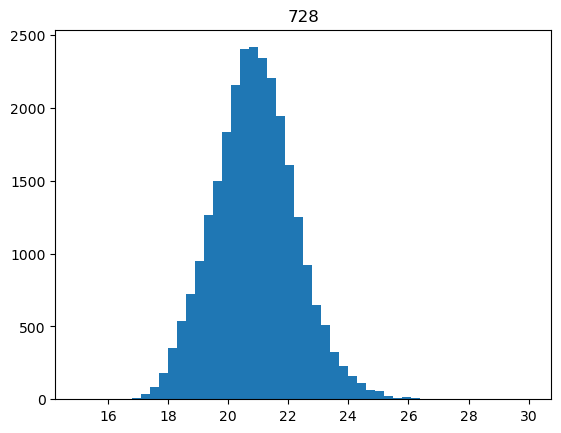

 68%|██████████████████████████████████████████████████████                         | 736/1075 [01:38<00:44,  7.59it/s]

3324


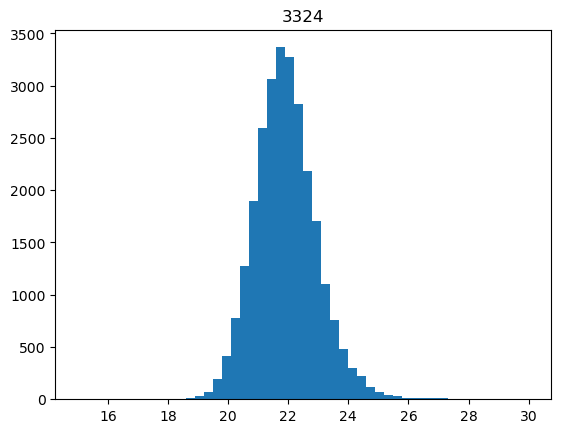

 69%|██████████████████████████████████████████████████████▏                        | 737/1075 [01:38<00:44,  7.64it/s]

22749


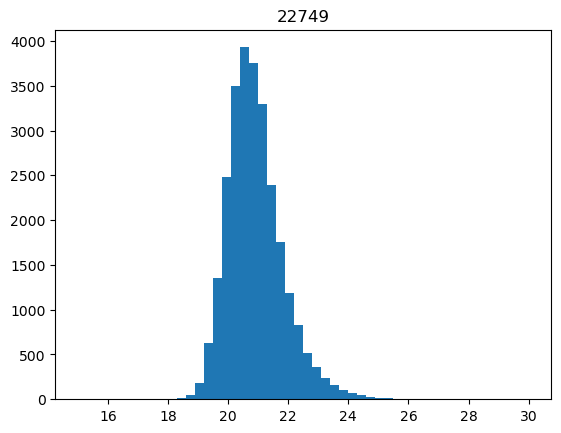

 69%|██████████████████████████████████████████████████████▏                        | 738/1075 [01:38<00:44,  7.65it/s]

7669


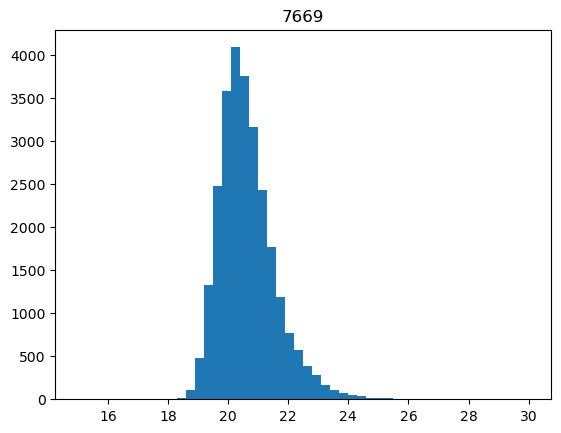

 69%|██████████████████████████████████████████████████████▎                        | 739/1075 [01:38<00:43,  7.68it/s]

88


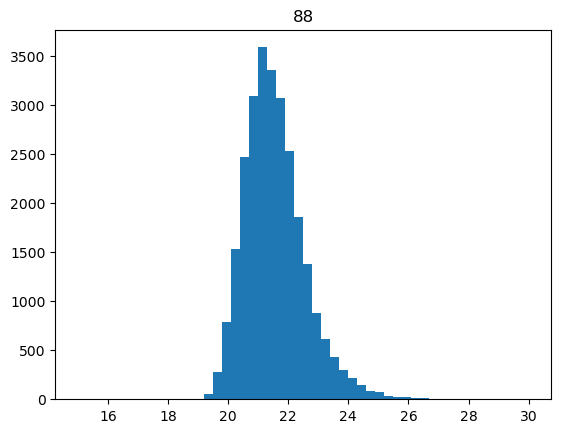

 69%|██████████████████████████████████████████████████████▍                        | 740/1075 [01:38<00:43,  7.72it/s]

25


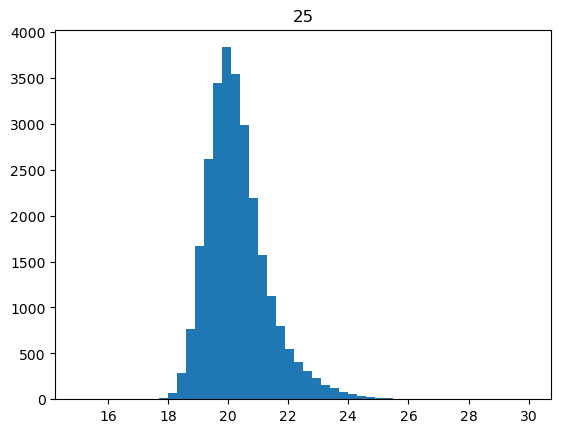

 69%|██████████████████████████████████████████████████████▍                        | 741/1075 [01:39<00:43,  7.66it/s]

5846


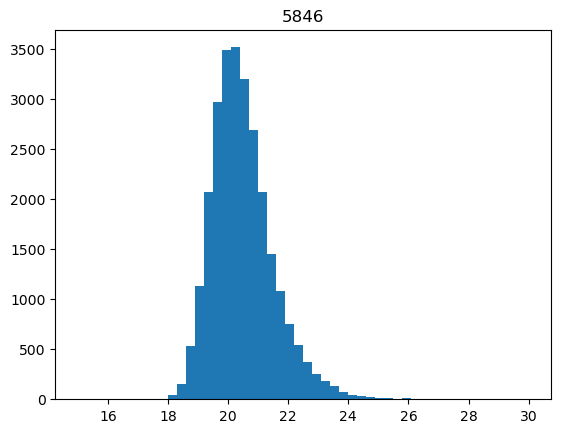

 69%|██████████████████████████████████████████████████████▌                        | 742/1075 [01:39<00:43,  7.72it/s]

5436


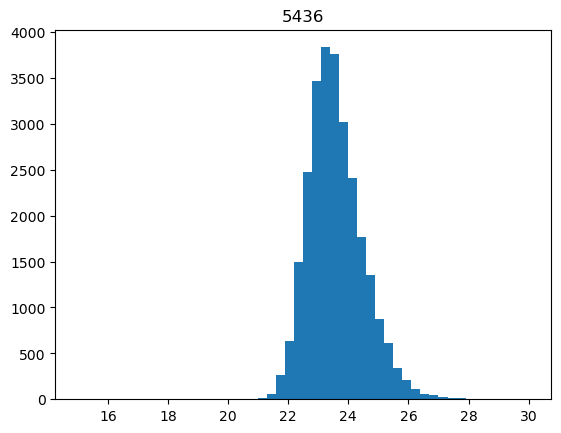

 69%|██████████████████████████████████████████████████████▌                        | 743/1075 [01:39<00:51,  6.48it/s]

25141


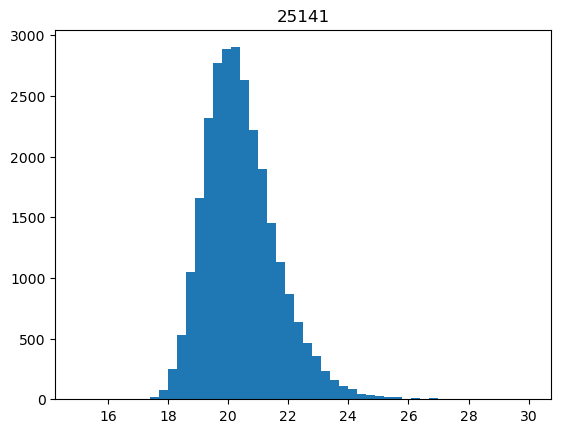

 69%|██████████████████████████████████████████████████████▋                        | 744/1075 [01:39<00:48,  6.86it/s]

14316


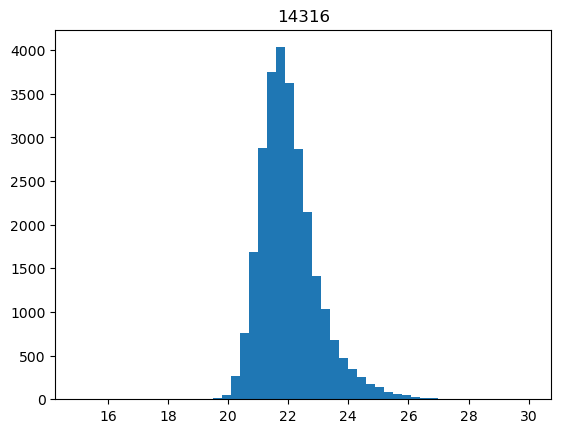

 69%|██████████████████████████████████████████████████████▋                        | 745/1075 [01:39<00:46,  7.04it/s]

9360


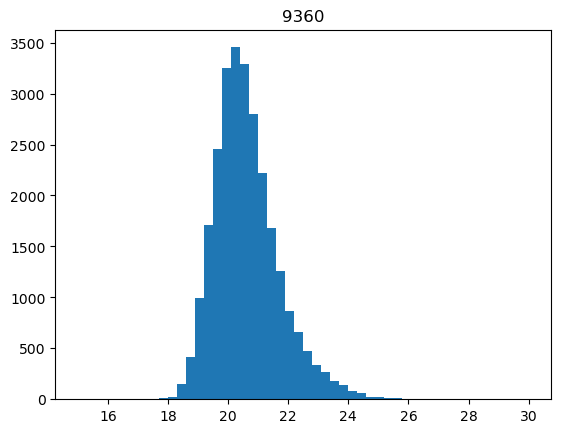

 69%|██████████████████████████████████████████████████████▊                        | 746/1075 [01:39<00:45,  7.23it/s]

3884


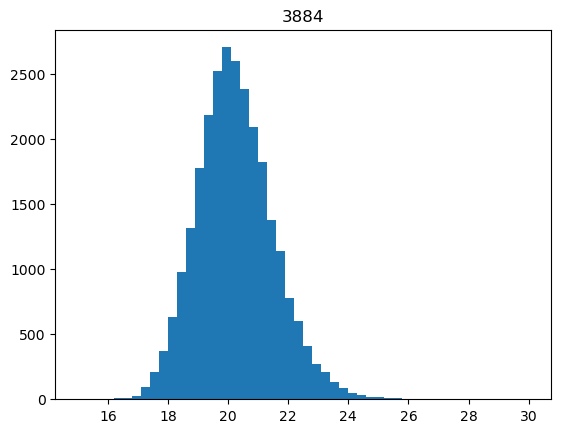

 69%|██████████████████████████████████████████████████████▉                        | 747/1075 [01:39<00:43,  7.47it/s]

21371


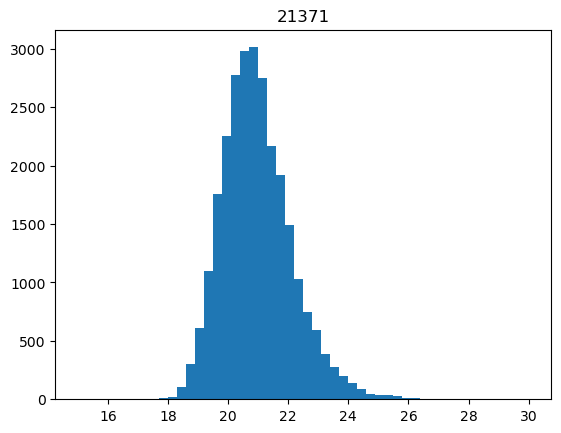

 70%|██████████████████████████████████████████████████████▉                        | 748/1075 [01:40<00:42,  7.61it/s]

22597


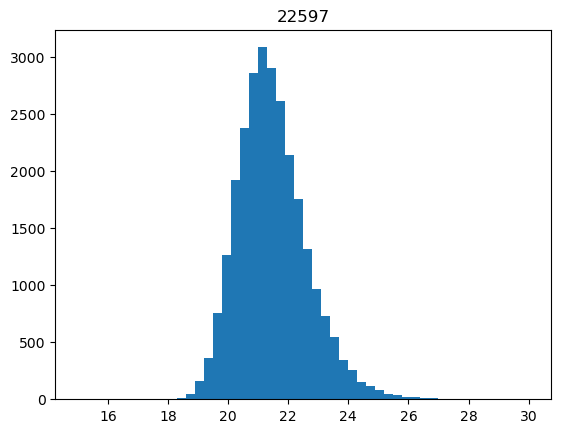

 70%|███████████████████████████████████████████████████████                        | 749/1075 [01:40<00:42,  7.68it/s]

9557


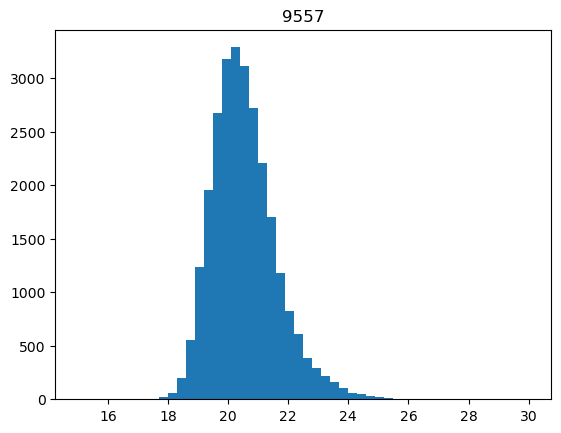

 70%|███████████████████████████████████████████████████████                        | 750/1075 [01:40<00:41,  7.79it/s]

18625


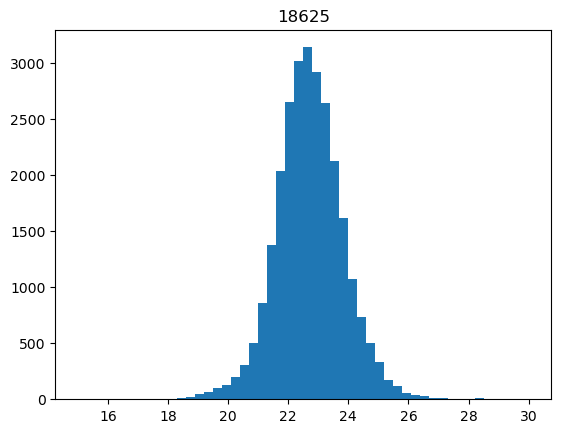

 70%|███████████████████████████████████████████████████████▏                       | 751/1075 [01:40<00:41,  7.87it/s]

964


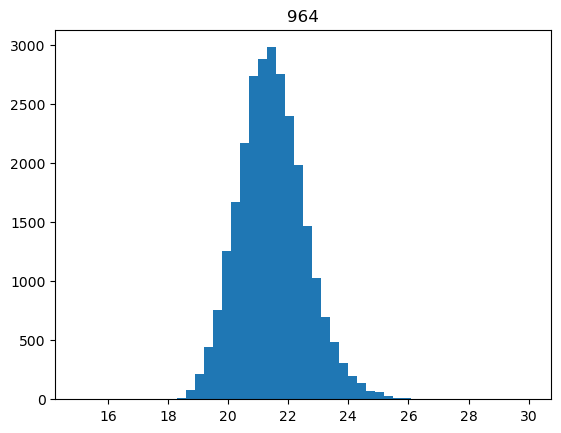

 70%|███████████████████████████████████████████████████████▎                       | 752/1075 [01:40<00:40,  7.93it/s]

16416


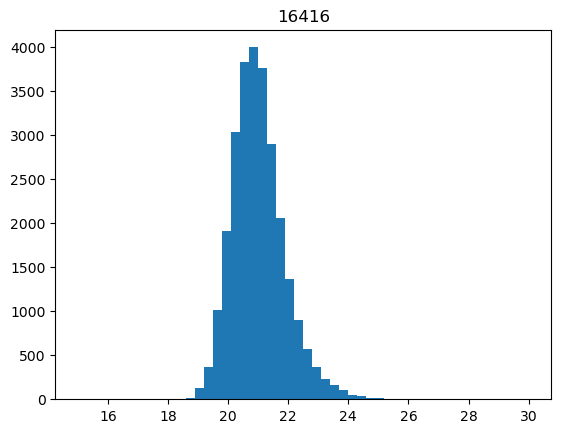

 70%|███████████████████████████████████████████████████████▎                       | 753/1075 [01:40<00:40,  7.86it/s]

25935


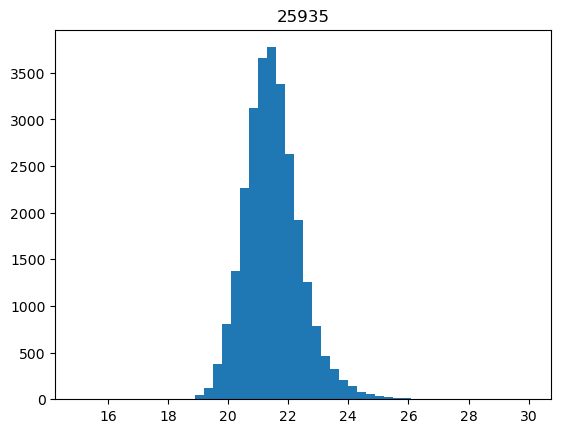

 70%|███████████████████████████████████████████████████████▍                       | 754/1075 [01:40<00:48,  6.59it/s]

6489


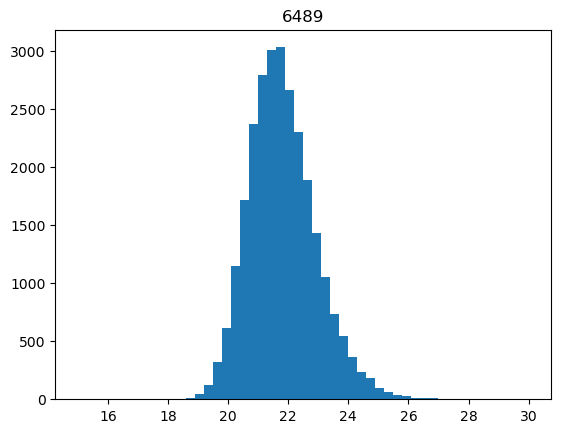

 70%|███████████████████████████████████████████████████████▍                       | 755/1075 [01:41<00:45,  6.98it/s]

16371


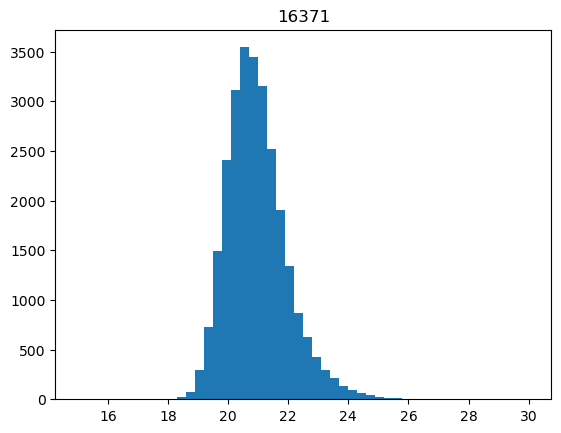

 70%|███████████████████████████████████████████████████████▌                       | 756/1075 [01:41<00:44,  7.23it/s]

16581


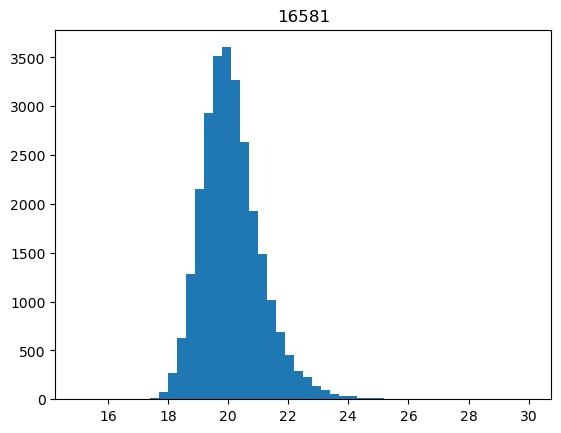

 70%|███████████████████████████████████████████████████████▋                       | 757/1075 [01:41<00:42,  7.41it/s]

2142


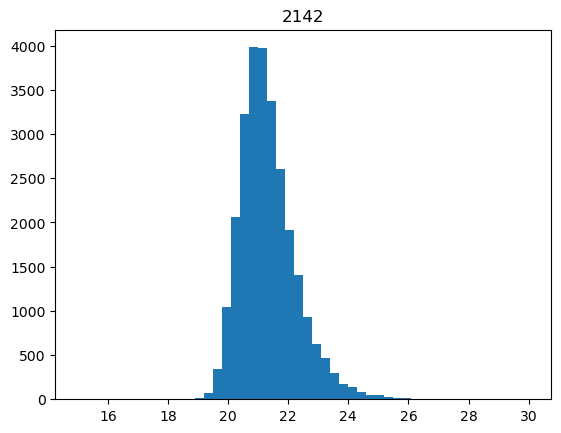

 71%|███████████████████████████████████████████████████████▋                       | 758/1075 [01:41<00:42,  7.51it/s]

2072


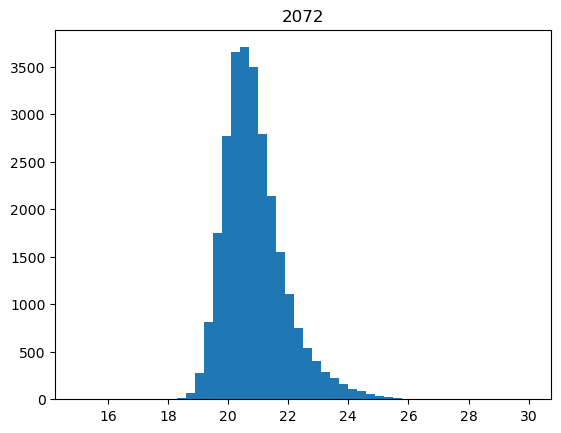

 71%|███████████████████████████████████████████████████████▊                       | 759/1075 [01:41<00:41,  7.63it/s]

25094


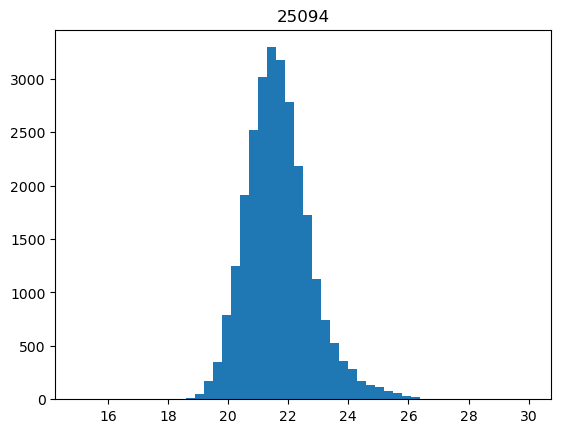

 71%|███████████████████████████████████████████████████████▊                       | 760/1075 [01:41<00:40,  7.77it/s]

5522


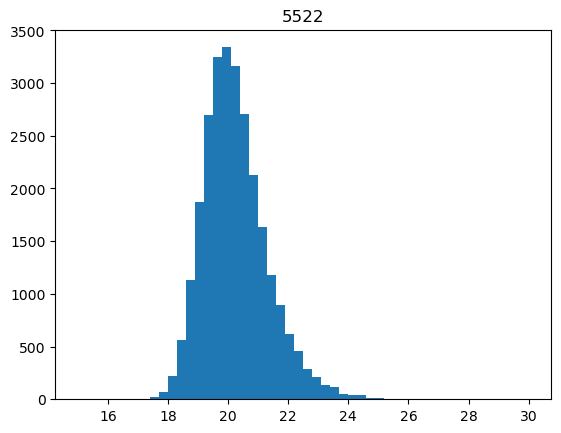

 71%|███████████████████████████████████████████████████████▉                       | 761/1075 [01:41<00:40,  7.80it/s]

10484


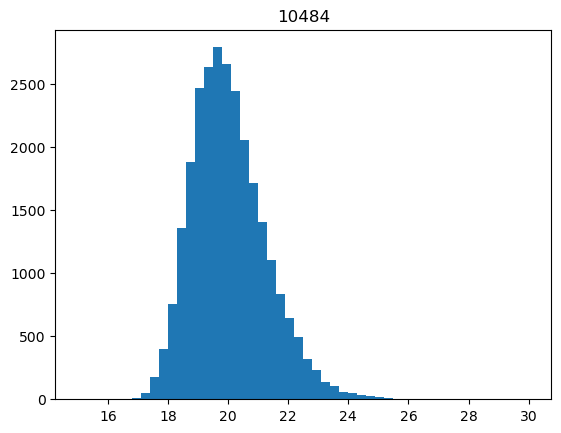

 71%|███████████████████████████████████████████████████████▉                       | 762/1075 [01:41<00:39,  7.90it/s]

19978


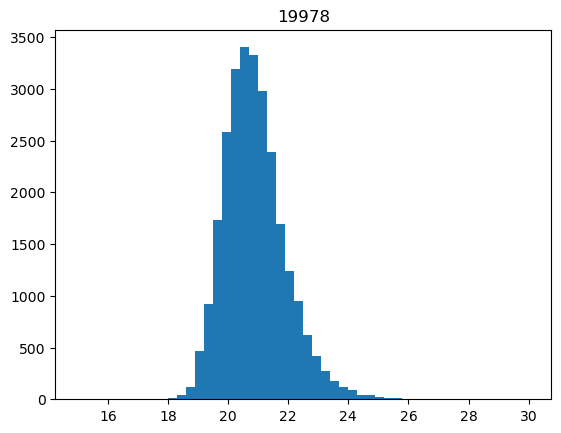

 71%|████████████████████████████████████████████████████████                       | 763/1075 [01:42<00:39,  7.85it/s]

16393


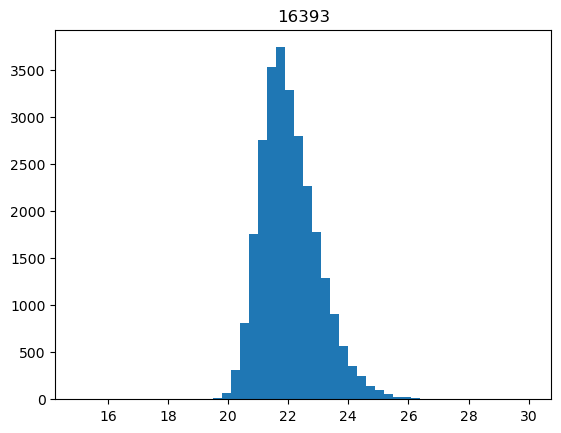

 71%|████████████████████████████████████████████████████████▏                      | 764/1075 [01:42<00:39,  7.88it/s]

9997


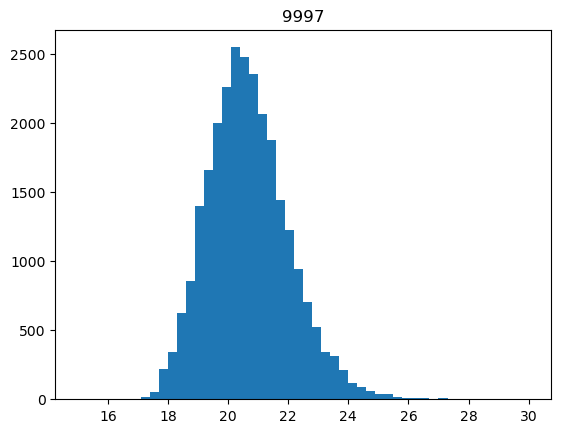

 71%|████████████████████████████████████████████████████████▏                      | 765/1075 [01:42<00:46,  6.64it/s]

18054


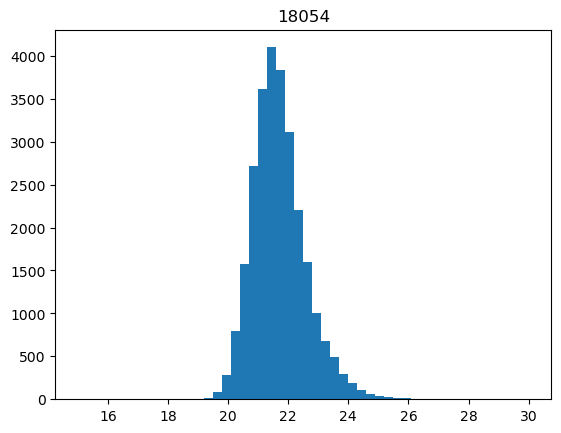

 71%|████████████████████████████████████████████████████████▎                      | 766/1075 [01:42<00:44,  6.94it/s]

21576


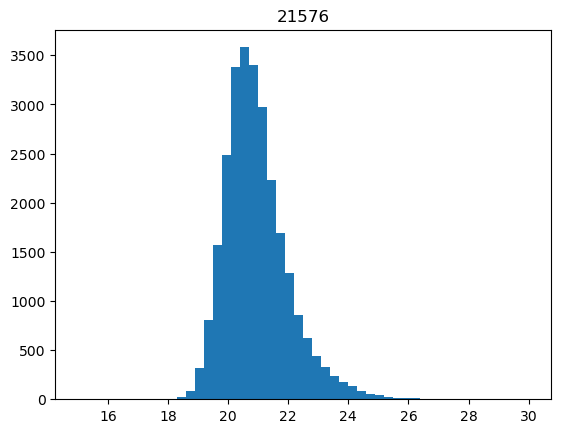

 71%|████████████████████████████████████████████████████████▎                      | 767/1075 [01:42<00:42,  7.19it/s]

4689


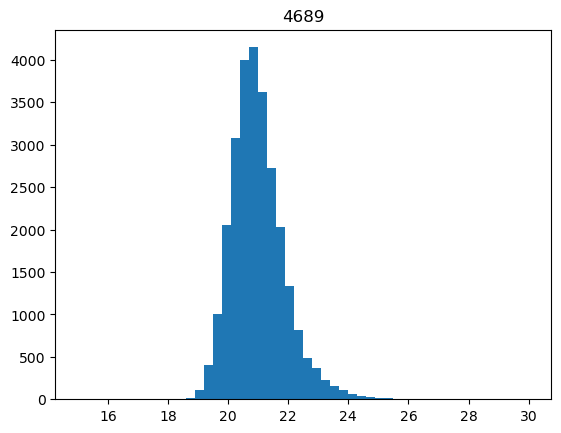

 71%|████████████████████████████████████████████████████████▍                      | 768/1075 [01:42<00:41,  7.33it/s]

19036


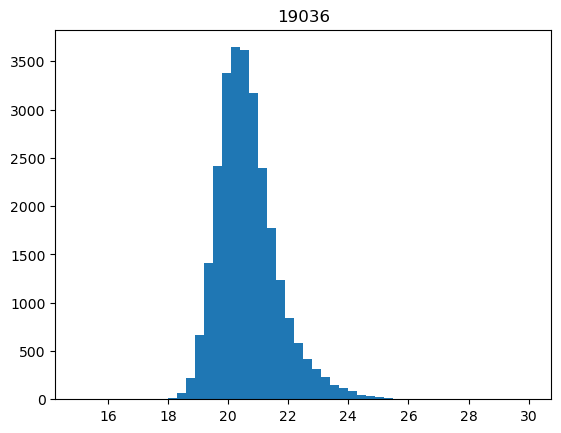

 72%|████████████████████████████████████████████████████████▌                      | 769/1075 [01:42<00:40,  7.51it/s]

24948


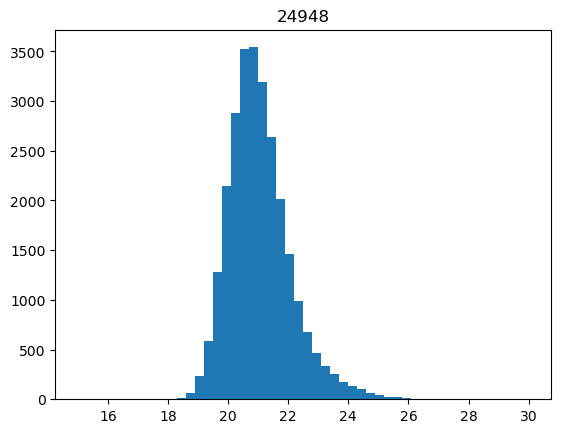

 72%|████████████████████████████████████████████████████████▌                      | 770/1075 [01:43<00:39,  7.65it/s]

24974


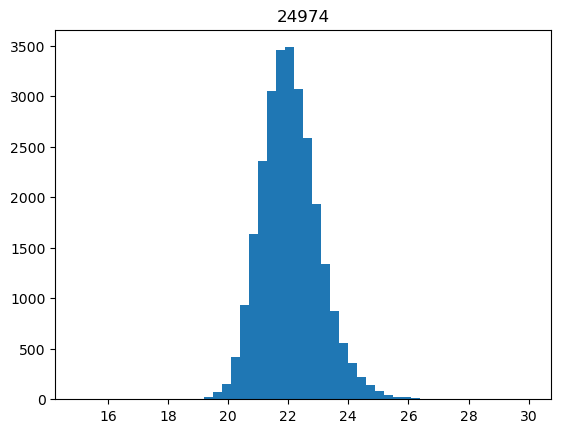

 72%|████████████████████████████████████████████████████████▋                      | 771/1075 [01:43<00:39,  7.71it/s]

4326


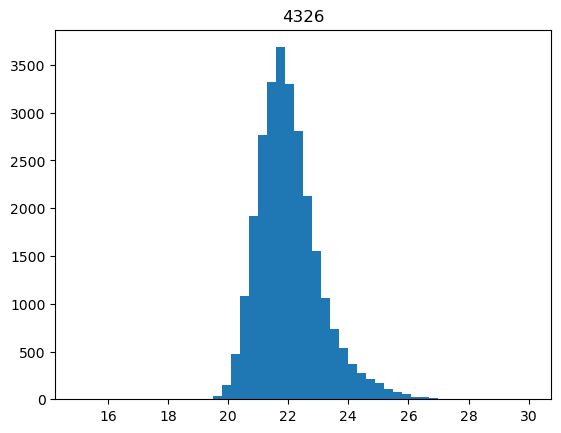

 72%|████████████████████████████████████████████████████████▋                      | 772/1075 [01:43<00:38,  7.80it/s]

17020


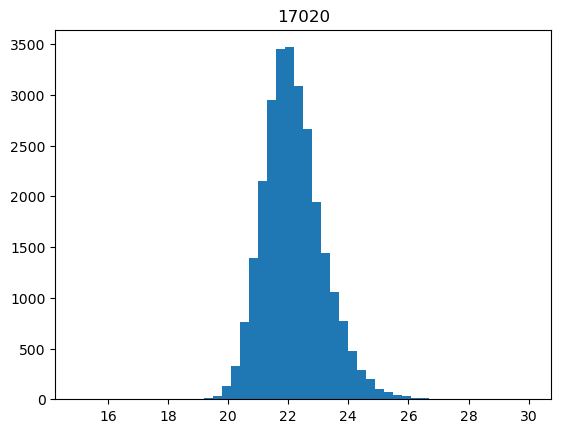

 72%|████████████████████████████████████████████████████████▊                      | 773/1075 [01:43<00:38,  7.82it/s]

16141


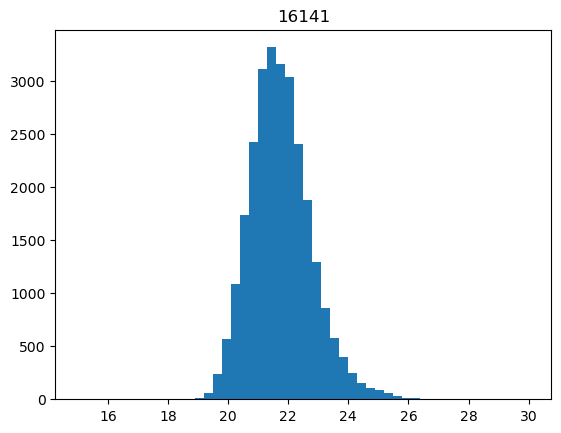

 72%|████████████████████████████████████████████████████████▉                      | 774/1075 [01:43<00:38,  7.85it/s]

22816


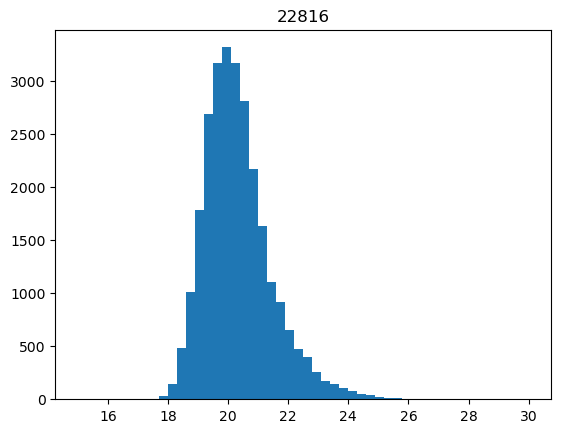

 72%|████████████████████████████████████████████████████████▉                      | 775/1075 [01:43<00:37,  7.90it/s]

7938


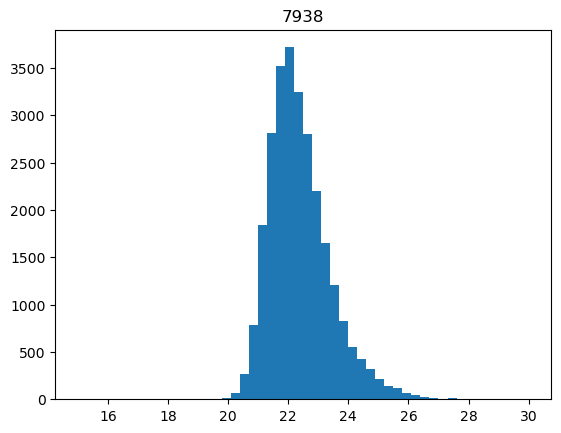

 72%|█████████████████████████████████████████████████████████                      | 776/1075 [01:43<00:45,  6.62it/s]

10505


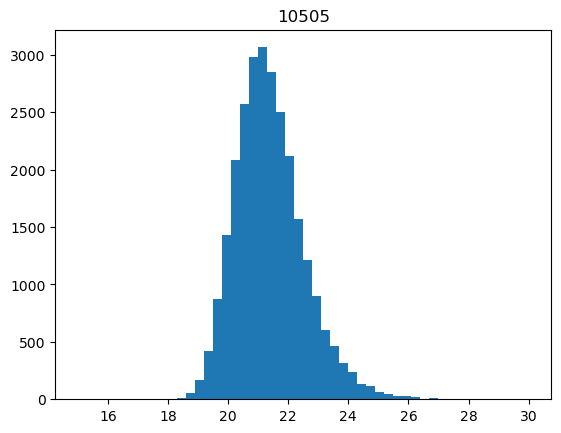

 72%|█████████████████████████████████████████████████████████                      | 777/1075 [01:44<00:42,  7.00it/s]

671


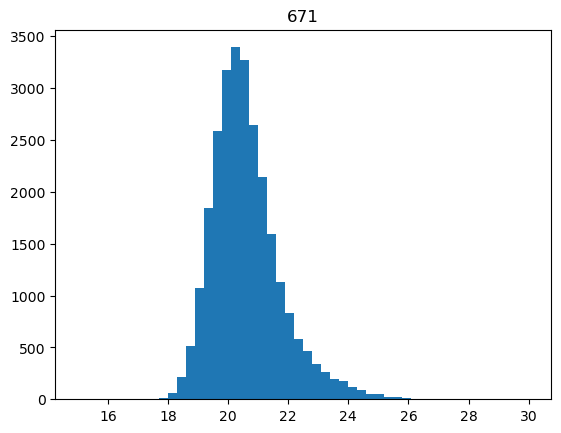

 72%|█████████████████████████████████████████████████████████▏                     | 778/1075 [01:44<00:40,  7.25it/s]

25534


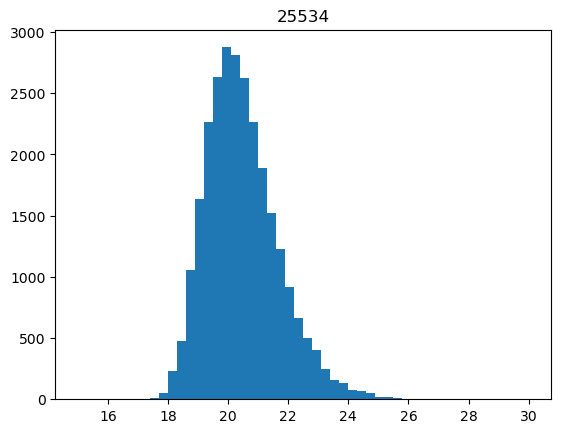

 72%|█████████████████████████████████████████████████████████▏                     | 779/1075 [01:44<00:39,  7.46it/s]

6832


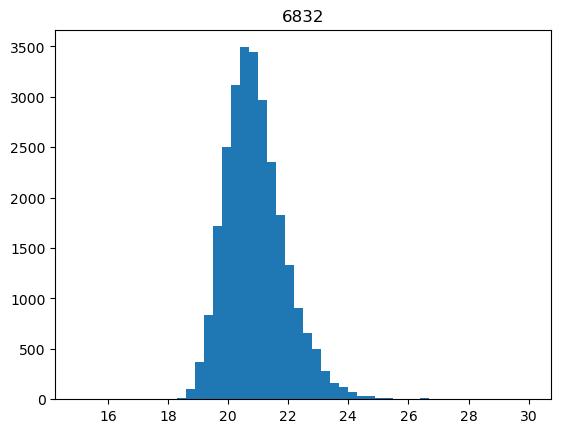

 73%|█████████████████████████████████████████████████████████▎                     | 780/1075 [01:44<00:39,  7.56it/s]

19519


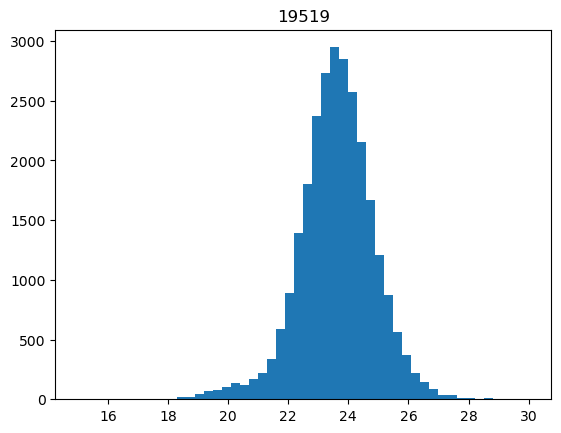

 73%|█████████████████████████████████████████████████████████▍                     | 781/1075 [01:44<00:38,  7.65it/s]

13568


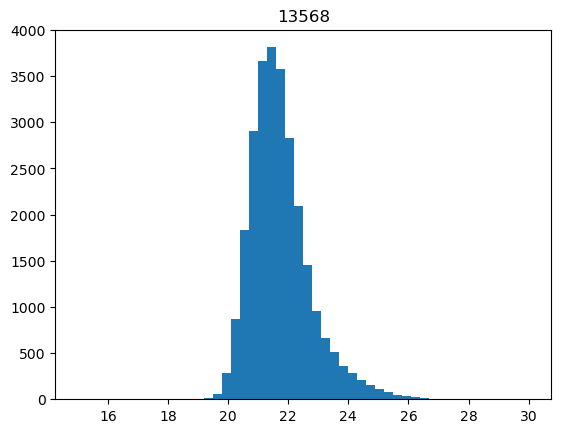

 73%|█████████████████████████████████████████████████████████▍                     | 782/1075 [01:44<00:37,  7.72it/s]

21637


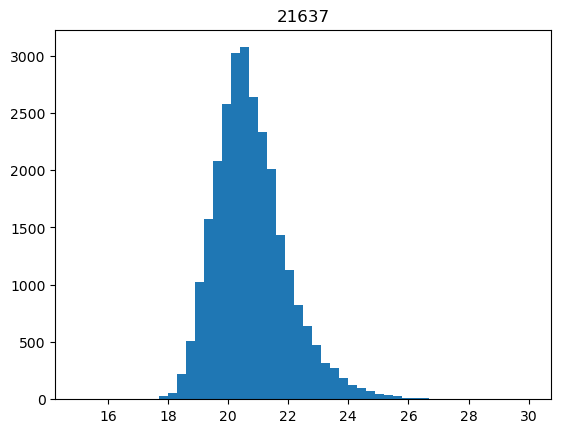

 73%|█████████████████████████████████████████████████████████▌                     | 783/1075 [01:44<00:37,  7.76it/s]

7329


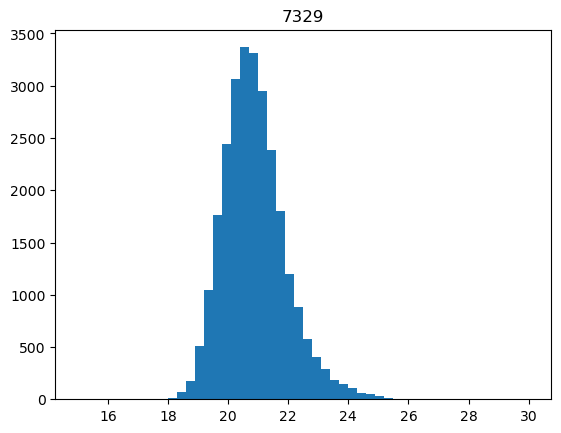

 73%|█████████████████████████████████████████████████████████▌                     | 784/1075 [01:44<00:37,  7.80it/s]

14747


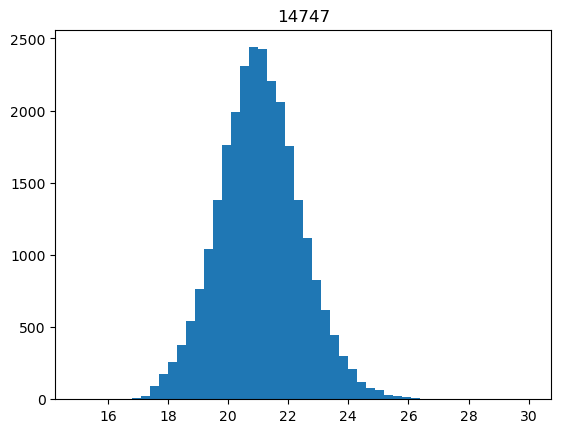

 73%|█████████████████████████████████████████████████████████▋                     | 785/1075 [01:45<00:36,  7.87it/s]

12598


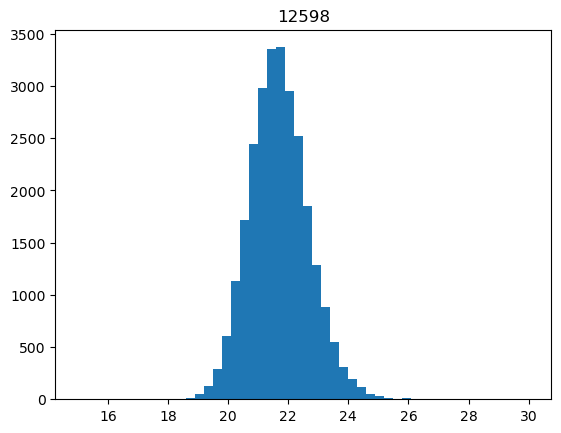

 73%|█████████████████████████████████████████████████████████▊                     | 786/1075 [01:45<00:36,  7.91it/s]

22072


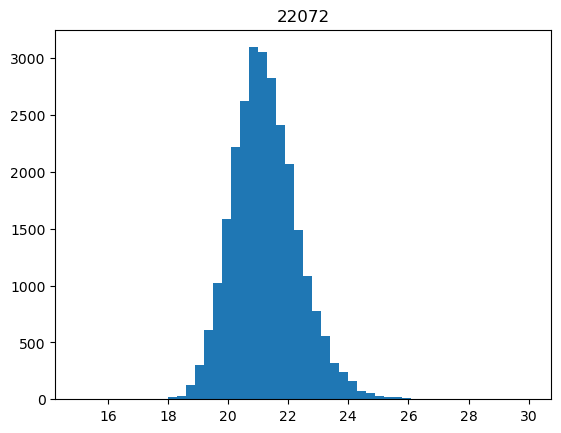

 73%|█████████████████████████████████████████████████████████▊                     | 787/1075 [01:45<00:43,  6.65it/s]

26437


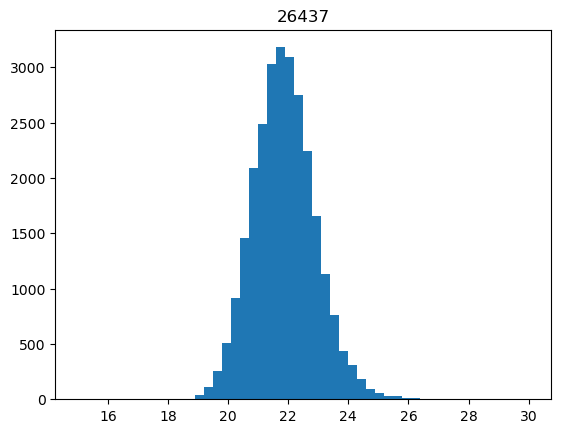

 73%|█████████████████████████████████████████████████████████▉                     | 788/1075 [01:45<00:40,  7.02it/s]

2464


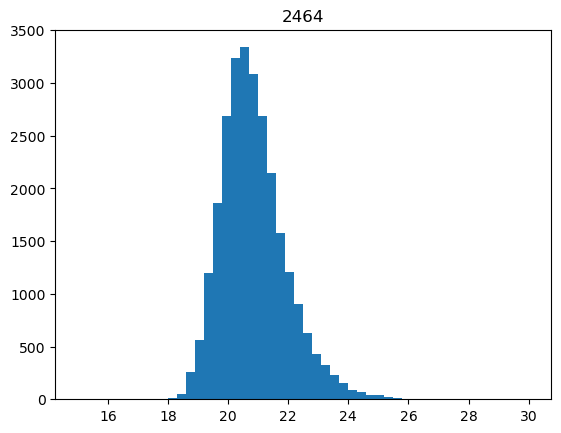

 73%|█████████████████████████████████████████████████████████▉                     | 789/1075 [01:45<00:39,  7.24it/s]

12302


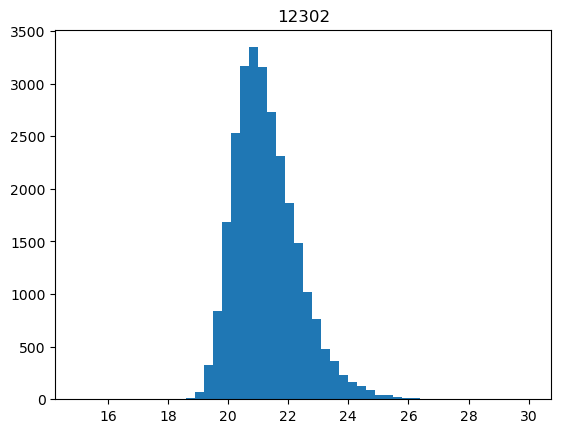

 73%|██████████████████████████████████████████████████████████                     | 790/1075 [01:45<00:38,  7.44it/s]

3584


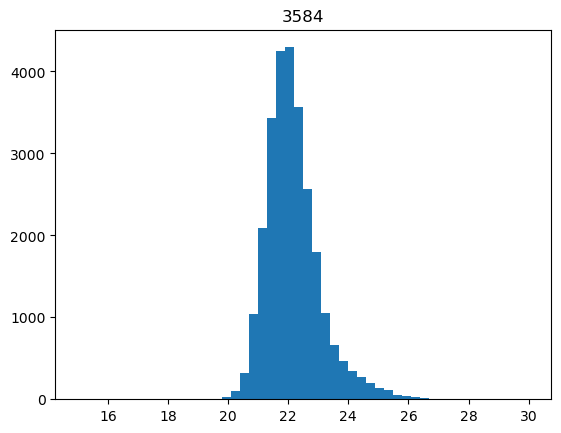

 74%|██████████████████████████████████████████████████████████▏                    | 791/1075 [01:45<00:37,  7.67it/s]

18196


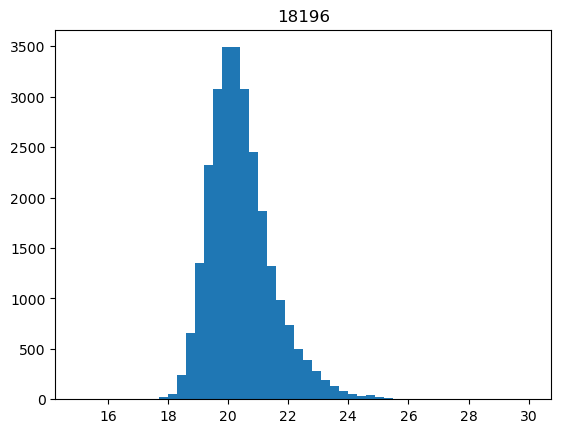

 74%|██████████████████████████████████████████████████████████▏                    | 792/1075 [01:45<00:36,  7.73it/s]

14038


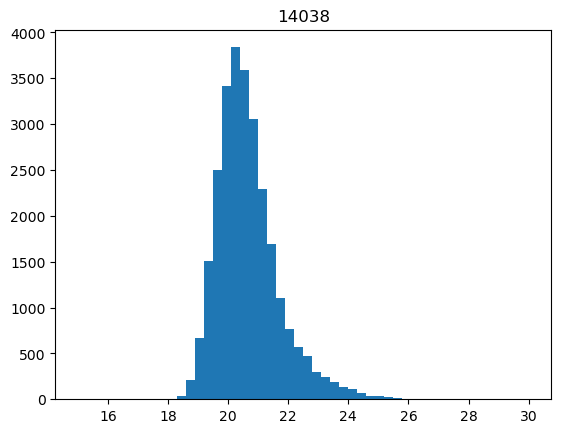

 74%|██████████████████████████████████████████████████████████▎                    | 793/1075 [01:46<00:36,  7.75it/s]

16550


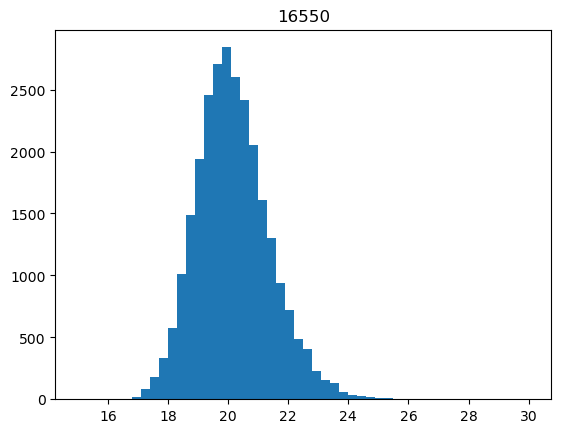

 74%|██████████████████████████████████████████████████████████▎                    | 794/1075 [01:46<00:35,  7.82it/s]

16262


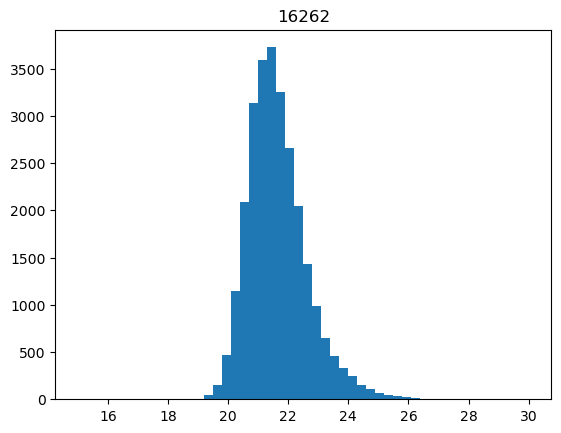

 74%|██████████████████████████████████████████████████████████▍                    | 795/1075 [01:46<00:35,  7.88it/s]

11030


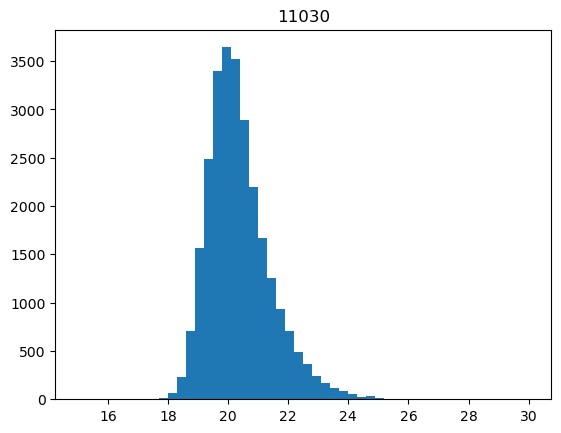

 74%|██████████████████████████████████████████████████████████▍                    | 796/1075 [01:46<00:35,  7.91it/s]

22961


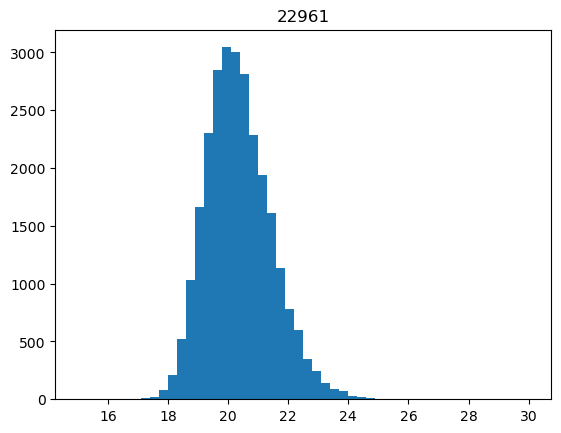

 74%|██████████████████████████████████████████████████████████▌                    | 797/1075 [01:46<00:34,  7.96it/s]

18800


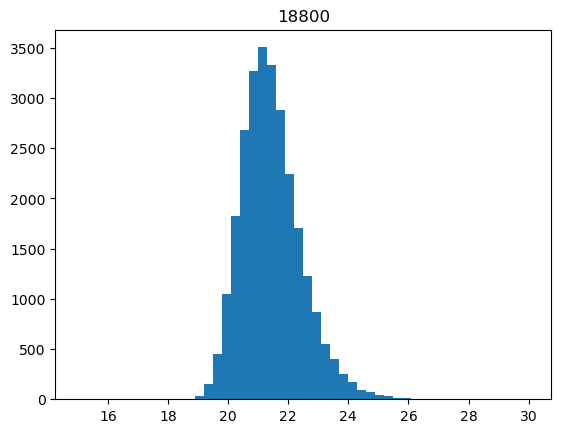

 74%|██████████████████████████████████████████████████████████▋                    | 798/1075 [01:46<00:41,  6.66it/s]

25766


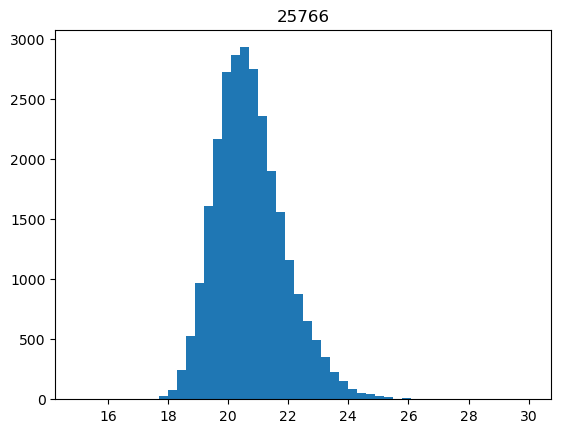

 74%|██████████████████████████████████████████████████████████▋                    | 799/1075 [01:46<00:39,  7.07it/s]

24253


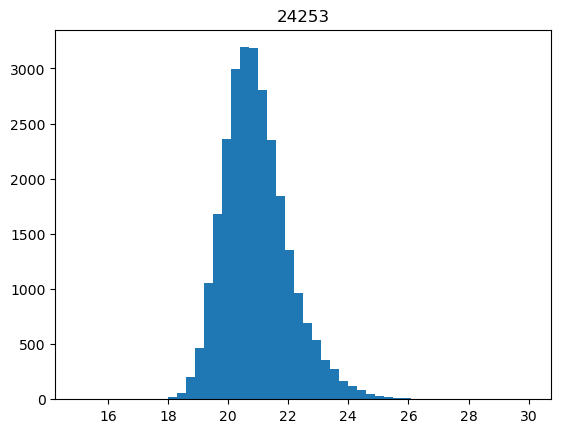

 74%|██████████████████████████████████████████████████████████▊                    | 800/1075 [01:47<00:37,  7.33it/s]

2685


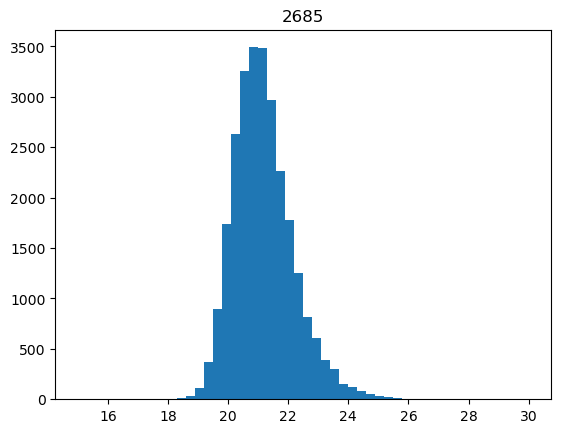

 75%|██████████████████████████████████████████████████████████▊                    | 801/1075 [01:47<00:36,  7.50it/s]

15883


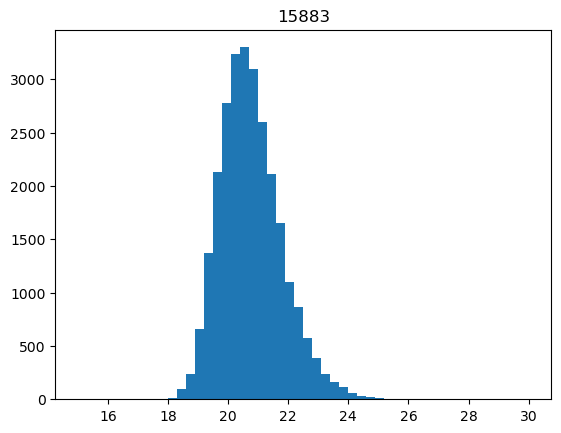

 75%|██████████████████████████████████████████████████████████▉                    | 802/1075 [01:47<00:35,  7.66it/s]

10130


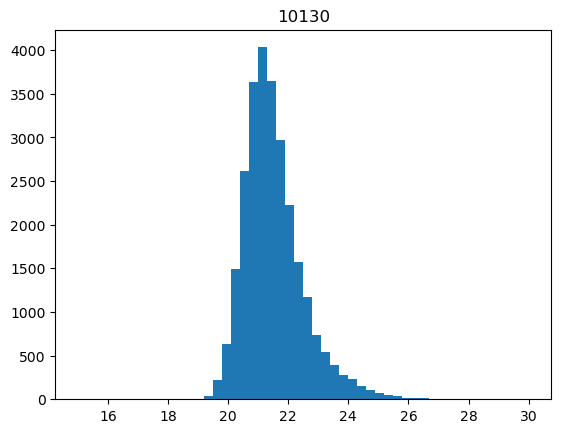

 75%|███████████████████████████████████████████████████████████                    | 803/1075 [01:47<00:35,  7.72it/s]

19754


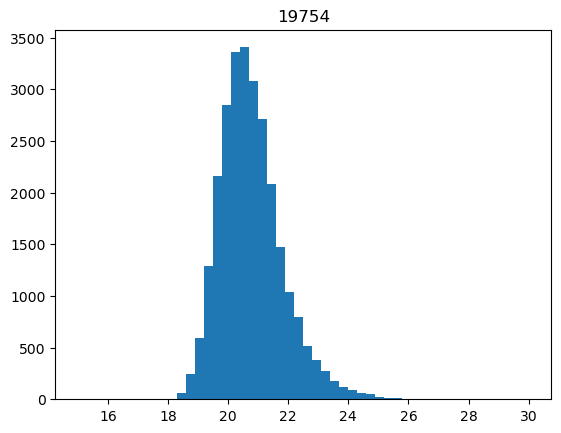

 75%|███████████████████████████████████████████████████████████                    | 804/1075 [01:47<00:34,  7.80it/s]

9668


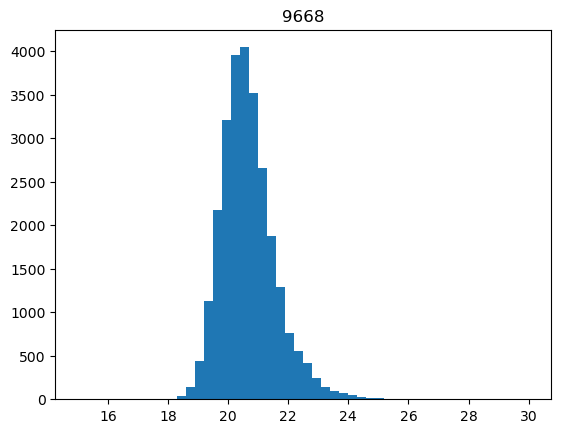

 75%|███████████████████████████████████████████████████████████▏                   | 805/1075 [01:47<00:34,  7.73it/s]

9951


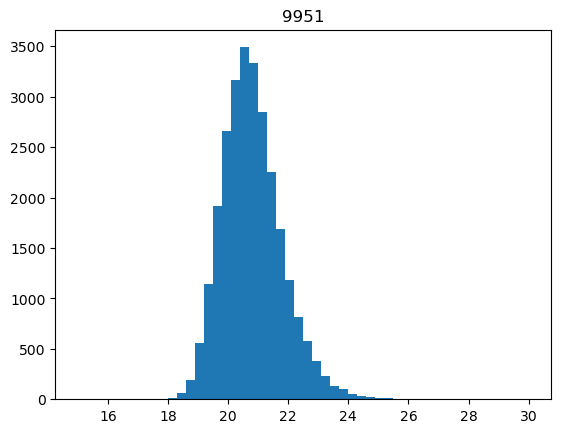

 75%|███████████████████████████████████████████████████████████▏                   | 806/1075 [01:47<00:34,  7.74it/s]

11156


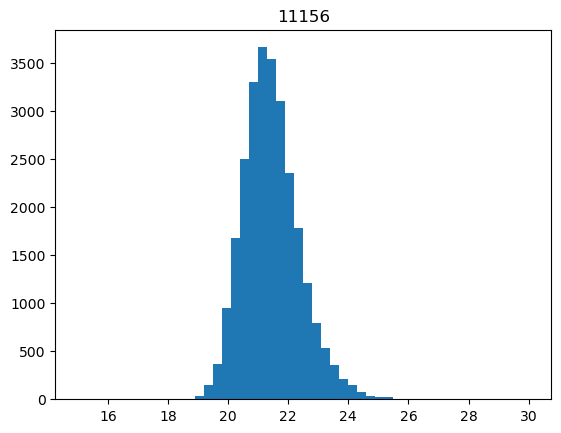

 75%|███████████████████████████████████████████████████████████▎                   | 807/1075 [01:47<00:34,  7.74it/s]

25251


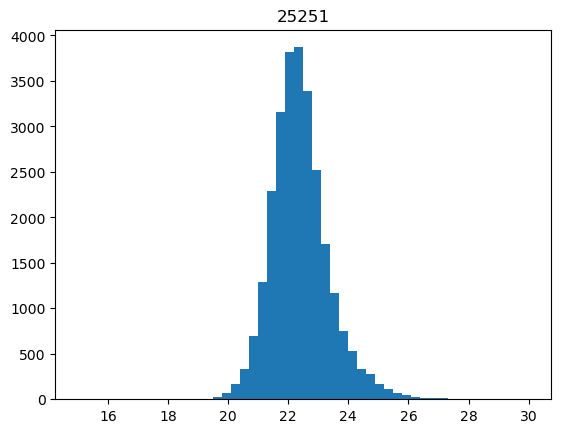

 75%|███████████████████████████████████████████████████████████▍                   | 808/1075 [01:48<00:34,  7.73it/s]

608


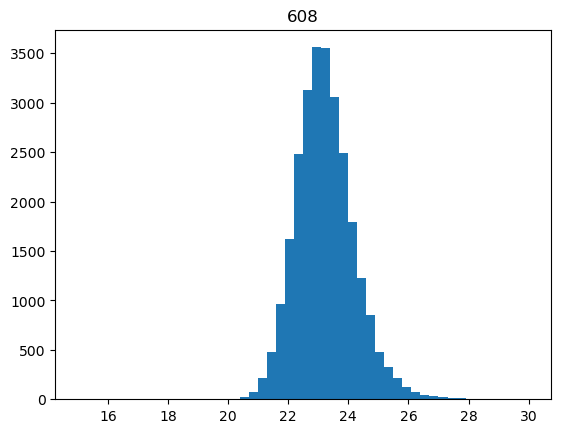

 75%|███████████████████████████████████████████████████████████▍                   | 809/1075 [01:48<00:40,  6.51it/s]

6085


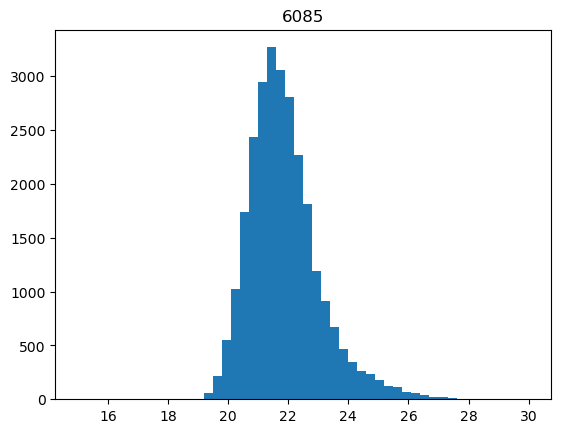

 75%|███████████████████████████████████████████████████████████▌                   | 810/1075 [01:48<00:38,  6.87it/s]

24669


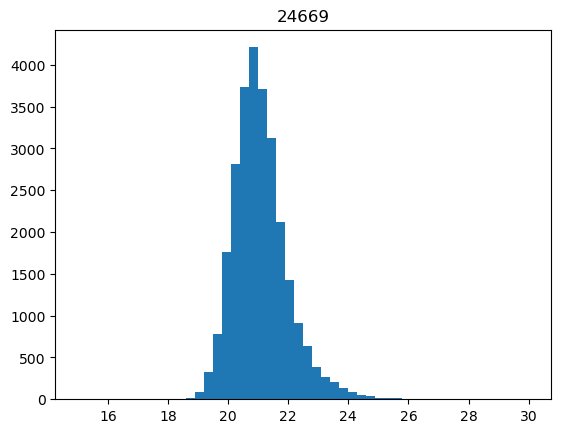

 75%|███████████████████████████████████████████████████████████▌                   | 811/1075 [01:48<00:36,  7.16it/s]

17726


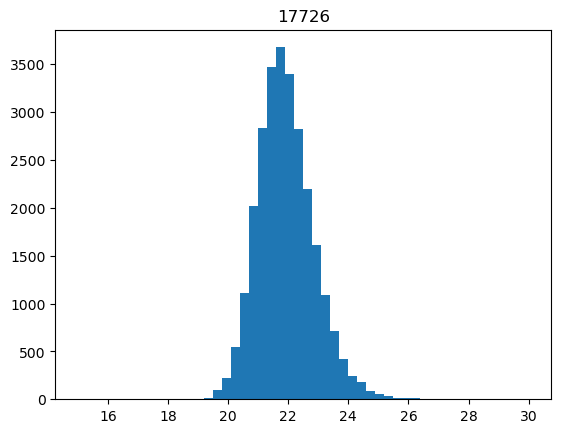

 76%|███████████████████████████████████████████████████████████▋                   | 812/1075 [01:48<00:35,  7.39it/s]

878


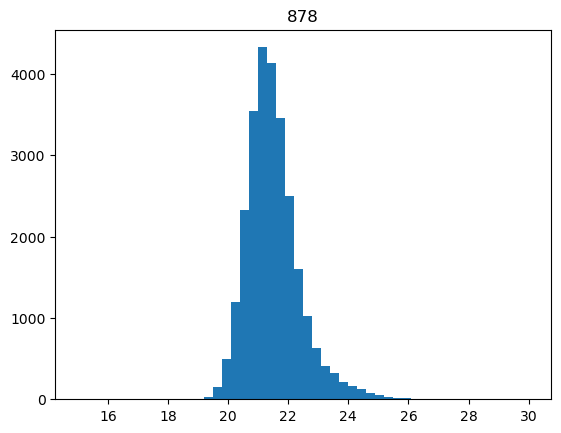

 76%|███████████████████████████████████████████████████████████▋                   | 813/1075 [01:48<00:34,  7.63it/s]

5881


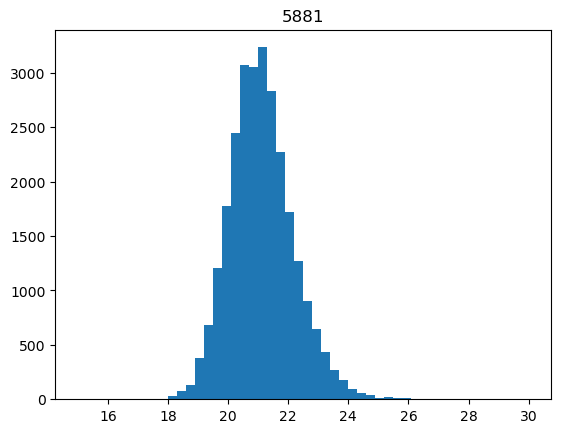

 76%|███████████████████████████████████████████████████████████▊                   | 814/1075 [01:48<00:33,  7.70it/s]

7607


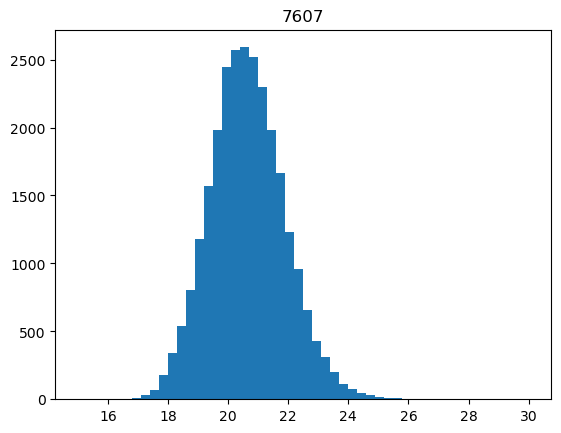

 76%|███████████████████████████████████████████████████████████▉                   | 815/1075 [01:49<00:33,  7.81it/s]

820


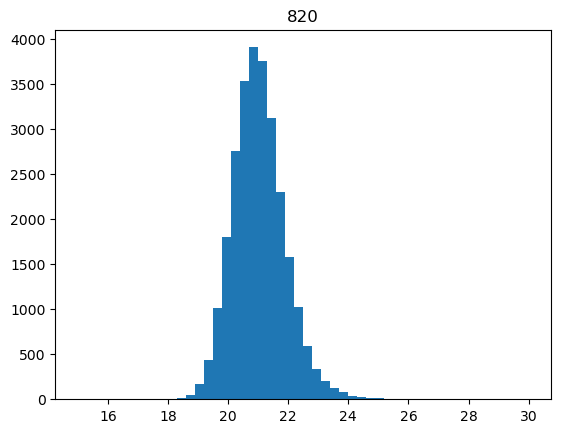

 76%|███████████████████████████████████████████████████████████▉                   | 816/1075 [01:49<00:33,  7.81it/s]

26029


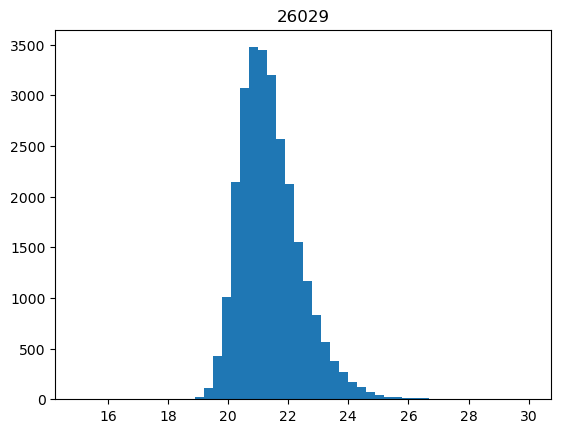

 76%|████████████████████████████████████████████████████████████                   | 817/1075 [01:49<00:32,  7.88it/s]

19992


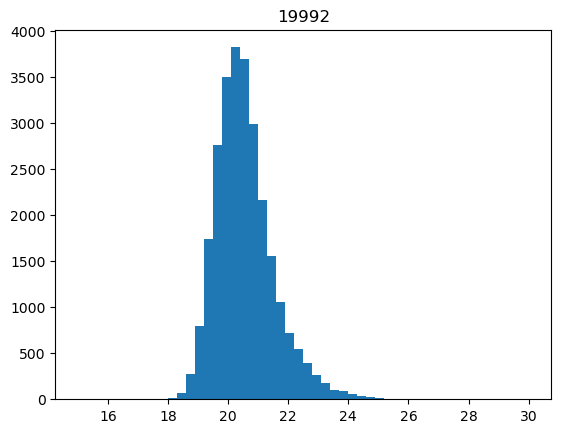

 76%|████████████████████████████████████████████████████████████                   | 818/1075 [01:49<00:33,  7.79it/s]

9436


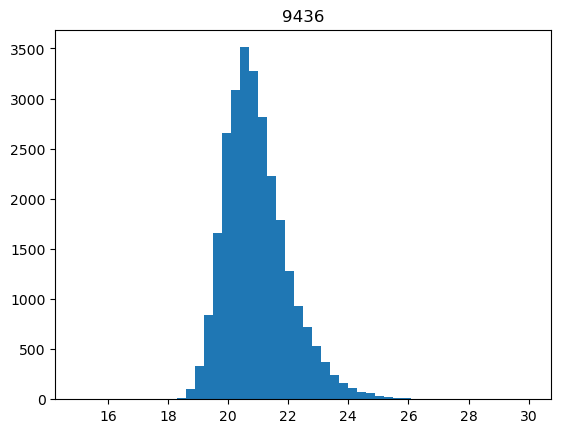

 76%|████████████████████████████████████████████████████████████▏                  | 819/1075 [01:49<00:32,  7.79it/s]

21744


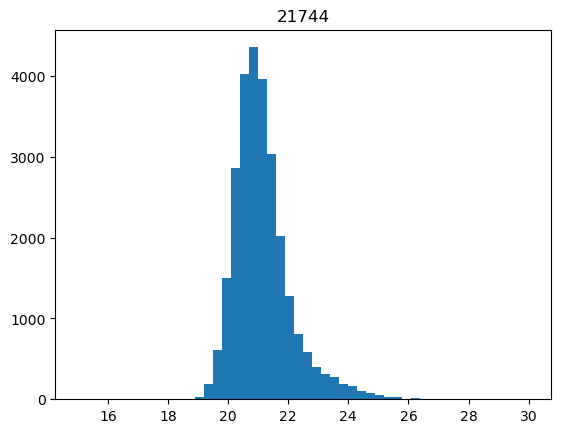

 76%|████████████████████████████████████████████████████████████▎                  | 820/1075 [01:49<00:38,  6.61it/s]

24244


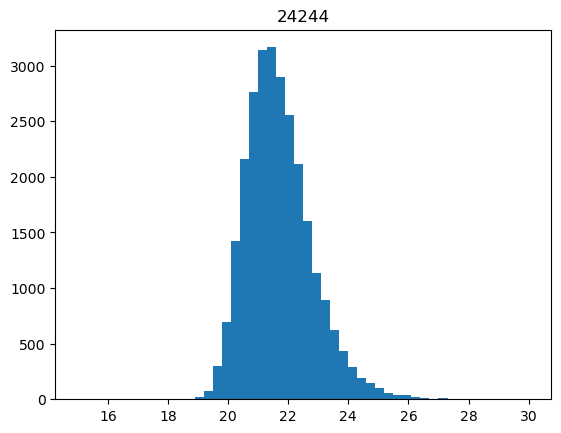

 76%|████████████████████████████████████████████████████████████▎                  | 821/1075 [01:49<00:36,  6.97it/s]

13756


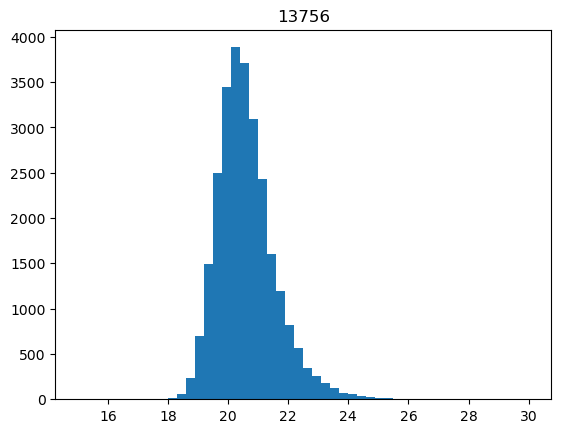

 76%|████████████████████████████████████████████████████████████▍                  | 822/1075 [01:50<00:35,  7.19it/s]

24455


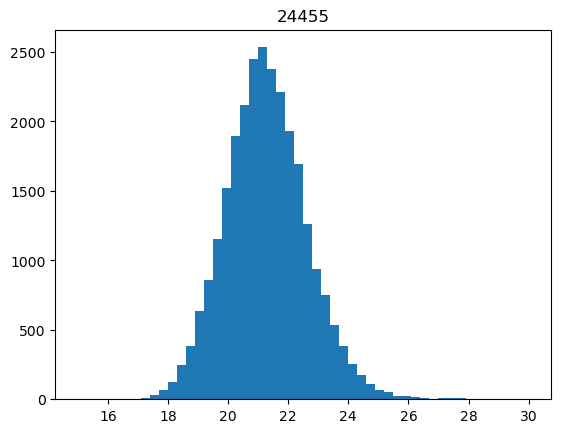

 77%|████████████████████████████████████████████████████████████▍                  | 823/1075 [01:50<00:33,  7.41it/s]

11634


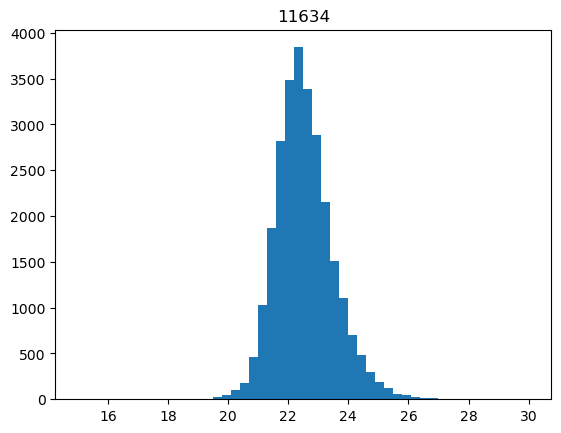

 77%|████████████████████████████████████████████████████████████▌                  | 824/1075 [01:50<00:33,  7.56it/s]

3629


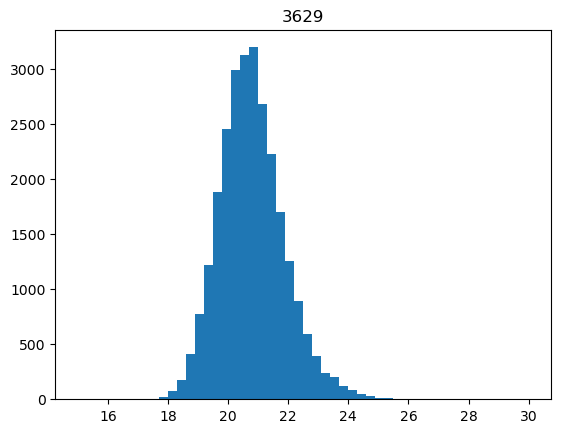

 77%|████████████████████████████████████████████████████████████▋                  | 825/1075 [01:50<00:32,  7.71it/s]

21245


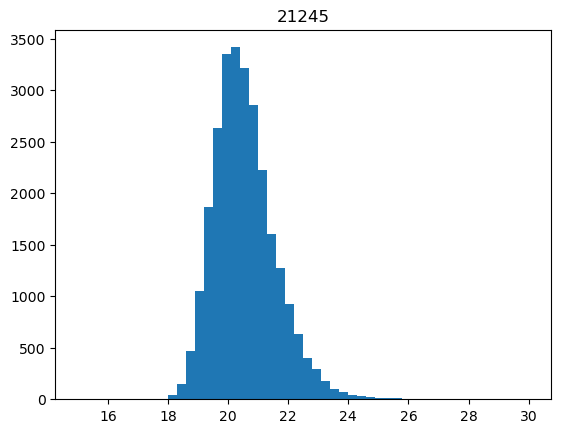

 77%|████████████████████████████████████████████████████████████▋                  | 826/1075 [01:50<00:31,  7.79it/s]

7487


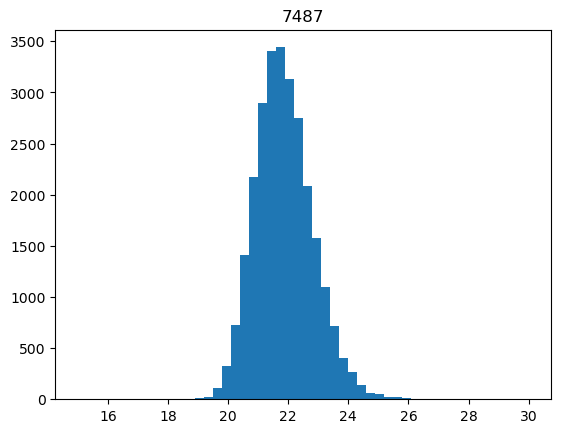

 77%|████████████████████████████████████████████████████████████▊                  | 827/1075 [01:50<00:31,  7.85it/s]

18727


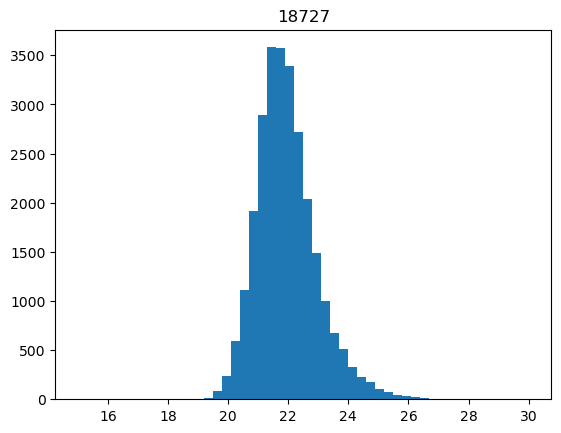

 77%|████████████████████████████████████████████████████████████▊                  | 828/1075 [01:50<00:31,  7.90it/s]

21829


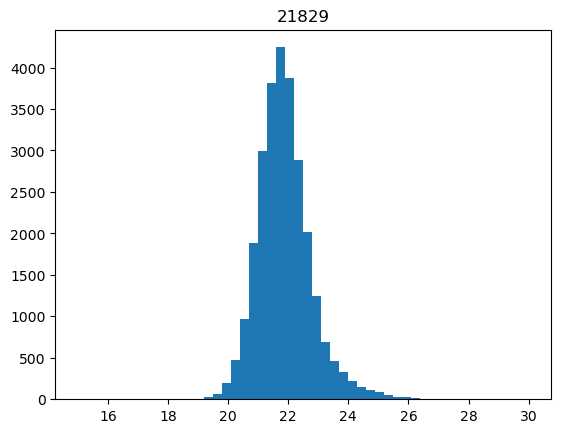

 77%|████████████████████████████████████████████████████████████▉                  | 829/1075 [01:50<00:31,  7.91it/s]

22001


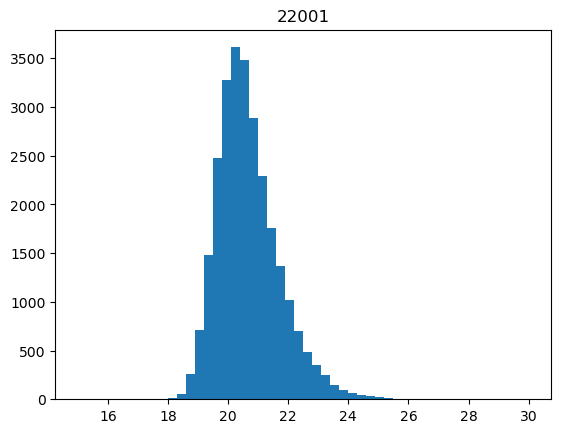

 77%|████████████████████████████████████████████████████████████▉                  | 830/1075 [01:51<00:30,  7.95it/s]

24588


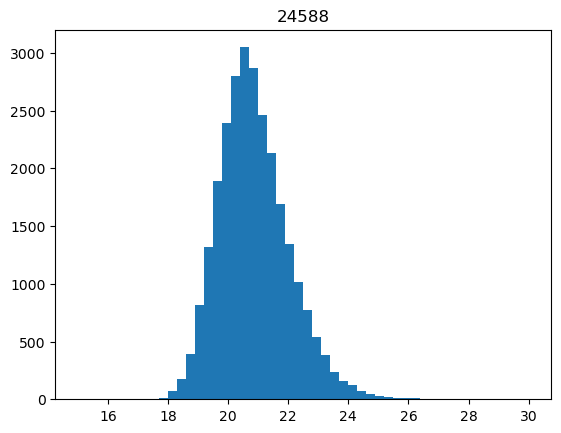

 77%|█████████████████████████████████████████████████████████████                  | 831/1075 [01:51<00:37,  6.57it/s]

23187


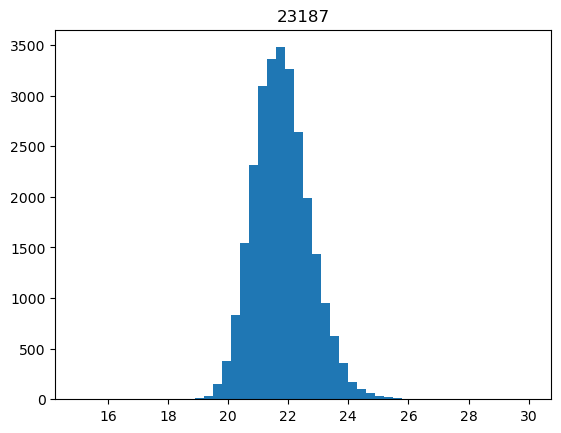

 77%|█████████████████████████████████████████████████████████████▏                 | 832/1075 [01:51<00:35,  6.93it/s]

24400


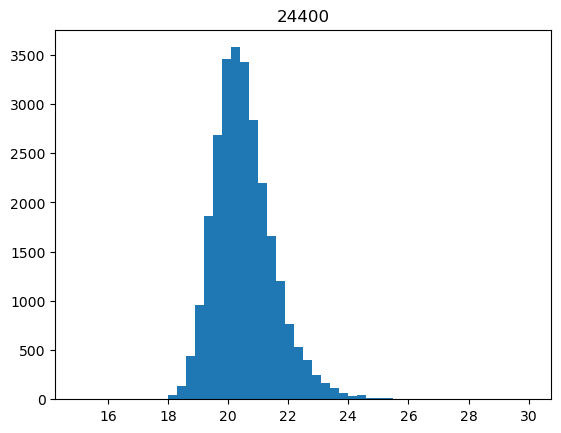

 77%|█████████████████████████████████████████████████████████████▏                 | 833/1075 [01:51<00:33,  7.19it/s]

12892


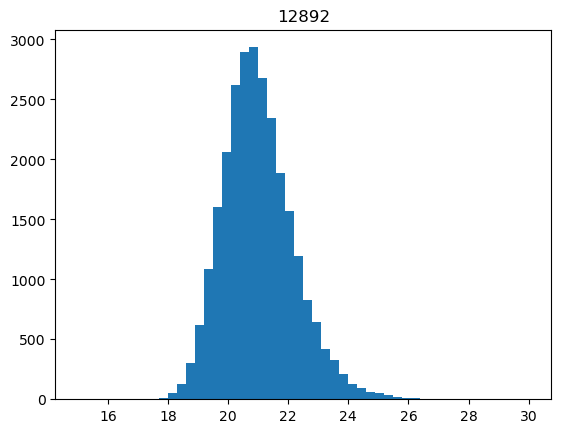

 78%|█████████████████████████████████████████████████████████████▎                 | 834/1075 [01:51<00:32,  7.41it/s]

11907


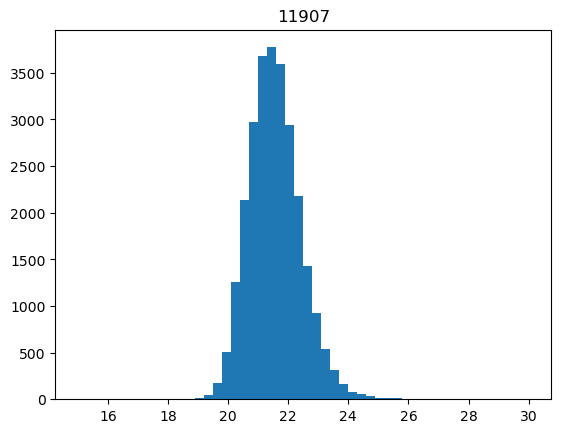

 78%|█████████████████████████████████████████████████████████████▎                 | 835/1075 [01:51<00:31,  7.58it/s]

25076


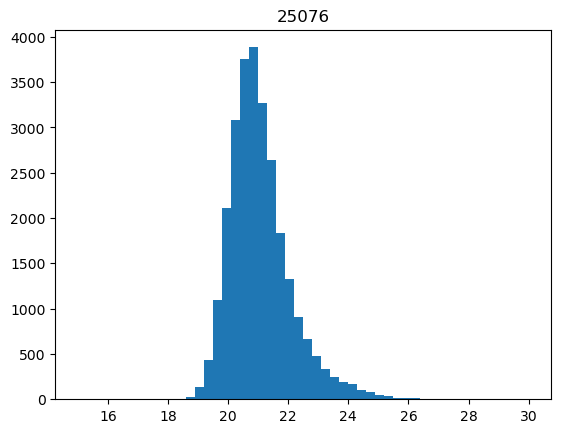

 78%|█████████████████████████████████████████████████████████████▍                 | 836/1075 [01:51<00:31,  7.68it/s]

23546


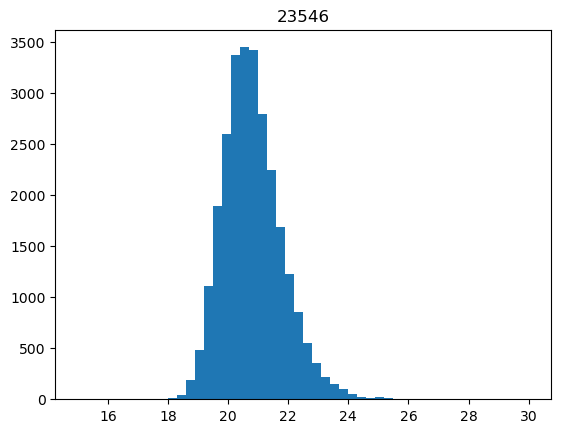

 78%|█████████████████████████████████████████████████████████████▌                 | 837/1075 [01:51<00:30,  7.77it/s]

20107


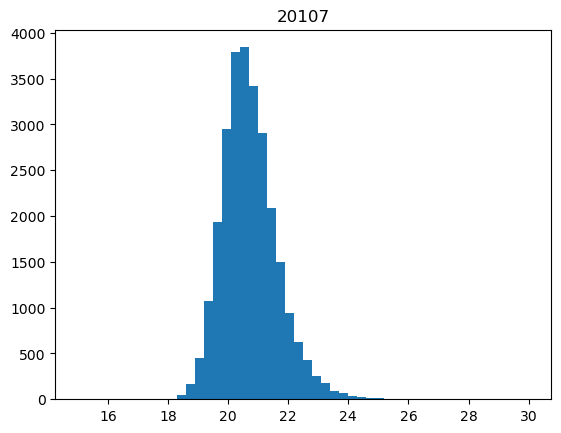

 78%|█████████████████████████████████████████████████████████████▌                 | 838/1075 [01:52<00:30,  7.82it/s]

20455


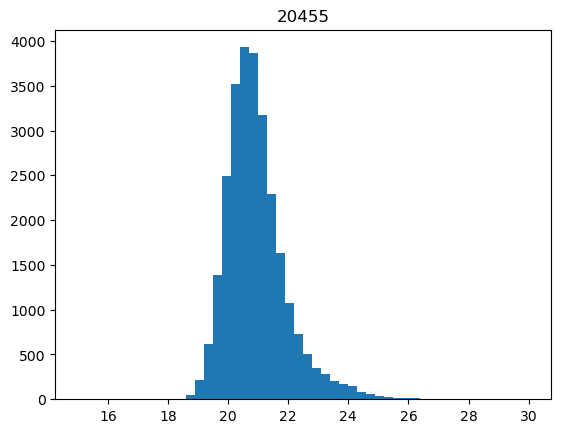

 78%|█████████████████████████████████████████████████████████████▋                 | 839/1075 [01:52<00:30,  7.84it/s]

6834


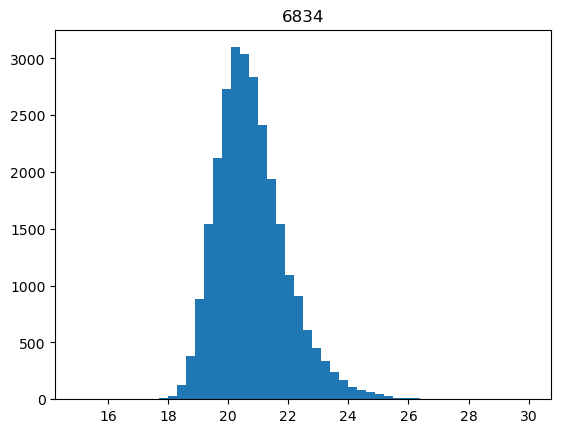

 78%|█████████████████████████████████████████████████████████████▋                 | 840/1075 [01:52<00:29,  7.90it/s]

15018


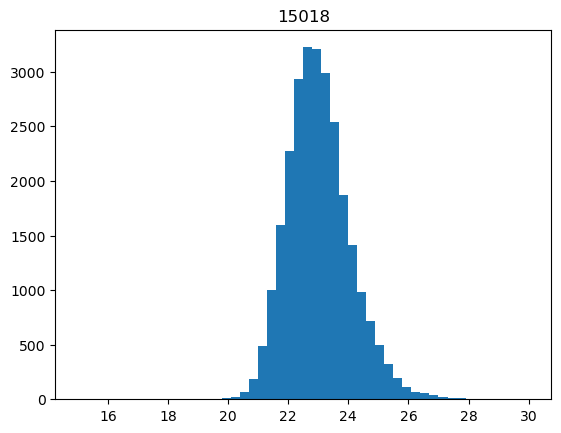

 78%|█████████████████████████████████████████████████████████████▊                 | 841/1075 [01:52<00:29,  7.99it/s]

11699


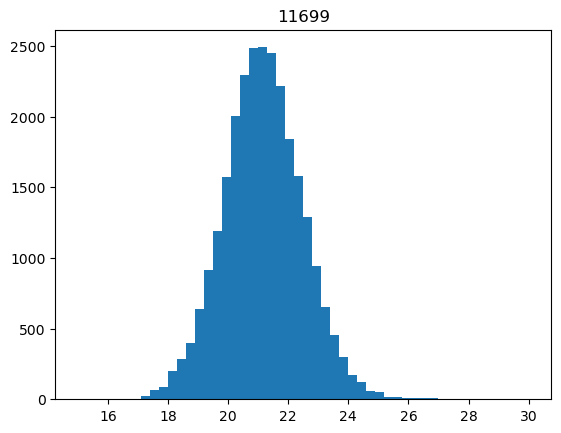

 78%|█████████████████████████████████████████████████████████████▉                 | 842/1075 [01:52<00:34,  6.71it/s]

20922


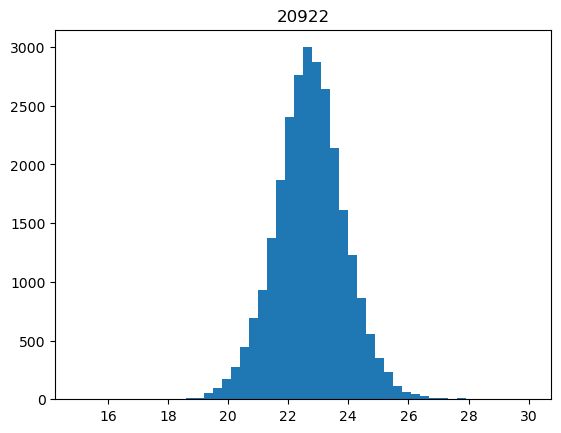

 78%|█████████████████████████████████████████████████████████████▉                 | 843/1075 [01:52<00:32,  7.06it/s]

7683


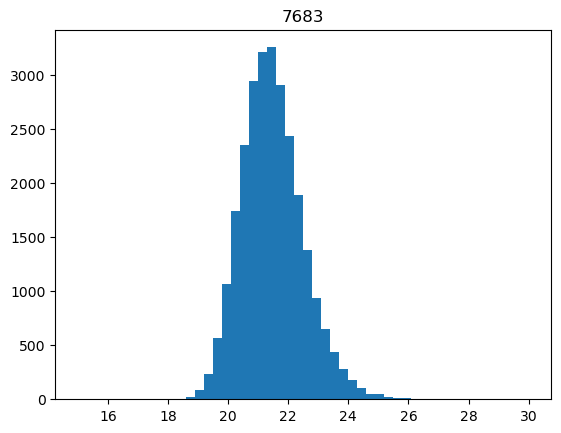

 79%|██████████████████████████████████████████████████████████████                 | 844/1075 [01:52<00:31,  7.33it/s]

7616


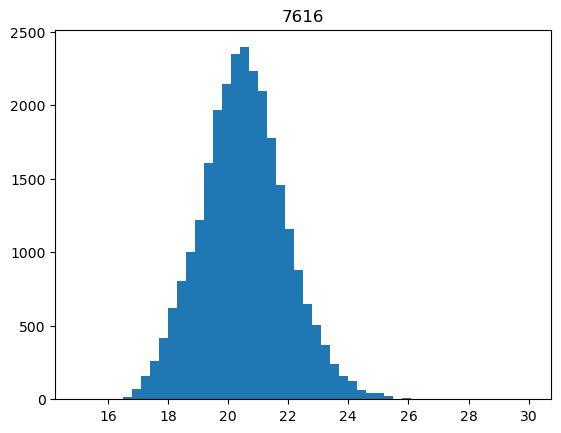

 79%|██████████████████████████████████████████████████████████████                 | 845/1075 [01:53<00:30,  7.56it/s]

7388


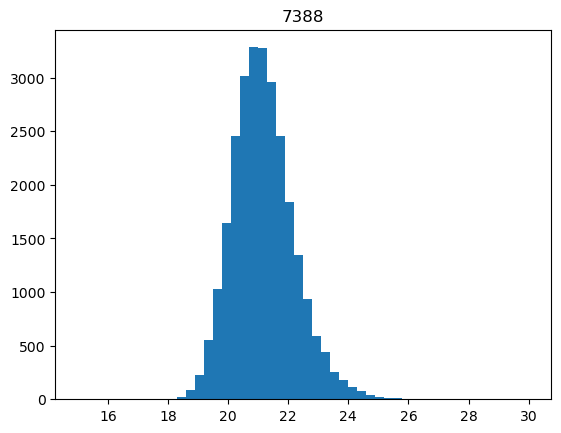

 79%|██████████████████████████████████████████████████████████████▏                | 846/1075 [01:53<00:29,  7.68it/s]

3054


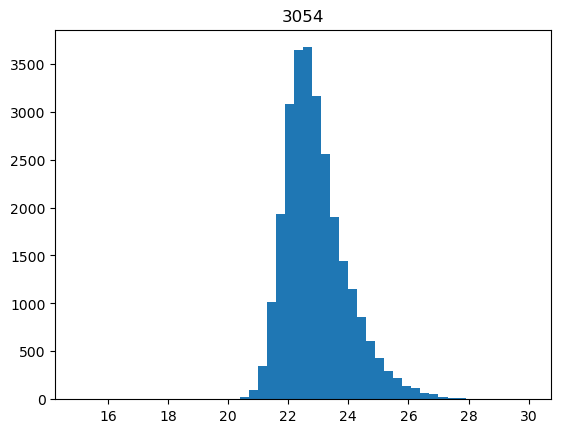

 79%|██████████████████████████████████████████████████████████████▏                | 847/1075 [01:53<00:29,  7.78it/s]

24329


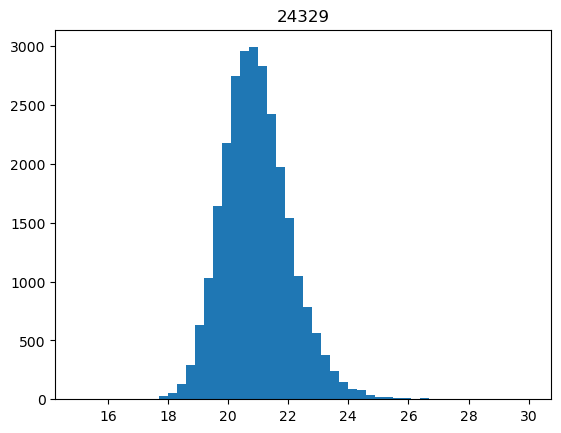

 79%|██████████████████████████████████████████████████████████████▎                | 848/1075 [01:53<00:28,  7.86it/s]

6791


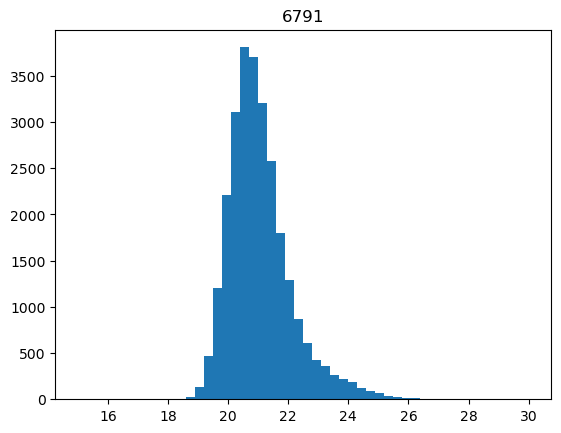

 79%|██████████████████████████████████████████████████████████████▍                | 849/1075 [01:53<00:28,  7.84it/s]

2706


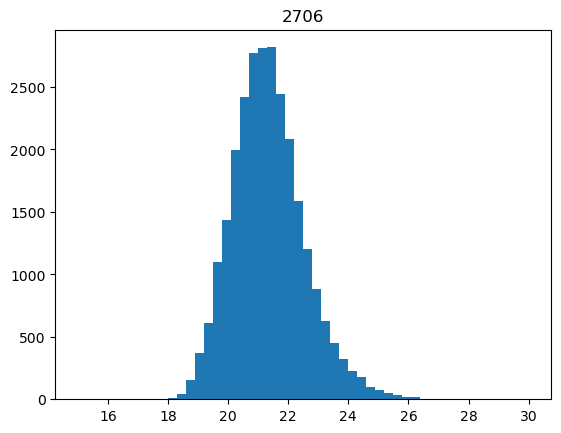

 79%|██████████████████████████████████████████████████████████████▍                | 850/1075 [01:53<00:28,  7.95it/s]

19730


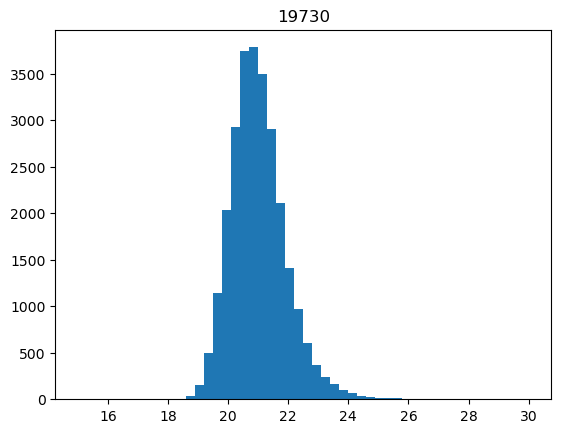

 79%|██████████████████████████████████████████████████████████████▌                | 851/1075 [01:53<00:28,  7.92it/s]

22902


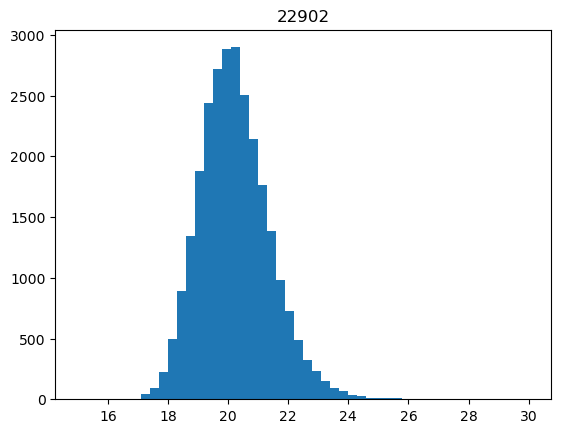

 79%|██████████████████████████████████████████████████████████████▌                | 852/1075 [01:53<00:27,  7.98it/s]

17195


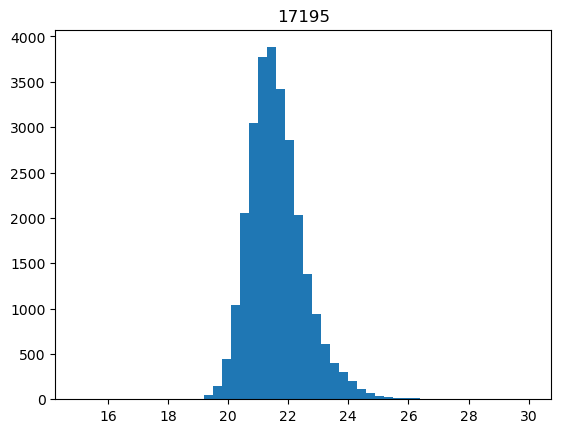

 79%|██████████████████████████████████████████████████████████████▋                | 853/1075 [01:54<00:33,  6.66it/s]

14944


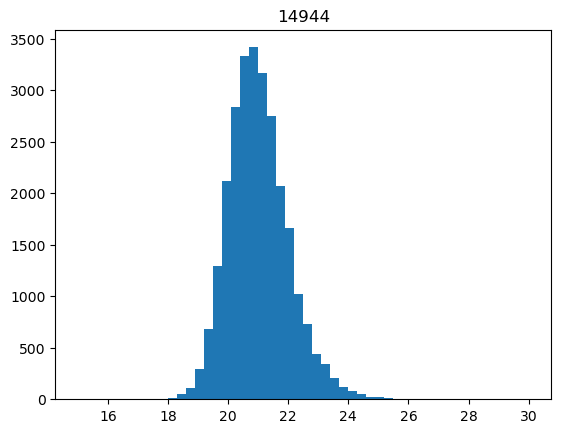

 79%|██████████████████████████████████████████████████████████████▊                | 854/1075 [01:54<00:32,  6.86it/s]

1329


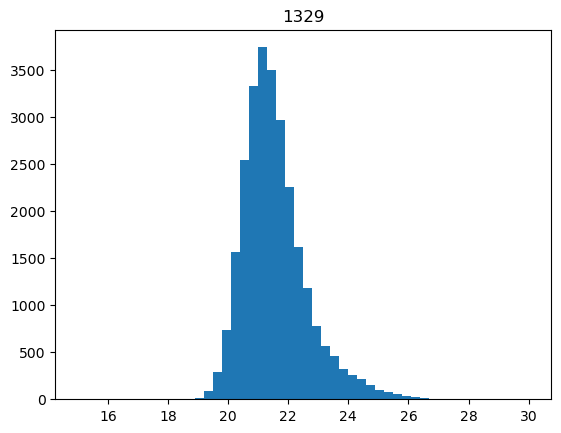

 80%|██████████████████████████████████████████████████████████████▊                | 855/1075 [01:54<00:30,  7.15it/s]

18718


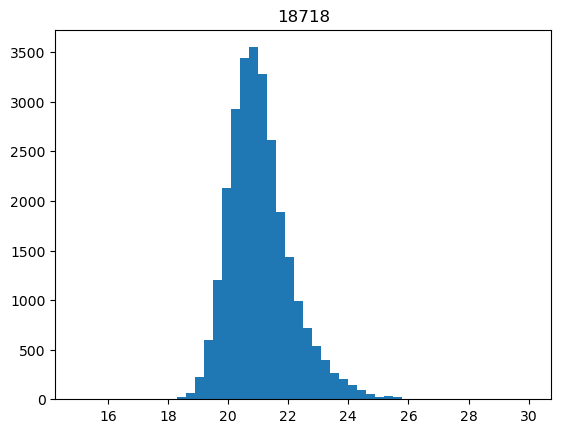

 80%|██████████████████████████████████████████████████████████████▉                | 856/1075 [01:54<00:29,  7.35it/s]

24775


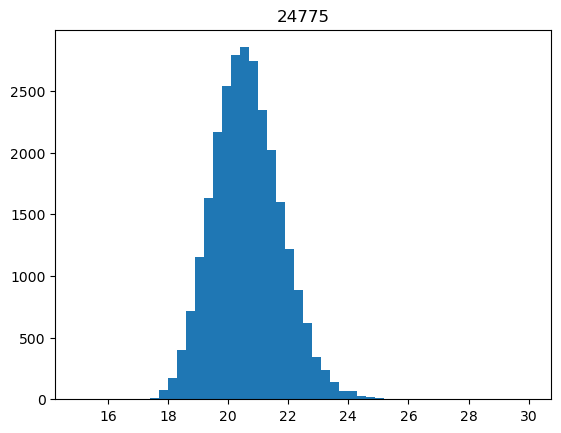

 80%|██████████████████████████████████████████████████████████████▉                | 857/1075 [01:54<00:28,  7.55it/s]

19538


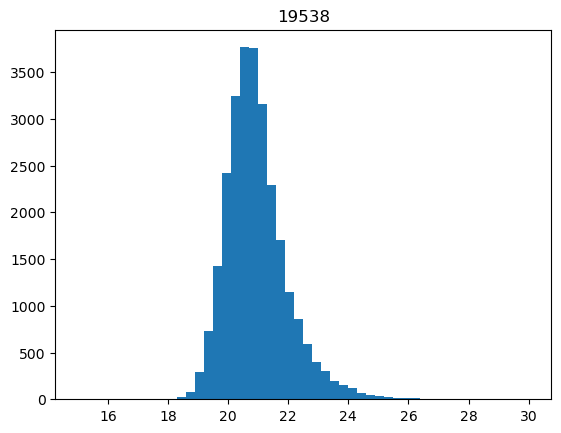

 80%|███████████████████████████████████████████████████████████████                | 858/1075 [01:54<00:28,  7.66it/s]

4809


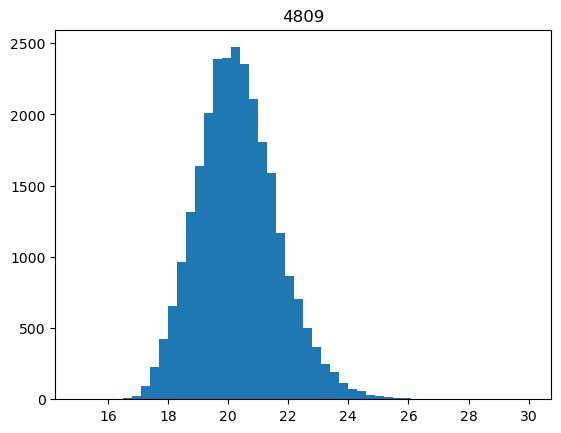

 80%|███████████████████████████████████████████████████████████████▏               | 859/1075 [01:54<00:27,  7.80it/s]

5819


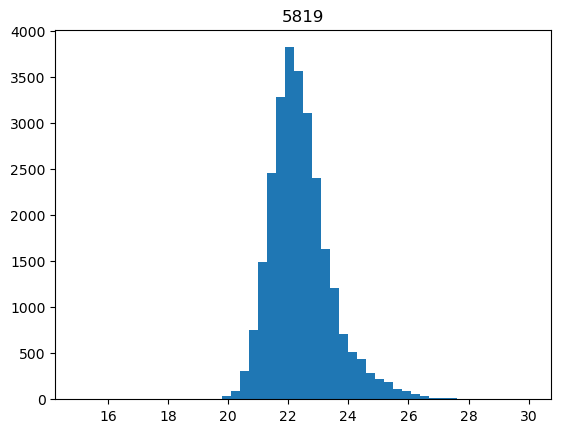

 80%|███████████████████████████████████████████████████████████████▏               | 860/1075 [01:55<00:27,  7.82it/s]

15248


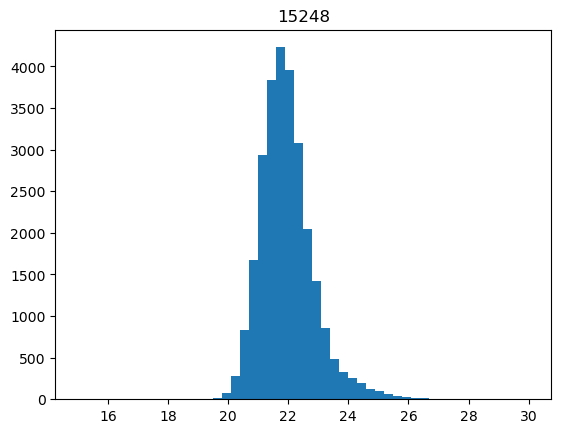

 80%|███████████████████████████████████████████████████████████████▎               | 861/1075 [01:55<00:27,  7.80it/s]

17809


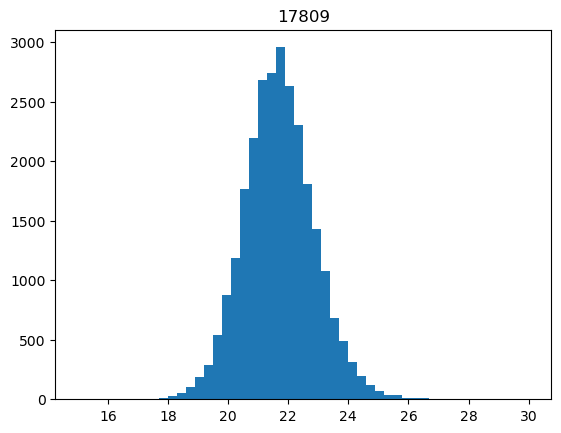

 80%|███████████████████████████████████████████████████████████████▎               | 862/1075 [01:55<00:27,  7.84it/s]

3842


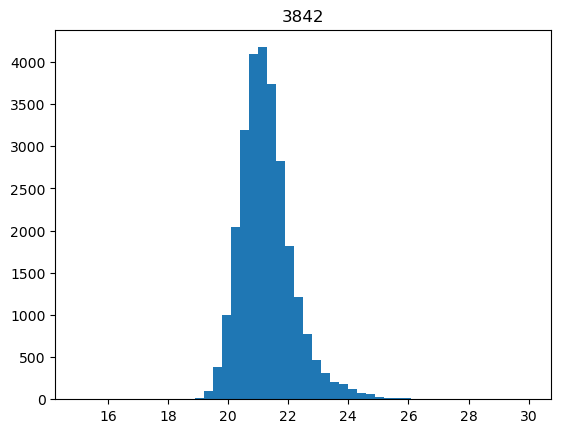

 80%|███████████████████████████████████████████████████████████████▍               | 863/1075 [01:55<00:27,  7.83it/s]

1996


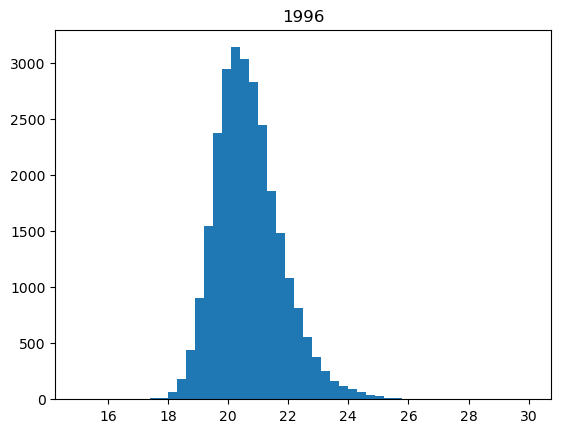

 80%|███████████████████████████████████████████████████████████████▍               | 864/1075 [01:55<00:32,  6.59it/s]

1180


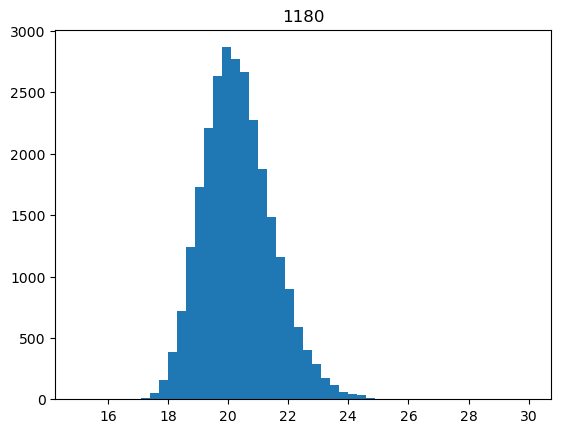

 80%|███████████████████████████████████████████████████████████████▌               | 865/1075 [01:55<00:30,  6.98it/s]

21186


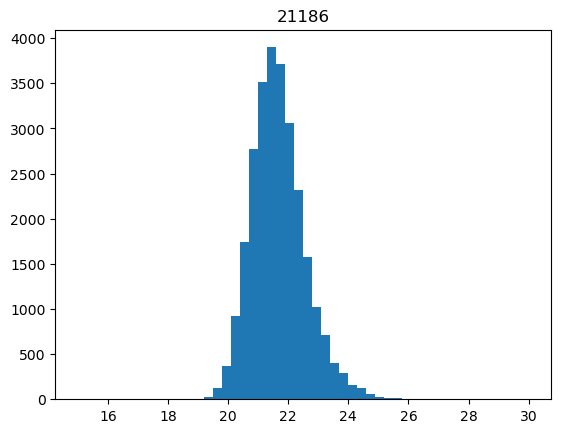

 81%|███████████████████████████████████████████████████████████████▋               | 866/1075 [01:55<00:28,  7.24it/s]

11832


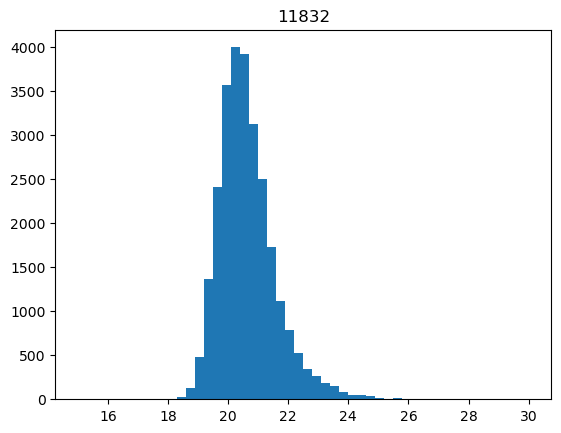

 81%|███████████████████████████████████████████████████████████████▋               | 867/1075 [01:55<00:27,  7.44it/s]

15449


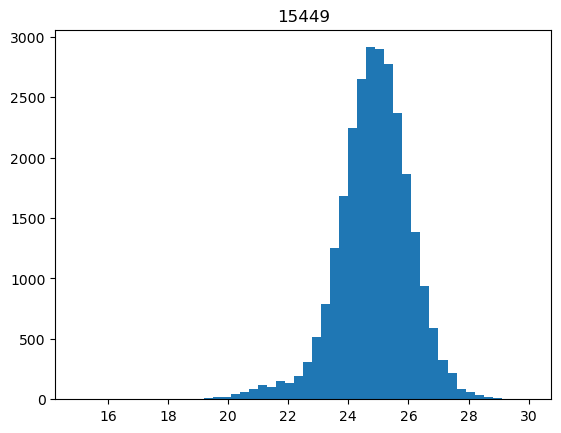

 81%|███████████████████████████████████████████████████████████████▊               | 868/1075 [01:56<00:27,  7.62it/s]

744


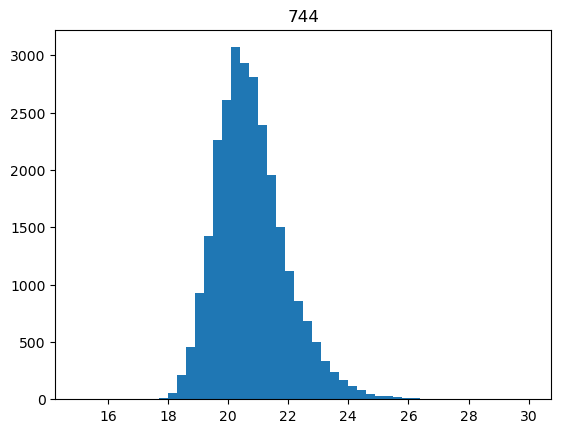

 81%|███████████████████████████████████████████████████████████████▊               | 869/1075 [01:56<00:26,  7.69it/s]

1634


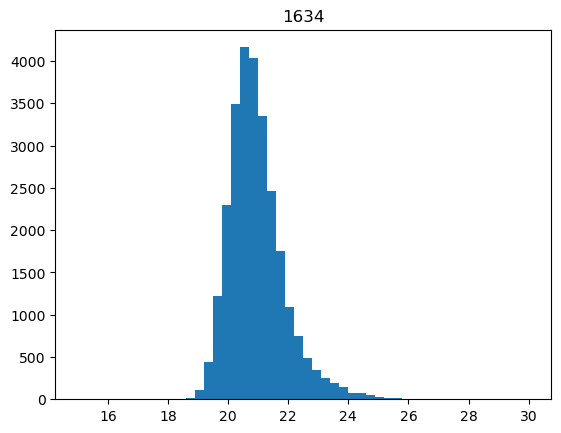

 81%|███████████████████████████████████████████████████████████████▉               | 870/1075 [01:56<00:26,  7.67it/s]

18079


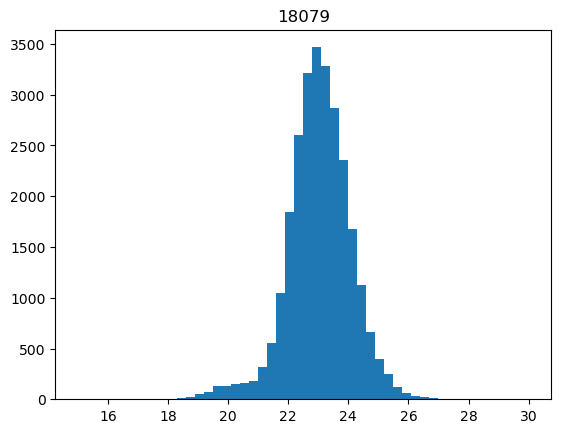

 81%|████████████████████████████████████████████████████████████████               | 871/1075 [01:56<00:26,  7.68it/s]

5229


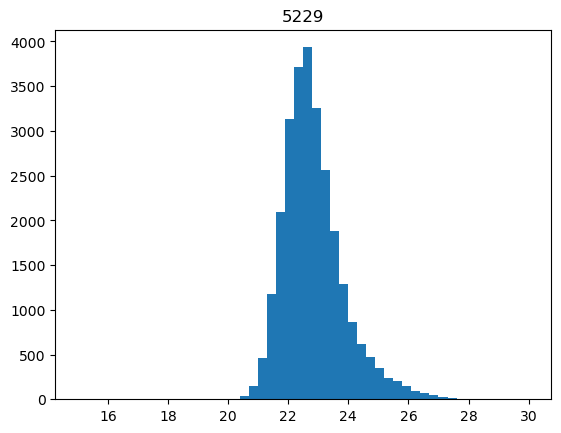

 81%|████████████████████████████████████████████████████████████████               | 872/1075 [01:56<00:26,  7.70it/s]

25275


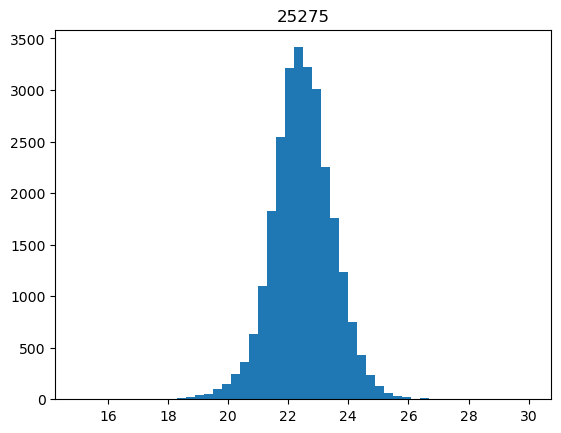

 81%|████████████████████████████████████████████████████████████████▏              | 873/1075 [01:56<00:25,  7.81it/s]

22204


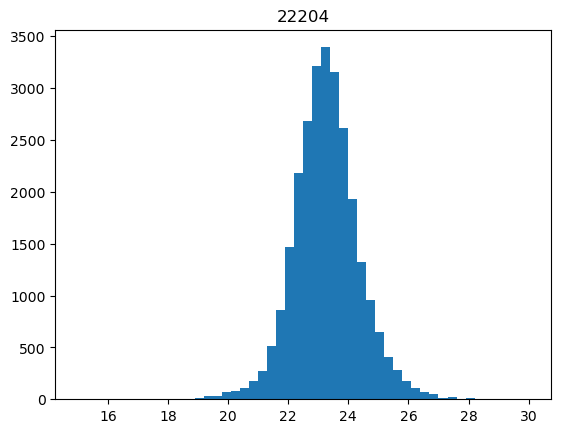

 81%|████████████████████████████████████████████████████████████████▏              | 874/1075 [01:56<00:25,  7.79it/s]

9299


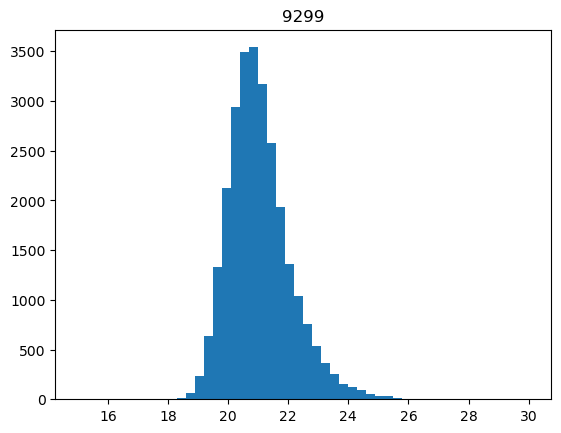

 81%|████████████████████████████████████████████████████████████████▎              | 875/1075 [01:57<00:30,  6.58it/s]

17904


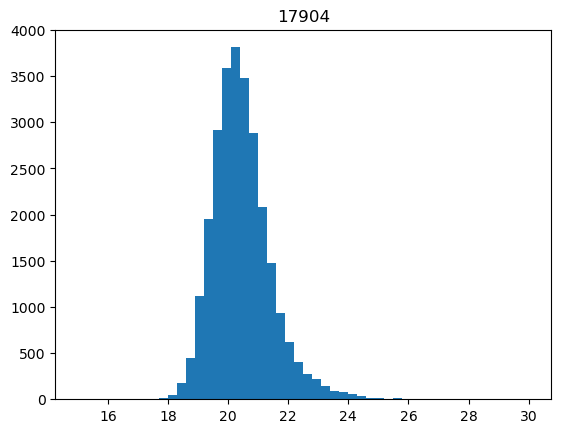

 81%|████████████████████████████████████████████████████████████████▍              | 876/1075 [01:57<00:28,  6.98it/s]

18882


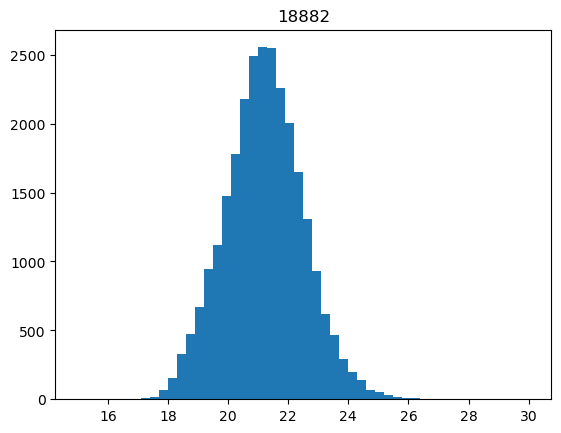

 82%|████████████████████████████████████████████████████████████████▍              | 877/1075 [01:57<00:27,  7.30it/s]

11800


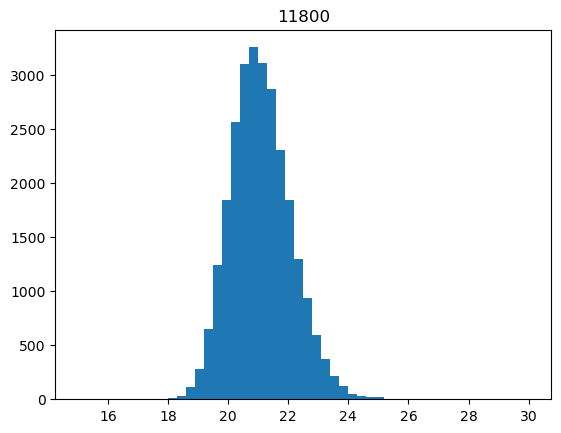

 82%|████████████████████████████████████████████████████████████████▌              | 878/1075 [01:57<00:26,  7.48it/s]

17227


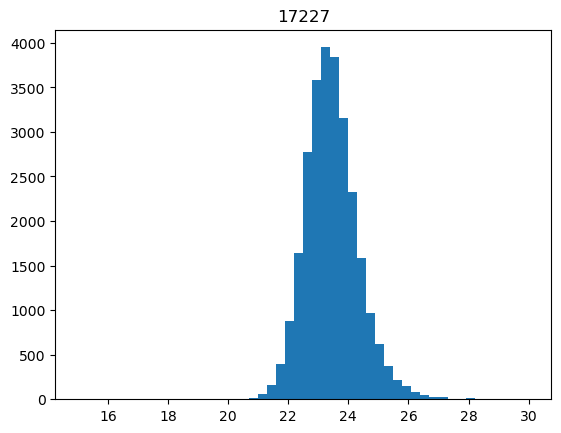

 82%|████████████████████████████████████████████████████████████████▌              | 879/1075 [01:57<00:26,  7.53it/s]

5063


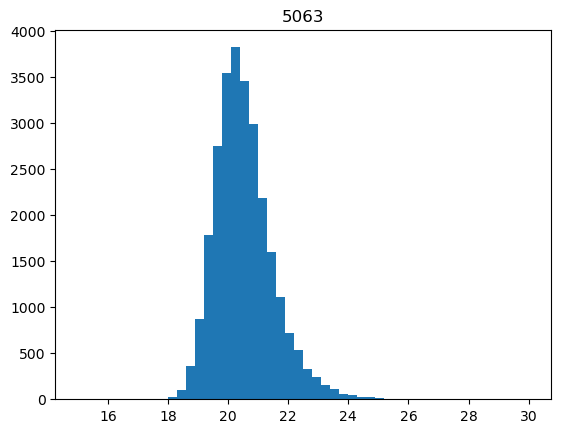

 82%|████████████████████████████████████████████████████████████████▋              | 880/1075 [01:57<00:25,  7.63it/s]

2061


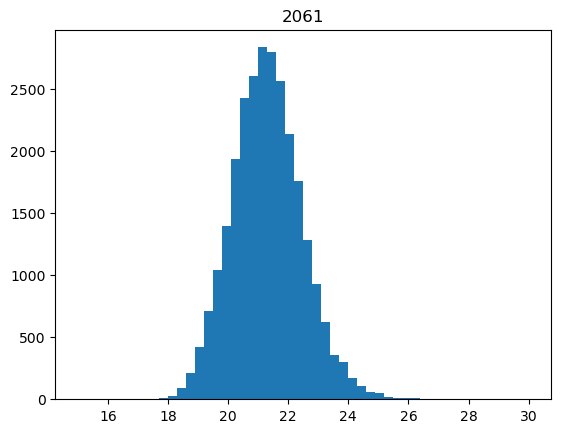

 82%|████████████████████████████████████████████████████████████████▋              | 881/1075 [01:57<00:25,  7.75it/s]

2430


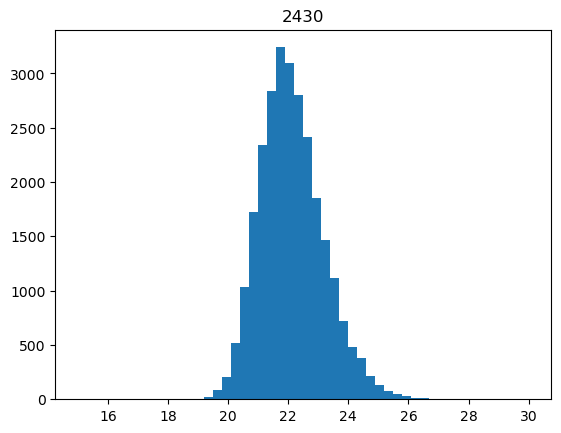

 82%|████████████████████████████████████████████████████████████████▊              | 882/1075 [01:57<00:24,  7.75it/s]

9035


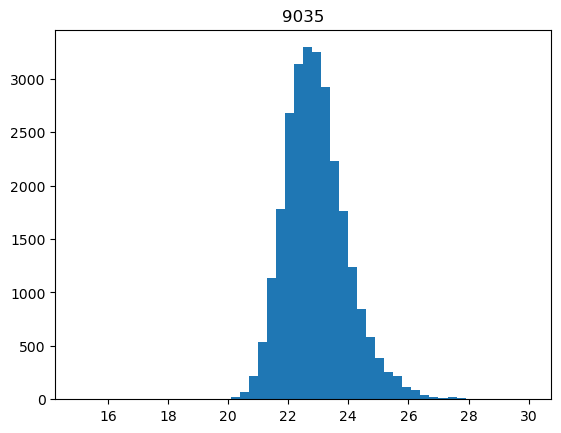

 82%|████████████████████████████████████████████████████████████████▉              | 883/1075 [01:58<00:24,  7.84it/s]

6992


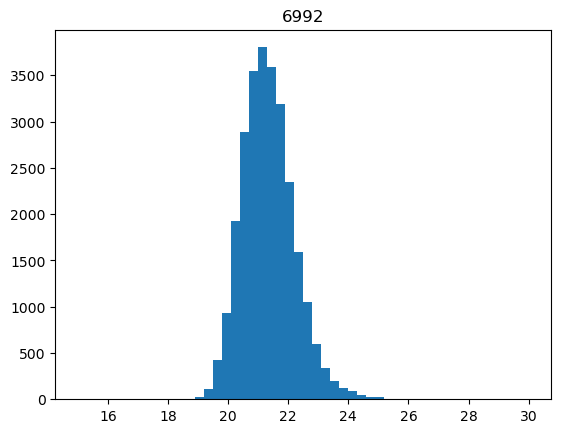

 82%|████████████████████████████████████████████████████████████████▉              | 884/1075 [01:58<00:24,  7.83it/s]

5188


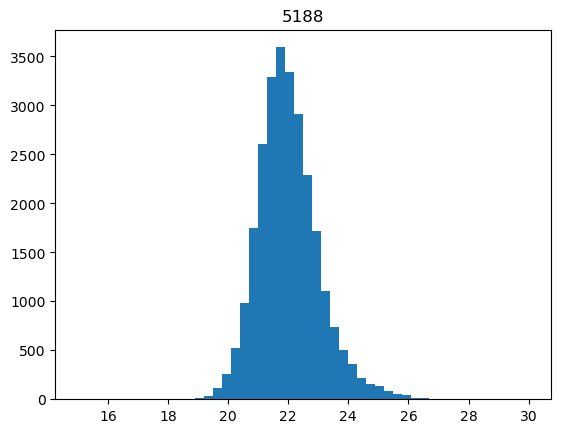

 82%|█████████████████████████████████████████████████████████████████              | 885/1075 [01:58<00:24,  7.83it/s]

18898


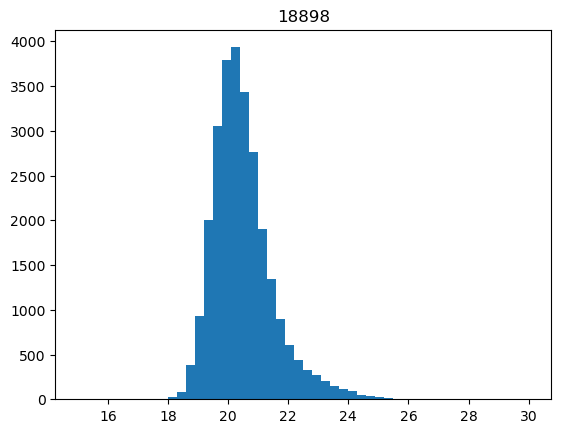

 82%|█████████████████████████████████████████████████████████████████              | 886/1075 [01:58<00:28,  6.59it/s]

20076


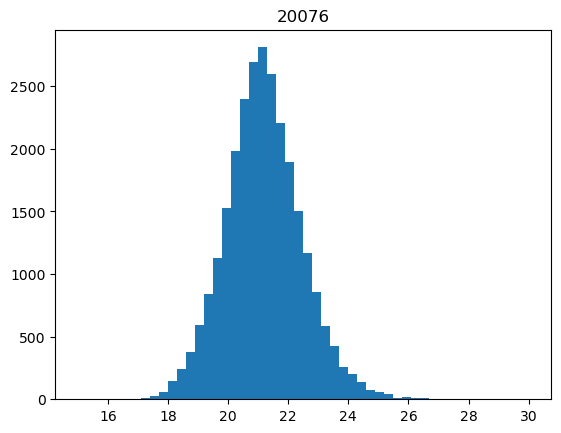

 83%|█████████████████████████████████████████████████████████████████▏             | 887/1075 [01:58<00:26,  7.04it/s]

7950


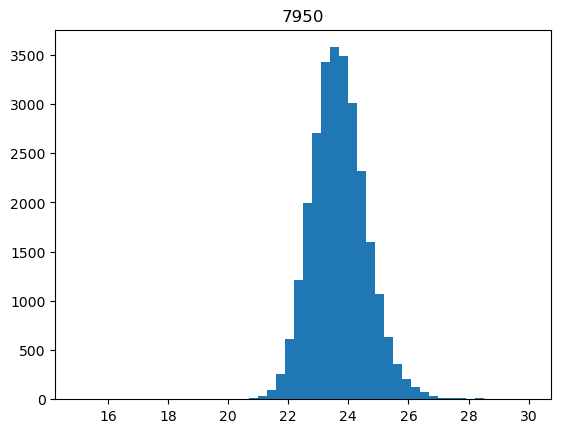

 83%|█████████████████████████████████████████████████████████████████▎             | 888/1075 [01:58<00:25,  7.32it/s]

8338


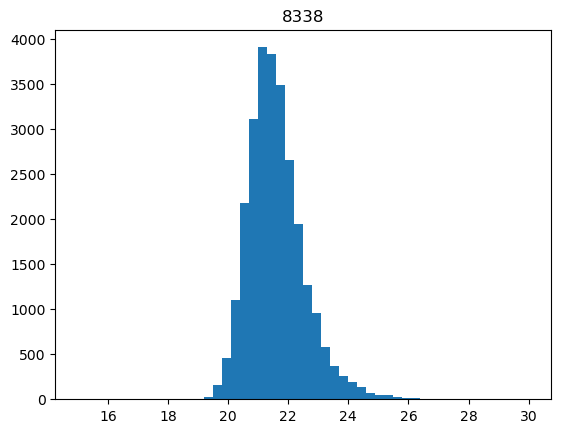

 83%|█████████████████████████████████████████████████████████████████▎             | 889/1075 [01:58<00:25,  7.41it/s]

18661


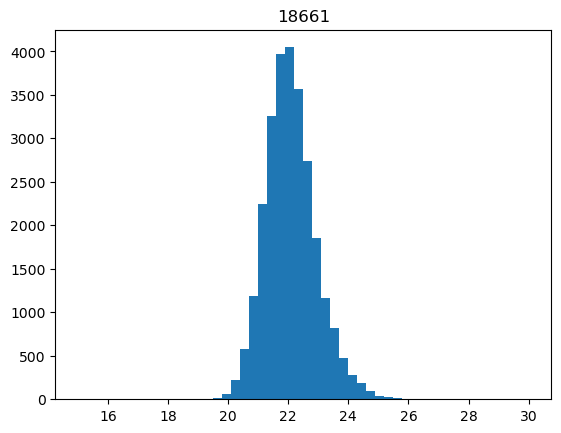

 83%|█████████████████████████████████████████████████████████████████▍             | 890/1075 [01:59<00:24,  7.53it/s]

24195


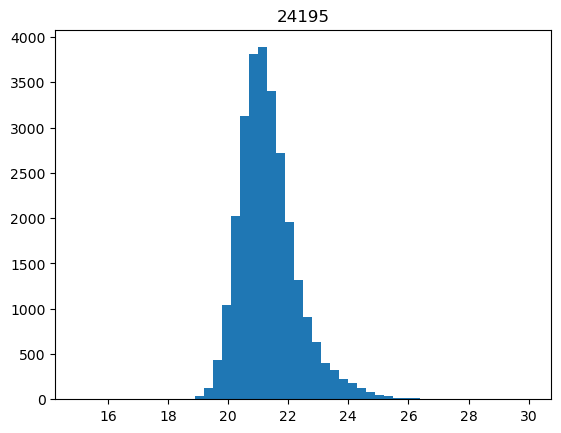

 83%|█████████████████████████████████████████████████████████████████▍             | 891/1075 [01:59<00:24,  7.59it/s]

21570


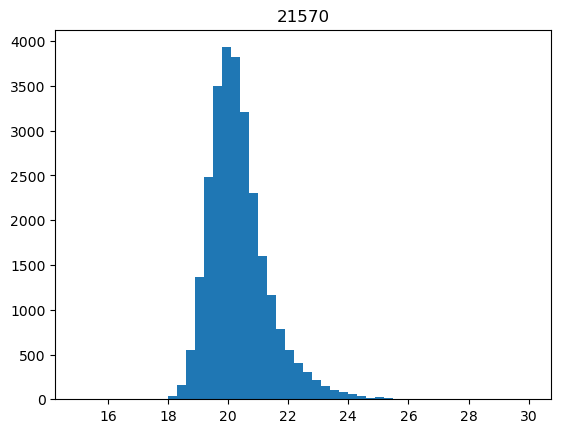

 83%|█████████████████████████████████████████████████████████████████▌             | 892/1075 [01:59<00:23,  7.64it/s]

25700


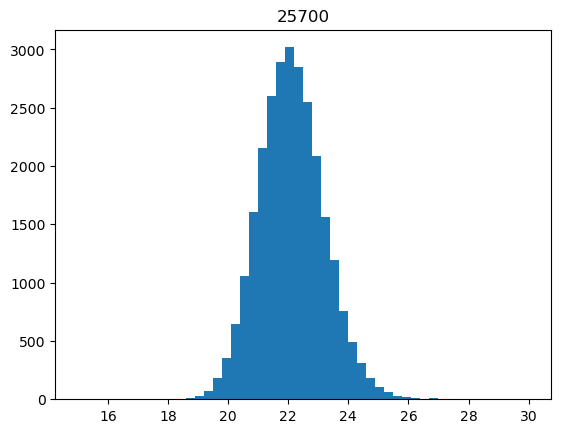

 83%|█████████████████████████████████████████████████████████████████▋             | 893/1075 [01:59<00:23,  7.73it/s]

19164


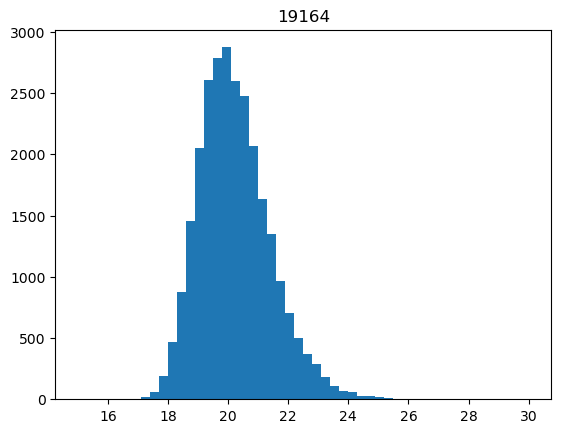

 83%|█████████████████████████████████████████████████████████████████▋             | 894/1075 [01:59<00:23,  7.79it/s]

25114


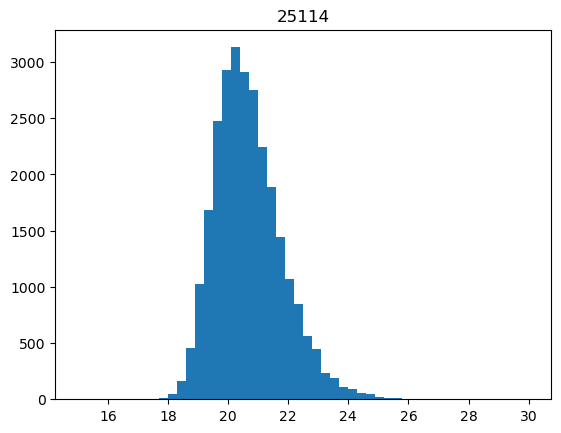

 83%|█████████████████████████████████████████████████████████████████▊             | 895/1075 [01:59<00:22,  7.87it/s]

22022


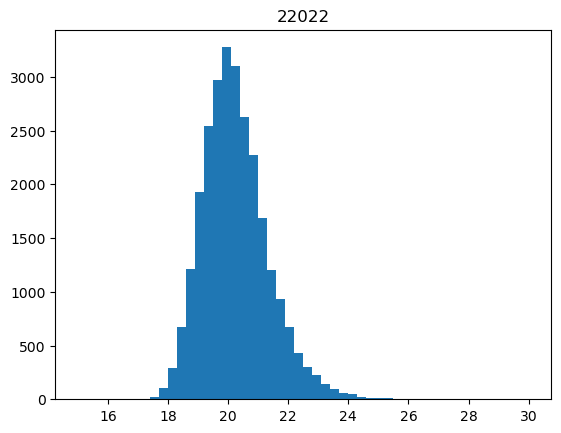

 83%|█████████████████████████████████████████████████████████████████▊             | 896/1075 [01:59<00:22,  7.91it/s]

25607


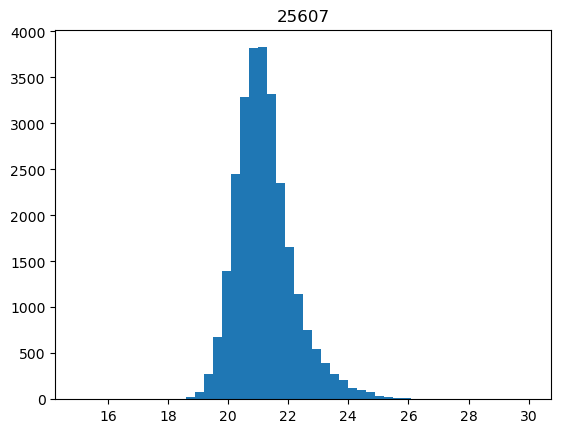

 83%|█████████████████████████████████████████████████████████████████▉             | 897/1075 [02:00<00:27,  6.57it/s]

10384


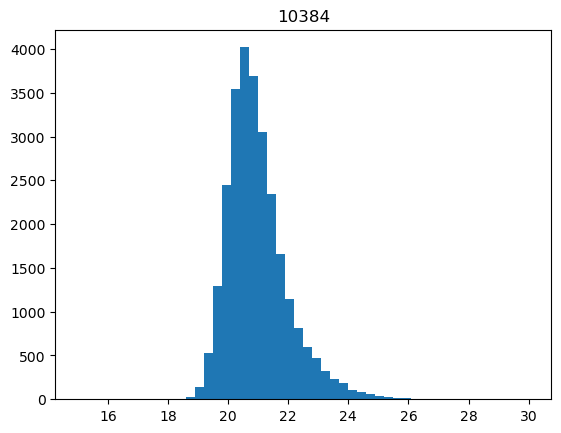

 84%|█████████████████████████████████████████████████████████████████▉             | 898/1075 [02:00<00:25,  6.90it/s]

8825


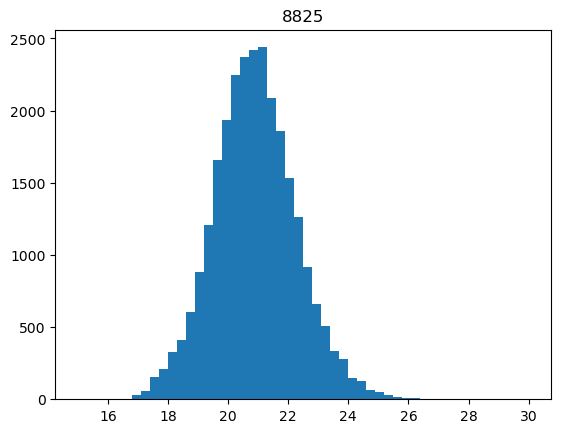

 84%|██████████████████████████████████████████████████████████████████             | 899/1075 [02:00<00:24,  7.18it/s]

17247


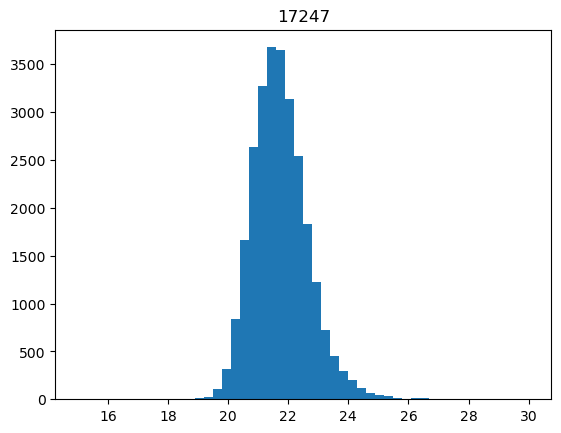

 84%|██████████████████████████████████████████████████████████████████▏            | 900/1075 [02:00<00:23,  7.36it/s]

25252


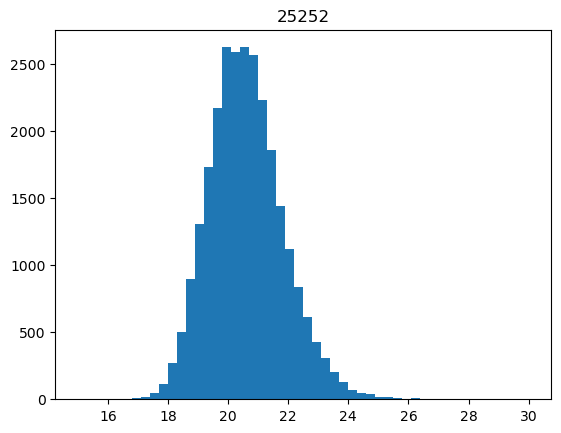

 84%|██████████████████████████████████████████████████████████████████▏            | 901/1075 [02:00<00:22,  7.59it/s]

20732


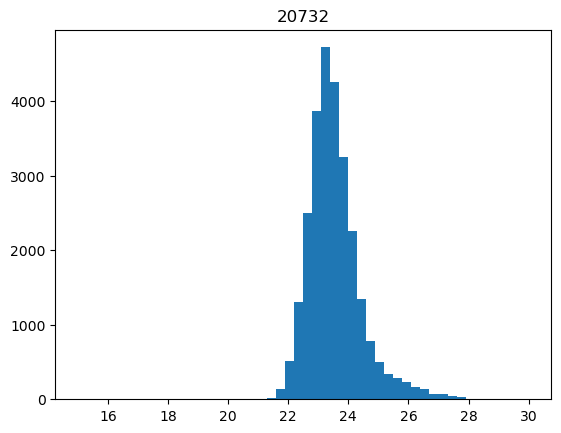

 84%|██████████████████████████████████████████████████████████████████▎            | 902/1075 [02:00<00:22,  7.84it/s]

5338


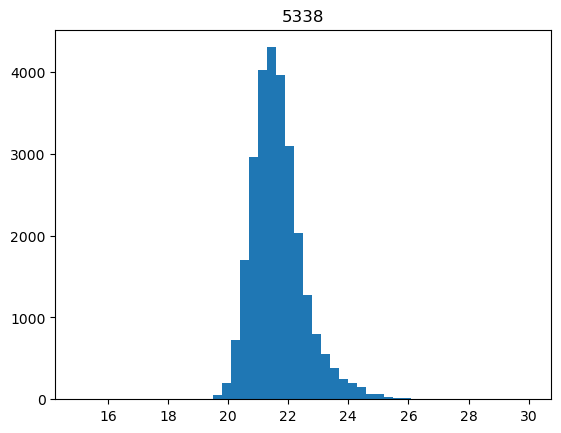

 84%|██████████████████████████████████████████████████████████████████▎            | 903/1075 [02:00<00:21,  7.92it/s]

822


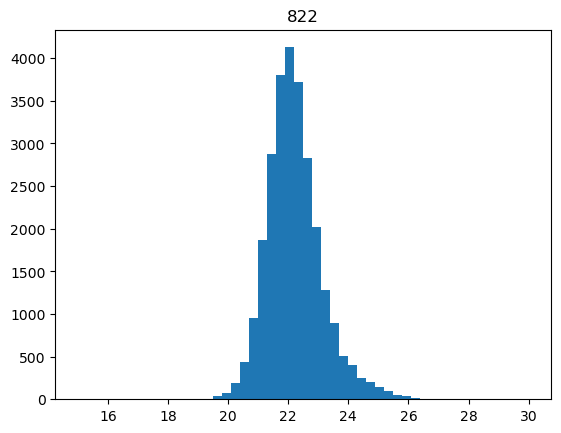

 84%|██████████████████████████████████████████████████████████████████▍            | 904/1075 [02:00<00:21,  7.91it/s]

18546


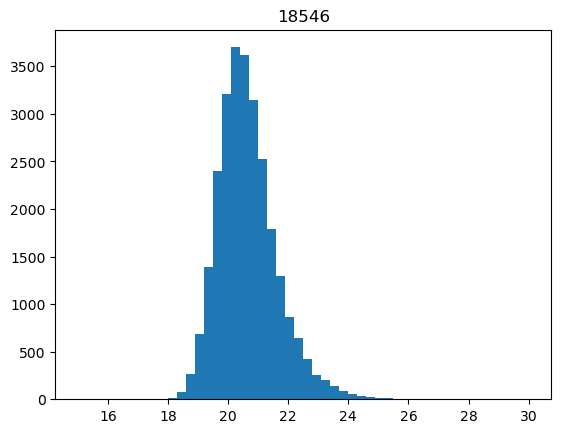

 84%|██████████████████████████████████████████████████████████████████▌            | 905/1075 [02:01<00:21,  7.90it/s]

6858


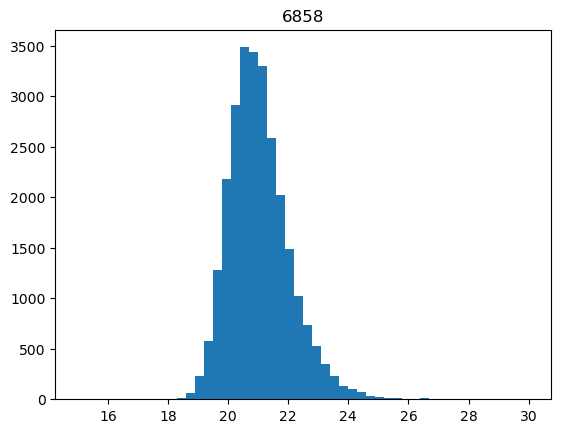

 84%|██████████████████████████████████████████████████████████████████▌            | 906/1075 [02:01<00:21,  7.89it/s]

3213


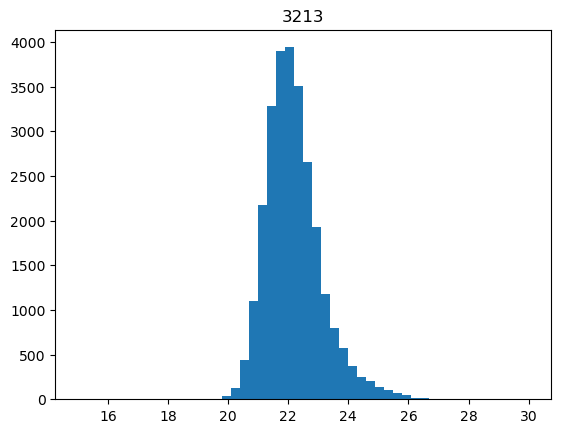

 84%|██████████████████████████████████████████████████████████████████▋            | 907/1075 [02:01<00:21,  7.87it/s]

14963


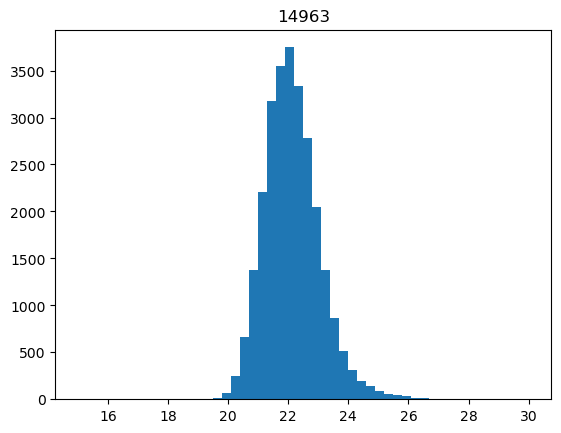

 84%|██████████████████████████████████████████████████████████████████▋            | 908/1075 [02:01<00:25,  6.59it/s]

15744


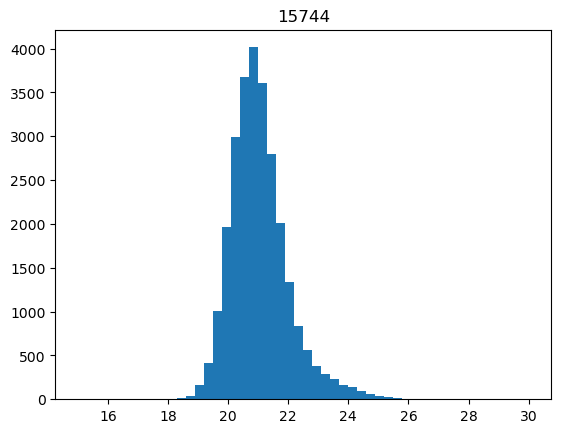

 85%|██████████████████████████████████████████████████████████████████▊            | 909/1075 [02:01<00:23,  6.97it/s]

17742


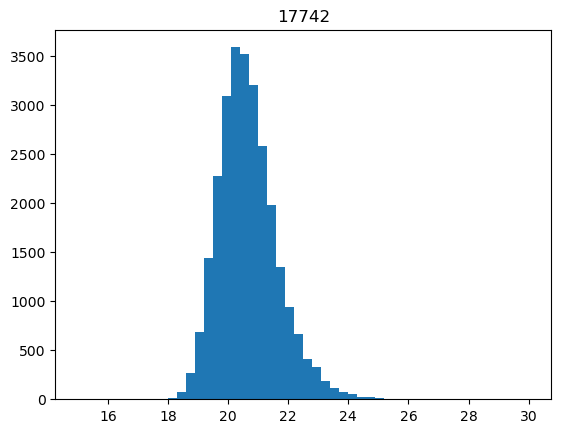

 85%|██████████████████████████████████████████████████████████████████▊            | 910/1075 [02:01<00:22,  7.24it/s]

137


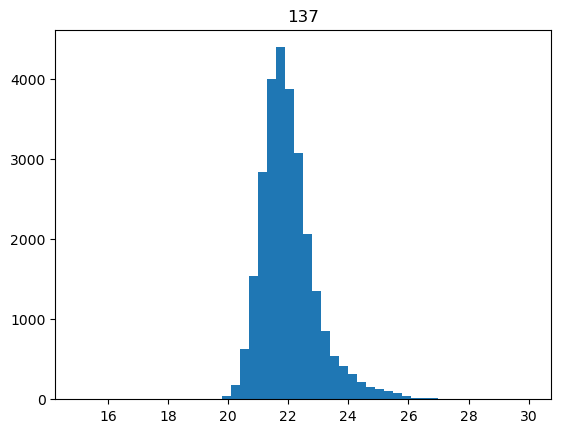

 85%|██████████████████████████████████████████████████████████████████▉            | 911/1075 [02:01<00:21,  7.52it/s]

15092


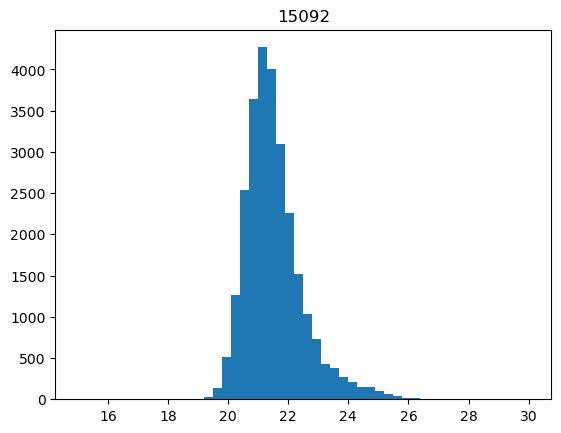

 85%|███████████████████████████████████████████████████████████████████            | 912/1075 [02:01<00:21,  7.62it/s]

8592


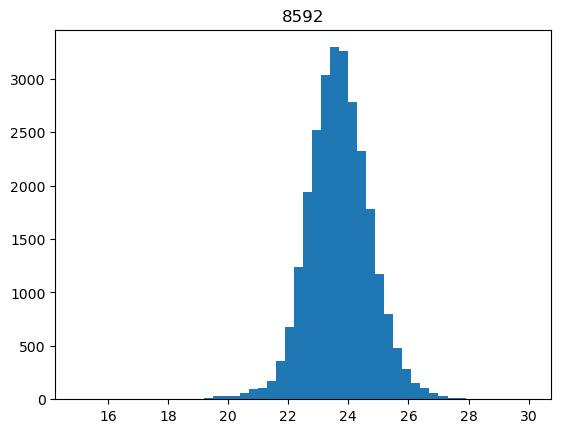

 85%|███████████████████████████████████████████████████████████████████            | 913/1075 [02:02<00:20,  7.77it/s]

9736


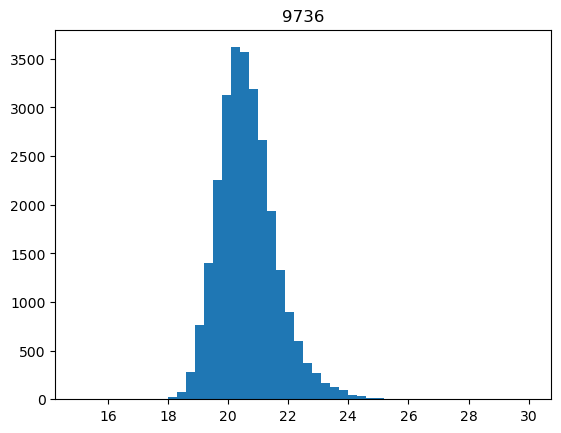

 85%|███████████████████████████████████████████████████████████████████▏           | 914/1075 [02:02<00:20,  7.80it/s]

23948


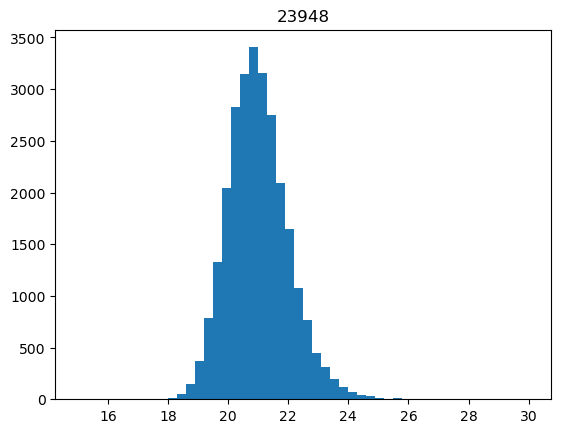

 85%|███████████████████████████████████████████████████████████████████▏           | 915/1075 [02:02<00:20,  7.88it/s]

20889


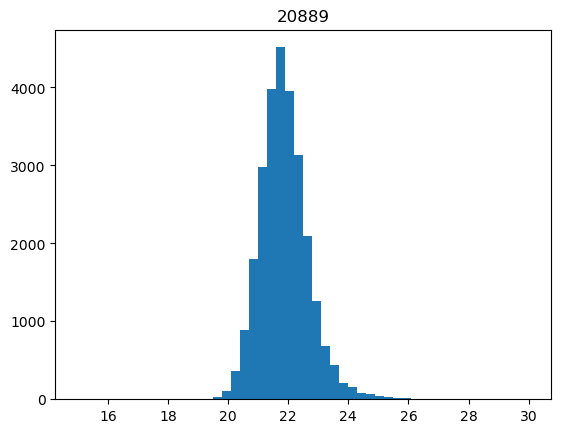

 85%|███████████████████████████████████████████████████████████████████▎           | 916/1075 [02:02<00:19,  7.99it/s]

22300


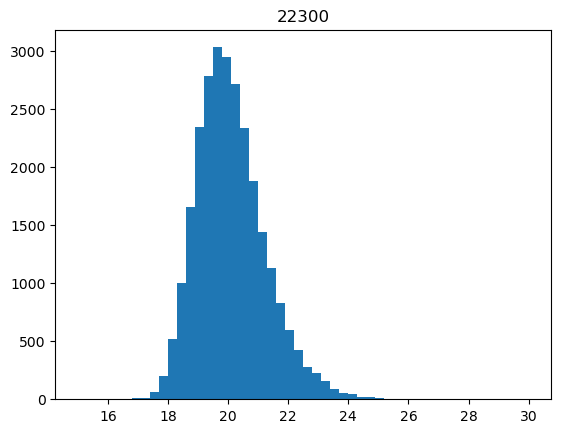

 85%|███████████████████████████████████████████████████████████████████▍           | 917/1075 [02:02<00:19,  8.01it/s]

9334


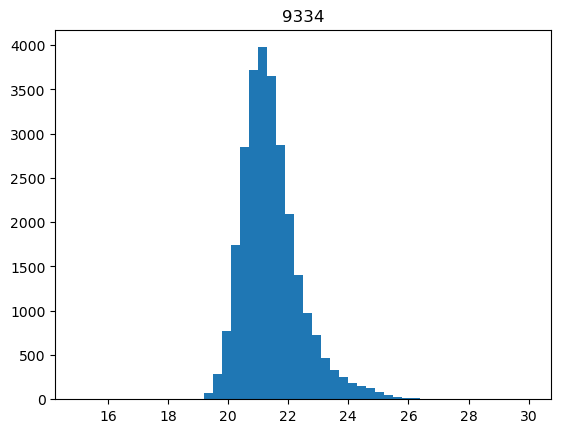

 85%|███████████████████████████████████████████████████████████████████▍           | 918/1075 [02:02<00:19,  7.93it/s]

14492


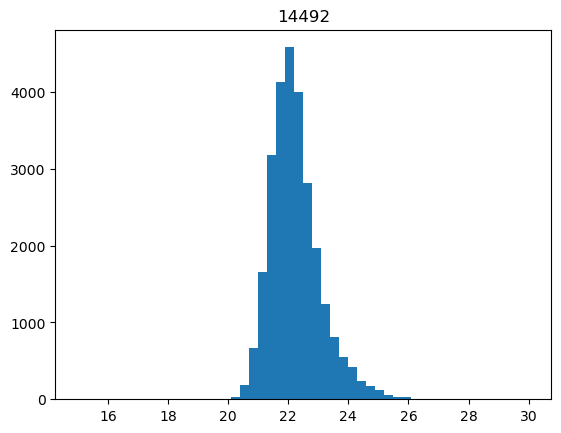

 85%|███████████████████████████████████████████████████████████████████▌           | 919/1075 [02:02<00:23,  6.72it/s]

26515


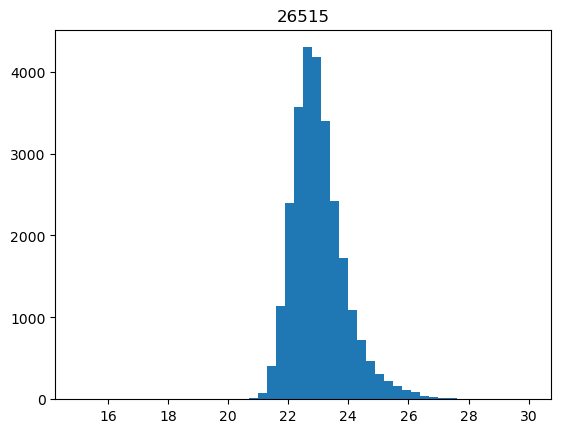

 86%|███████████████████████████████████████████████████████████████████▌           | 920/1075 [02:03<00:21,  7.16it/s]

3785


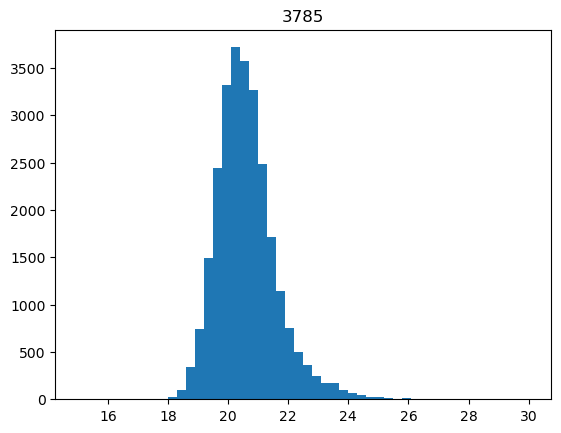

 86%|███████████████████████████████████████████████████████████████████▋           | 921/1075 [02:03<00:20,  7.38it/s]

10522


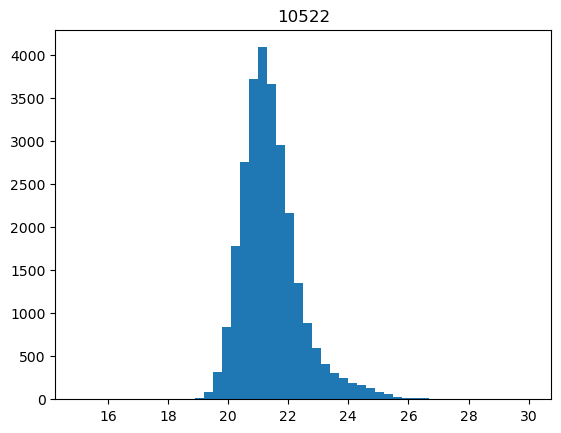

 86%|███████████████████████████████████████████████████████████████████▊           | 922/1075 [02:03<00:20,  7.44it/s]

5145


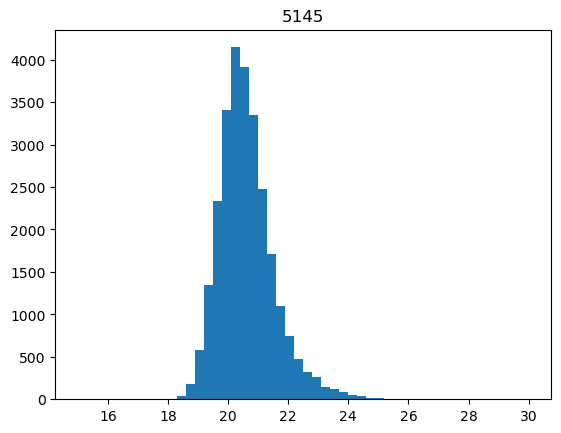

 86%|███████████████████████████████████████████████████████████████████▊           | 923/1075 [02:03<00:20,  7.53it/s]

26559


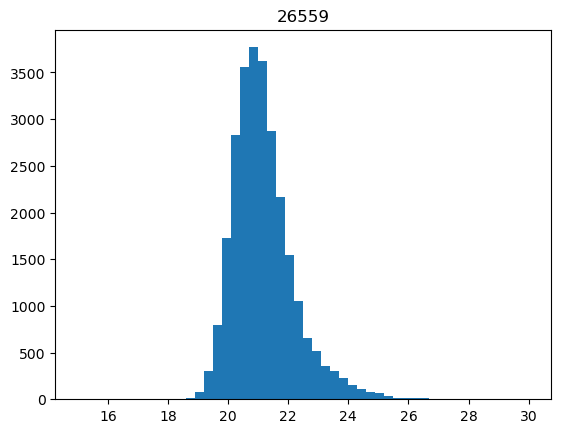

 86%|███████████████████████████████████████████████████████████████████▉           | 924/1075 [02:03<00:19,  7.64it/s]

16653


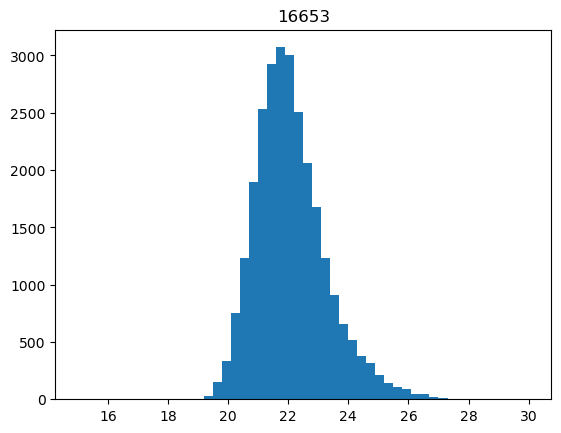

 86%|███████████████████████████████████████████████████████████████████▉           | 925/1075 [02:03<00:19,  7.77it/s]

11492


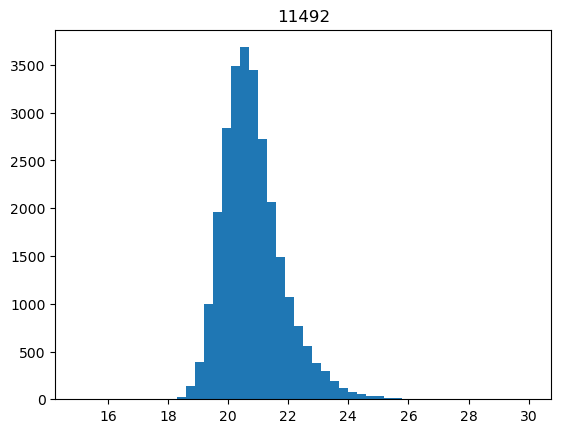

 86%|████████████████████████████████████████████████████████████████████           | 926/1075 [02:03<00:19,  7.80it/s]

19963


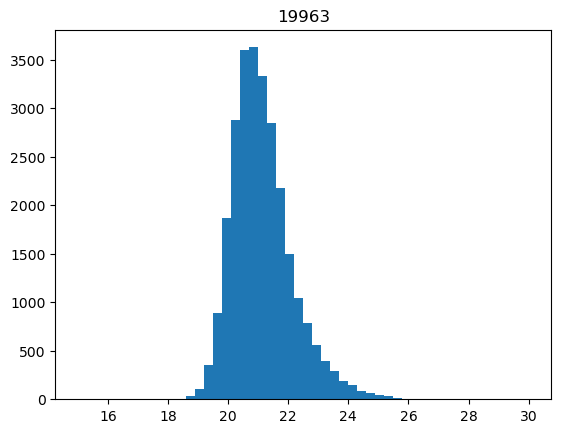

 86%|████████████████████████████████████████████████████████████████████           | 927/1075 [02:03<00:18,  7.84it/s]

8310


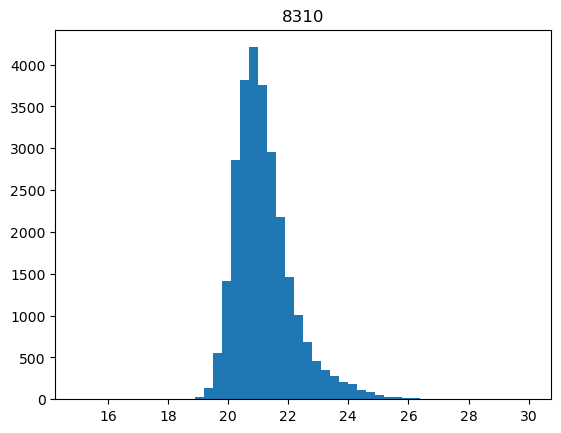

 86%|████████████████████████████████████████████████████████████████████▏          | 928/1075 [02:04<00:18,  7.87it/s]

18218


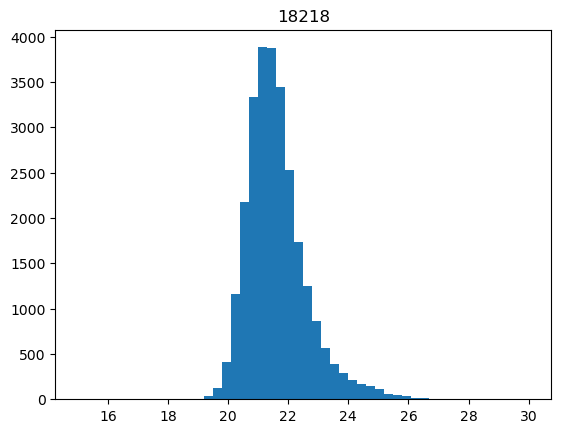

 86%|████████████████████████████████████████████████████████████████████▎          | 929/1075 [02:04<00:18,  7.91it/s]

9080


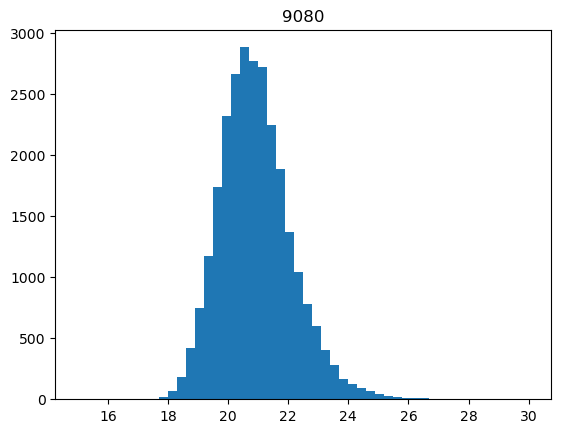

 87%|████████████████████████████████████████████████████████████████████▎          | 930/1075 [02:04<00:21,  6.60it/s]

16575


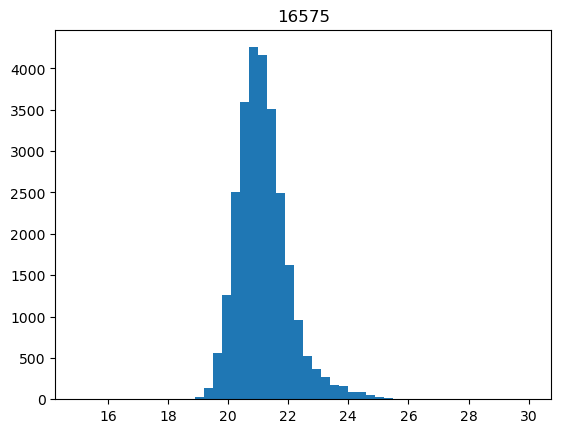

 87%|████████████████████████████████████████████████████████████████████▍          | 931/1075 [02:04<00:20,  6.93it/s]

4989


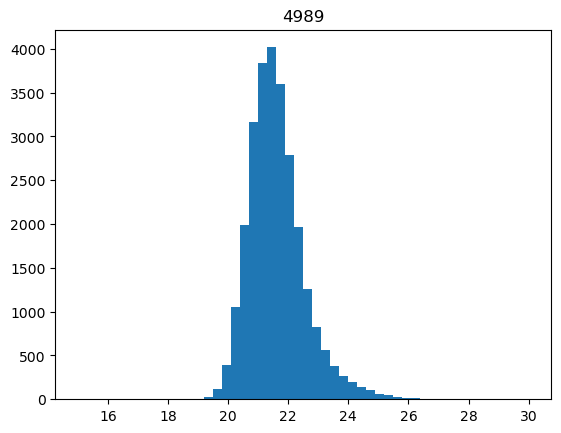

 87%|████████████████████████████████████████████████████████████████████▍          | 932/1075 [02:04<00:20,  7.15it/s]

25907


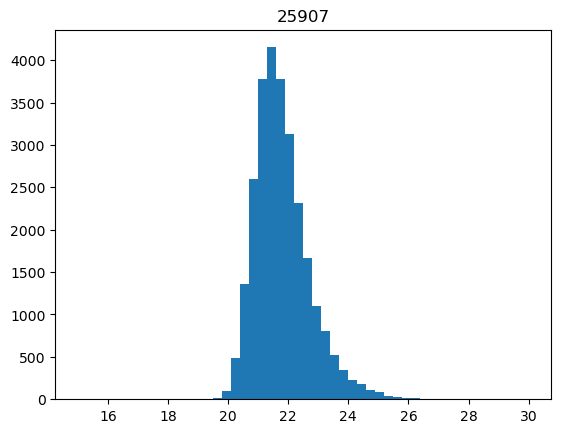

 87%|████████████████████████████████████████████████████████████████████▌          | 933/1075 [02:04<00:19,  7.35it/s]

22348


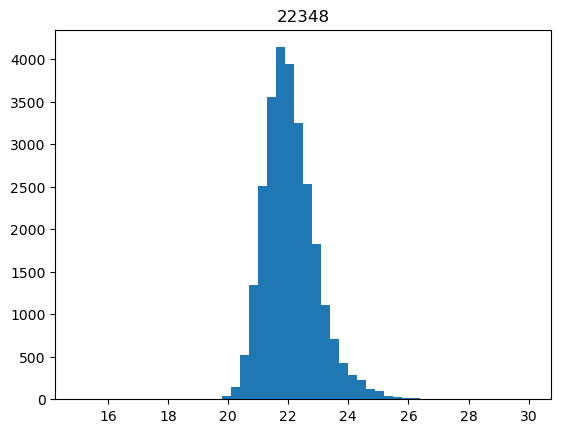

 87%|████████████████████████████████████████████████████████████████████▋          | 934/1075 [02:04<00:18,  7.50it/s]

19425


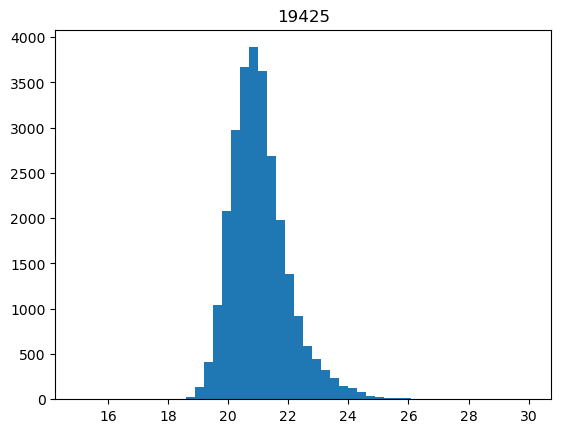

 87%|████████████████████████████████████████████████████████████████████▋          | 935/1075 [02:05<00:18,  7.56it/s]

21360


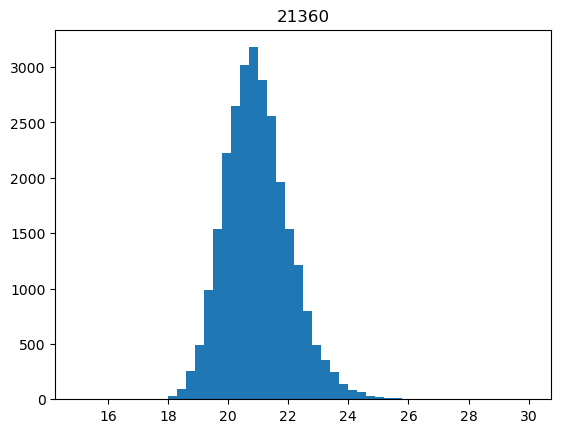

 87%|████████████████████████████████████████████████████████████████████▊          | 936/1075 [02:05<00:18,  7.65it/s]

6978


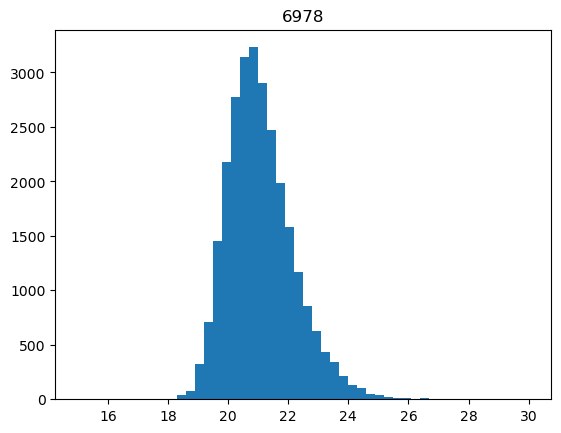

 87%|████████████████████████████████████████████████████████████████████▊          | 937/1075 [02:05<00:17,  7.75it/s]

2880


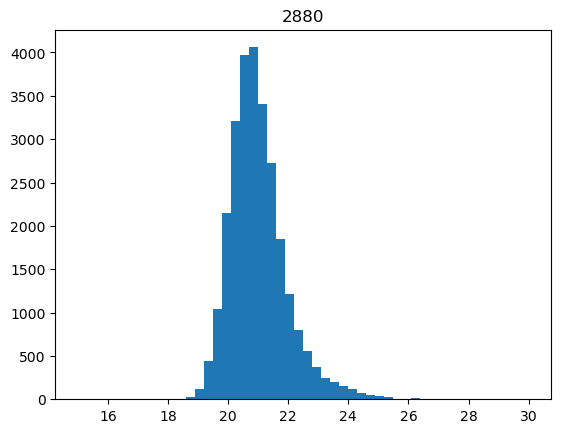

 87%|████████████████████████████████████████████████████████████████████▉          | 938/1075 [02:05<00:17,  7.77it/s]

4932


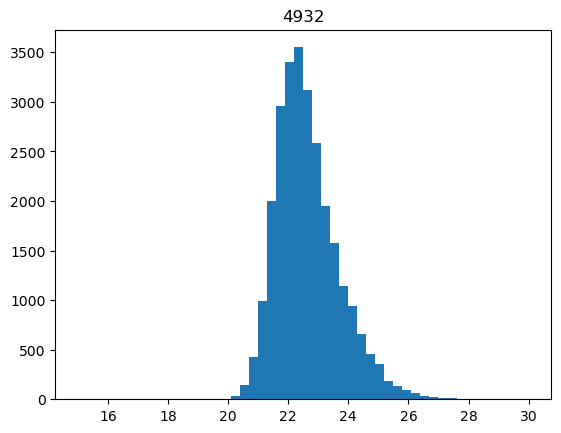

 87%|█████████████████████████████████████████████████████████████████████          | 939/1075 [02:05<00:17,  7.80it/s]

3230


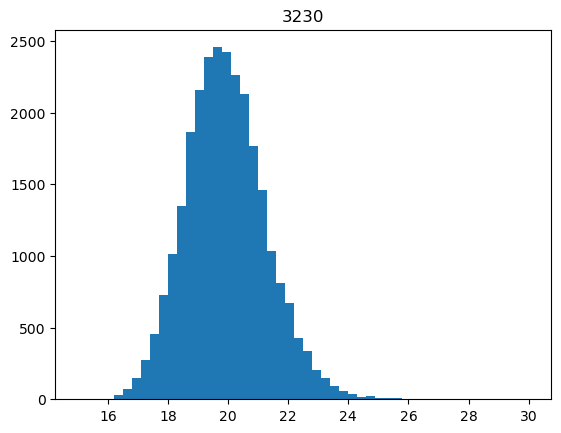

 87%|█████████████████████████████████████████████████████████████████████          | 940/1075 [02:05<00:17,  7.88it/s]

5901


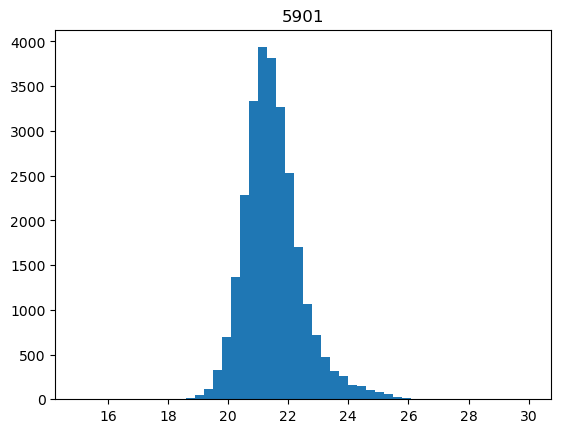

 88%|█████████████████████████████████████████████████████████████████████▏         | 941/1075 [02:05<00:20,  6.60it/s]

16417


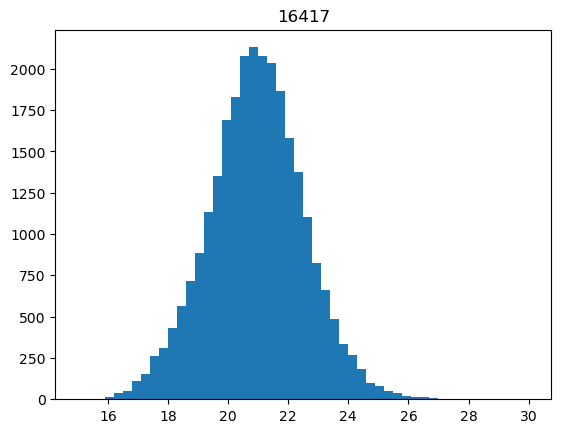

 88%|█████████████████████████████████████████████████████████████████████▏         | 942/1075 [02:06<00:19,  6.95it/s]

21390


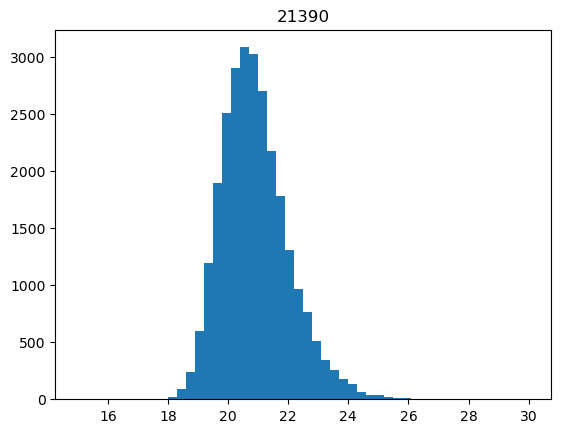

 88%|█████████████████████████████████████████████████████████████████████▎         | 943/1075 [02:06<00:18,  7.20it/s]

17424


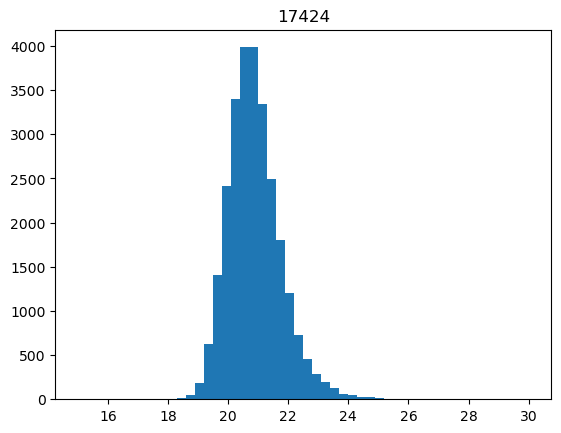

 88%|█████████████████████████████████████████████████████████████████████▎         | 944/1075 [02:06<00:17,  7.34it/s]

19825


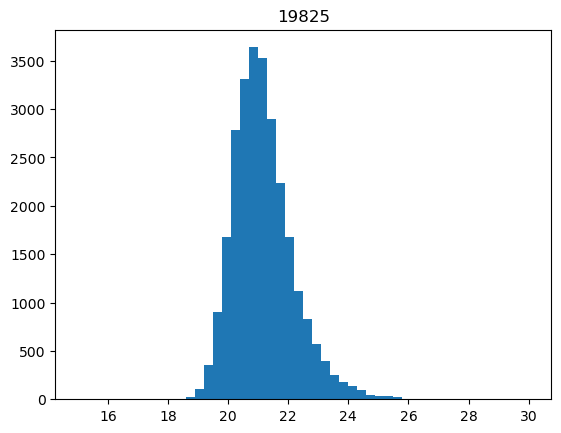

 88%|█████████████████████████████████████████████████████████████████████▍         | 945/1075 [02:06<00:17,  7.53it/s]

2449


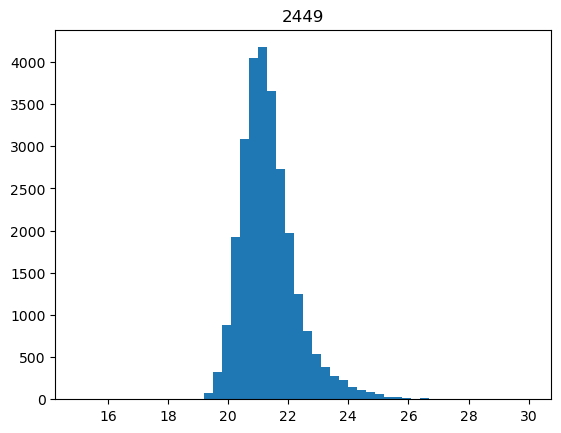

 88%|█████████████████████████████████████████████████████████████████████▌         | 946/1075 [02:06<00:16,  7.63it/s]

6247


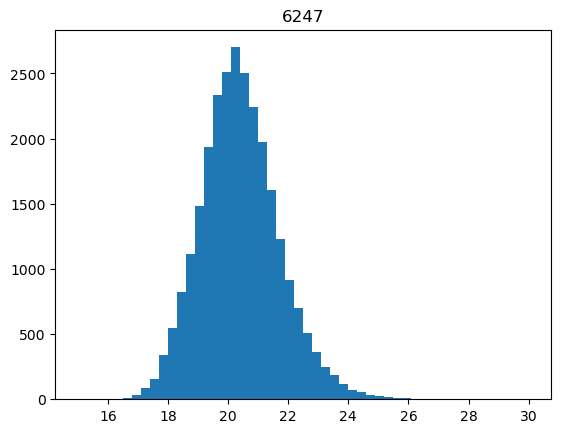

 88%|█████████████████████████████████████████████████████████████████████▌         | 947/1075 [02:06<00:16,  7.77it/s]

7091


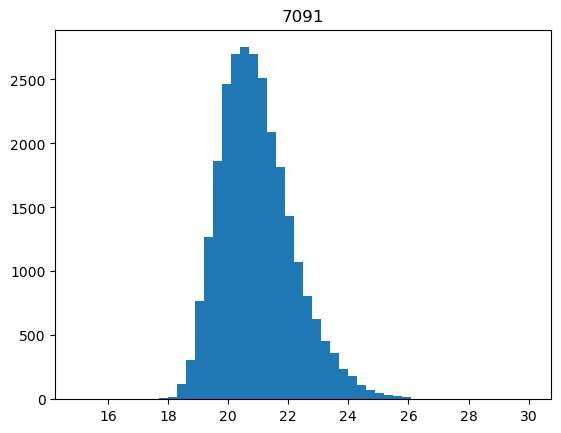

 88%|█████████████████████████████████████████████████████████████████████▋         | 948/1075 [02:06<00:16,  7.89it/s]

2923


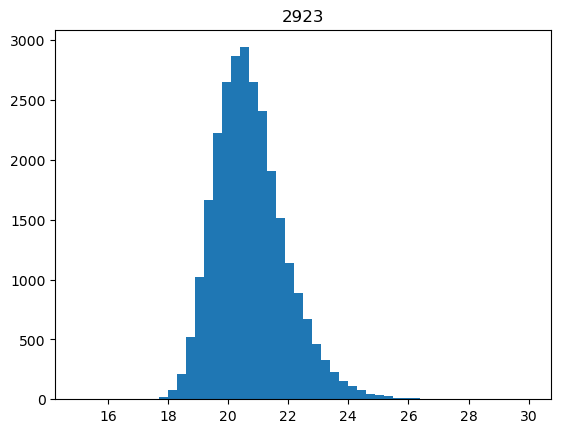

 88%|█████████████████████████████████████████████████████████████████████▋         | 949/1075 [02:06<00:15,  7.94it/s]

14150


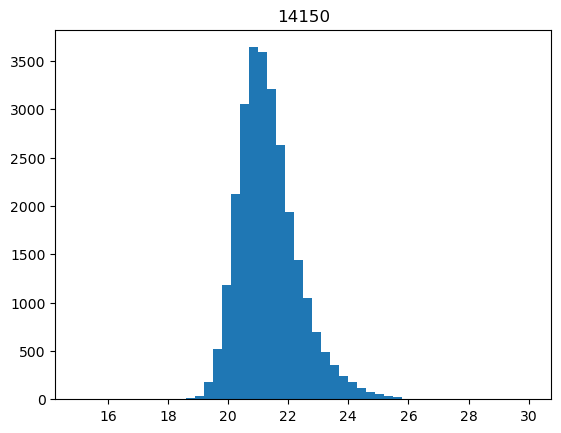

 88%|█████████████████████████████████████████████████████████████████████▊         | 950/1075 [02:07<00:15,  7.96it/s]

5179


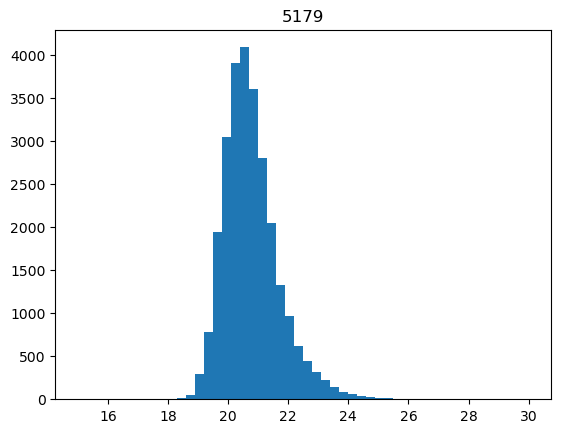

 88%|█████████████████████████████████████████████████████████████████████▉         | 951/1075 [02:07<00:15,  7.91it/s]

20688


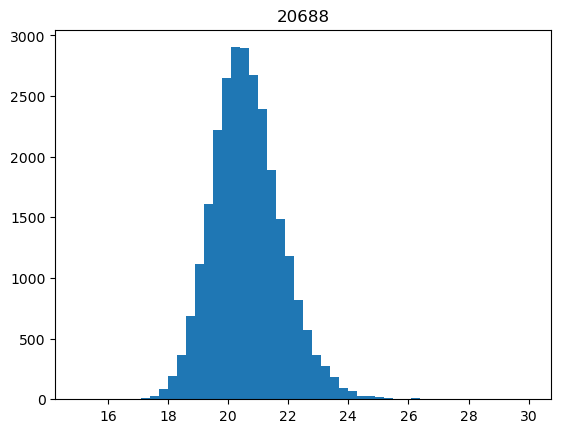

 89%|█████████████████████████████████████████████████████████████████████▉         | 952/1075 [02:07<00:18,  6.60it/s]

13886


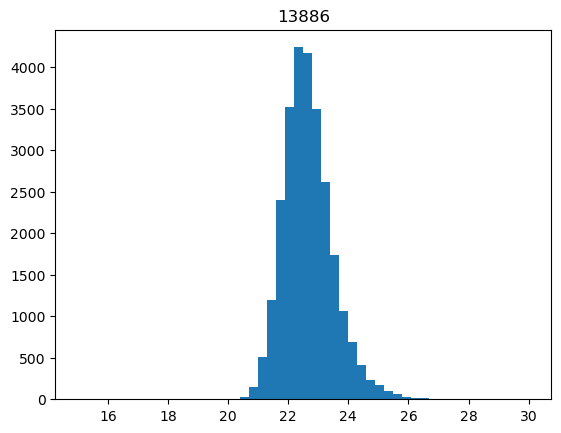

 89%|██████████████████████████████████████████████████████████████████████         | 953/1075 [02:07<00:17,  6.98it/s]

1992


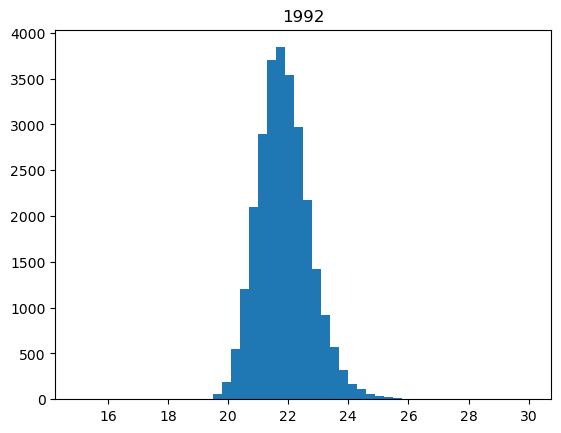

 89%|██████████████████████████████████████████████████████████████████████         | 954/1075 [02:07<00:16,  7.21it/s]

5770


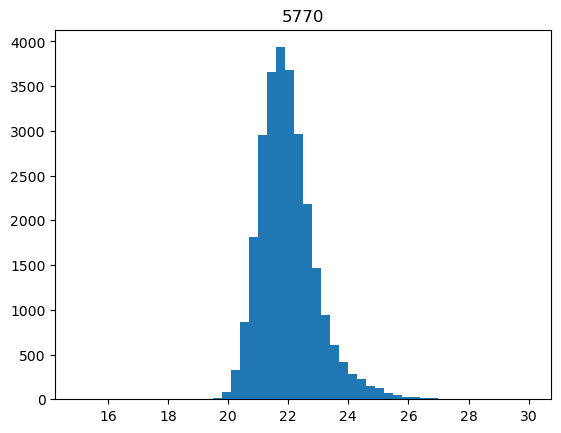

 89%|██████████████████████████████████████████████████████████████████████▏        | 955/1075 [02:07<00:16,  7.40it/s]

16528


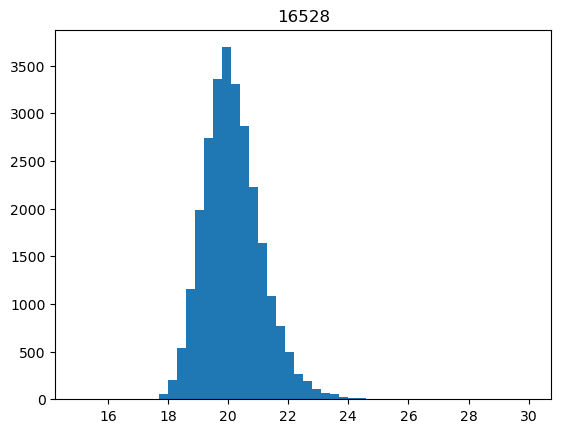

 89%|██████████████████████████████████████████████████████████████████████▎        | 956/1075 [02:07<00:15,  7.59it/s]

12278


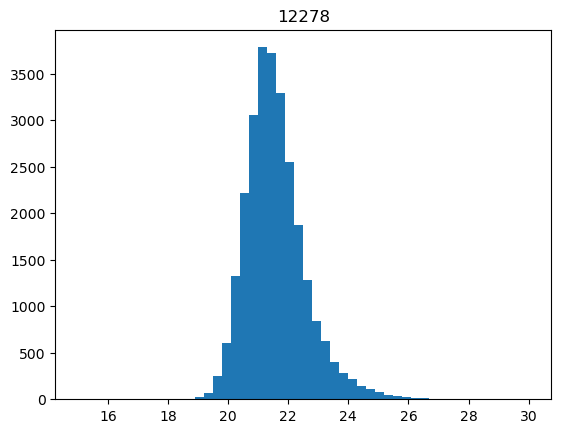

 89%|██████████████████████████████████████████████████████████████████████▎        | 957/1075 [02:07<00:15,  7.70it/s]

25990


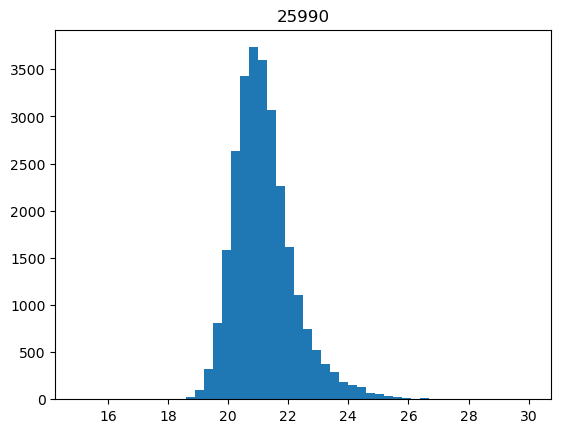

 89%|██████████████████████████████████████████████████████████████████████▍        | 958/1075 [02:08<00:15,  7.75it/s]

18178


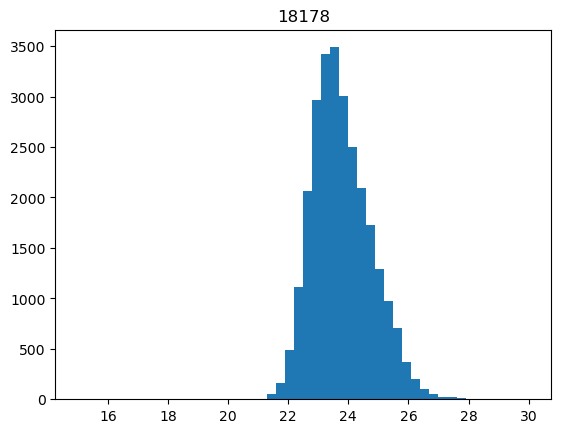

 89%|██████████████████████████████████████████████████████████████████████▍        | 959/1075 [02:08<00:14,  7.81it/s]

25848


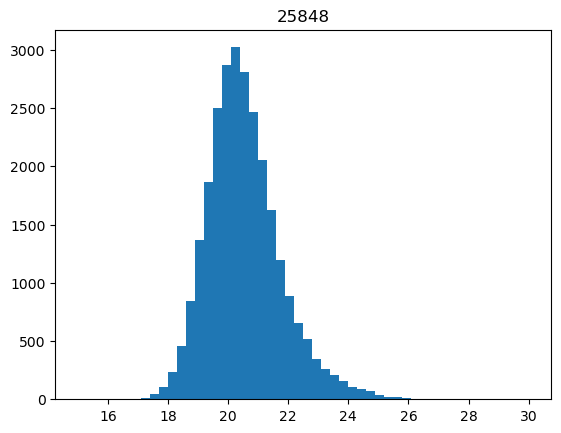

 89%|██████████████████████████████████████████████████████████████████████▌        | 960/1075 [02:08<00:14,  7.88it/s]

22657


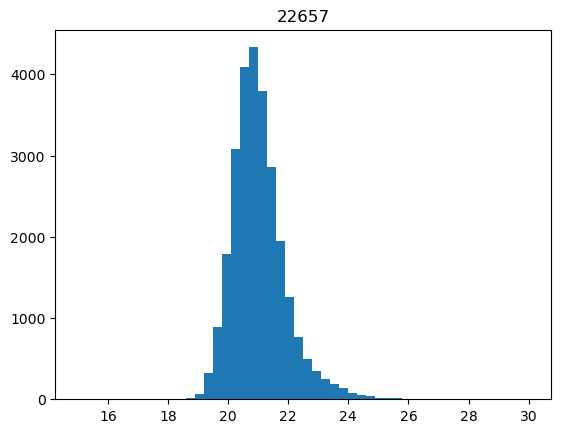

 89%|██████████████████████████████████████████████████████████████████████▌        | 961/1075 [02:08<00:14,  8.05it/s]

4016


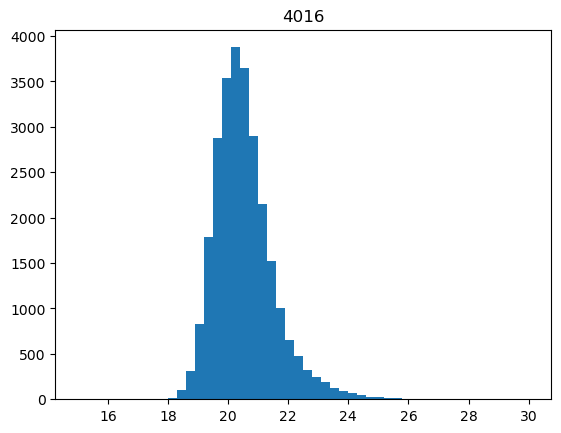

 89%|██████████████████████████████████████████████████████████████████████▋        | 962/1075 [02:08<00:14,  7.94it/s]

3678


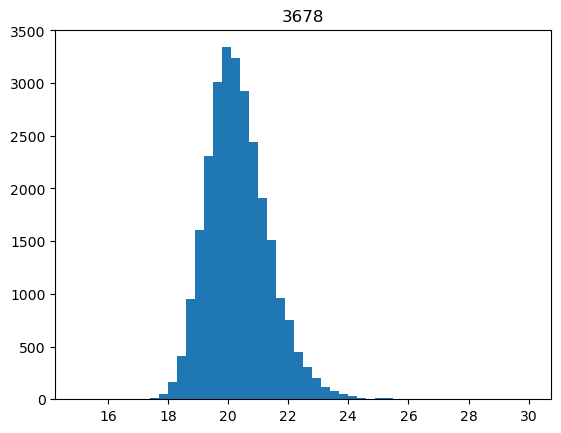

 90%|██████████████████████████████████████████████████████████████████████▊        | 963/1075 [02:08<00:16,  6.60it/s]

23304


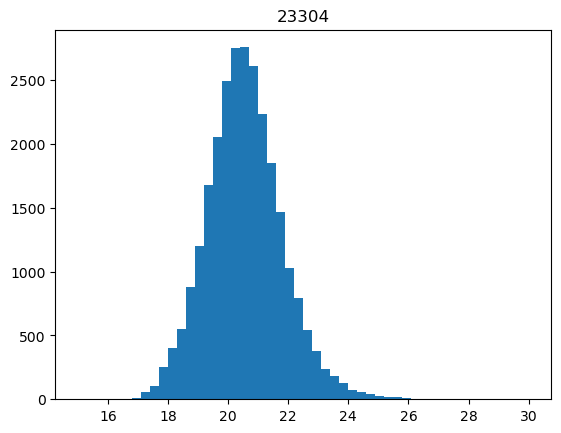

 90%|██████████████████████████████████████████████████████████████████████▊        | 964/1075 [02:08<00:15,  7.03it/s]

4596


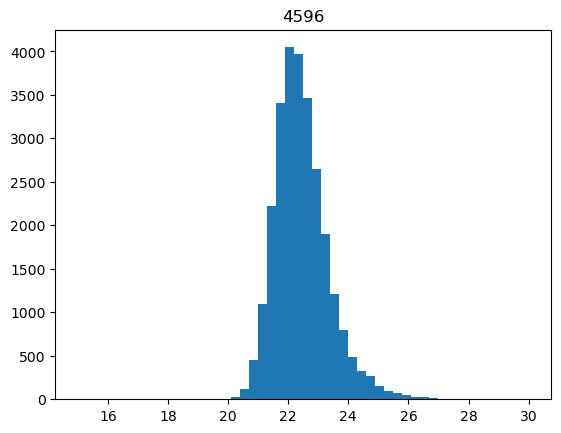

 90%|██████████████████████████████████████████████████████████████████████▉        | 965/1075 [02:09<00:15,  7.28it/s]

22552


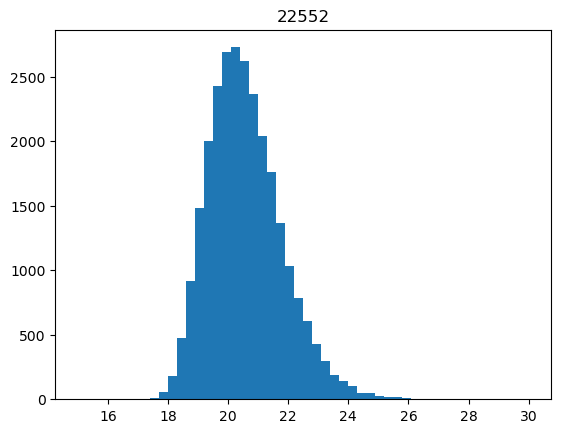

 90%|██████████████████████████████████████████████████████████████████████▉        | 966/1075 [02:09<00:14,  7.53it/s]

9093


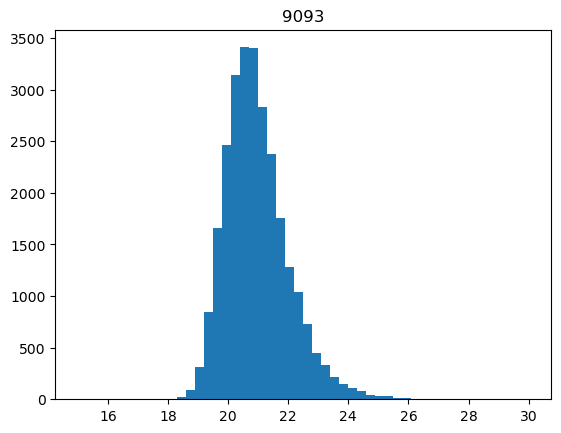

 90%|███████████████████████████████████████████████████████████████████████        | 967/1075 [02:09<00:14,  7.61it/s]

12377


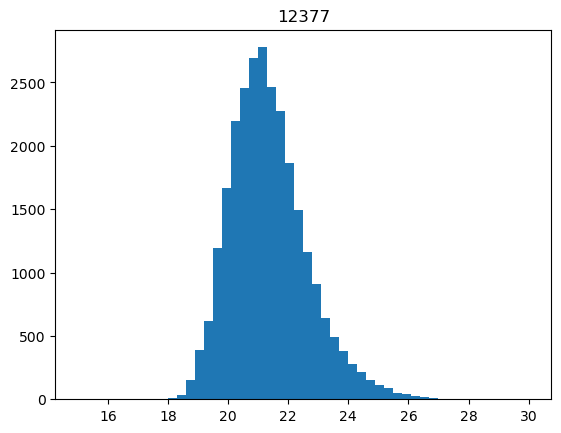

 90%|███████████████████████████████████████████████████████████████████████▏       | 968/1075 [02:09<00:13,  7.78it/s]

26841


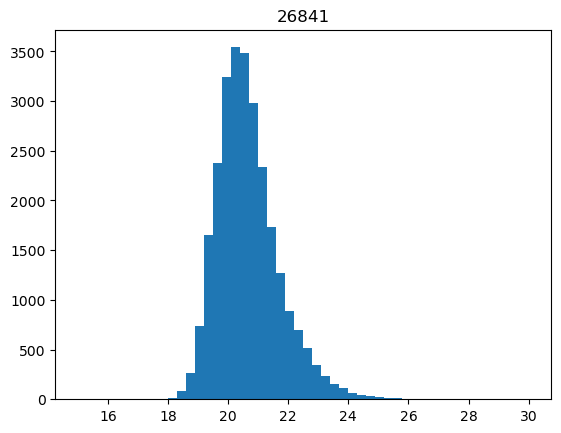

 90%|███████████████████████████████████████████████████████████████████████▏       | 969/1075 [02:09<00:13,  7.82it/s]

15619


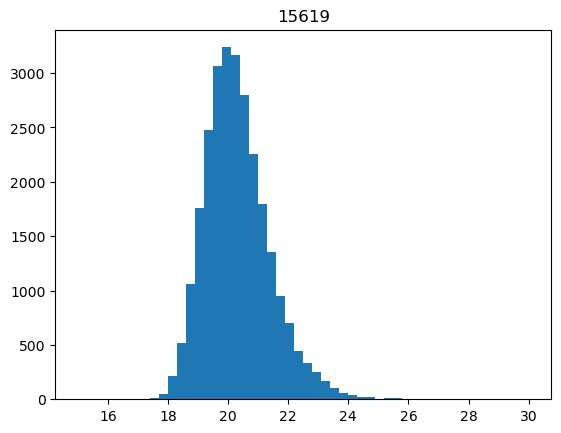

 90%|███████████████████████████████████████████████████████████████████████▎       | 970/1075 [02:09<00:13,  7.89it/s]

16332


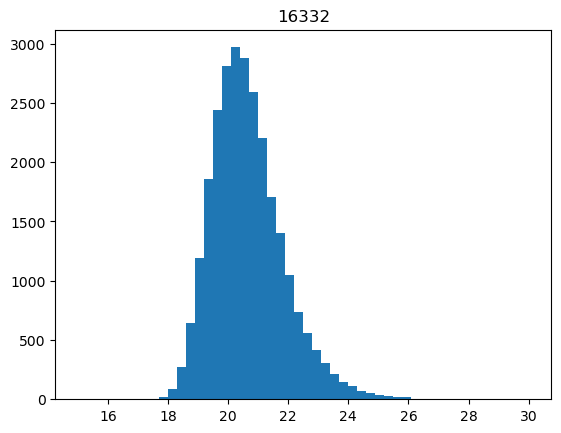

 90%|███████████████████████████████████████████████████████████████████████▎       | 971/1075 [02:09<00:13,  7.98it/s]

20643


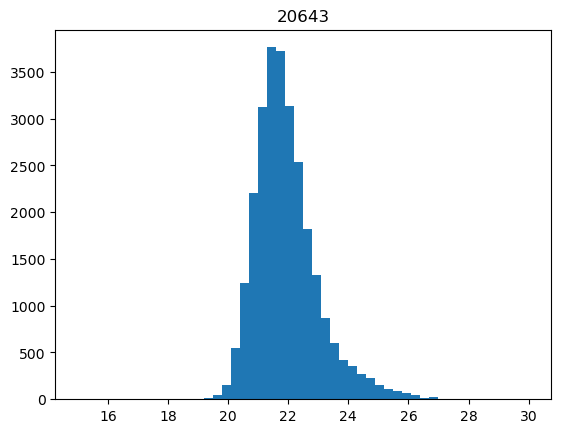

 90%|███████████████████████████████████████████████████████████████████████▍       | 972/1075 [02:09<00:13,  7.91it/s]

11024


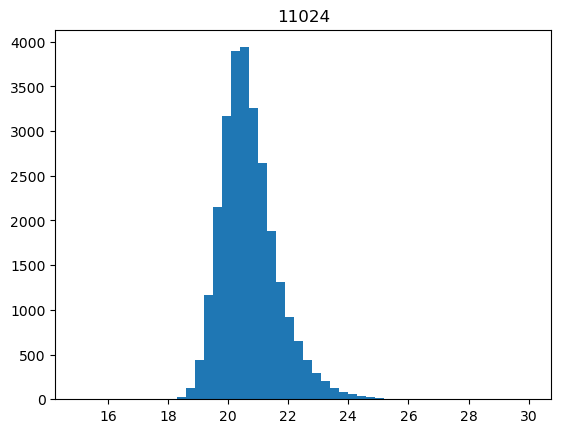

 91%|███████████████████████████████████████████████████████████████████████▌       | 973/1075 [02:10<00:12,  7.86it/s]

8554


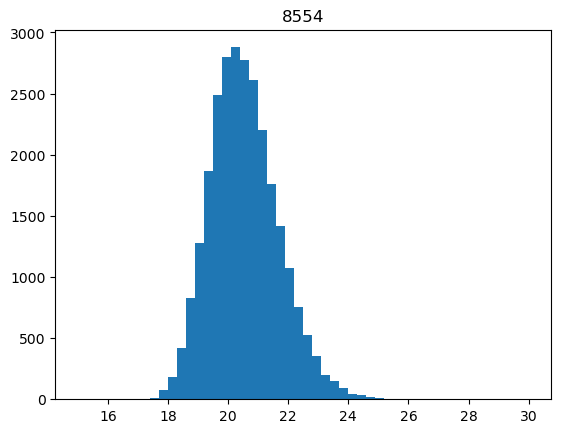

 91%|███████████████████████████████████████████████████████████████████████▌       | 974/1075 [02:10<00:15,  6.60it/s]

340


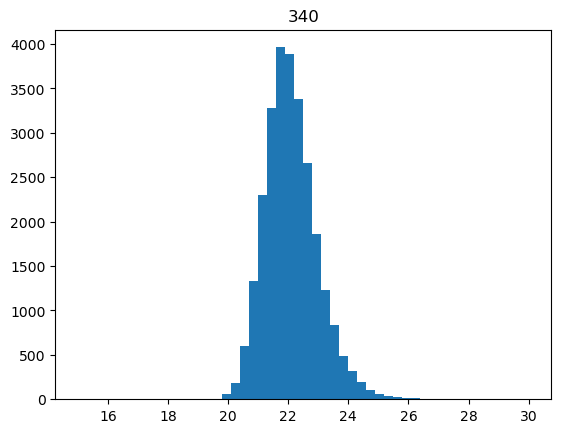

 91%|███████████████████████████████████████████████████████████████████████▋       | 975/1075 [02:10<00:14,  6.94it/s]

7680


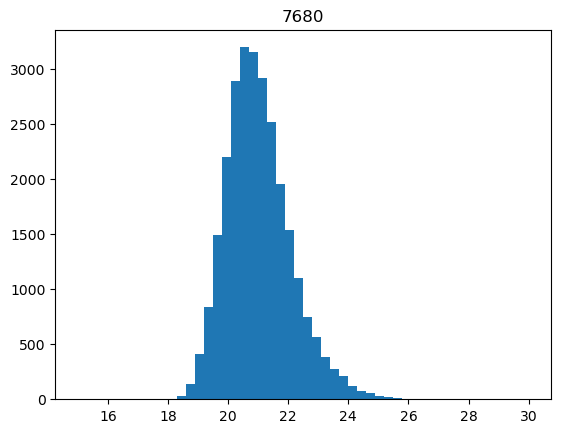

 91%|███████████████████████████████████████████████████████████████████████▋       | 976/1075 [02:10<00:13,  7.18it/s]

8196


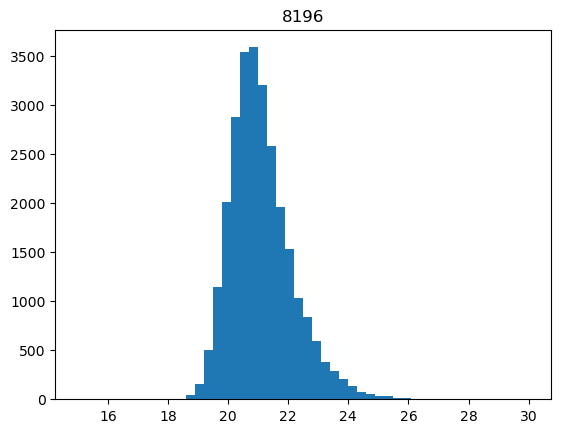

 91%|███████████████████████████████████████████████████████████████████████▊       | 977/1075 [02:10<00:13,  7.37it/s]

13854


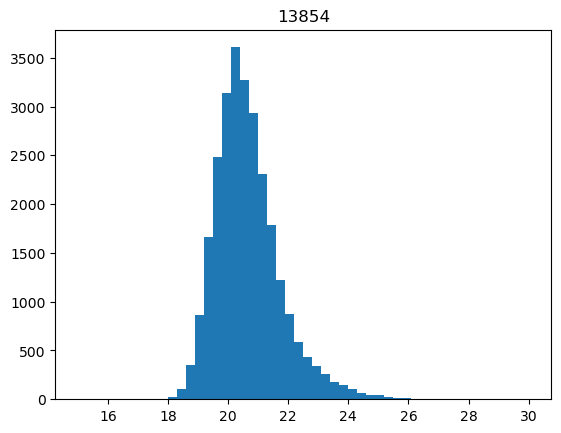

 91%|███████████████████████████████████████████████████████████████████████▊       | 978/1075 [02:10<00:12,  7.57it/s]

25781


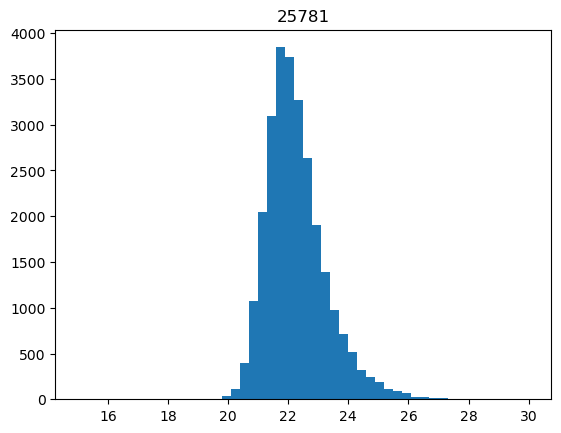

 91%|███████████████████████████████████████████████████████████████████████▉       | 979/1075 [02:10<00:12,  7.66it/s]

8159


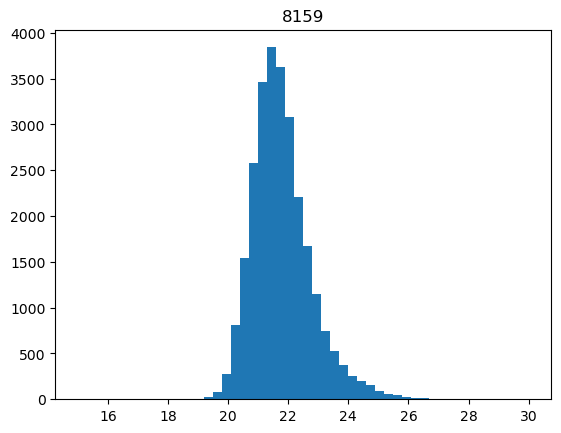

 91%|████████████████████████████████████████████████████████████████████████       | 980/1075 [02:11<00:12,  7.70it/s]

14911


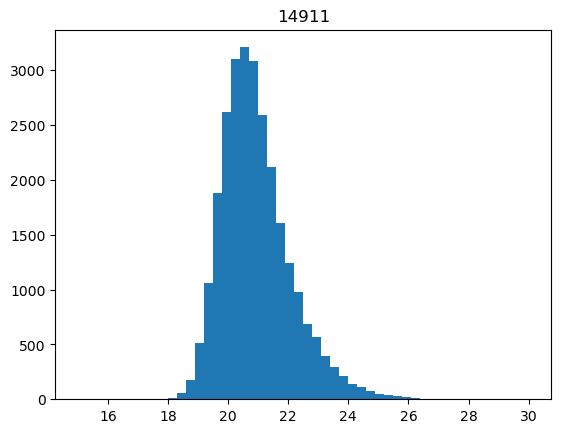

 91%|████████████████████████████████████████████████████████████████████████       | 981/1075 [02:11<00:12,  7.77it/s]

11558


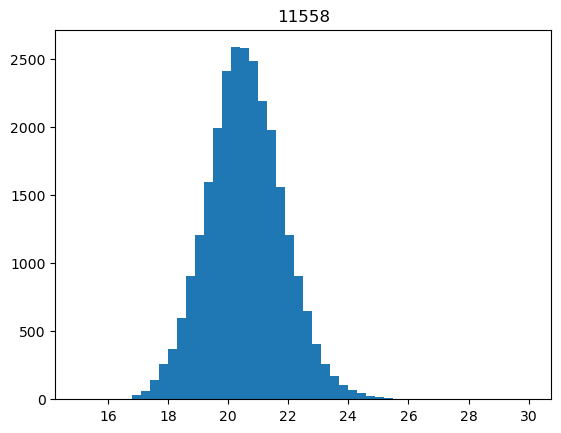

 91%|████████████████████████████████████████████████████████████████████████▏      | 982/1075 [02:11<00:11,  7.87it/s]

20656


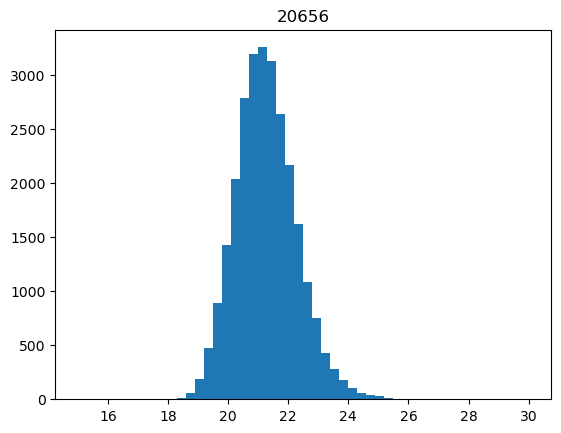

 91%|████████████████████████████████████████████████████████████████████████▏      | 983/1075 [02:11<00:11,  8.01it/s]

13189


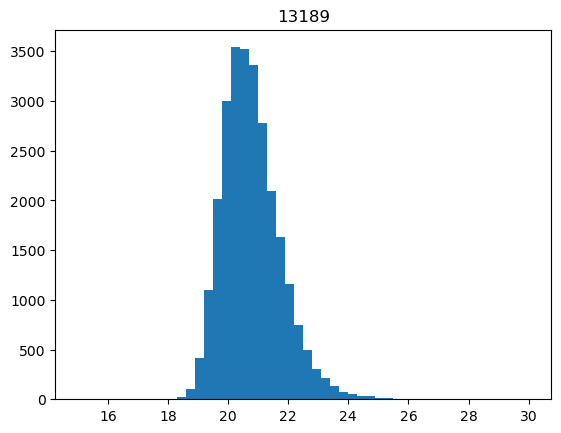

 92%|████████████████████████████████████████████████████████████████████████▎      | 984/1075 [02:11<00:11,  8.00it/s]

26218


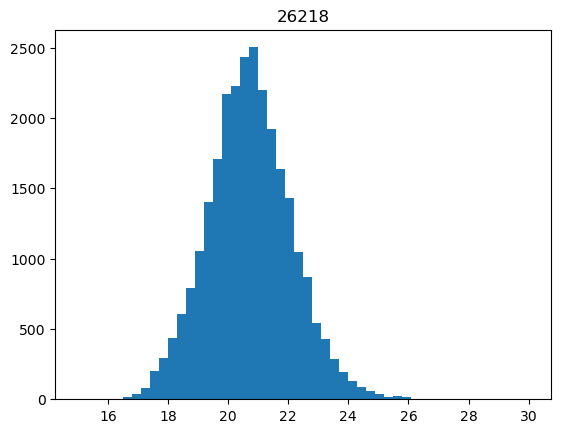

 92%|████████████████████████████████████████████████████████████████████████▍      | 985/1075 [02:11<00:13,  6.65it/s]

3479


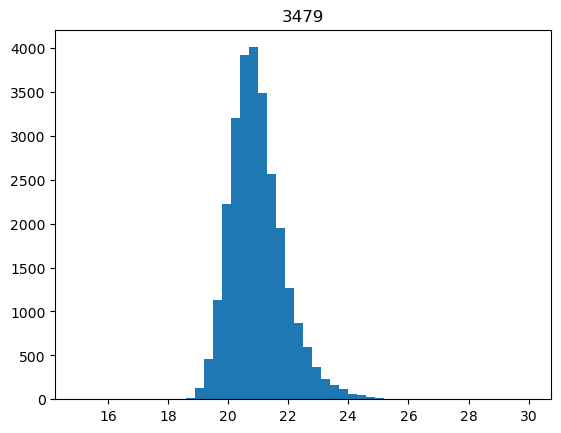

 92%|████████████████████████████████████████████████████████████████████████▍      | 986/1075 [02:11<00:12,  6.97it/s]

7714


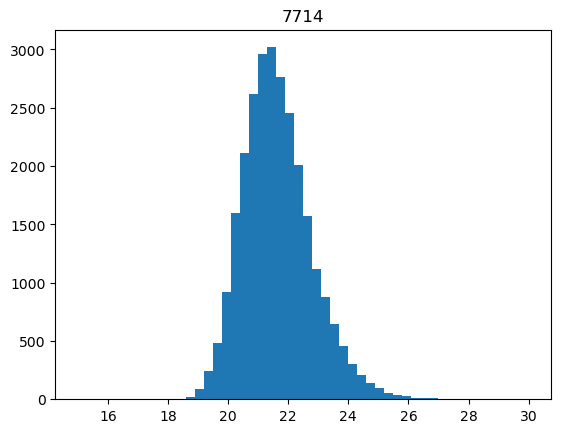

 92%|████████████████████████████████████████████████████████████████████████▌      | 987/1075 [02:12<00:12,  7.30it/s]

10321


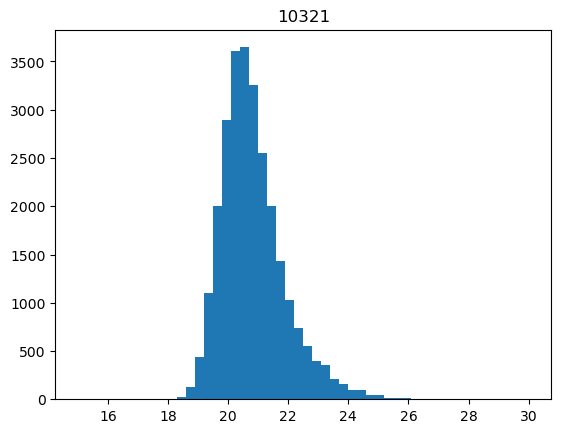

 92%|████████████████████████████████████████████████████████████████████████▌      | 988/1075 [02:12<00:11,  7.48it/s]

10986


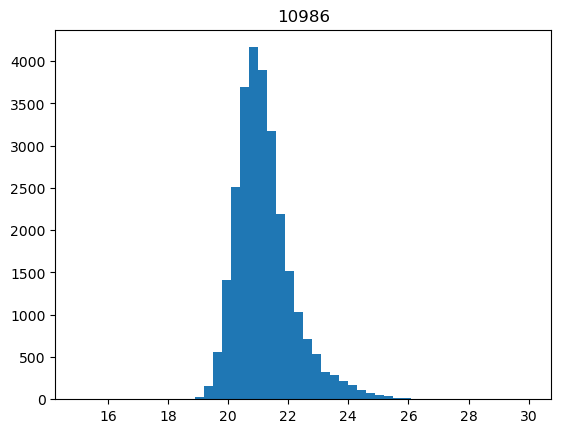

 92%|████████████████████████████████████████████████████████████████████████▋      | 989/1075 [02:12<00:11,  7.56it/s]

8324


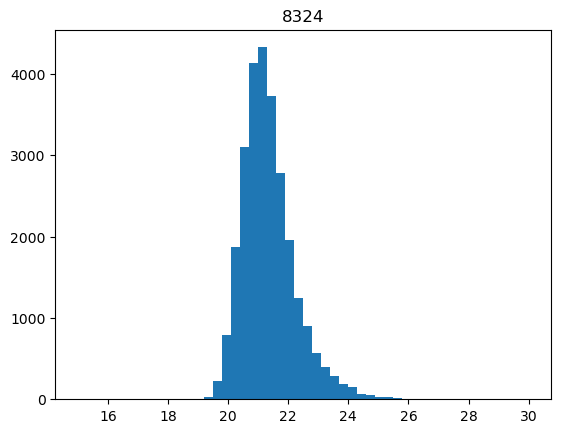

 92%|████████████████████████████████████████████████████████████████████████▊      | 990/1075 [02:12<00:10,  7.74it/s]

18563


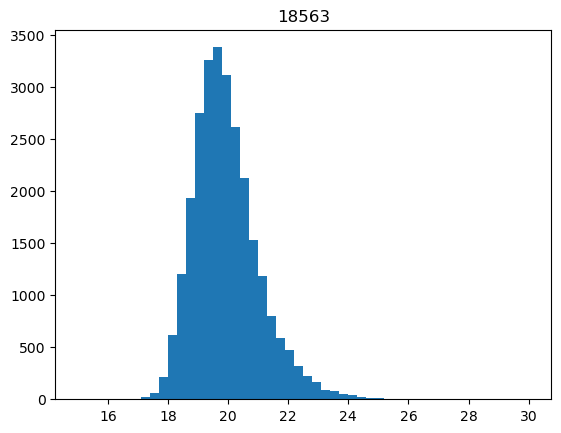

 92%|████████████████████████████████████████████████████████████████████████▊      | 991/1075 [02:12<00:10,  7.76it/s]

15350


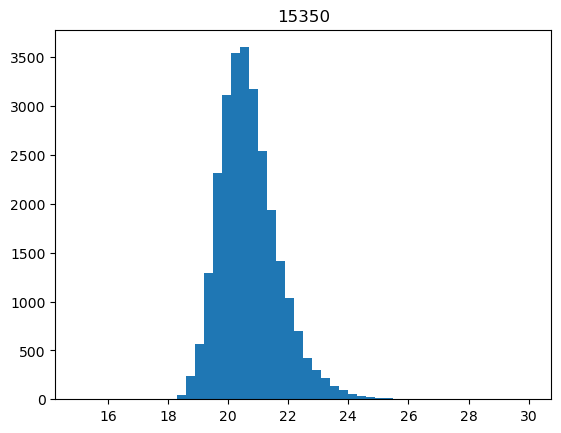

 92%|████████████████████████████████████████████████████████████████████████▉      | 992/1075 [02:12<00:10,  7.79it/s]

7879


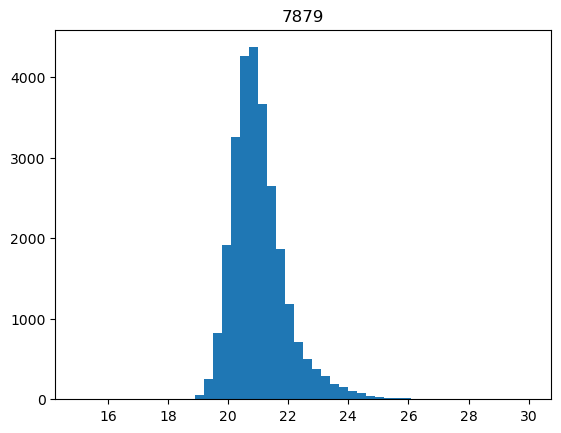

 92%|████████████████████████████████████████████████████████████████████████▉      | 993/1075 [02:12<00:10,  7.91it/s]

20870


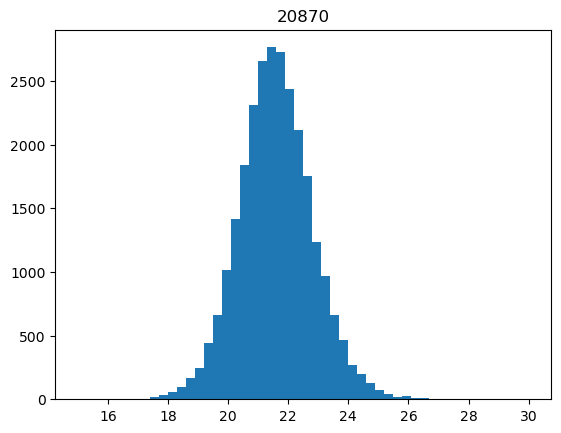

 92%|█████████████████████████████████████████████████████████████████████████      | 994/1075 [02:12<00:10,  7.97it/s]

21414


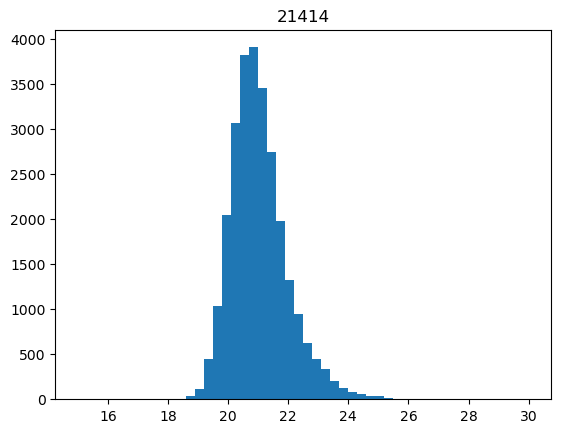

 93%|█████████████████████████████████████████████████████████████████████████      | 995/1075 [02:13<00:10,  7.96it/s]

12501


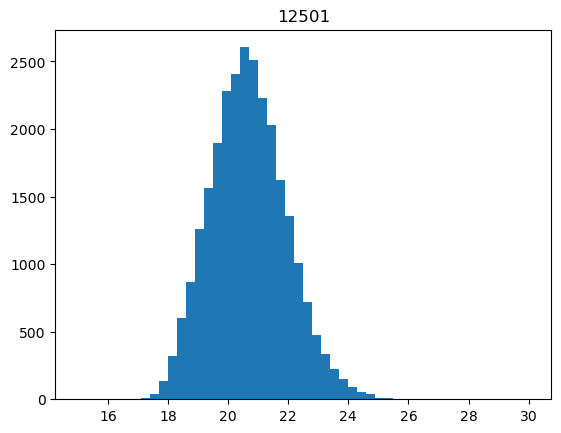

 93%|█████████████████████████████████████████████████████████████████████████▏     | 996/1075 [02:13<00:11,  6.68it/s]

2695


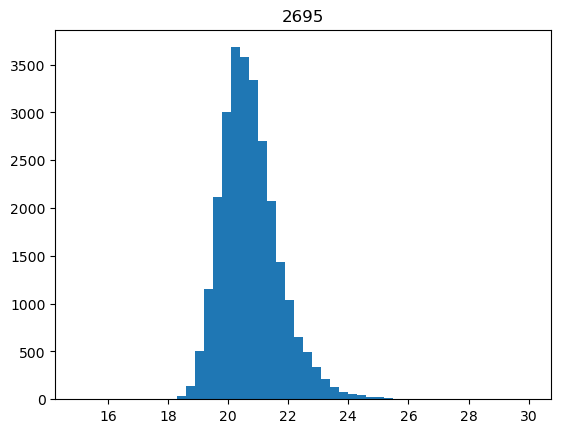

 93%|█████████████████████████████████████████████████████████████████████████▎     | 997/1075 [02:13<00:11,  7.00it/s]

11132


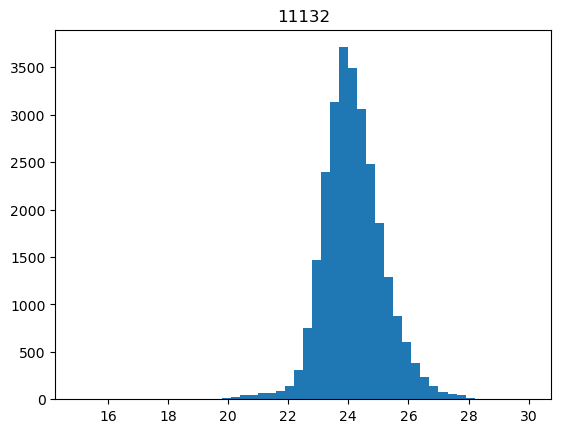

 93%|█████████████████████████████████████████████████████████████████████████▎     | 998/1075 [02:13<00:10,  7.24it/s]

13308


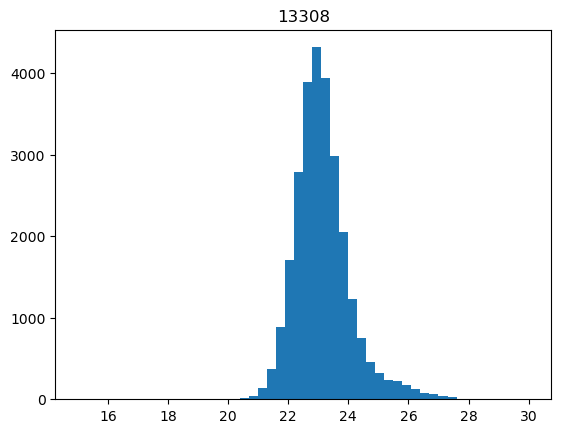

 93%|█████████████████████████████████████████████████████████████████████████▍     | 999/1075 [02:13<00:10,  7.53it/s]

8843


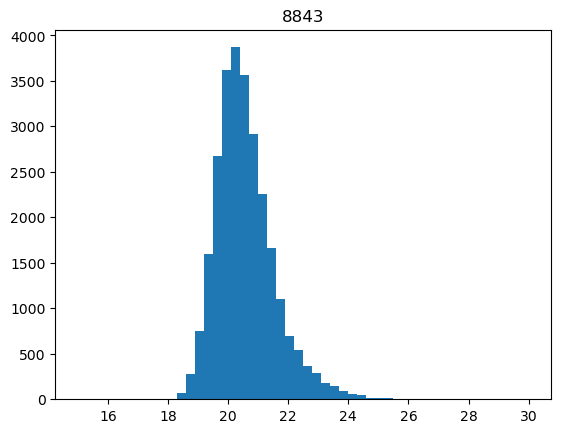

 93%|████████████████████████████████████████████████████████████████████████▌     | 1000/1075 [02:13<00:09,  7.58it/s]

23983


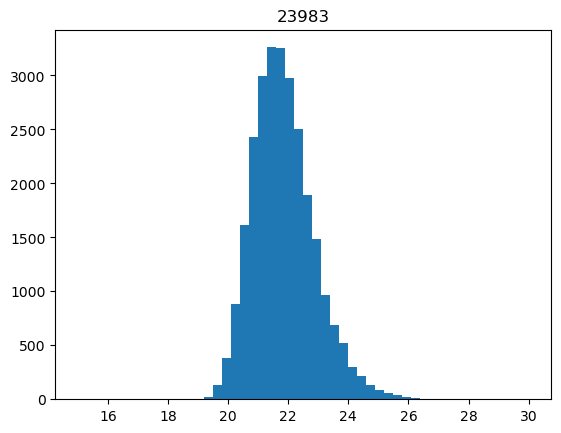

 93%|████████████████████████████████████████████████████████████████████████▋     | 1001/1075 [02:13<00:09,  7.70it/s]

26548


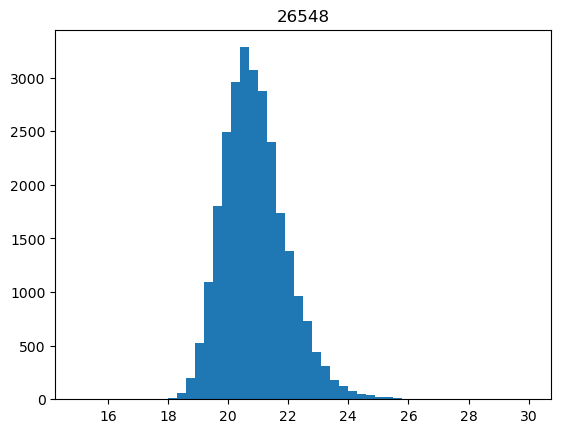

 93%|████████████████████████████████████████████████████████████████████████▋     | 1002/1075 [02:13<00:09,  7.81it/s]

776


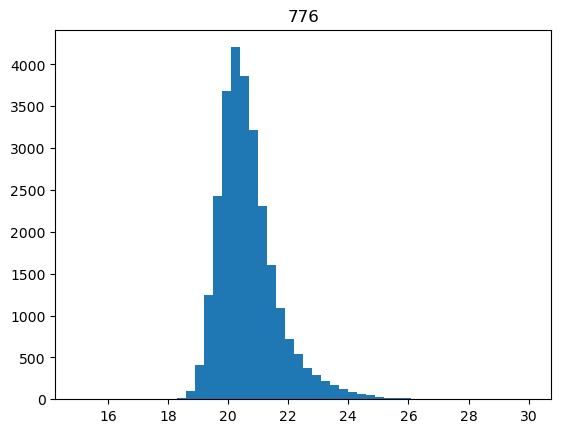

 93%|████████████████████████████████████████████████████████████████████████▊     | 1003/1075 [02:14<00:09,  7.81it/s]

6254


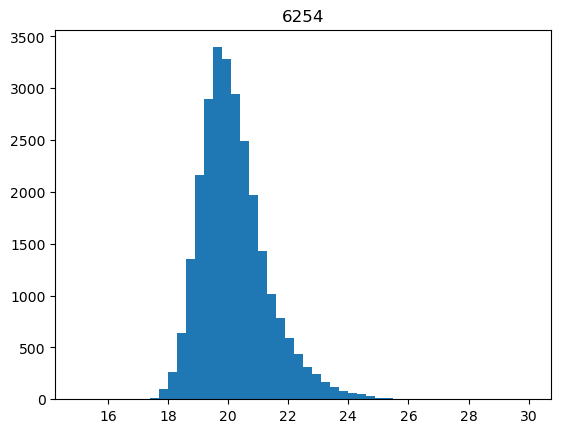

 93%|████████████████████████████████████████████████████████████████████████▊     | 1004/1075 [02:14<00:09,  7.85it/s]

3956


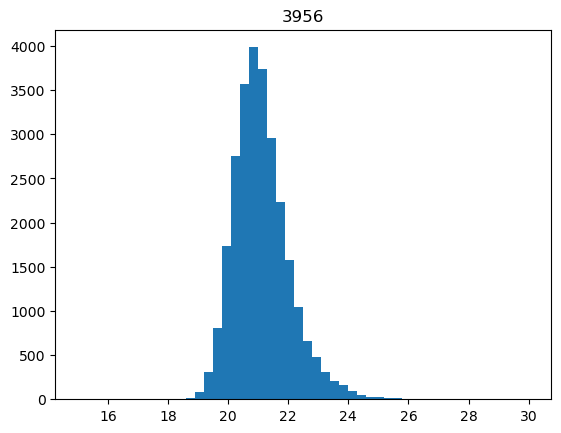

 93%|████████████████████████████████████████████████████████████████████████▉     | 1005/1075 [02:14<00:08,  7.83it/s]

3190


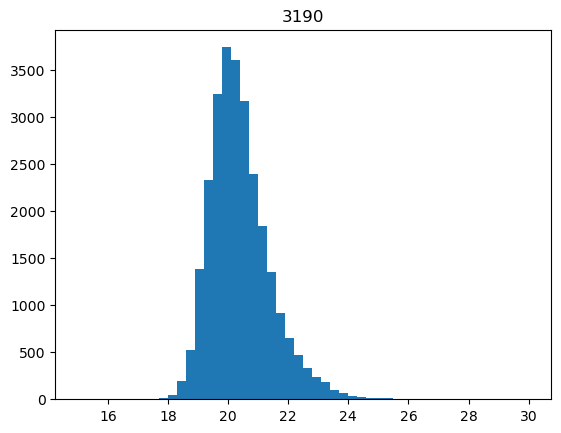

 94%|████████████████████████████████████████████████████████████████████████▉     | 1006/1075 [02:14<00:08,  7.83it/s]

11128


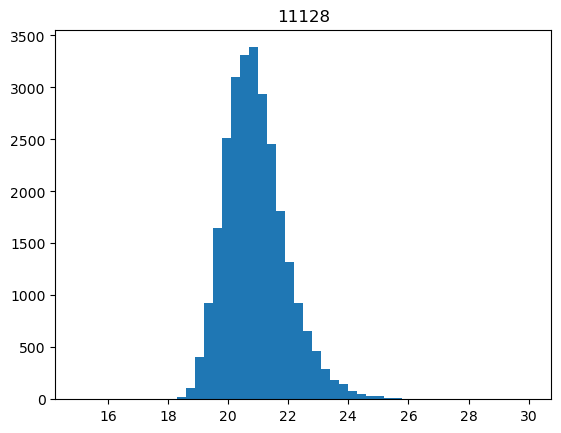

 94%|█████████████████████████████████████████████████████████████████████████     | 1007/1075 [02:14<00:10,  6.57it/s]

4293


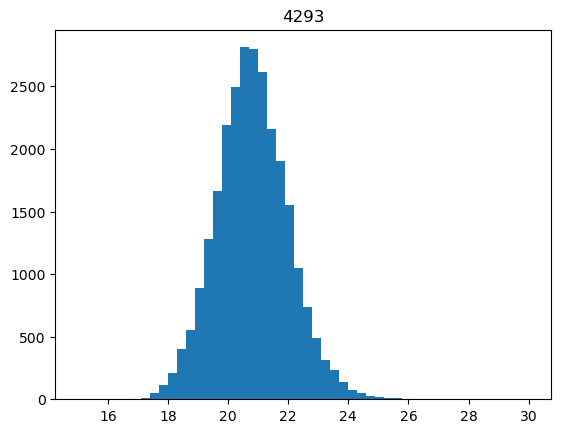

 94%|█████████████████████████████████████████████████████████████████████████▏    | 1008/1075 [02:14<00:09,  6.99it/s]

3946


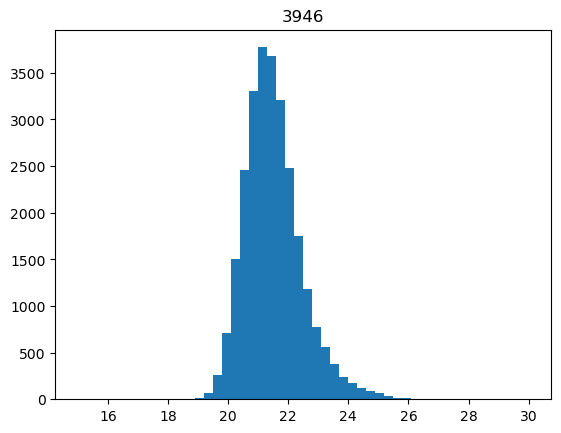

 94%|█████████████████████████████████████████████████████████████████████████▏    | 1009/1075 [02:14<00:09,  7.25it/s]

9841


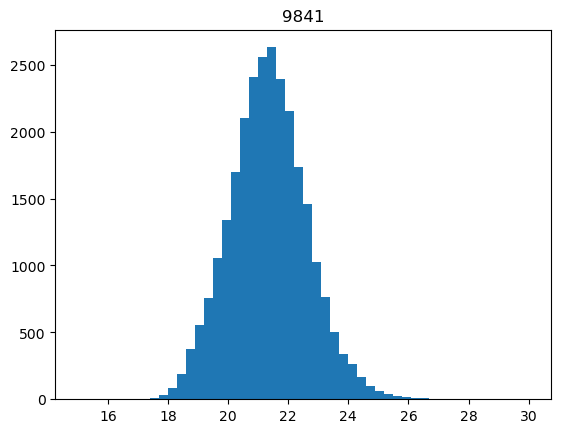

 94%|█████████████████████████████████████████████████████████████████████████▎    | 1010/1075 [02:15<00:08,  7.51it/s]

19784


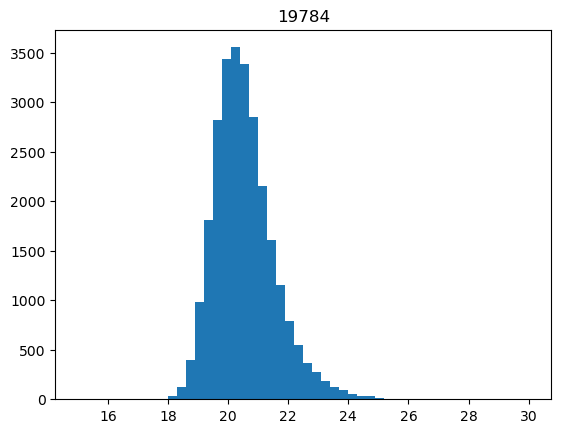

 94%|█████████████████████████████████████████████████████████████████████████▎    | 1011/1075 [02:15<00:08,  7.60it/s]

9371


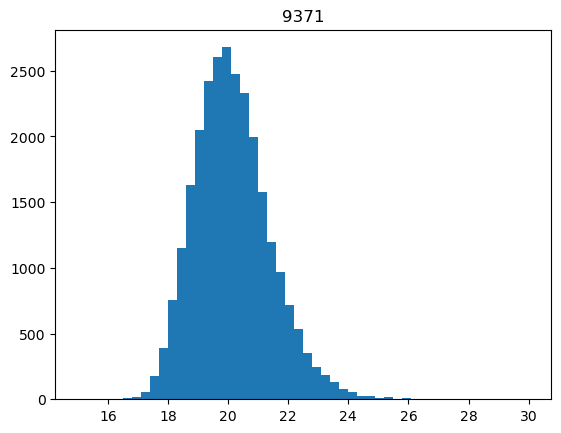

 94%|█████████████████████████████████████████████████████████████████████████▍    | 1012/1075 [02:15<00:08,  7.75it/s]

21035


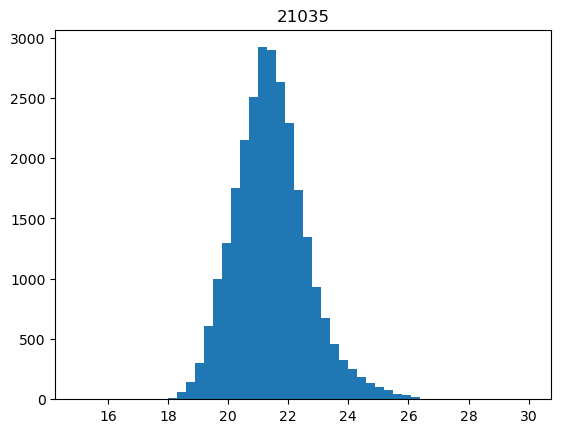

 94%|█████████████████████████████████████████████████████████████████████████▌    | 1013/1075 [02:15<00:07,  7.82it/s]

16589


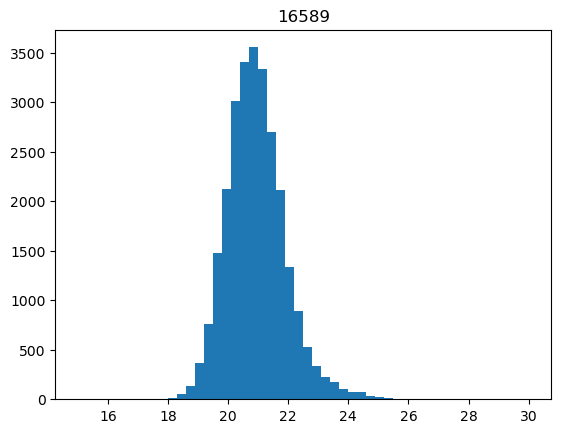

 94%|█████████████████████████████████████████████████████████████████████████▌    | 1014/1075 [02:15<00:07,  7.84it/s]

2654


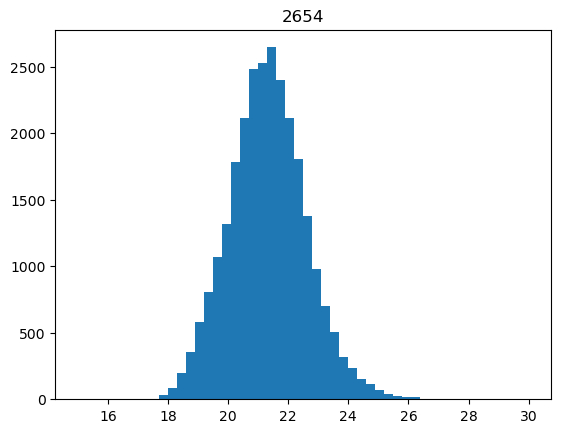

 94%|█████████████████████████████████████████████████████████████████████████▋    | 1015/1075 [02:15<00:07,  7.88it/s]

5317


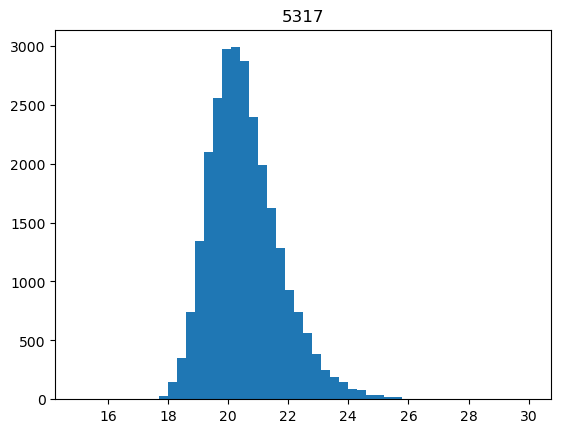

 95%|█████████████████████████████████████████████████████████████████████████▋    | 1016/1075 [02:15<00:07,  7.98it/s]

9782


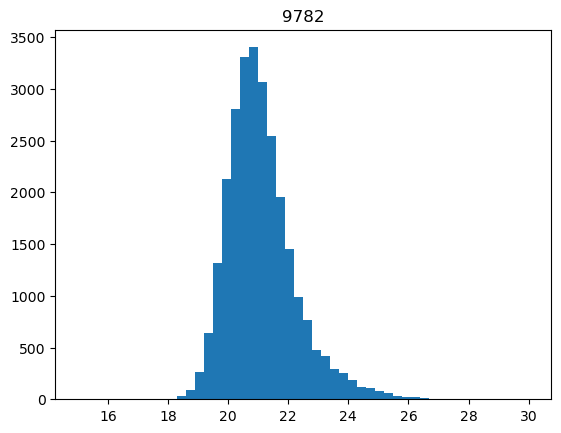

 95%|█████████████████████████████████████████████████████████████████████████▊    | 1017/1075 [02:15<00:07,  7.94it/s]

5224


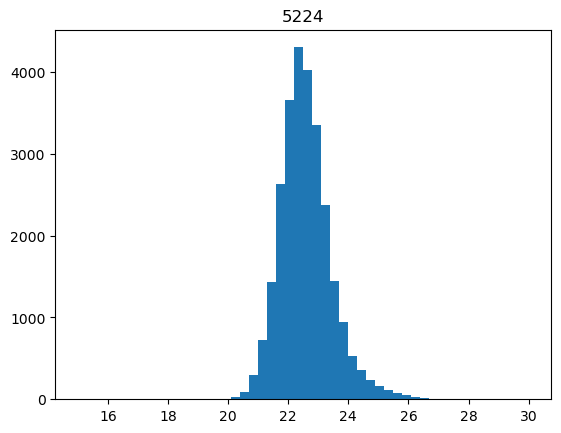

 95%|█████████████████████████████████████████████████████████████████████████▊    | 1018/1075 [02:16<00:08,  6.74it/s]

439


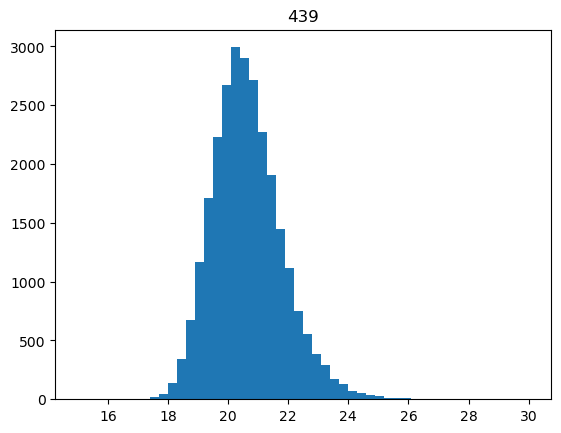

 95%|█████████████████████████████████████████████████████████████████████████▉    | 1019/1075 [02:16<00:07,  7.10it/s]

5371


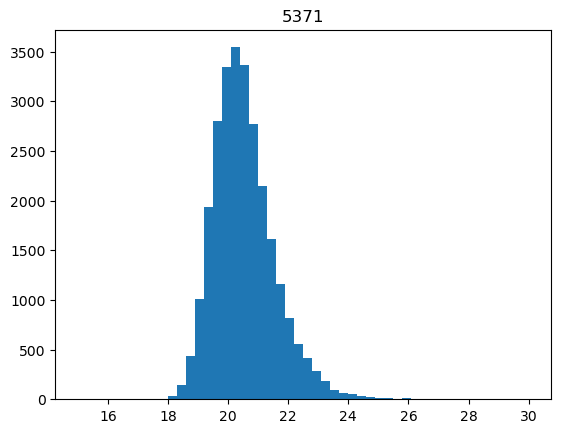

 95%|██████████████████████████████████████████████████████████████████████████    | 1020/1075 [02:16<00:07,  7.33it/s]

2806


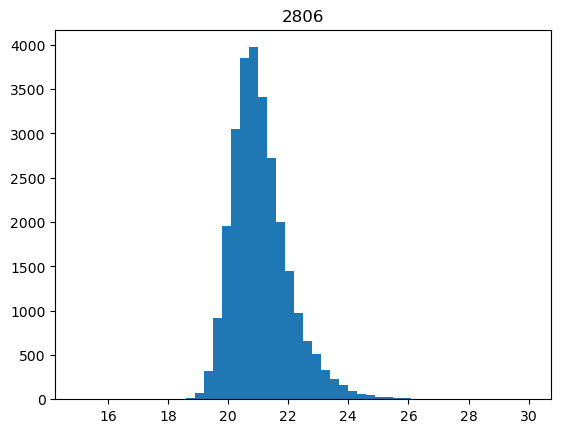

 95%|██████████████████████████████████████████████████████████████████████████    | 1021/1075 [02:16<00:07,  7.49it/s]

4506


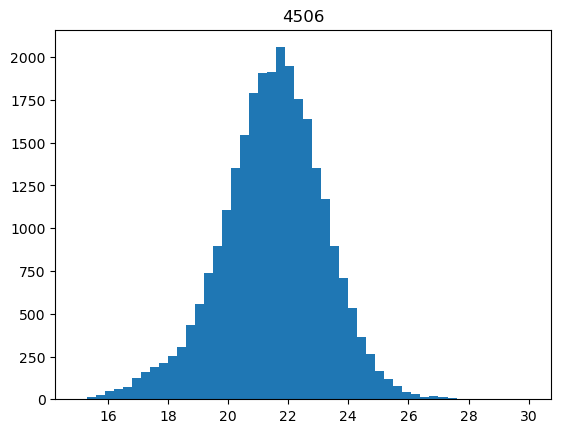

 95%|██████████████████████████████████████████████████████████████████████████▏   | 1022/1075 [02:16<00:06,  7.60it/s]

7549


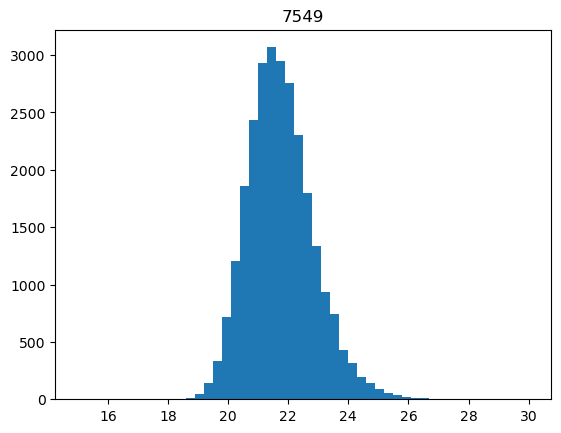

 95%|██████████████████████████████████████████████████████████████████████████▏   | 1023/1075 [02:16<00:06,  7.70it/s]

9276


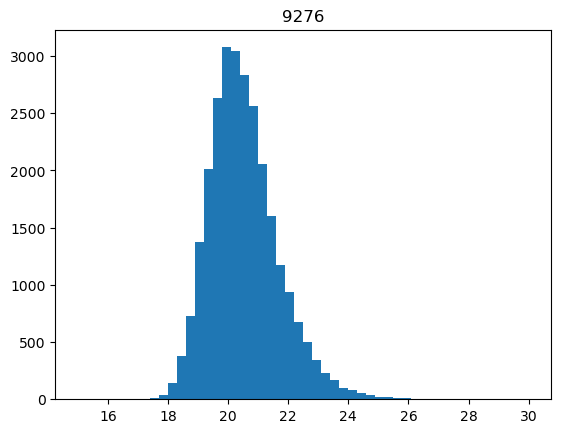

 95%|██████████████████████████████████████████████████████████████████████████▎   | 1024/1075 [02:16<00:06,  7.80it/s]

2088


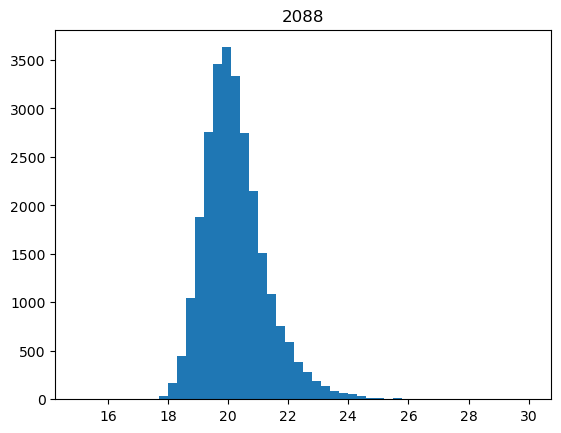

 95%|██████████████████████████████████████████████████████████████████████████▎   | 1025/1075 [02:17<00:06,  7.84it/s]

9534


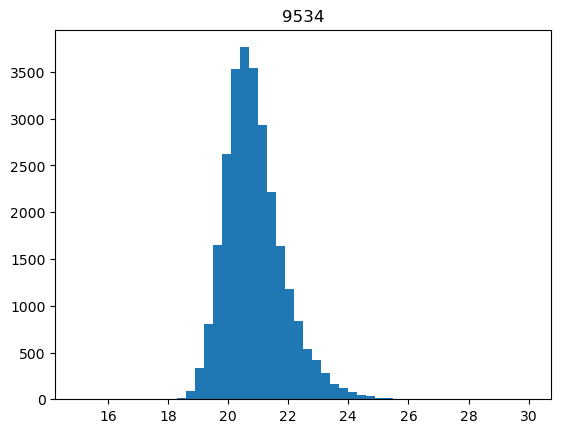

 95%|██████████████████████████████████████████████████████████████████████████▍   | 1026/1075 [02:17<00:06,  7.87it/s]

23278


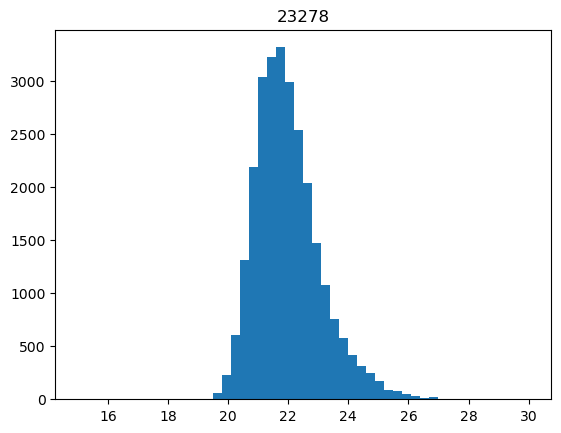

 96%|██████████████████████████████████████████████████████████████████████████▌   | 1027/1075 [02:17<00:06,  7.91it/s]

26046


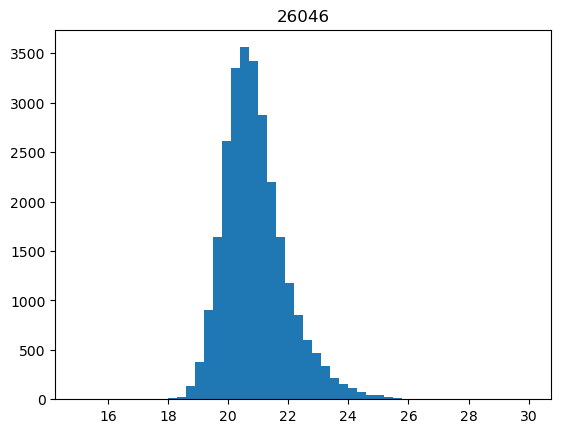

 96%|██████████████████████████████████████████████████████████████████████████▌   | 1028/1075 [02:17<00:05,  7.88it/s]

730


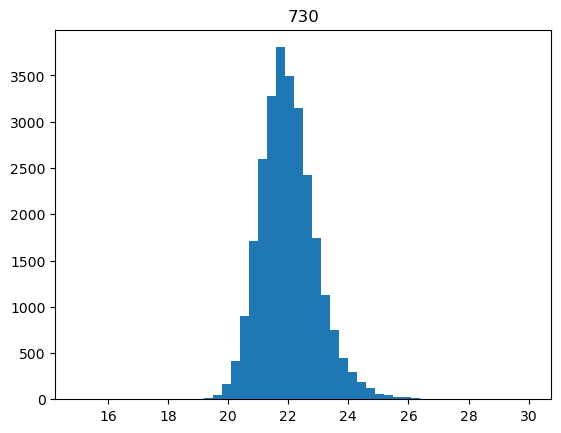

 96%|██████████████████████████████████████████████████████████████████████████▋   | 1029/1075 [02:17<00:06,  6.58it/s]

10819


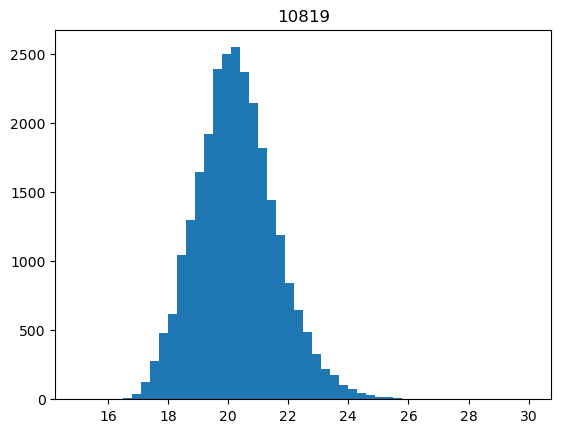

 96%|██████████████████████████████████████████████████████████████████████████▋   | 1030/1075 [02:17<00:06,  6.98it/s]

192


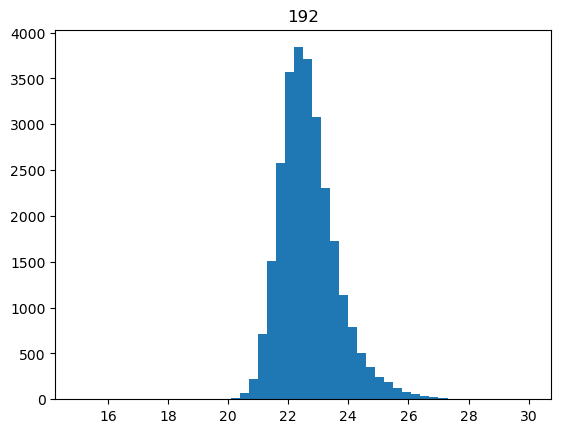

 96%|██████████████████████████████████████████████████████████████████████████▊   | 1031/1075 [02:17<00:06,  7.21it/s]

6694


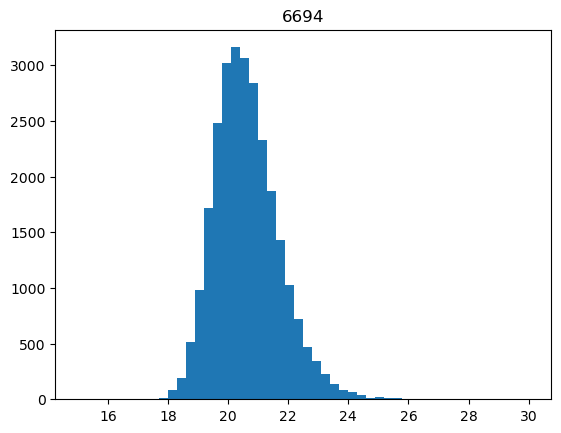

 96%|██████████████████████████████████████████████████████████████████████████▉   | 1032/1075 [02:17<00:05,  7.43it/s]

19481


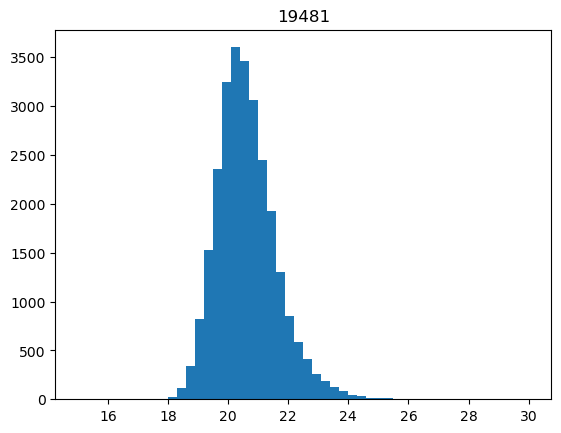

 96%|██████████████████████████████████████████████████████████████████████████▉   | 1033/1075 [02:18<00:05,  7.49it/s]

14753


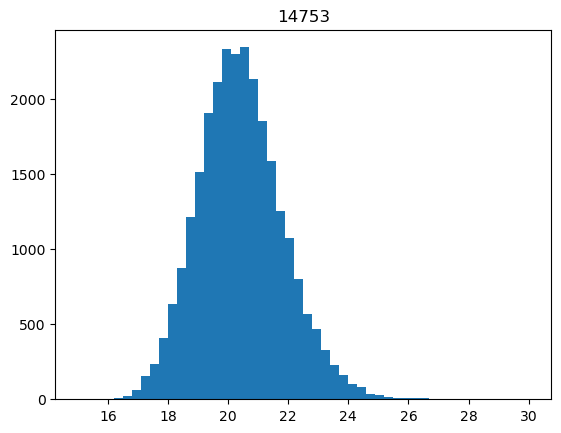

 96%|███████████████████████████████████████████████████████████████████████████   | 1034/1075 [02:18<00:05,  7.64it/s]

398


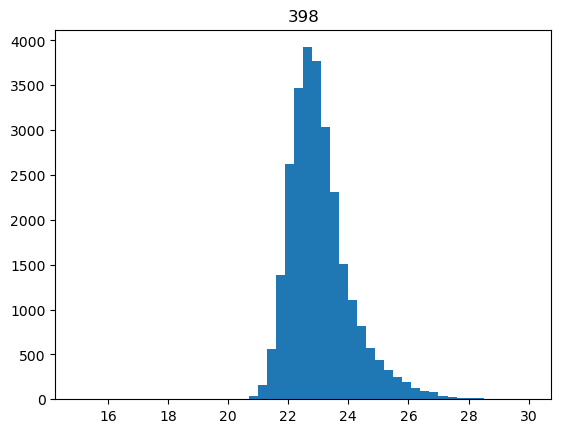

 96%|███████████████████████████████████████████████████████████████████████████   | 1035/1075 [02:18<00:05,  7.63it/s]

15984


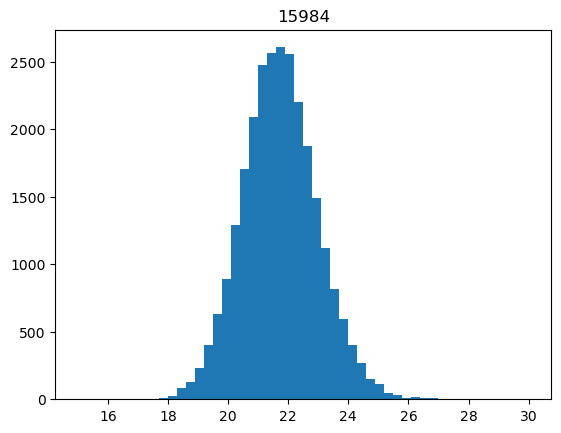

 96%|███████████████████████████████████████████████████████████████████████████▏  | 1036/1075 [02:18<00:05,  7.78it/s]

12822


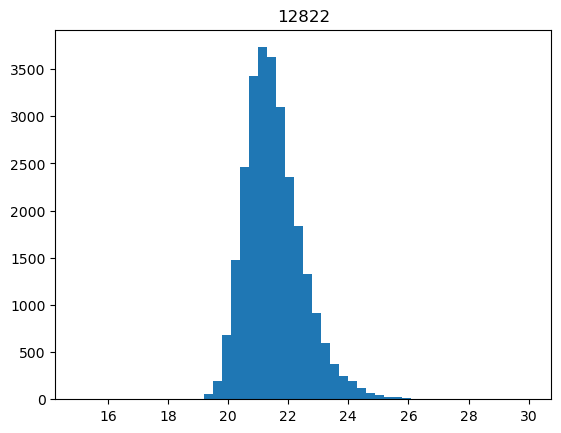

 96%|███████████████████████████████████████████████████████████████████████████▏  | 1037/1075 [02:18<00:04,  7.77it/s]

16510


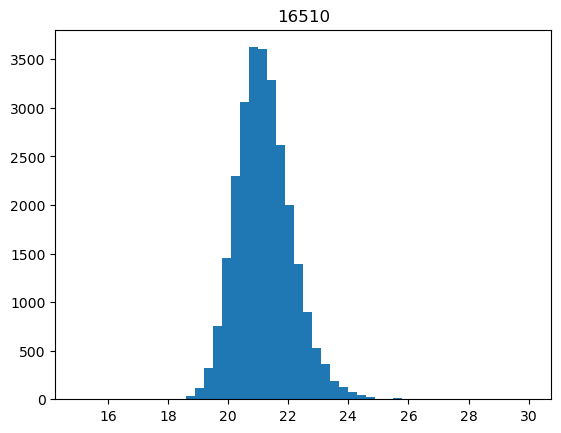

 97%|███████████████████████████████████████████████████████████████████████████▎  | 1038/1075 [02:18<00:04,  7.74it/s]

7506


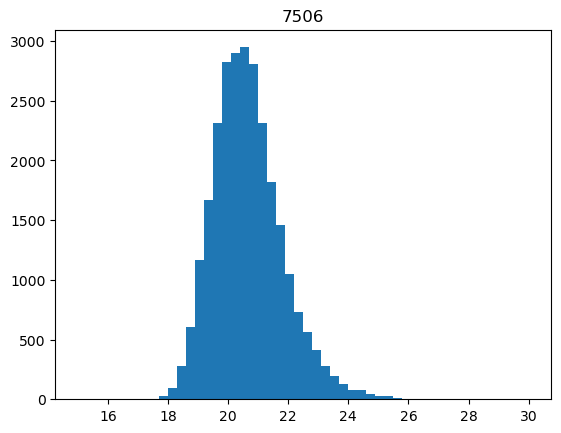

 97%|███████████████████████████████████████████████████████████████████████████▍  | 1039/1075 [02:18<00:04,  7.82it/s]

21654


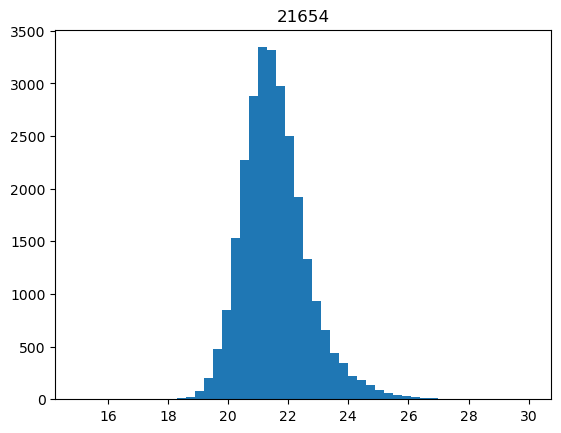

 97%|███████████████████████████████████████████████████████████████████████████▍  | 1040/1075 [02:19<00:05,  6.57it/s]

26686


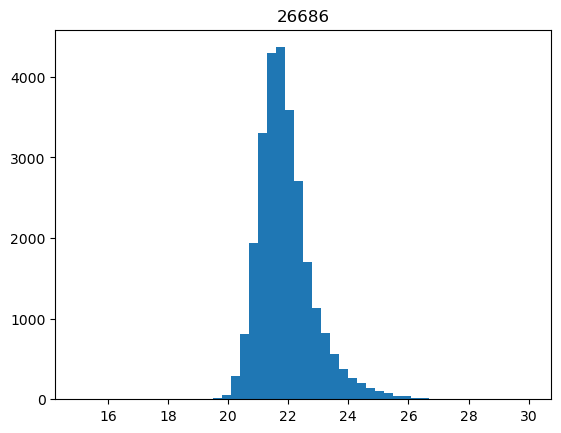

 97%|███████████████████████████████████████████████████████████████████████████▌  | 1041/1075 [02:19<00:04,  6.97it/s]

545


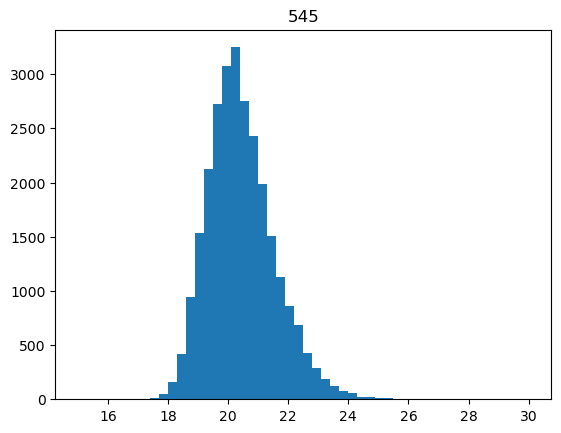

 97%|███████████████████████████████████████████████████████████████████████████▌  | 1042/1075 [02:19<00:04,  7.25it/s]

3636


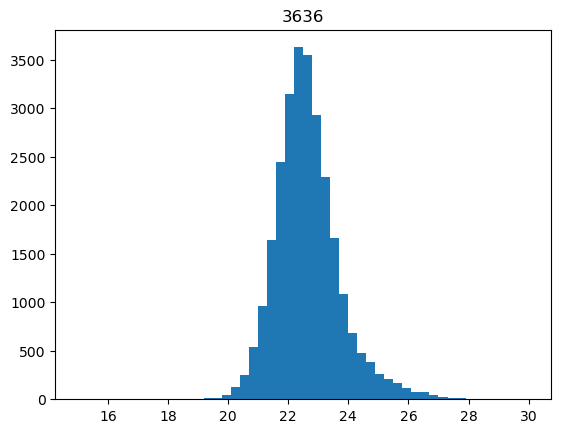

 97%|███████████████████████████████████████████████████████████████████████████▋  | 1043/1075 [02:19<00:04,  7.44it/s]

5702


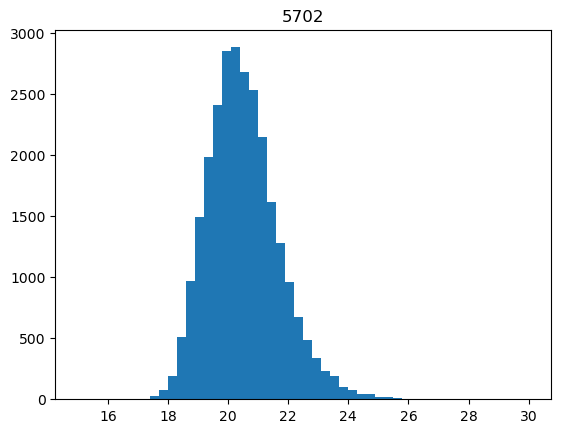

 97%|███████████████████████████████████████████████████████████████████████████▊  | 1044/1075 [02:19<00:04,  7.64it/s]

22145


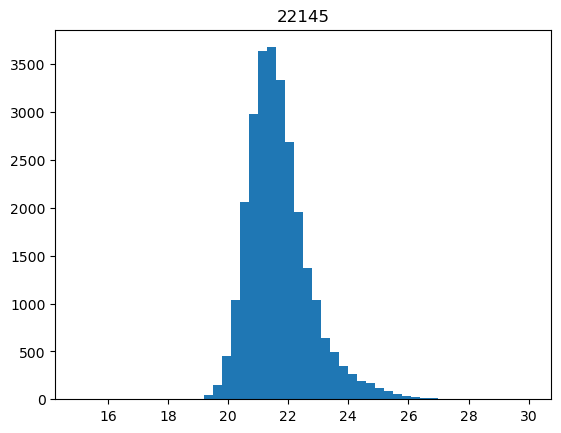

 97%|███████████████████████████████████████████████████████████████████████████▊  | 1045/1075 [02:19<00:03,  7.65it/s]

18303


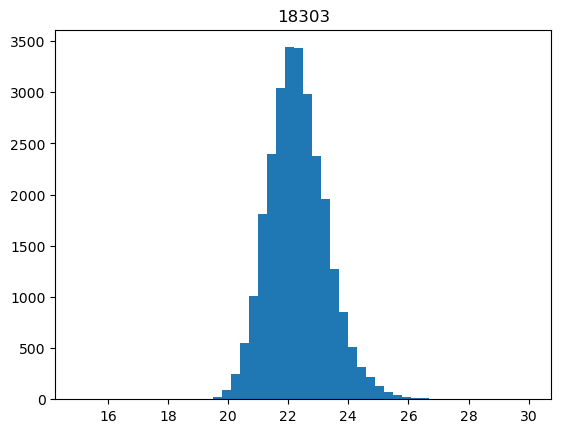

 97%|███████████████████████████████████████████████████████████████████████████▉  | 1046/1075 [02:19<00:03,  7.73it/s]

23955


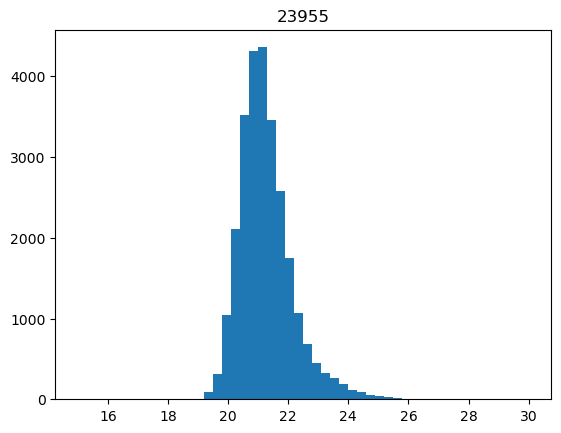

 97%|███████████████████████████████████████████████████████████████████████████▉  | 1047/1075 [02:19<00:03,  7.85it/s]

11309


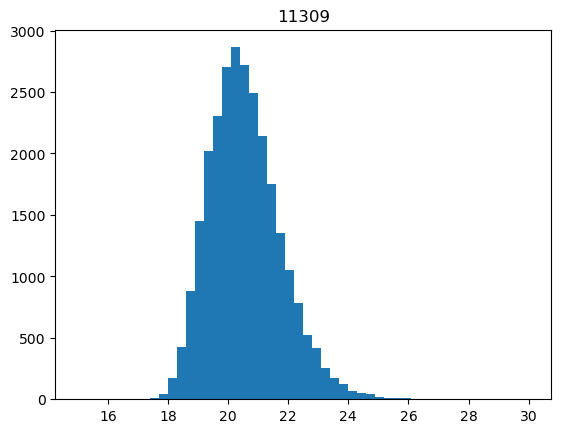

 97%|████████████████████████████████████████████████████████████████████████████  | 1048/1075 [02:20<00:03,  7.86it/s]

4475


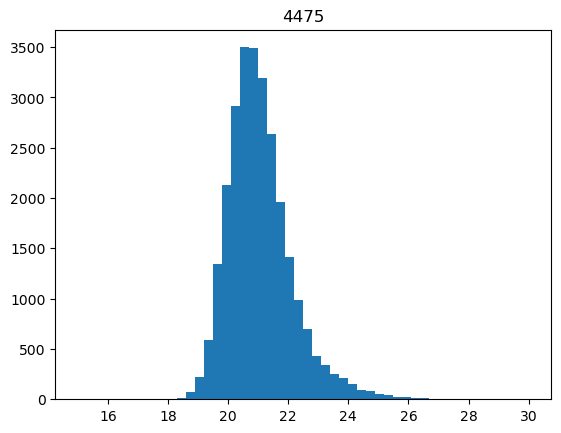

 98%|████████████████████████████████████████████████████████████████████████████  | 1049/1075 [02:20<00:03,  7.86it/s]

26265


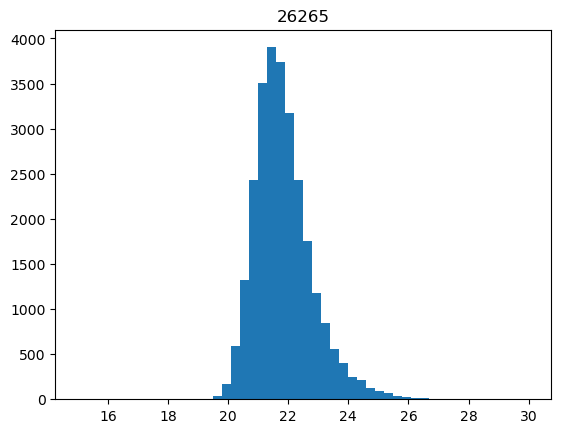

 98%|████████████████████████████████████████████████████████████████████████████▏ | 1050/1075 [02:20<00:03,  7.77it/s]

11200


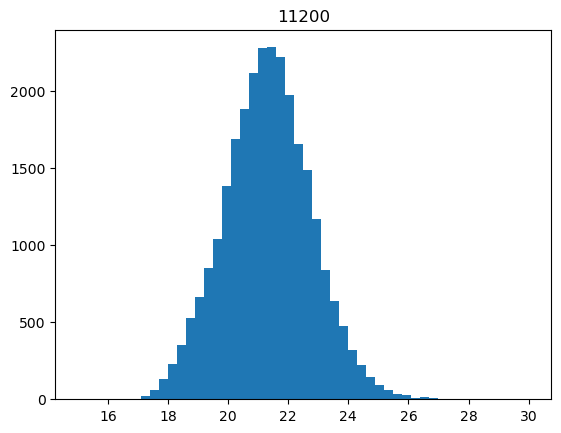

 98%|████████████████████████████████████████████████████████████████████████████▎ | 1051/1075 [02:20<00:03,  6.61it/s]

1263


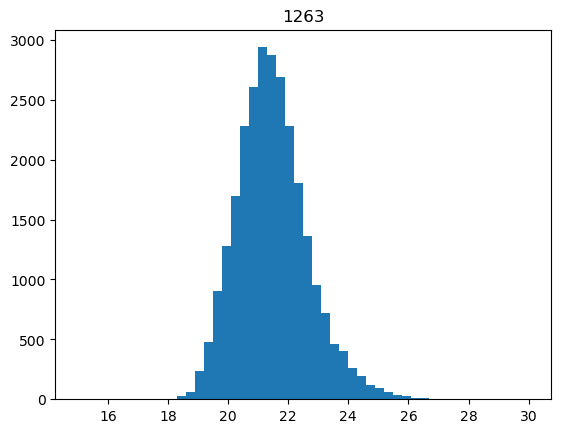

 98%|████████████████████████████████████████████████████████████████████████████▎ | 1052/1075 [02:20<00:03,  6.99it/s]

23686


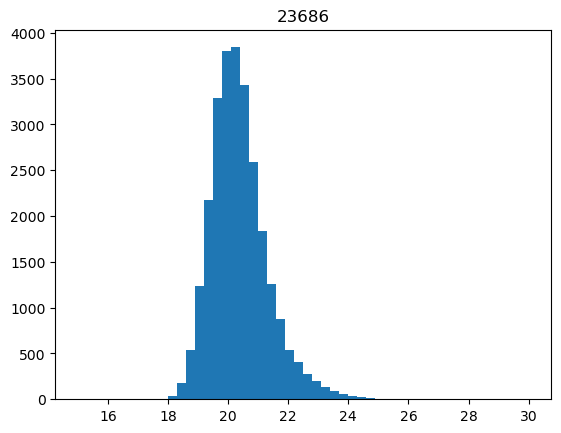

 98%|████████████████████████████████████████████████████████████████████████████▍ | 1053/1075 [02:20<00:03,  7.20it/s]

5716


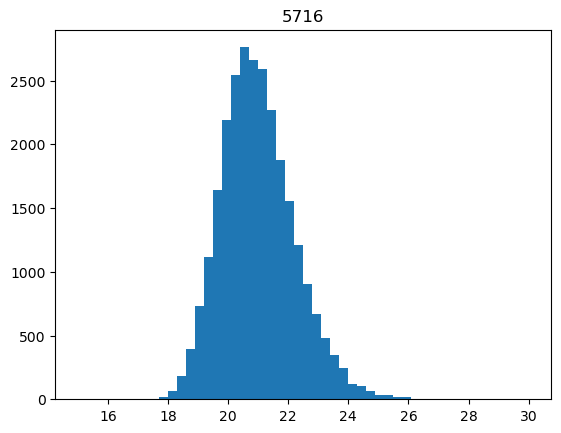

 98%|████████████████████████████████████████████████████████████████████████████▍ | 1054/1075 [02:20<00:02,  7.41it/s]

12610


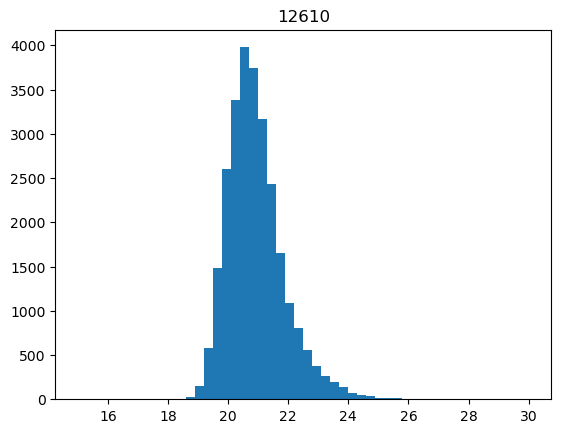

 98%|████████████████████████████████████████████████████████████████████████████▌ | 1055/1075 [02:21<00:02,  7.49it/s]

16501


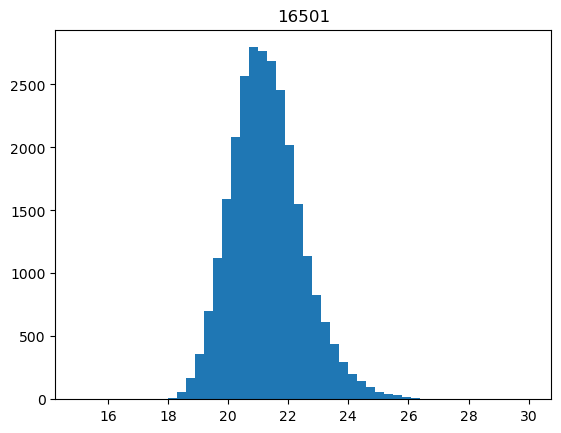

 98%|████████████████████████████████████████████████████████████████████████████▌ | 1056/1075 [02:21<00:02,  7.65it/s]

18115


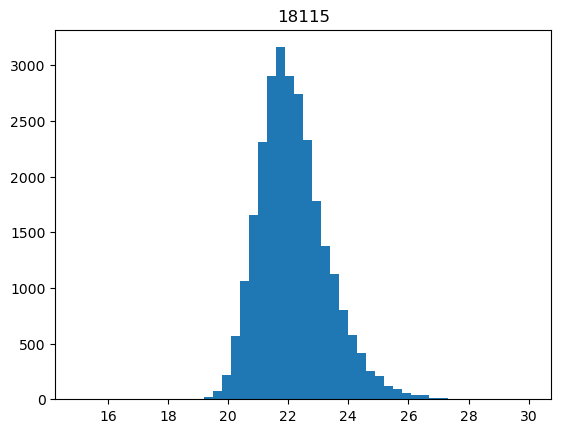

 98%|████████████████████████████████████████████████████████████████████████████▋ | 1057/1075 [02:21<00:02,  7.70it/s]

15927


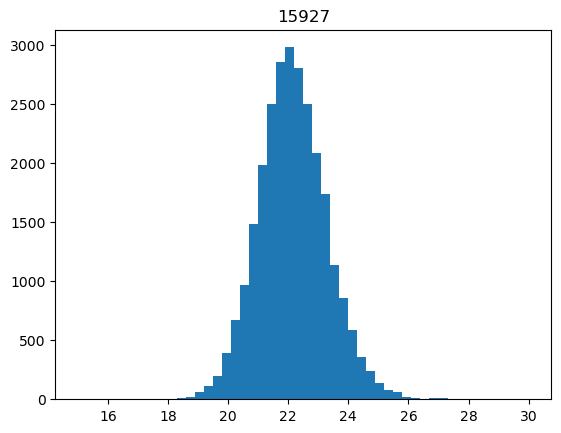

 98%|████████████████████████████████████████████████████████████████████████████▊ | 1058/1075 [02:21<00:02,  7.77it/s]

9779


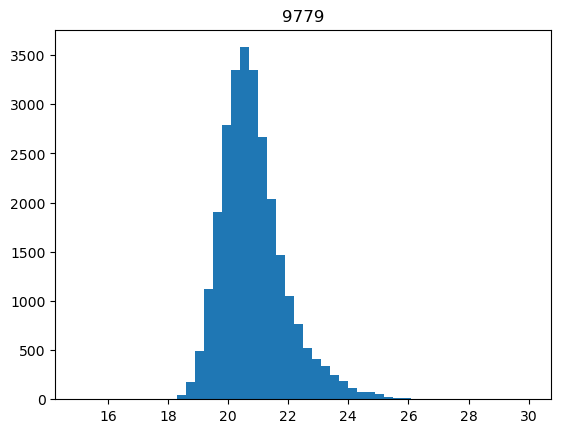

 99%|████████████████████████████████████████████████████████████████████████████▊ | 1059/1075 [02:21<00:02,  7.82it/s]

7892


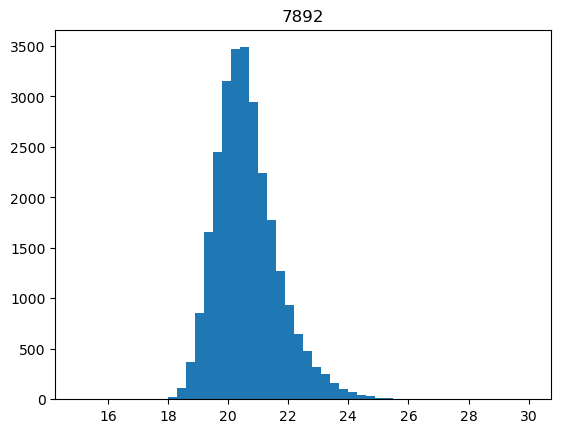

 99%|████████████████████████████████████████████████████████████████████████████▉ | 1060/1075 [02:21<00:01,  7.83it/s]

887


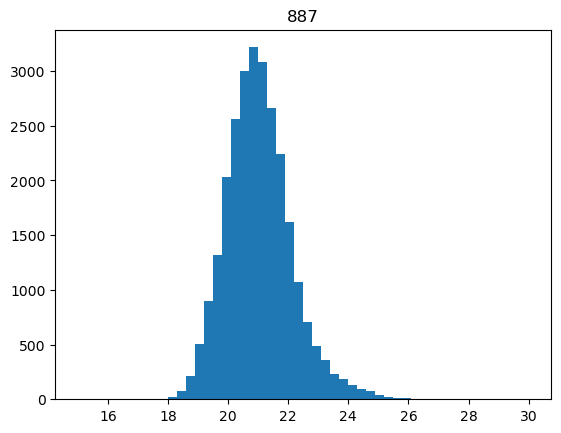

 99%|████████████████████████████████████████████████████████████████████████████▉ | 1061/1075 [02:21<00:01,  7.88it/s]

21304


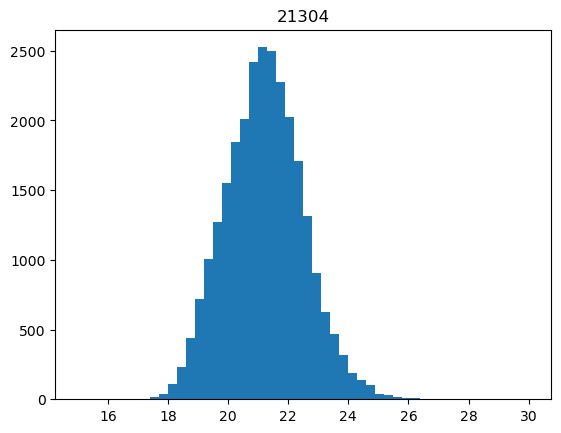

 99%|█████████████████████████████████████████████████████████████████████████████ | 1062/1075 [02:22<00:01,  6.67it/s]

1103


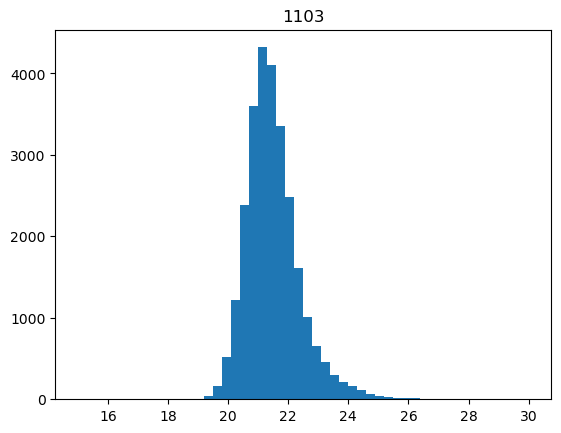

 99%|█████████████████████████████████████████████████████████████████████████████▏| 1063/1075 [02:22<00:01,  7.14it/s]

10847


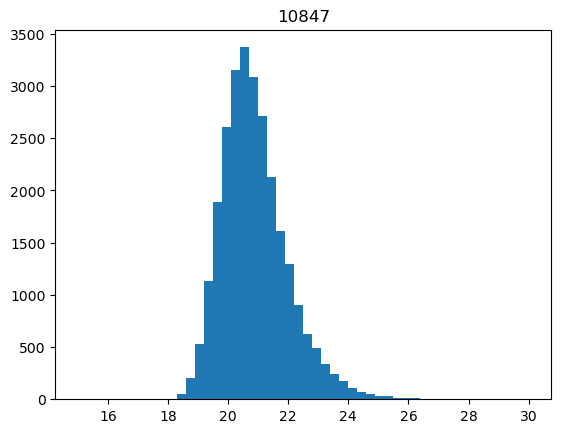

 99%|█████████████████████████████████████████████████████████████████████████████▏| 1064/1075 [02:22<00:01,  7.36it/s]

3701


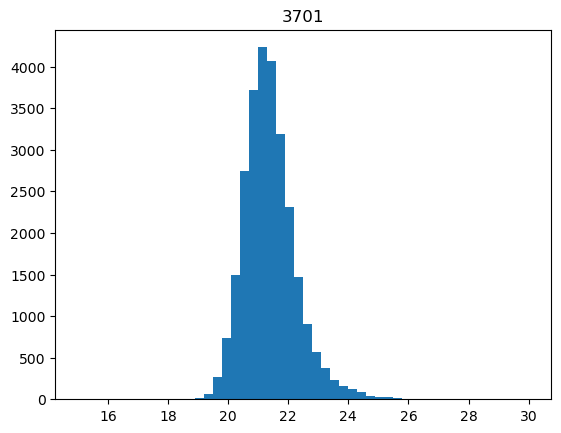

 99%|█████████████████████████████████████████████████████████████████████████████▎| 1065/1075 [02:22<00:01,  7.47it/s]

5705


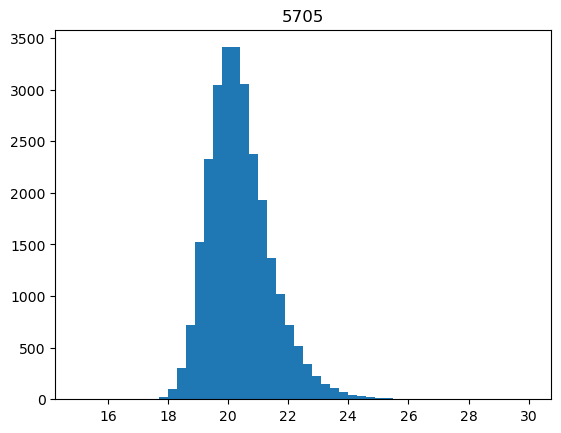

 99%|█████████████████████████████████████████████████████████████████████████████▎| 1066/1075 [02:22<00:01,  7.55it/s]

24650


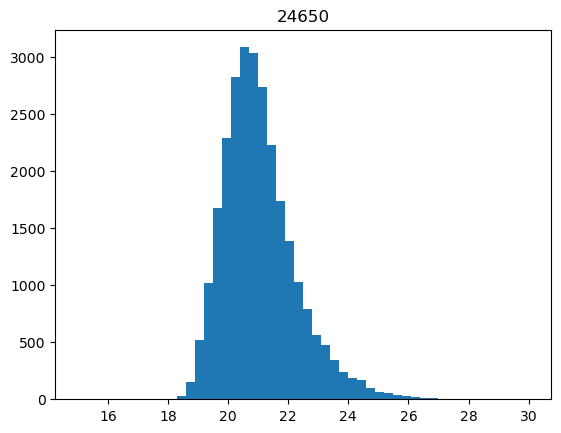

 99%|█████████████████████████████████████████████████████████████████████████████▍| 1067/1075 [02:22<00:01,  7.70it/s]

6067


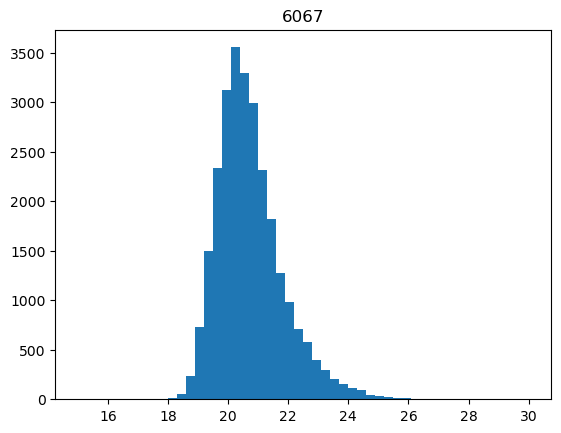

 99%|█████████████████████████████████████████████████████████████████████████████▍| 1068/1075 [02:22<00:00,  7.77it/s]

26034


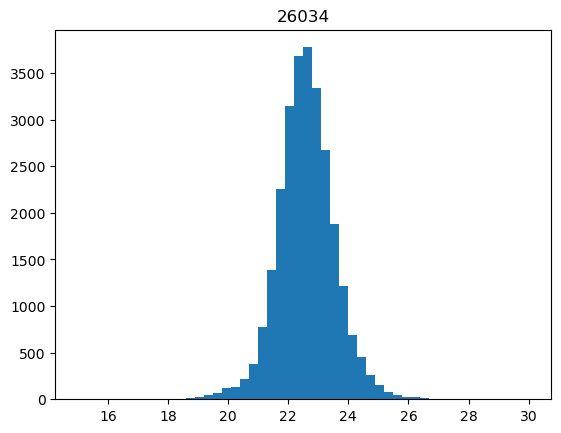

 99%|█████████████████████████████████████████████████████████████████████████████▌| 1069/1075 [02:22<00:00,  7.85it/s]

16632


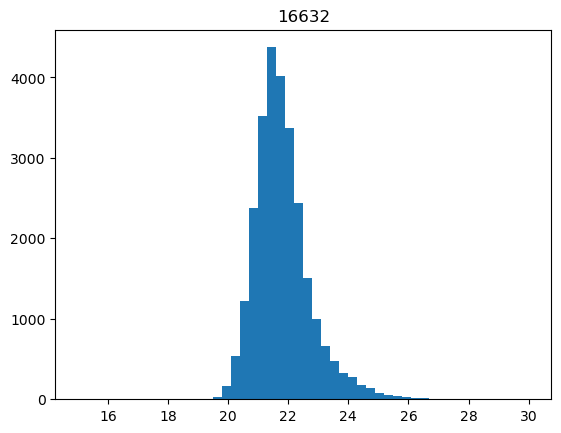

100%|█████████████████████████████████████████████████████████████████████████████▋| 1070/1075 [02:23<00:00,  7.92it/s]

5105


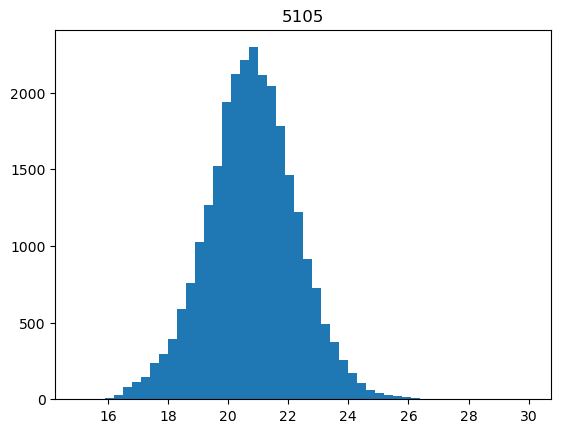

100%|█████████████████████████████████████████████████████████████████████████████▋| 1071/1075 [02:23<00:00,  8.00it/s]

25847


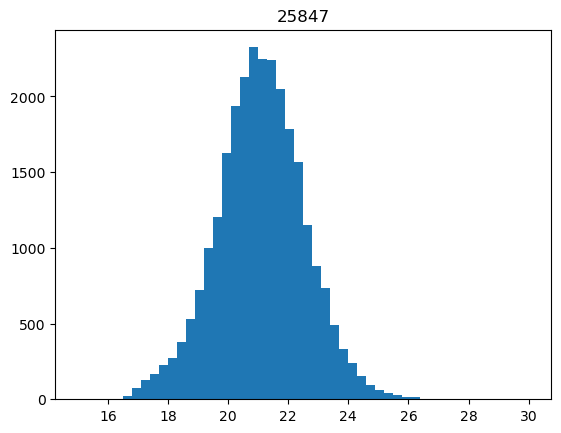

100%|█████████████████████████████████████████████████████████████████████████████▊| 1072/1075 [02:23<00:00,  8.04it/s]

23416


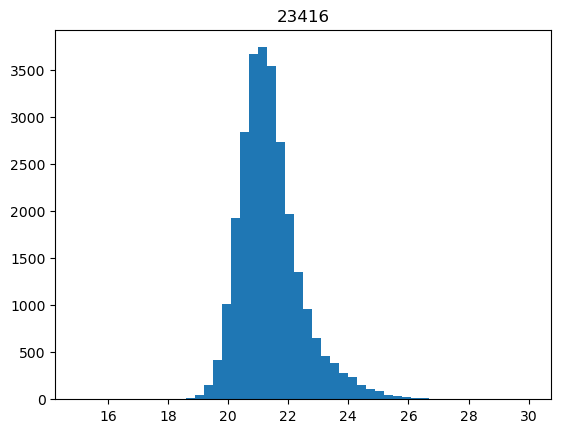

100%|█████████████████████████████████████████████████████████████████████████████▊| 1073/1075 [02:23<00:00,  6.65it/s]

19788


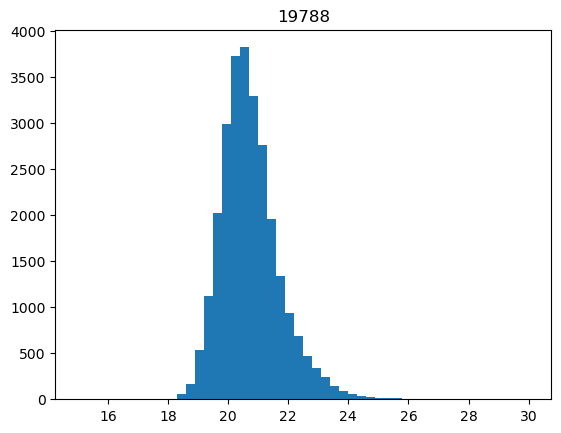

100%|█████████████████████████████████████████████████████████████████████████████▉| 1074/1075 [02:23<00:00,  6.97it/s]

8102


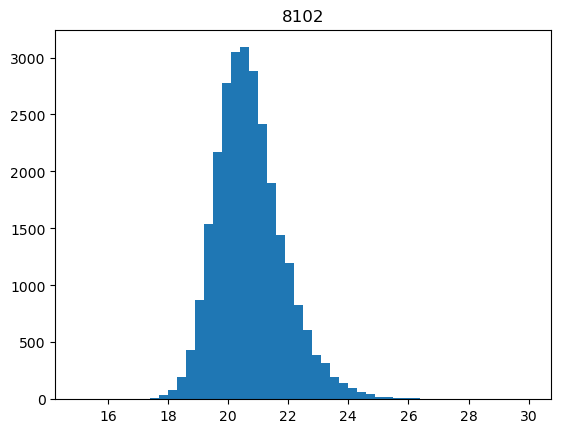

100%|██████████████████████████████████████████████████████████████████████████████| 1075/1075 [02:23<00:00,  7.48it/s]


In [29]:
# to set our radius interval we are looking at histograms of distances 
for i in tqdm(range(len(landmarks))):
    print(landmarks[i])
    center = landmarks[i]
    plt.hist(dist_mat[center,:], bins = 50, range = (15,30))
    plt.title(center)
    plt.show()

In [ ]:
# eigen plots to determine intrinsic dimensionality
for i in tqdm(range(len(landmarks))):
    print(landmarks[i])
    center = landmarks[i]
    radii, eigval_list, eigvec_list = eigen_calc_from_dist_mat(np_data, dist_mat, center, radint = 0.5)

    rmin = radii[0]
    rmax = radii[-1]
    
    eigen_plot(eigval_list, radii, rmin, rmax)

In [ ]:
# visualizing the radius selected for mSVD on the UMAP/FDL
radius = np.array([19.5,20,19,20.5,19])

for i in tqdm(range(len(landmarks))):
    print(landmarks[i])
    center = landmarks[i]
    radii, eigval_list, eigvec_list = eigen_calc_from_dist_mat(np_data, dist_mat, center, radint = 0.5)

    rmin = radii[0]
    rmax = radii[-1]
    
    eigen_plot(eigval_list, radii, rmin, rmax)
      
    landmark_loc = UMAP[center,:]
    radius_UMAP = np.zeros((1,2))
    for j in range(dist_mat.shape[0]):
        if j > center:
            if dist_mat[center,j] < radius[i]:
                radius_UMAP = np.append(radius_UMAP, np.reshape(UMAP[j,:], (1,2)), axis = 0)
    radius_UMAP = radius_UMAP[1:,:]
    
    frame1 = plt.scatter(UMAP[:,0], UMAP[:,1], s=1, c = "lightgrey")
    frame1 = plt.scatter(radius_UMAP[:,0], radius_UMAP[:,1], s=1, c = "dimgrey")
    frame1 = plt.scatter(landmark_loc[0], landmark_loc[1], s=2, c = "red")
    plt.annotate(center, (UMAP_landmark[i,0], UMAP_landmark[i,1]))
    plt.title('Racute - UMAP: '+str(center)+' Radius: '+str(radius[i]))
    #plt.xlim(-30000,25000)
    frame1.axes.get_xaxis().set_ticks([])
    frame1.axes.get_yaxis().set_ticks([])
    plt.ylabel('UMAP2')
    plt.xlabel('UMAP1')
    plt.show()
    
    landmark_loc = Diff[center,:]
    radius_Diff = np.zeros((1,2))
    for j in range(dist_mat.shape[0]):
        if j > center:
            if dist_mat[center,j] < radius[i]:
                radius_Diff = np.append(radius_Diff, np.reshape(Diff[j,:], (1,2)), axis = 0)
    radius_Diff = radius_Diff[1:,:]
    
    frame1 = plt.scatter(Diff[:,0], Diff[:,1], s=1, c = "lightgrey")
    frame1 = plt.scatter(radius_Diff[:,0], radius_Diff[:,1], s=1, c = "dimgrey")
    frame1 = plt.scatter(landmark_loc[0], landmark_loc[1], s=2, c = "red")
    plt.annotate(center, (Diff_landmark[i,0], Diff_landmark[i,1]))
    plt.title('Racute - Diff: '+str(center)+' Radius: '+str(radius[i]))
    #plt.xlim(-30000,25000)
    frame1.axes.get_xaxis().set_ticks([])
    frame1.axes.get_yaxis().set_ticks([])
    plt.ylabel('FDL2')
    plt.xlabel('FDL1')
    plt.show()

  0%|                                                                                         | 0/1075 [00:00<?, ?it/s]

13076


## Subsetting the data - only cells from topic modeling

In [105]:
pd_data = pd.DataFrame(np_data, index = df.index, columns = Gene_list)

In [106]:
subset = []

for label in df.index:
    if np.isnan(df.loc[label]["ILC2_ILC3"]) == False:
        subset.append(label)
    elif np.isnan(df.loc[label]["ILC2_Q"]) == False:
        subset.append(label)
    elif np.isnan(df.loc[label]["ILC3_Q"]) == False:
        subset.append(label)
    elif np.isnan(df.loc[label]["cloud_ILC3"]) == False:
        subset.append(label)
        
pd_topic_cells = pd_data.loc[subset]
topic_cells = np.array(pd_topic_cells)
pd_topic_cells = pd.DataFrame(topic_cells, index = pd_topic_cells.index, columns = Gene_list)

In [107]:
UMAP_df = pd.DataFrame(UMAP, index = df.index)
Diff_df = pd.DataFrame(Diff, index = df.index)

topic_UMAP = np.array(UMAP_df.loc[subset])
topic_Diff = np.array(Diff_df.loc[subset])

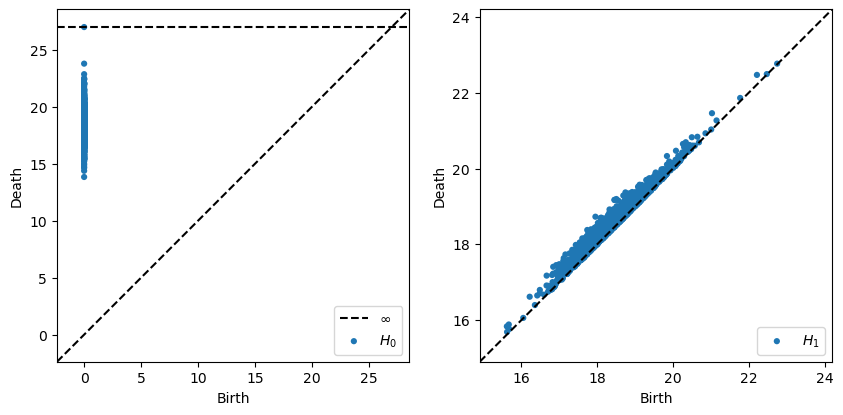

In [596]:
from ripser import ripser
from persim import plot_diagrams


dgms_tc = ripser(topic_cells, maxdim=1)['dgms']


plt.figure(figsize=(10, 5))
plot_diagrams(dgms_tc, plot_only=[0], ax=plt.subplot(121))
plot_diagrams(dgms_tc, plot_only=[1], ax=plt.subplot(122))

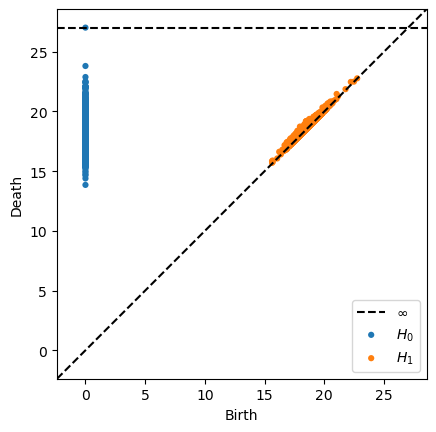

In [597]:
plot_diagrams(dgms_tc, show=True)

### Selecting only top genes identified by topic modeling

In [110]:
ls = ["Fos","Klf6","Klf2","Zfp36","Fosb","Cxcl2","Ccl1","Areg","Il1rl1","Cxcl1","Gzmb","Il17f","Il22","Il17a","Cd3d"]
# looking at cells belonging to one of the topics
gene_sub_topic_cells = pd_topic_cells[ls]
# looking at all cells 
gene_sub_data = pd_data[ls]

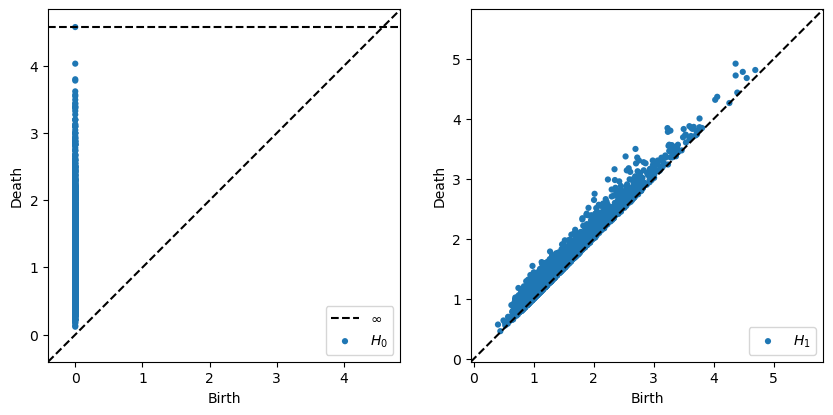

In [111]:
# cells in one of the topics
dgms = ripser(gene_sub_topic_cells.values, maxdim=1)['dgms']


plt.figure(figsize=(10, 5))
plot_diagrams(dgms, plot_only=[0], ax=plt.subplot(121))
plot_diagrams(dgms, plot_only=[1], ax=plt.subplot(122))

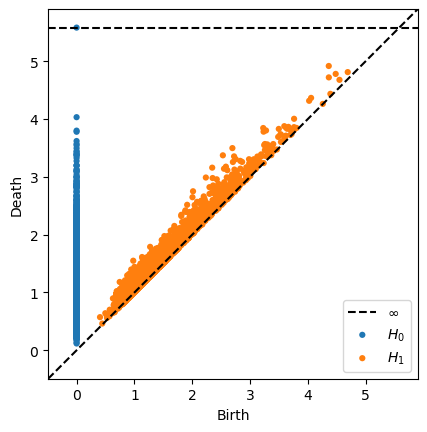

In [112]:
plot_diagrams(dgms, show=True)

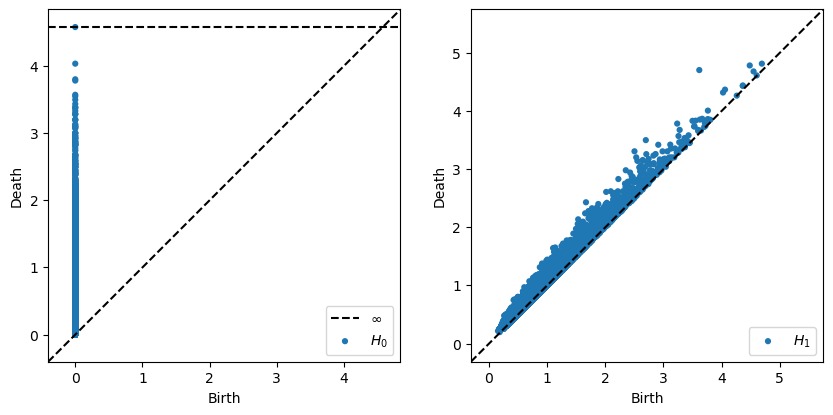

In [113]:
# all cells
dgms = ripser(gene_sub_data.values, maxdim=1)['dgms']


plt.figure(figsize=(10, 5))
plot_diagrams(dgms, plot_only=[0], ax=plt.subplot(121))
plot_diagrams(dgms, plot_only=[1], ax=plt.subplot(122))

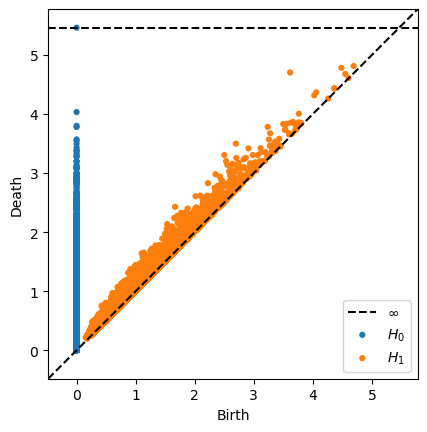

In [114]:
plot_diagrams(dgms, show=True)

No handles with labels found to put in legend.


(3807, 2)


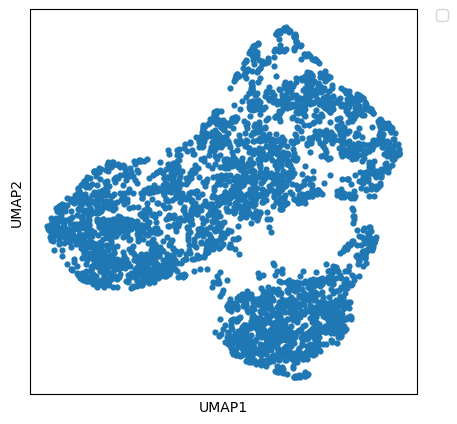

In [115]:
reducer = umap.UMAP()
__UMAP = reducer.fit_transform(gene_sub_topic_cells.values)
print(__UMAP.shape)

plt.figure(figsize=(5, 5))
frame1 = sns.scatterplot(__UMAP[:,0], __UMAP[:,1], s=20,  linewidth = 0)
#plt.xlim(-30000,25000)
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()

In [116]:
label_ILC2_ILC3 = np.isfinite(val_ILC2_ILC3)
label_ILC3_Q = np.isfinite(val_ILC3_Q)
label_ILC2_Q = np.isfinite(val_ILC2_Q)
label_cloud_ILC3 = np.isfinite(val_cloud_ILC3) 

__UMAP_ILC2_ILC3 = np.zeros((1,2))
__UMAP_ILC3_Q = np.zeros((1,2))
__UMAP_ILC2_Q = np.zeros((1,2))
__UMAP_cloud_ILC3 = np.zeros((1,2))

for i in range(UMAP.shape[0]):
    if label_ILC2_ILC3[i] == True:
        __UMAP_ILC2_ILC3 = np.append(__UMAP_ILC2_ILC3, np.reshape(__UMAP[i,:], (1,2)), axis = 0)
        
for i in range(UMAP.shape[0]):
    if label_ILC3_Q[i] == True:
        __UMAP_ILC3_Q = np.append(__UMAP_ILC3_Q, np.reshape(__UMAP[i,:], (1,2)), axis = 0)
        
for i in range(UMAP.shape[0]):
    if label_ILC2_Q[i] == True:
        __UMAP_ILC2_Q = np.append(__UMAP_ILC2_Q, np.reshape(__UMAP[i,:], (1,2)), axis = 0)
        
for i in range(UMAP.shape[0]):
    if label_cloud_ILC3[i] == True:
        __UMAP_cloud_ILC3 = np.append(__UMAP_cloud_ILC3, np.reshape(__UMAP[i,:], (1,2)), axis = 0)
        

        
__UMAP_ILC2_ILC3 = __UMAP_ILC2_ILC3[1:,:]
__UMAP_ILC3_Q = __UMAP_ILC3_Q[1:,:]
__UMAP_ILC2_Q = __UMAP_ILC2_Q[1:,:]
__UMAP_cloud_ILC3 = __UMAP_cloud_ILC3[1:,:]

print(__UMAP_ILC2_ILC3.shape)
print(__UMAP_ILC3_Q.shape)
print(__UMAP_ILC2_Q.shape)
print(__UMAP_cloud_ILC3.shape)

IndexError: index 3807 is out of bounds for axis 0 with size 3807

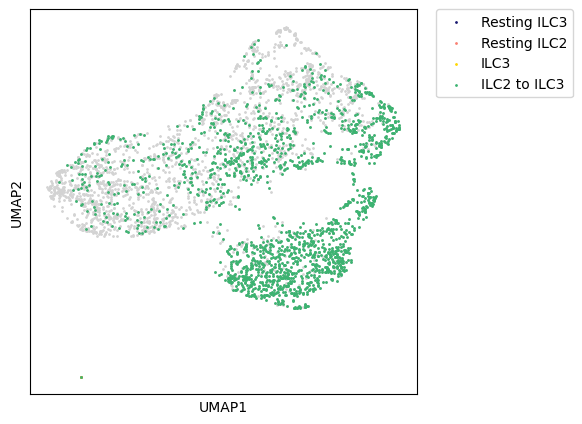

In [117]:
plt.figure(figsize=(5, 5))

frame1 = plt.scatter(__UMAP[:,0], __UMAP[:,1], s= 1, c = "lightgrey")
plt.scatter(__UMAP_ILC3_Q[:,0], __UMAP_ILC3_Q[:,1], s= 1, c = "midnightblue", label = "Resting ILC3")
plt.scatter(__UMAP_ILC2_Q[:,0], __UMAP_ILC2_Q[:,1], s= 1, c = "salmon", label = "Resting ILC2")
plt.scatter(__UMAP_cloud_ILC3[:,0], __UMAP_cloud_ILC3[:,1], s= 1, c = "gold", label = "ILC3")
plt.scatter(__UMAP_ILC2_ILC3[:,0], __UMAP_ILC2_ILC3[:,1], s= 1, c = "mediumseagreen", label = "ILC2 to ILC3")

#plt.xlim(-30000,25000)
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()

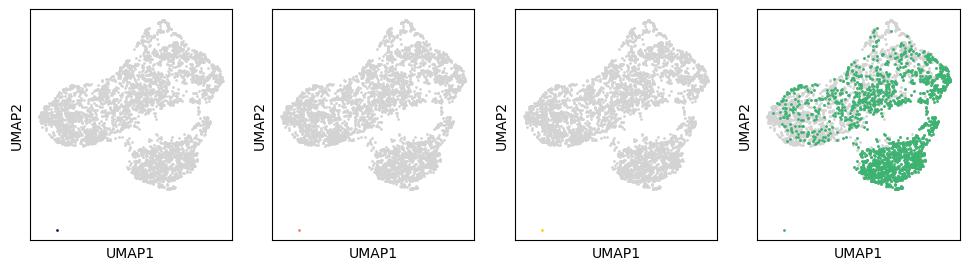

In [118]:
plt.figure(figsize=(12, 3))

ax=plt.subplot(141)
frame1 = plt.scatter(__UMAP[:,0], __UMAP[:,1], s= 1, c = "lightgrey")
plt.scatter(__UMAP_ILC3_Q[:,0], __UMAP_ILC3_Q[:,1], s= 1, c = "midnightblue")
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')

ax=plt.subplot(142)
frame1 = plt.scatter(__UMAP[:,0], __UMAP[:,1], s= 1, c = "lightgrey")
plt.scatter(__UMAP_ILC2_Q[:,0], __UMAP_ILC2_Q[:,1], s= 1, c = "salmon")
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')

ax=plt.subplot(143)
frame1 = plt.scatter(__UMAP[:,0], __UMAP[:,1], s= 1, c = "lightgrey")
plt.scatter(__UMAP_cloud_ILC3[:,0], __UMAP_cloud_ILC3[:,1], s= 1, c = "gold")
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')

ax=plt.subplot(144)
frame1 = plt.scatter(__UMAP[:,0], __UMAP[:,1], s= 1, c = "lightgrey")
plt.scatter(__UMAP_ILC2_ILC3[:,0], __UMAP_ILC2_ILC3[:,1], s= 1, c = "mediumseagreen")
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')

plt.show()

### Selecting only principle components

In [119]:
from sklearn.decomposition import PCA

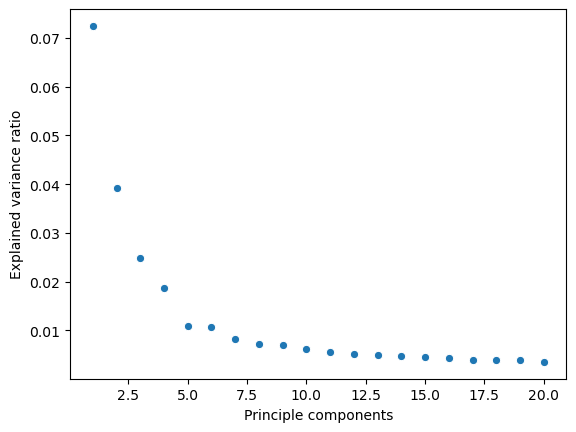

In [120]:
pca = PCA(n_components=20)
pca.fit(pd_topic_cells.values)
PC = pca.transform(pd_topic_cells.values)

var = np.array(pca.explained_variance_ratio_)
pcs = np.arange(1,21)

sns.scatterplot(pcs, var)
plt.ylabel('Explained variance ratio')
plt.xlabel('Principle components')
plt.show()

No handles with labels found to put in legend.


(3807, 2)


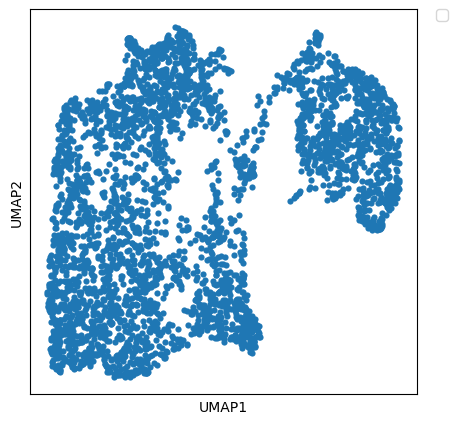

In [121]:
data = PC[:,0:10]
reducer = umap.UMAP()
_UMAP = reducer.fit_transform(data)
print(_UMAP.shape)

plt.figure(figsize=(5, 5))
frame1 = sns.scatterplot(_UMAP[:,0], _UMAP[:,1], s=20,  linewidth = 0)
#plt.xlim(-30000,25000)
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()

(3807, 10)


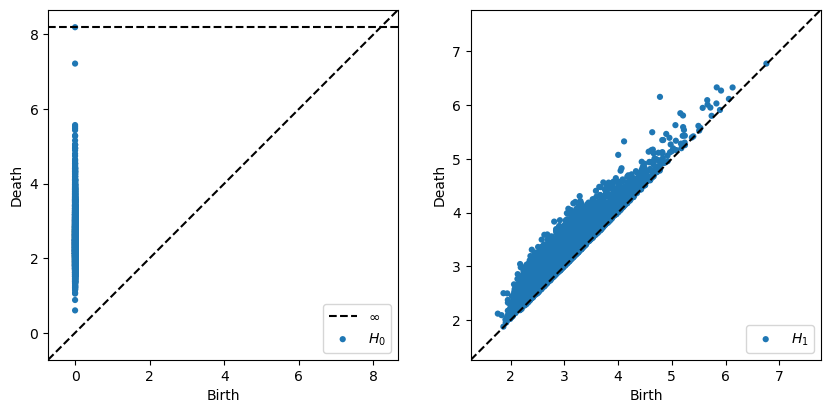

In [593]:
print(data.shape)
dgms_PCA = ripser(data, maxdim=1)['dgms']


plt.figure(figsize=(10, 10))
plot_diagrams(dgms_PCA, plot_only=[0], ax=plt.subplot(221))
plot_diagrams(dgms_PCA, plot_only=[1], ax=plt.subplot(222))

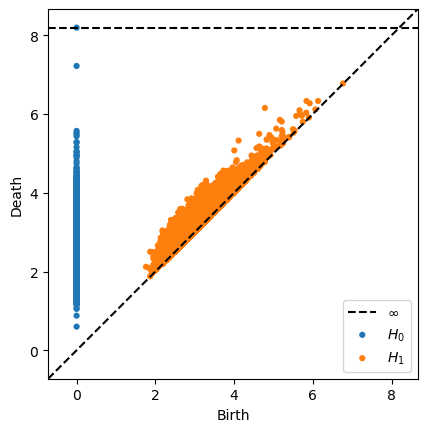

In [594]:
plot_diagrams(dgms_PCA, show=True)

In [124]:
label_ILC2_ILC3 = np.isfinite(val_ILC2_ILC3)
label_ILC3_Q = np.isfinite(val_ILC3_Q)
label_ILC2_Q = np.isfinite(val_ILC2_Q)
label_cloud_ILC3 = np.isfinite(val_cloud_ILC3) 

_UMAP_ILC2_ILC3 = np.zeros((1,2))
_UMAP_ILC3_Q = np.zeros((1,2))
_UMAP_ILC2_Q = np.zeros((1,2))
_UMAP_cloud_ILC3 = np.zeros((1,2))

for i in range(UMAP.shape[0]):
    if label_ILC2_ILC3[i] == True:
        _UMAP_ILC2_ILC3 = np.append(_UMAP_ILC2_ILC3, np.reshape(_UMAP[i,:], (1,2)), axis = 0)
        
for i in range(UMAP.shape[0]):
    if label_ILC3_Q[i] == True:
        _UMAP_ILC3_Q = np.append(_UMAP_ILC3_Q, np.reshape(_UMAP[i,:], (1,2)), axis = 0)
        
for i in range(UMAP.shape[0]):
    if label_ILC2_Q[i] == True:
        _UMAP_ILC2_Q = np.append(_UMAP_ILC2_Q, np.reshape(_UMAP[i,:], (1,2)), axis = 0)
        
for i in range(UMAP.shape[0]):
    if label_cloud_ILC3[i] == True:
        _UMAP_cloud_ILC3 = np.append(_UMAP_cloud_ILC3, np.reshape(_UMAP[i,:], (1,2)), axis = 0)
        

        
_UMAP_ILC2_ILC3 = _UMAP_ILC2_ILC3[1:,:]
_UMAP_ILC3_Q = _UMAP_ILC3_Q[1:,:]
_UMAP_ILC2_Q = _UMAP_ILC2_Q[1:,:]
_UMAP_cloud_ILC3 = _UMAP_cloud_ILC3[1:,:]

print(_UMAP_ILC2_ILC3.shape)
print(_UMAP_ILC3_Q.shape)
print(_UMAP_ILC2_Q.shape)
print(_UMAP_cloud_ILC3.shape)

IndexError: index 3807 is out of bounds for axis 0 with size 3807

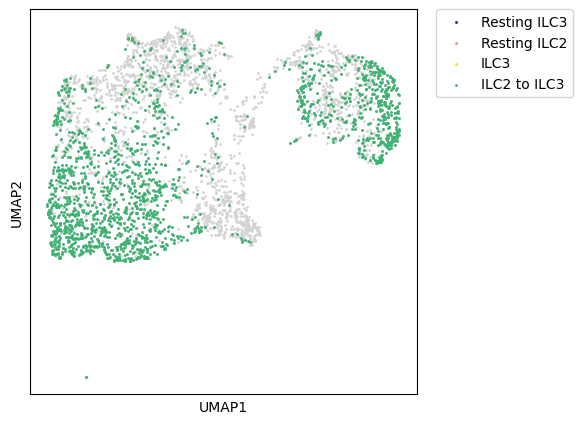

In [125]:
plt.figure(figsize=(5, 5))

frame1 = plt.scatter(_UMAP[:,0], _UMAP[:,1], s= 1, c = "lightgrey")
plt.scatter(_UMAP_ILC3_Q[:,0], _UMAP_ILC3_Q[:,1], s= 1, c = "midnightblue", label = "Resting ILC3")
plt.scatter(_UMAP_ILC2_Q[:,0], _UMAP_ILC2_Q[:,1], s= 1, c = "salmon", label = "Resting ILC2")
plt.scatter(_UMAP_cloud_ILC3[:,0], _UMAP_cloud_ILC3[:,1], s= 1, c = "gold", label = "ILC3")
plt.scatter(_UMAP_ILC2_ILC3[:,0], _UMAP_ILC2_ILC3[:,1], s= 1, c = "mediumseagreen", label = "ILC2 to ILC3")

#plt.xlim(-30000,25000)
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()

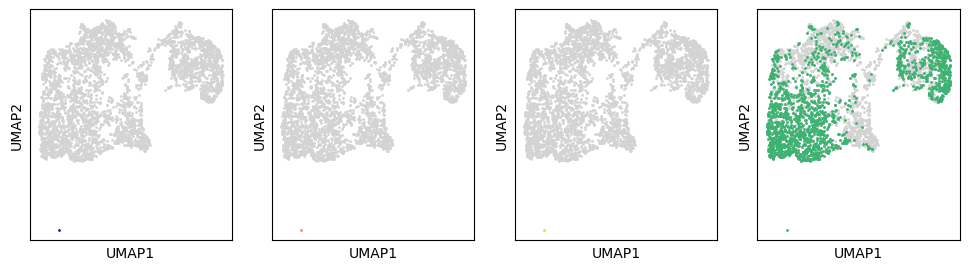

In [126]:
plt.figure(figsize=(12, 3))

ax=plt.subplot(141)
frame1 = plt.scatter(_UMAP[:,0], _UMAP[:,1], s= 1, c = "lightgrey")
plt.scatter(_UMAP_ILC3_Q[:,0], _UMAP_ILC3_Q[:,1], s= 1, c = "midnightblue")
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')

ax=plt.subplot(142)
frame1 = plt.scatter(_UMAP[:,0], _UMAP[:,1], s= 1, c = "lightgrey")
plt.scatter(_UMAP_ILC2_Q[:,0], _UMAP_ILC2_Q[:,1], s= 1, c = "salmon")
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')

ax=plt.subplot(143)
frame1 = plt.scatter(_UMAP[:,0], _UMAP[:,1], s= 1, c = "lightgrey")
plt.scatter(_UMAP_cloud_ILC3[:,0], _UMAP_cloud_ILC3[:,1], s= 1, c = "gold")
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')

ax=plt.subplot(144)
frame1 = plt.scatter(_UMAP[:,0], _UMAP[:,1], s= 1, c = "lightgrey")
plt.scatter(_UMAP_ILC2_ILC3[:,0], _UMAP_ILC2_ILC3[:,1], s= 1, c = "mediumseagreen")
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')

plt.show()

## New subsetting

In [406]:
test = ILC.layers["norm_data"]

full_gene_list = ILC.var["Selected"].index

#remove variable genes - look here for 15 random genes
sub_gene = full_gene_list.difference(Gene_list)
print(len(sub_gene))

12806


In [407]:
lda_1 = ILC_var.obs["lda_1"]
lda_2 = ILC_var.obs["lda_2"]
lda_3 = ILC_var.obs["lda_3"]
lda_4 = ILC_var.obs["lda_4"]
lda_7 = ILC_var.obs["lda_7"]

LDA = pd.DataFrame(dict(lda_1 = lda_1, lda_2 = lda_2, lda_3 = lda_3, lda_4 = lda_4, ))

In [408]:
# ------------Selecting quantile to subset on------------------
Q1_1, Q2_1, Q3_1 = lda_1.quantile([0.25,0.5,0.95])
Q1_2, Q2_2, Q3_2 = lda_2.quantile([0.25,0.5,0.95])
Q1_3, Q2_3, Q3_3 = lda_3.quantile([0.25,0.5,0.95])
Q1_4, Q2_4, Q3_4 = lda_4.quantile([0.25,0.5,0.95])

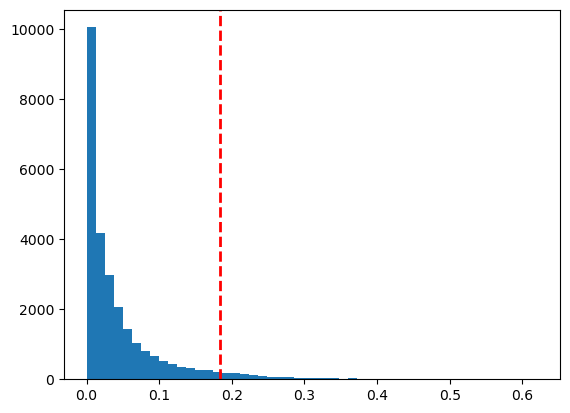

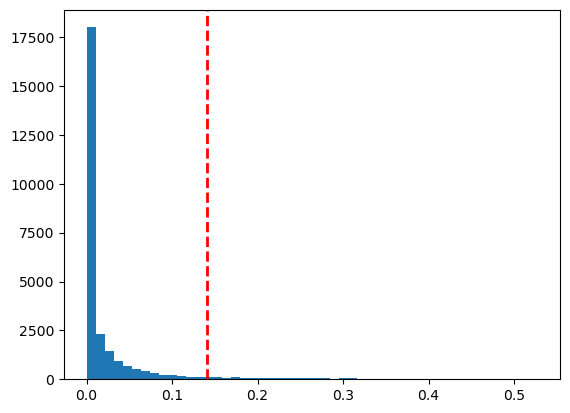

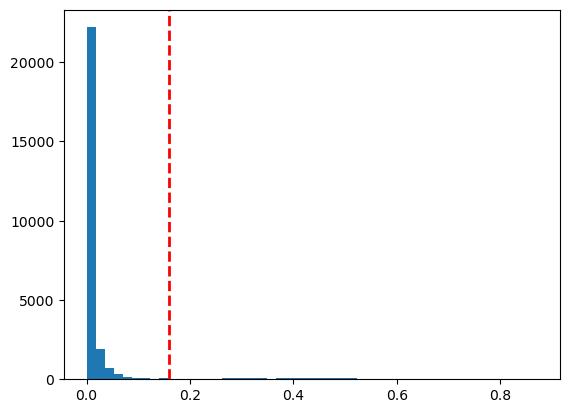

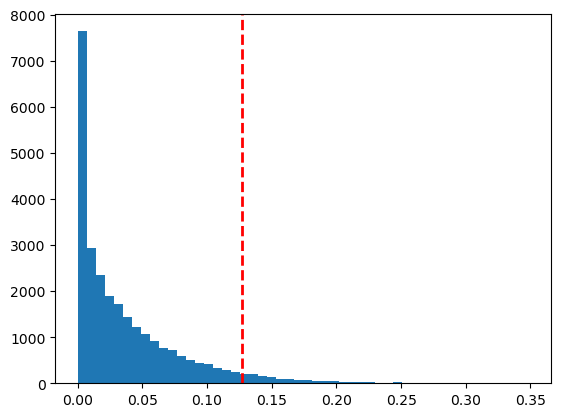

In [409]:
plt.hist(lda_1, bins = 50)
plt.axvline(Q3_1, color='red', linestyle='dashed', linewidth=2)
plt.show()

plt.hist(lda_2, bins = 50)
plt.axvline(Q3_2, color='red', linestyle='dashed', linewidth=2)
plt.show()

plt.hist(lda_3, bins = 50)
plt.axvline(Q3_3, color='red', linestyle='dashed', linewidth=2)
plt.show()

plt.hist(lda_4, bins = 50)
plt.axvline(Q3_4, color='red', linestyle='dashed', linewidth=2)
plt.show()

In [410]:
topQ_LDA1 = LDA.loc[LDA["lda_1"] > Q3_1, "lda_1"]
topQ_LDA2 = LDA.loc[LDA["lda_2"] > Q3_2, "lda_2"]
topQ_LDA3 = LDA.loc[LDA["lda_3"] > Q3_3, "lda_3"]
topQ_LDA4 = LDA.loc[LDA["lda_4"] > Q3_4, "lda_4"]

LDA_topQ = LDA[(LDA["lda_1"] > Q3_1) | (LDA["lda_2"] > Q3_2) | (LDA["lda_3"] > Q3_3) | (LDA["lda_4"] > Q3_4)]

In [411]:
print(Cell_list.shape)
print(full_gene_list.shape)

#ILC_tot = pd.DataFrame(test, index = Cell_list, columns = full_gene_list)
test = test.toarray()

(26877,)
(15806,)


In [412]:
ILC_tot = pd.DataFrame(test, index = Cell_list, columns = full_gene_list)

In [497]:
topQ_LDA1

index
Timept0.AAACCCATCGCTATTT    0.327733
Timept0.AAACGAAAGTGGCCTC    0.184534
Timept0.AAACGCTTCTTAGTTC    0.185494
Timept0.AAAGTGAGTTAGGGAC    0.281161
Timept0.AACCTTTTCTGGCCGA    0.283971
                              ...   
Timept4.TTTCGATTCAAGCTGT    0.313807
Timept4.TTTGATCGTGGCACTC    0.279188
Timept4.TTTGGAGAGGACTATA    0.185048
Timept4.TTTGGAGAGTAGCAAT    0.270985
Timept4.TTTGGTTTCCTGTTAT    0.206516
Name: lda_1, Length: 1344, dtype: float64

In [500]:
ILC_topQ = ILC_tot.loc[LDA_topQ.index]
#ILC_topQ = ILC_total_reads.loc[LDA_topQ.index]
UMAP_topQ = UMAP_pd.loc[LDA_topQ.index]
Diff_topQ = Diff_pd.loc[LDA_topQ.index]

UMAP_topQ = np.array(UMAP_topQ)
Diff_topQ = np.array(Diff_topQ)

UMAP_topQ_LDA1 = np.array(UMAP_pd.loc[topQ_LDA1.index])
UMAP_topQ_LDA2 = np.array(UMAP_pd.loc[topQ_LDA2.index])
UMAP_topQ_LDA3 = np.array(UMAP_pd.loc[topQ_LDA3.index])
UMAP_topQ_LDA4 = np.array(UMAP_pd.loc[topQ_LDA4.index])

Diff_topQ_LDA1 = np.array(Diff_pd.loc[topQ_LDA1.index])
Diff_topQ_LDA2 = np.array(Diff_pd.loc[topQ_LDA2.index])
Diff_topQ_LDA3 = np.array(Diff_pd.loc[topQ_LDA3.index])
Diff_topQ_LDA4 = np.array(Diff_pd.loc[topQ_LDA4.index])

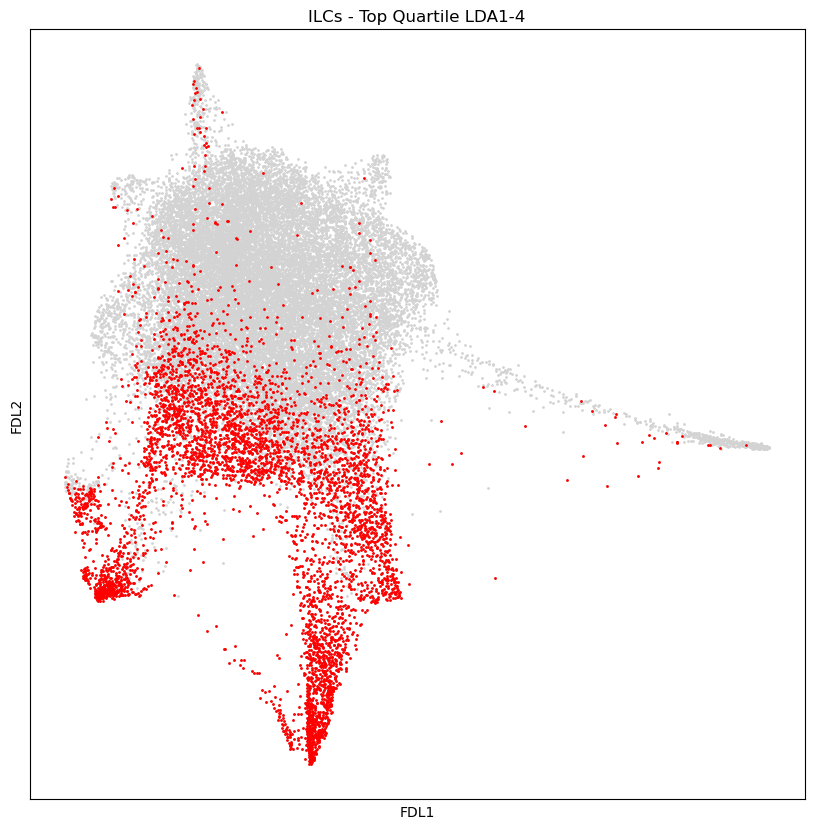

In [501]:
plt.figure(figsize=(10, 10))
frame1 = plt.scatter(Diff[:,0], Diff[:,1], s=1, c = "lightgrey")
frame1 = plt.scatter(Diff_topQ[:,0], Diff_topQ[:,1], s=1, c = "red")
plt.title('ILCs - Top Quartile LDA1-4')
#plt.xlim(-30000,25000)
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('FDL2')
plt.xlabel('FDL1')
plt.show()

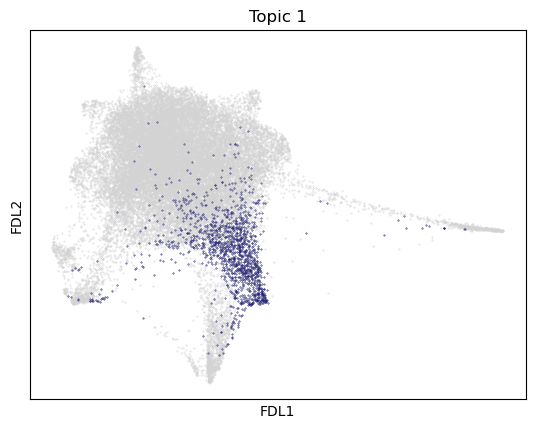

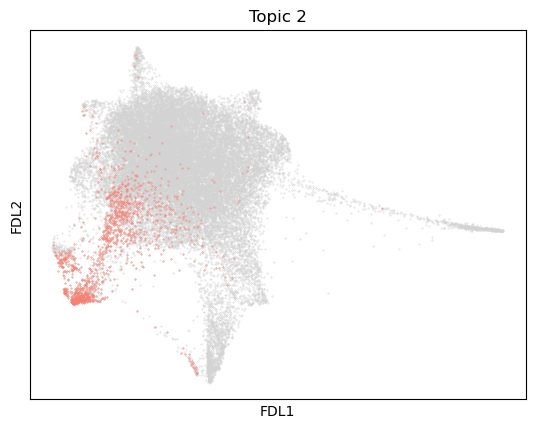

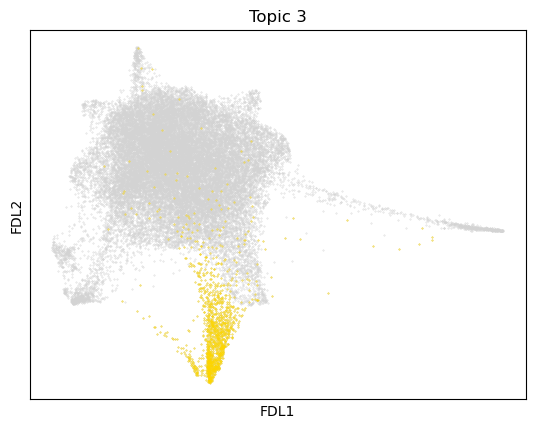

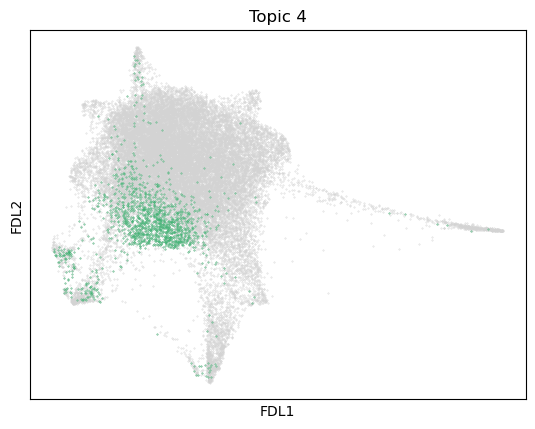

In [510]:

frame1 = plt.scatter(Diff[:,0], Diff[:,1], s= 0.1, c = "lightgrey")
plt.scatter(Diff_topQ_LDA1[:,0], Diff_topQ_LDA1[:,1], s= 0.1, c = "midnightblue")
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('FDL2')
plt.xlabel('FDL1')
plt.title('Topic 1')
plt.show()

frame1 = plt.scatter(Diff[:,0], Diff[:,1], s= .1, c = "lightgrey")
plt.scatter(Diff_topQ_LDA2[:,0], Diff_topQ_LDA2[:,1], s= .1, c = "salmon")
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('FDL2')
plt.xlabel('FDL1')
plt.title('Topic 2')
plt.show()

frame1 = plt.scatter(Diff[:,0], Diff[:,1], s= .1, c = "lightgrey")
plt.scatter(Diff_topQ_LDA3[:,0], Diff_topQ_LDA3[:,1], s= .1, c = "gold")
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('FDL2')
plt.xlabel('FDL1')
plt.title('Topic 3')
plt.show()

frame1 = plt.scatter(Diff[:,0], Diff[:,1], s= .1, c = "lightgrey")
plt.scatter(Diff_topQ_LDA4[:,0], Diff_topQ_LDA4[:,1], s= .1, c = "mediumseagreen")
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('FDL2')
plt.xlabel('FDL1')
plt.title('Topic 4')
plt.show()


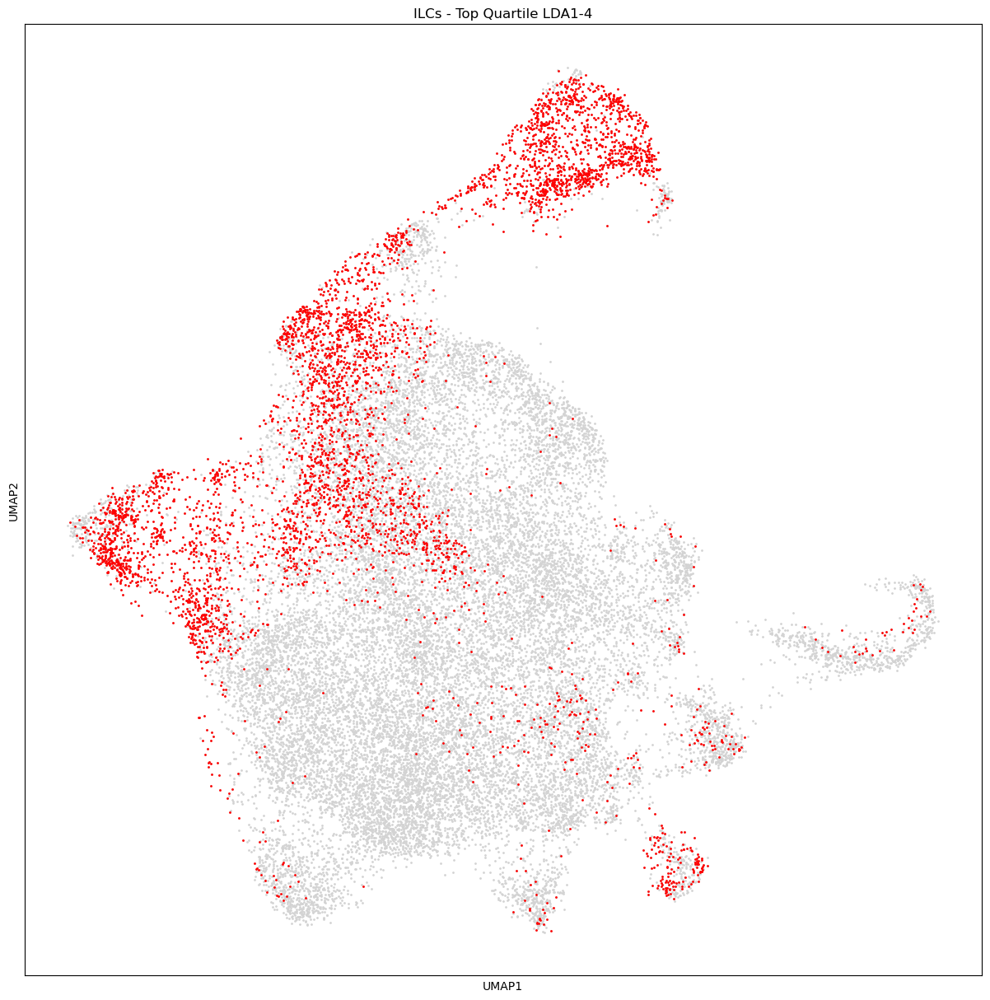

In [416]:
plt.figure(figsize=(15, 15))
frame1 = plt.scatter(UMAP[:,0], UMAP[:,1], s=1, c = "lightgrey")
frame1 = plt.scatter(UMAP_topQ[:,0], UMAP_topQ[:,1], s=1, c = "red")
plt.title('ILCs - Top Quartile LDA1-4')
#plt.xlim(-30000,25000)
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')
plt.show()

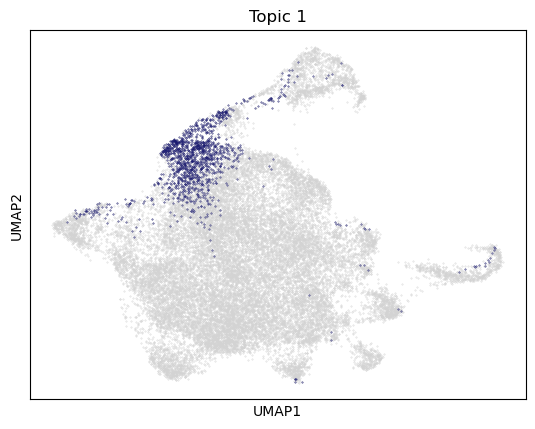

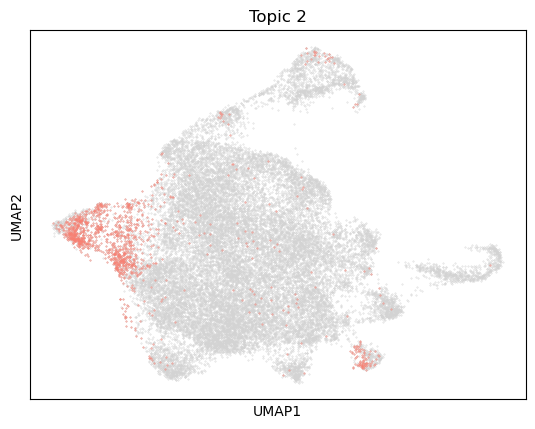

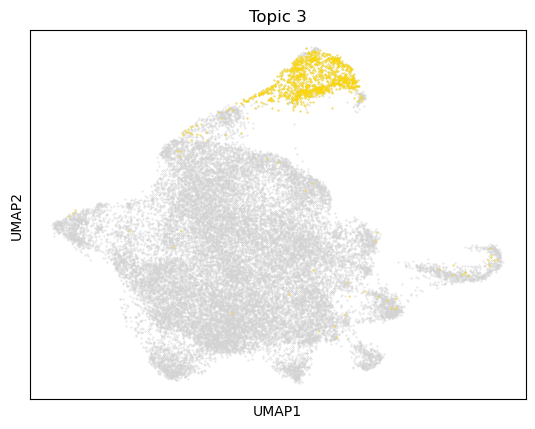

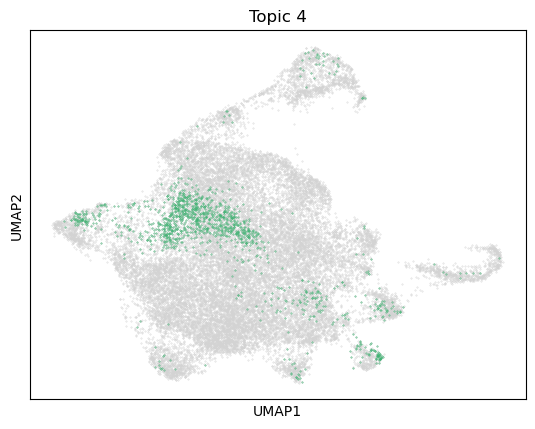

In [511]:
#plt.figure(figsize=(12, 3))

#ax=plt.subplot(141)
frame1 = plt.scatter(UMAP[:,0], UMAP[:,1], s= 0.1, c = "lightgrey")
plt.scatter(UMAP_topQ_LDA1[:,0], UMAP_topQ_LDA1[:,1], s= 0.1, c = "midnightblue")
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')
plt.title('Topic 1')
plt.show()

frame1 = plt.scatter(UMAP[:,0], UMAP[:,1], s= .1, c = "lightgrey")
plt.scatter(UMAP_topQ_LDA2[:,0], UMAP_topQ_LDA2[:,1], s= .1, c = "salmon")
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')
plt.title('Topic 2')
plt.show()

frame1 = plt.scatter(UMAP[:,0], UMAP[:,1], s= .1, c = "lightgrey")
plt.scatter(UMAP_topQ_LDA3[:,0], UMAP_topQ_LDA3[:,1], s= .1, c = "gold")
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')
plt.title('Topic 3')
plt.show()

frame1 = plt.scatter(UMAP[:,0], UMAP[:,1], s= .1, c = "lightgrey")
plt.scatter(UMAP_topQ_LDA4[:,0], UMAP_topQ_LDA4[:,1], s= .1, c = "mediumseagreen")
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')
plt.title('Topic 4')

plt.show()

(5010, 15806)


c:\users\hmkri\desktop\riesenfeld pearson\lib\site-packages\ripser\ripser.py:257: UserWarning: The input point cloud has more columns than rows; did you mean to transpose?
  warnings.warn(


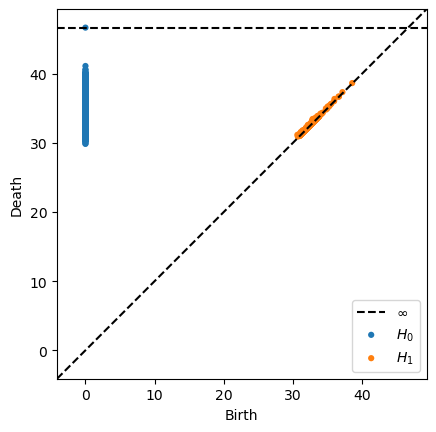

In [417]:
print(np.array(ILC_topQ).shape)
dgms = ripser(np.array(ILC_topQ), maxdim=1)['dgms']

#plt.figure(figsize=(10, 5))
#plot_diagrams(dgms, plot_only=[0], ax=plt.subplot(121))
#plot_diagrams(dgms, plot_only=[1], ax=plt.subplot(122))

plot_diagrams(dgms, show=True)

In [418]:
ILC_topQ_ls = ILC_topQ[ls]

(5010, 15)


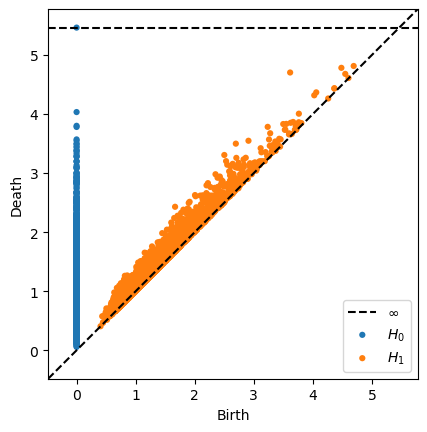

In [419]:
print(np.array(ILC_topQ_ls).shape)
dgms = ripser(np.array(ILC_topQ_ls), maxdim=1)['dgms']

#plt.figure(figsize=(10, 5))
#plot_diagrams(dgms, plot_only=[0], ax=plt.subplot(121))
#plot_diagrams(dgms, plot_only=[1], ax=plt.subplot(122))

plot_diagrams(dgms, show=True)

In [420]:
P = []
for i in range(dgms[1].shape[0]):
    b = dgms[1][i][0]
    d = dgms[1][i][1]
    pos = (b+d)/2
    #P.append(((b-pos)**2+(d-pos)**2)**(1/2))
    P.append(d-b)
    
P = np.array(P)
print(P.shape)

(5089,)


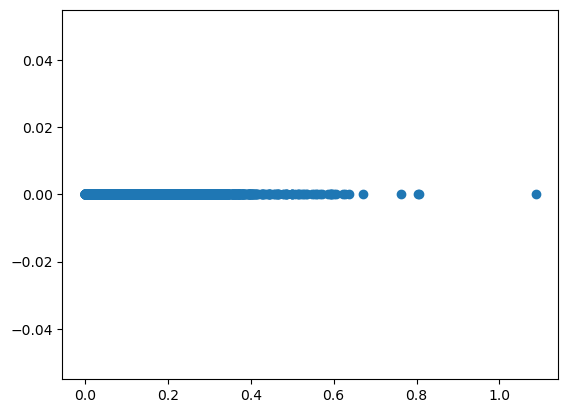

In [421]:
plt.scatter(P, np.zeros(P.shape))
plt.show()

In [513]:
random_gene = []

for i in range(15):
    R = random.randrange(0, sub_gene.shape[0])
    random_gene.append(sub_gene[R])
    print(sub_gene[R])
    
ILC_random15 = ILC_topQ[random_gene]

dgms = ripser(np.array(ILC_random15), maxdim=1)['dgms']


P_null = []
for i in range(dgms[1].shape[0]):
    b = dgms[1][i][0]
    d = dgms[1][i][1]
    pos = (b+d)/2
    #P_null.append(((b-pos)**2+(d-pos)**2)**(1/2))
    P_null.append(d-b)
    
P_null = np.array(P_null)
P_hold_null.append(P_null)

print(len(P_hold_null))

Tspan17
Acot9
Gpr150
Gm49240
Ftl1-ps1
Atf6b
Gm12088
Mtx1
Lrrd1
Rnpep
Crmp1
Krt80
Pard3b
Tedc2
Frg1
9


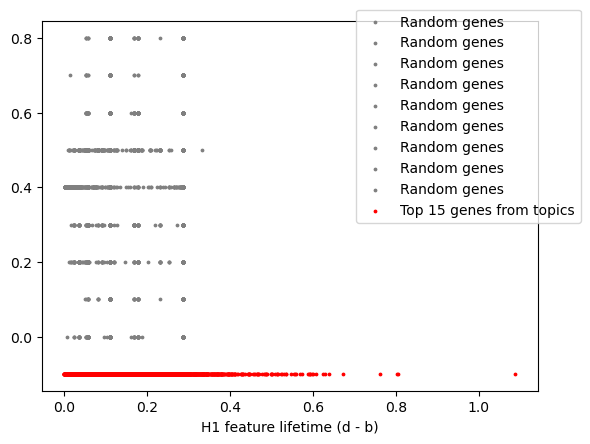

In [514]:
for i in range(len(P_hold_null)):
    plt.scatter(P_hold_null[i], 0.1*i*np.ones(P_hold_null[i].shape), c = "grey", s = 3, label = "Random genes")
    
plt.scatter(P, -0.1*np.ones(P.shape), c = "red", s = 3, label = "Top 15 genes from topics")
#plt.ylim([-0.2,0.2])
plt.legend(bbox_to_anchor=(1.1, 1.05))
plt.xlabel("H1 feature lifetime (d - b)")
plt.show()

In [585]:
np_P_hold_null = np.array([])
Random = np.array([])
State = np.array([])
for i in range(len(P_hold_null)):
    np_P_hold_null = np.append(np_P_hold_null, P_hold_null[i])
    Random = np.append(Random, np.array(["Random_"+str(i+1)] * P_hold_null[i].shape[0]))
    State = np.append(State, np.array(["Random"] * P_hold_null[i].shape[0]))
    
dim = P.shape[0] + np_P_hold_null.shape[0]
    
Lifetime = np.reshape(np.append(P, np_P_hold_null), (dim,1))

FitGoM = np.array(["FitGoM"] * P.shape[0])
print(FitGoM.shape)
print(Random.shape)

Gene_list_selection = np.reshape(np.append(FitGoM, Random), (dim,1))
print(Gene_list_selection.shape)

State_selection = np.reshape(np.append(FitGoM, State), (dim,1))
print(State_selection.shape)

null_np = np.append(Gene_list_selection, Lifetime, axis = 1)
null_np = np.append(null_np, State_selection, axis = 1)
print(null_np.shape)

null_df =  pd.DataFrame(null_np, columns = ["Gene_list", "Lifetime", "State"])

(5089,)
(5123,)
(10212, 1)
(10212, 1)
(10212, 3)


In [592]:
print(P.shape[0])
print(P_hold_null[0].shape[0])
print(P_hold_null[1].shape[0])
print(P_hold_null[2].shape[0])
print(P_hold_null[3].shape[0])
print(P_hold_null[4].shape[0])
print(P_hold_null[5].shape[0])
print(P_hold_null[6].shape[0])
print(P_hold_null[7].shape[0])
print(P_hold_null[8].shape[0])

5089
292
314
526
490
833
1897
367
108
296


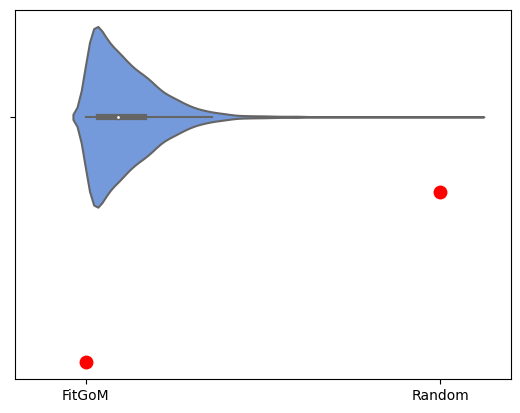

In [587]:
ax = sns.violinplot(np.array(P), color = "cornflowerblue")
sns.swarmplot(x=np.array(["FitGoM","Random"]), y=np.array([np.amax(P),np.amax(np_P_hold_null)]), color="red", s = 10)
plt.xlim(-0.2,1.2)
plt.show()

In [601]:
null_df["Gene_list"]

null_df["Lifetime"]=null_df['Lifetime'].astype('float64')

In [589]:
#plt.figure(figsize=(10,6))
#sns.violinplot(x=null_df["Gene_list"], y=null_df["Lifetime"])
#sns.swarmplot(x=null_df["Gene_list"], y=null_df["Lifetime"], color="k", alpha=0.5)
#plt.ylabel("Lifetime of H1 features")
#plt.xlabel("Selection method for 15 genes")
#plt.show()

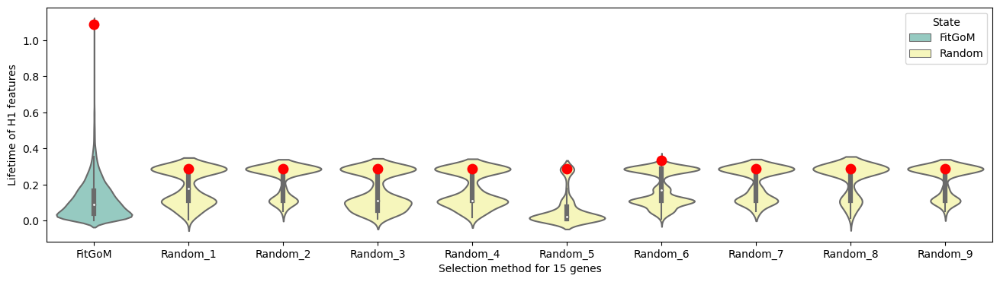

In [590]:
plt.figure(figsize=(16,4))
sns.violinplot(x=null_df["Gene_list"], y=null_df["Lifetime"], hue = null_df["State"], dodge=False, palette="Set3")
sns.swarmplot(x=np.array(["FitGoM","Random_1","Random_2","Random_3","Random_4","Random_5","Random_6","Random_7","Random_8","Random_9"]), y=np.array([np.amax(P),np.amax(P_hold_null[0]),np.amax(P_hold_null[1]),np.amax(P_hold_null[2]),np.amax(P_hold_null[3]),np.amax(P_hold_null[4]),np.amax(P_hold_null[5]),np.amax(P_hold_null[6]),np.amax(P_hold_null[7]),np.amax(P_hold_null[8])]), color="red", s = 10)
plt.ylabel("Lifetime of H1 features")
plt.xlabel("Selection method for 15 genes")
plt.show()

In [ ]:
fit = null_df[null_df["Gene_list"] == "FitGoM"]
rand = null_df[null_df["Gene_list"] == "Random"]

In [ ]:
plt.figure(figsize=(8,6))
ax=plt.subplot(121)
sns.violinplot(x=fit["Gene_list"], y=fit["Lifetime"], color = "cornflowerblue")
sns.swarmplot(x=np.array(["FitGoM"]), y=np.array([np.amax(P)]), color="red", s = 10)
plt.ylabel("Lifetime of H1 features", fontsize = 12)
plt.ylim([-0.1, 1.2])
plt.xlabel("FitGoM", fontsize = 0)

ax=plt.subplot(122)
sns.violinplot(x=rand["Gene_list"], y=rand["Lifetime"], color = "lightgrey")
sns.swarmplot(x=np.array(["Random"]), y=np.array([np.amax(np_P_hold_null)]), color="red", s = 10)
plt.ylabel("Lifetime of H1 features", fontsize = 0)
plt.xlabel("Random", fontsize = 0)
plt.ylim([-0.1, 1.2])
plt.show()

In [560]:
fit = null_df[null_df["Gene_list"] == "FitGoM"]
rand_1 = null_df[null_df["Gene_list"] == "Random_1"]
rand_2 = null_df[null_df["Gene_list"] == "Random_2"]
rand_3 = null_df[null_df["Gene_list"] == "Random_3"]
rand_4 = null_df[null_df["Gene_list"] == "Random_4"]
rand_5 = null_df[null_df["Gene_list"] == "Random_5"]
rand_6 = null_df[null_df["Gene_list"] == "Random_6"]
rand_7 = null_df[null_df["Gene_list"] == "Random_7"]
rand_8 = null_df[null_df["Gene_list"] == "Random_8"]
rand_9 = null_df[null_df["Gene_list"] == "Random_9"]

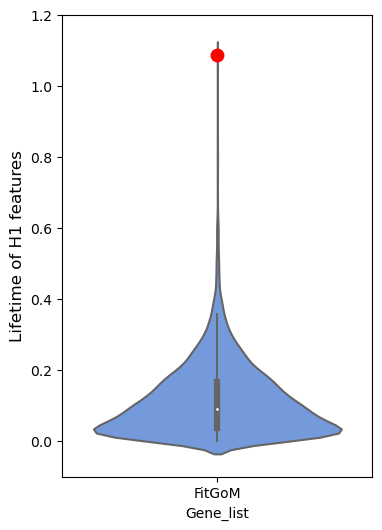

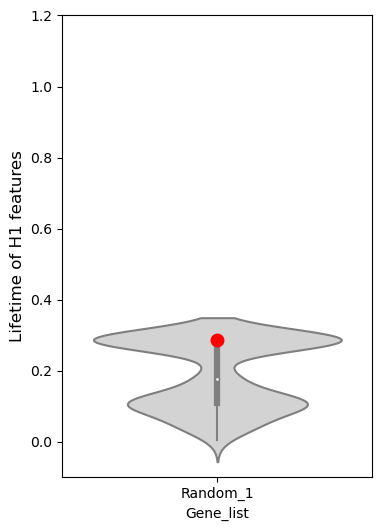

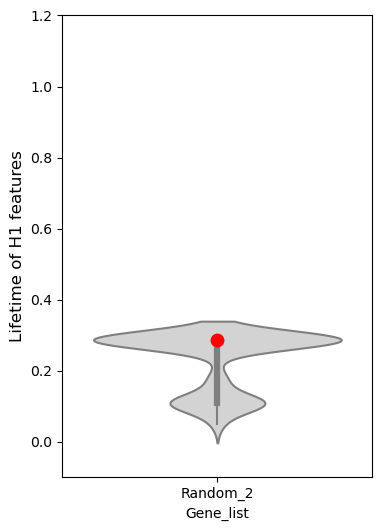

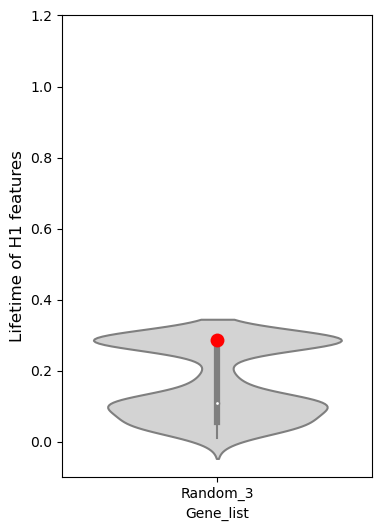

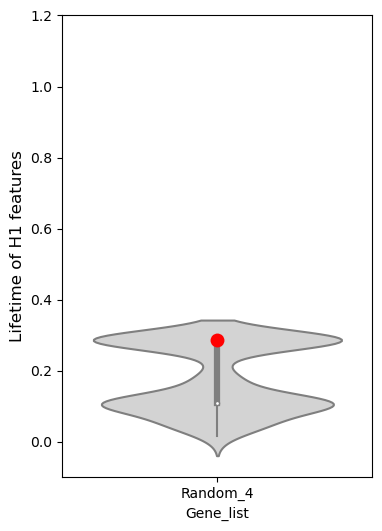

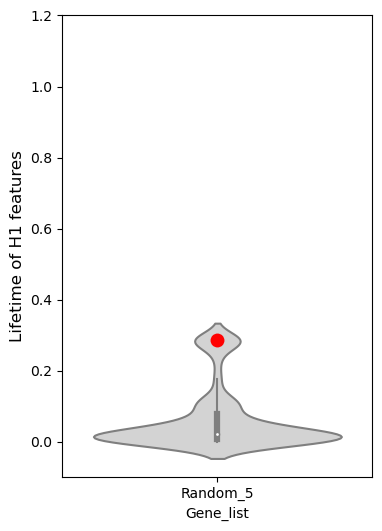

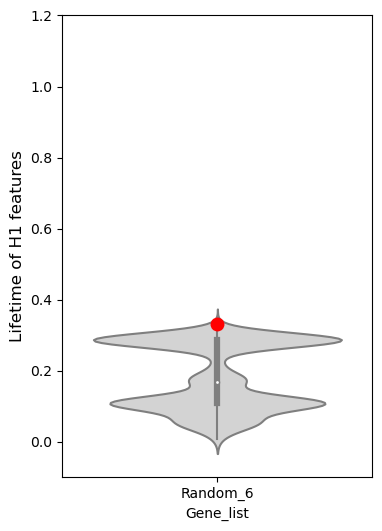

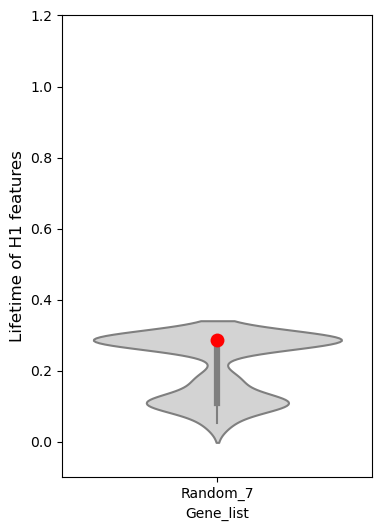

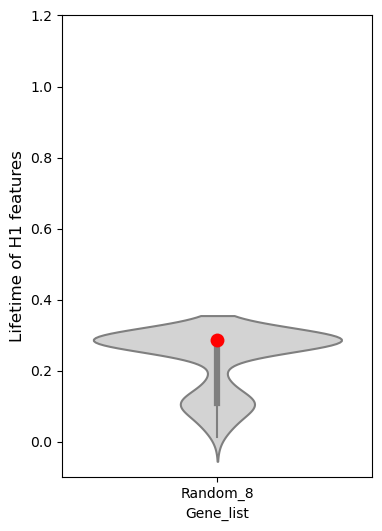

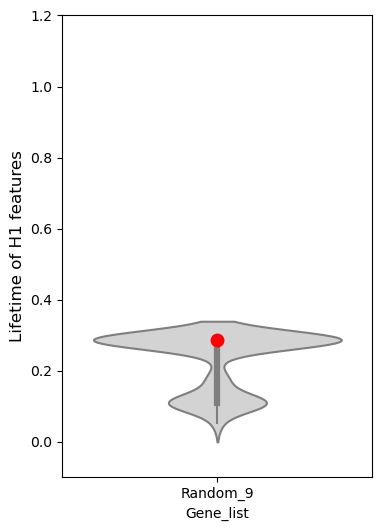

In [566]:
plt.figure(figsize=(4,6))
sns.violinplot(x=fit["Gene_list"], y=fit["Lifetime"], color = "cornflowerblue")
sns.swarmplot(x=np.array(["FitGoM"]), y=np.array([np.amax(P)]), color="red", s = 10)
plt.ylabel("Lifetime of H1 features", fontsize = 12)
plt.ylim([-0.1, 1.2])
plt.show()

plt.figure(figsize=(4,6))
sns.violinplot(x=rand_1["Gene_list"], y=rand_1["Lifetime"], color = "lightgrey")
sns.swarmplot(x=np.array(["Random_1"]), y=np.array([np.amax(P_hold_null[0])]), color="red", s = 10)
plt.ylabel("Lifetime of H1 features", fontsize = 12)
plt.ylim([-0.1, 1.2])
plt.show()

plt.figure(figsize=(4,6))
sns.violinplot(x=rand_2["Gene_list"], y=rand_2["Lifetime"], color = "lightgrey")
sns.swarmplot(x=np.array(["Random_2"]), y=np.array([np.amax(P_hold_null[1])]), color="red", s = 10)
plt.ylabel("Lifetime of H1 features", fontsize = 12)
plt.ylim([-0.1, 1.2])
plt.show()

plt.figure(figsize=(4,6))
sns.violinplot(x=rand_3["Gene_list"], y=rand_3["Lifetime"], color = "lightgrey")
sns.swarmplot(x=np.array(["Random_3"]), y=np.array([np.amax(P_hold_null[2])]), color="red", s = 10)
plt.ylabel("Lifetime of H1 features", fontsize = 12)
plt.ylim([-0.1, 1.2])
plt.show()

plt.figure(figsize=(4,6))
sns.violinplot(x=rand_4["Gene_list"], y=rand_4["Lifetime"], color = "lightgrey")
sns.swarmplot(x=np.array(["Random_4"]), y=np.array([np.amax(P_hold_null[3])]), color="red", s = 10)
plt.ylabel("Lifetime of H1 features", fontsize = 12)
plt.ylim([-0.1, 1.2])
plt.show()

plt.figure(figsize=(4,6))
sns.violinplot(x=rand_5["Gene_list"], y=rand_5["Lifetime"], color = "lightgrey")
sns.swarmplot(x=np.array(["Random_5"]), y=np.array([np.amax(P_hold_null[4])]), color="red", s = 10)
plt.ylabel("Lifetime of H1 features", fontsize = 12)
plt.ylim([-0.1, 1.2])
plt.show()

plt.figure(figsize=(4,6))
sns.violinplot(x=rand_6["Gene_list"], y=rand_6["Lifetime"], color = "lightgrey")
sns.swarmplot(x=np.array(["Random_6"]), y=np.array([np.amax(P_hold_null[5])]), color="red", s = 10)
plt.ylabel("Lifetime of H1 features", fontsize = 12)
plt.ylim([-0.1, 1.2])
plt.show()

plt.figure(figsize=(4,6))
sns.violinplot(x=rand_7["Gene_list"], y=rand_7["Lifetime"], color = "lightgrey")
sns.swarmplot(x=np.array(["Random_7"]), y=np.array([np.amax(P_hold_null[6])]), color="red", s = 10)
plt.ylabel("Lifetime of H1 features", fontsize = 12)
plt.ylim([-0.1, 1.2])
plt.show()

plt.figure(figsize=(4,6))
sns.violinplot(x=rand_8["Gene_list"], y=rand_8["Lifetime"], color = "lightgrey")
sns.swarmplot(x=np.array(["Random_8"]), y=np.array([np.amax(P_hold_null[7])]), color="red", s = 10)
plt.ylabel("Lifetime of H1 features", fontsize = 12)
plt.ylim([-0.1, 1.2])
plt.show()

plt.figure(figsize=(4,6))
sns.violinplot(x=rand_9["Gene_list"], y=rand_9["Lifetime"], color = "lightgrey")
sns.swarmplot(x=np.array(["Random_9"]), y=np.array([np.amax(P_hold_null[8])]), color="red", s = 10)
plt.ylabel("Lifetime of H1 features", fontsize = 12)
plt.ylim([-0.1, 1.2])
plt.show()

In [599]:
P_PCA = []
for i in range(dgms_PCA[1].shape[0]):
    b = dgms_PCA[1][i][0]
    d = dgms_PCA[1][i][1]
    pos = (b+d)/2
    P_PCA.append(d-b)
    
P_PCA = np.array(P_PCA)


P_TC = []
for i in range(dgms_tc[1].shape[0]):
    b = dgms_tc[1][i][0]
    d = dgms_tc[1][i][1]
    pos = (b+d)/2
    P_TC.append(d-b)
    
P_TC = np.array(P_TC)

dim_2 = P_PCA.shape[0] + P_TC.shape[0]


np_P_hold_null = np.array([])
Random = np.array([])
State = np.array([])
for i in range(len(P_hold_null)):
    np_P_hold_null = np.append(np_P_hold_null, P_hold_null[i])
    Random = np.append(Random, np.array(["Random_"+str(i+1)] * P_hold_null[i].shape[0]))
    State = np.append(State, np.array(["Random"] * P_hold_null[i].shape[0]))
    
dim_1 = P.shape[0] + np_P_hold_null.shape[0]
    
Lifetime_1 = np.reshape(np.append(P, np_P_hold_null), (dim_1,1))
Lifetime_2 = np.reshape(np.append(P_PCA, P_TC), (dim_2,1))
Lifetime = np.reshape(np.append(Lifetime_1, Lifetime_2), (dim_1+dim_2, 1))
print(Lifetime.shape)

FitGoM = np.array(["FitGoM"] * P.shape[0])
PCA = np.array(["PCA"] * P_PCA.shape[0])
Topic_Cells = np.array(["Topic_Cells"] * P_TC.shape[0])

Gene_list_selection_1 = np.reshape(np.append(FitGoM, Random), (dim_1,1))
Gene_list_selection_2 = np.reshape(np.append(PCA, Topic_Cells), (dim_2,1))
Gene_list_selection = np.reshape(np.append(Gene_list_selection_1, Gene_list_selection_2), (dim_1+dim_2, 1))
print(Gene_list_selection.shape)

State_selection_1 = np.reshape(np.append(FitGoM, State), (dim_1,1))
State_selection_2 = np.reshape(np.append(PCA, Topic_Cells), (dim_2,1))
State_selection = np.reshape(np.append(State_selection_1, State_selection_2), (dim_1+dim_2, 1))
print(State_selection.shape)

null_np = np.append(Gene_list_selection, Lifetime, axis = 1)
null_np = np.append(null_np, State_selection, axis = 1)
print(null_np.shape)

null_df =  pd.DataFrame(null_np, columns = ["Gene_list", "Lifetime", "State"])

(18041, 1)
(18041, 1)
(18041, 1)
(18041, 3)


In [ ]:
fit = null_df[null_df["Gene_list"] == "FitGoM"]
rand_1 = null_df[null_df["Gene_list"] == "Random_1"]
rand_2 = null_df[null_df["Gene_list"] == "Random_2"]
rand_3 = null_df[null_df["Gene_list"] == "Random_3"]
rand_4 = null_df[null_df["Gene_list"] == "Random_4"]
rand_5 = null_df[null_df["Gene_list"] == "Random_5"]
rand_6 = null_df[null_df["Gene_list"] == "Random_6"]
rand_7 = null_df[null_df["Gene_list"] == "Random_7"]
rand_8 = null_df[null_df["Gene_list"] == "Random_8"]
rand_9 = null_df[null_df["Gene_list"] == "Random_9"]
pc = null_df[null_df["Gene_list"] == "PCA"]
tc = null_df[null_df["Gene_list"] == "Topic_Cells"]

null_df["Lifetime"]=null_df['Lifetime'].astype('float64')

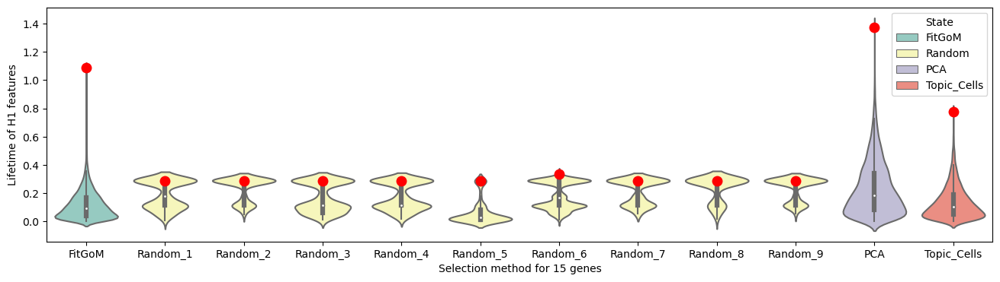

In [602]:
plt.figure(figsize=(16,4))
sns.violinplot(x=null_df["Gene_list"], y=null_df["Lifetime"], hue = null_df["State"], dodge=False, palette="Set3")
sns.swarmplot(x=np.array(["FitGoM","Random_1","Random_2","Random_3","Random_4","Random_5","Random_6","Random_7","Random_8","Random_9", "PCA", "Topic_Cells"]), y=np.array([np.amax(P),np.amax(P_hold_null[0]),np.amax(P_hold_null[1]),np.amax(P_hold_null[2]),np.amax(P_hold_null[3]),np.amax(P_hold_null[4]),np.amax(P_hold_null[5]),np.amax(P_hold_null[6]),np.amax(P_hold_null[7]),np.amax(P_hold_null[8]),np.amax(P_PCA),np.amax(P_TC)]), color="red", s = 10)
plt.ylabel("Lifetime of H1 features")
plt.xlabel("Selection method for 15 genes")
plt.show()

In [225]:
np_data = np.array(ILC_topQ_ls)
N, d = np_data.shape
dist_mat = euclidean_distances(np_data, np_data)

In [226]:
from time import time
import numpy as np
from tda_utils.density_filtration import sort_distances_per_point, indices_for_density_filtration
from tda_utils.witness_complex import *

dist_per_pt = sort_distances_per_point(dist_mat)

# Load in ILC data
sct_sparse = np_data
dist_mat = dist_mat
n, d = sct_sparse.shape
print("n = "+str(n))
print("d = "+str(d))
print("shape of dist_mat: "+str(dist_mat.shape))

# Load in distances per point
distances_per_point = dist_per_pt

# time computation of density filtrations
print("Timing computation of density filtrations...")
density_indices = dict()
density_filtrations = dict()
ks = [10, 100, 1000]
#      10000]
ps = [0.01, 0.05, 0.1, 0.2]
for k in ks:
    for p in ps:
        print("\tk = "+str(k)+", p = "+str(p)+":")
        start = time()
        indices = indices_for_density_filtration(distances_per_point, k, p)
        density_indices[(k, p)] = indices
        mask = np.zeros(n, dtype=bool)
        mask[indices] = True
        sqr_mask = np.outer(mask, mask)
        density_filtrations[(k, p)] = np.reshape(dist_mat[sqr_mask], (len(indices), len(indices)))
        print("\t"+str(time()-start)+" seconds\n")

print("Timing computation of landmarks...")
landmark_indices = dict()
landmark_mats = dict()
pps = [0.05, 0.1, 0.2]
for k in ks:
    for p in ps:
        for pp in pps:
            print("\tk = "+str(k)+", p = "+str(p)+", pp = "+str(pp)+":")
            start = time()
            landmark_indices[(k, p, pp)], landmark_mats[(k, p, pp)] = choose_landmarks(density_filtrations[(k, p)], pp)
            print("\t"+str(time()-start)+" seconds\n")

print("Printing numbers of landmarks...")
for k in ks:
    for p in ps:
        for pp in pps:
            toople = (k, p, pp)
            print(str(toople)+": "+str(len(landmark_indices[toople])))
            if toople == (1000, 0.2, 0.2):
                print("saving")
                landmark_inds = landmark_indices[toople]
                dense_inds = density_indices[(k, p)]
                true_inds = [dense_inds[ind] for ind in landmark_inds]
                print(true_inds)
                to_save = np.vstack([sct_sparse[ind, :] for ind in true_inds])
                np.save("ILC_landmarks.npy", to_save)
                np.save("ILC_landmark_indices.npy", true_inds)

n = 5010
d = 15
shape of dist_mat: (5010, 5010)
Timing computation of density filtrations...
	k = 10, p = 0.01:
	0.01600360870361328 seconds

	k = 10, p = 0.05:
	0.018004179000854492 seconds

	k = 10, p = 0.1:
	0.019004106521606445 seconds

	k = 10, p = 0.2:
	0.02300548553466797 seconds

	k = 100, p = 0.01:
	0.016003847122192383 seconds

	k = 100, p = 0.05:
	0.018003225326538086 seconds

	k = 100, p = 0.1:
	0.0200042724609375 seconds

	k = 100, p = 0.2:
	0.024005413055419922 seconds

	k = 1000, p = 0.01:
	0.016003847122192383 seconds

	k = 1000, p = 0.05:
	0.018004179000854492 seconds

	k = 1000, p = 0.1:
	0.019003868103027344 seconds

	k = 1000, p = 0.2:
	0.023005008697509766 seconds

Timing computation of landmarks...
	k = 10, p = 0.01, pp = 0.05:
	0.0 seconds

	k = 10, p = 0.01, pp = 0.1:
	0.0010004043579101562 seconds

	k = 10, p = 0.01, pp = 0.2:
	0.0 seconds

	k = 10, p = 0.05, pp = 0.05:
	0.0 seconds

	k = 10, p = 0.05, pp = 0.1:
	0.0 seconds

	k = 10, p = 0.05, pp = 0.2:
	0.0 s

In [227]:
landmarks = true_inds
landmark_cells = []

for i in landmarks:
    landmark_cells.append(ILC_topQ_ls.index[i])

In [228]:
ILC_topQ_landmark = ILC_total_reads.loc[landmark_cells]
UMAP_topQ_landmark = UMAP_pd.loc[landmark_cells]
Diff_topQ_landmark = Diff_pd.loc[landmark_cells]

UMAP_topQ_landmark = np.array(UMAP_topQ_landmark)
Diff_topQ_landmark = np.array(Diff_topQ_landmark)

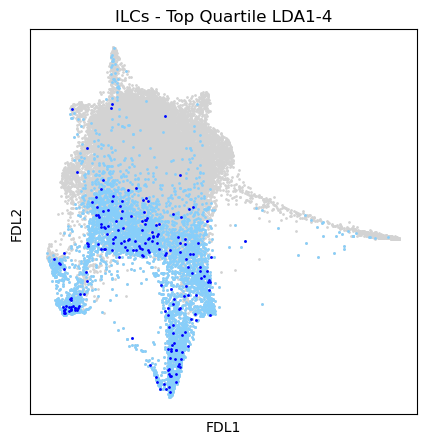

In [229]:
plt.figure(figsize=(5, 5))
frame1 = plt.scatter(Diff[:,0], Diff[:,1], s=1, c = "lightgrey")
frame1 = plt.scatter(Diff_topQ[:,0], Diff_topQ[:,1], s=1, c = "lightskyblue")
frame1 = plt.scatter(Diff_topQ_landmark[:,0], Diff_topQ_landmark[:,1], s=1, c = "blue")
plt.title('ILCs - Top Quartile LDA1-4')
#plt.xlim(-30000,25000)
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('FDL2')
plt.xlabel('FDL1')
plt.show()

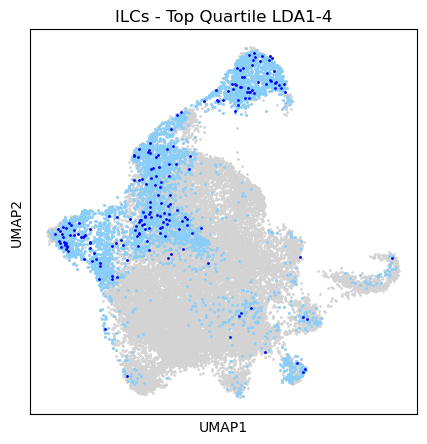

In [230]:
plt.figure(figsize=(5, 5))
frame1 = plt.scatter(UMAP[:,0], UMAP[:,1], s=1, c = "lightgrey")
frame1 = plt.scatter(UMAP_topQ[:,0], UMAP_topQ[:,1], s=1, c = "lightskyblue")
frame1 = plt.scatter(UMAP_topQ_landmark[:,0], UMAP_topQ_landmark[:,1], s=1, c = "blue")
plt.title('ILCs - Top Quartile LDA1-4')
#plt.xlim(-30000,25000)
frame1.axes.get_xaxis().set_ticks([])
frame1.axes.get_yaxis().set_ticks([])
plt.ylabel('UMAP2')
plt.xlabel('UMAP1')
plt.show()

(200, 3000)


c:\users\hmkri\desktop\riesenfeld pearson\lib\site-packages\ripser\ripser.py:257: UserWarning: The input point cloud has more columns than rows; did you mean to transpose?
  warnings.warn(


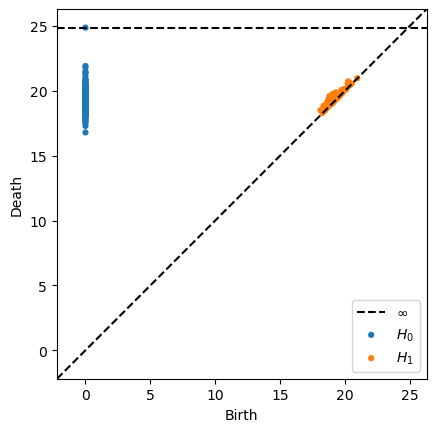

In [231]:
print(np.array(ILC_topQ_landmark).shape)
dgms = ripser(np.array(ILC_topQ_landmark), maxdim=1)['dgms']

#plt.figure(figsize=(10, 5))
#plot_diagrams(dgms, plot_only=[0], ax=plt.subplot(121))
#plot_diagrams(dgms, plot_only=[1], ax=plt.subplot(122))

plot_diagrams(dgms, show=True)

In [232]:
ILC_topQ_landmark_ls = ILC_topQ_landmark[ls]

(200, 15)


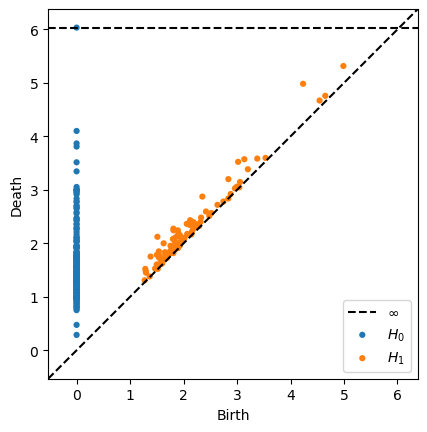

In [233]:
print(np.array(ILC_topQ_landmark_ls).shape)
dgms = ripser(np.array(ILC_topQ_landmark_ls), maxdim=1)['dgms']

#plt.figure(figsize=(10, 5))
#plot_diagrams(dgms, plot_only=[0], ax=plt.subplot(121))
#plot_diagrams(dgms, plot_only=[1], ax=plt.subplot(122))

plot_diagrams(dgms, show=True)

12806
